In [1]:
import os
import sys
cwd = os.getcwd()
module_path = os.path.abspath(os.path.join('..'))
sys.path.insert(0, os.path.join(cwd, "../"))

import pickle
import torch
import importlib
import numpy as np
import pandas as pd
import copy

import src.bin.tensorify as tensorify
import src.utils.data_conversion_utils as conversions
import src.data_manager.student_life_var_binned_data_manager as data_manager
import src.bin.trainer as trainer

from sklearn import metrics

from torch import nn
from copy import copy
from copy import deepcopy
from src import definitions
from src.bin import validations
from src.bin import statistics
from src.bin import plotting
from src.utils.read_utils import read_pickle
from src.utils import student_utils
from src.data_manager import sub_sampler
from src.data_manager import cross_val
from src.data_manager import helper as data_manager_helper
from tabulate import tabulate


from src.models.multitask_learning import multitask_autoencoder


pd.set_option('max_rows', 10000)

importlib.reload(validations)
importlib.reload(multitask_autoencoder)
importlib.reload(sub_sampler)
importlib.reload(statistics)
importlib.reload(cross_val)
importlib.reload(definitions)
importlib.reload(conversions)
importlib.reload(tensorify)
importlib.reload(plotting)
importlib.reload(trainer)
importlib.reload(data_manager)
importlib.reload(student_utils)
importlib.reload(data_manager_helper)
feature_list = data_manager.FEATURE_LIST

In [2]:

# ##### Pickle #####
data = read_pickle('../data/training_data/shuffled_splits/training_date_normalized_shuffled_splits_select_features_no_prev_stress_2.pkl')

#### Data ####
# student_list = student_list =  [53, 46, 7, 49, 22, 24, 2]
# # student_list = [2]
# data = data_manager.get_data_for_training_in_dict_format(*student_list, normalize=True, 
#                                                          fill_na=True, flatten_sequence=False)

# ###### Randomize ######
# train_ids, val_ids, test_ids = cross_val.random_stratified_splits(data)
# data['train_ids'] = train_ids
# data['val_ids'] = val_ids
# data['test_ids'] = test_ids

# data = sub_sampler.get_sub_sampled_sequences(data)

############# Stats ############# 
# unnormalized_data = data_manager.get_data_for_training_in_dict_format(*student_list, normalize=False, fill_na=False)
# statistics_df, raw_df = statistics.get_statistics_on_data_dict(unnormalized_data, feature_list)
# print(statistics.get_train_test_val_label_counts_from_raw_data(data))


#### Data ####
# student_list =  [1, 2, 4 , 7,10, 22, 24, 33, 42, 46, 49, 53, 57 ]
# data = data_manager.get_data_for_training_in_dict_format(*student_list, normalize=True, 
#                                                          fill_na=True, flatten_sequence=False)

# ###### Randomize ######
# train_ids, val_ids, test_ids = cross_val.random_stratified_splits(data, stratify_by='students')
# data['train_ids'] = train_ids
# data['val_ids'] = val_ids
# data['test_ids'] = test_ids

# data = sub_sampler.get_sub_sampled_sequences(data)

############ Stats ############# 
# unnormalized_data = data_manager.get_data_for_training_in_dict_format(*student_list, normalize=False, fill_na=False)
# statistics_df, raw_df = statistics.get_statistics_on_data_dict(unnormalized_data, feature_list)
print(statistics.get_train_test_val_label_counts_from_raw_data(data))

      Train    Val    Test
--  -------  -----  ------
 0      105     53      27
 1      123     50      43
 2       99     27      18


In [3]:
################################## Init ##################################
use_historgram = True
use_covariates = True
train_only_covariates = True
autencoder_bottle_neck_feature_size = 128
autoencoder_num_layers = 1
# Since just covariates, no point of reconstrution loss.
alpha , beta = 0, 1
decay = 0.0001
first_key = next(iter(data['data'].keys()))
if use_historgram:
    num_features = len(data['data'][first_key][4][0])
else:
    num_features = len(data['data'][first_key][0][0])
num_covariates = len(data['data'][first_key][definitions.COVARIATE_DATA_IDX])
# This has to be set zero since we are not using any covariates.
shared_hidden_layer_size = 128
user_dense_layer_hidden_size = 64
num_classes = 3
learning_rate = 0.000005
n_epochs = 600
shared_layer_dropout_prob=0.00
user_head_dropout_prob=0.00

device = torch.device('cuda') if torch.cuda.is_available else torch.device('cpu')

print("Num Features:", num_features)
print("Device: ", device)
print("Num_covariates:", num_covariates)


Num Features: 9
Device:  cuda
Num_covariates: 4


In [4]:
class_weights = torch.tensor(statistics.get_class_weights_in_inverse_proportion(data))
cuda_enabled = torch.cuda.is_available()
data = tensorify.tensorify_data_gru_d(data, cuda_enabled)

In [5]:
student_list = conversions.extract_distinct_student_idsfrom_keys(data['data'].keys())

model = multitask_autoencoder.MultiTaskAutoEncoderLearner(
   conversions.prepend_ids_with_string(student_list, "student_"),
                               num_features,
                               autencoder_bottle_neck_feature_size,
                               autoencoder_num_layers,
                               shared_hidden_layer_size,
                               user_dense_layer_hidden_size,
                               num_classes,
                               num_covariates,
                               shared_layer_dropout_prob,
                               user_head_dropout_prob,
                               False, #ordinal Regression
                               train_only_covariates)
if cuda_enabled:
    model.cuda()
    class_weights = class_weights.cuda()

reconstruction_criterion = torch.nn.L1Loss(reduction="sum")
classification_criterion = torch.nn.CrossEntropyLoss(weight=class_weights)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=decay)
print(model)

MultiTaskAutoEncoderLearner(
  (shared_linear): Linear(in_features=4, out_features=128, bias=True)
  (shared_activation): ReLU()
  (shared_layer_dropout): Dropout(p=0.0)
  (shared_linear_1): Linear(in_features=128, out_features=64, bias=True)
  (shared_activation_1): ReLU()
  (user_heads): UserDenseHead(
    (student_dense_layer): ModuleDict(
      (student_1): Sequential(
        (0): Linear(in_features=64, out_features=64, bias=True)
        (1): ReLU()
        (2): Dropout(p=0.0)
        (3): Linear(in_features=64, out_features=3, bias=True)
      )
      (student_10): Sequential(
        (0): Linear(in_features=64, out_features=64, bias=True)
        (1): ReLU()
        (2): Dropout(p=0.0)
        (3): Linear(in_features=64, out_features=3, bias=True)
      )
      (student_2): Sequential(
        (0): Linear(in_features=64, out_features=64, bias=True)
        (1): ReLU()
        (2): Dropout(p=0.0)
        (3): Linear(in_features=64, out_features=3, bias=True)
      )
      (stude

xxxxxxxxxxxxxx epoch: 0 xxxxxxxxxxxxxx


/home/abhinavshaw/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/home/abhinavshaw/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


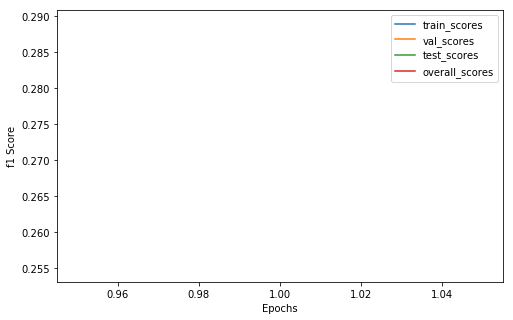

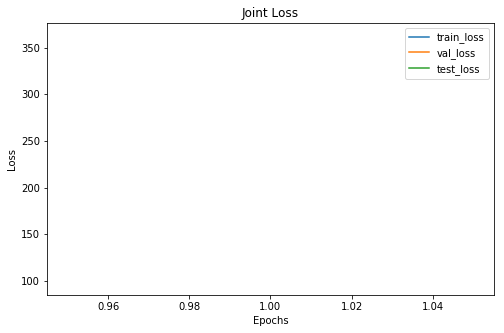

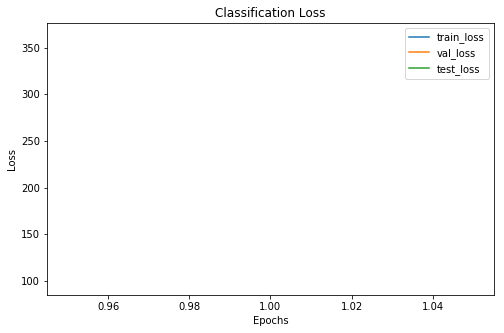

Cofusion Matrix For Val Set: 
--  --  --
14   9  30
18  11  21
14   7   6
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      125     46      34
 1       61     27      16
 2      141     57      38
xxxxxxxxxxxxxx epoch: 1 xxxxxxxxxxxxxx


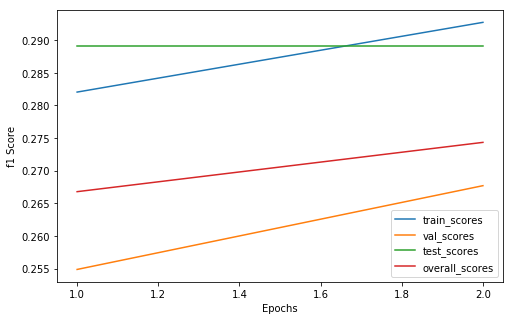

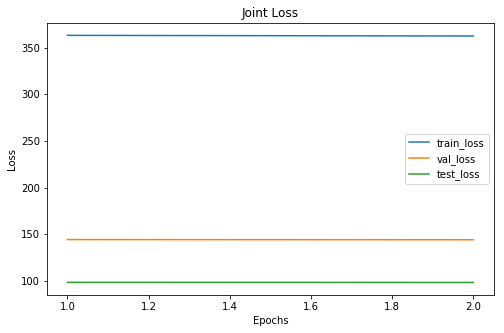

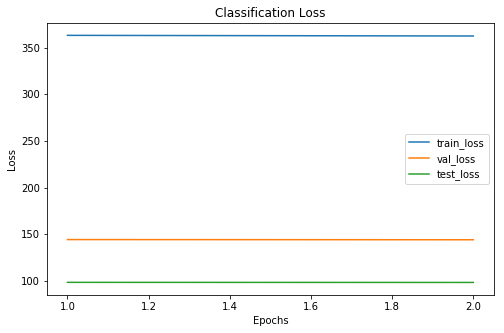

Cofusion Matrix For Val Set: 
--  --  --
16   9  28
20  11  19
14   7   6
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      124     50      34
 1       63     27      16
 2      140     53      38
xxxxxxxxxxxxxx epoch: 2 xxxxxxxxxxxxxx


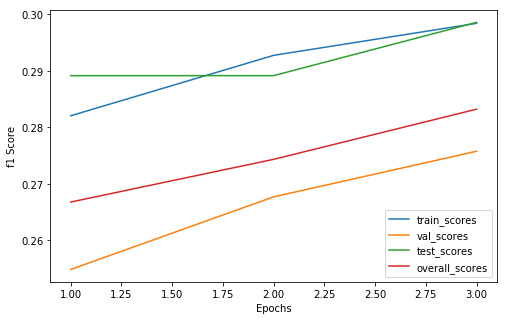

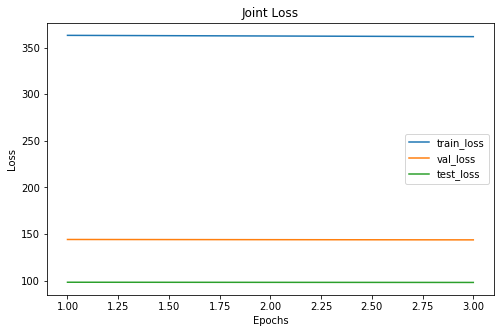

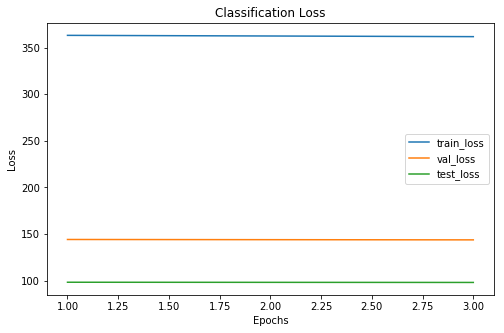

Cofusion Matrix For Val Set: 
--  --  --
17   8  28
20  11  19
14   7   6
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      127     51      35
 1       62     26      16
 2      138     53      37
xxxxxxxxxxxxxx epoch: 3 xxxxxxxxxxxxxx


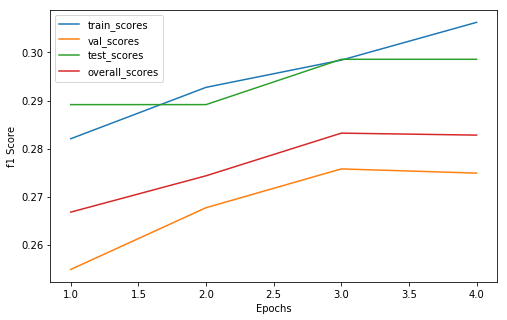

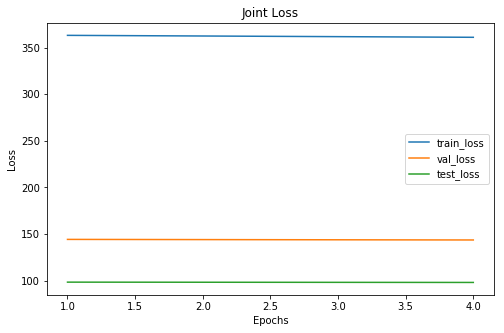

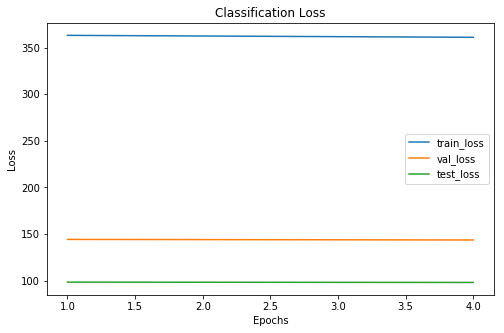

Cofusion Matrix For Val Set: 
--  --  --
17   8  28
21  11  18
14   7   6
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      124     52      35
 1       64     26      16
 2      139     52      37
xxxxxxxxxxxxxx epoch: 4 xxxxxxxxxxxxxx


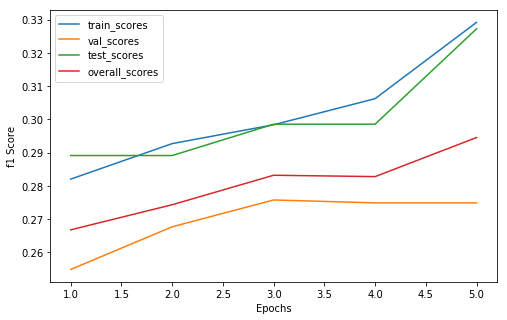

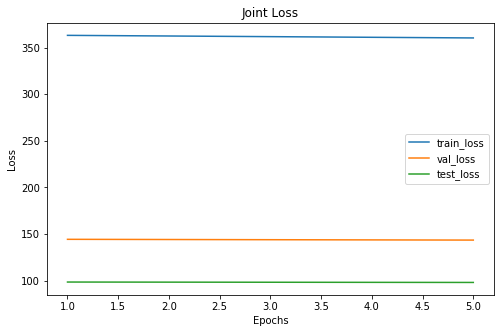

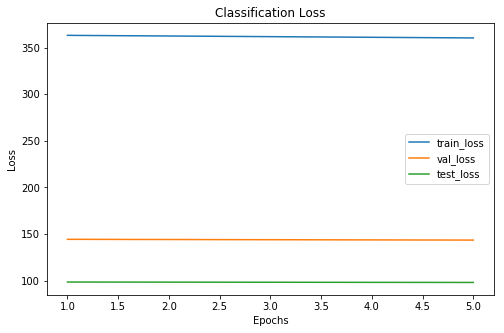

Cofusion Matrix For Val Set: 
--  --  --
17   8  28
21  11  18
14   7   6
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      119     52      33
 1       71     26      18
 2      137     52      37
xxxxxxxxxxxxxx epoch: 5 xxxxxxxxxxxxxx


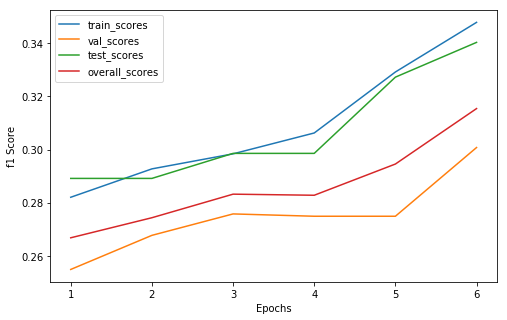

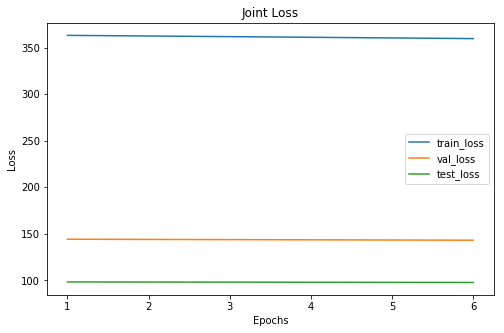

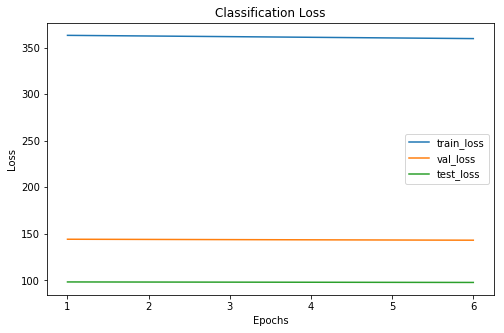

Cofusion Matrix For Val Set: 
--  --  --
19   6  28
20  12  18
14   7   6
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      118     53      33
 1       71     25      19
 2      138     52      36
xxxxxxxxxxxxxx epoch: 6 xxxxxxxxxxxxxx


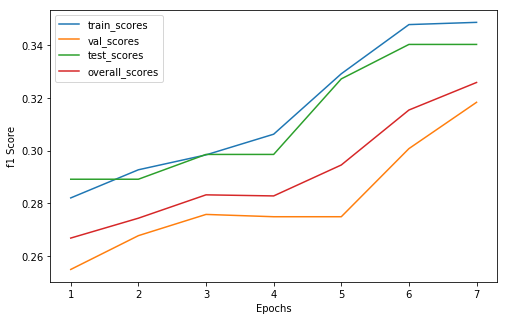

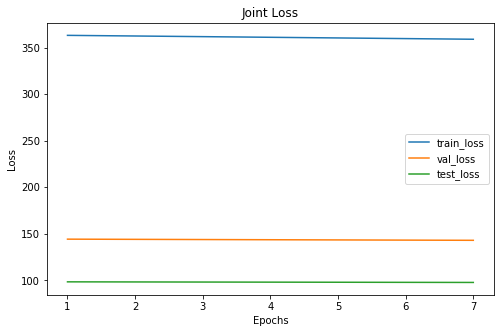

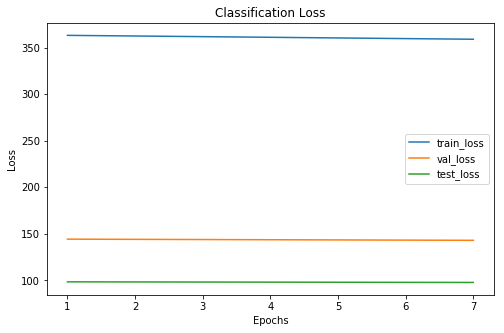

Cofusion Matrix For Val Set: 
--  --  --
19   6  28
20  14  16
14   7   6
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      118     53      33
 1       73     27      19
 2      136     50      36
xxxxxxxxxxxxxx epoch: 7 xxxxxxxxxxxxxx


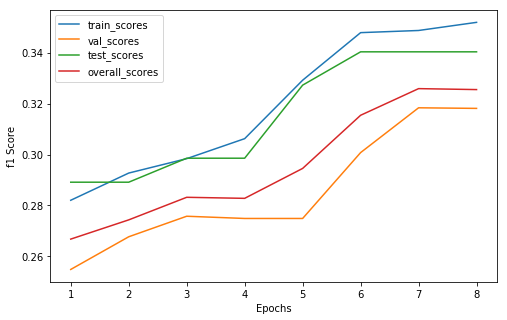

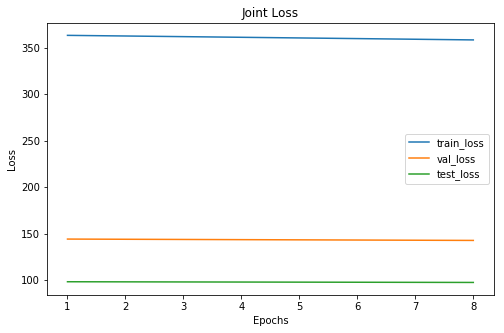

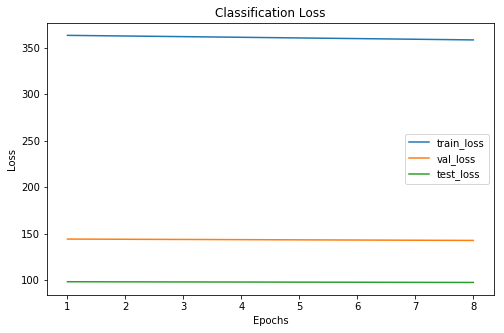

Cofusion Matrix For Val Set: 
--  --  --
18   8  27
19  15  16
14   7   6
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     51      33
 1       75     30      19
 2      136     49      36
xxxxxxxxxxxxxx epoch: 8 xxxxxxxxxxxxxx


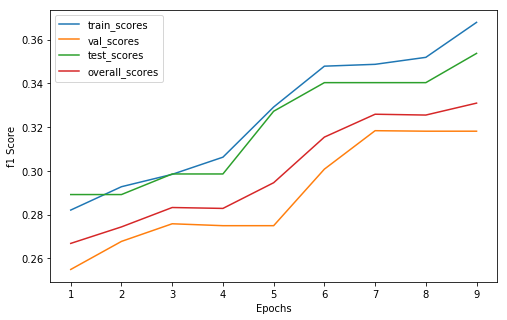

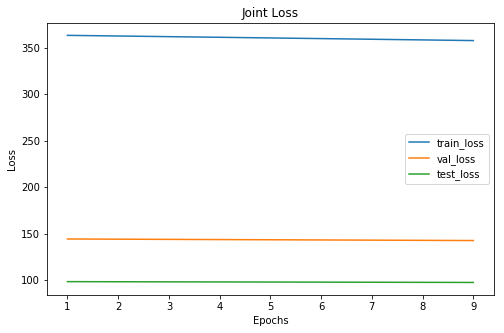

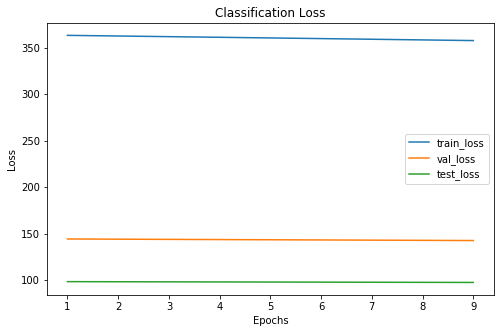

Cofusion Matrix For Val Set: 
--  --  --
18   8  27
19  15  16
14   7   6
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     51      32
 1       78     30      20
 2      137     49      36
xxxxxxxxxxxxxx epoch: 9 xxxxxxxxxxxxxx


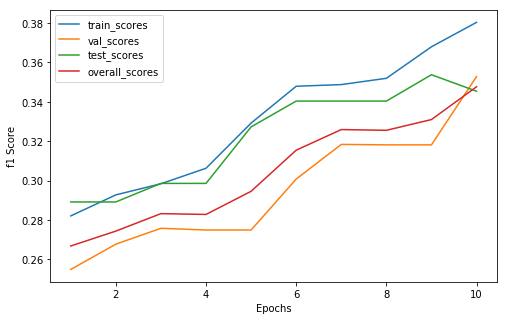

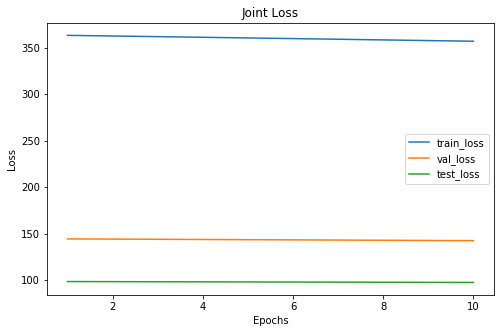

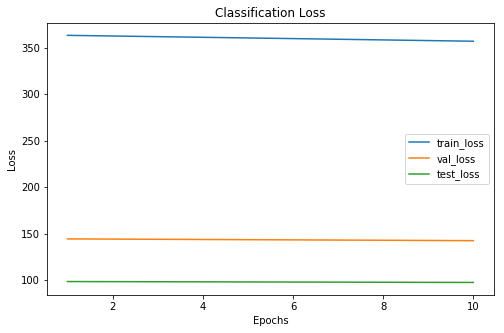

Cofusion Matrix For Val Set: 
--  --  --
21   7  25
19  15  16
12   7   8
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     52      33
 1       77     29      20
 2      137     49      35
xxxxxxxxxxxxxx epoch: 10 xxxxxxxxxxxxxx


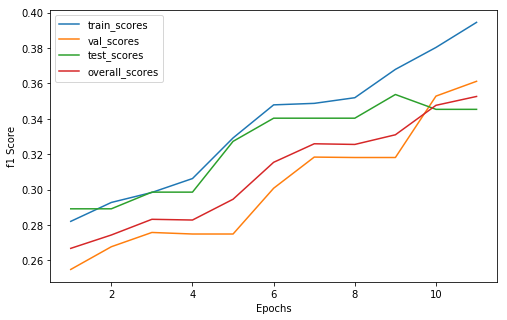

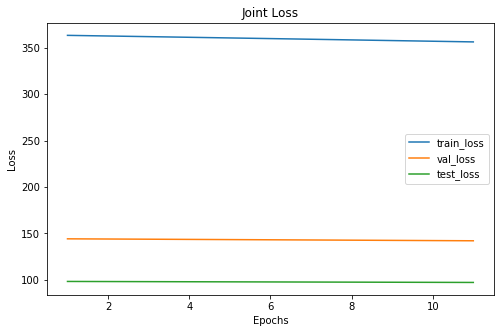

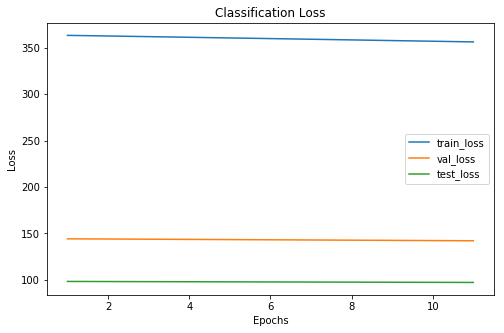

Cofusion Matrix For Val Set: 
--  --  --
21   7  25
19  16  15
12   7   8
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     52      33
 1       76     30      20
 2      134     48      35
xxxxxxxxxxxxxx epoch: 11 xxxxxxxxxxxxxx


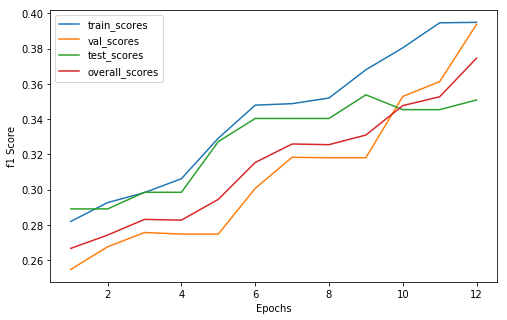

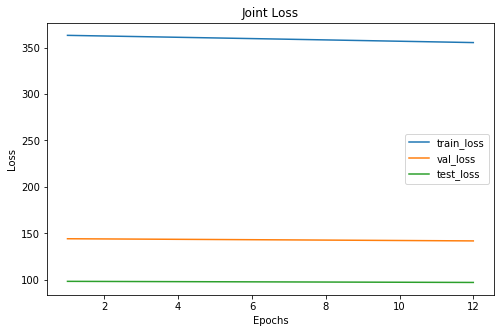

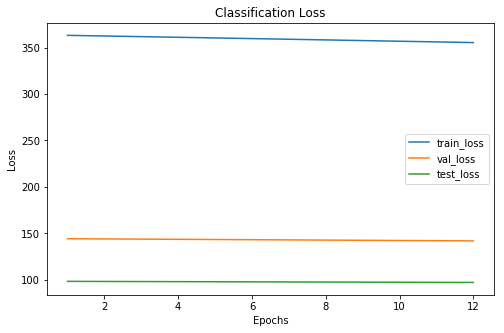

Cofusion Matrix For Val Set: 
--  --  --
22   8  23
16  19  15
12   7   8
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      120     50      32
 1       75     34      21
 2      132     46      35
xxxxxxxxxxxxxx epoch: 12 xxxxxxxxxxxxxx


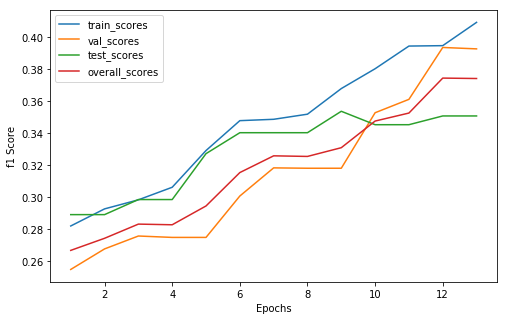

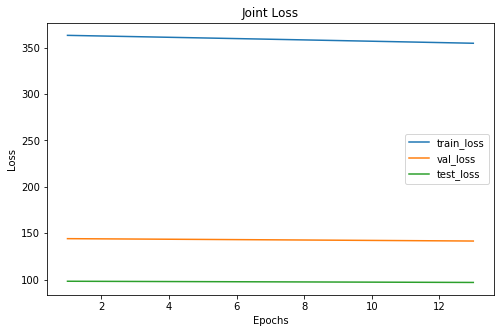

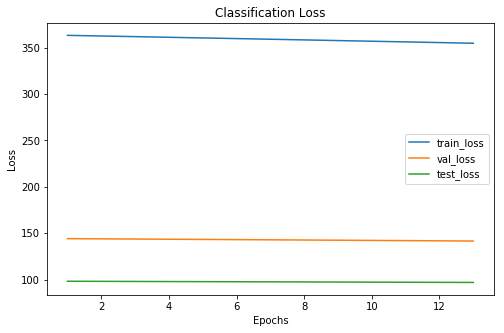

Cofusion Matrix For Val Set: 
--  --  --
20  10  23
15  21  14
12   7   8
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      119     47      32
 1       81     38      21
 2      127     45      35
xxxxxxxxxxxxxx epoch: 13 xxxxxxxxxxxxxx


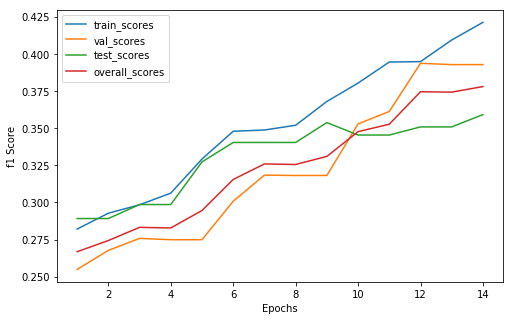

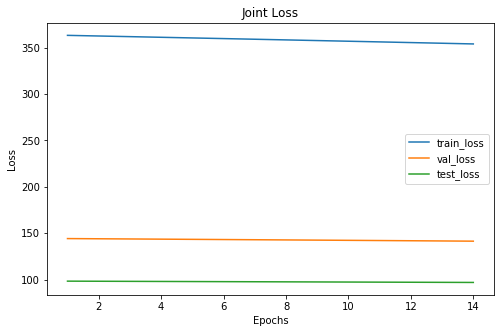

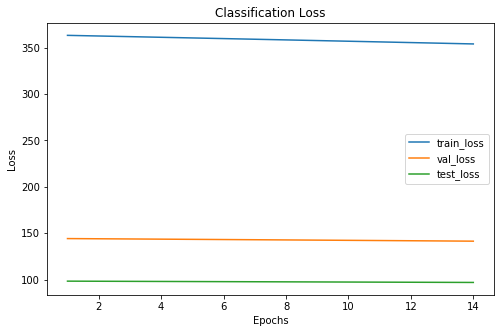

Cofusion Matrix For Val Set: 
--  --  --
20  10  23
15  21  14
12   7   8
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     47      31
 1       82     38      21
 2      131     45      36
xxxxxxxxxxxxxx epoch: 14 xxxxxxxxxxxxxx


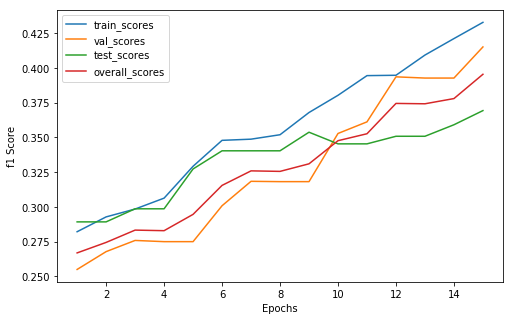

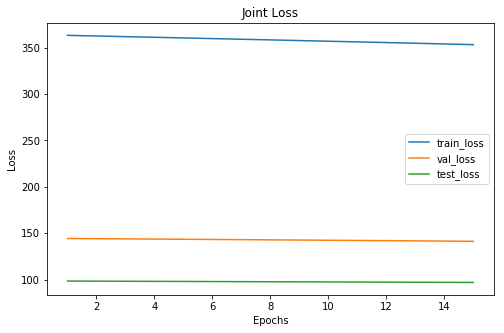

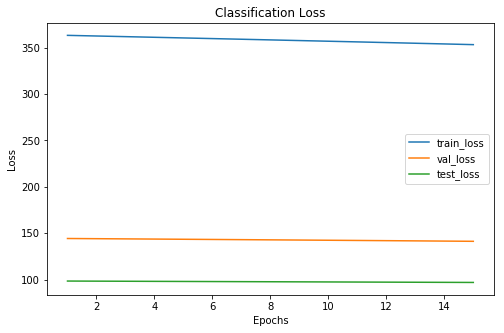

Cofusion Matrix For Val Set: 
--  --  --
22  10  21
14  22  14
12   7   8
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     48      30
 1       83     39      23
 2      134     43      35
xxxxxxxxxxxxxx epoch: 15 xxxxxxxxxxxxxx


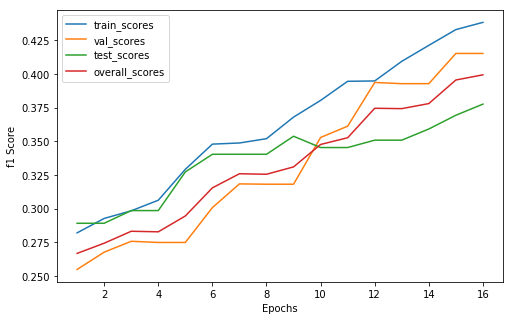

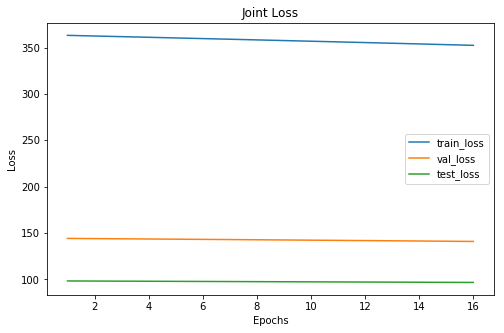

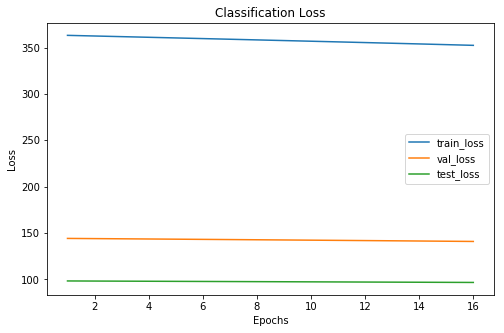

Cofusion Matrix For Val Set: 
--  --  --
22  10  21
14  22  14
12   7   8
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     48      29
 1       83     39      23
 2      136     43      36
xxxxxxxxxxxxxx epoch: 16 xxxxxxxxxxxxxx


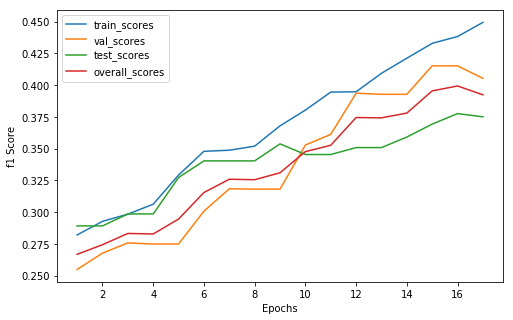

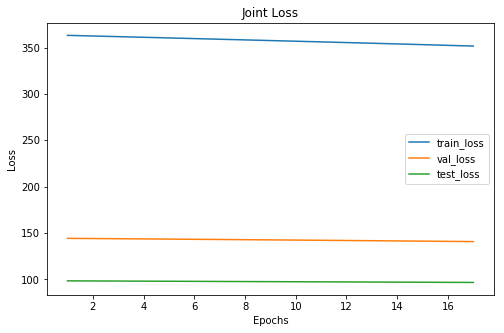

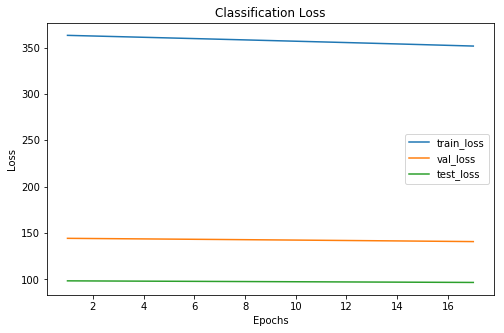

Cofusion Matrix For Val Set: 
--  --  --
21  12  20
14  22  14
12   7   8
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      102     47      29
 1       90     41      24
 2      135     42      35
xxxxxxxxxxxxxx epoch: 17 xxxxxxxxxxxxxx


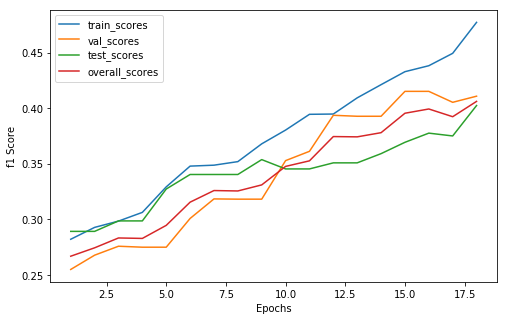

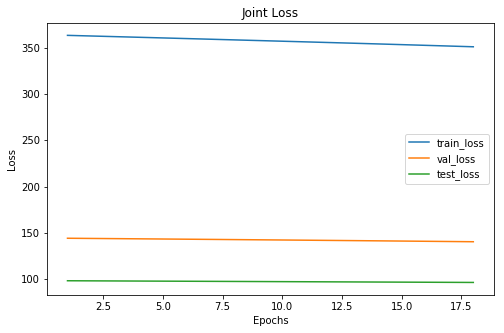

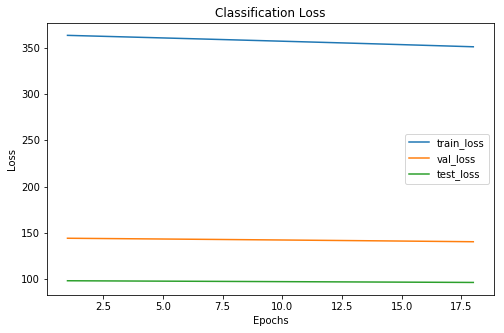

Cofusion Matrix For Val Set: 
--  --  --
21  14  18
13  22  15
11   7   9
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     45      28
 1      100     43      28
 2      130     42      32
xxxxxxxxxxxxxx epoch: 18 xxxxxxxxxxxxxx


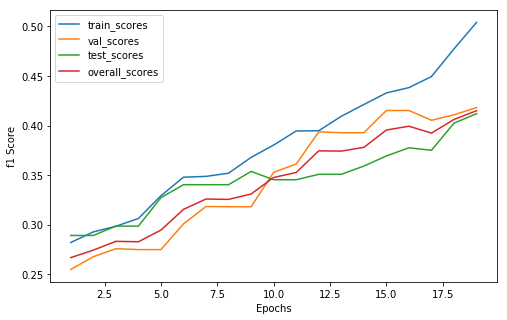

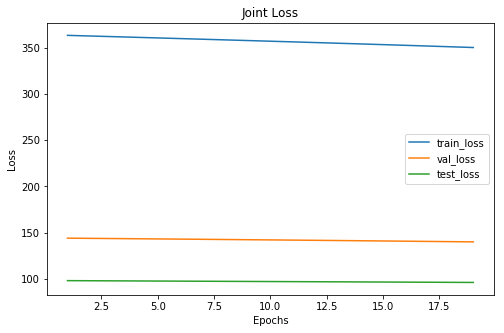

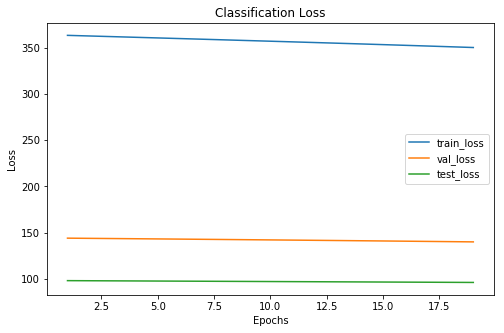

Cofusion Matrix For Val Set: 
--  --  --
22  14  17
13  22  15
11   7   9
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       92     46      27
 1      107     43      29
 2      128     41      32
xxxxxxxxxxxxxx epoch: 19 xxxxxxxxxxxxxx


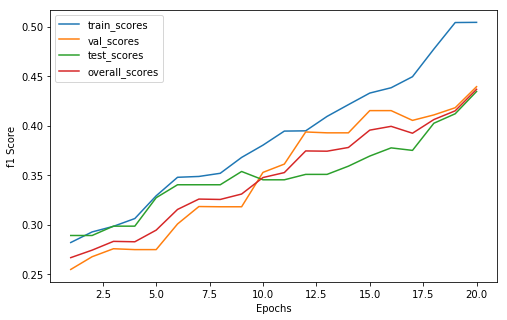

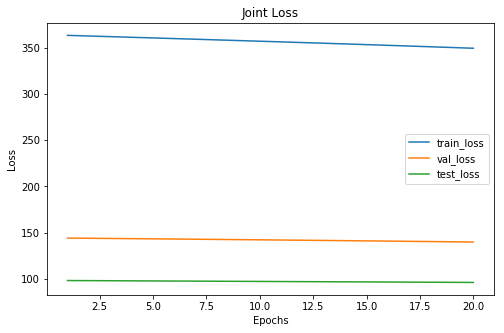

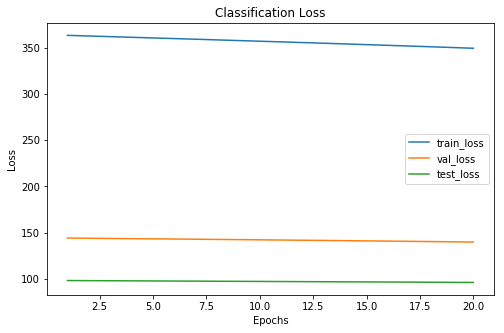

Cofusion Matrix For Val Set: 
--  --  --
23  14  16
13  24  13
11   7   9
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       92     47      27
 1      110     45      31
 2      125     38      30
xxxxxxxxxxxxxx epoch: 20 xxxxxxxxxxxxxx


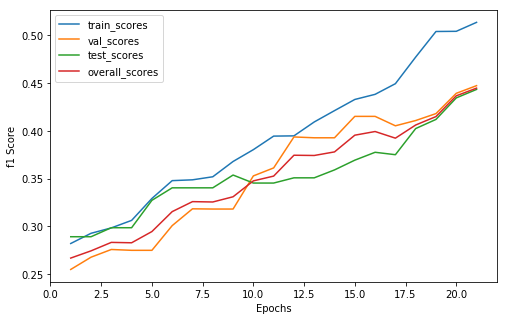

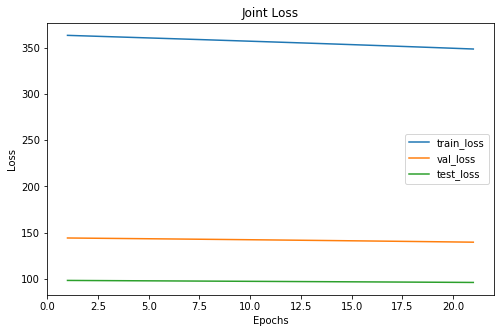

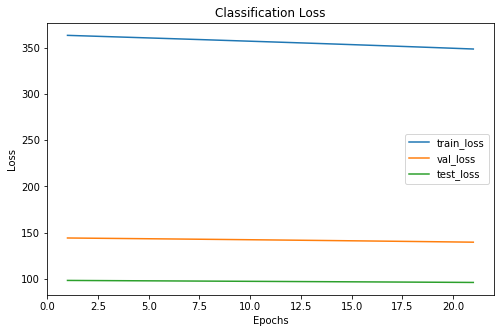

Cofusion Matrix For Val Set: 
--  --  --
22  14  17
12  24  14
 9   7  11
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       90     43      26
 1      111     45      31
 2      126     42      31
xxxxxxxxxxxxxx epoch: 21 xxxxxxxxxxxxxx


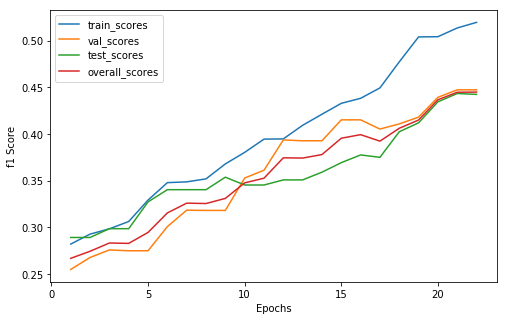

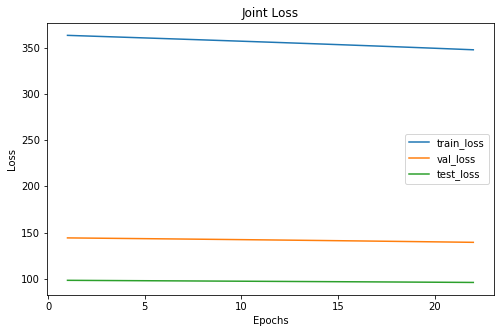

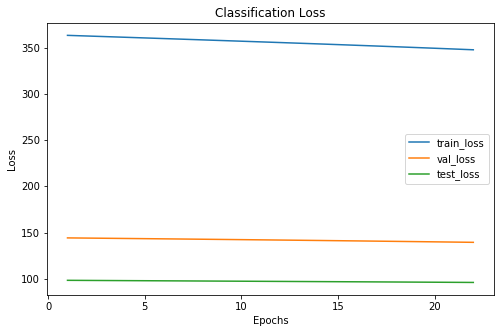

Cofusion Matrix For Val Set: 
--  --  --
22  14  17
12  24  14
 9   7  11
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       88     43      24
 1      113     45      32
 2      126     42      32
xxxxxxxxxxxxxx epoch: 22 xxxxxxxxxxxxxx


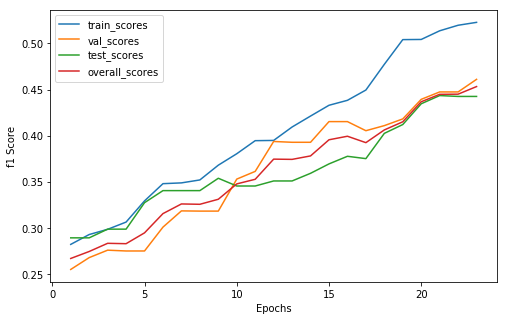

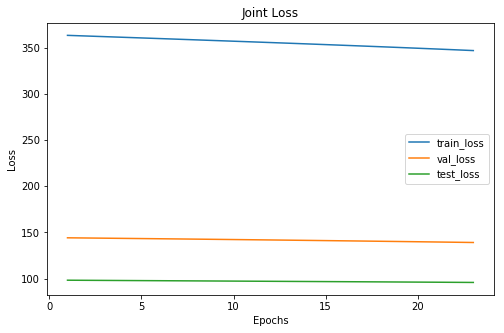

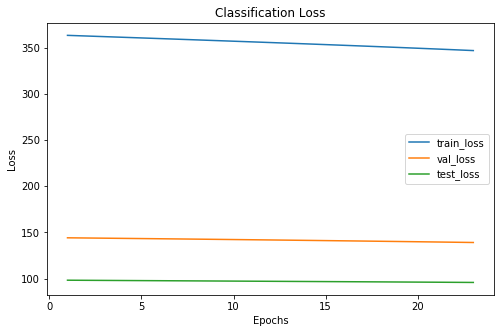

Cofusion Matrix For Val Set: 
--  --  --
23  14  16
13  24  13
 9   6  12
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       87     45      24
 1      115     44      32
 2      125     41      32
xxxxxxxxxxxxxx epoch: 23 xxxxxxxxxxxxxx


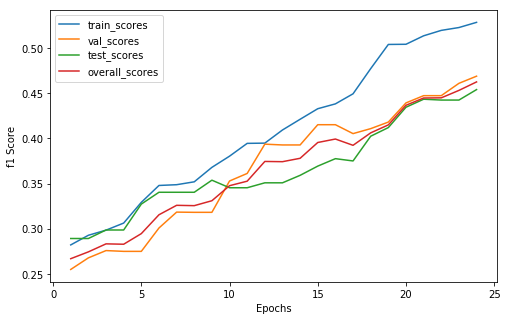

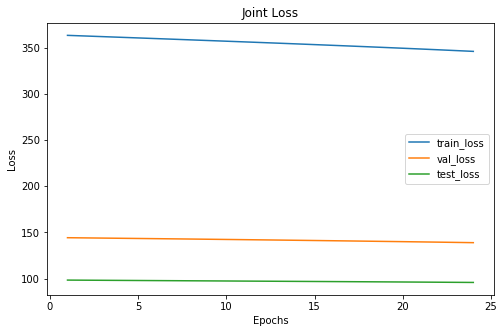

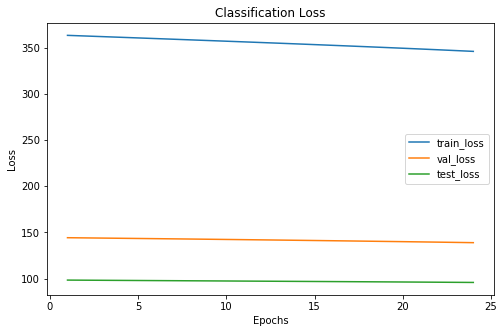

Cofusion Matrix For Val Set: 
--  --  --
23  14  16
12  24  14
 9   5  13
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       85     44      23
 1      115     43      33
 2      127     43      32
xxxxxxxxxxxxxx epoch: 24 xxxxxxxxxxxxxx


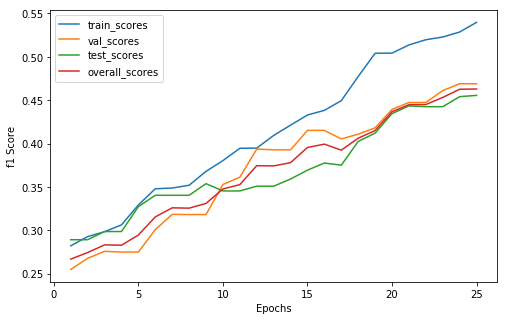

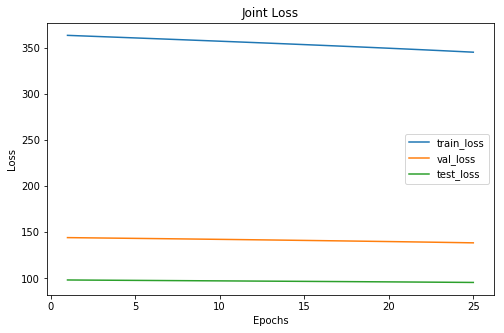

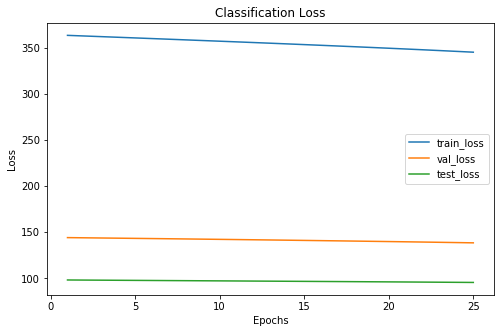

Cofusion Matrix For Val Set: 
--  --  --
23  14  16
12  24  14
 9   5  13
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       83     44      24
 1      113     43      32
 2      131     43      32
xxxxxxxxxxxxxx epoch: 25 xxxxxxxxxxxxxx


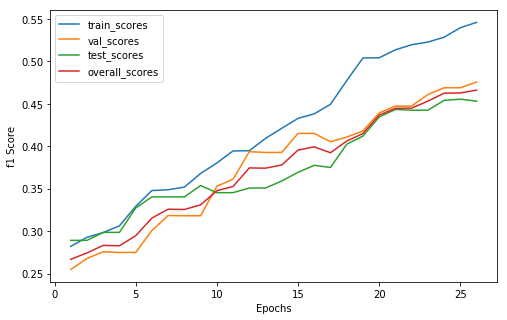

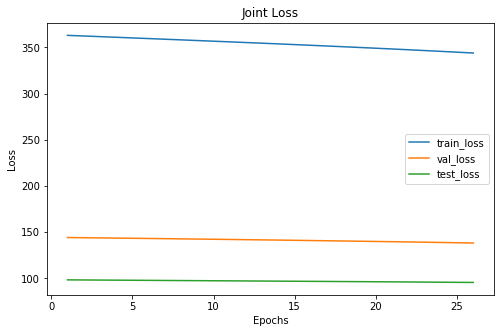

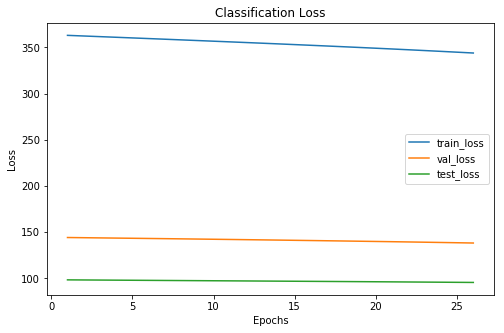

Cofusion Matrix For Val Set: 
--  --  --
23  14  16
12  24  14
 8   5  14
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       84     43      23
 1      114     43      31
 2      129     44      34
xxxxxxxxxxxxxx epoch: 26 xxxxxxxxxxxxxx


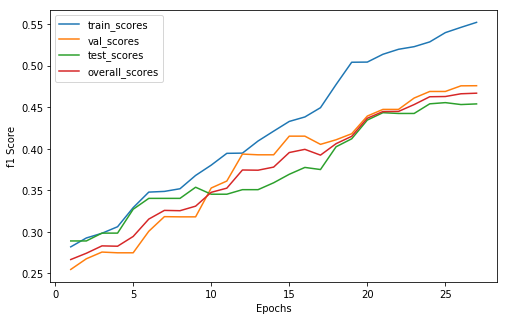

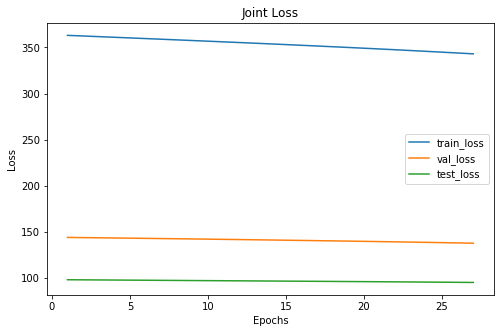

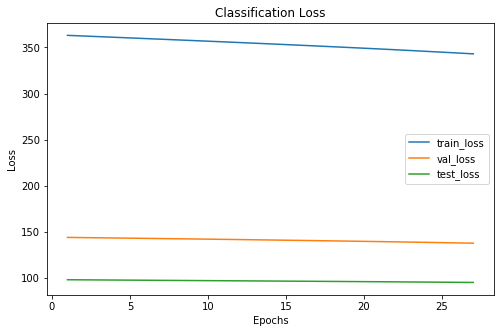

Cofusion Matrix For Val Set: 
--  --  --
23  14  16
12  24  14
 9   4  14
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       78     44      22
 1      116     42      31
 2      133     44      35
xxxxxxxxxxxxxx epoch: 27 xxxxxxxxxxxxxx


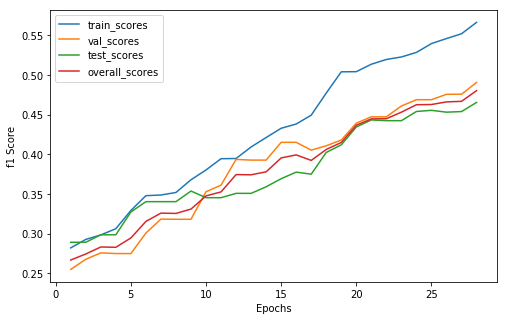

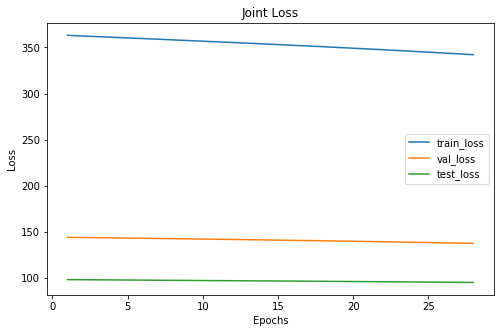

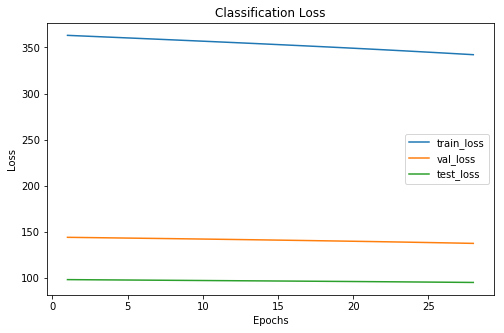

Cofusion Matrix For Val Set: 
--  --  --
24  14  15
12  25  13
 9   4  14
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       78     45      23
 1      120     43      31
 2      129     42      34
xxxxxxxxxxxxxx epoch: 28 xxxxxxxxxxxxxx


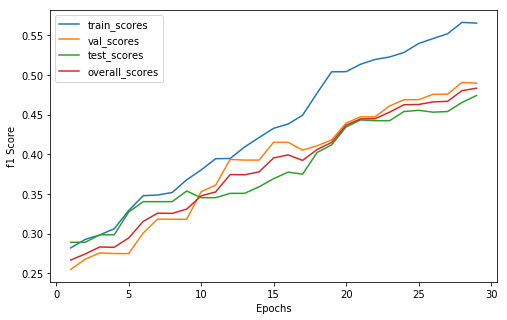

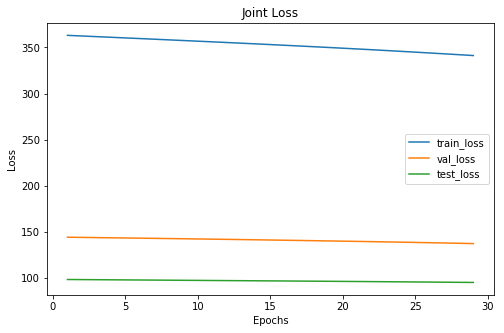

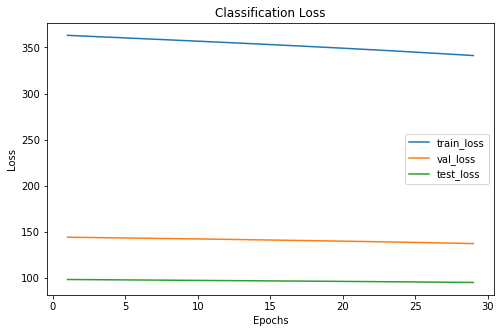

Cofusion Matrix For Val Set: 
--  --  --
23  14  16
12  25  13
 8   4  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       79     43      22
 1      120     43      31
 2      128     44      35
xxxxxxxxxxxxxx epoch: 29 xxxxxxxxxxxxxx


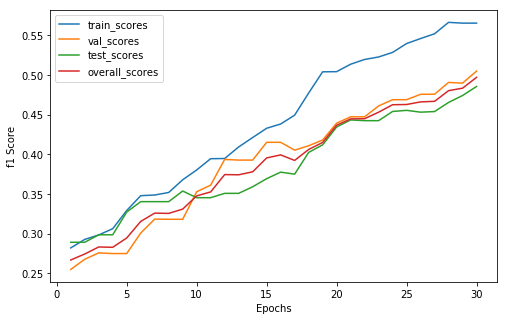

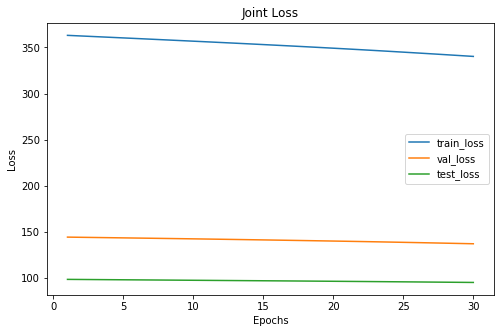

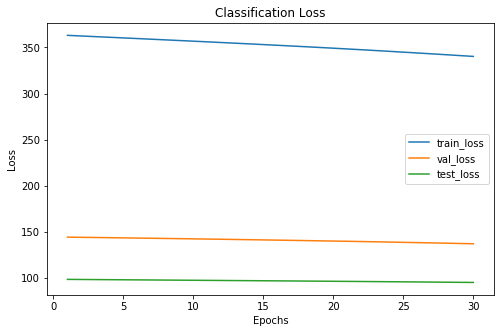

Cofusion Matrix For Val Set: 
--  --  --
25  14  14
12  25  13
 8   4  15
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       79     45      23
 1      119     43      31
 2      129     42      34
xxxxxxxxxxxxxx epoch: 30 xxxxxxxxxxxxxx


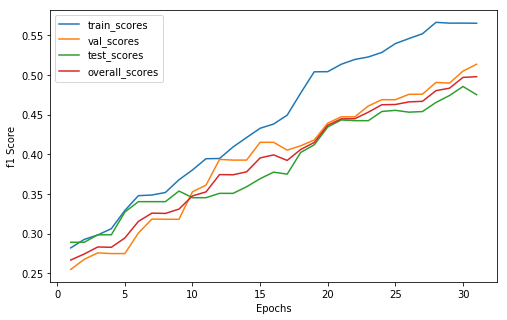

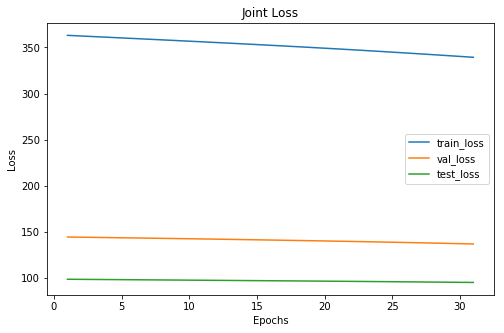

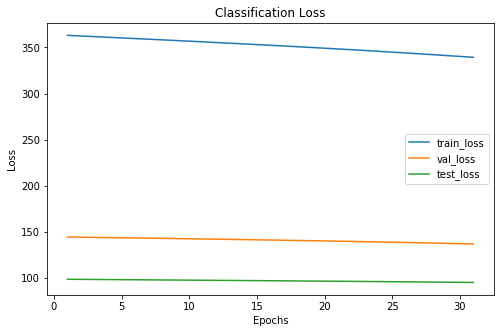

Cofusion Matrix For Val Set: 
--  --  --
25  14  14
10  25  15
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     42      21
 1      120     43      31
 2      133     45      36
xxxxxxxxxxxxxx epoch: 31 xxxxxxxxxxxxxx


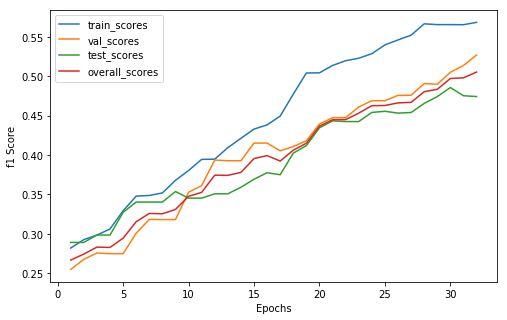

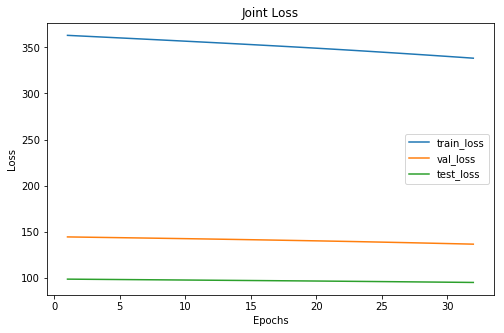

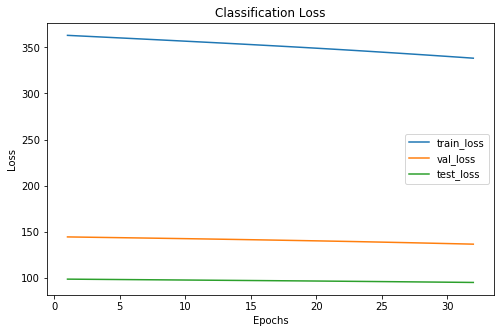

Cofusion Matrix For Val Set: 
--  --  --
25  14  14
10  25  15
 7   2  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       72     42      22
 1      120     41      31
 2      135     47      35
xxxxxxxxxxxxxx epoch: 32 xxxxxxxxxxxxxx


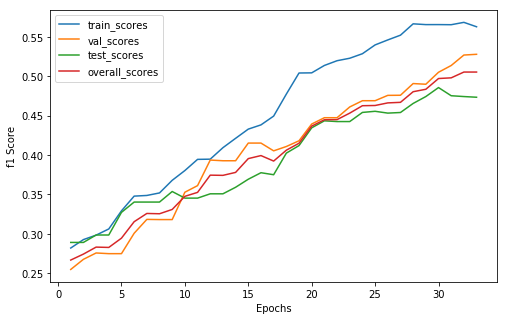

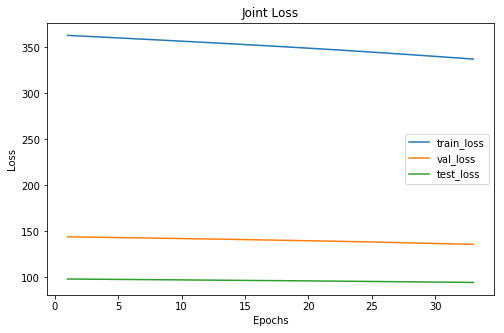

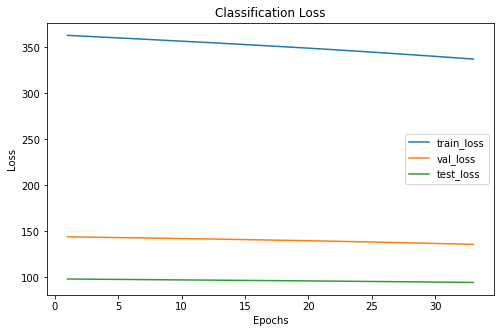

Cofusion Matrix For Val Set: 
--  --  --
25  14  14
 9  25  16
 7   2  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     41      23
 1      120     41      31
 2      133     48      34
xxxxxxxxxxxxxx epoch: 33 xxxxxxxxxxxxxx


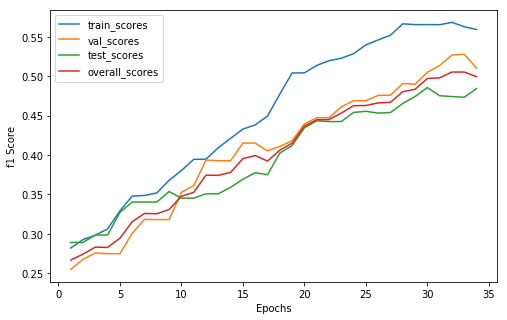

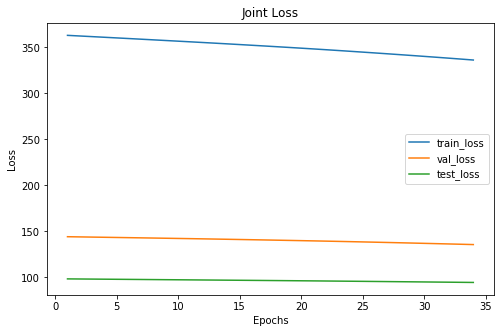

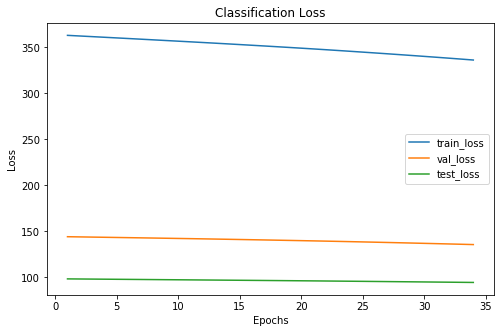

Cofusion Matrix For Val Set: 
--  --  --
23  16  14
 9  25  16
 7   2  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       73     39      21
 1      121     43      33
 2      133     48      34
xxxxxxxxxxxxxx epoch: 34 xxxxxxxxxxxxxx


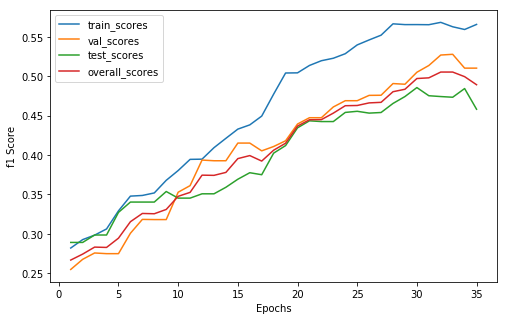

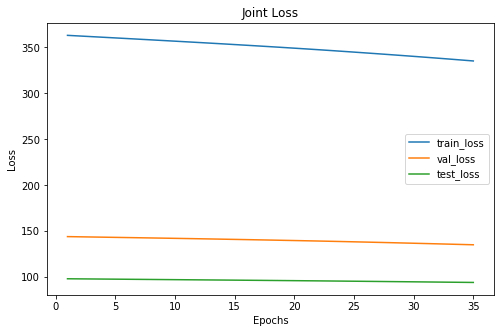

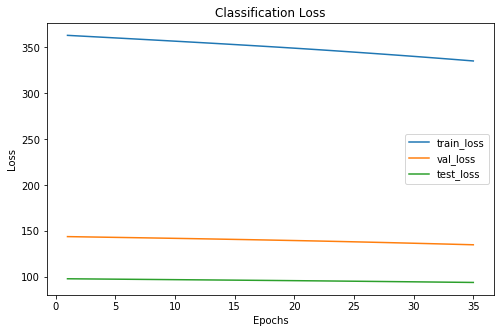

Cofusion Matrix For Val Set: 
--  --  --
23  16  14
 9  25  16
 7   2  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       71     39      19
 1      123     43      34
 2      133     48      35
xxxxxxxxxxxxxx epoch: 35 xxxxxxxxxxxxxx


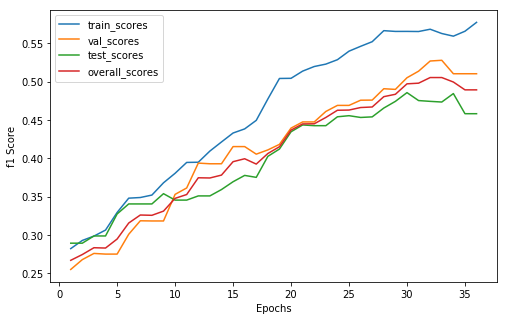

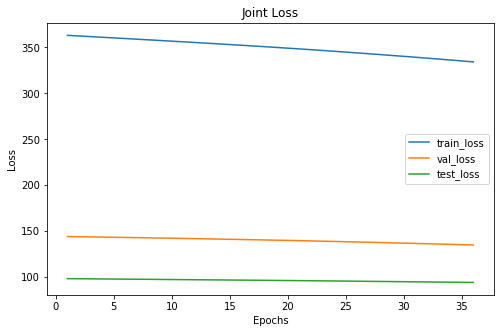

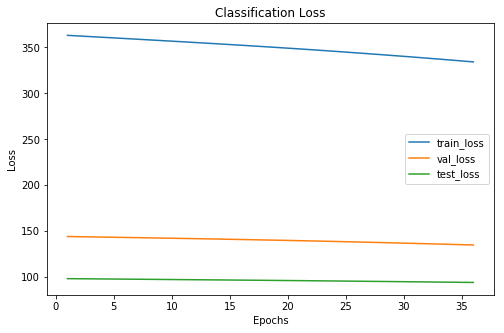

Cofusion Matrix For Val Set: 
--  --  --
23  16  14
 9  25  16
 7   2  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       67     39      19
 1      128     43      34
 2      132     48      35
xxxxxxxxxxxxxx epoch: 36 xxxxxxxxxxxxxx


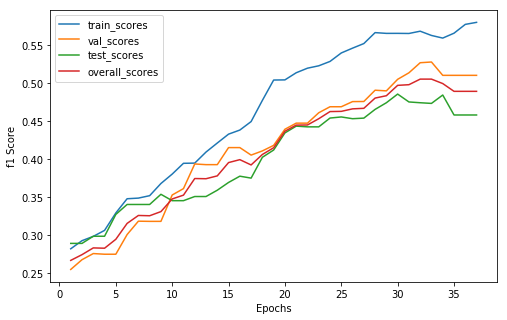

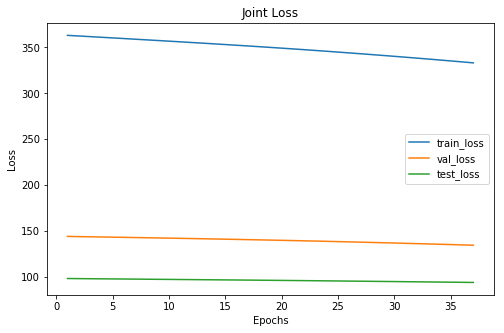

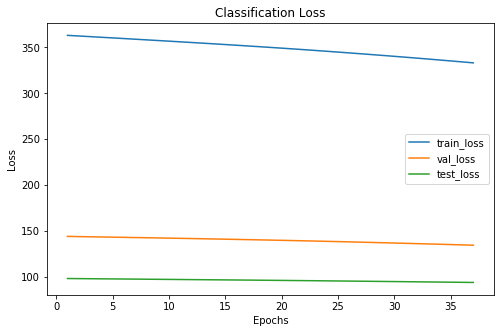

Cofusion Matrix For Val Set: 
--  --  --
23  16  14
 9  25  16
 7   2  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       67     39      19
 1      127     43      34
 2      133     48      35
xxxxxxxxxxxxxx epoch: 37 xxxxxxxxxxxxxx


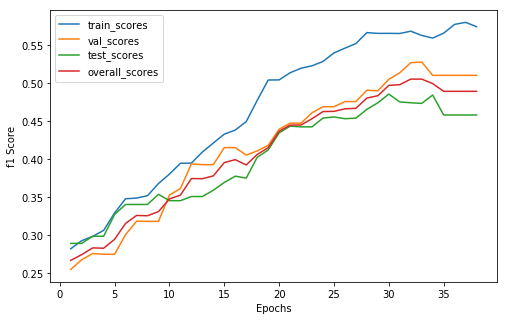

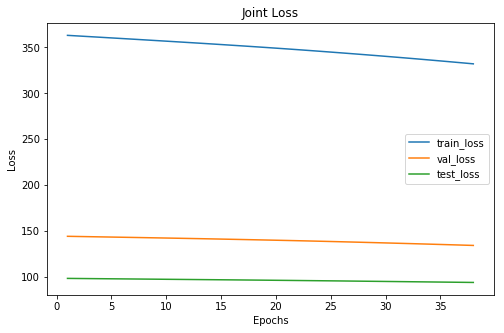

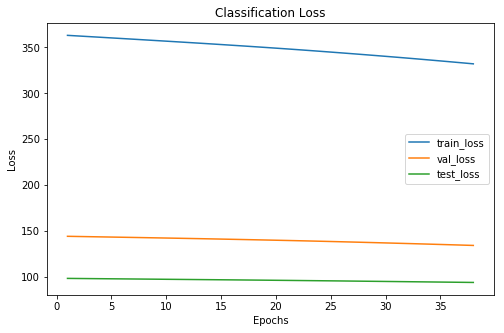

Cofusion Matrix For Val Set: 
--  --  --
23  16  14
 9  25  16
 7   2  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       69     39      19
 1      128     43      34
 2      130     48      35
xxxxxxxxxxxxxx epoch: 38 xxxxxxxxxxxxxx


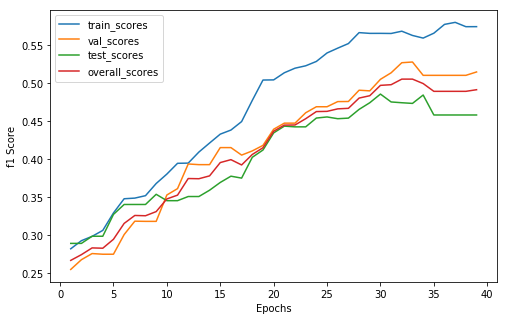

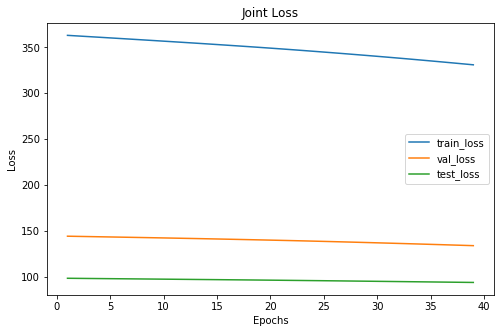

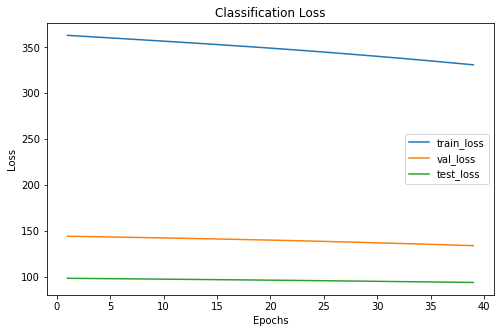

Cofusion Matrix For Val Set: 
--  --  --
21  18  14
 7  27  16
 6   2  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       70     34      19
 1      130     47      34
 2      127     49      35
xxxxxxxxxxxxxx epoch: 39 xxxxxxxxxxxxxx


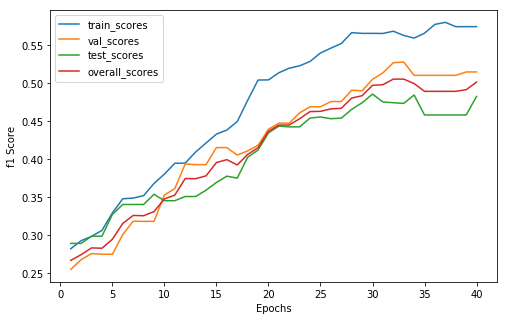

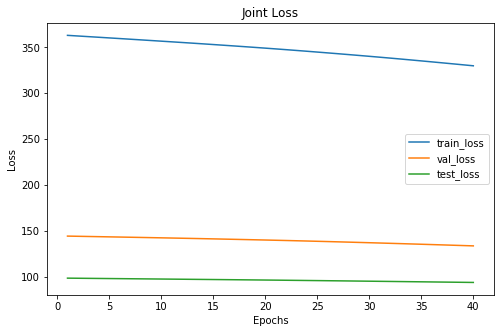

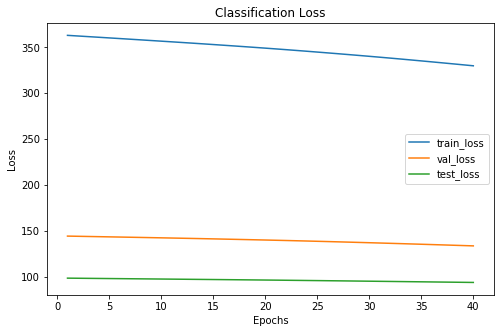

Cofusion Matrix For Val Set: 
--  --  --
21  18  14
 7  27  16
 6   2  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       70     34      21
 1      130     47      34
 2      127     49      33
xxxxxxxxxxxxxx epoch: 40 xxxxxxxxxxxxxx


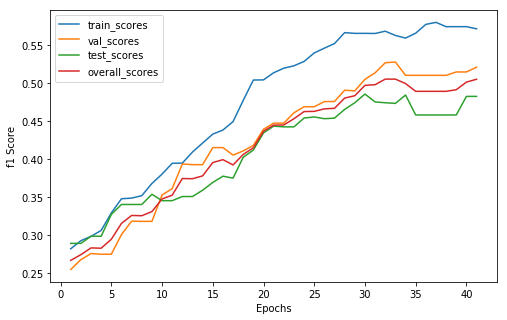

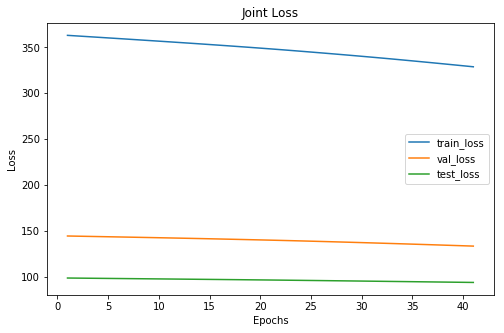

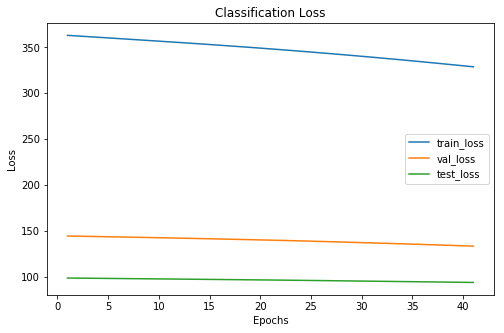

Cofusion Matrix For Val Set: 
--  --  --
21  19  13
 7  28  15
 6   2  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       71     34      21
 1      130     49      34
 2      126     47      33
xxxxxxxxxxxxxx epoch: 41 xxxxxxxxxxxxxx


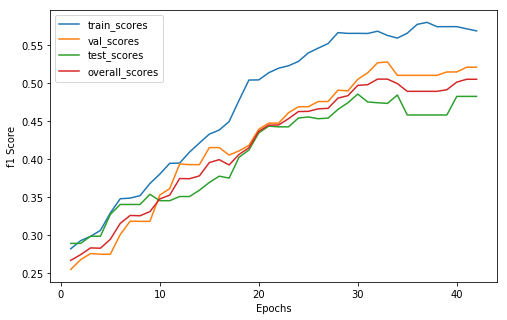

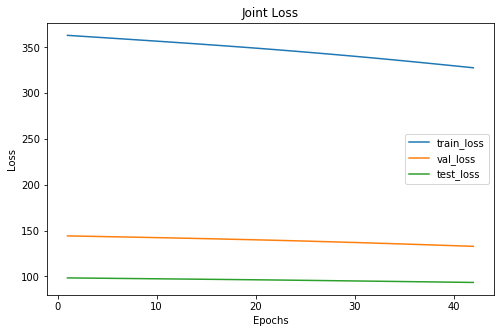

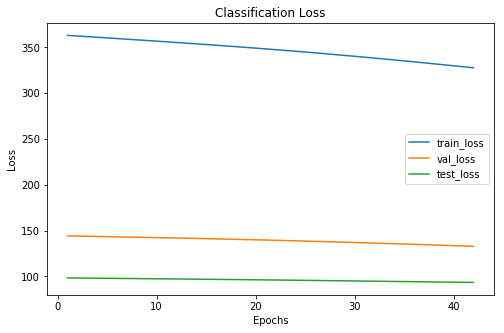

Cofusion Matrix For Val Set: 
--  --  --
21  19  13
 7  28  15
 6   2  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       72     34      21
 1      133     49      34
 2      122     47      33
xxxxxxxxxxxxxx epoch: 42 xxxxxxxxxxxxxx


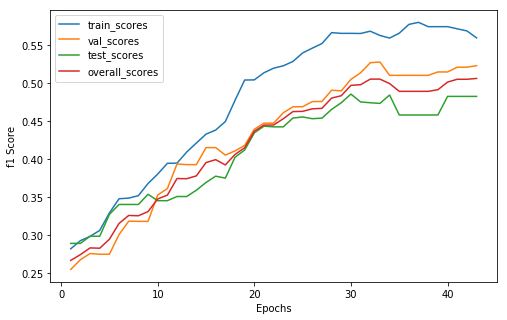

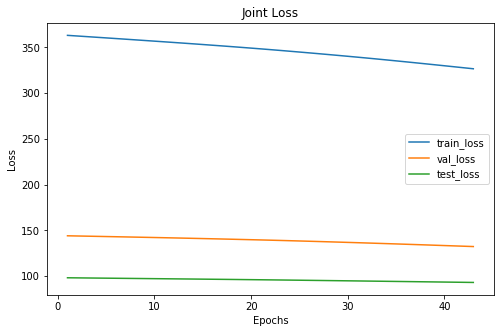

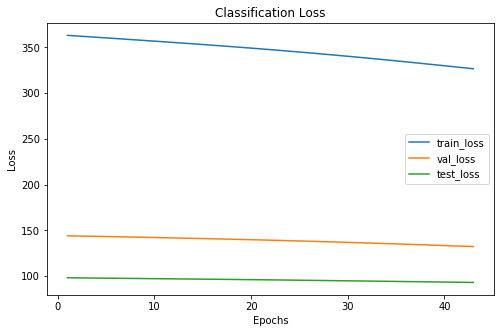

Cofusion Matrix For Val Set: 
--  --  --
22  19  12
 7  28  15
 6   3  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       72     35      21
 1      134     50      34
 2      121     45      33
xxxxxxxxxxxxxx epoch: 43 xxxxxxxxxxxxxx


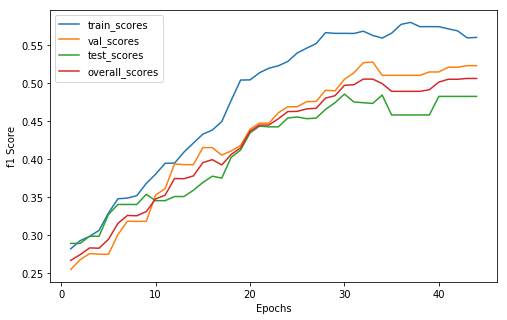

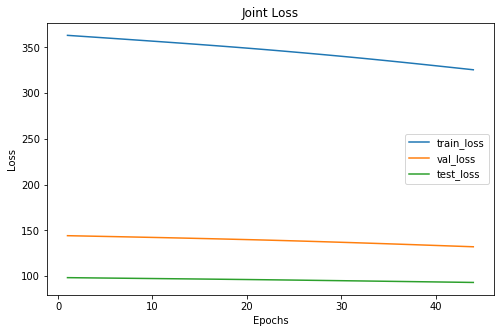

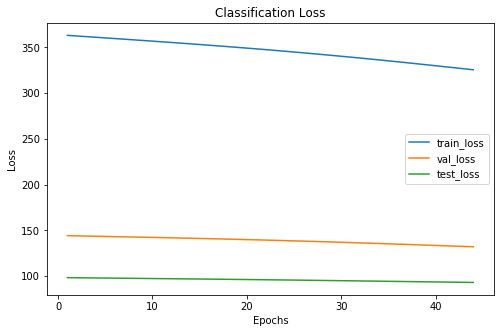

Cofusion Matrix For Val Set: 
--  --  --
22  19  12
 7  28  15
 6   3  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       73     35      21
 1      133     50      34
 2      121     45      33
xxxxxxxxxxxxxx epoch: 44 xxxxxxxxxxxxxx


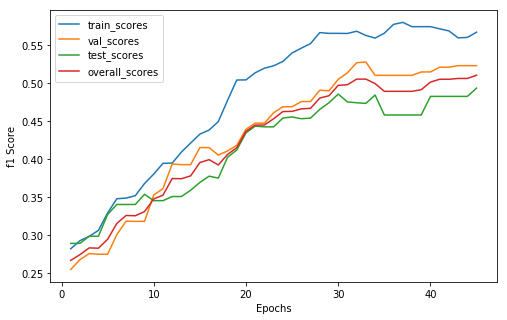

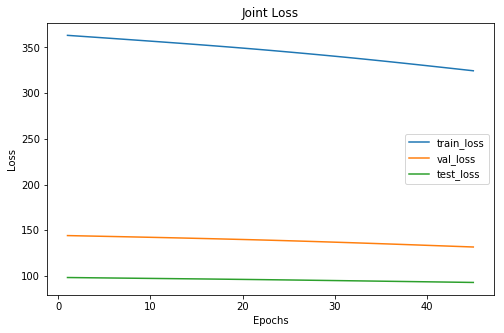

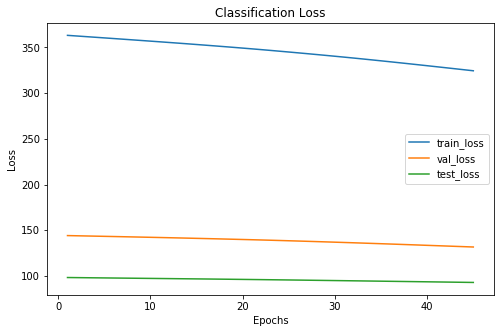

Cofusion Matrix For Val Set: 
--  --  --
22  19  12
 7  28  15
 6   3  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       75     35      21
 1      133     50      35
 2      119     45      32
xxxxxxxxxxxxxx epoch: 45 xxxxxxxxxxxxxx


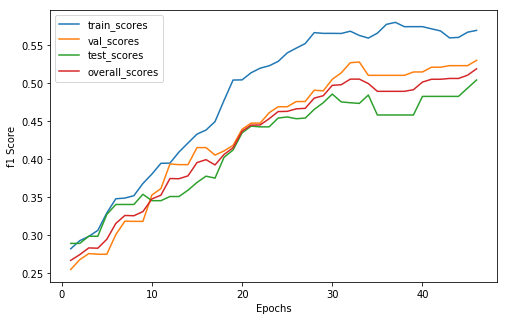

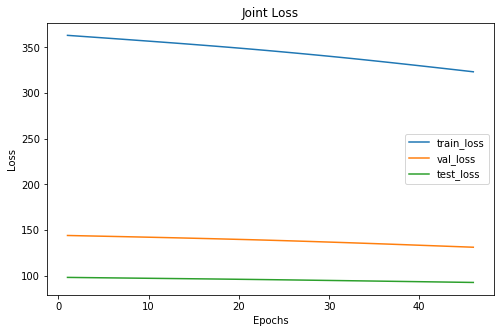

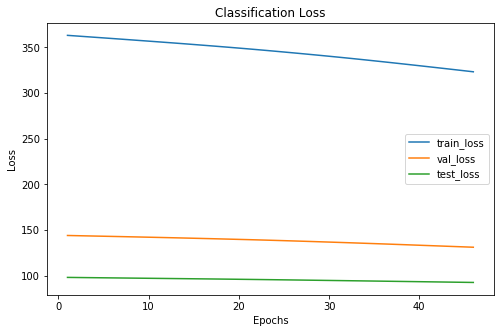

Cofusion Matrix For Val Set: 
--  --  --
22  19  12
 7  29  14
 6   3  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       73     35      21
 1      134     51      36
 2      120     44      31
xxxxxxxxxxxxxx epoch: 46 xxxxxxxxxxxxxx


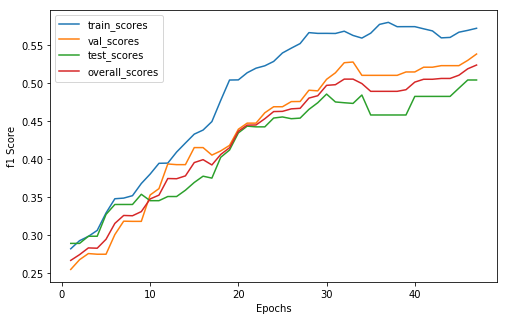

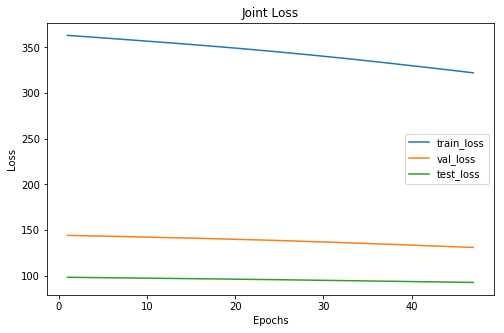

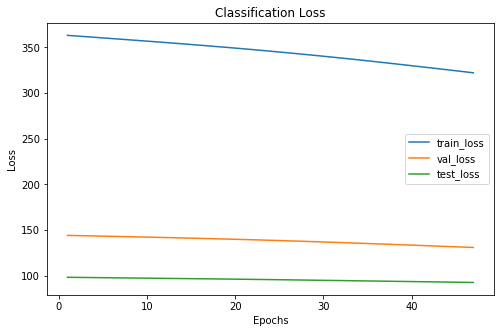

Cofusion Matrix For Val Set: 
--  --  --
23  19  11
 7  29  14
 6   3  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     36      21
 1      135     51      36
 2      118     43      31
xxxxxxxxxxxxxx epoch: 47 xxxxxxxxxxxxxx


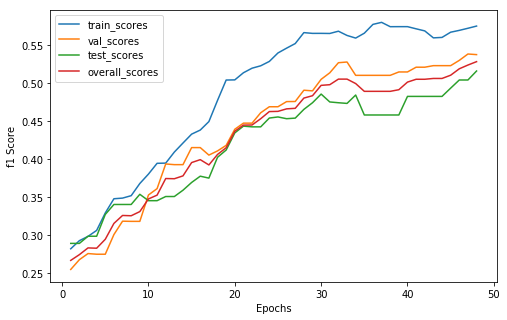

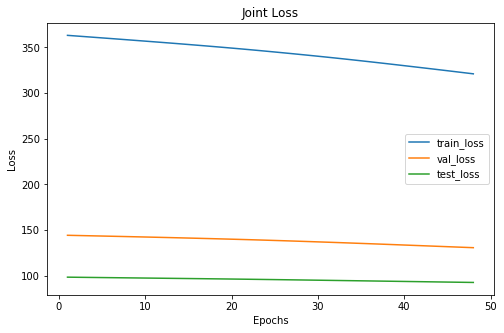

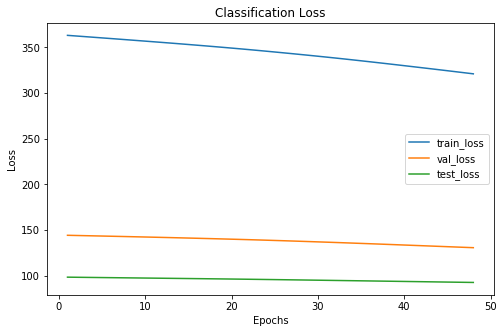

Cofusion Matrix For Val Set: 
--  --  --
23  19  11
 8  29  13
 6   3  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     37      22
 1      137     51      36
 2      116     42      30
xxxxxxxxxxxxxx epoch: 48 xxxxxxxxxxxxxx


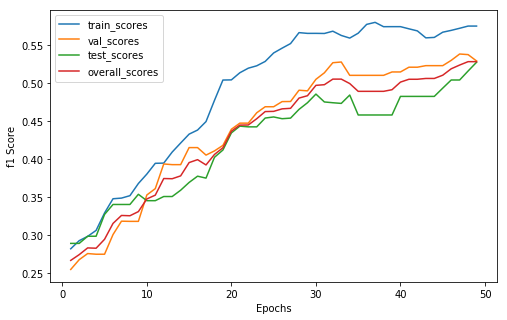

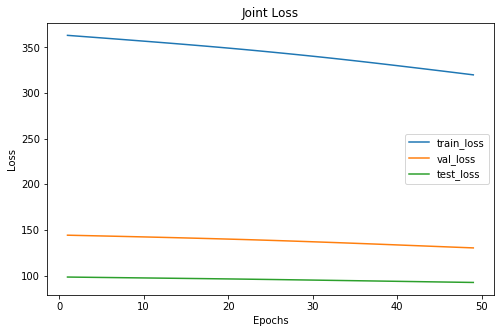

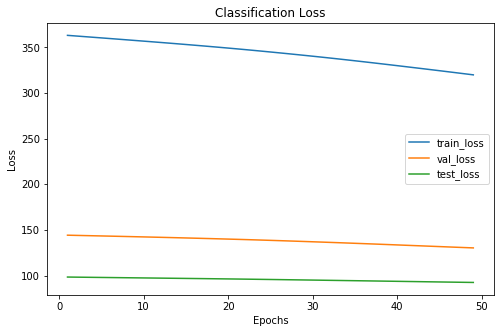

Cofusion Matrix For Val Set: 
--  --  --
22  19  12
 8  29  13
 6   3  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     36      23
 1      137     51      36
 2      116     43      29
xxxxxxxxxxxxxx epoch: 49 xxxxxxxxxxxxxx


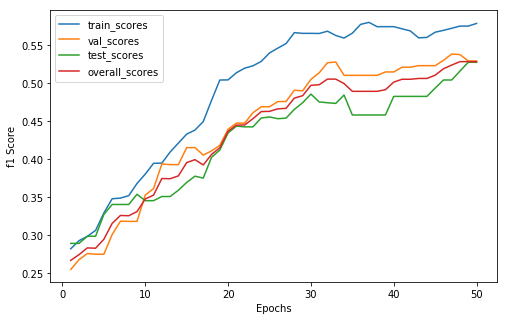

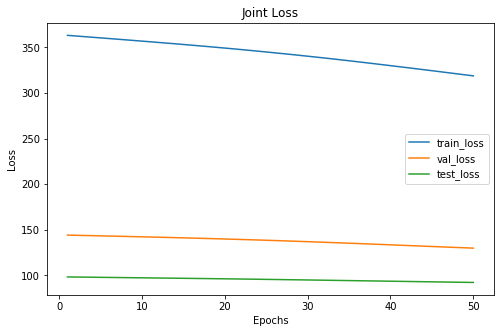

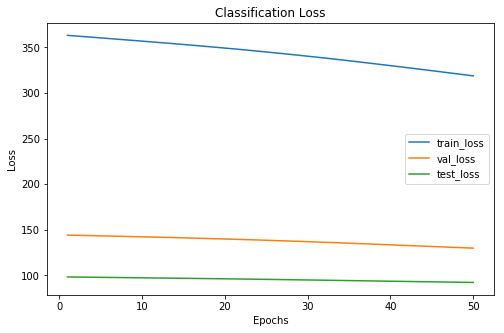

Cofusion Matrix For Val Set: 
--  --  --
22  19  12
 8  29  13
 6   3  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       75     36      23
 1      137     51      36
 2      115     43      29
xxxxxxxxxxxxxx epoch: 50 xxxxxxxxxxxxxx


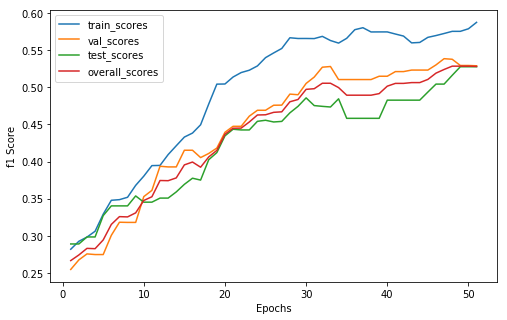

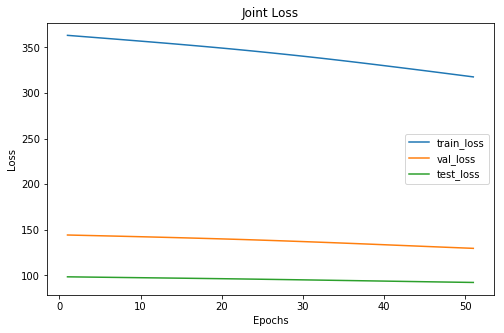

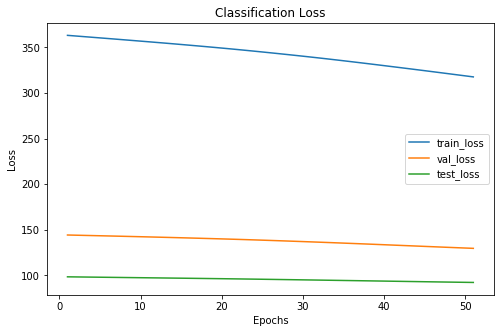

Cofusion Matrix For Val Set: 
--  --  --
22  19  12
 8  28  14
 5   3  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       75     35      23
 1      138     50      36
 2      114     45      29
xxxxxxxxxxxxxx epoch: 51 xxxxxxxxxxxxxx


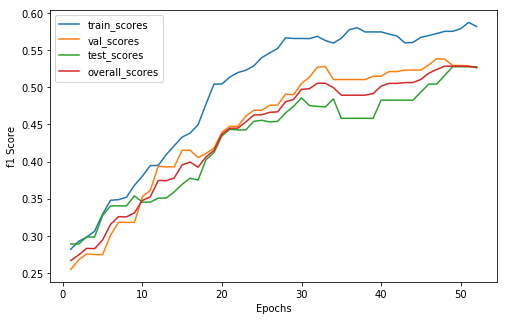

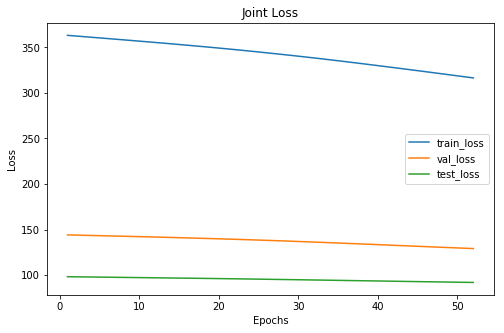

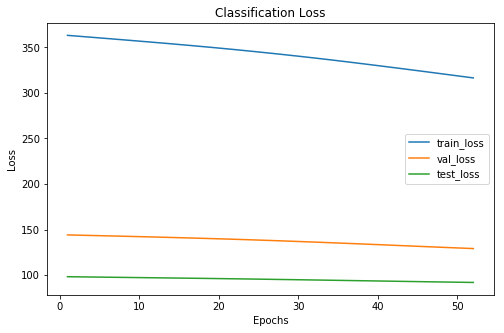

Cofusion Matrix For Val Set: 
--  --  --
21  20  12
 8  28  14
 4   3  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       75     33      23
 1      140     51      36
 2      112     46      29
xxxxxxxxxxxxxx epoch: 52 xxxxxxxxxxxxxx


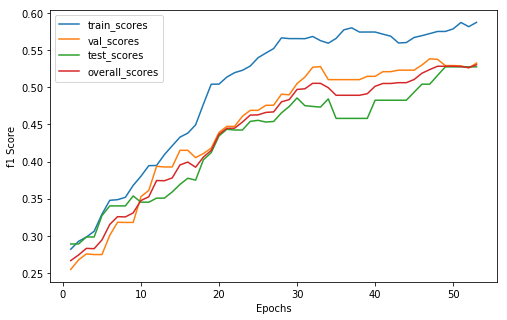

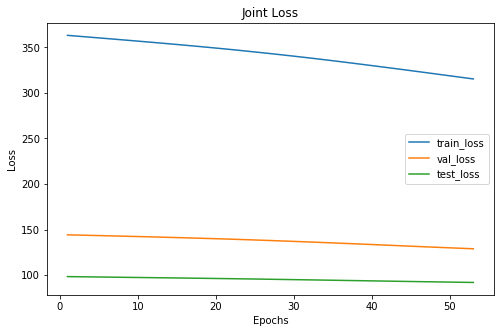

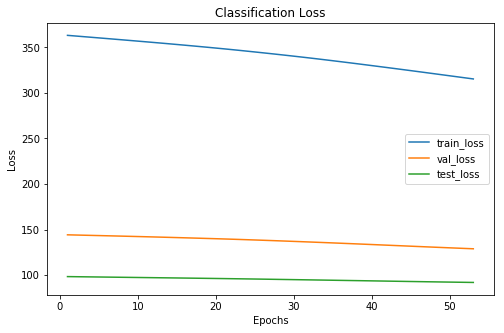

Cofusion Matrix For Val Set: 
--  --  --
21  20  12
 8  28  14
 3   3  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     32      23
 1      140     51      36
 2      113     47      29
xxxxxxxxxxxxxx epoch: 53 xxxxxxxxxxxxxx


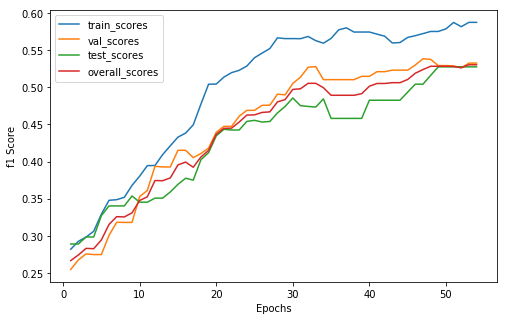

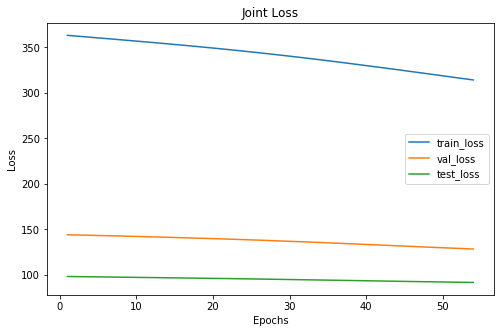

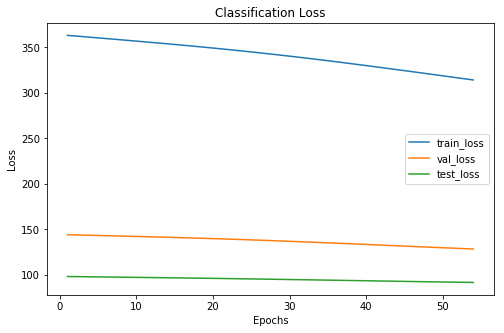

Cofusion Matrix For Val Set: 
--  --  --
21  20  12
 8  28  14
 3   3  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     32      23
 1      140     51      36
 2      113     47      29
xxxxxxxxxxxxxx epoch: 54 xxxxxxxxxxxxxx


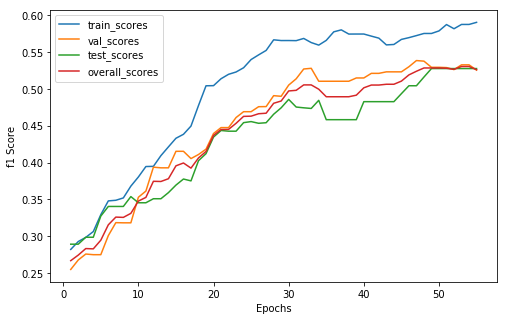

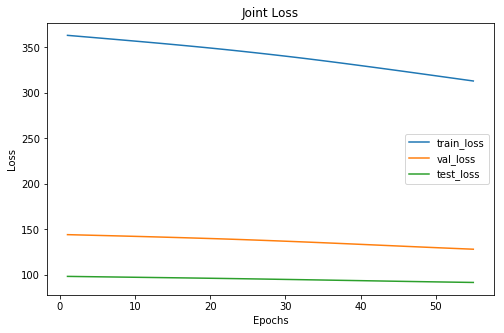

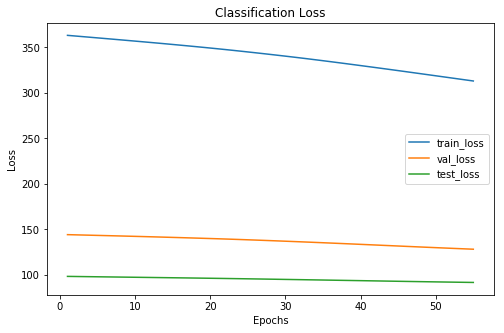

Cofusion Matrix For Val Set: 
--  --  --
21  20  12
 8  27  15
 3   3  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     32      23
 1      139     50      36
 2      114     48      29
xxxxxxxxxxxxxx epoch: 55 xxxxxxxxxxxxxx


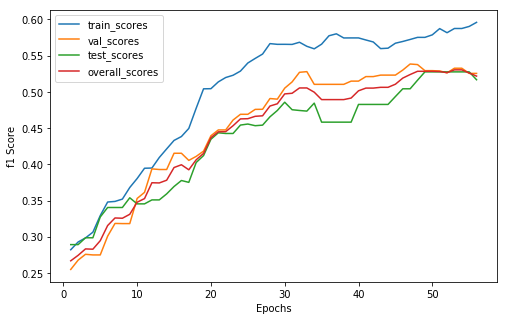

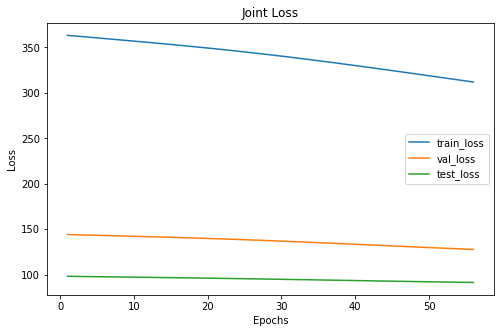

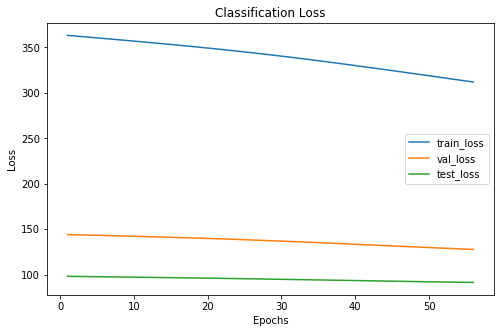

Cofusion Matrix For Val Set: 
--  --  --
21  20  12
 8  27  15
 3   3  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     32      23
 1      137     50      35
 2      116     48      30
xxxxxxxxxxxxxx epoch: 56 xxxxxxxxxxxxxx


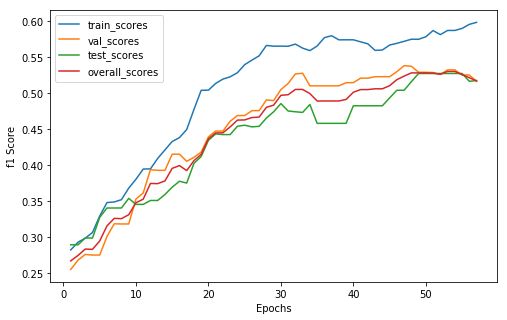

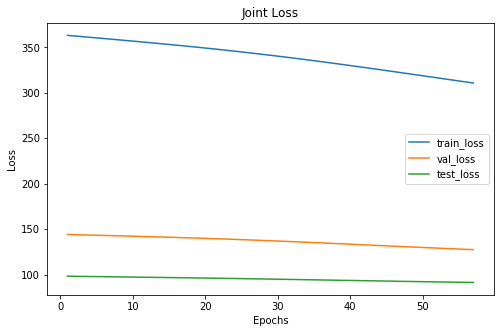

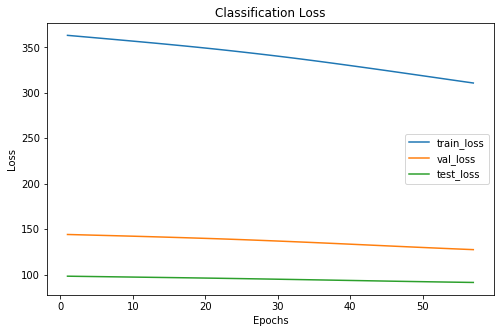

Cofusion Matrix For Val Set: 
--  --  --
20  20  13
 8  27  15
 3   3  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     31      22
 1      136     50      35
 2      117     49      31
xxxxxxxxxxxxxx epoch: 57 xxxxxxxxxxxxxx


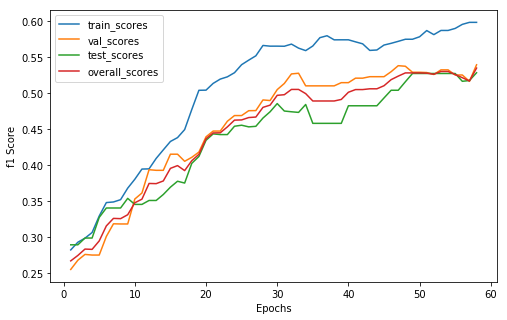

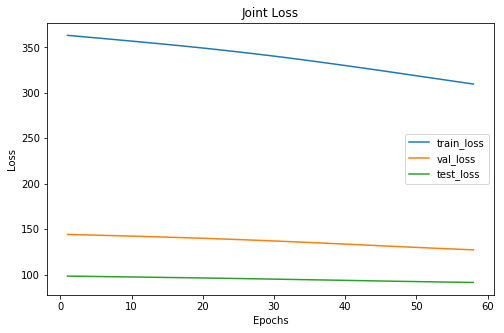

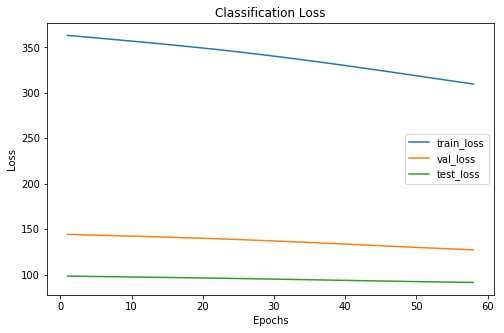

Cofusion Matrix For Val Set: 
--  --  --
21  20  12
 8  29  13
 3   3  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     32      22
 1      136     52      36
 2      117     46      30
xxxxxxxxxxxxxx epoch: 58 xxxxxxxxxxxxxx


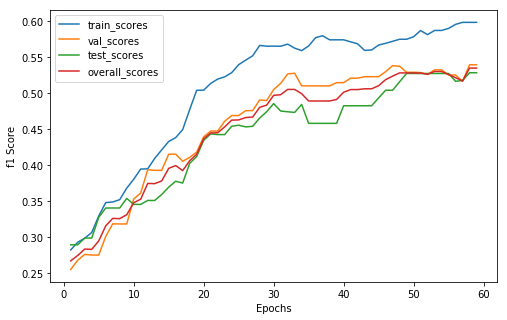

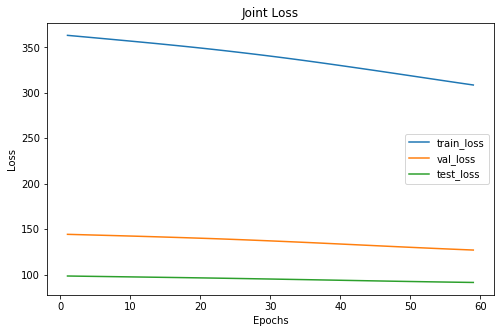

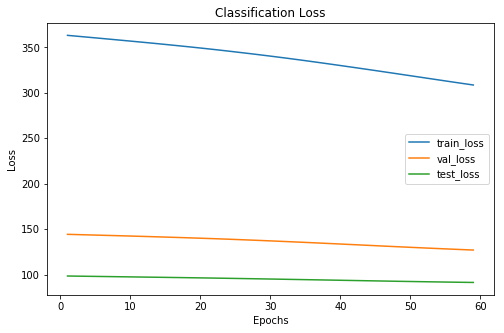

Cofusion Matrix For Val Set: 
--  --  --
21  20  12
 8  29  13
 3   3  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     32      22
 1      136     52      36
 2      117     46      30
xxxxxxxxxxxxxx epoch: 59 xxxxxxxxxxxxxx


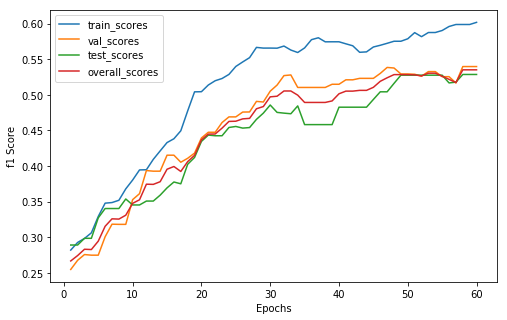

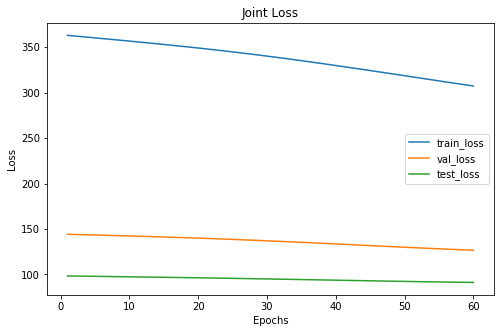

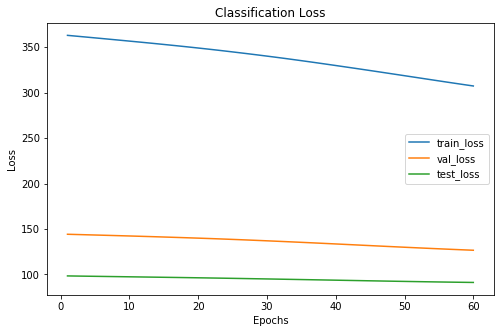

Cofusion Matrix For Val Set: 
--  --  --
21  20  12
 8  29  13
 3   3  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       73     32      22
 1      137     52      36
 2      117     46      30
xxxxxxxxxxxxxx epoch: 60 xxxxxxxxxxxxxx


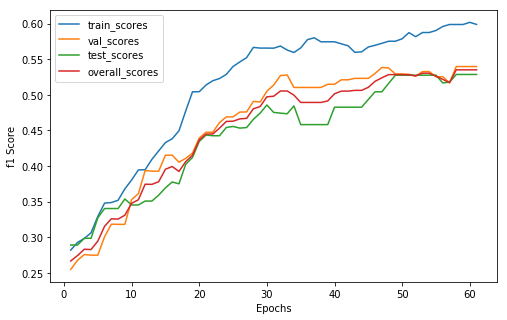

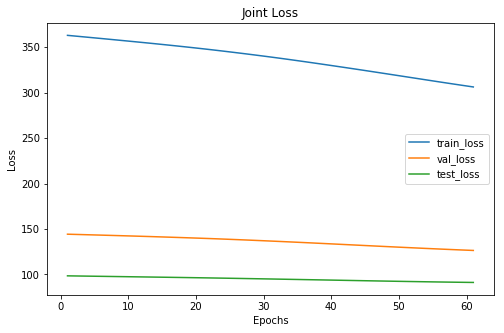

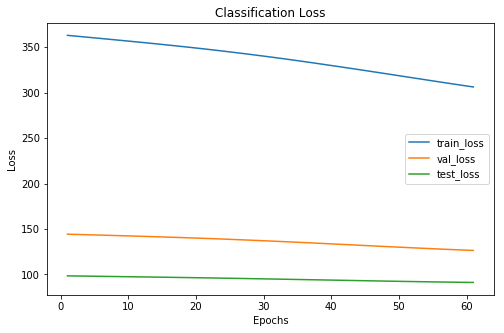

Cofusion Matrix For Val Set: 
--  --  --
21  20  12
 8  29  13
 3   3  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       73     32      22
 1      135     52      36
 2      119     46      30
xxxxxxxxxxxxxx epoch: 61 xxxxxxxxxxxxxx


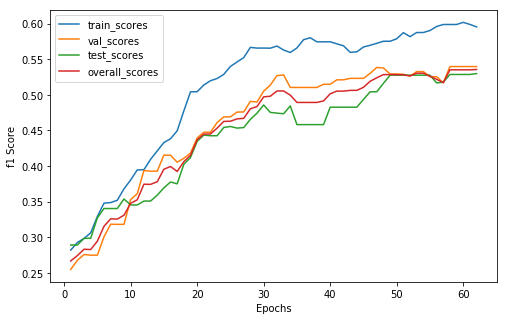

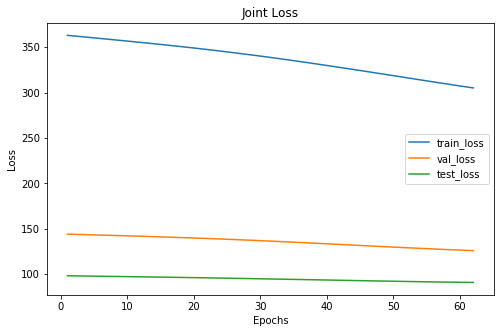

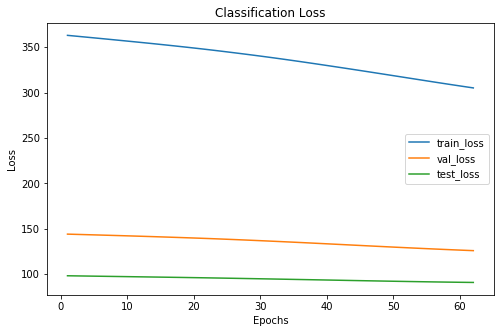

Cofusion Matrix For Val Set: 
--  --  --
21  20  12
 8  29  13
 3   3  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       72     32      21
 1      135     52      36
 2      120     46      31
xxxxxxxxxxxxxx epoch: 62 xxxxxxxxxxxxxx


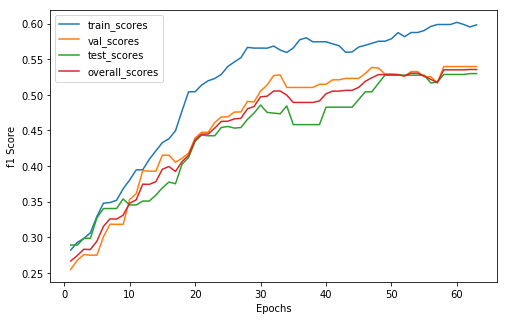

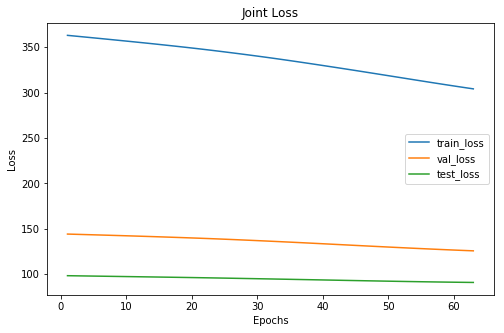

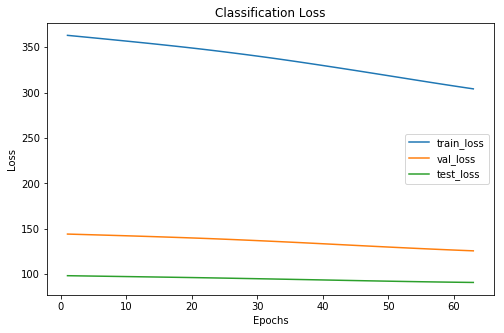

Cofusion Matrix For Val Set: 
--  --  --
21  20  12
 8  29  13
 3   3  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       72     32      21
 1      136     52      36
 2      119     46      31
xxxxxxxxxxxxxx epoch: 63 xxxxxxxxxxxxxx


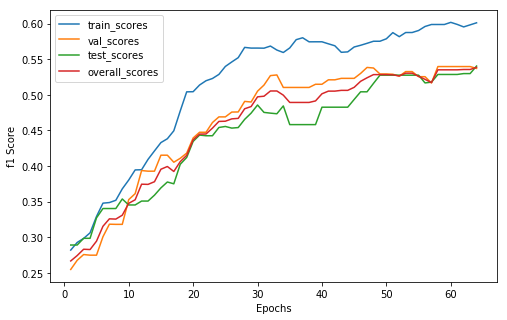

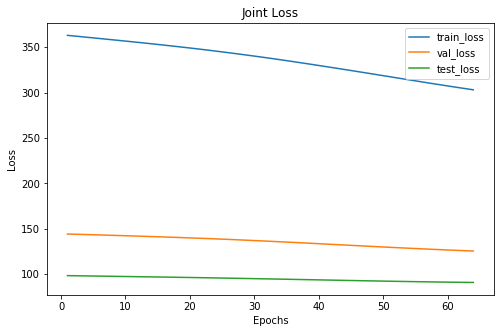

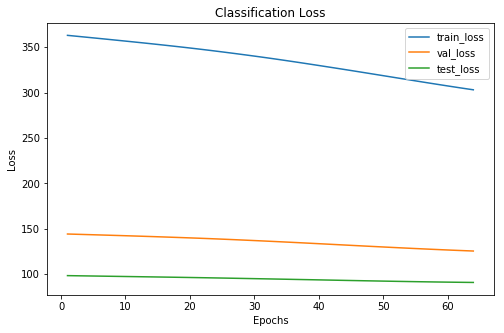

Cofusion Matrix For Val Set: 
--  --  --
20  20  13
 8  29  13
 2   3  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       72     30      21
 1      137     52      37
 2      118     48      30
xxxxxxxxxxxxxx epoch: 64 xxxxxxxxxxxxxx


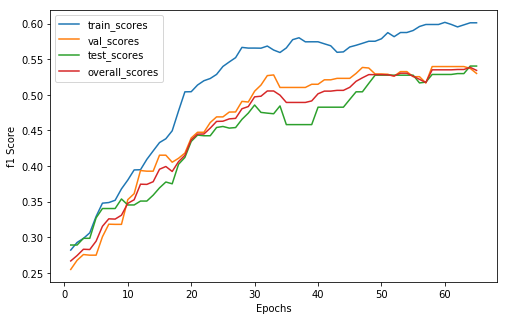

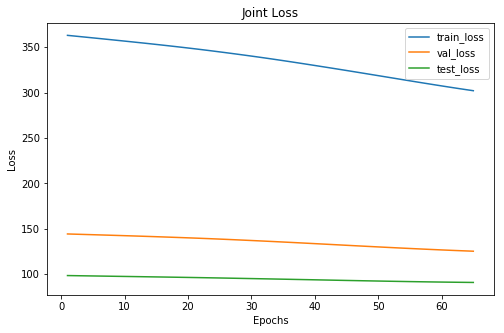

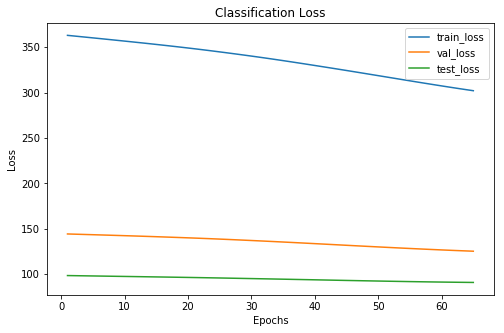

Cofusion Matrix For Val Set: 
--  --  --
20  20  13
 8  28  14
 2   3  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       72     30      21
 1      137     51      37
 2      118     49      30
xxxxxxxxxxxxxx epoch: 65 xxxxxxxxxxxxxx


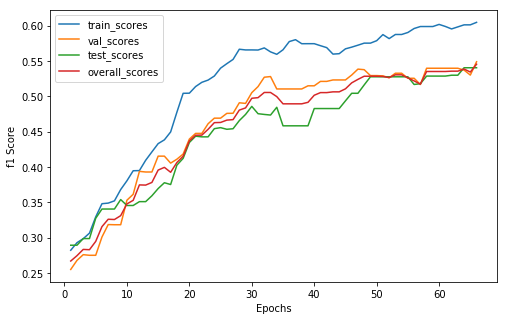

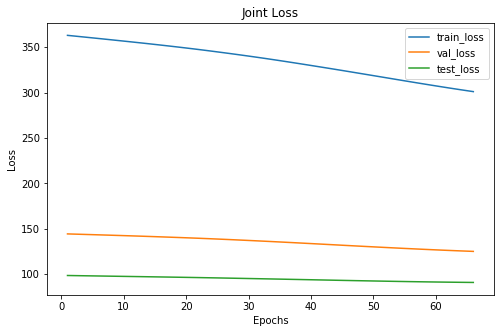

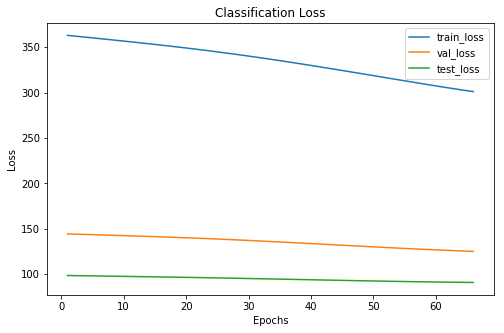

Cofusion Matrix For Val Set: 
--  --  --
22  18  13
 8  28  14
 2   3  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       73     32      21
 1      136     49      37
 2      118     49      30
xxxxxxxxxxxxxx epoch: 66 xxxxxxxxxxxxxx


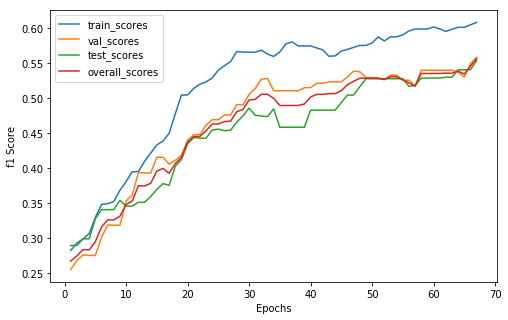

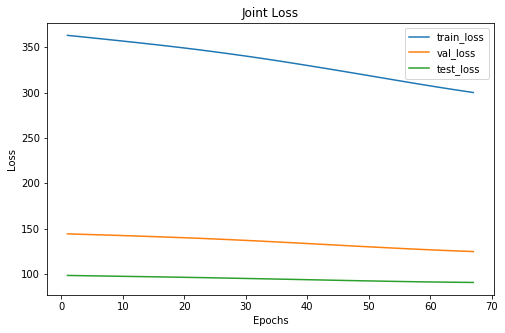

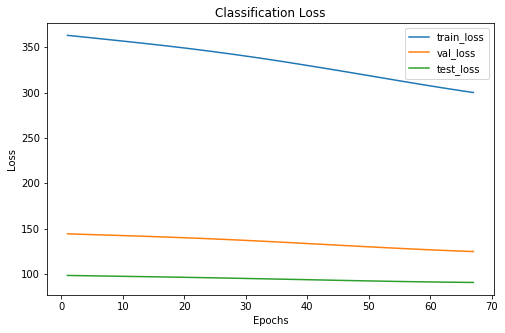

Cofusion Matrix For Val Set: 
--  --  --
23  17  13
 8  28  14
 2   3  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     33      22
 1      134     48      36
 2      119     49      30
xxxxxxxxxxxxxx epoch: 67 xxxxxxxxxxxxxx


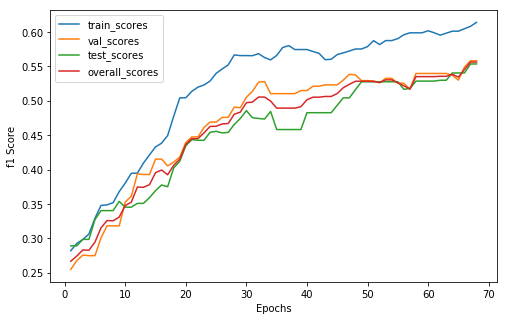

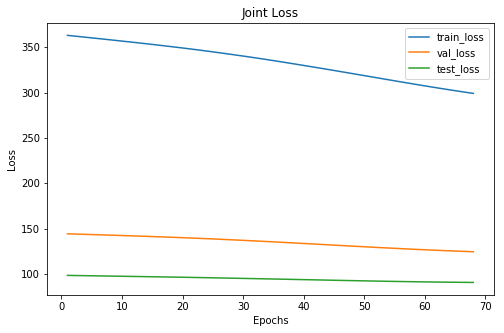

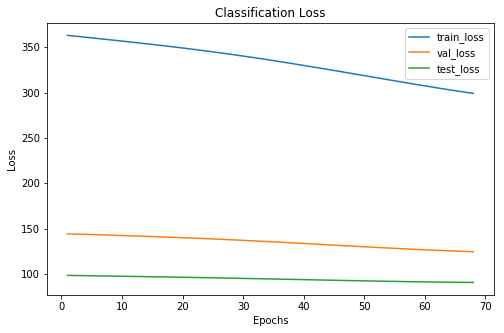

Cofusion Matrix For Val Set: 
--  --  --
23  17  13
 8  28  14
 2   3  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     33      22
 1      136     48      36
 2      117     49      30
xxxxxxxxxxxxxx epoch: 68 xxxxxxxxxxxxxx


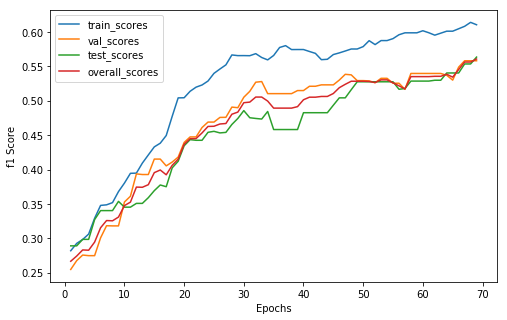

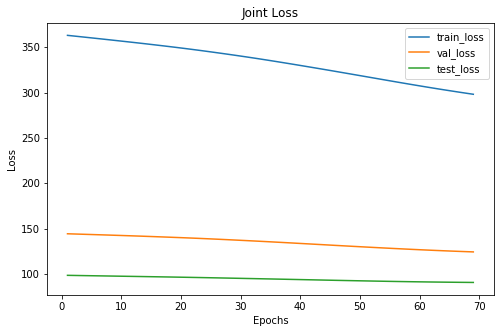

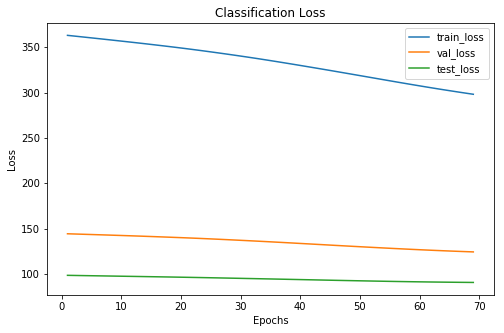

Cofusion Matrix For Val Set: 
--  --  --
23  17  13
 8  28  14
 2   3  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       73     33      20
 1      138     48      39
 2      116     49      29
xxxxxxxxxxxxxx epoch: 69 xxxxxxxxxxxxxx


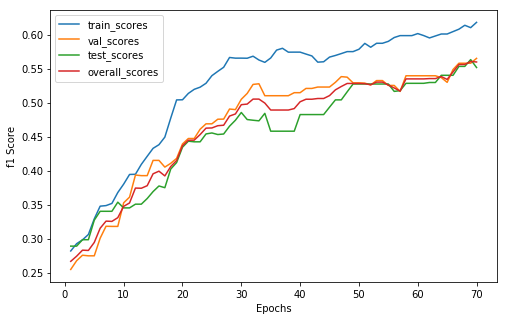

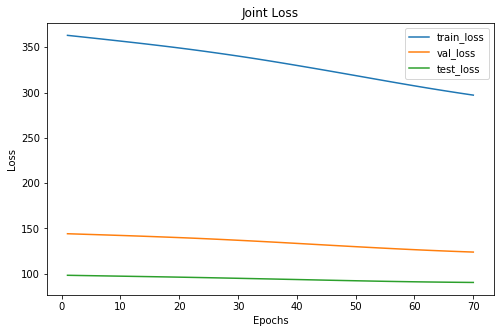

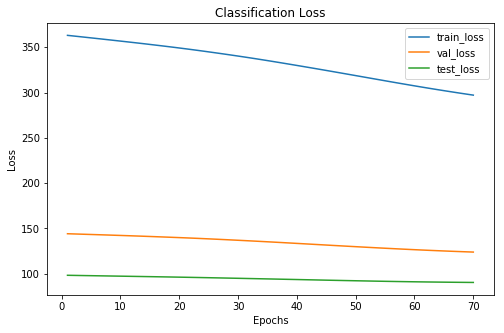

Cofusion Matrix For Val Set: 
--  --  --
23  17  13
 8  29  13
 2   3  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       72     33      19
 1      142     49      39
 2      113     48      30
xxxxxxxxxxxxxx epoch: 70 xxxxxxxxxxxxxx


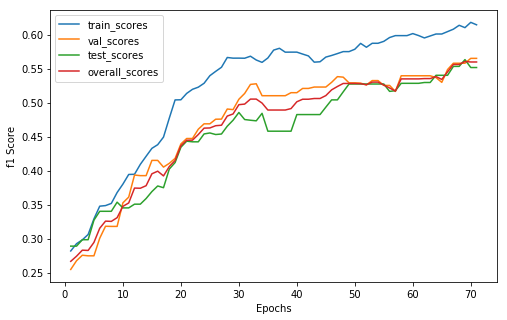

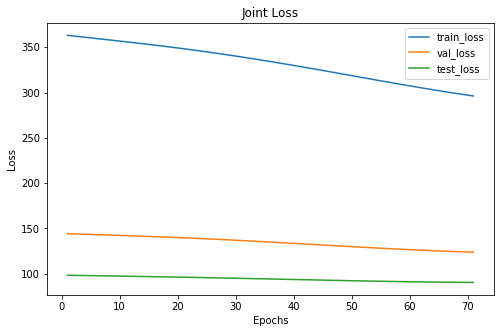

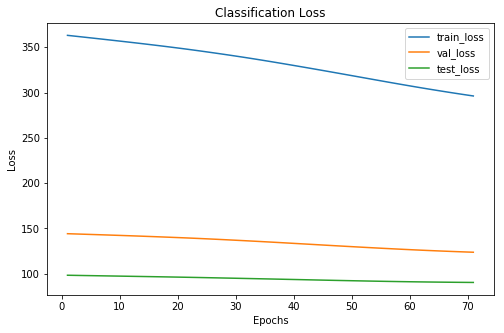

Cofusion Matrix For Val Set: 
--  --  --
23  17  13
 8  29  13
 2   3  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       71     33      19
 1      143     49      39
 2      113     48      30
xxxxxxxxxxxxxx epoch: 71 xxxxxxxxxxxxxx


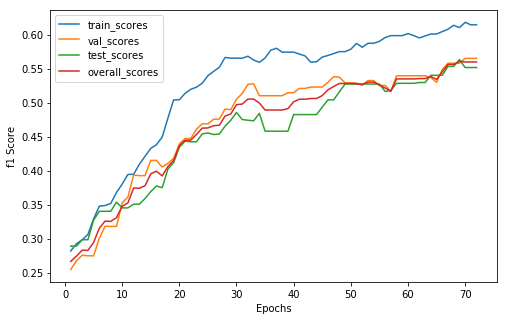

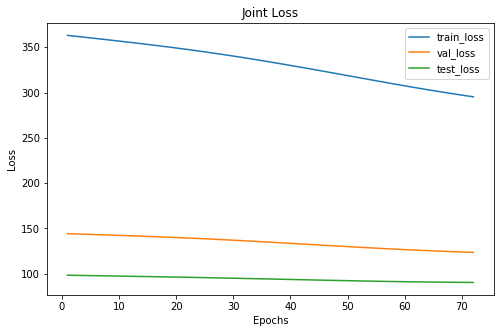

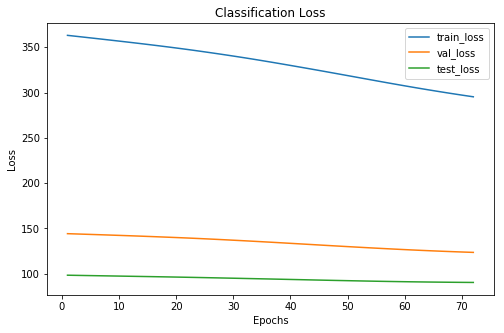

Cofusion Matrix For Val Set: 
--  --  --
23  17  13
 8  29  13
 2   3  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       71     33      19
 1      143     49      39
 2      113     48      30
xxxxxxxxxxxxxx epoch: 72 xxxxxxxxxxxxxx


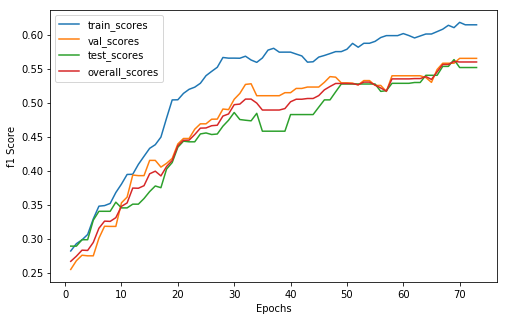

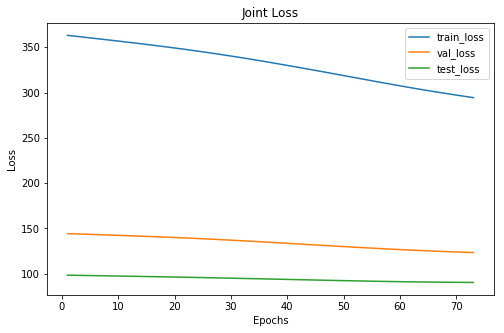

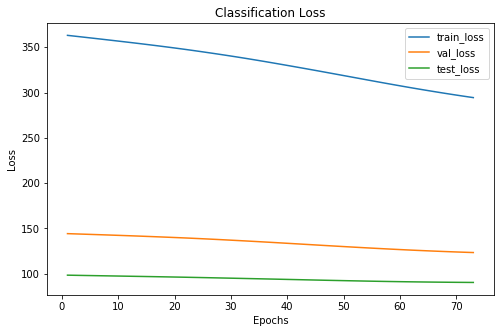

Cofusion Matrix For Val Set: 
--  --  --
23  17  13
 8  29  13
 2   3  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       71     33      19
 1      143     49      39
 2      113     48      30
xxxxxxxxxxxxxx epoch: 73 xxxxxxxxxxxxxx


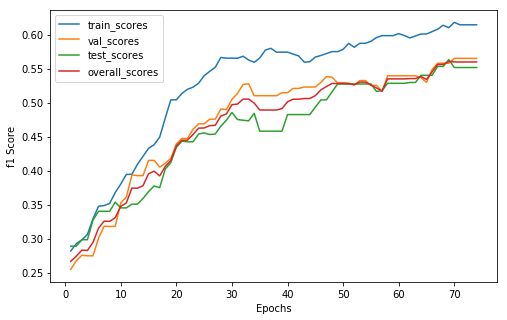

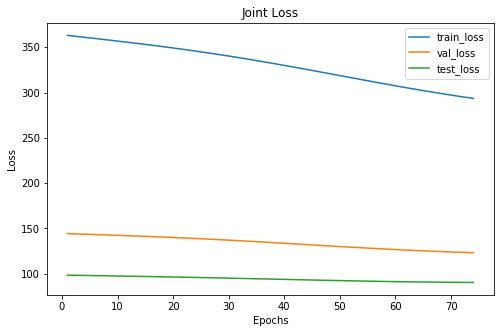

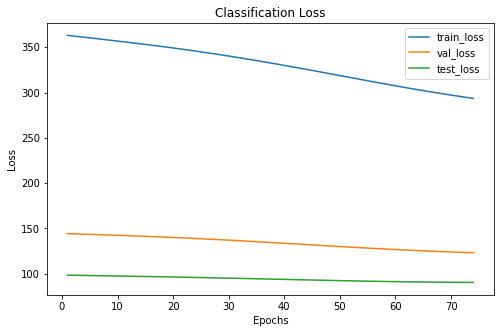

Cofusion Matrix For Val Set: 
--  --  --
23  17  13
 8  29  13
 2   3  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       71     33      19
 1      143     49      39
 2      113     48      30
xxxxxxxxxxxxxx epoch: 74 xxxxxxxxxxxxxx


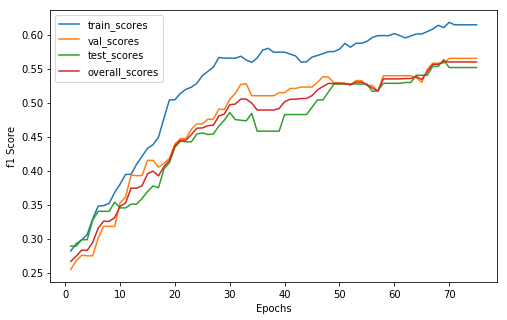

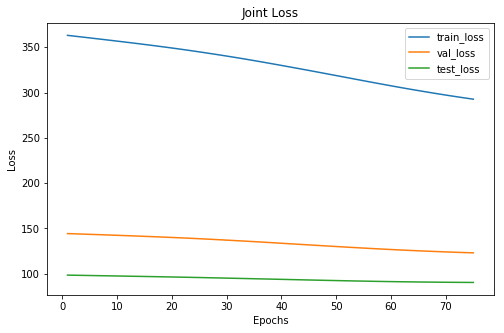

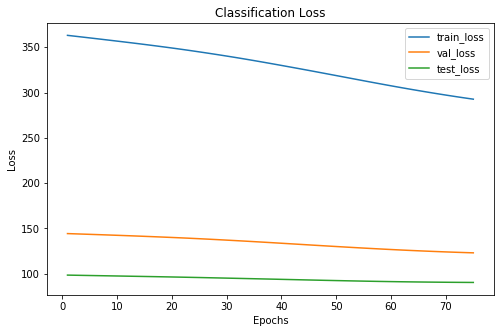

Cofusion Matrix For Val Set: 
--  --  --
23  17  13
 8  29  13
 2   3  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       71     33      19
 1      143     49      39
 2      113     48      30
xxxxxxxxxxxxxx epoch: 75 xxxxxxxxxxxxxx


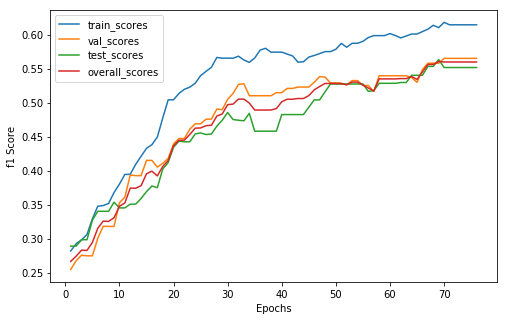

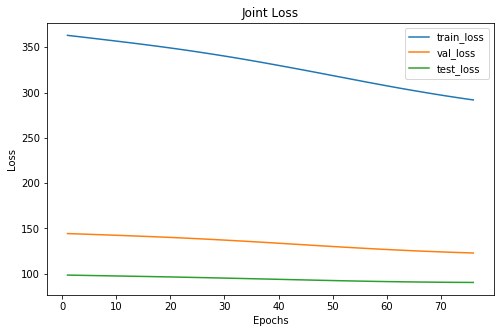

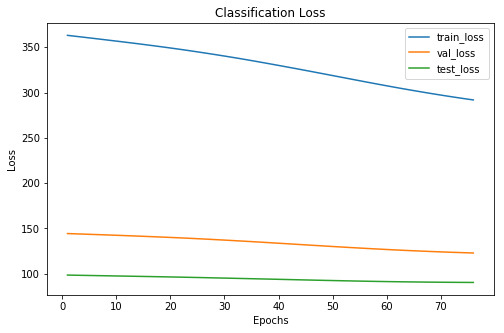

Cofusion Matrix For Val Set: 
--  --  --
23  17  13
 8  29  13
 2   3  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       71     33      19
 1      143     49      39
 2      113     48      30
xxxxxxxxxxxxxx epoch: 76 xxxxxxxxxxxxxx


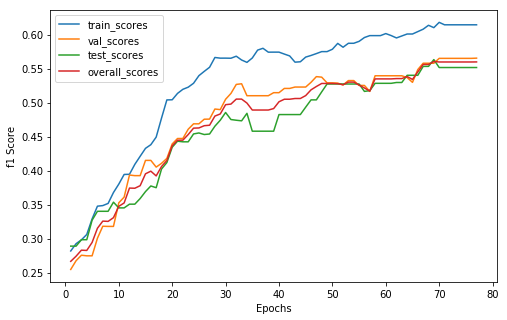

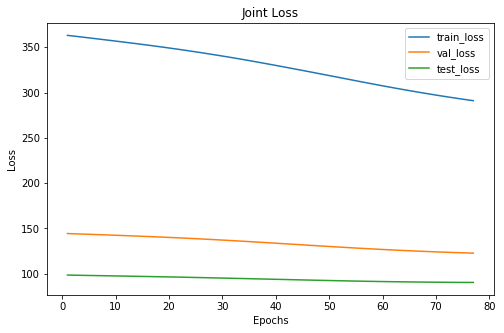

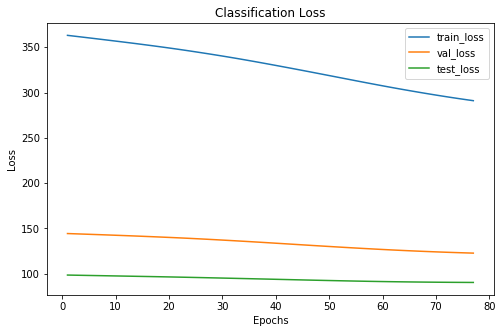

Cofusion Matrix For Val Set: 
--  --  --
23  17  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       71     32      19
 1      143     50      39
 2      113     48      30
xxxxxxxxxxxxxx epoch: 77 xxxxxxxxxxxxxx


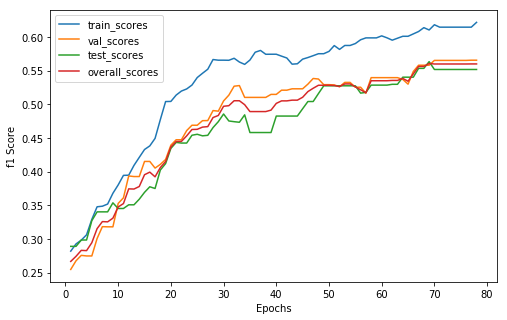

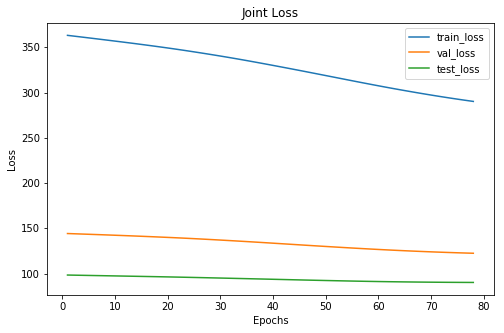

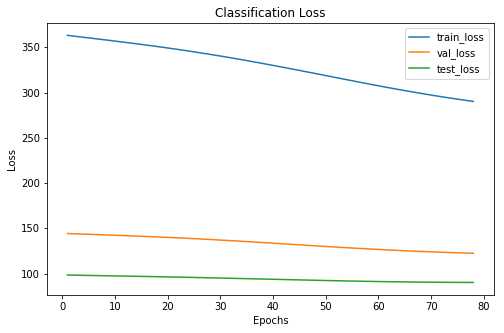

Cofusion Matrix For Val Set: 
--  --  --
23  17  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       73     32      19
 1      142     50      39
 2      112     48      30
xxxxxxxxxxxxxx epoch: 78 xxxxxxxxxxxxxx


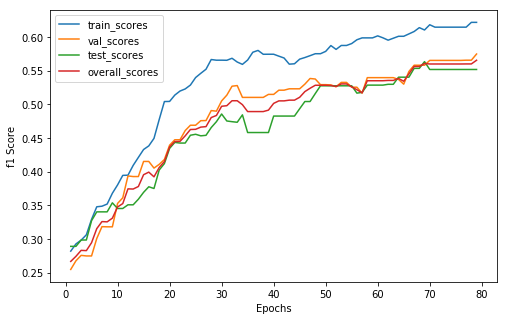

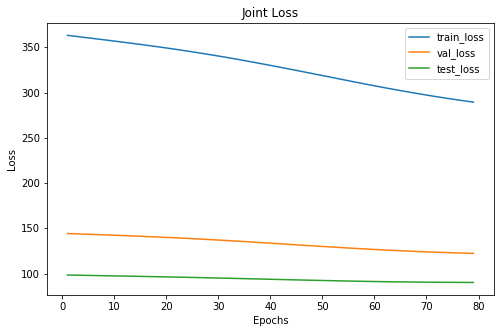

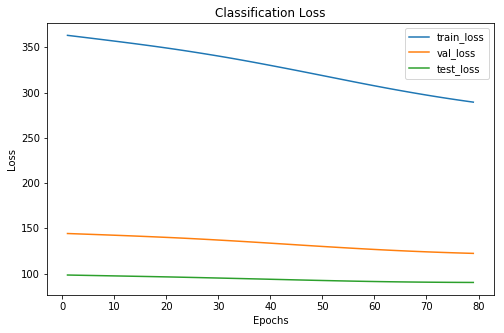

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       73     33      19
 1      142     49      39
 2      112     48      30
xxxxxxxxxxxxxx epoch: 79 xxxxxxxxxxxxxx


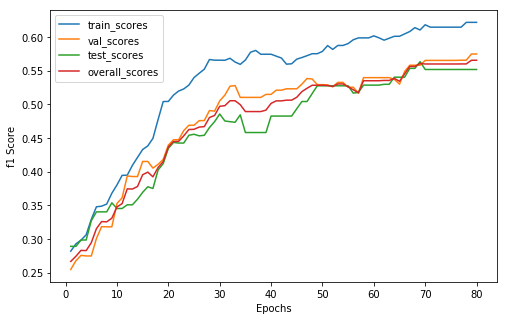

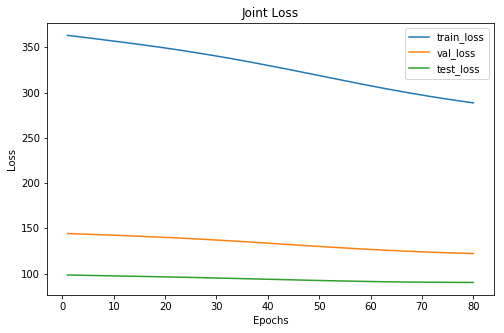

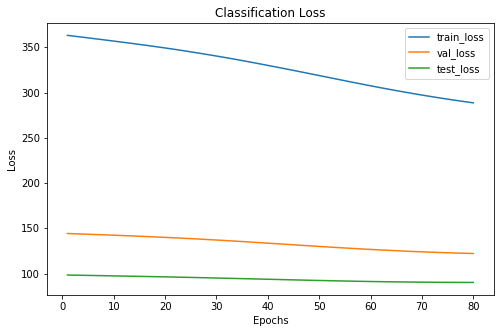

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       73     33      19
 1      142     49      39
 2      112     48      30
xxxxxxxxxxxxxx epoch: 80 xxxxxxxxxxxxxx


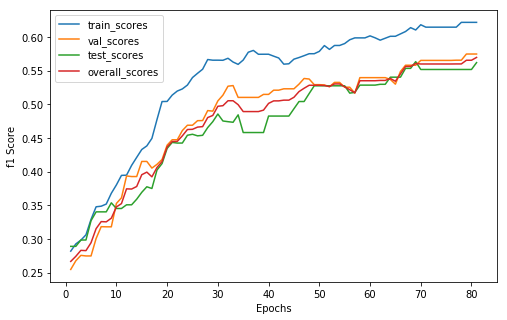

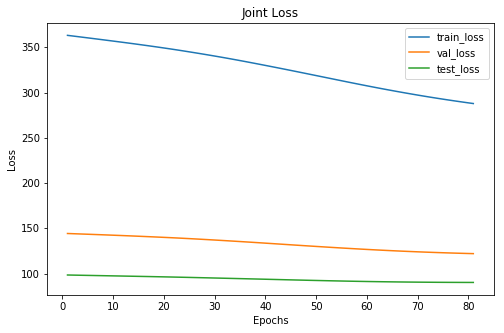

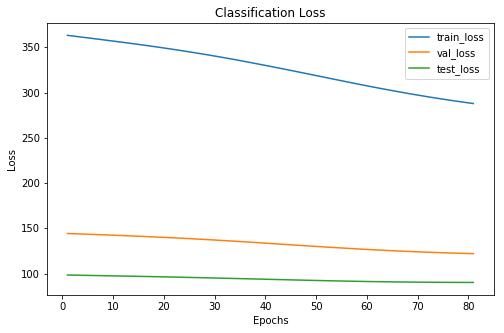

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       73     33      19
 1      142     49      40
 2      112     48      29
xxxxxxxxxxxxxx epoch: 81 xxxxxxxxxxxxxx


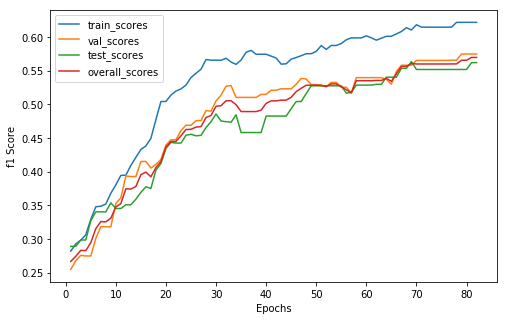

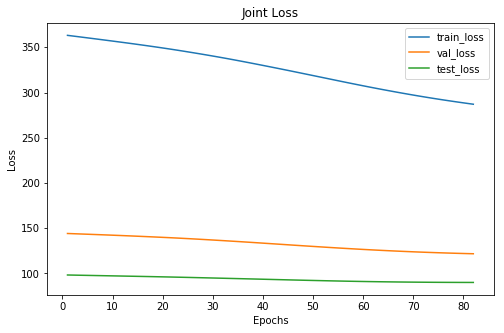

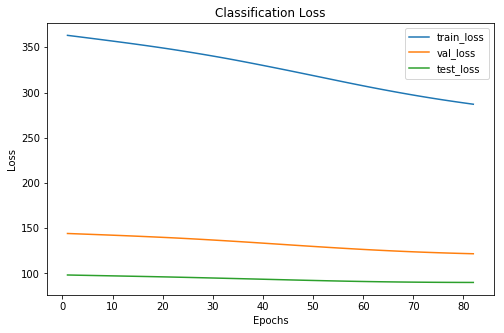

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       73     33      19
 1      142     49      40
 2      112     48      29
xxxxxxxxxxxxxx epoch: 82 xxxxxxxxxxxxxx


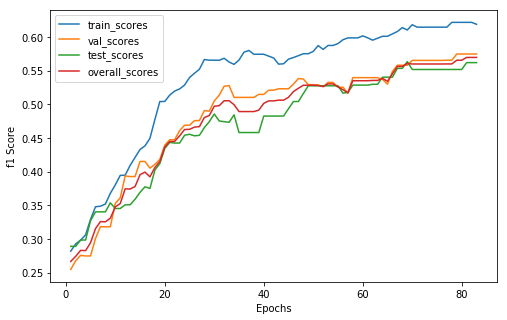

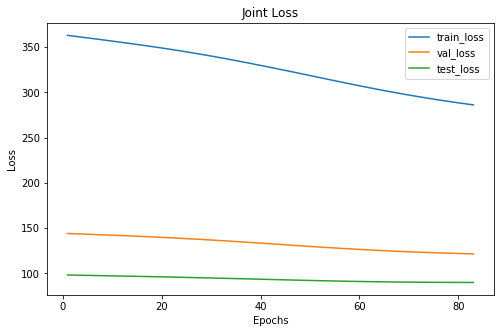

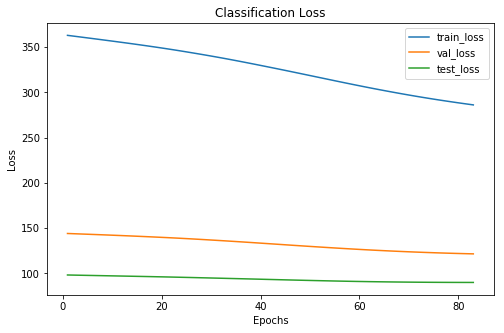

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     33      19
 1      141     49      40
 2      112     48      29
xxxxxxxxxxxxxx epoch: 83 xxxxxxxxxxxxxx


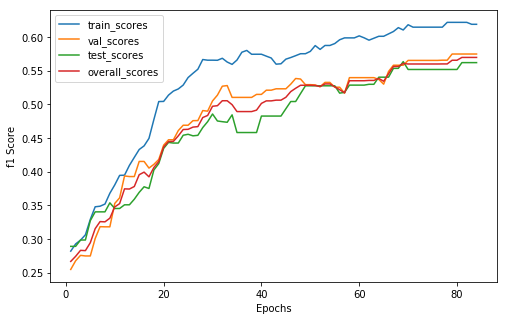

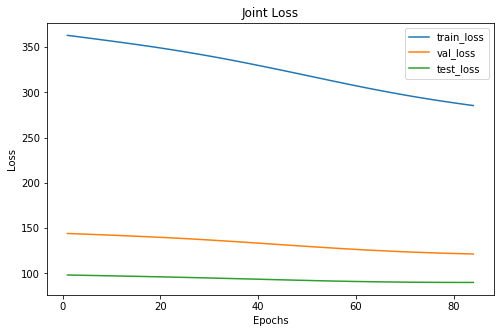

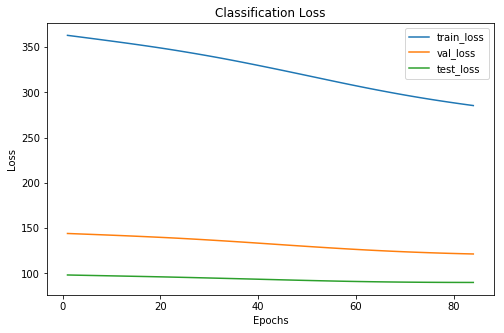

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     33      19
 1      141     49      40
 2      112     48      29
xxxxxxxxxxxxxx epoch: 84 xxxxxxxxxxxxxx


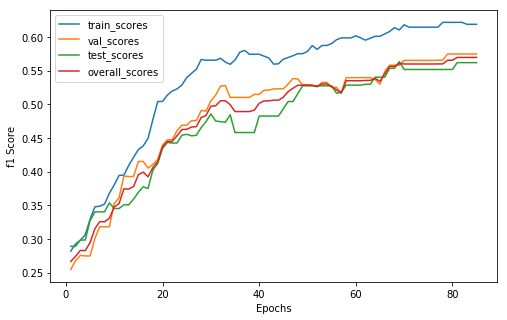

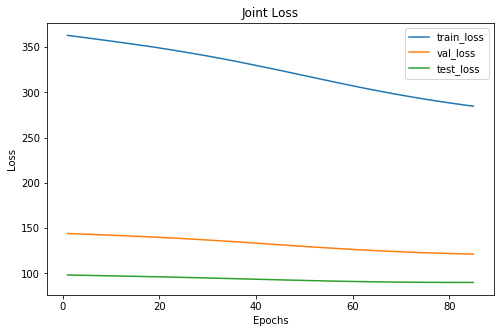

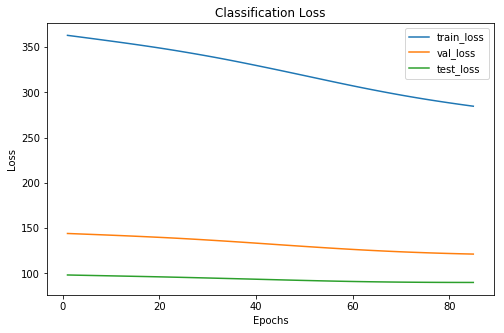

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     33      19
 1      141     49      40
 2      112     48      29
xxxxxxxxxxxxxx epoch: 85 xxxxxxxxxxxxxx


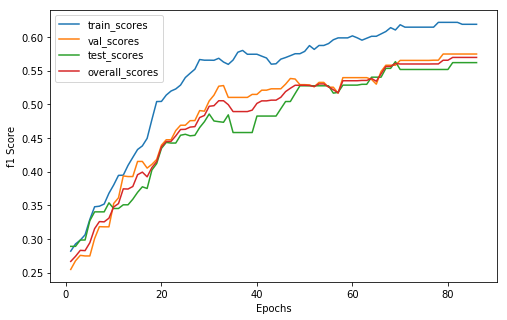

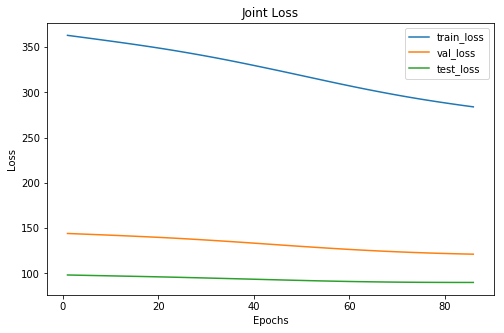

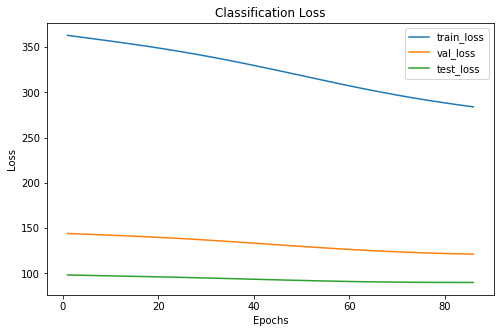

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     33      19
 1      141     49      40
 2      112     48      29
xxxxxxxxxxxxxx epoch: 86 xxxxxxxxxxxxxx


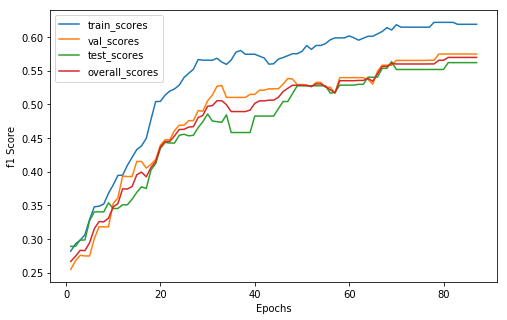

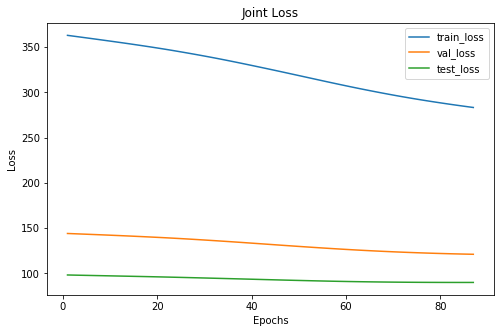

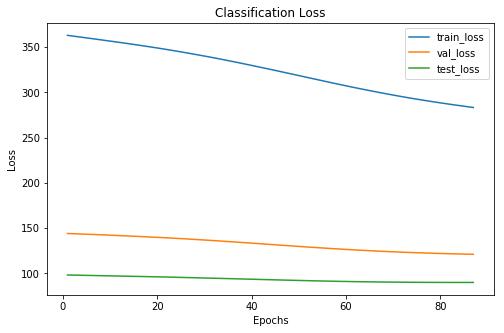

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       74     33      19
 1      141     49      40
 2      112     48      29
xxxxxxxxxxxxxx epoch: 87 xxxxxxxxxxxxxx


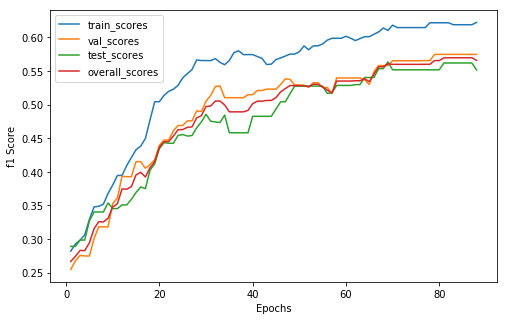

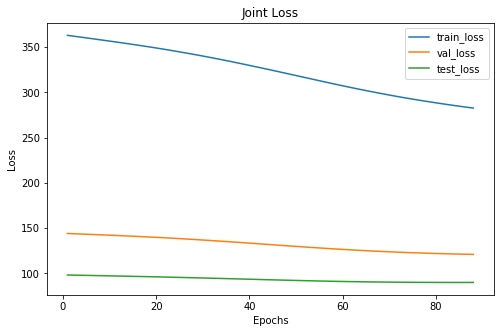

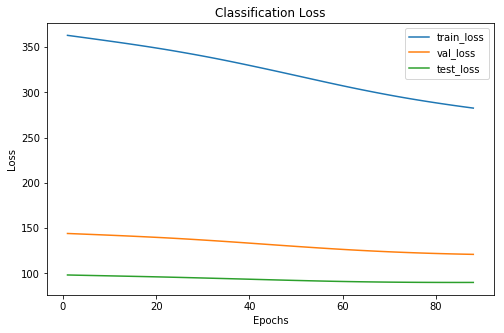

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       75     33      19
 1      141     49      41
 2      111     48      28
xxxxxxxxxxxxxx epoch: 88 xxxxxxxxxxxxxx


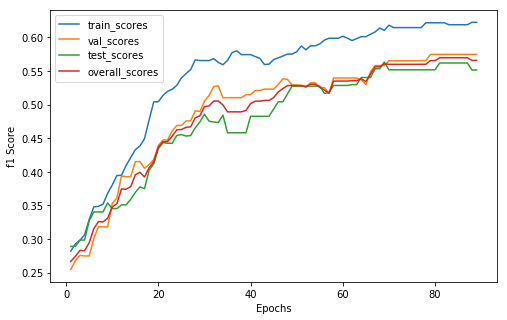

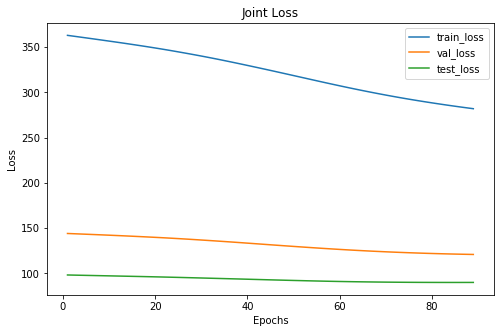

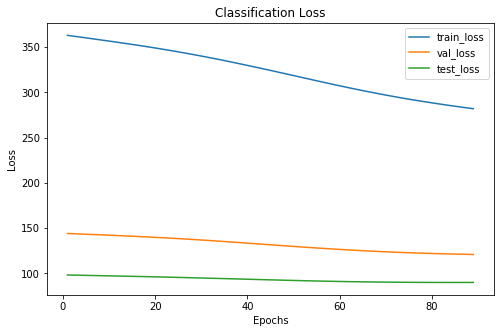

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       76     33      19
 1      141     49      41
 2      110     48      28
xxxxxxxxxxxxxx epoch: 89 xxxxxxxxxxxxxx


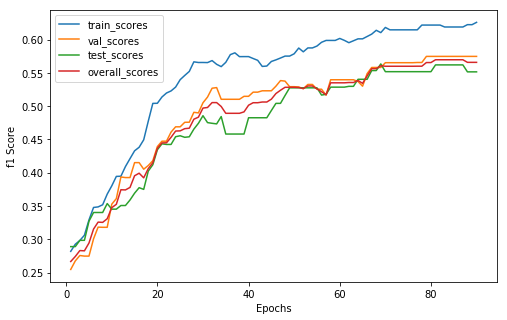

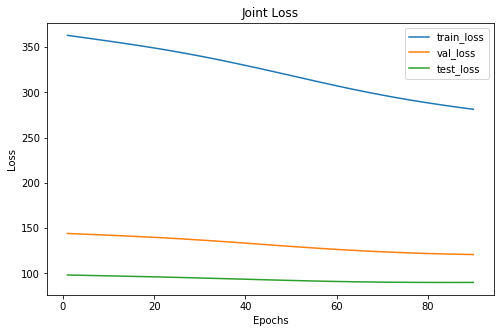

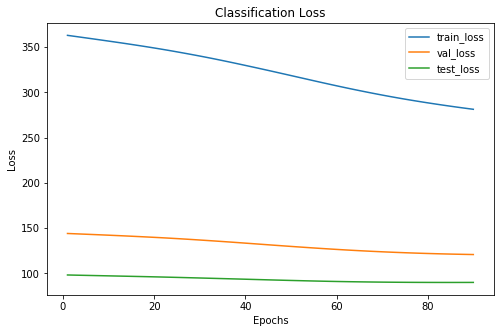

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       77     33      19
 1      140     49      41
 2      110     48      28
xxxxxxxxxxxxxx epoch: 90 xxxxxxxxxxxxxx


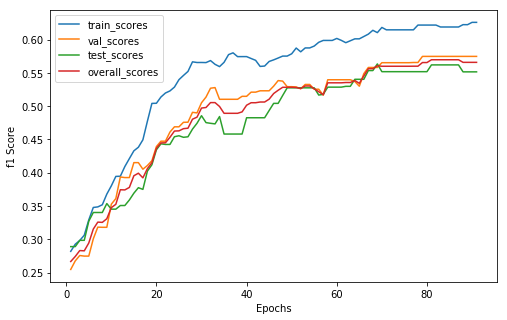

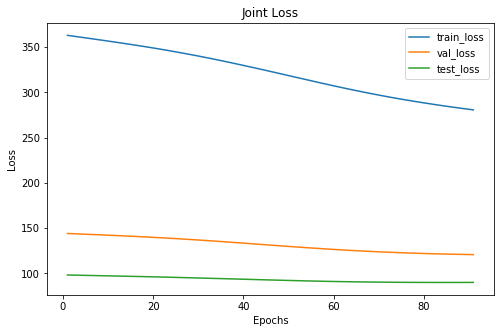

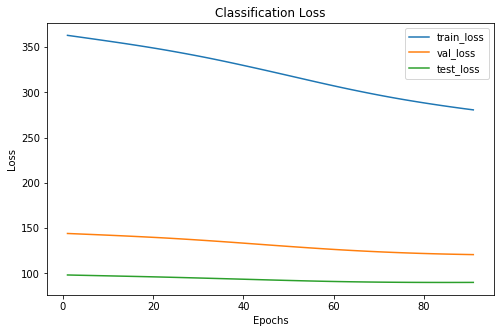

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       77     33      19
 1      140     49      41
 2      110     48      28
xxxxxxxxxxxxxx epoch: 91 xxxxxxxxxxxxxx


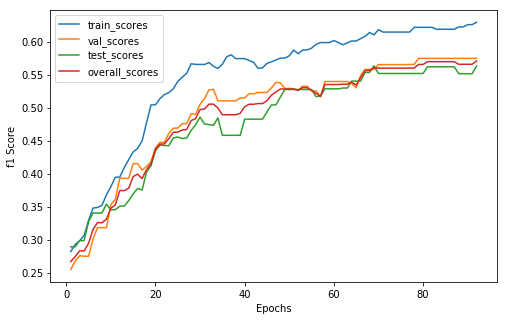

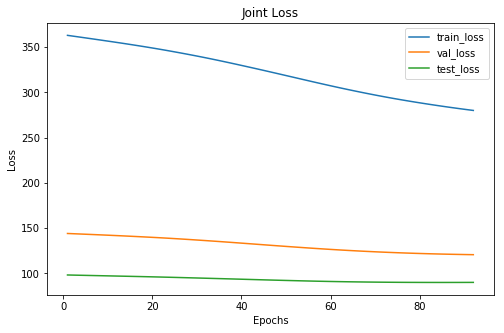

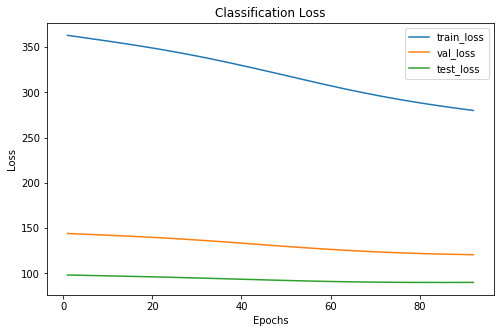

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       78     33      20
 1      140     49      41
 2      109     48      27
xxxxxxxxxxxxxx epoch: 92 xxxxxxxxxxxxxx


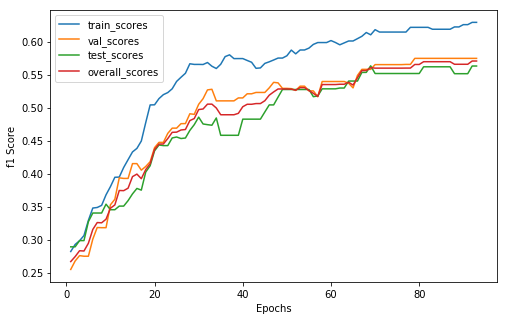

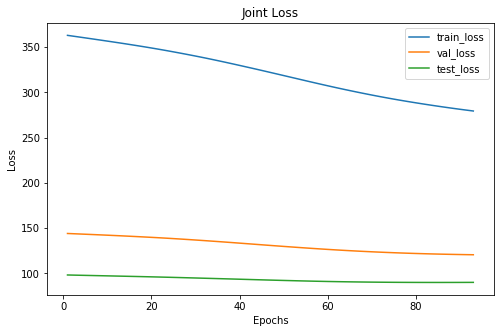

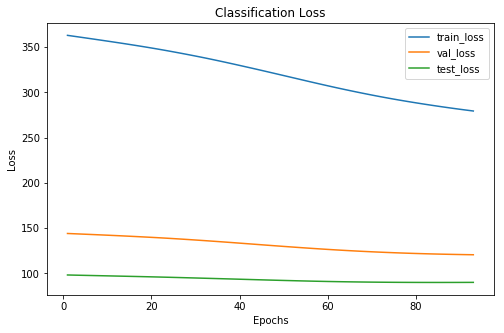

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       78     33      20
 1      140     49      41
 2      109     48      27
xxxxxxxxxxxxxx epoch: 93 xxxxxxxxxxxxxx


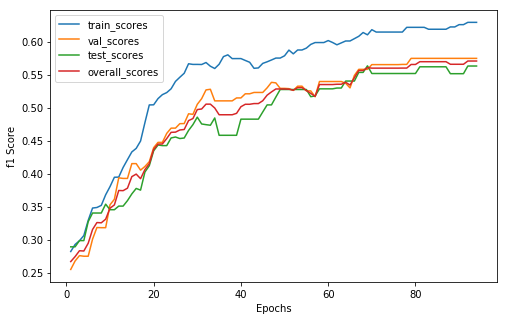

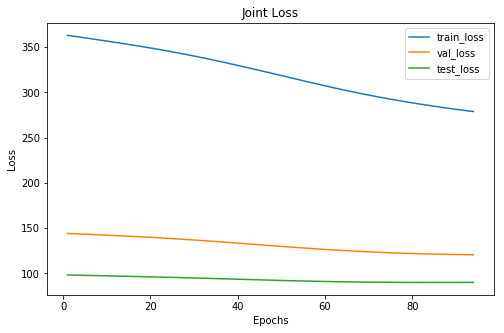

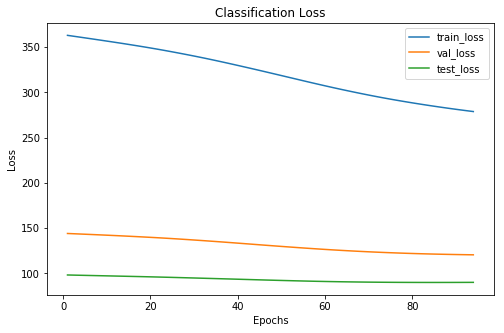

Cofusion Matrix For Val Set: 
--  --  --
24  16  13
 8  29  13
 1   4  22
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       78     33      20
 1      140     49      41
 2      109     48      27
xxxxxxxxxxxxxx epoch: 94 xxxxxxxxxxxxxx


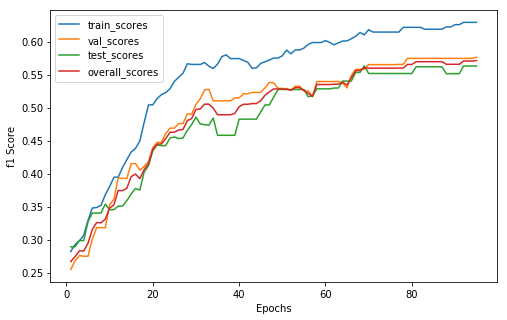

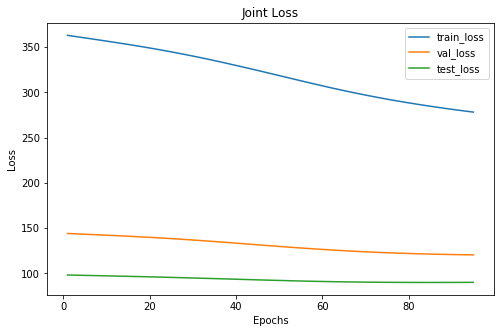

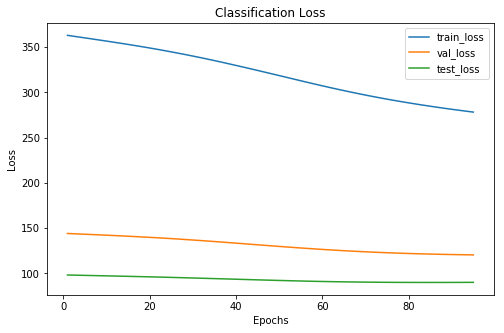

Cofusion Matrix For Val Set: 
--  --  --
25  16  12
 8  29  13
 2   4  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       78     35      20
 1      140     49      41
 2      109     46      27
xxxxxxxxxxxxxx epoch: 95 xxxxxxxxxxxxxx


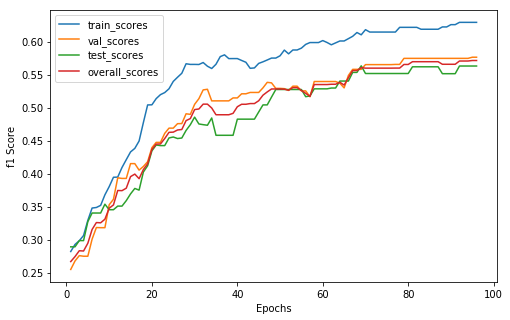

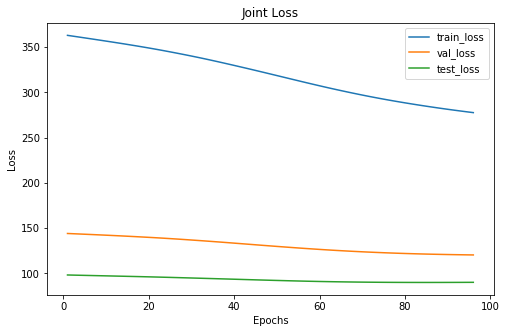

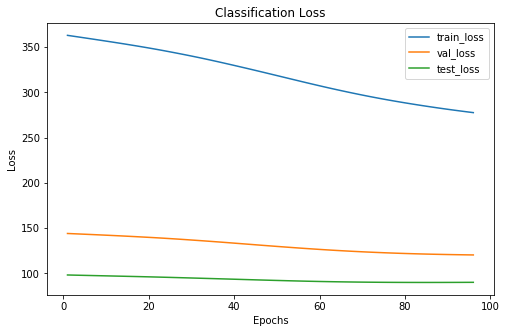

Cofusion Matrix For Val Set: 
--  --  --
25  16  12
 8  29  13
 2   4  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       78     35      20
 1      140     49      41
 2      109     46      27
xxxxxxxxxxxxxx epoch: 96 xxxxxxxxxxxxxx


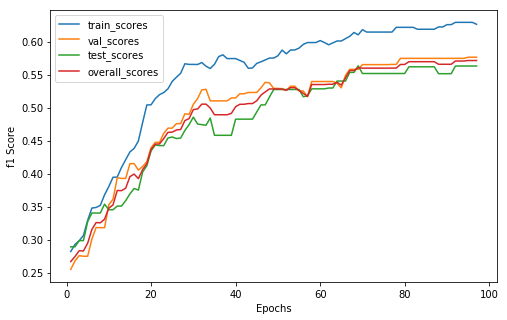

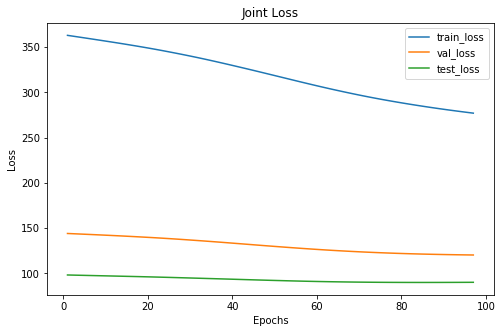

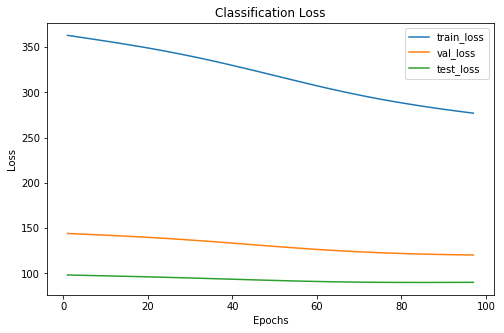

Cofusion Matrix For Val Set: 
--  --  --
25  16  12
 8  29  13
 2   4  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       78     35      20
 1      141     49      41
 2      108     46      27
xxxxxxxxxxxxxx epoch: 97 xxxxxxxxxxxxxx


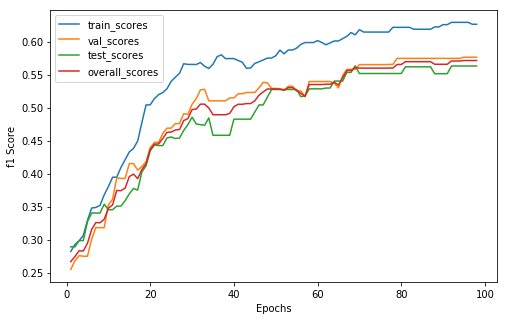

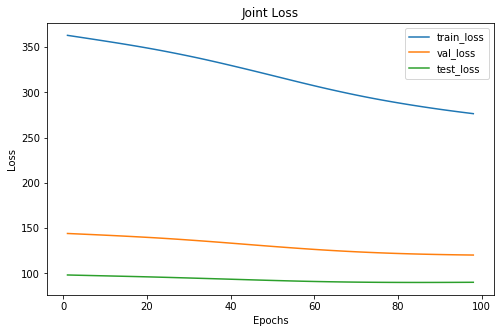

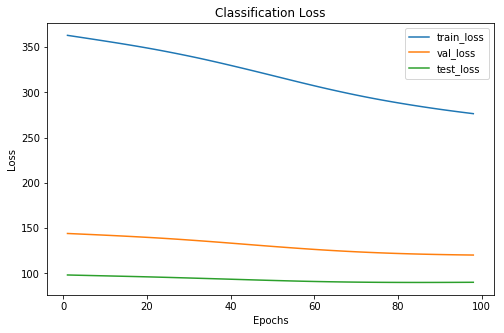

Cofusion Matrix For Val Set: 
--  --  --
25  16  12
 8  29  13
 2   4  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       78     35      20
 1      141     49      41
 2      108     46      27
xxxxxxxxxxxxxx epoch: 98 xxxxxxxxxxxxxx


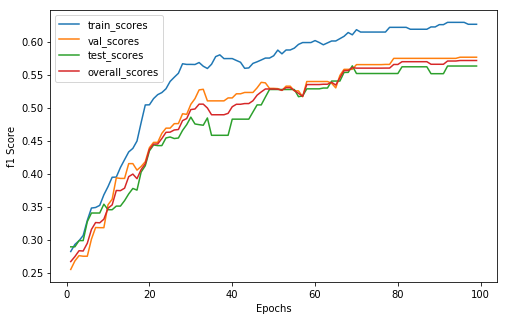

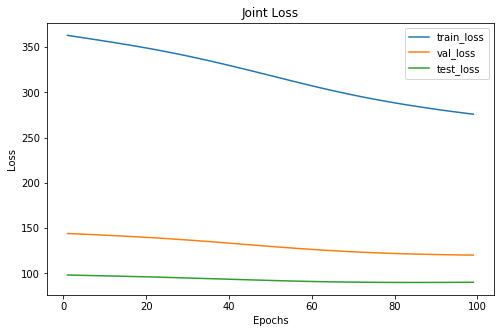

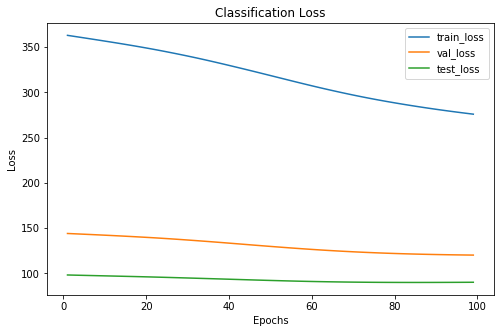

Cofusion Matrix For Val Set: 
--  --  --
25  16  12
 8  29  13
 2   4  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       78     35      20
 1      141     49      41
 2      108     46      27
xxxxxxxxxxxxxx epoch: 99 xxxxxxxxxxxxxx


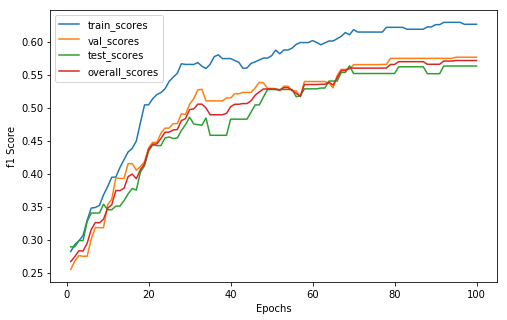

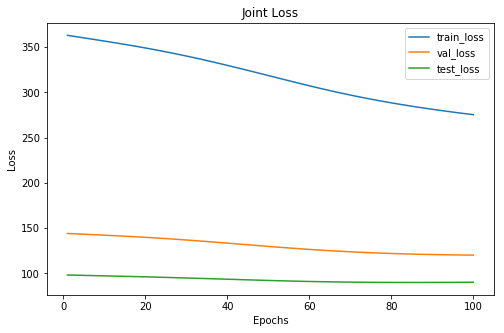

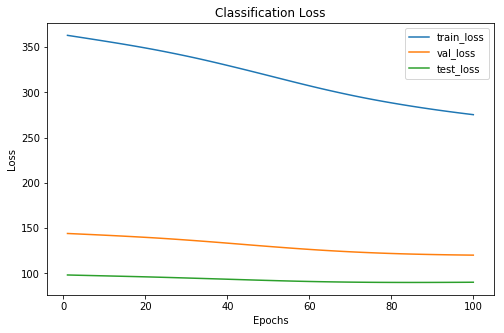

Cofusion Matrix For Val Set: 
--  --  --
25  16  12
 8  29  13
 2   4  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       78     35      20
 1      141     49      41
 2      108     46      27
xxxxxxxxxxxxxx epoch: 100 xxxxxxxxxxxxxx


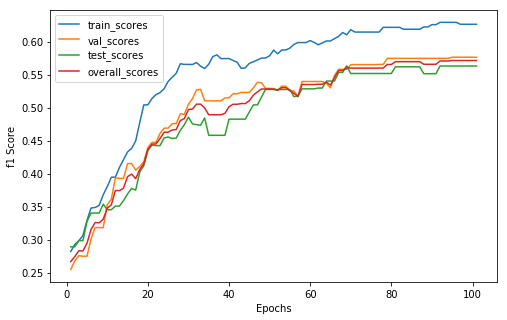

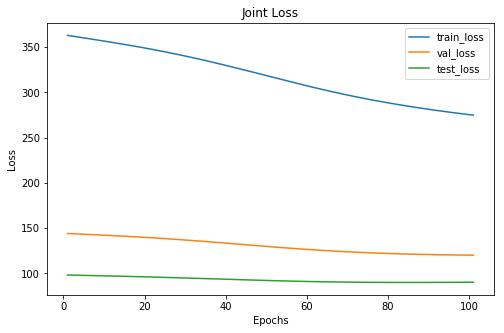

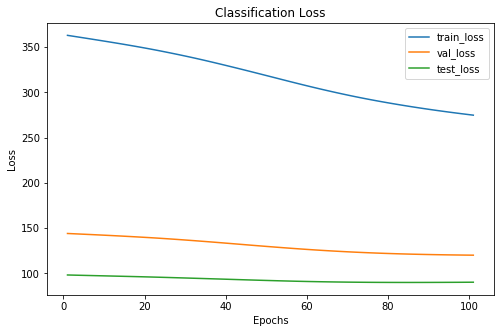

Cofusion Matrix For Val Set: 
--  --  --
25  16  12
 8  29  13
 2   4  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       78     35      20
 1      141     49      41
 2      108     46      27
xxxxxxxxxxxxxx epoch: 101 xxxxxxxxxxxxxx


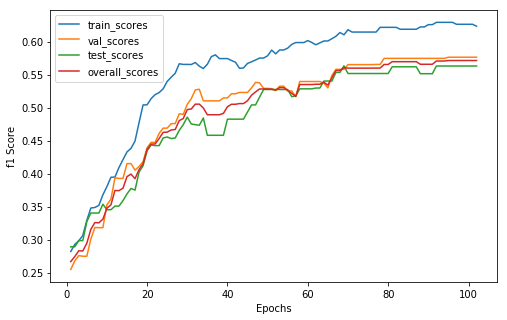

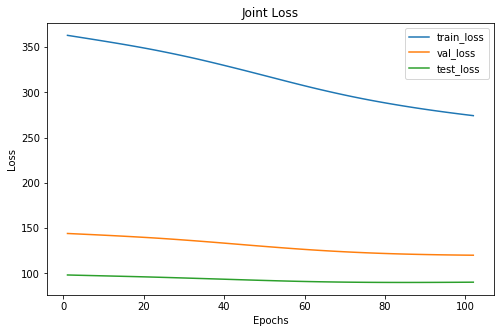

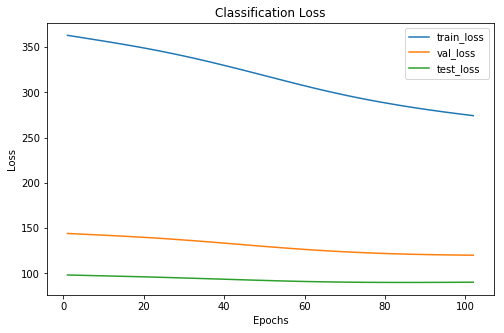

Cofusion Matrix For Val Set: 
--  --  --
25  16  12
 8  29  13
 2   4  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       79     35      20
 1      140     49      41
 2      108     46      27
xxxxxxxxxxxxxx epoch: 102 xxxxxxxxxxxxxx


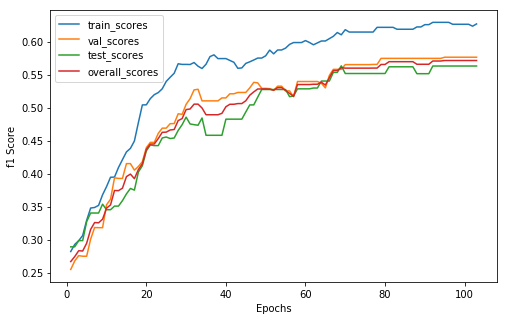

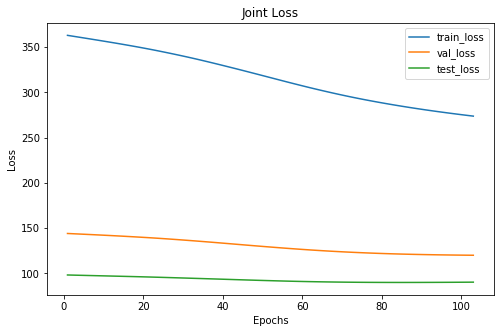

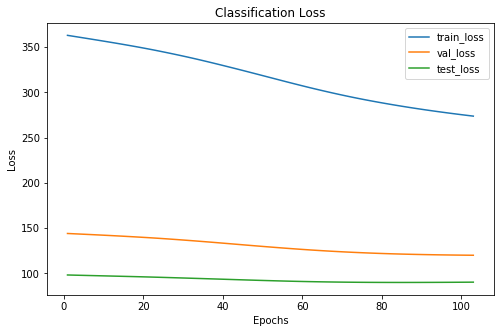

Cofusion Matrix For Val Set: 
--  --  --
25  16  12
 8  29  13
 2   4  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       80     35      20
 1      140     49      41
 2      107     46      27
xxxxxxxxxxxxxx epoch: 103 xxxxxxxxxxxxxx


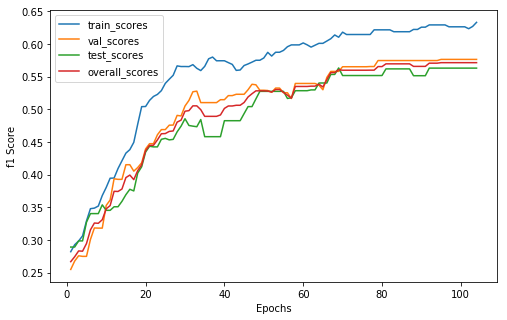

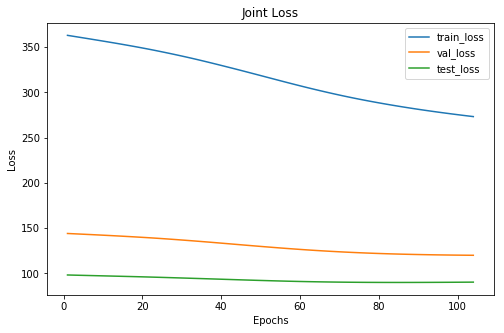

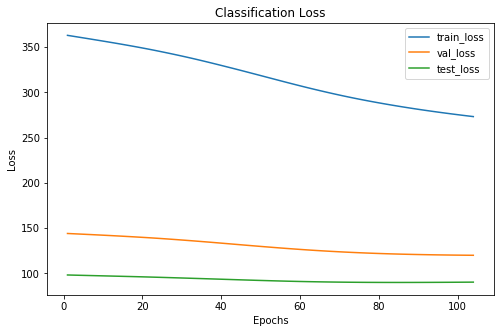

Cofusion Matrix For Val Set: 
--  --  --
25  16  12
 8  29  13
 2   4  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       81     35      20
 1      140     49      41
 2      106     46      27
xxxxxxxxxxxxxx epoch: 104 xxxxxxxxxxxxxx


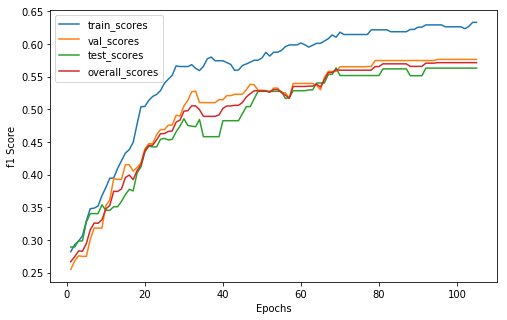

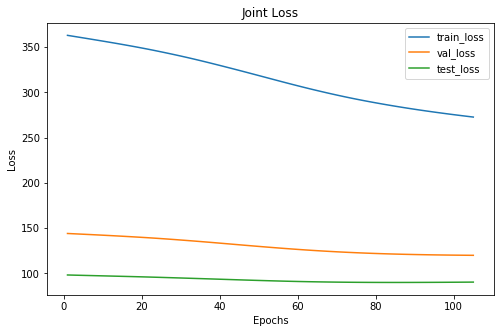

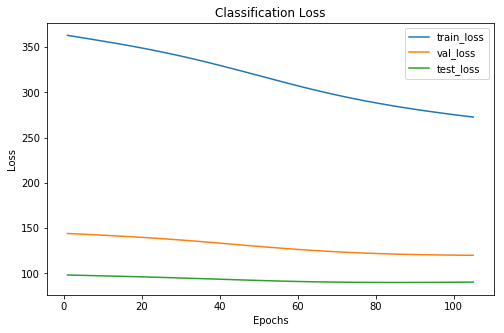

Cofusion Matrix For Val Set: 
--  --  --
25  16  12
 8  29  13
 2   4  21
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       81     35      20
 1      140     49      41
 2      106     46      27
xxxxxxxxxxxxxx epoch: 105 xxxxxxxxxxxxxx


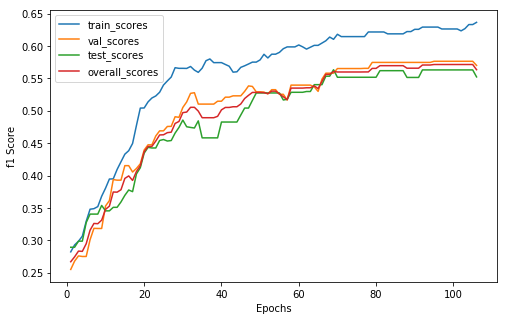

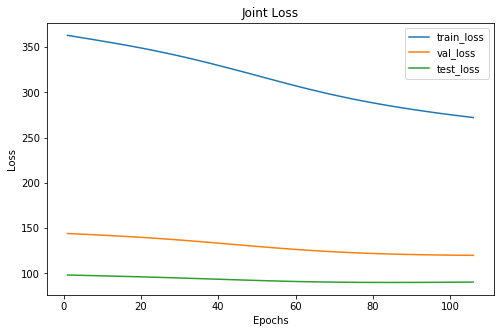

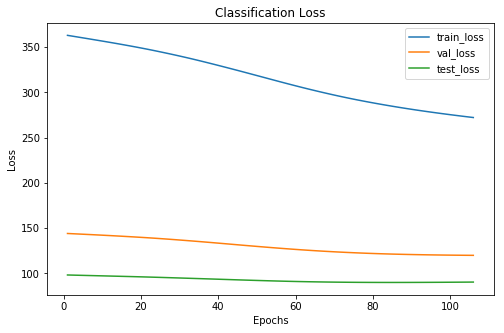

Cofusion Matrix For Val Set: 
--  --  --
25  16  12
 8  29  13
 2   5  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       82     35      20
 1      140     50      42
 2      105     45      26
xxxxxxxxxxxxxx epoch: 106 xxxxxxxxxxxxxx


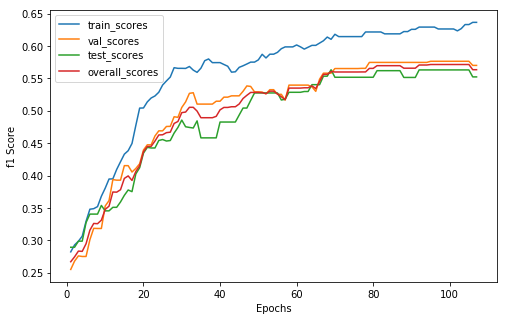

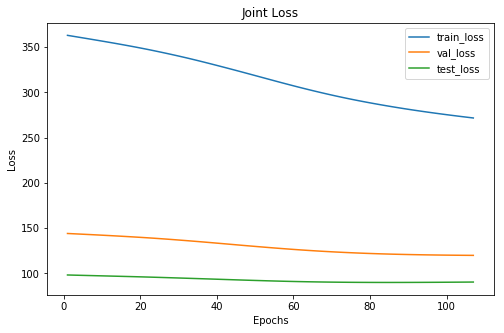

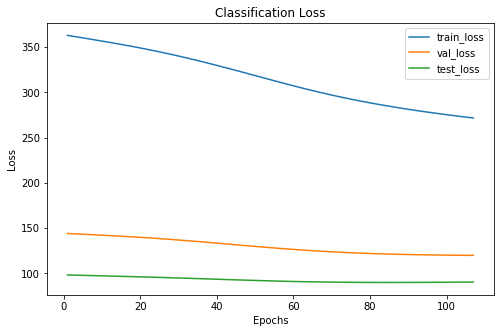

Cofusion Matrix For Val Set: 
--  --  --
25  16  12
 8  29  13
 2   5  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       82     35      20
 1      140     50      42
 2      105     45      26
xxxxxxxxxxxxxx epoch: 107 xxxxxxxxxxxxxx


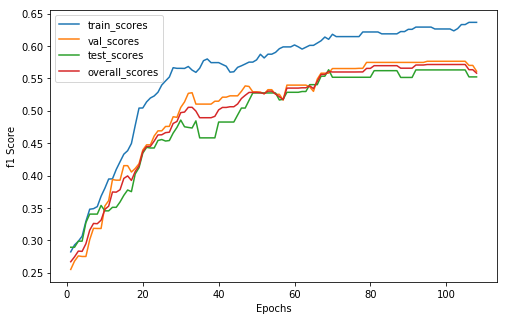

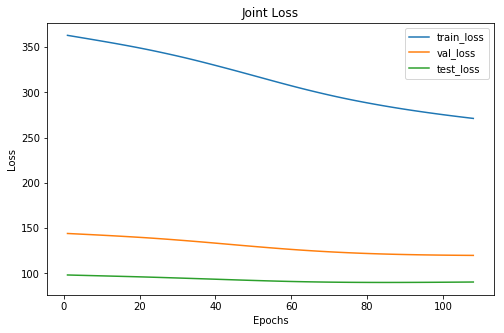

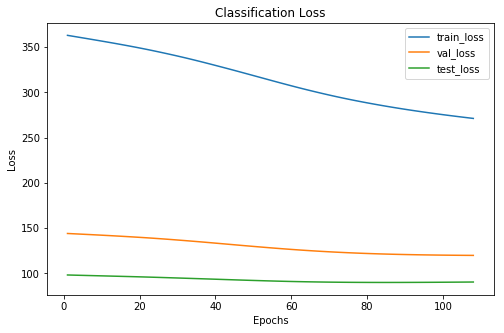

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 8  29  13
 2   5  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       82     34      20
 1      140     51      42
 2      105     45      26
xxxxxxxxxxxxxx epoch: 108 xxxxxxxxxxxxxx


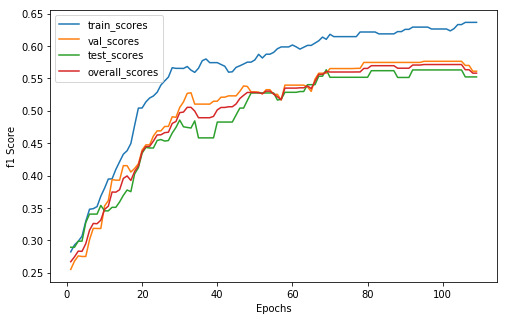

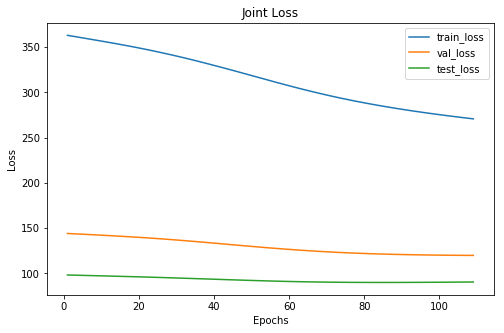

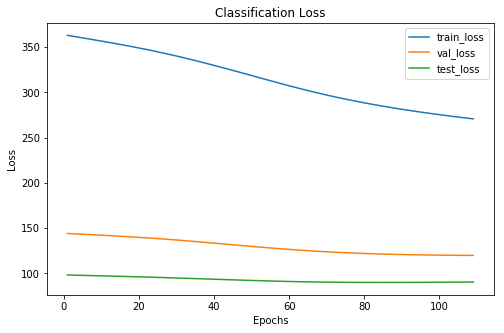

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 8  29  13
 2   5  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       82     34      20
 1      141     51      42
 2      104     45      26
xxxxxxxxxxxxxx epoch: 109 xxxxxxxxxxxxxx


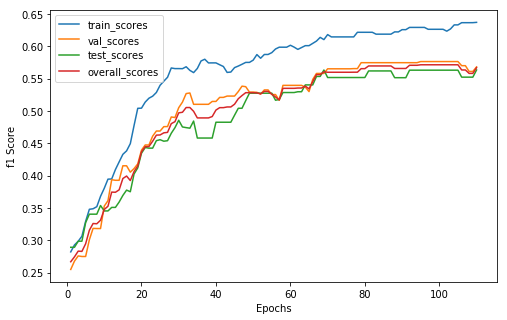

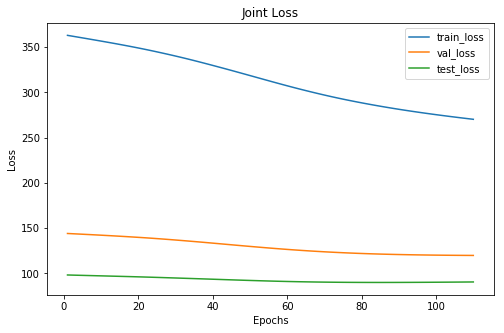

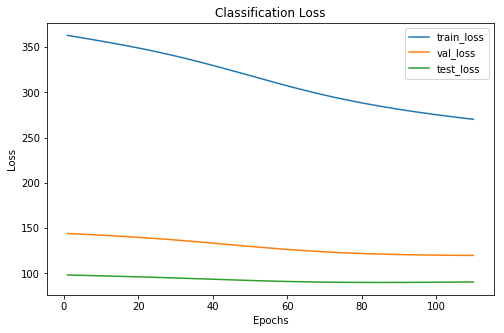

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 8  30  12
 2   5  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       84     34      22
 1      140     52      41
 2      103     44      25
xxxxxxxxxxxxxx epoch: 110 xxxxxxxxxxxxxx


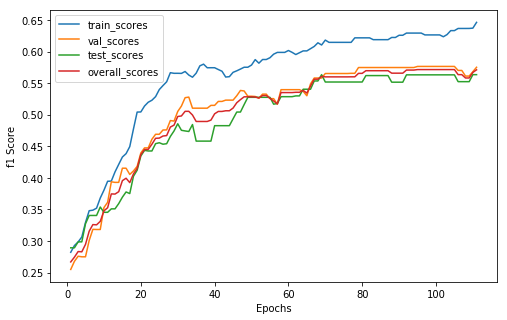

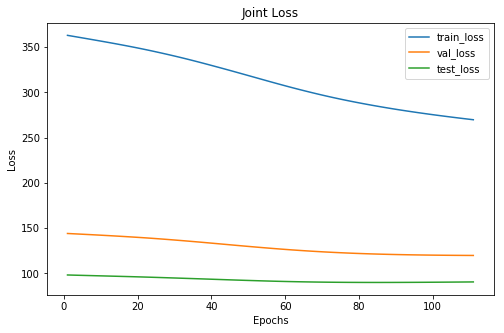

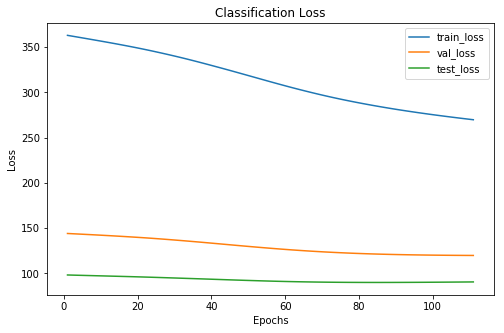

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 8  31  11
 2   5  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       84     34      22
 1      141     53      41
 2      102     43      25
xxxxxxxxxxxxxx epoch: 111 xxxxxxxxxxxxxx


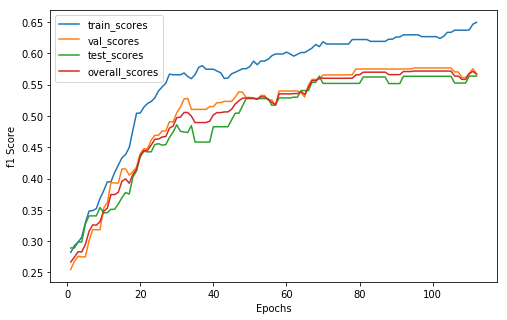

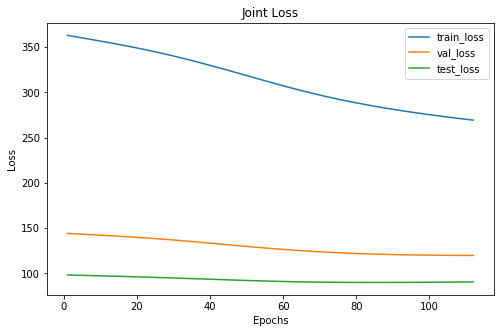

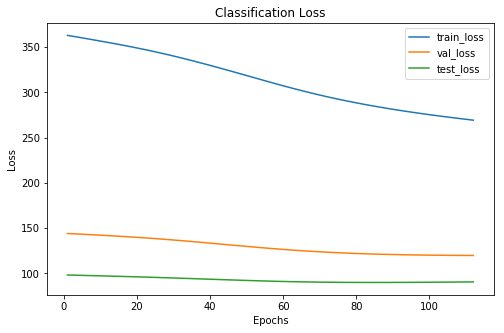

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 9  30  11
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       84     36      22
 1      142     51      41
 2      101     43      25
xxxxxxxxxxxxxx epoch: 112 xxxxxxxxxxxxxx


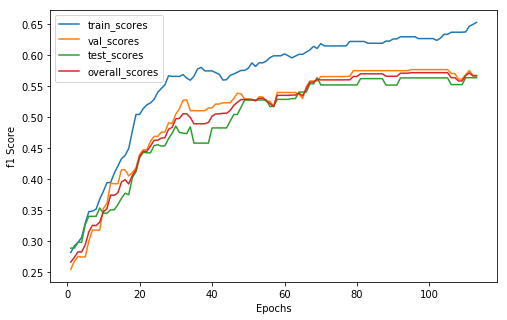

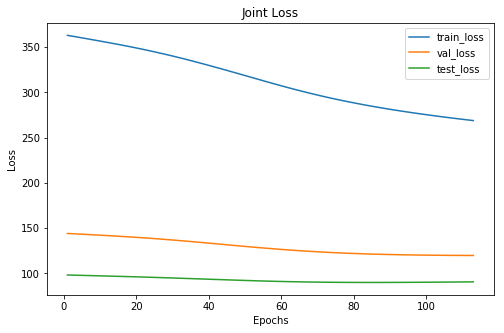

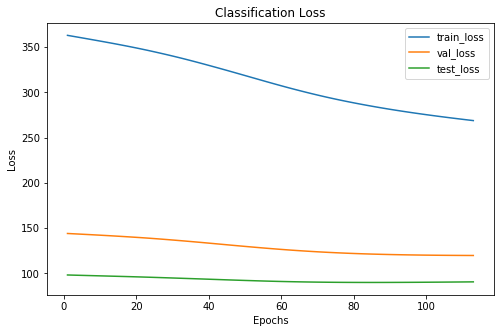

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 9  30  11
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       85     36      22
 1      141     51      41
 2      101     43      25
xxxxxxxxxxxxxx epoch: 113 xxxxxxxxxxxxxx


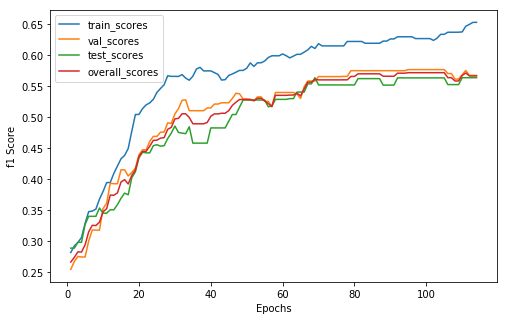

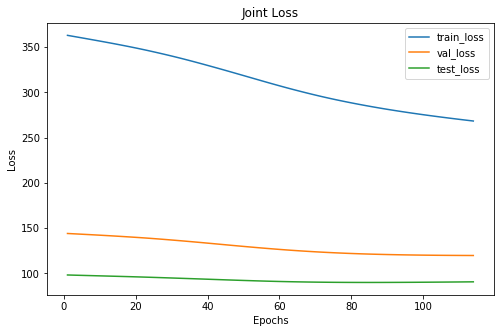

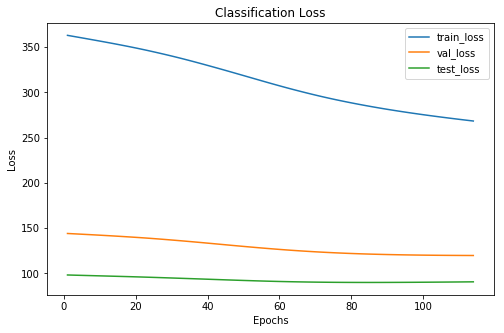

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 9  30  11
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       85     36      22
 1      141     51      41
 2      101     43      25
xxxxxxxxxxxxxx epoch: 114 xxxxxxxxxxxxxx


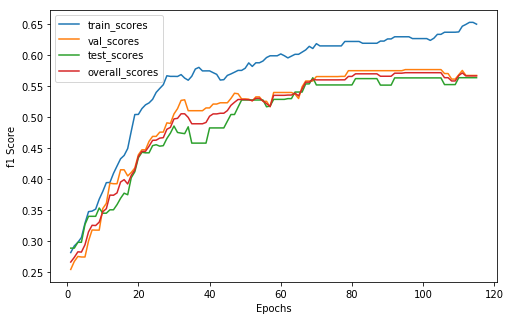

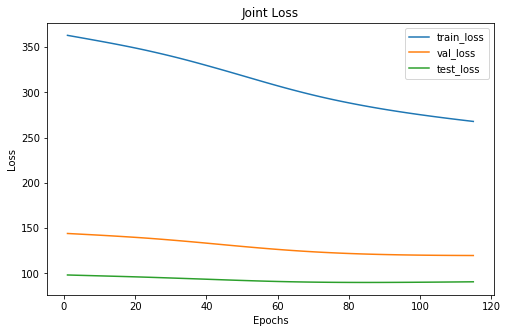

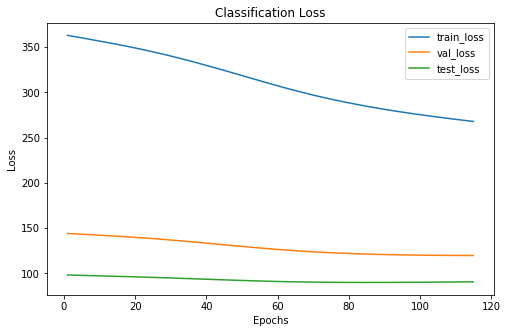

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 9  30  11
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       86     36      22
 1      140     51      41
 2      101     43      25
xxxxxxxxxxxxxx epoch: 115 xxxxxxxxxxxxxx


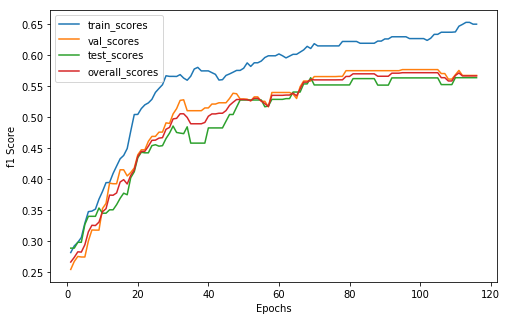

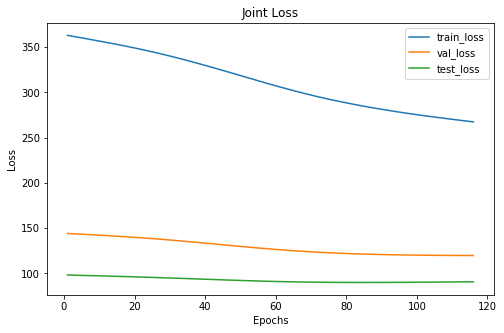

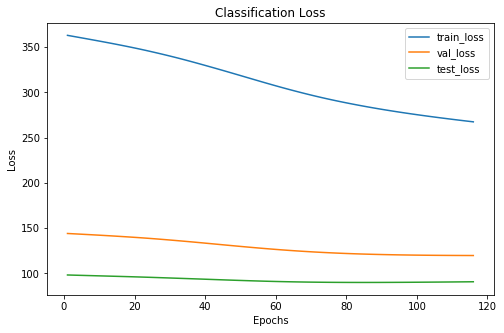

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 9  30  11
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       86     36      22
 1      140     51      41
 2      101     43      25
xxxxxxxxxxxxxx epoch: 116 xxxxxxxxxxxxxx


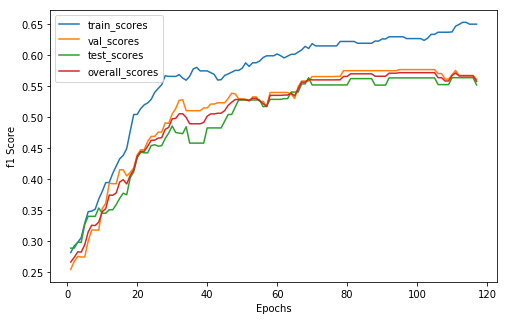

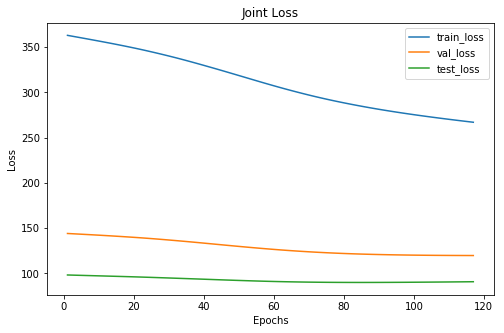

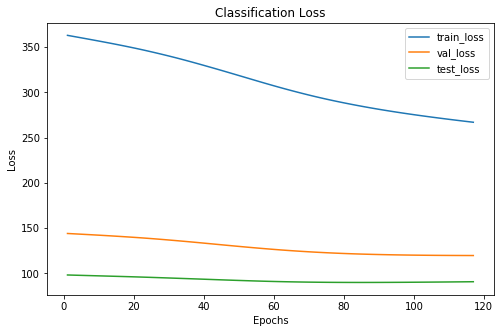

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 9  30  11
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       86     36      23
 1      140     52      40
 2      101     42      25
xxxxxxxxxxxxxx epoch: 117 xxxxxxxxxxxxxx


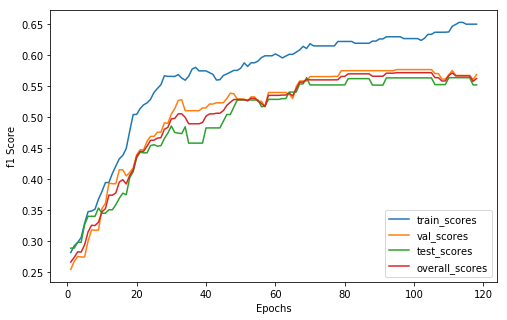

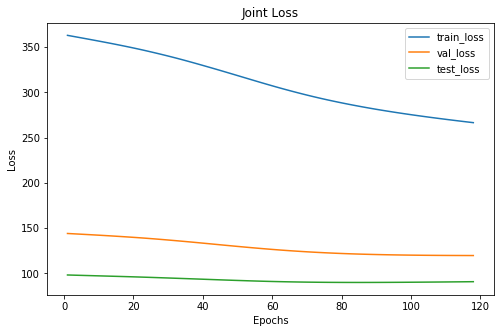

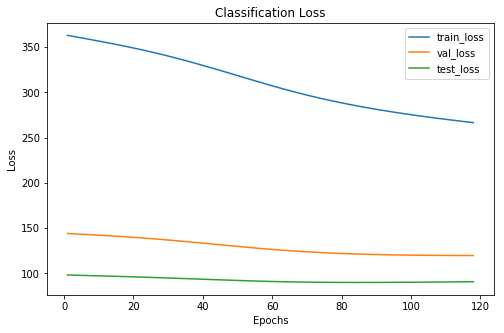

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 8  31  11
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       86     35      23
 1      140     53      40
 2      101     42      25
xxxxxxxxxxxxxx epoch: 118 xxxxxxxxxxxxxx


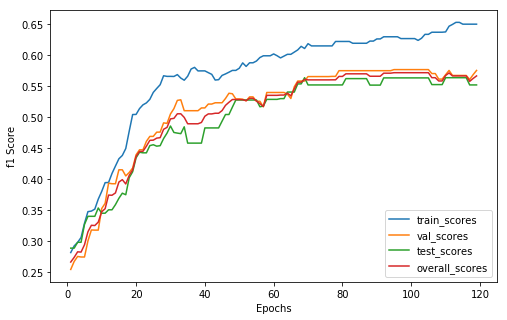

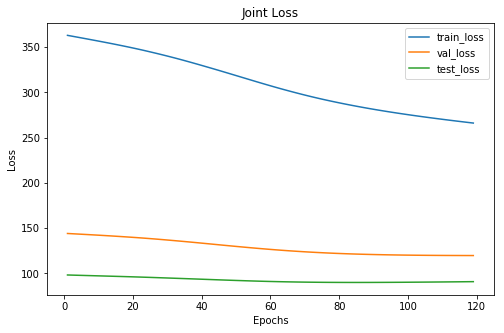

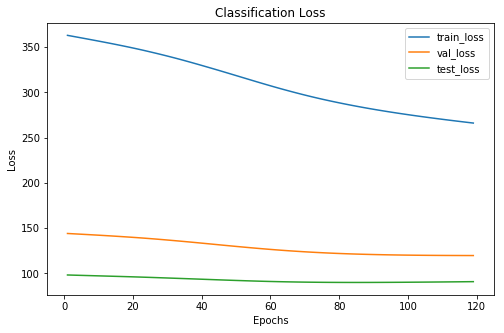

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 8  32  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       86     35      23
 1      140     54      40
 2      101     41      25
xxxxxxxxxxxxxx epoch: 119 xxxxxxxxxxxxxx


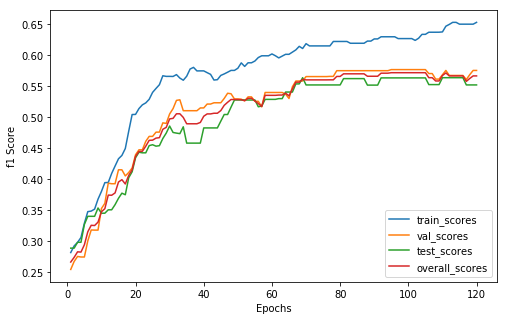

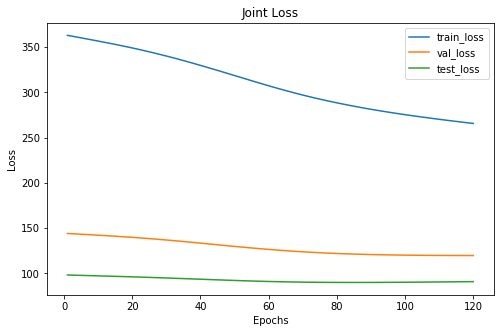

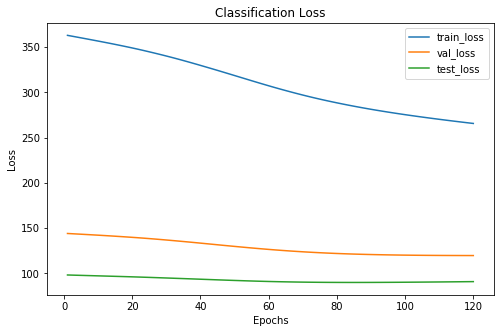

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 8  32  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       86     35      23
 1      141     54      40
 2      100     41      25
xxxxxxxxxxxxxx epoch: 120 xxxxxxxxxxxxxx


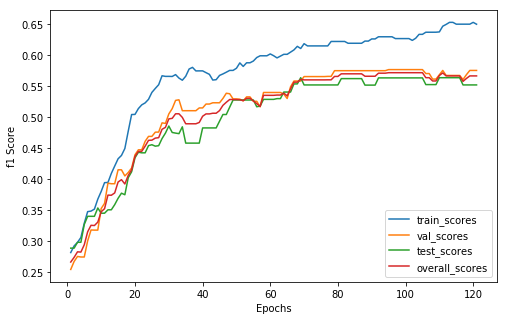

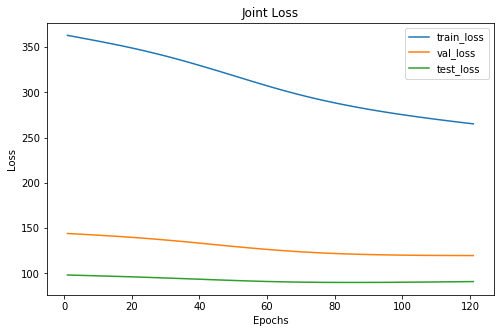

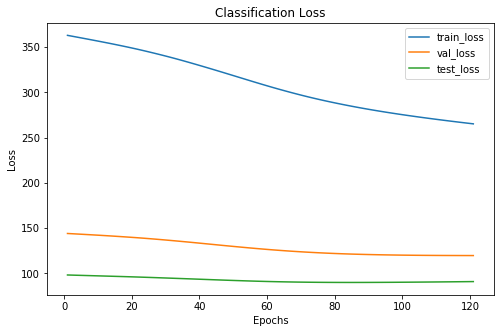

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 8  32  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       86     35      23
 1      142     54      40
 2       99     41      25
xxxxxxxxxxxxxx epoch: 121 xxxxxxxxxxxxxx


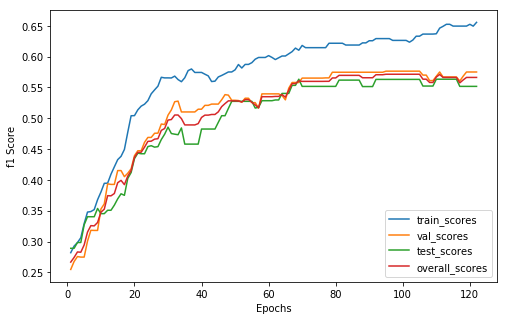

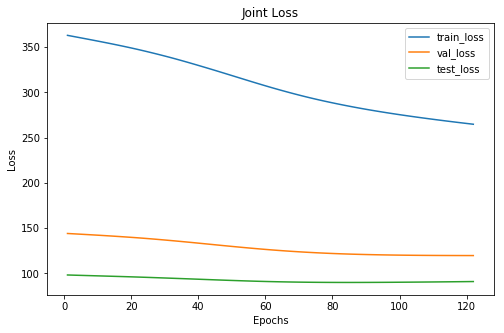

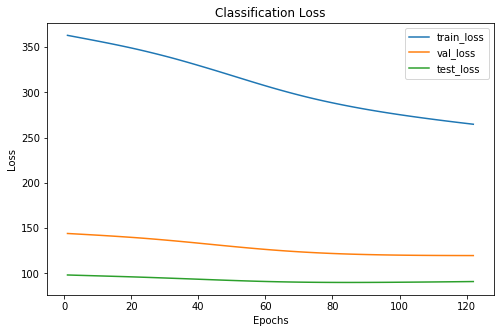

Cofusion Matrix For Val Set: 
--  --  --
24  17  12
 8  32  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       88     35      23
 1      141     54      40
 2       98     41      25
xxxxxxxxxxxxxx epoch: 122 xxxxxxxxxxxxxx


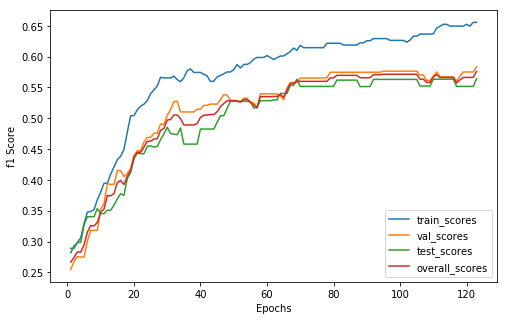

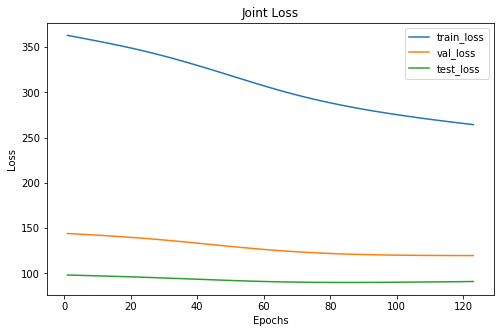

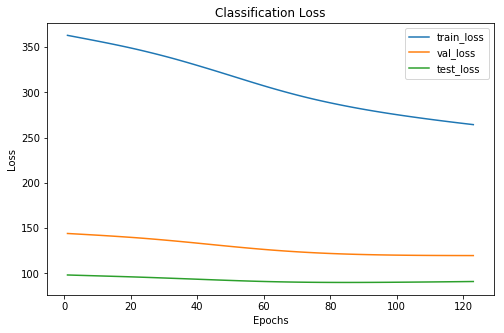

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 8  32  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       88     36      24
 1      141     54      39
 2       98     40      25
xxxxxxxxxxxxxx epoch: 123 xxxxxxxxxxxxxx


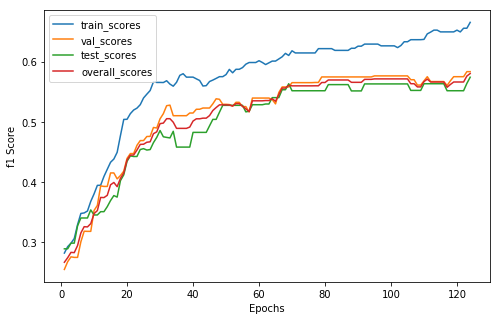

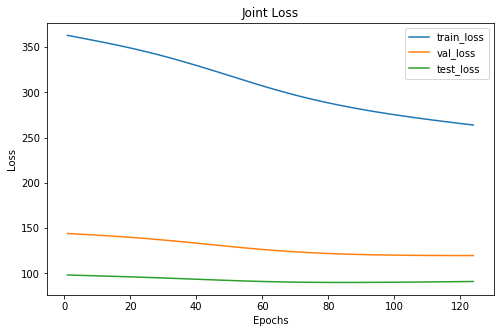

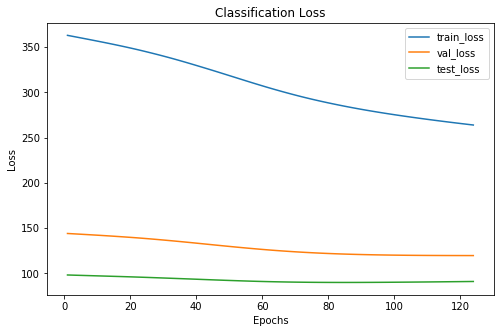

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 8  32  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       91     36      24
 1      138     54      40
 2       98     40      24
xxxxxxxxxxxxxx epoch: 124 xxxxxxxxxxxxxx


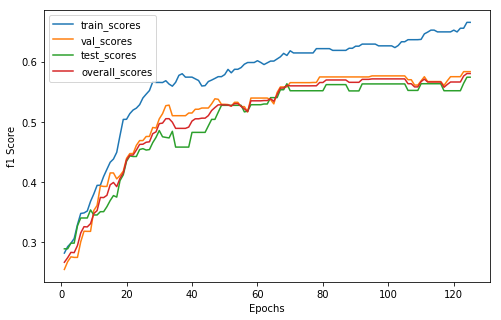

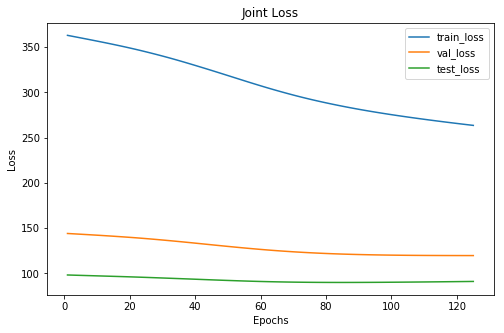

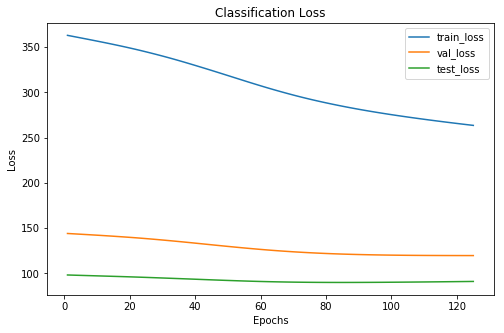

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 8  32  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       91     36      24
 1      138     54      40
 2       98     40      24
xxxxxxxxxxxxxx epoch: 125 xxxxxxxxxxxxxx


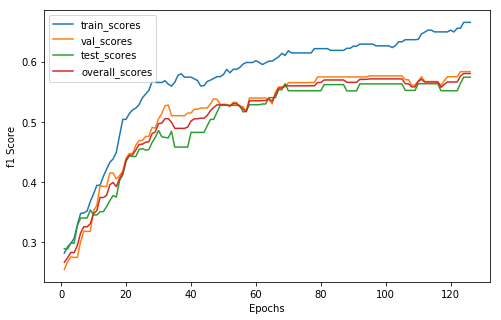

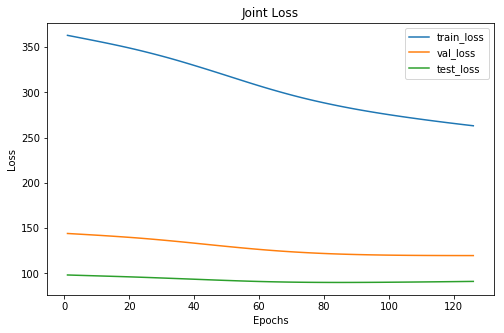

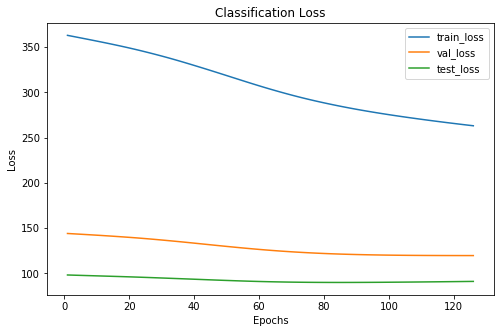

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 8  32  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       91     36      24
 1      138     54      40
 2       98     40      24
xxxxxxxxxxxxxx epoch: 126 xxxxxxxxxxxxxx


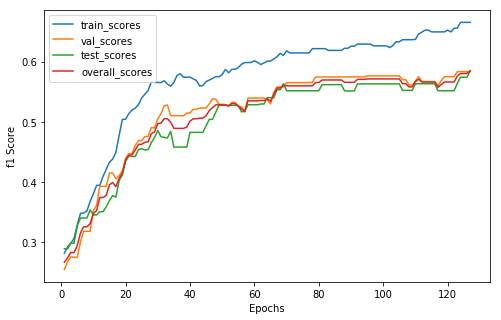

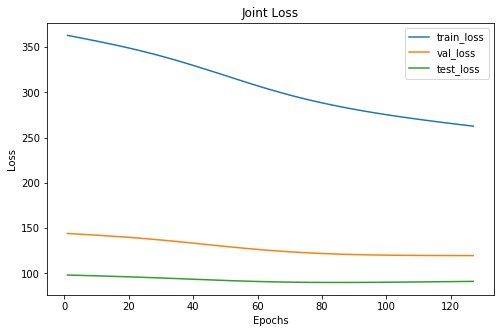

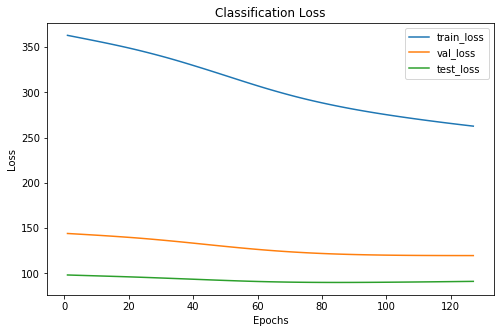

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 8  32  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       92     36      25
 1      138     54      40
 2       97     40      23
xxxxxxxxxxxxxx epoch: 127 xxxxxxxxxxxxxx


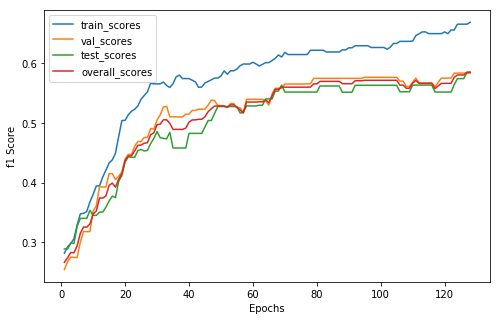

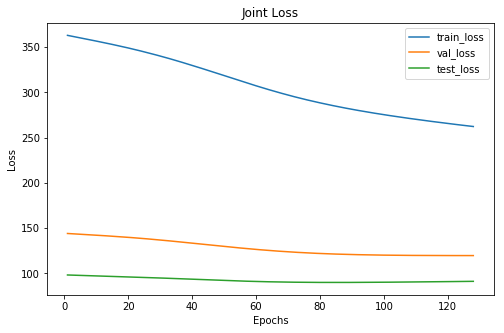

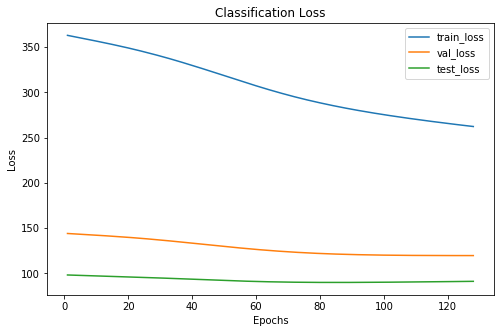

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 8  32  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       92     36      25
 1      137     54      40
 2       98     40      23
xxxxxxxxxxxxxx epoch: 128 xxxxxxxxxxxxxx


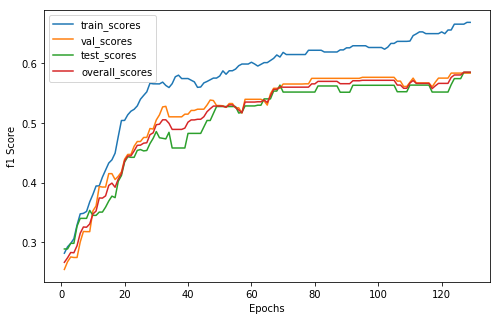

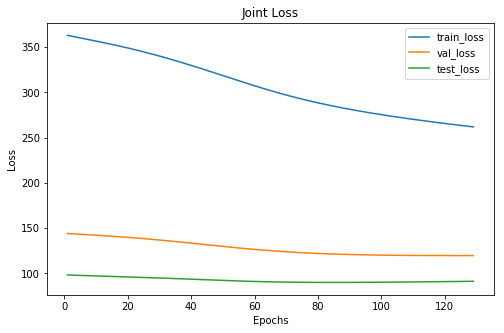

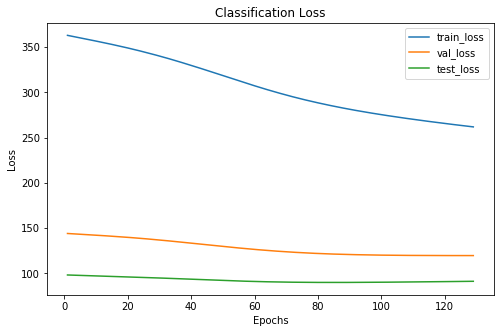

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 8  32  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       92     36      25
 1      136     54      40
 2       99     40      23
xxxxxxxxxxxxxx epoch: 129 xxxxxxxxxxxxxx


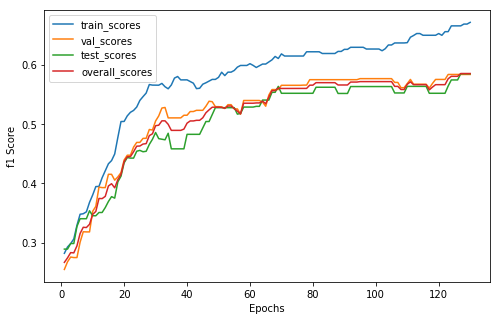

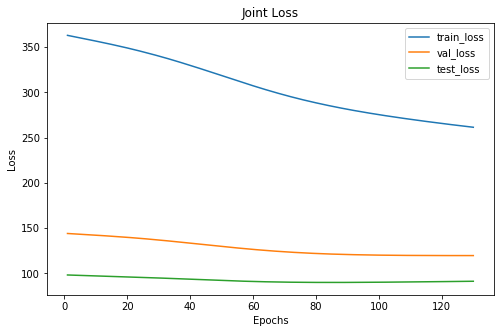

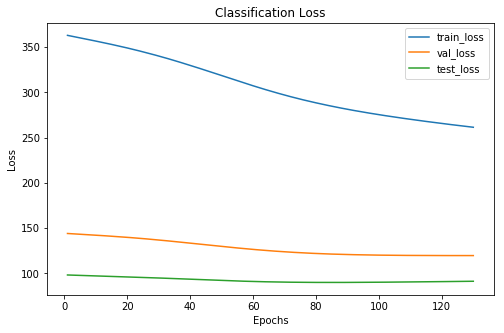

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 8  32  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       91     36      25
 1      137     54      40
 2       99     40      23
xxxxxxxxxxxxxx epoch: 130 xxxxxxxxxxxxxx


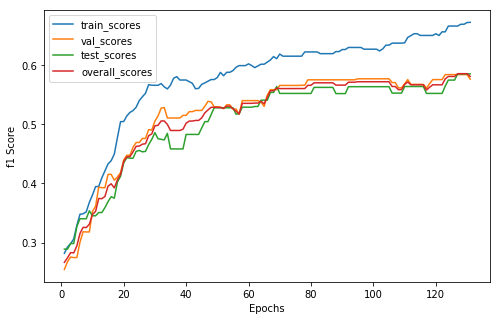

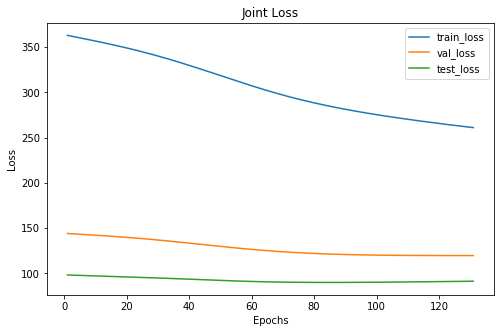

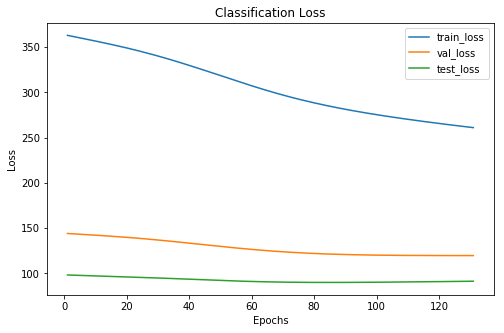

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       93     37      25
 1      135     53      40
 2       99     40      23
xxxxxxxxxxxxxx epoch: 131 xxxxxxxxxxxxxx


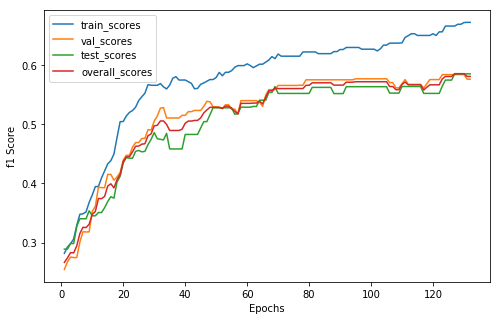

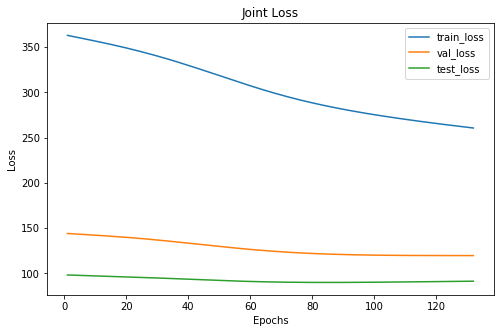

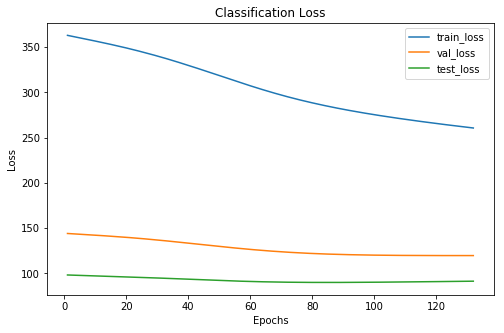

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       93     37      25
 1      135     53      40
 2       99     40      23
xxxxxxxxxxxxxx epoch: 132 xxxxxxxxxxxxxx


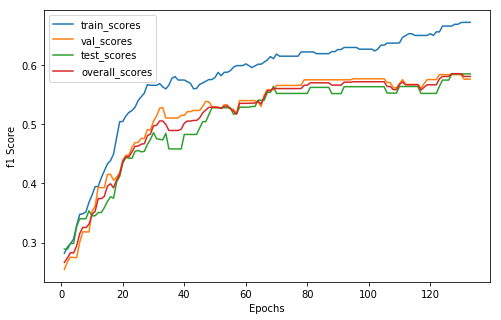

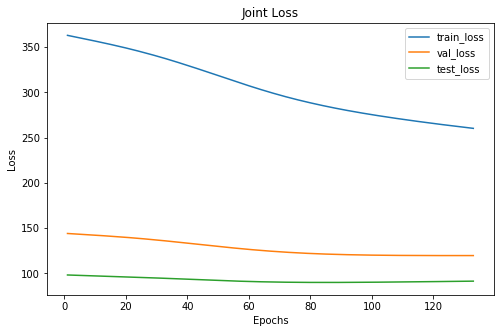

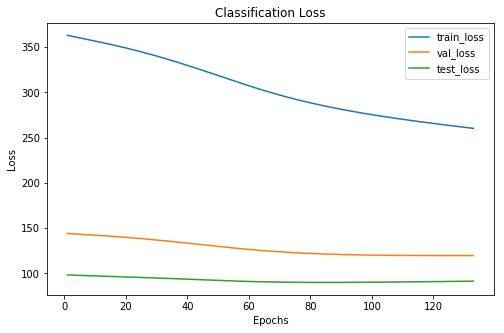

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       93     37      25
 1      135     53      40
 2       99     40      23
xxxxxxxxxxxxxx epoch: 133 xxxxxxxxxxxxxx


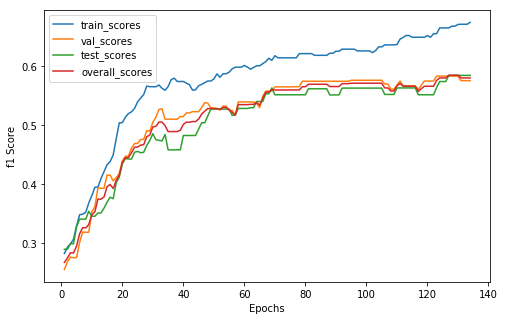

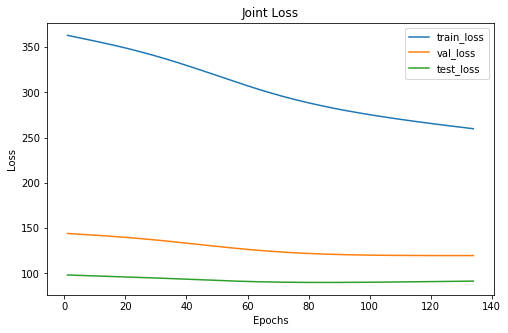

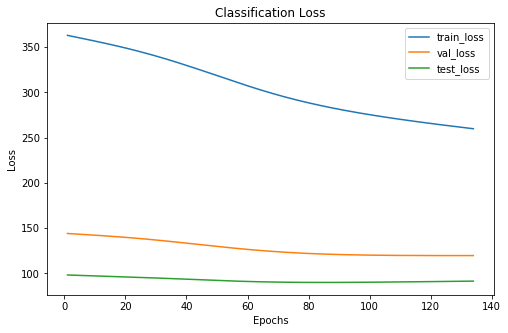

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       94     37      25
 1      135     53      40
 2       98     40      23
xxxxxxxxxxxxxx epoch: 134 xxxxxxxxxxxxxx


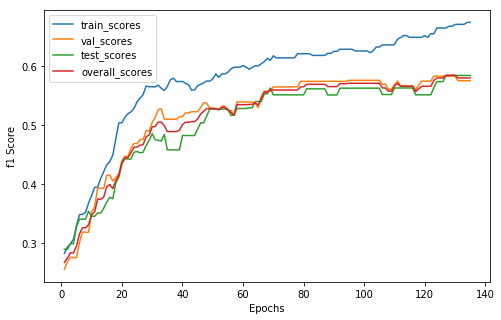

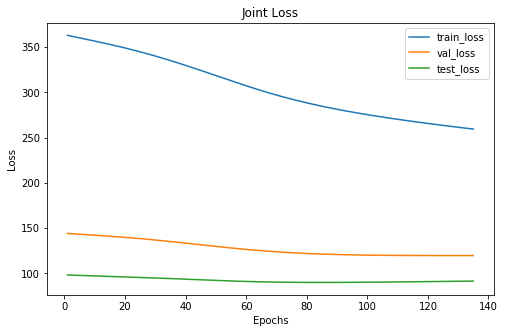

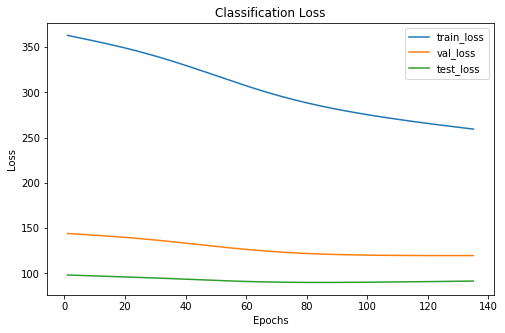

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       95     37      25
 1      135     53      40
 2       97     40      23
xxxxxxxxxxxxxx epoch: 135 xxxxxxxxxxxxxx


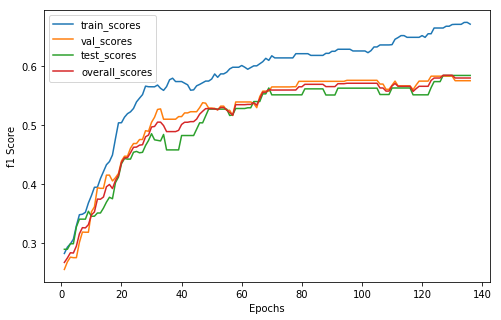

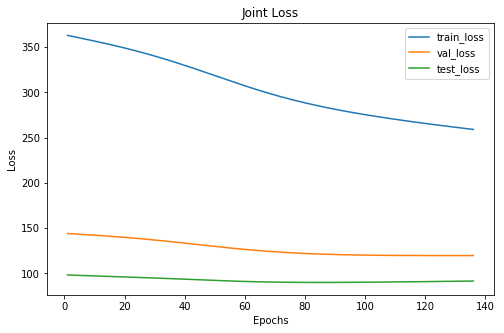

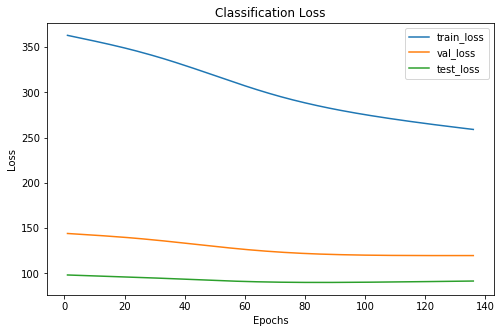

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       95     37      25
 1      136     53      40
 2       96     40      23
xxxxxxxxxxxxxx epoch: 136 xxxxxxxxxxxxxx


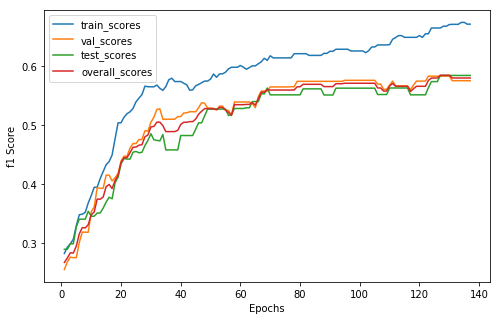

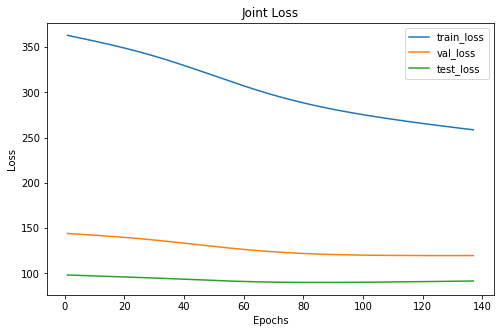

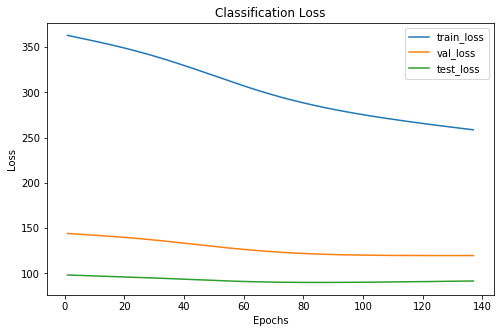

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       95     37      25
 1      136     53      40
 2       96     40      23
xxxxxxxxxxxxxx epoch: 137 xxxxxxxxxxxxxx


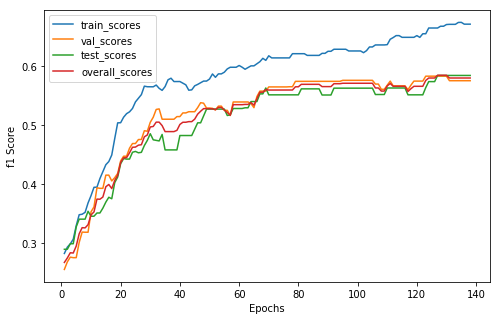

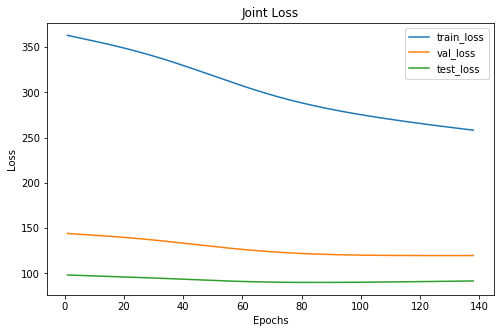

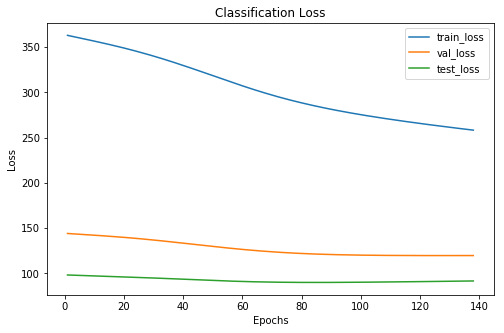

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       95     37      25
 1      136     53      40
 2       96     40      23
xxxxxxxxxxxxxx epoch: 138 xxxxxxxxxxxxxx


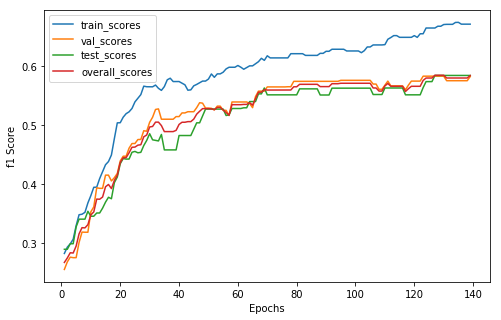

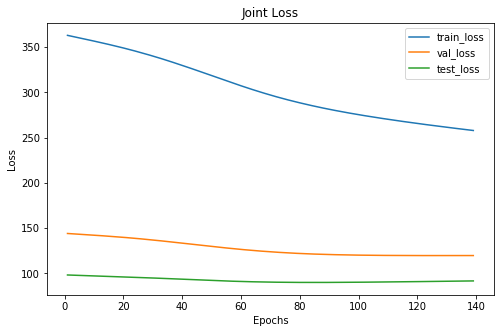

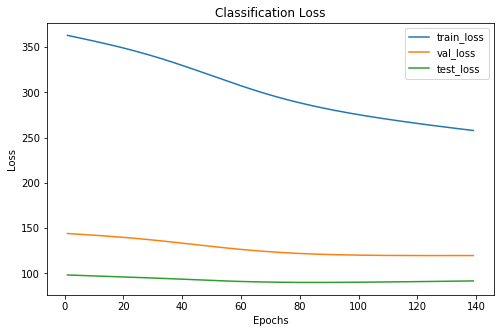

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  32   9
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       95     37      25
 1      136     54      40
 2       96     39      23
xxxxxxxxxxxxxx epoch: 139 xxxxxxxxxxxxxx


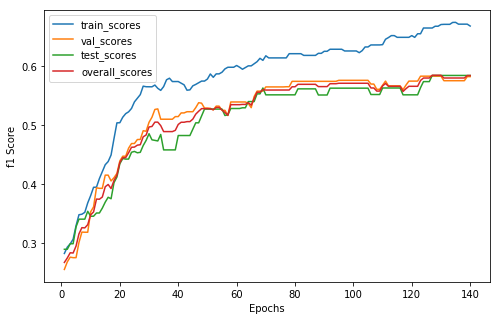

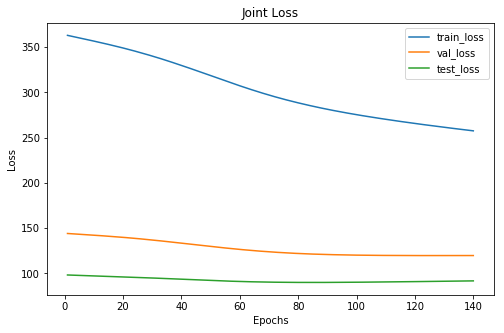

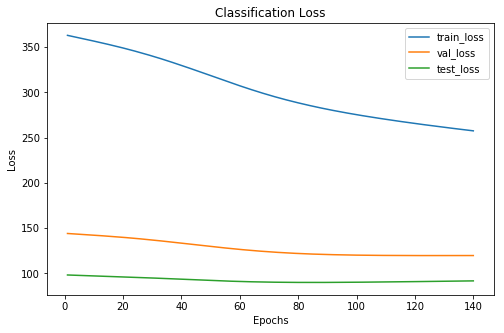

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  32   9
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       94     37      25
 1      137     54      40
 2       96     39      23
xxxxxxxxxxxxxx epoch: 140 xxxxxxxxxxxxxx


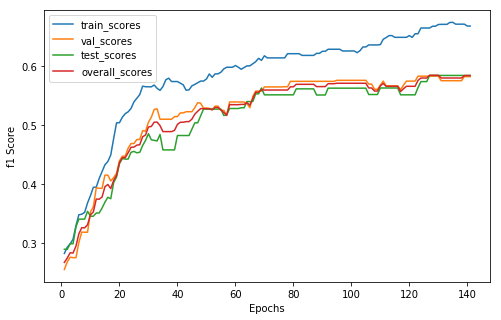

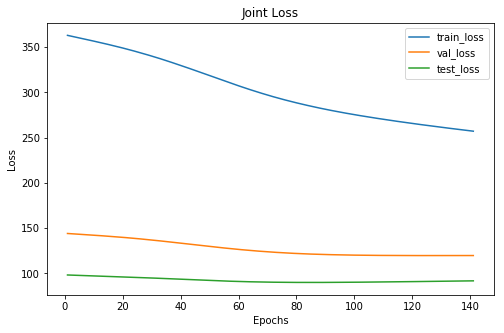

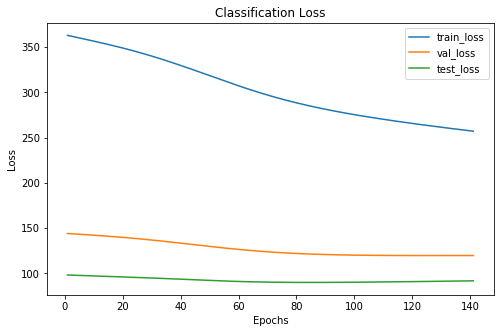

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  32   9
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       94     37      25
 1      137     54      40
 2       96     39      23
xxxxxxxxxxxxxx epoch: 141 xxxxxxxxxxxxxx


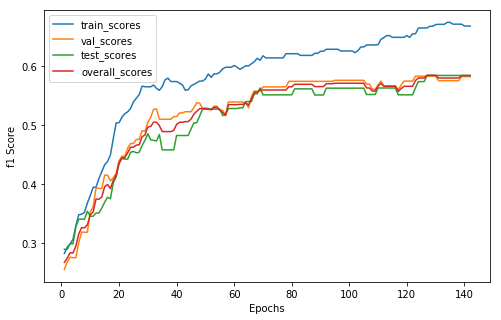

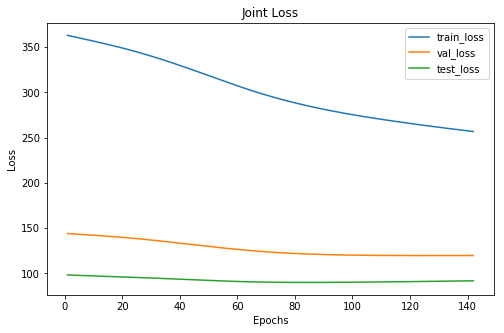

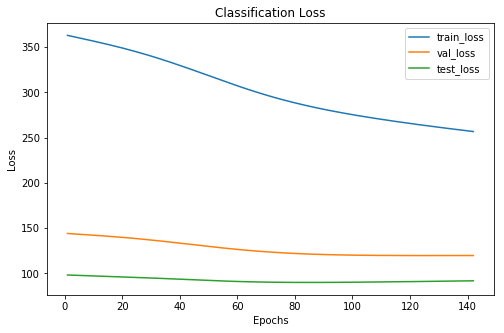

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  32   9
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       94     37      25
 1      137     54      40
 2       96     39      23
xxxxxxxxxxxxxx epoch: 142 xxxxxxxxxxxxxx


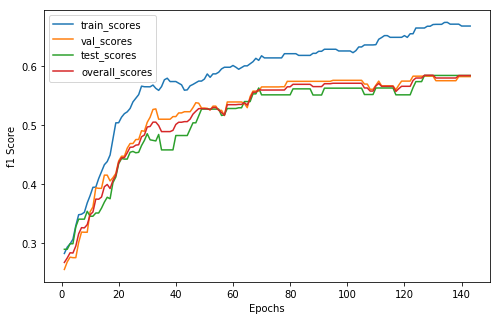

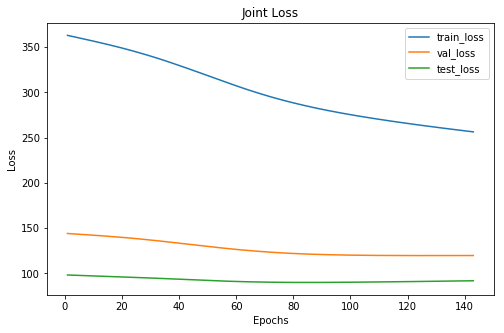

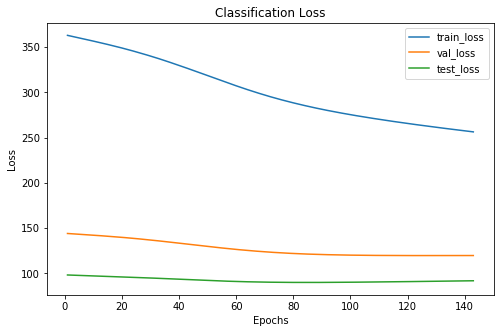

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  32   9
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       94     37      25
 1      137     54      40
 2       96     39      23
xxxxxxxxxxxxxx epoch: 143 xxxxxxxxxxxxxx


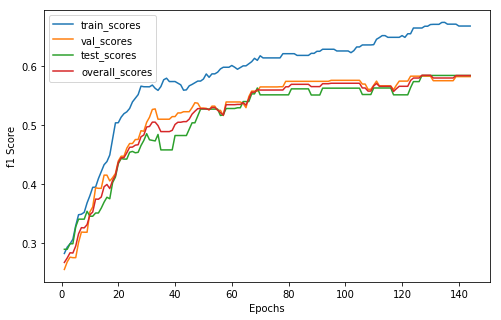

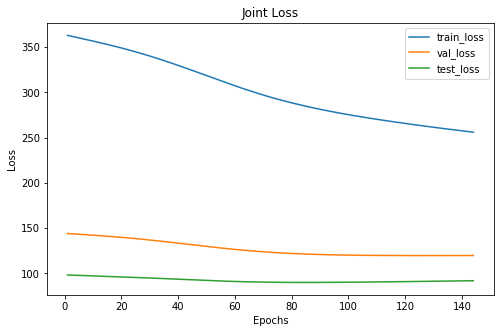

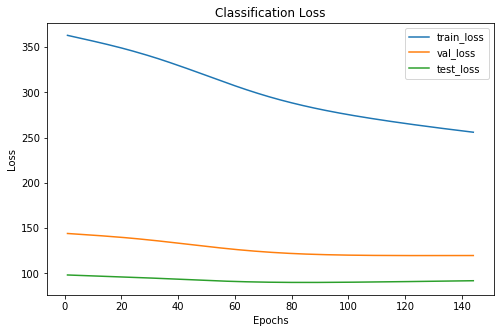

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  32   9
 3   5  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       94     37      25
 1      137     54      40
 2       96     39      23
xxxxxxxxxxxxxx epoch: 144 xxxxxxxxxxxxxx


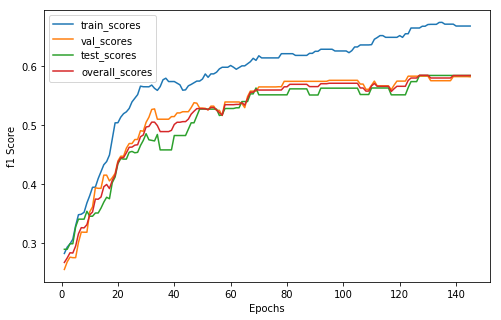

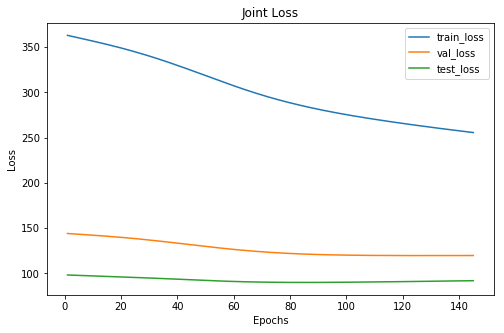

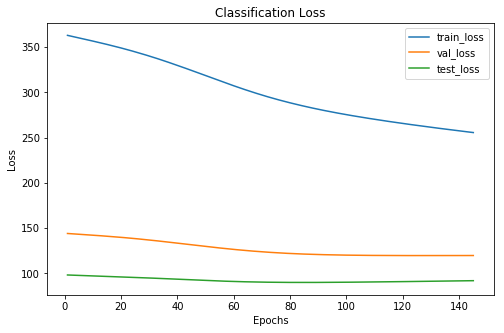

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       94     37      25
 1      137     52      40
 2       96     41      23
xxxxxxxxxxxxxx epoch: 145 xxxxxxxxxxxxxx


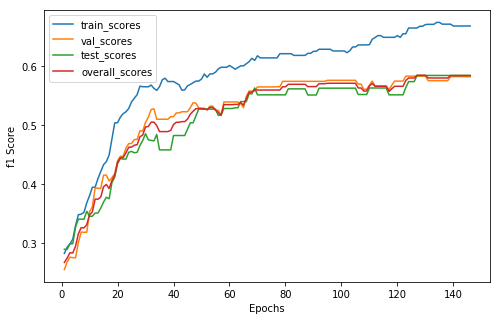

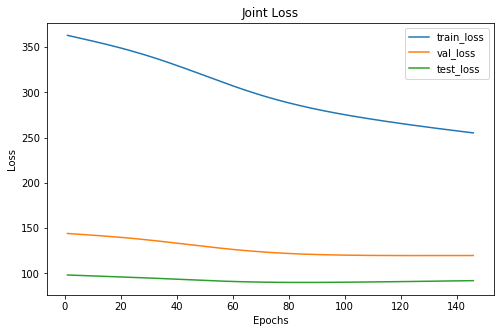

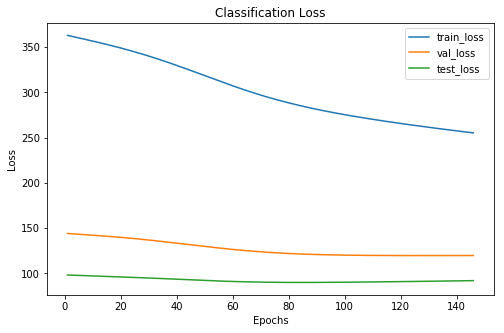

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       96     37      25
 1      134     52      40
 2       97     41      23
xxxxxxxxxxxxxx epoch: 146 xxxxxxxxxxxxxx


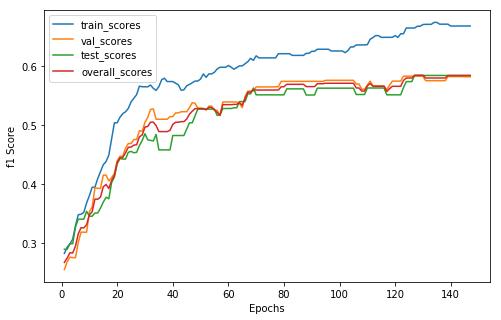

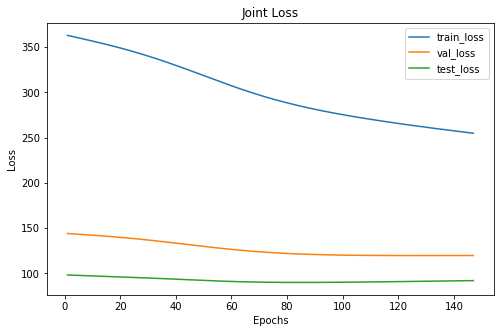

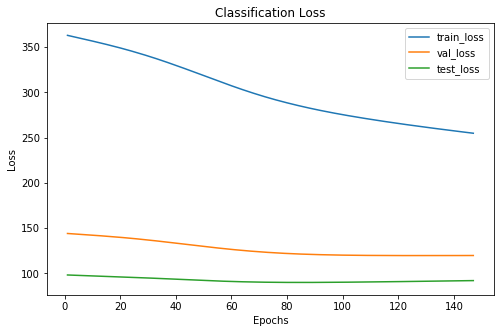

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     37      25
 1      133     52      40
 2       97     41      23
xxxxxxxxxxxxxx epoch: 147 xxxxxxxxxxxxxx


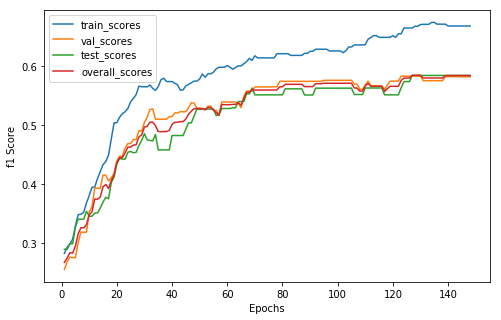

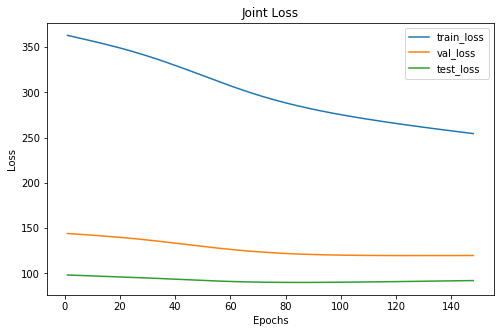

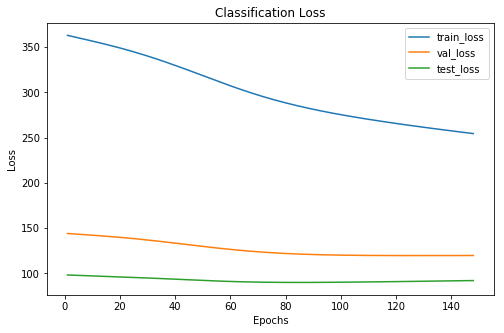

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     37      25
 1      133     52      40
 2       97     41      23
xxxxxxxxxxxxxx epoch: 148 xxxxxxxxxxxxxx


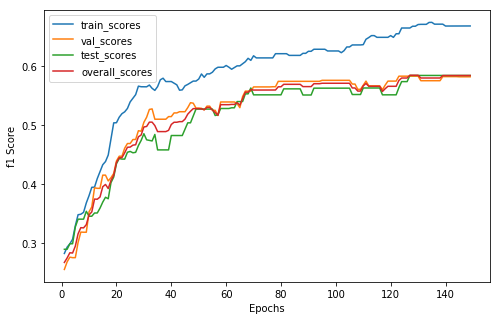

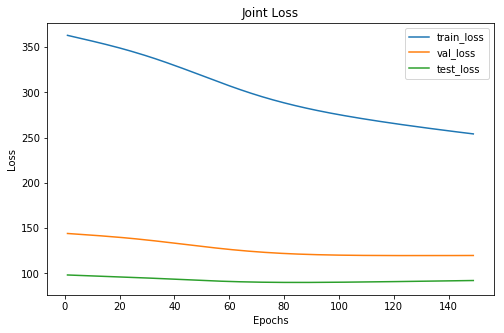

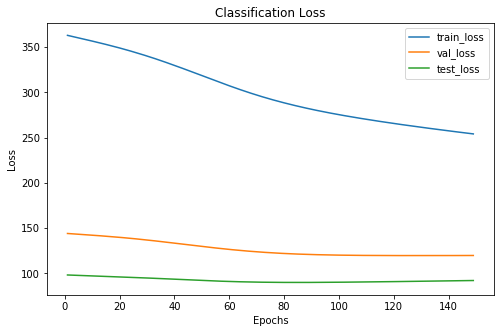

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     37      25
 1      133     52      40
 2       97     41      23
xxxxxxxxxxxxxx epoch: 149 xxxxxxxxxxxxxx


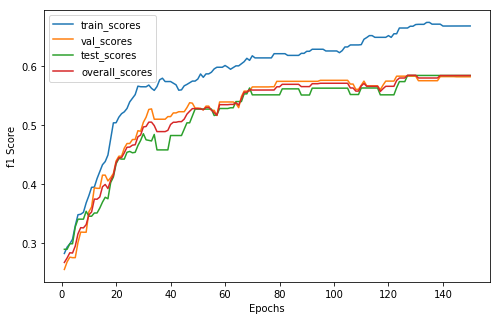

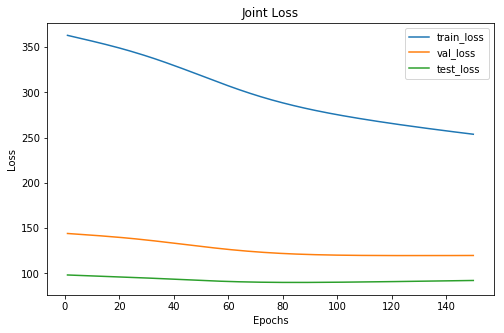

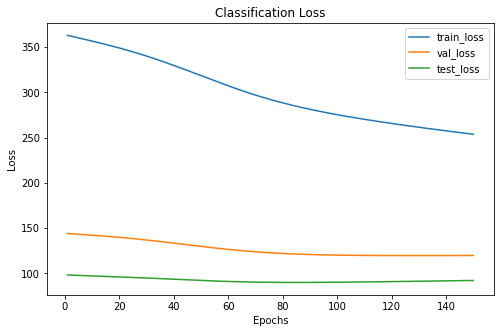

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     37      25
 1      133     52      40
 2       97     41      23
xxxxxxxxxxxxxx epoch: 150 xxxxxxxxxxxxxx


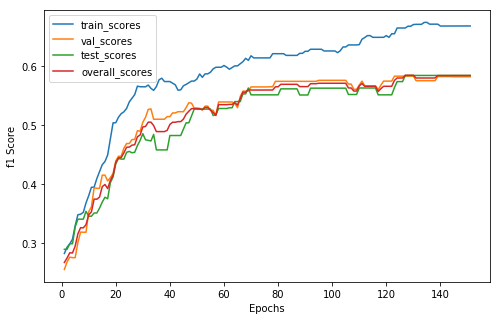

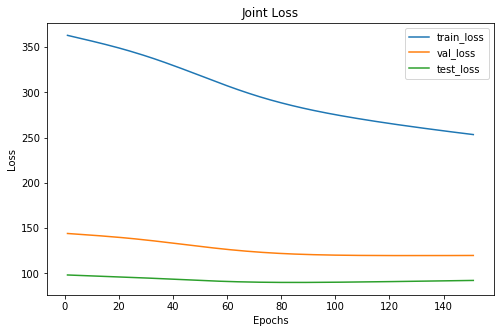

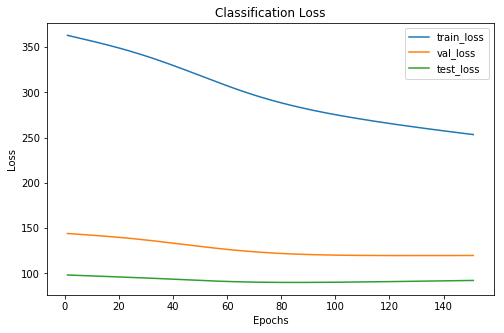

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     37      25
 1      133     52      40
 2       97     41      23
xxxxxxxxxxxxxx epoch: 151 xxxxxxxxxxxxxx


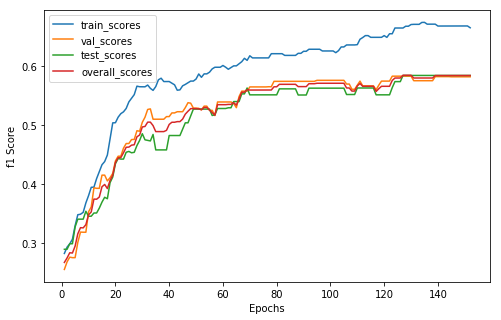

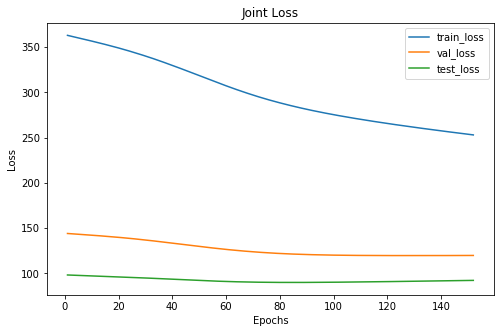

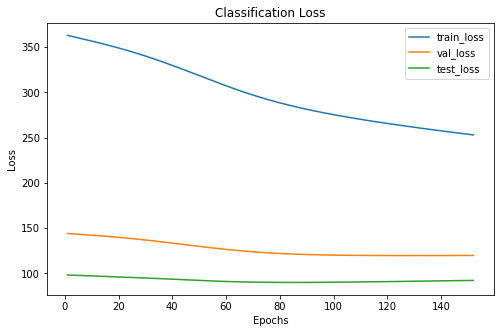

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     37      25
 1      134     52      40
 2       96     41      23
xxxxxxxxxxxxxx epoch: 152 xxxxxxxxxxxxxx


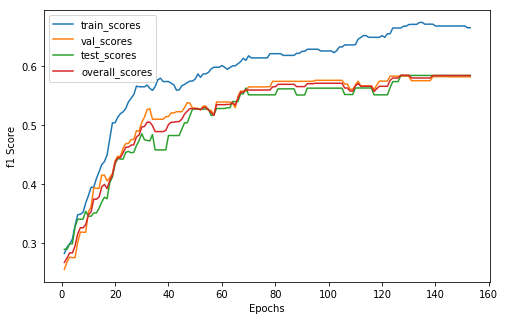

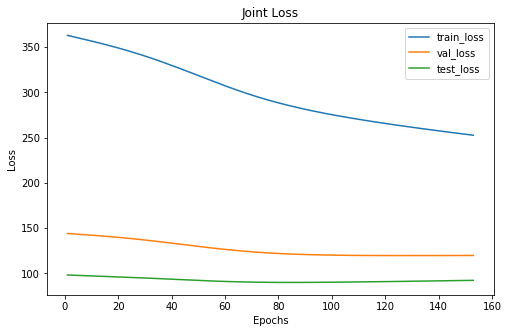

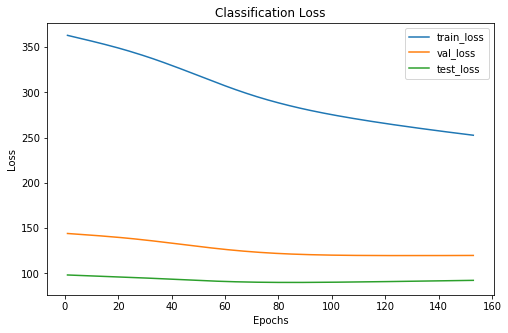

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     37      25
 1      134     52      40
 2       96     41      23
xxxxxxxxxxxxxx epoch: 153 xxxxxxxxxxxxxx


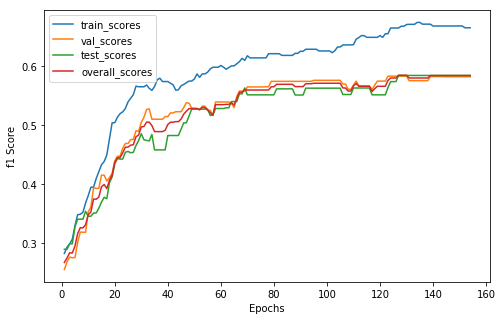

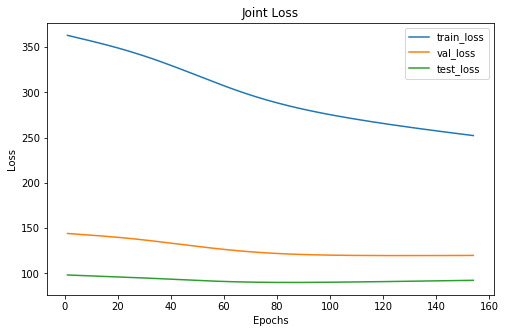

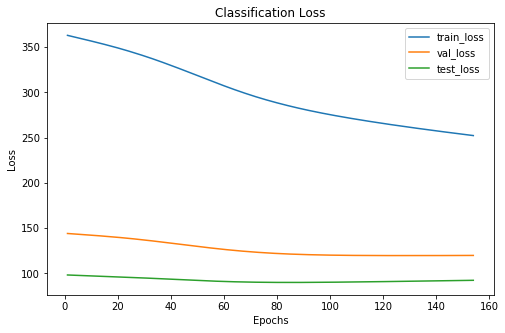

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     37      25
 1      134     52      40
 2       96     41      23
xxxxxxxxxxxxxx epoch: 154 xxxxxxxxxxxxxx


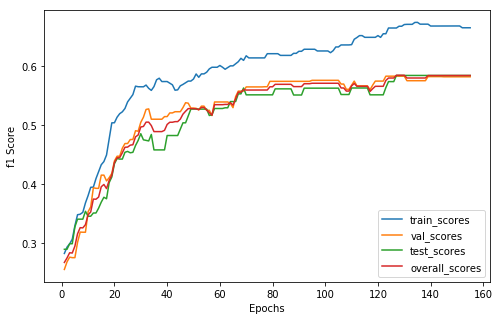

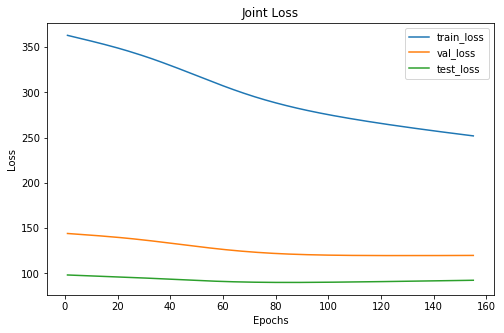

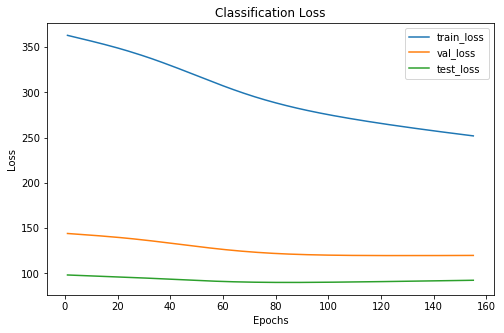

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     37      25
 1      134     52      40
 2       96     41      23
xxxxxxxxxxxxxx epoch: 155 xxxxxxxxxxxxxx


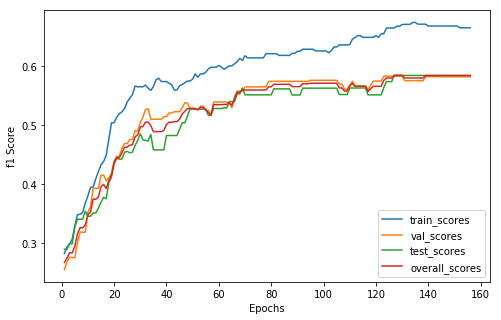

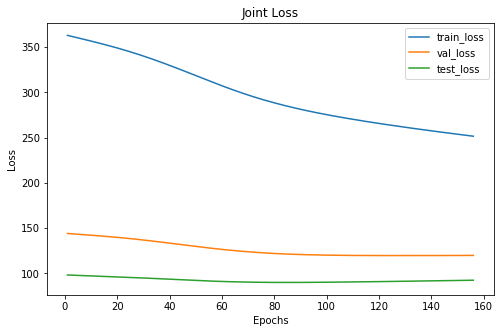

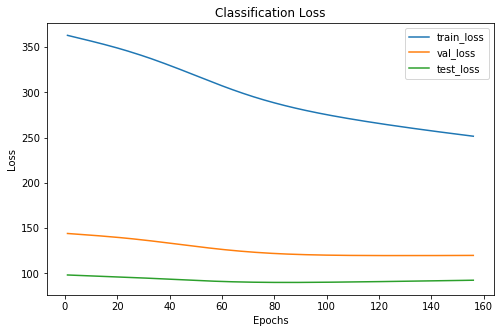

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     37      25
 1      134     52      40
 2       96     41      23
xxxxxxxxxxxxxx epoch: 156 xxxxxxxxxxxxxx


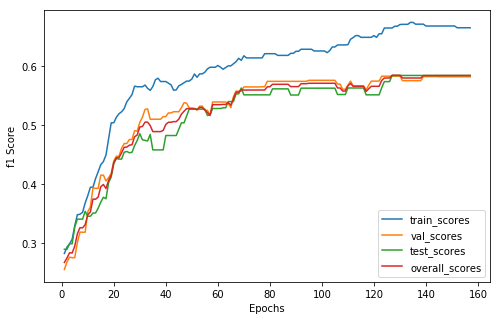

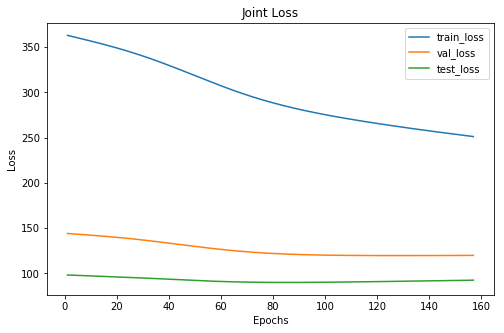

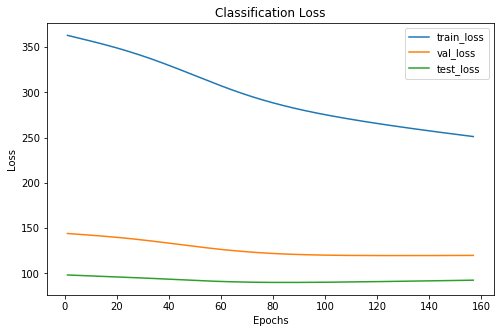

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     37      25
 1      134     52      40
 2       96     41      23
xxxxxxxxxxxxxx epoch: 157 xxxxxxxxxxxxxx


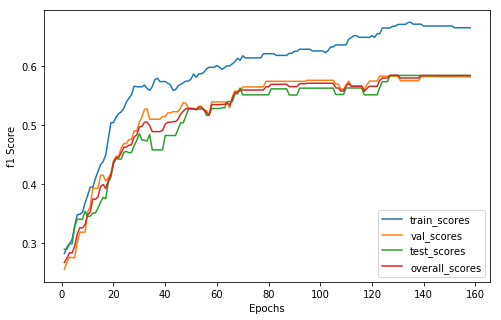

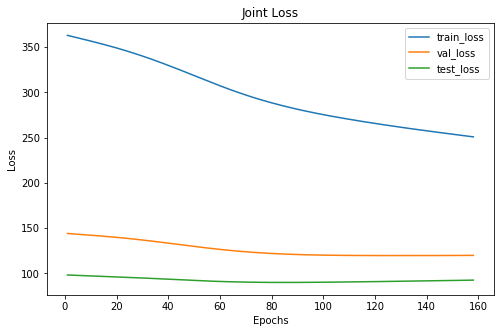

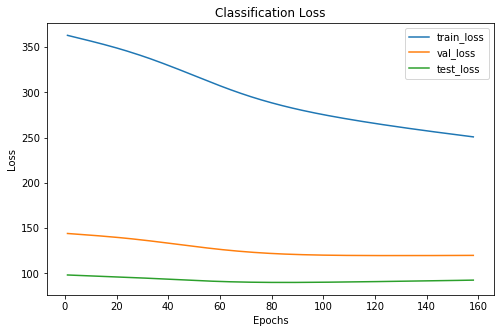

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
 9  31  10
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     37      25
 1      134     52      40
 2       96     41      23
xxxxxxxxxxxxxx epoch: 158 xxxxxxxxxxxxxx


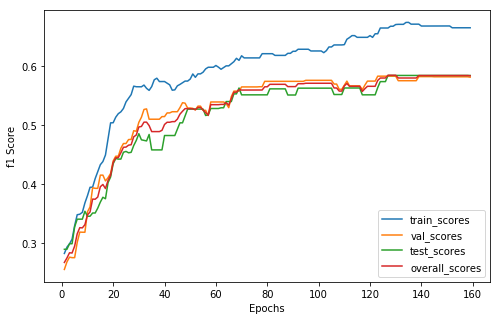

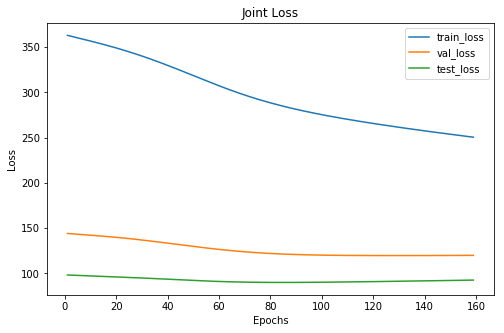

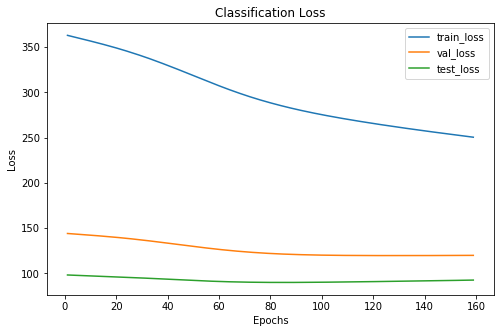

Cofusion Matrix For Val Set: 
--  --  --
25  17  11
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       97     38      25
 1      134     52      40
 2       96     40      23
xxxxxxxxxxxxxx epoch: 159 xxxxxxxxxxxxxx


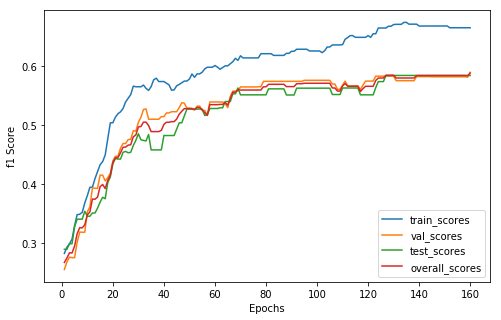

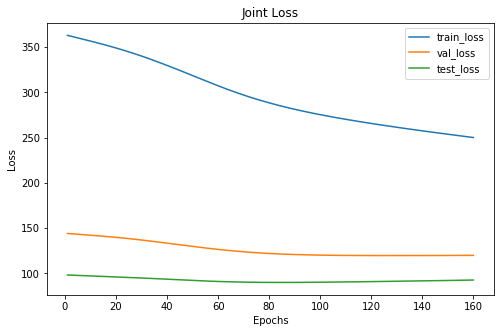

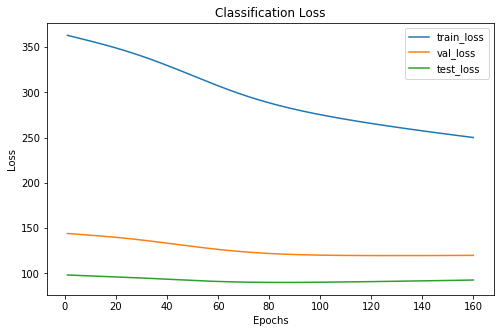

Cofusion Matrix For Val Set: 
--  --  --
26  17  10
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       98     39      25
 1      134     52      40
 2       95     39      23
xxxxxxxxxxxxxx epoch: 160 xxxxxxxxxxxxxx


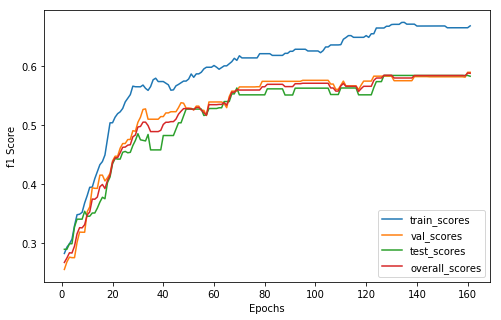

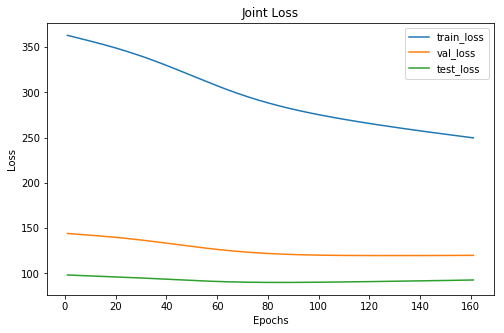

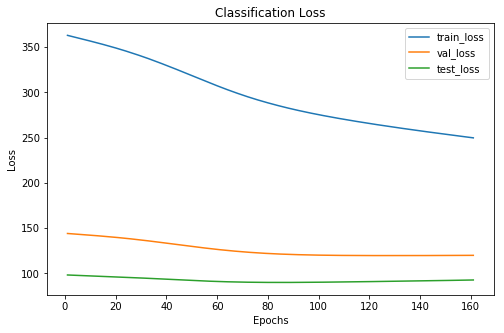

Cofusion Matrix For Val Set: 
--  --  --
26  17  10
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     39      26
 1      134     52      40
 2       94     39      22
xxxxxxxxxxxxxx epoch: 161 xxxxxxxxxxxxxx


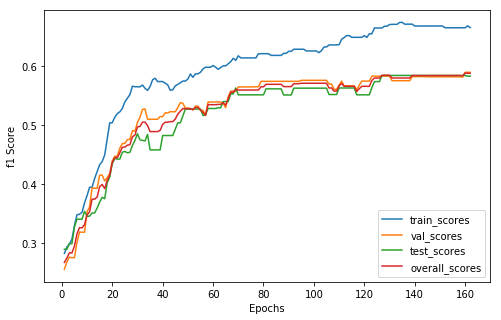

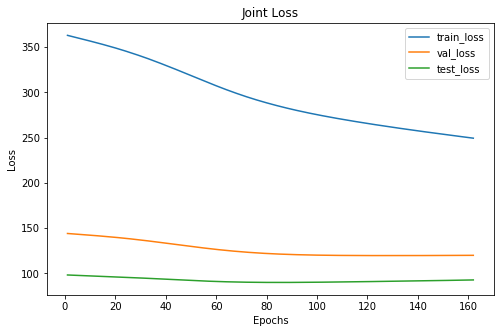

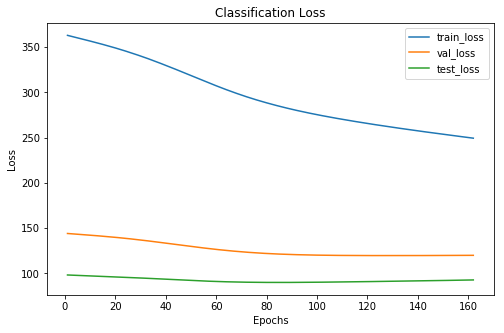

Cofusion Matrix For Val Set: 
--  --  --
26  17  10
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     39      26
 1      135     52      40
 2       93     39      22
xxxxxxxxxxxxxx epoch: 162 xxxxxxxxxxxxxx


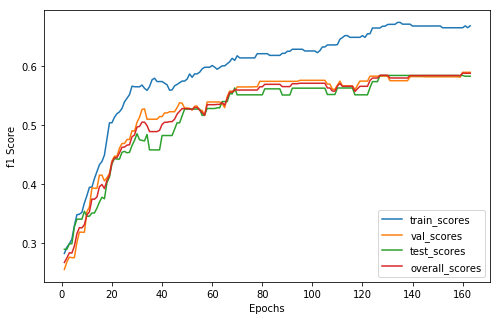

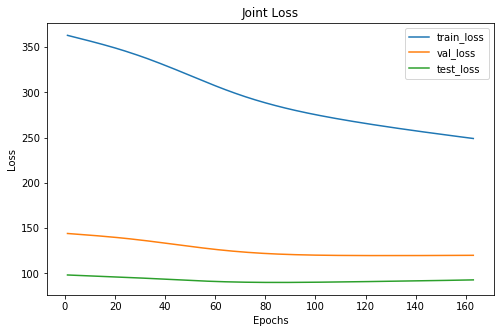

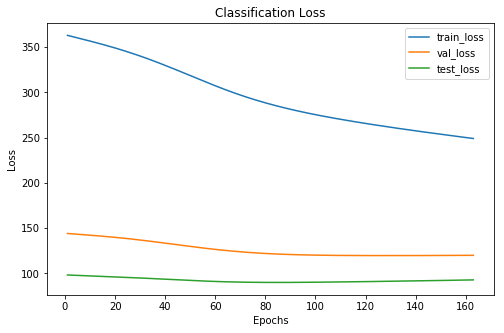

Cofusion Matrix For Val Set: 
--  --  --
26  17  10
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     39      26
 1      135     52      40
 2       92     39      22
xxxxxxxxxxxxxx epoch: 163 xxxxxxxxxxxxxx


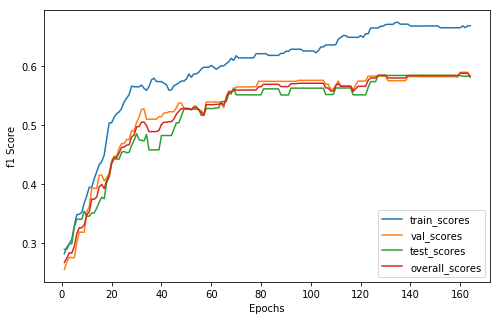

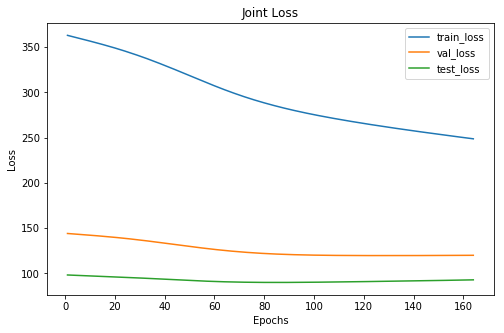

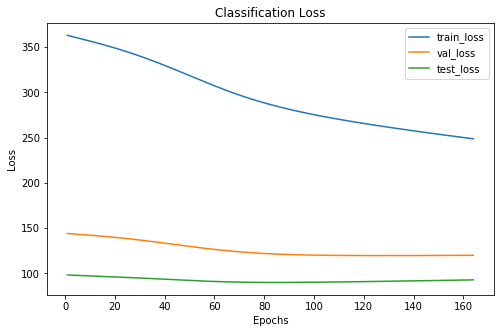

Cofusion Matrix For Val Set: 
--  --  --
25  18  10
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     38      26
 1      135     53      40
 2       92     39      22
xxxxxxxxxxxxxx epoch: 164 xxxxxxxxxxxxxx


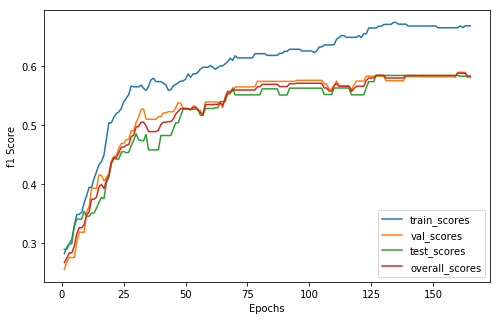

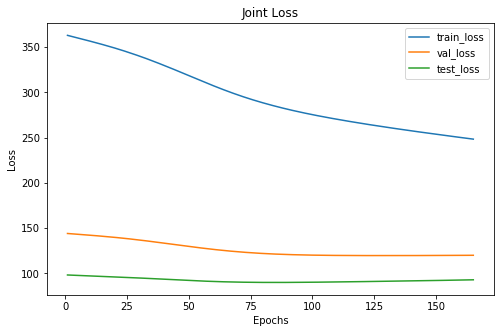

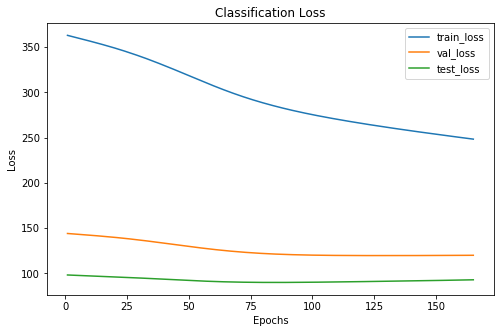

Cofusion Matrix For Val Set: 
--  --  --
25  18  10
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     38      26
 1      135     53      40
 2       92     39      22
xxxxxxxxxxxxxx epoch: 165 xxxxxxxxxxxxxx


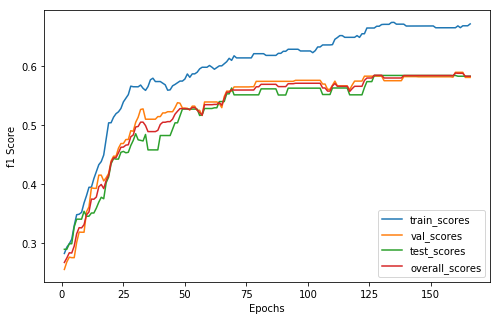

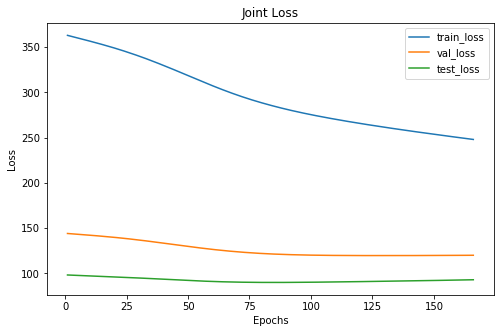

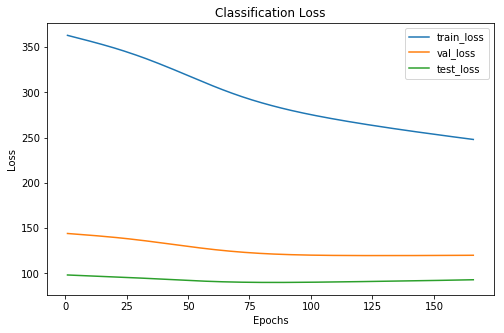

Cofusion Matrix For Val Set: 
--  --  --
25  18  10
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     38      26
 1      135     53      40
 2       91     39      22
xxxxxxxxxxxxxx epoch: 166 xxxxxxxxxxxxxx


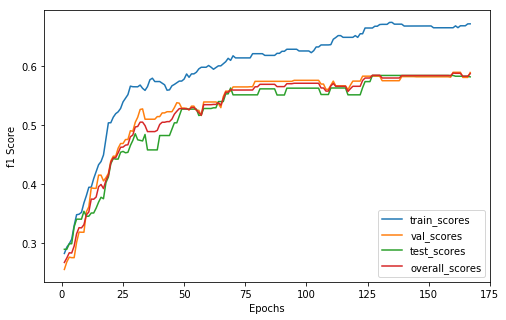

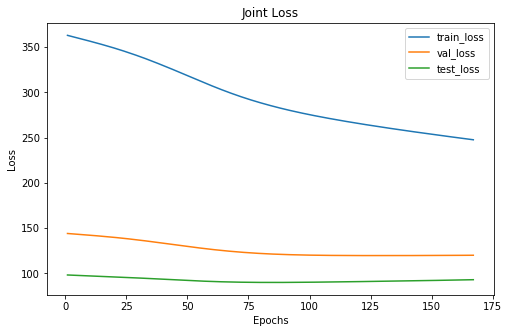

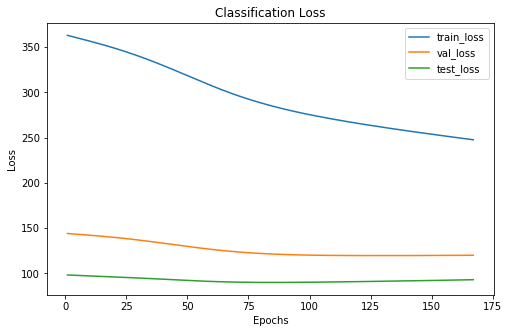

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      102     39      27
 1      135     53      40
 2       90     38      21
xxxxxxxxxxxxxx epoch: 167 xxxxxxxxxxxxxx


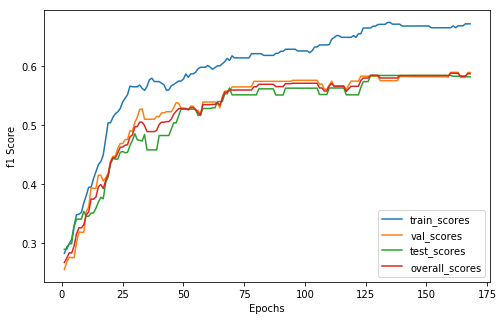

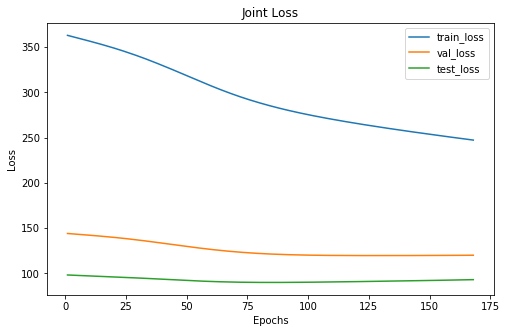

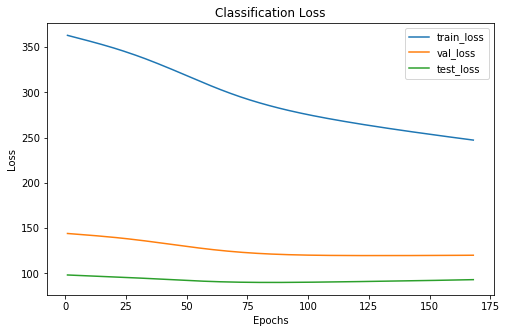

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      102     39      27
 1      135     53      40
 2       90     38      21
xxxxxxxxxxxxxx epoch: 168 xxxxxxxxxxxxxx


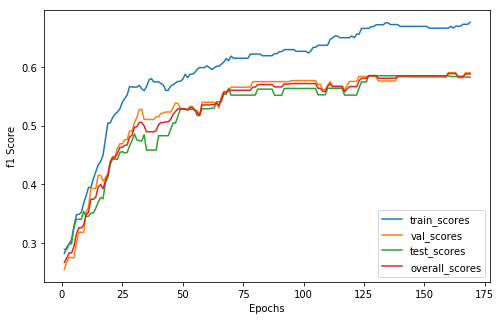

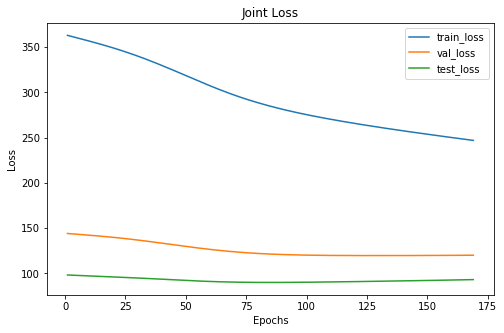

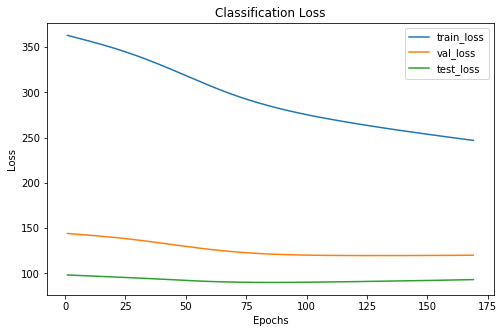

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      103     39      27
 1      135     53      40
 2       89     38      21
xxxxxxxxxxxxxx epoch: 169 xxxxxxxxxxxxxx


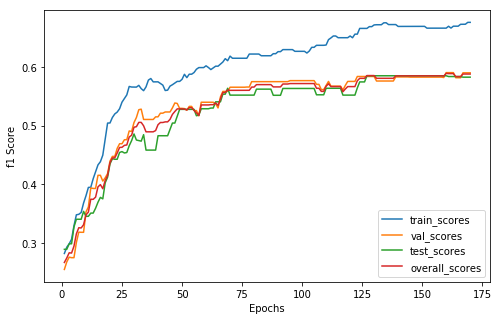

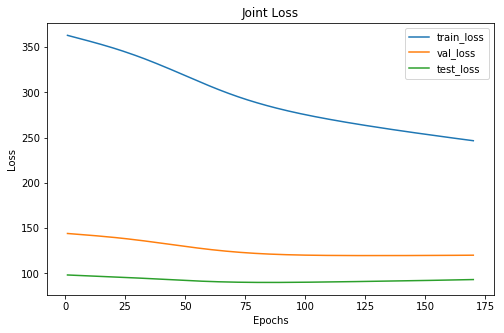

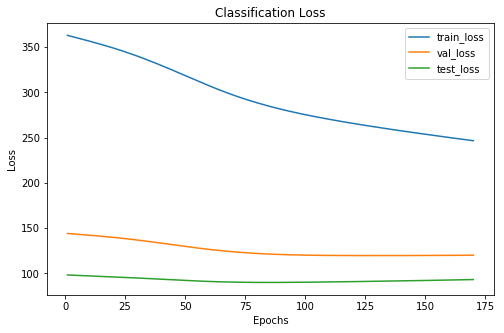

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      103     39      27
 1      135     53      40
 2       89     38      21
xxxxxxxxxxxxxx epoch: 170 xxxxxxxxxxxxxx


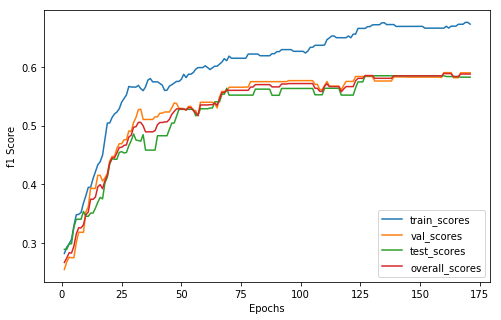

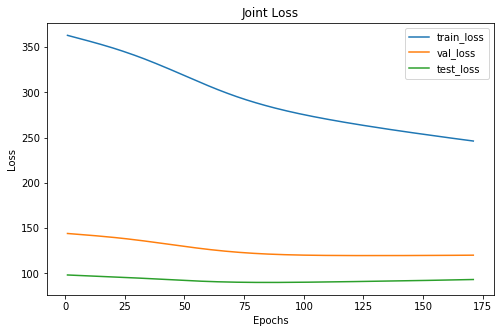

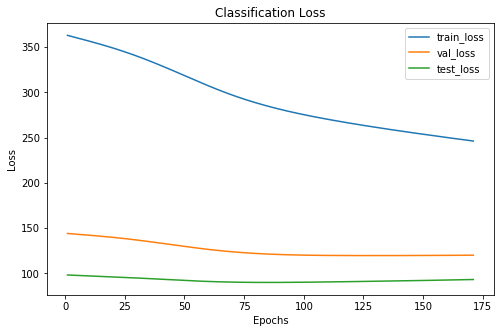

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      104     39      27
 1      135     53      40
 2       88     38      21
xxxxxxxxxxxxxx epoch: 171 xxxxxxxxxxxxxx


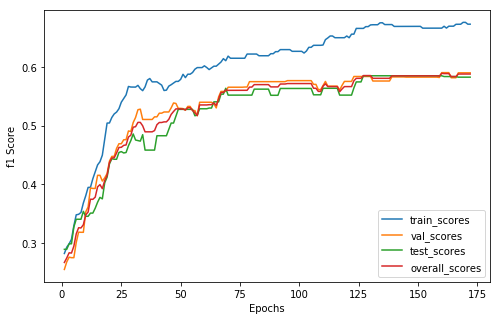

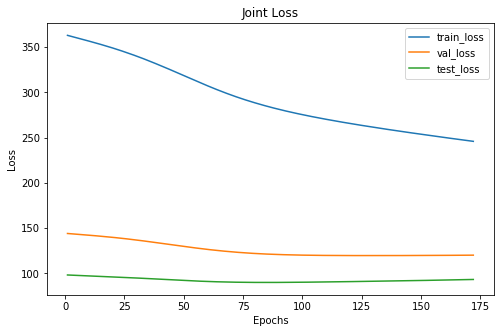

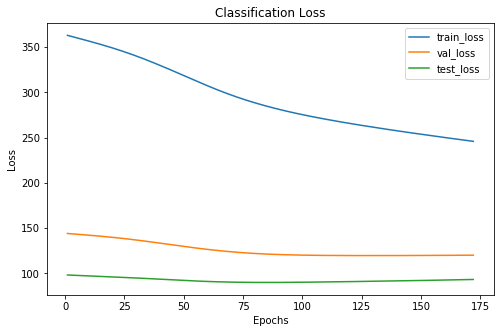

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      104     39      27
 1      135     53      40
 2       88     38      21
xxxxxxxxxxxxxx epoch: 172 xxxxxxxxxxxxxx


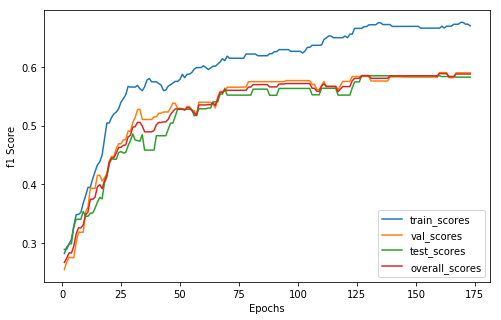

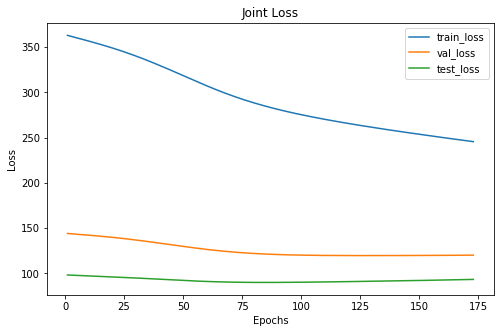

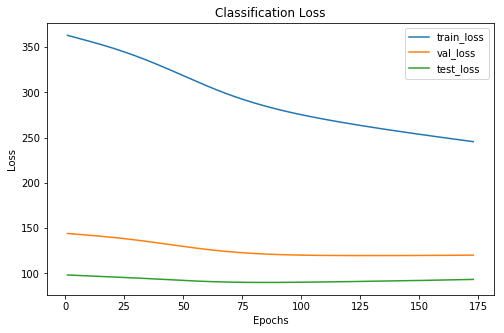

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 3   4  20
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     39      27
 1      134     53      40
 2       88     38      21
xxxxxxxxxxxxxx epoch: 173 xxxxxxxxxxxxxx


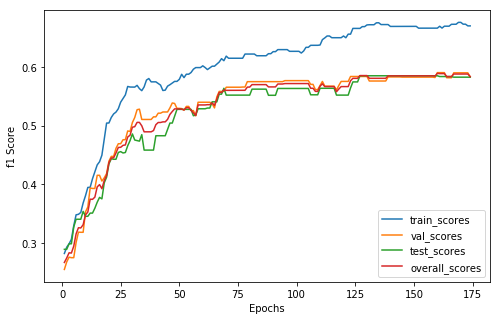

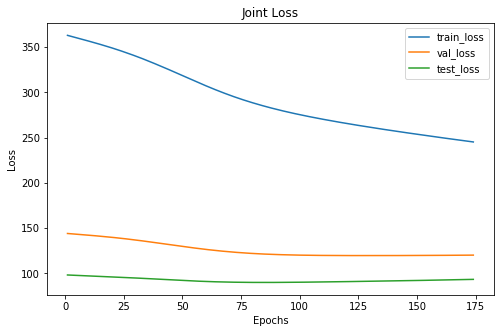

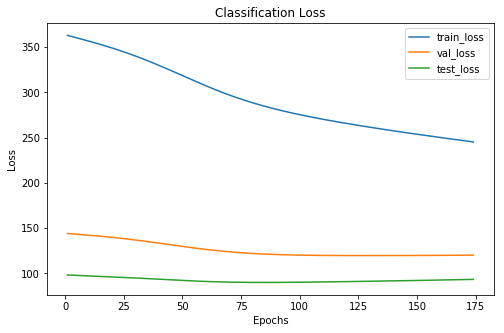

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     40      27
 1      134     53      40
 2       88     37      21
xxxxxxxxxxxxxx epoch: 174 xxxxxxxxxxxxxx


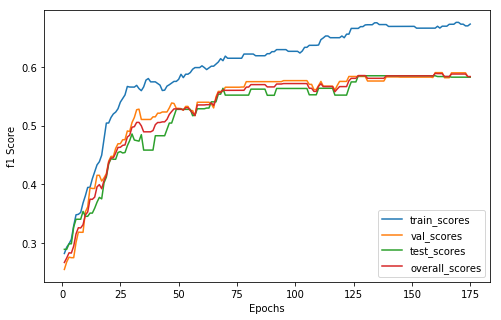

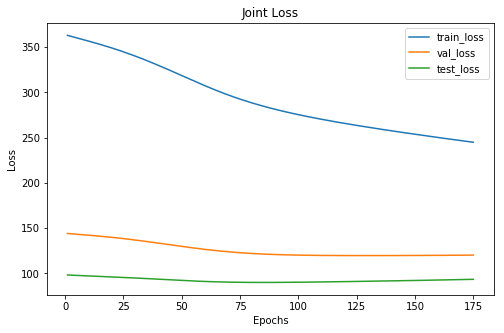

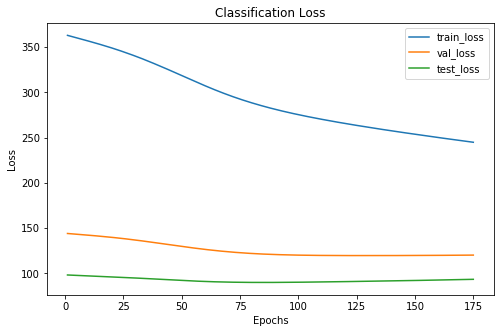

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      106     40      27
 1      133     53      40
 2       88     37      21
xxxxxxxxxxxxxx epoch: 175 xxxxxxxxxxxxxx


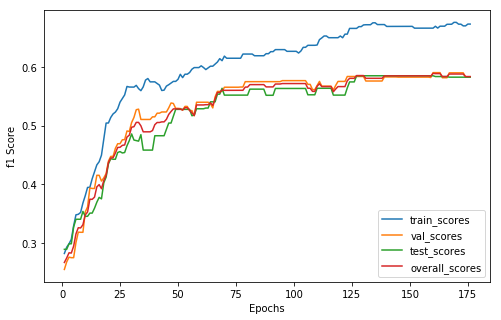

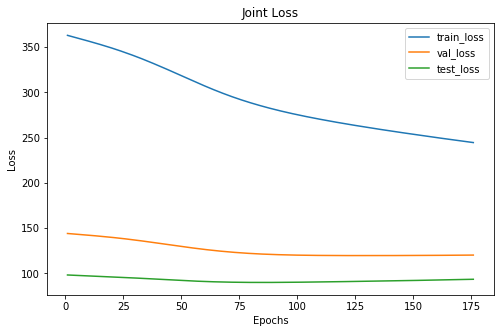

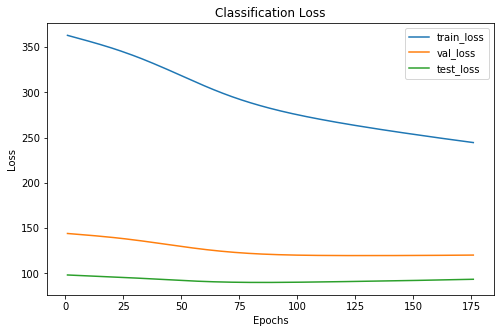

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      106     40      27
 1      133     53      40
 2       88     37      21
xxxxxxxxxxxxxx epoch: 176 xxxxxxxxxxxxxx


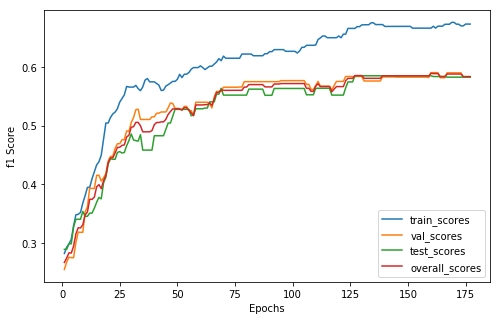

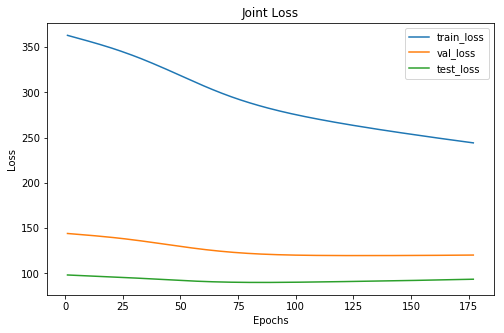

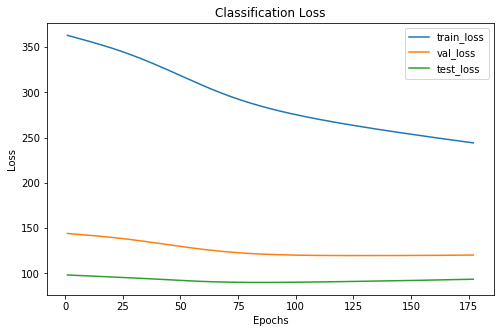

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      106     40      27
 1      133     53      40
 2       88     37      21
xxxxxxxxxxxxxx epoch: 177 xxxxxxxxxxxxxx


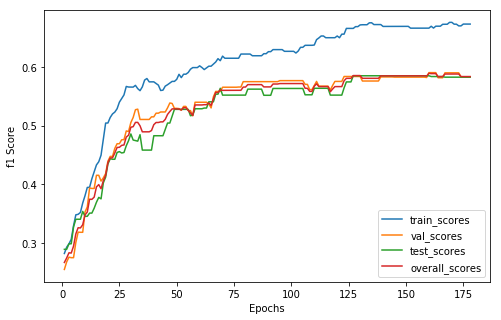

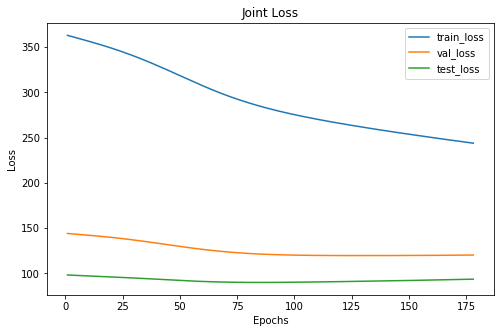

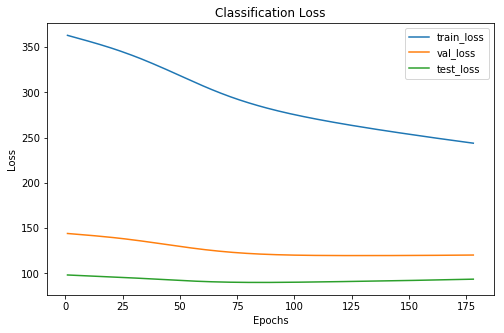

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      106     40      27
 1      133     53      40
 2       88     37      21
xxxxxxxxxxxxxx epoch: 178 xxxxxxxxxxxxxx


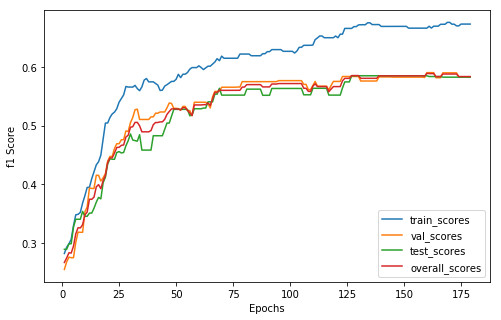

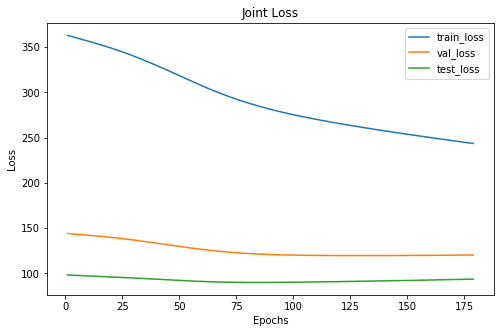

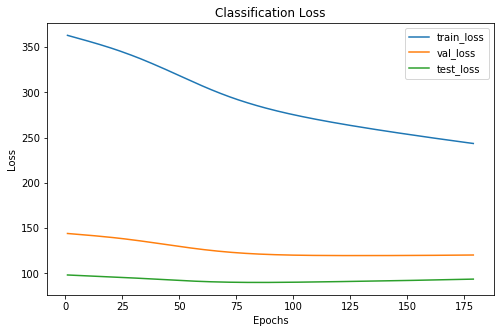

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      106     40      27
 1      133     53      40
 2       88     37      21
xxxxxxxxxxxxxx epoch: 179 xxxxxxxxxxxxxx


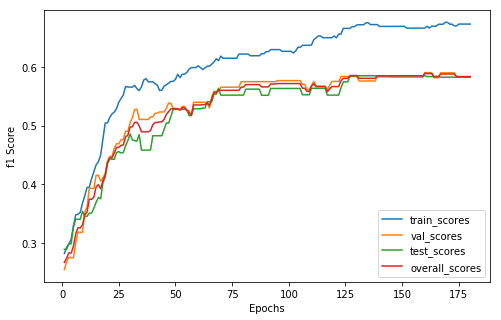

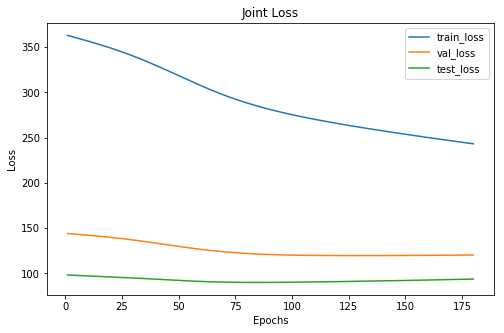

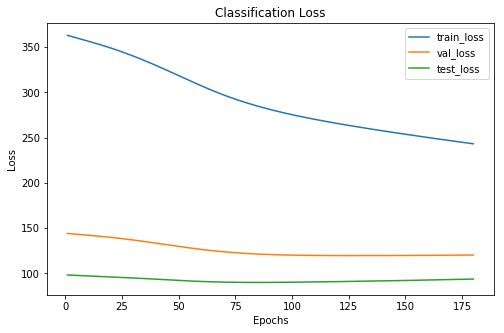

Cofusion Matrix For Val Set: 
--  --  --
26  18   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      106     40      27
 1      133     53      40
 2       88     37      21
xxxxxxxxxxxxxx epoch: 180 xxxxxxxxxxxxxx


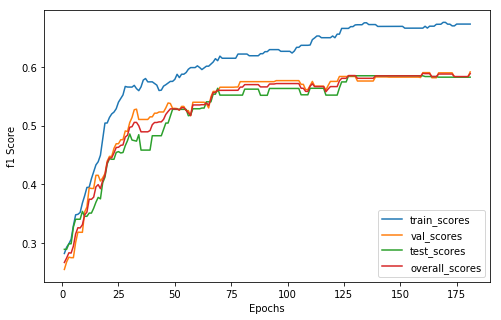

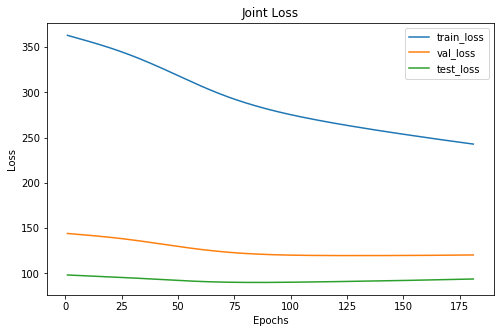

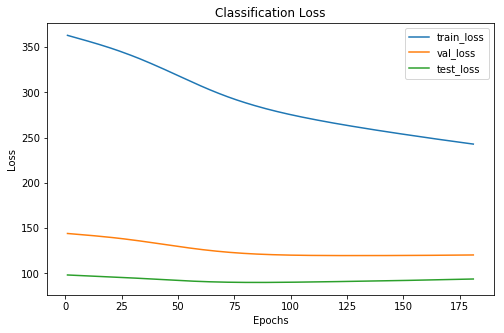

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      106     41      27
 1      133     52      40
 2       88     37      21
xxxxxxxxxxxxxx epoch: 181 xxxxxxxxxxxxxx


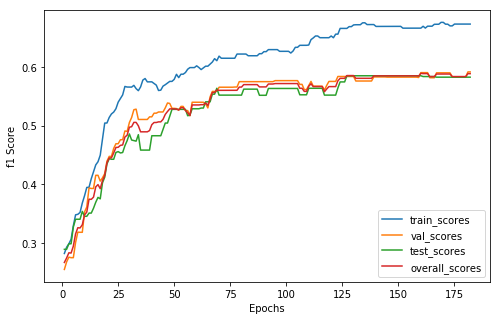

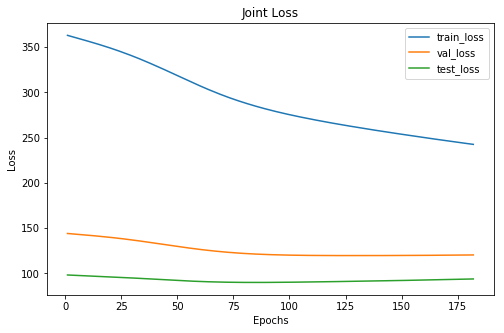

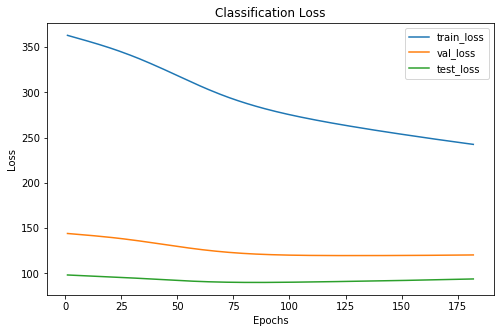

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      106     41      27
 1      133     52      40
 2       88     37      21
xxxxxxxxxxxxxx epoch: 182 xxxxxxxxxxxxxx


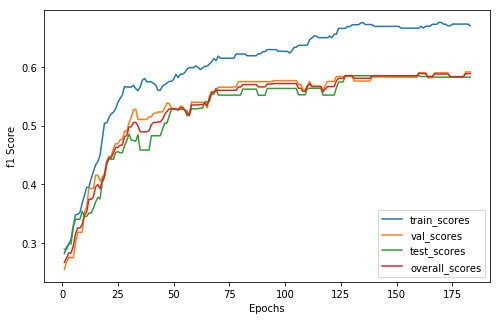

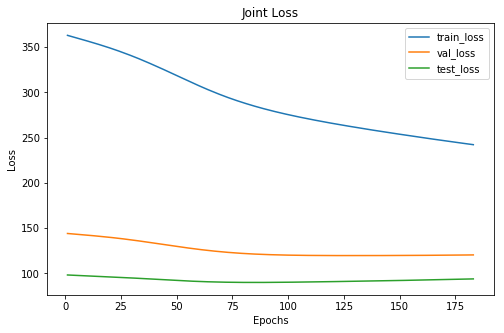

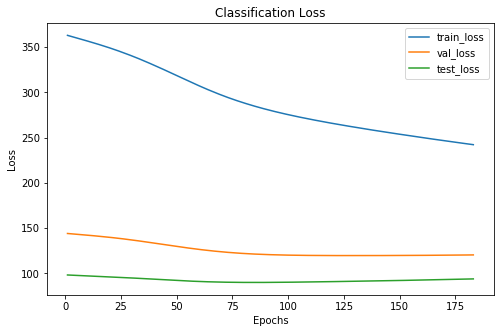

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     41      27
 1      133     52      40
 2       87     37      21
xxxxxxxxxxxxxx epoch: 183 xxxxxxxxxxxxxx


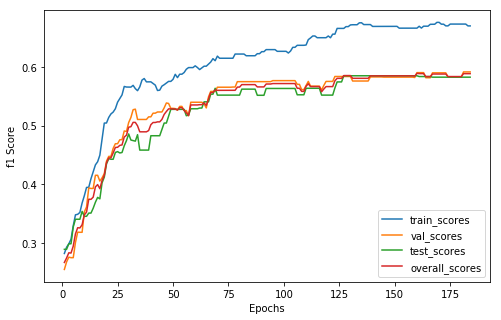

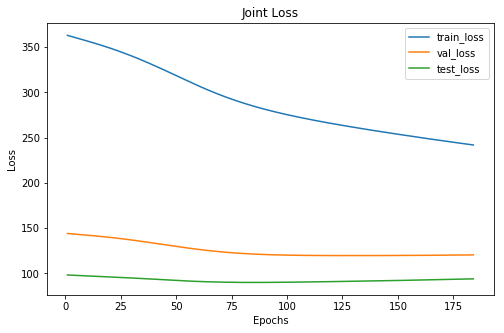

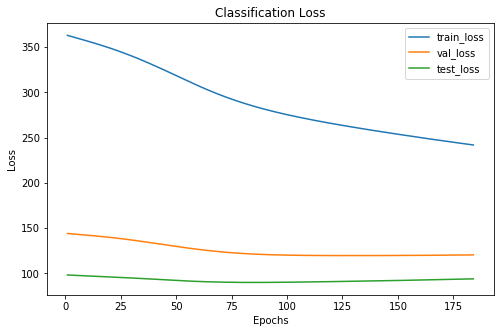

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     41      27
 1      133     52      40
 2       87     37      21
xxxxxxxxxxxxxx epoch: 184 xxxxxxxxxxxxxx


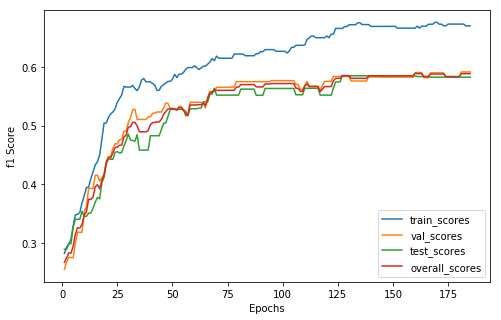

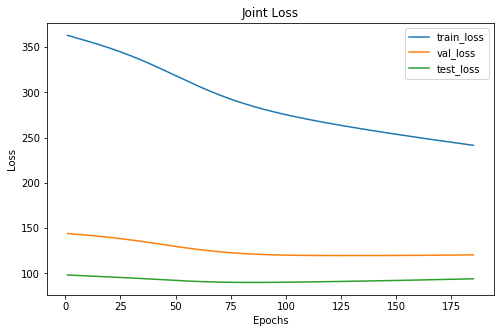

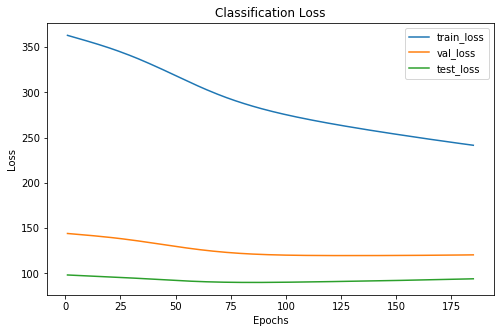

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     41      27
 1      133     52      40
 2       87     37      21
xxxxxxxxxxxxxx epoch: 185 xxxxxxxxxxxxxx


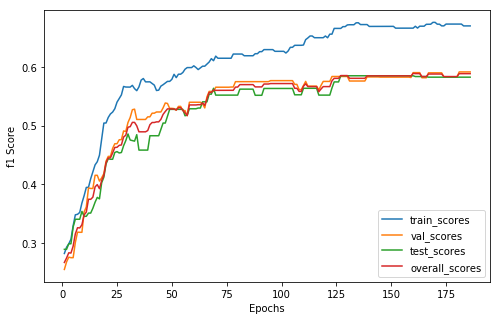

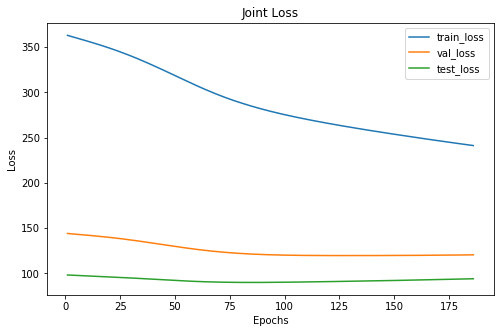

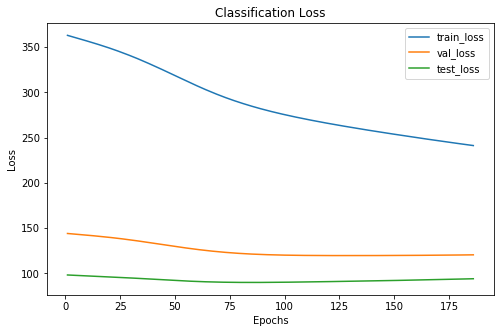

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     41      27
 1      133     52      40
 2       87     37      21
xxxxxxxxxxxxxx epoch: 186 xxxxxxxxxxxxxx


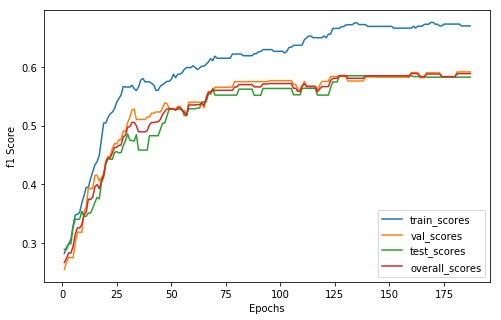

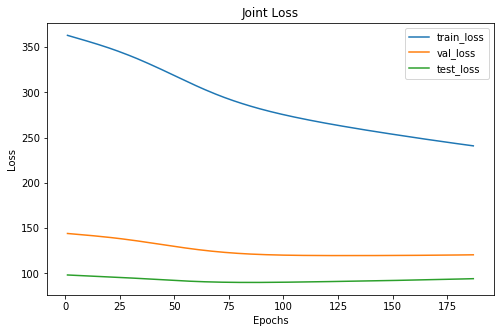

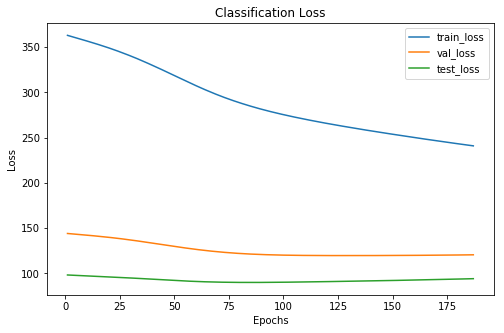

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     41      27
 1      133     52      40
 2       87     37      21
xxxxxxxxxxxxxx epoch: 187 xxxxxxxxxxxxxx


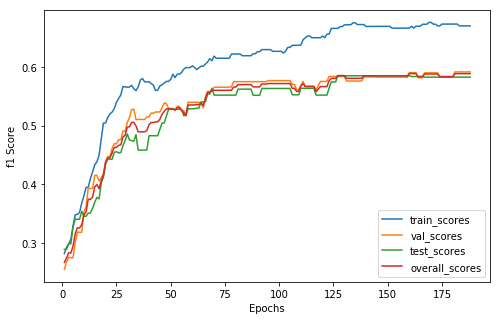

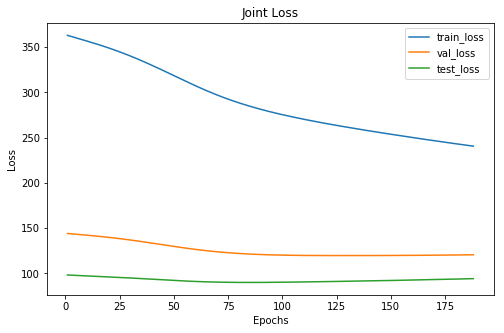

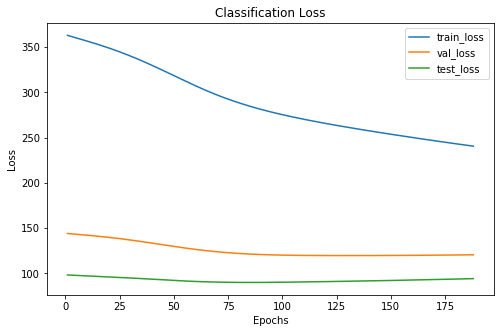

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     41      27
 1      133     52      40
 2       87     37      21
xxxxxxxxxxxxxx epoch: 188 xxxxxxxxxxxxxx


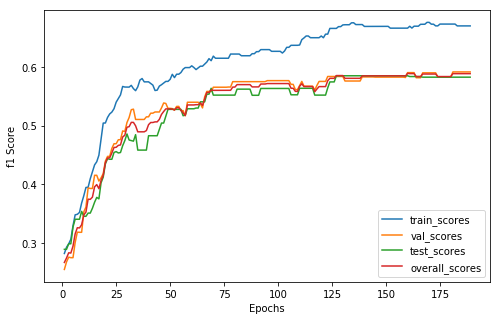

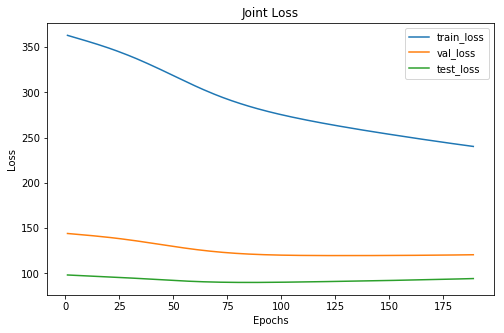

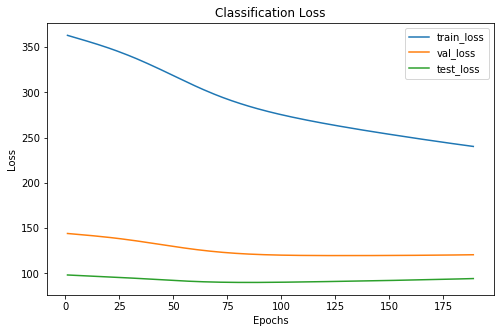

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     41      27
 1      133     52      40
 2       87     37      21
xxxxxxxxxxxxxx epoch: 189 xxxxxxxxxxxxxx


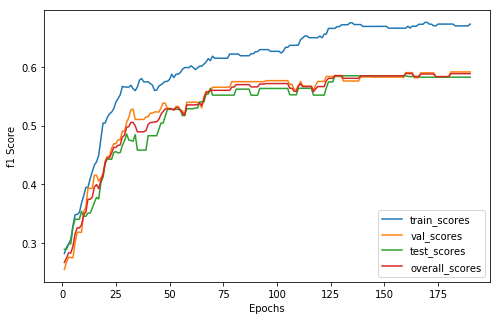

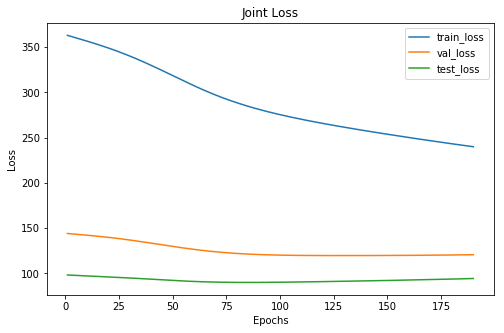

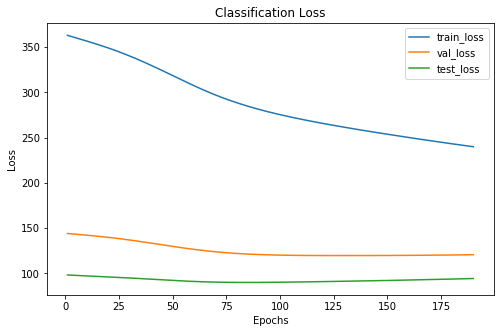

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     41      27
 1      132     52      40
 2       87     37      21
xxxxxxxxxxxxxx epoch: 190 xxxxxxxxxxxxxx


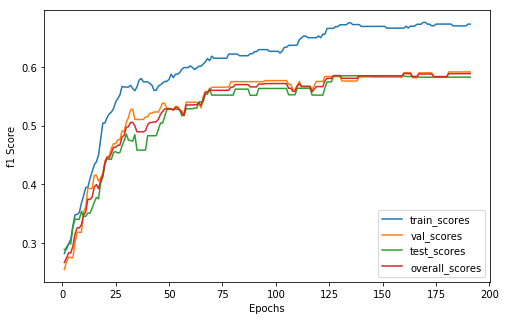

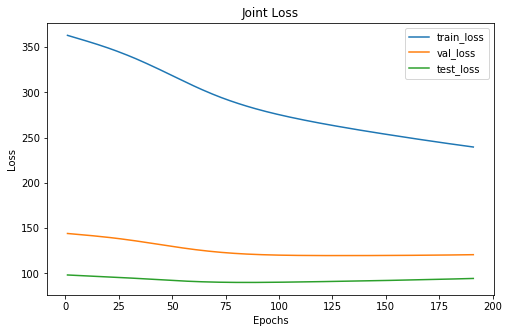

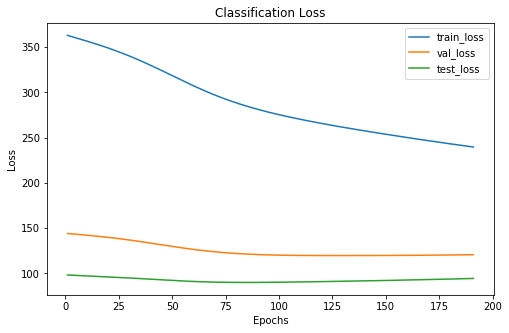

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     41      27
 1      132     52      40
 2       87     37      21
xxxxxxxxxxxxxx epoch: 191 xxxxxxxxxxxxxx


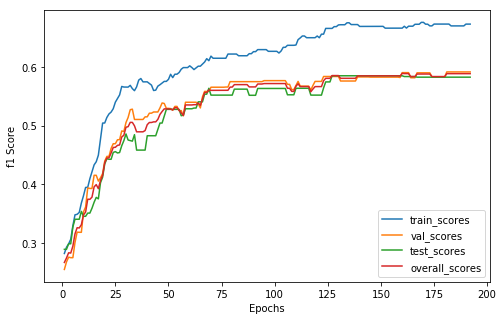

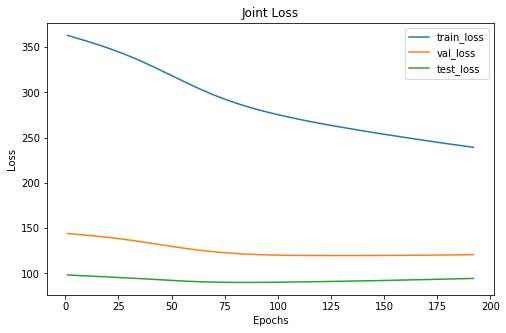

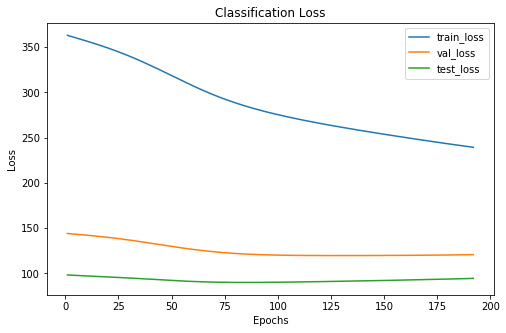

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     41      27
 1      132     52      40
 2       87     37      21
xxxxxxxxxxxxxx epoch: 192 xxxxxxxxxxxxxx


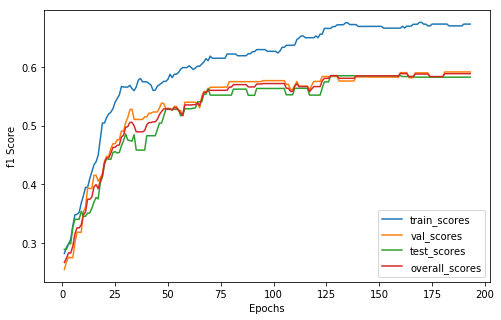

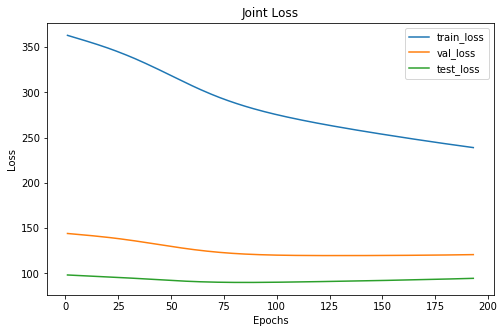

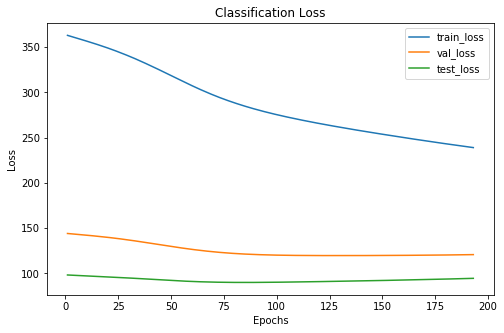

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     41      27
 1      132     52      40
 2       87     37      21
xxxxxxxxxxxxxx epoch: 193 xxxxxxxxxxxxxx


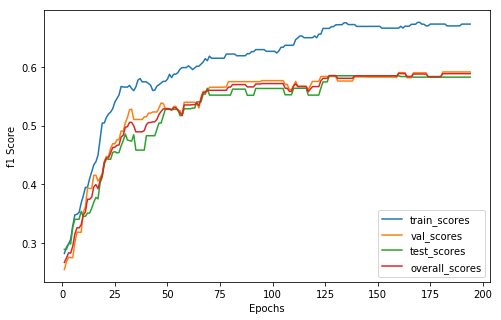

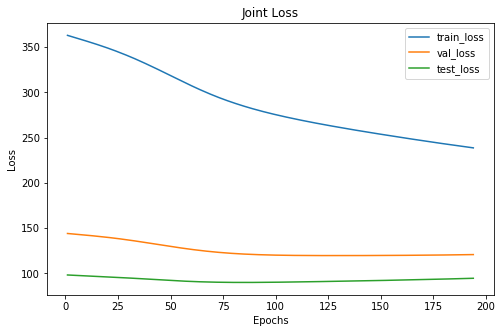

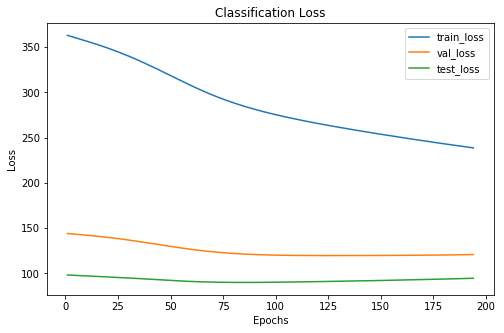

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     41      27
 1      132     52      40
 2       87     37      21
xxxxxxxxxxxxxx epoch: 194 xxxxxxxxxxxxxx


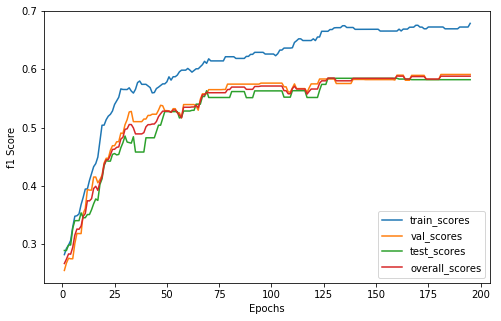

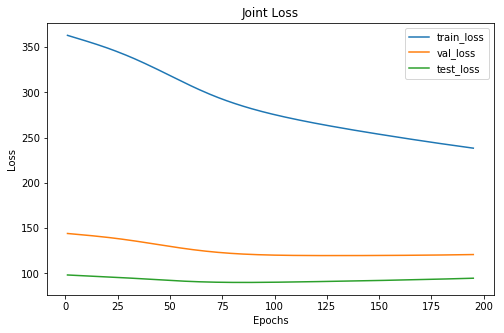

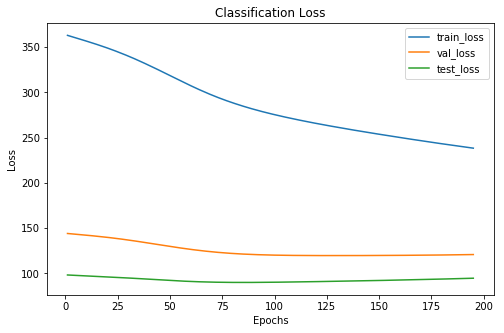

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     41      27
 1      130     52      40
 2       89     37      21
xxxxxxxxxxxxxx epoch: 195 xxxxxxxxxxxxxx


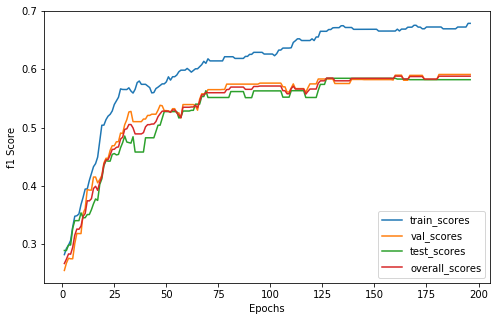

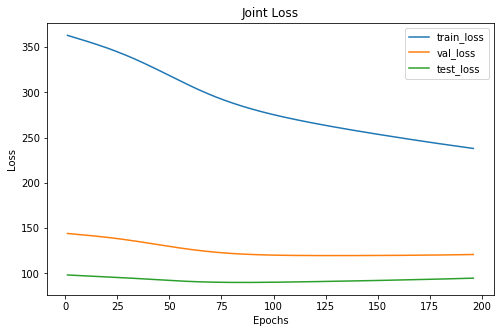

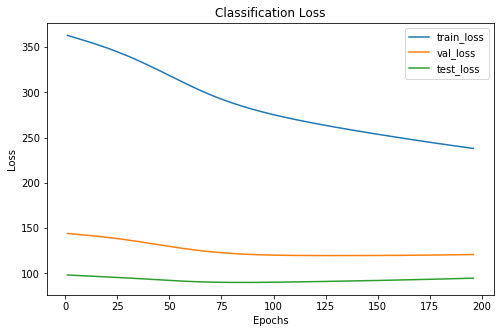

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 4   4  19
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     41      27
 1      130     52      40
 2       89     37      21
xxxxxxxxxxxxxx epoch: 196 xxxxxxxxxxxxxx


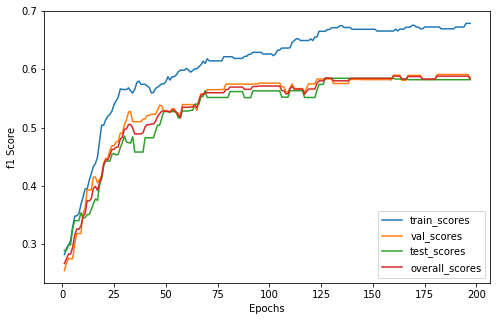

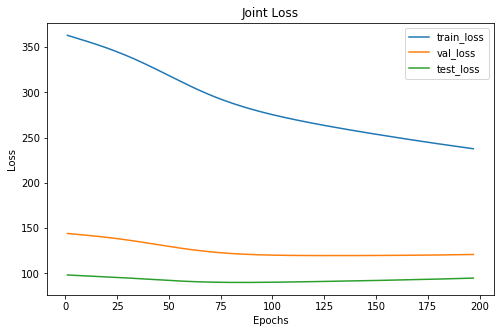

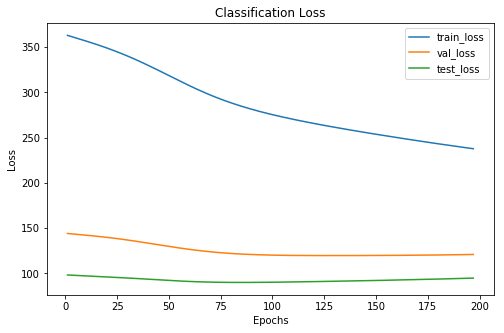

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 197 xxxxxxxxxxxxxx


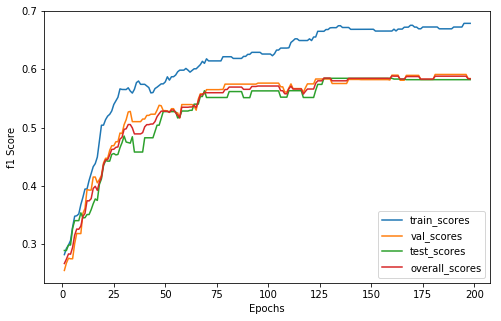

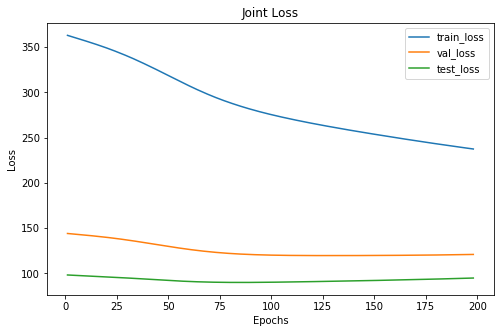

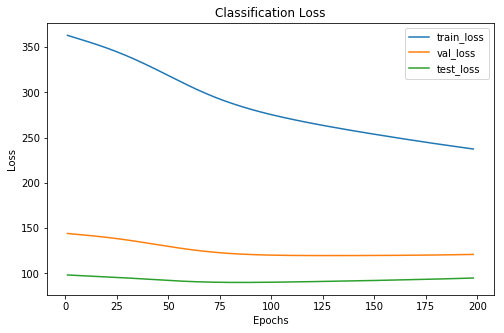

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 198 xxxxxxxxxxxxxx


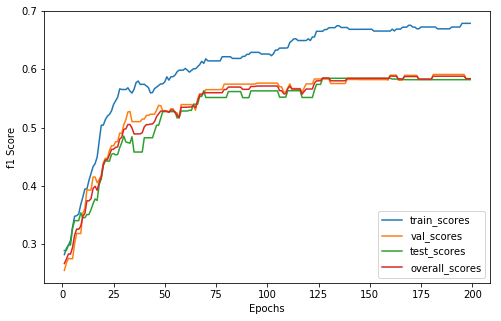

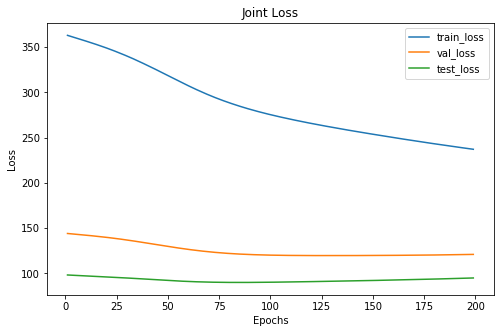

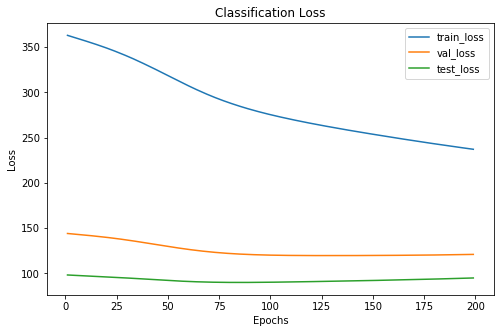

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 199 xxxxxxxxxxxxxx


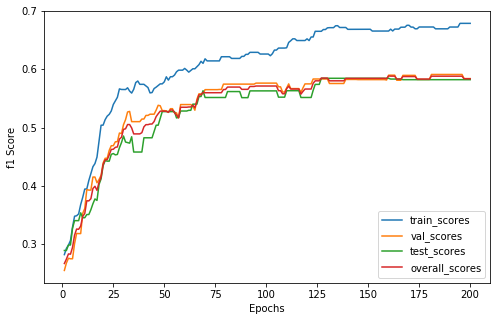

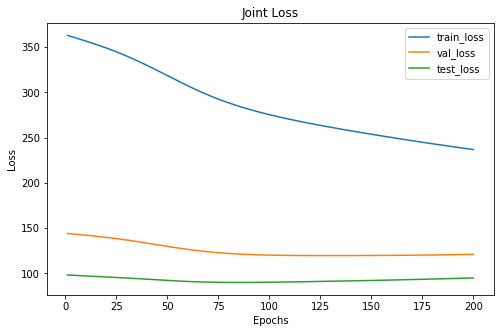

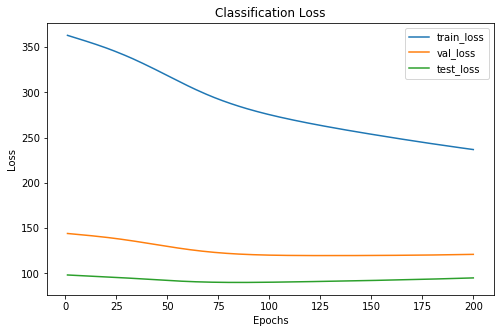

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 200 xxxxxxxxxxxxxx


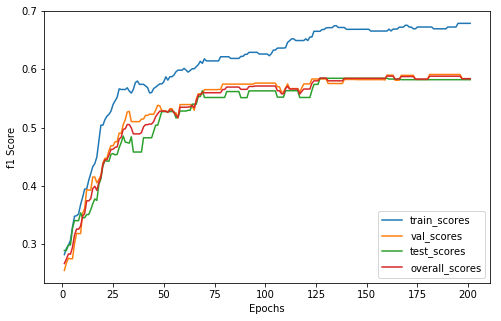

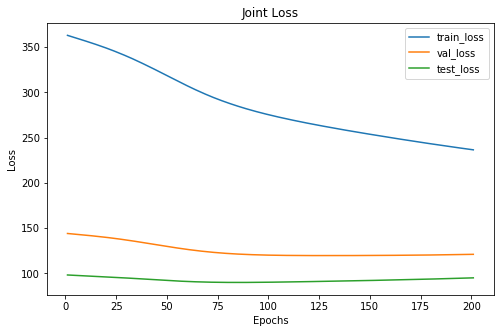

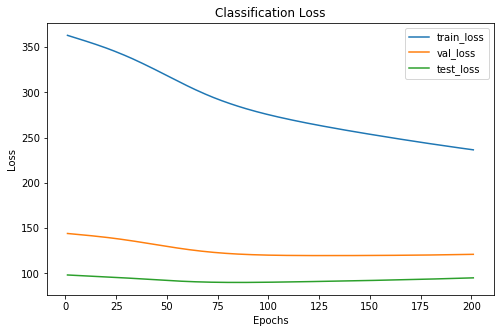

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 201 xxxxxxxxxxxxxx


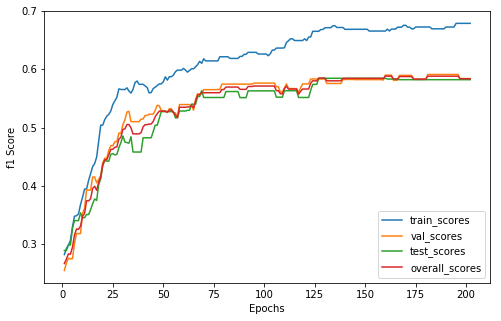

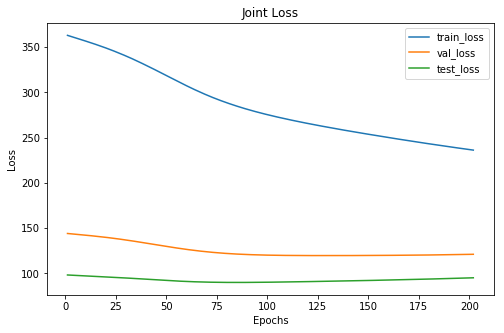

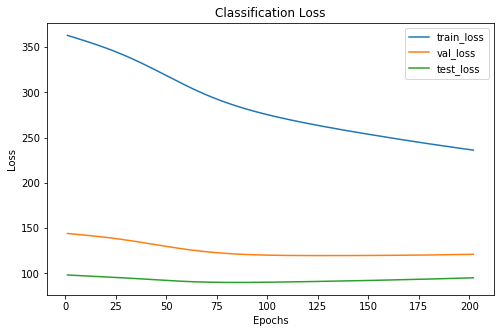

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 202 xxxxxxxxxxxxxx


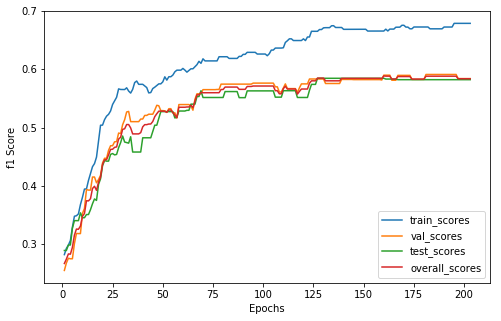

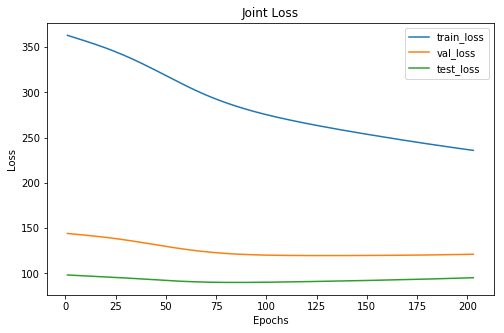

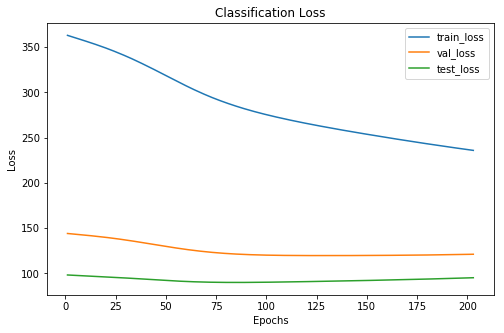

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 203 xxxxxxxxxxxxxx


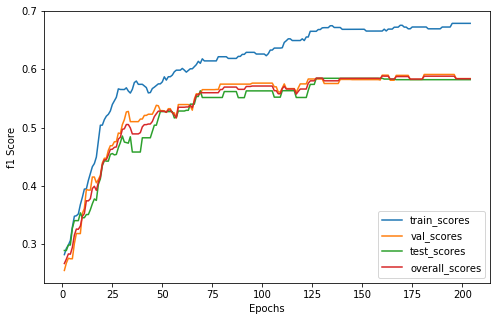

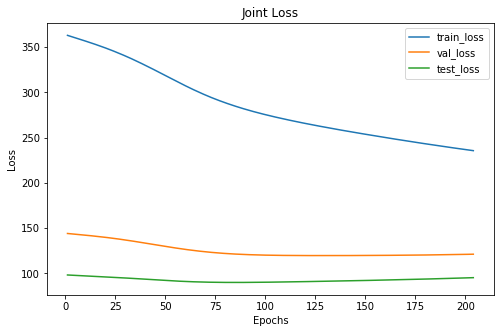

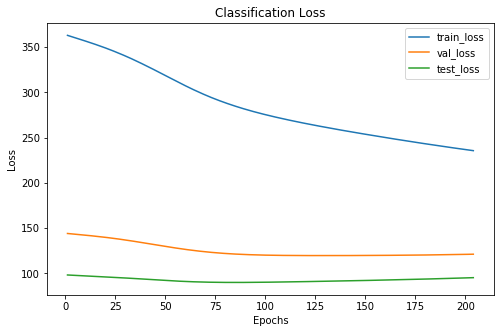

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 204 xxxxxxxxxxxxxx


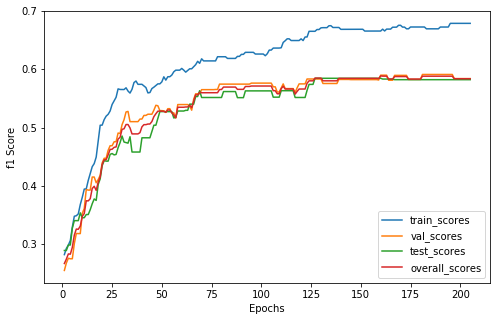

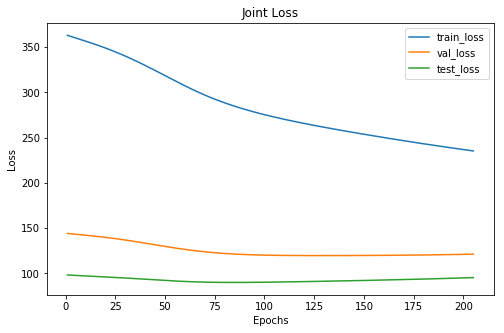

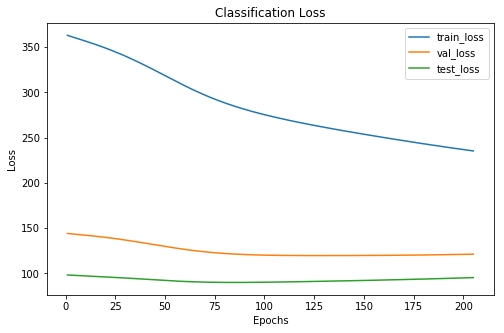

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 205 xxxxxxxxxxxxxx


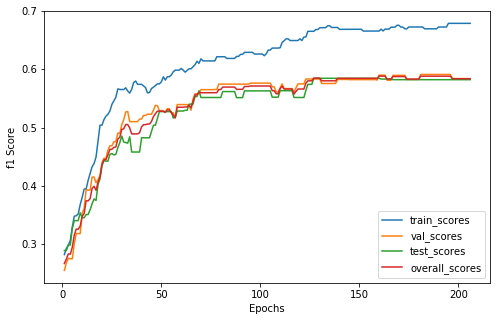

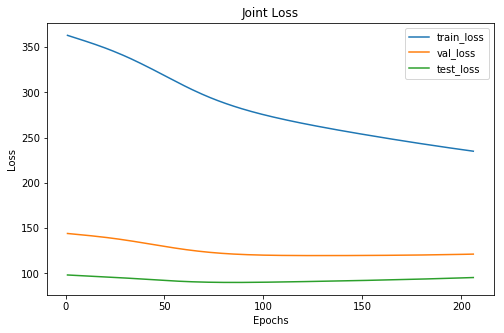

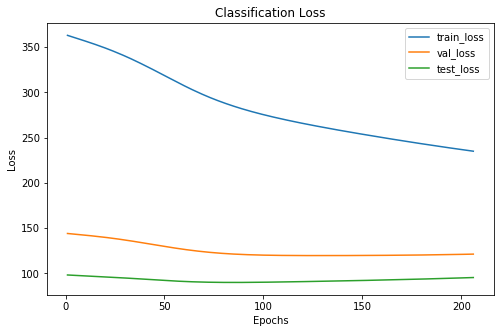

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 206 xxxxxxxxxxxxxx


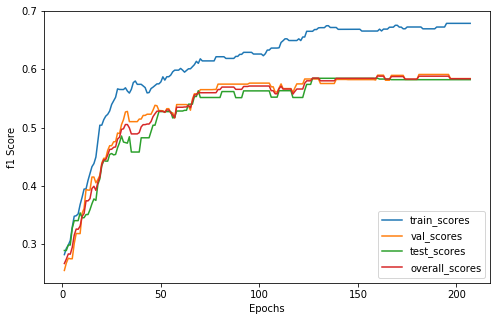

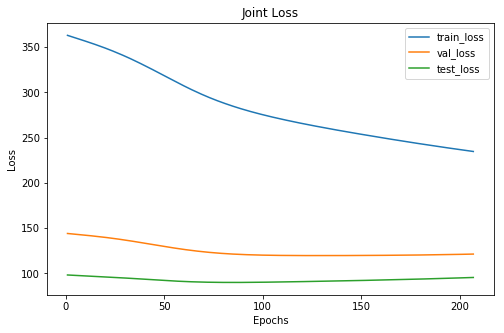

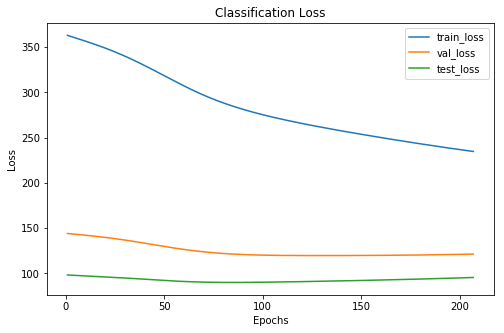

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 207 xxxxxxxxxxxxxx


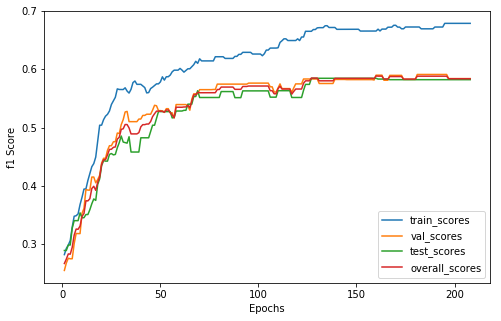

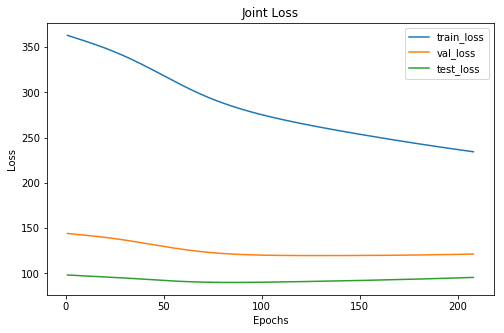

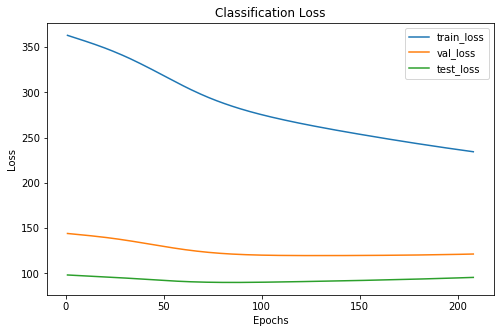

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 208 xxxxxxxxxxxxxx


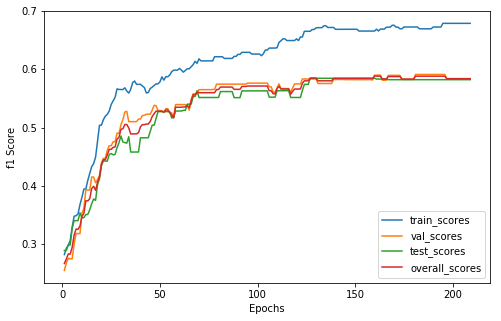

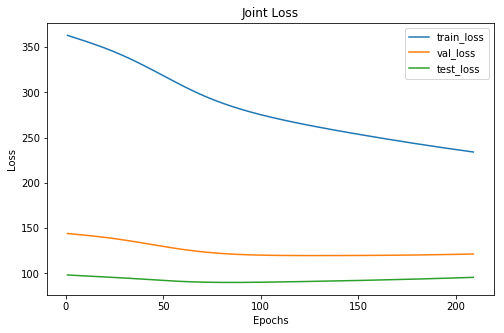

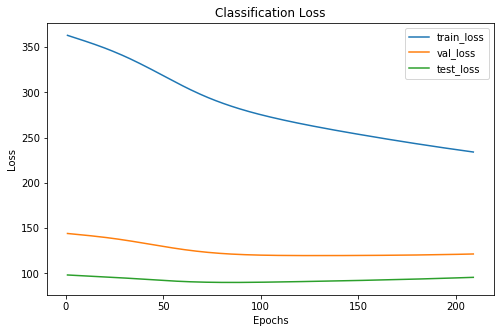

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 209 xxxxxxxxxxxxxx


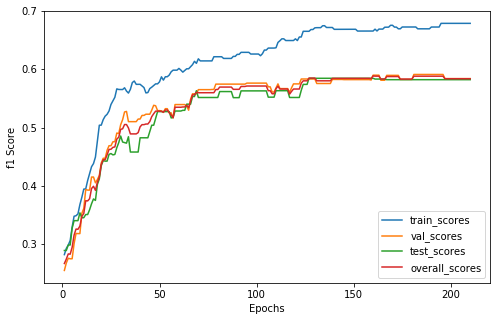

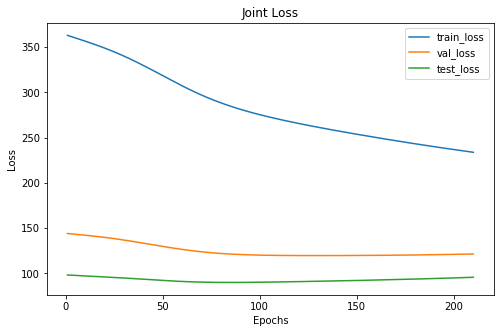

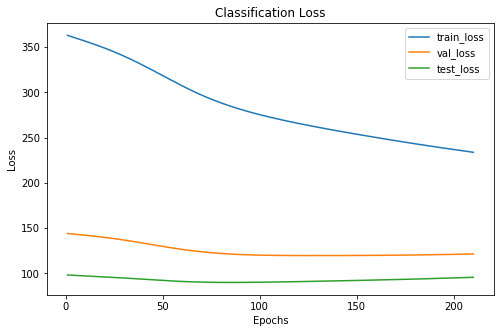

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 210 xxxxxxxxxxxxxx


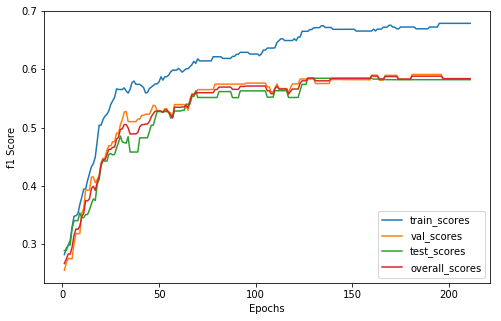

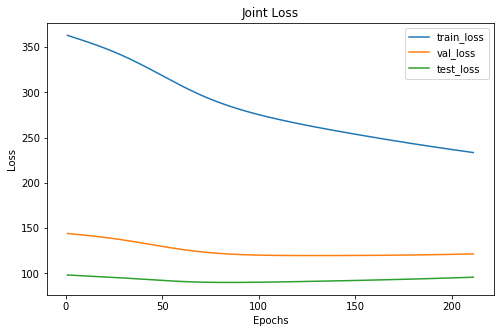

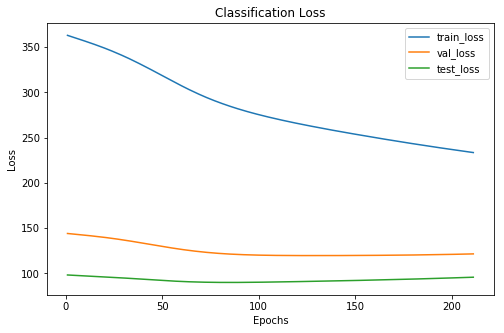

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 211 xxxxxxxxxxxxxx


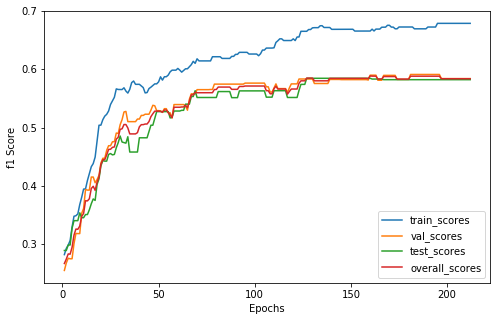

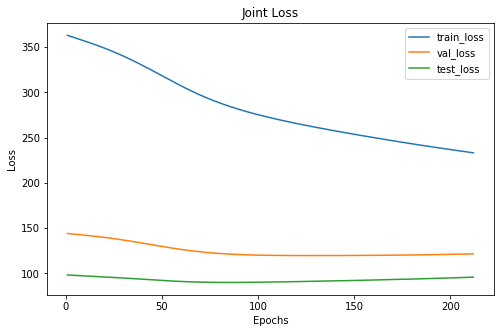

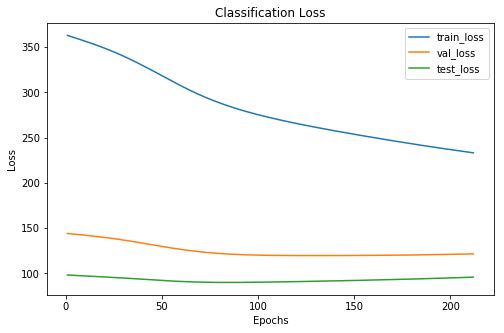

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 212 xxxxxxxxxxxxxx


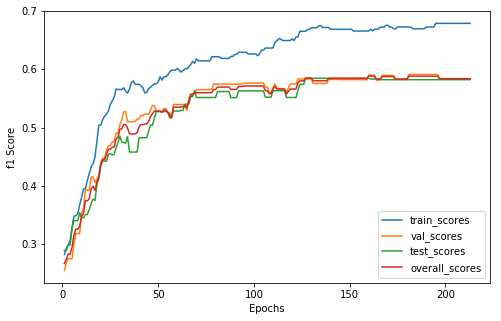

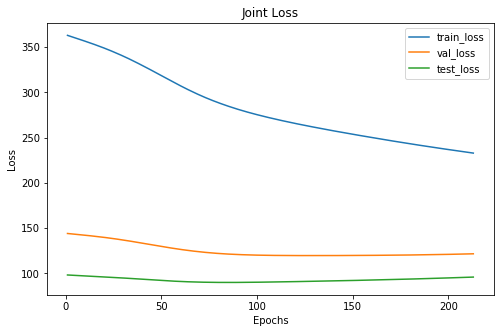

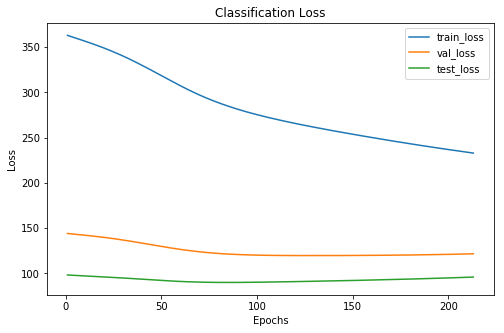

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     42      27
 1      130     52      40
 2       89     36      21
xxxxxxxxxxxxxx epoch: 213 xxxxxxxxxxxxxx


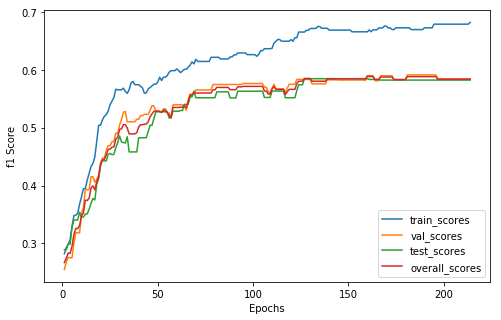

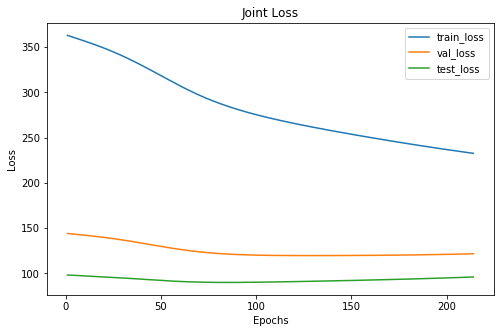

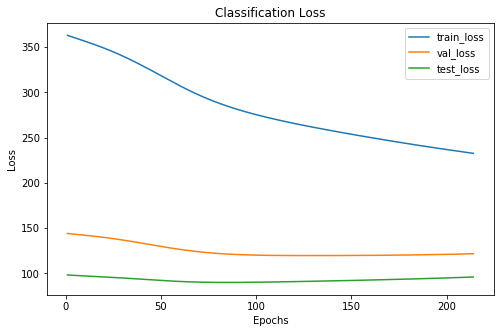

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     42      27
 1      130     52      40
 2       88     36      21
xxxxxxxxxxxxxx epoch: 214 xxxxxxxxxxxxxx


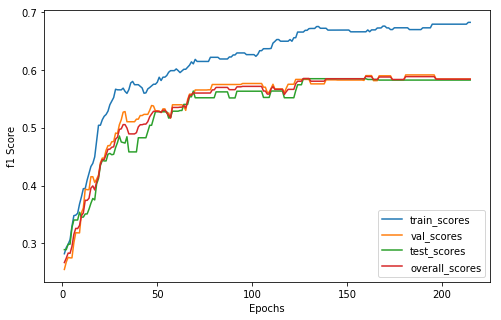

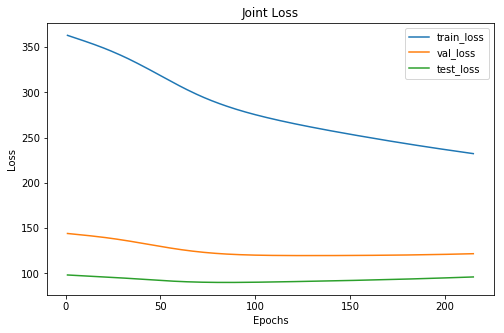

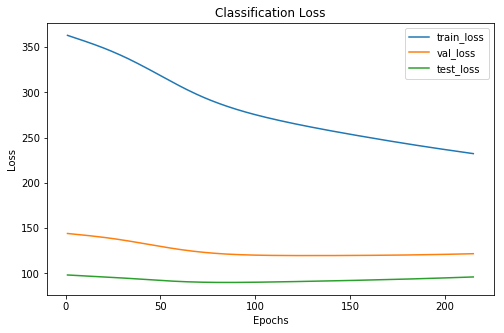

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 5   4  18
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     42      27
 1      130     52      40
 2       88     36      21
xxxxxxxxxxxxxx epoch: 215 xxxxxxxxxxxxxx


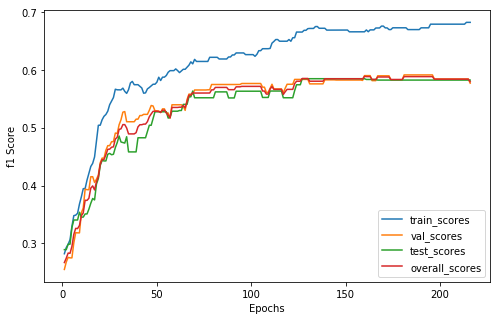

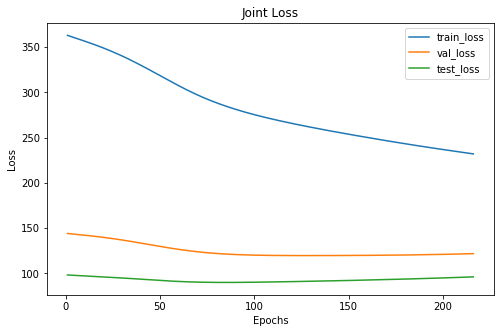

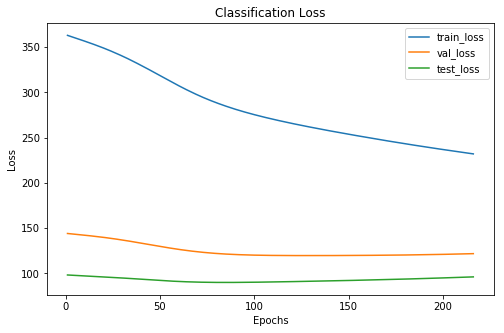

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     43      27
 1      130     52      40
 2       88     35      21
xxxxxxxxxxxxxx epoch: 216 xxxxxxxxxxxxxx


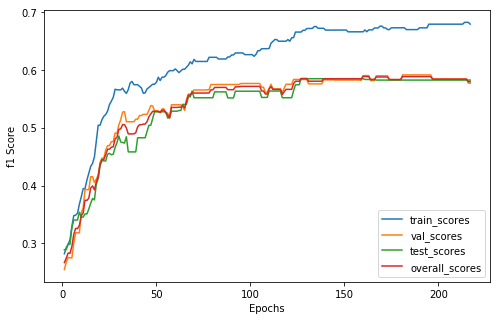

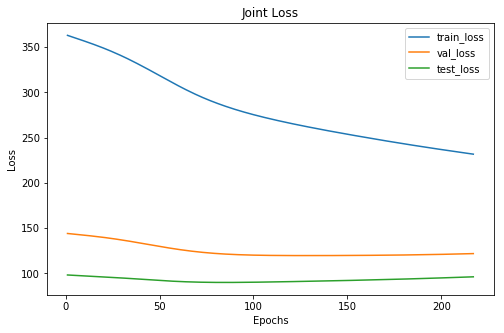

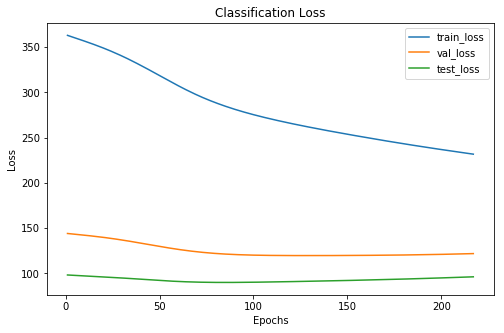

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     43      27
 1      129     52      40
 2       89     35      21
xxxxxxxxxxxxxx epoch: 217 xxxxxxxxxxxxxx


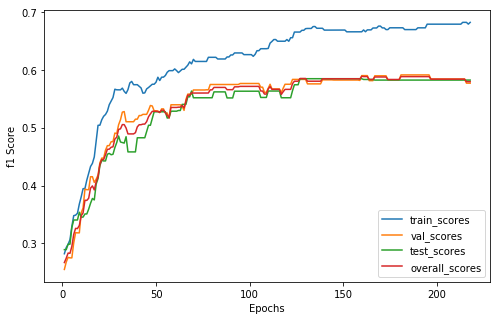

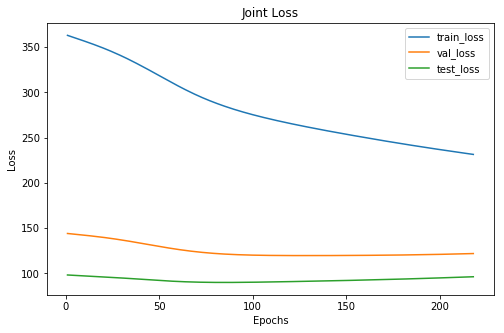

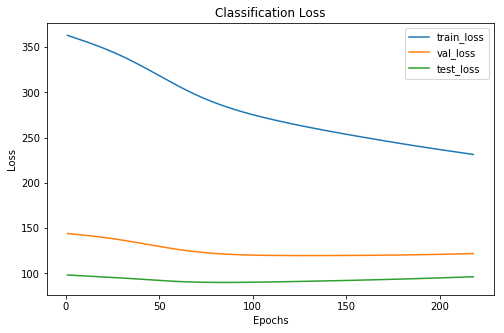

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     43      27
 1      128     52      40
 2       89     35      21
xxxxxxxxxxxxxx epoch: 218 xxxxxxxxxxxxxx


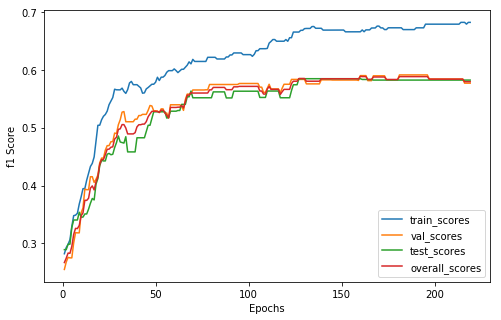

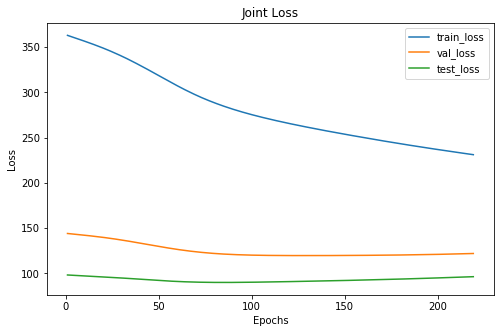

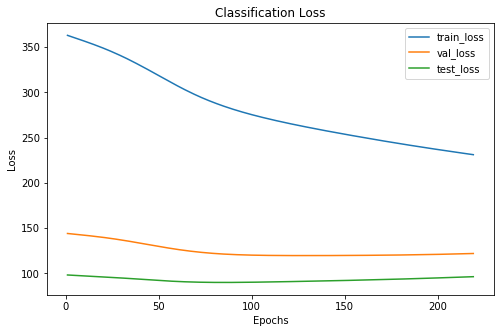

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     43      27
 1      128     52      40
 2       89     35      21
xxxxxxxxxxxxxx epoch: 219 xxxxxxxxxxxxxx


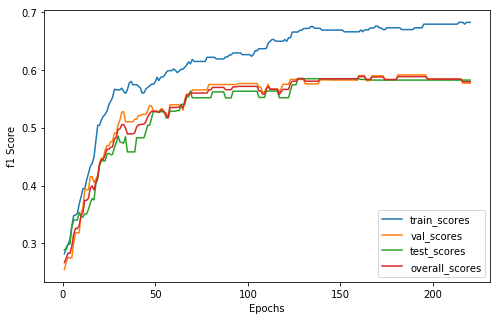

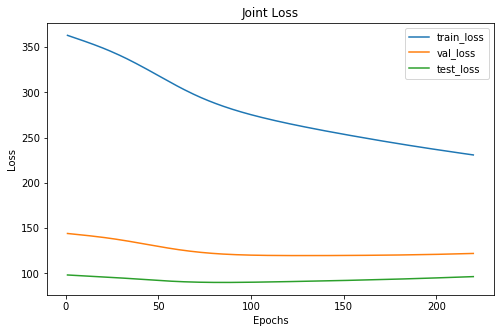

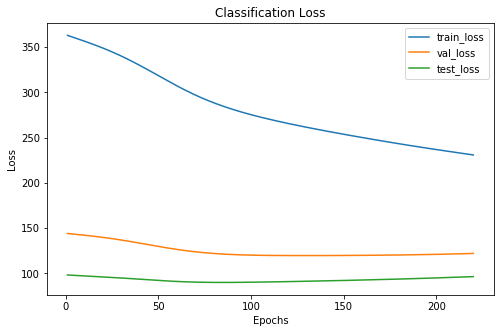

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     43      27
 1      128     52      40
 2       89     35      21
xxxxxxxxxxxxxx epoch: 220 xxxxxxxxxxxxxx


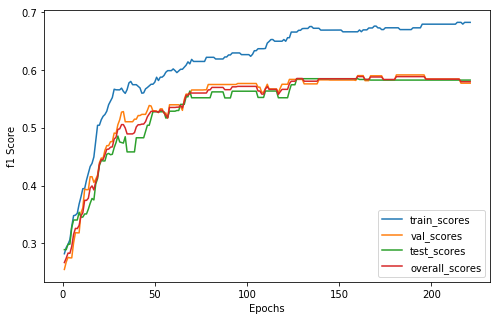

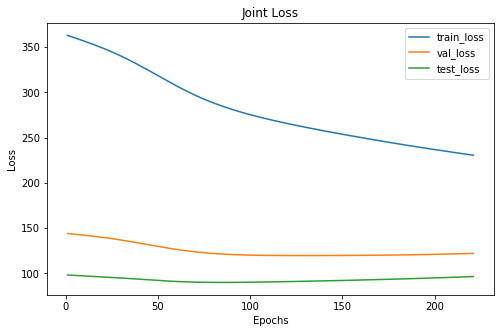

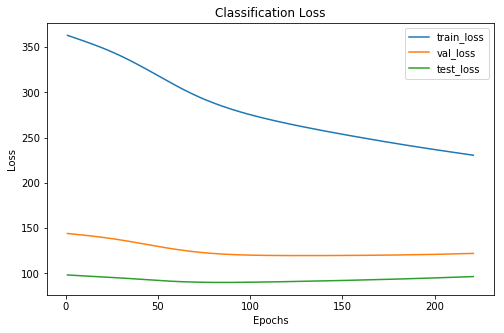

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     43      27
 1      128     52      40
 2       89     35      21
xxxxxxxxxxxxxx epoch: 221 xxxxxxxxxxxxxx


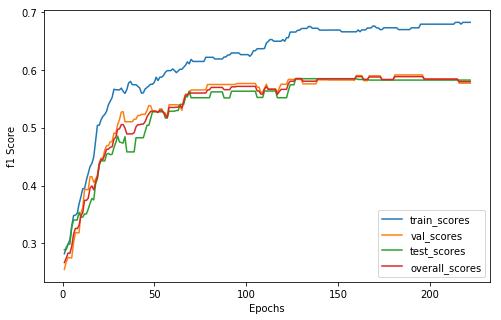

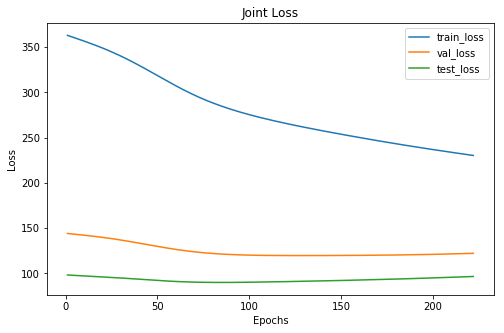

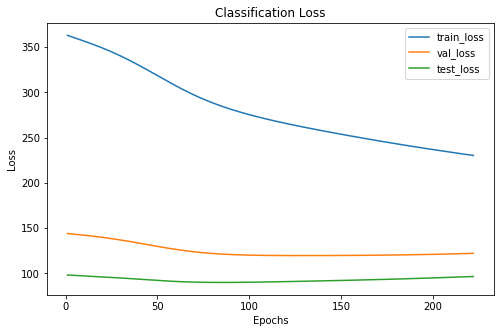

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     43      27
 1      128     52      40
 2       89     35      21
xxxxxxxxxxxxxx epoch: 222 xxxxxxxxxxxxxx


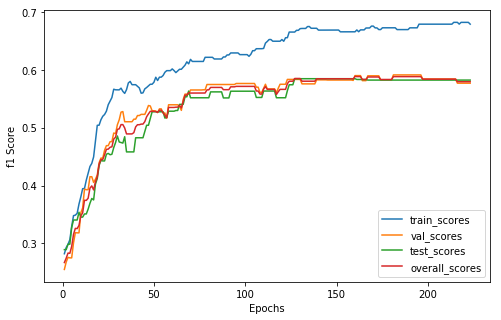

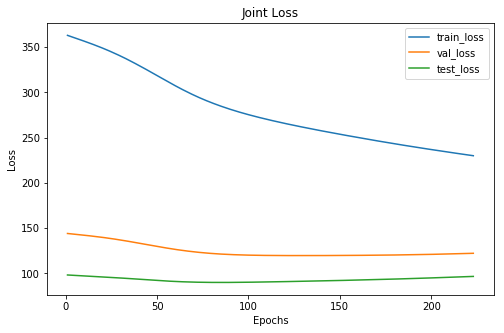

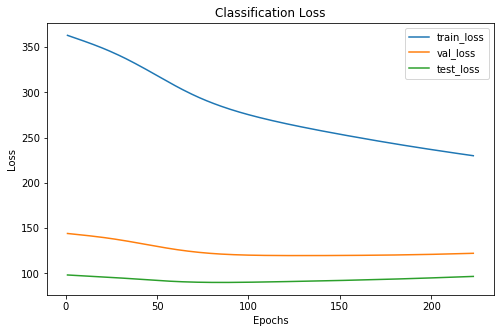

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     43      27
 1      128     52      40
 2       88     35      21
xxxxxxxxxxxxxx epoch: 223 xxxxxxxxxxxxxx


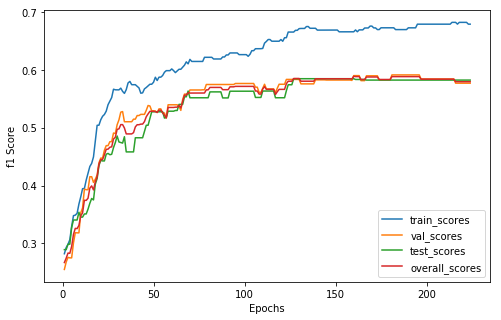

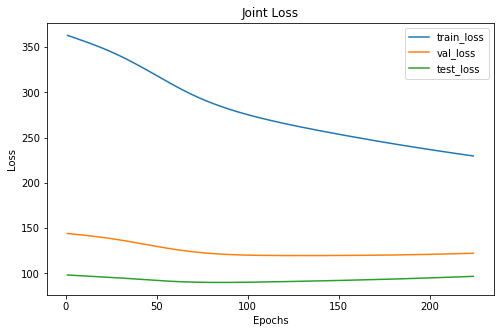

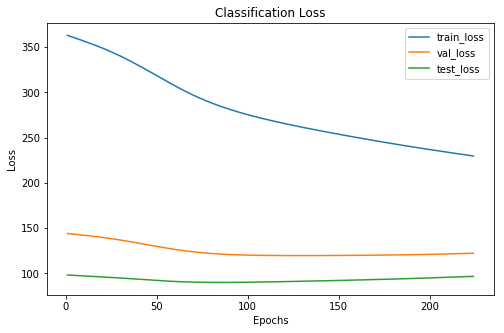

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     43      27
 1      128     52      40
 2       88     35      21
xxxxxxxxxxxxxx epoch: 224 xxxxxxxxxxxxxx


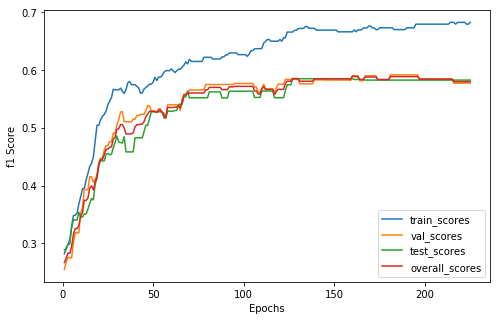

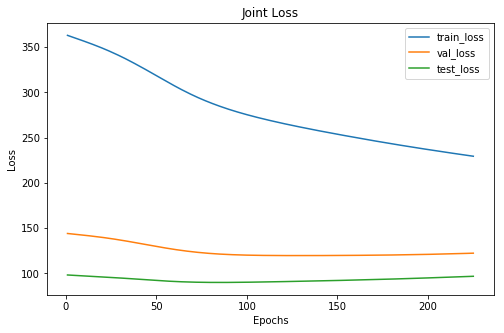

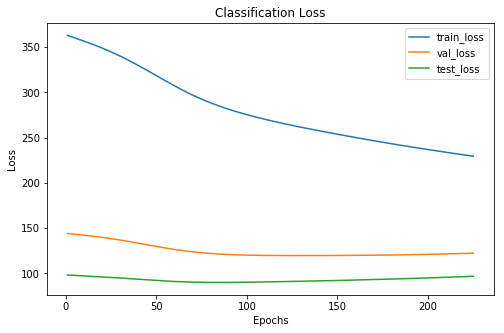

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     43      27
 1      128     52      40
 2       89     35      21
xxxxxxxxxxxxxx epoch: 225 xxxxxxxxxxxxxx


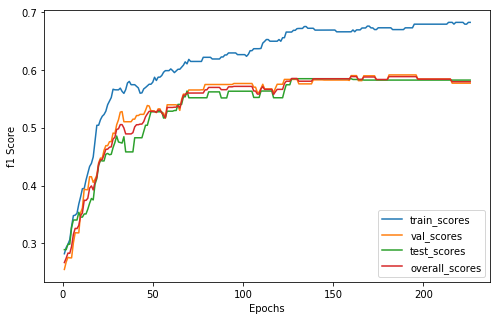

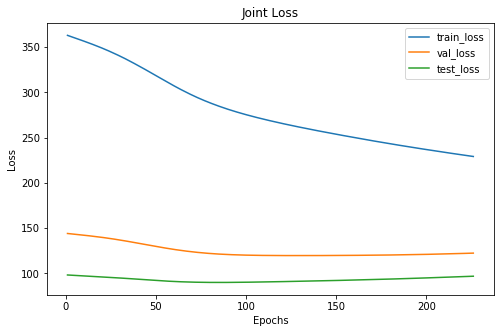

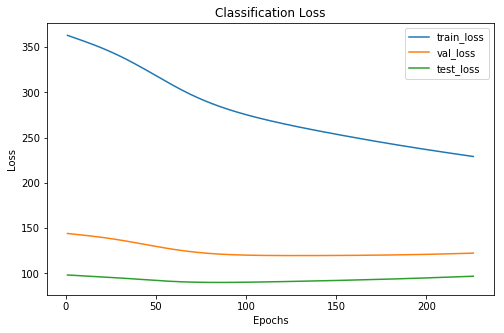

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     43      27
 1      128     52      40
 2       89     35      21
xxxxxxxxxxxxxx epoch: 226 xxxxxxxxxxxxxx


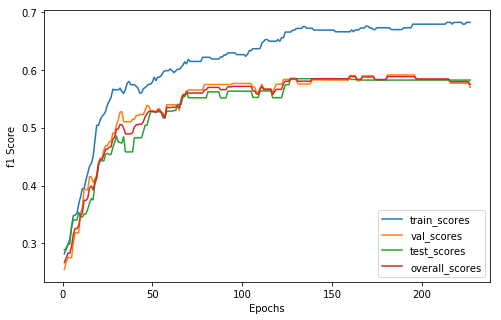

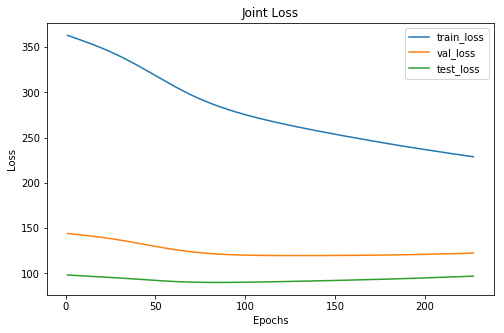

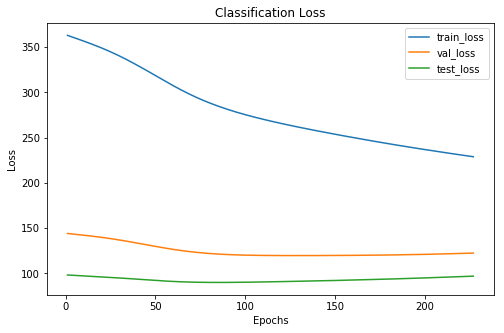

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     44      27
 1      128     52      40
 2       89     34      21
xxxxxxxxxxxxxx epoch: 227 xxxxxxxxxxxxxx


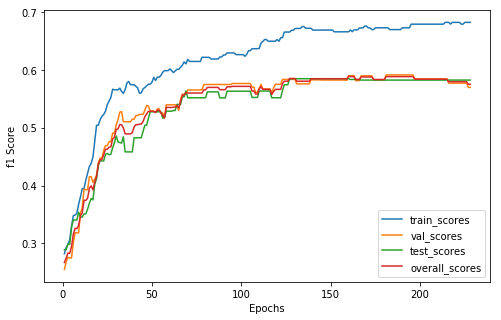

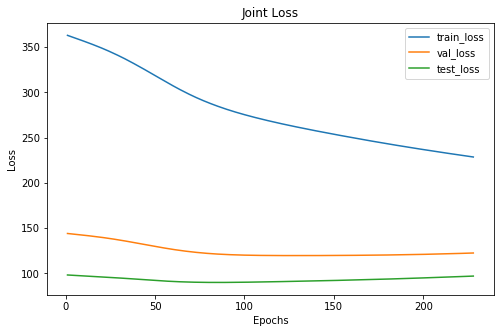

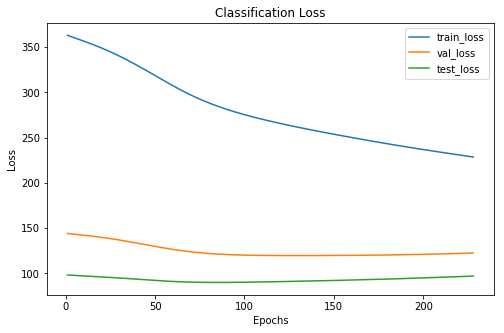

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     44      27
 1      128     52      40
 2       89     34      21
xxxxxxxxxxxxxx epoch: 228 xxxxxxxxxxxxxx


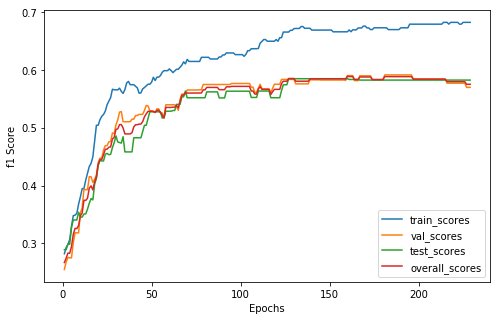

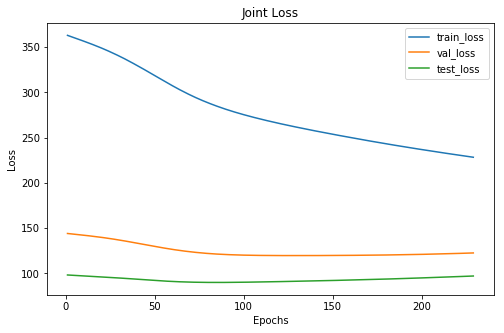

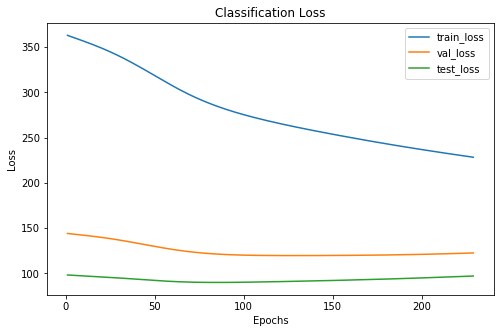

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     44      27
 1      128     52      40
 2       89     34      21
xxxxxxxxxxxxxx epoch: 229 xxxxxxxxxxxxxx


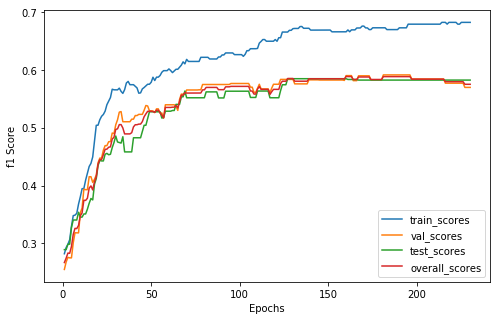

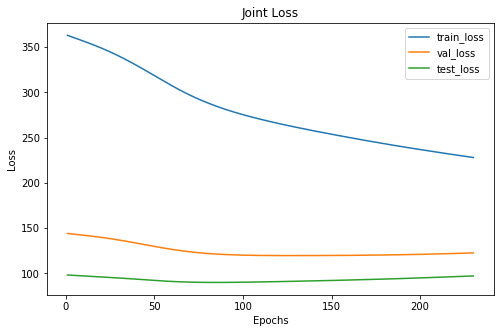

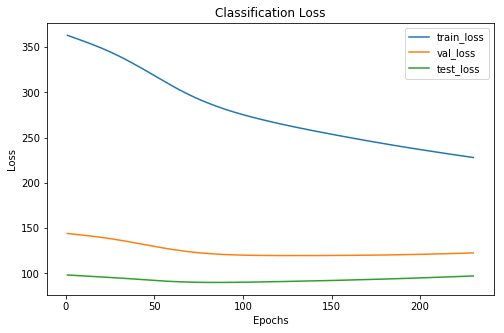

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     44      27
 1      128     52      40
 2       89     34      21
xxxxxxxxxxxxxx epoch: 230 xxxxxxxxxxxxxx


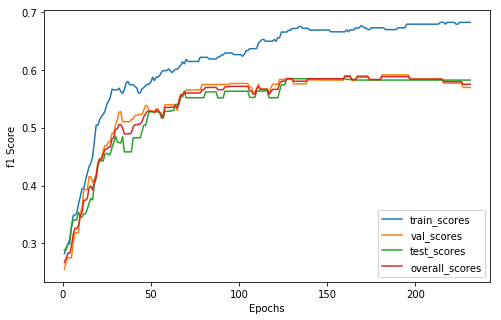

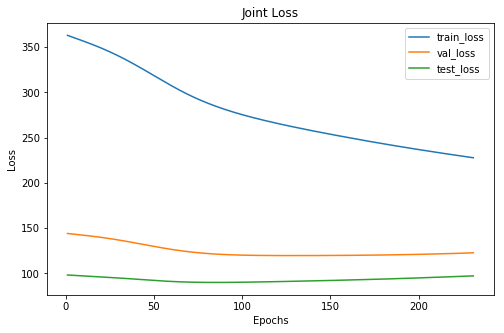

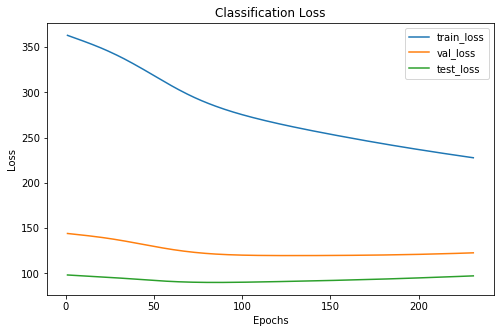

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     44      27
 1      128     52      40
 2       89     34      21
xxxxxxxxxxxxxx epoch: 231 xxxxxxxxxxxxxx


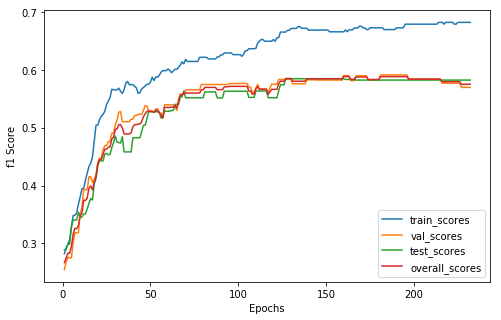

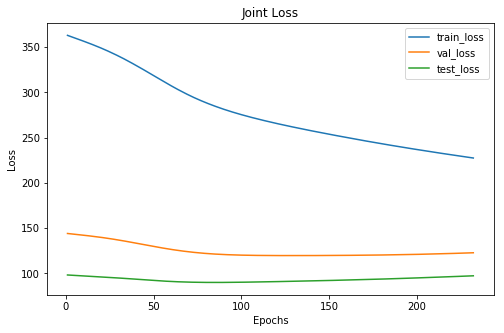

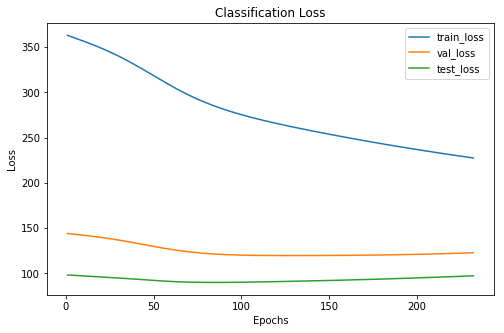

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     44      27
 1      128     52      40
 2       89     34      21
xxxxxxxxxxxxxx epoch: 232 xxxxxxxxxxxxxx


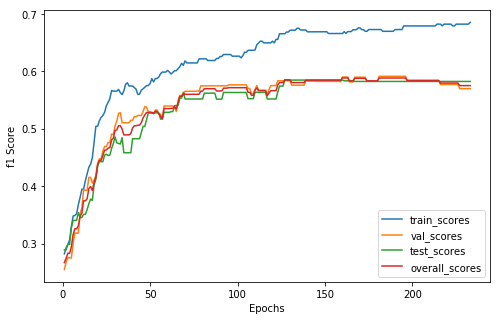

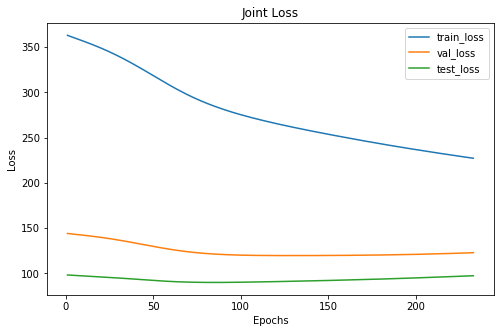

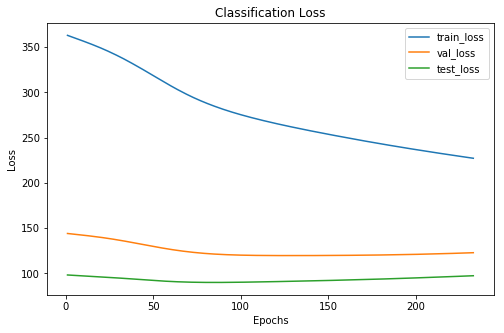

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     44      27
 1      128     52      40
 2       88     34      21
xxxxxxxxxxxxxx epoch: 233 xxxxxxxxxxxxxx


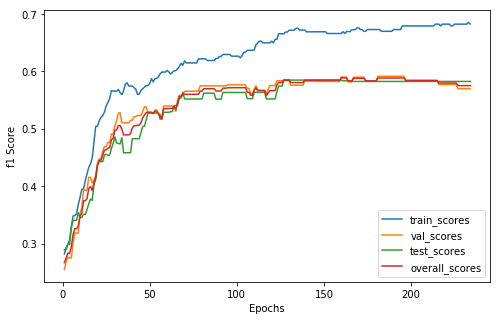

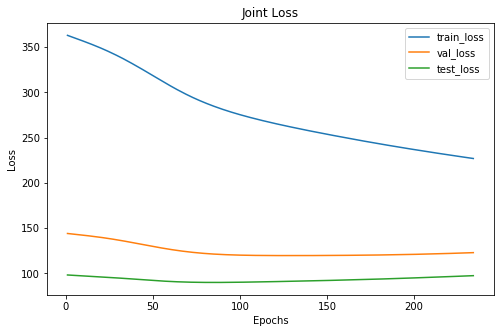

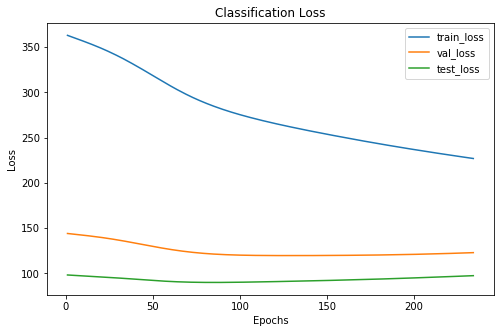

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     44      27
 1      127     52      40
 2       88     34      21
xxxxxxxxxxxxxx epoch: 234 xxxxxxxxxxxxxx


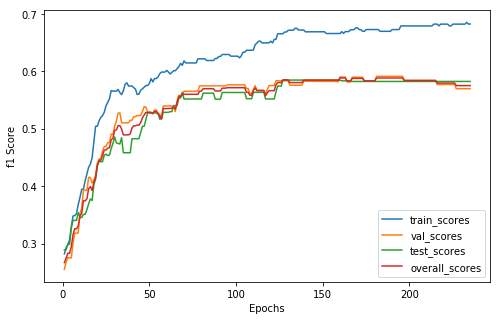

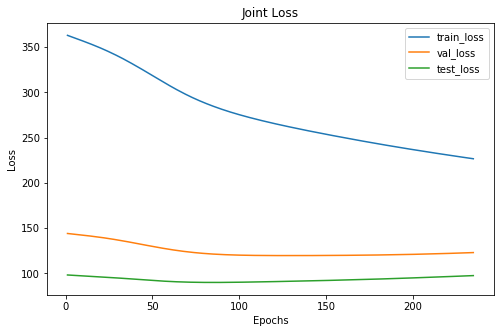

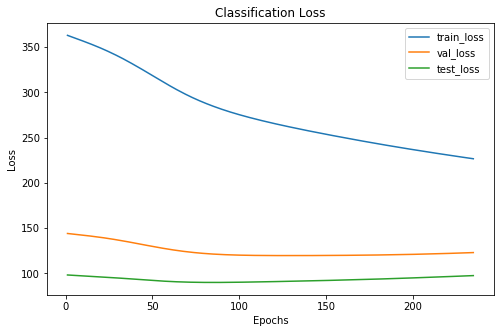

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     44      27
 1      127     52      40
 2       88     34      21
xxxxxxxxxxxxxx epoch: 235 xxxxxxxxxxxxxx


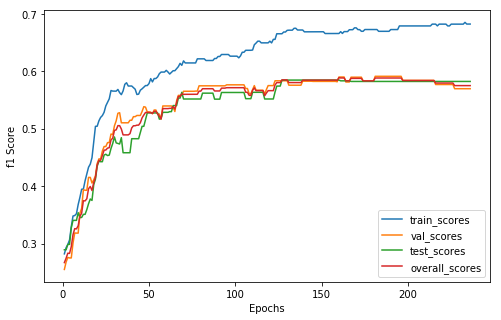

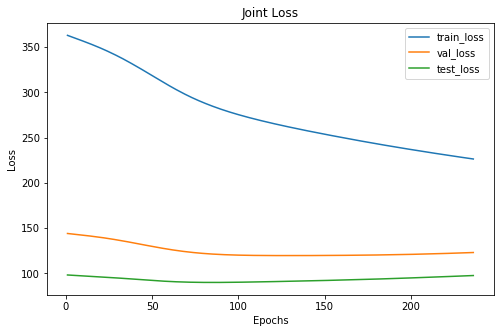

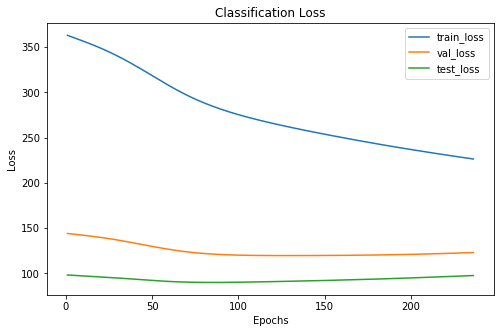

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     44      27
 1      127     52      40
 2       88     34      21
xxxxxxxxxxxxxx epoch: 236 xxxxxxxxxxxxxx


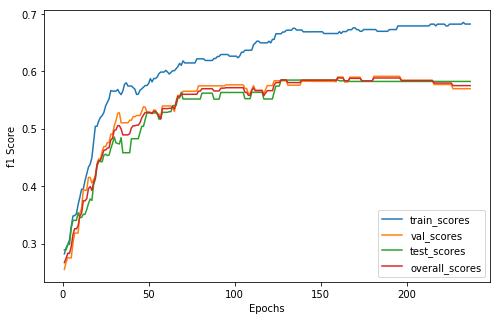

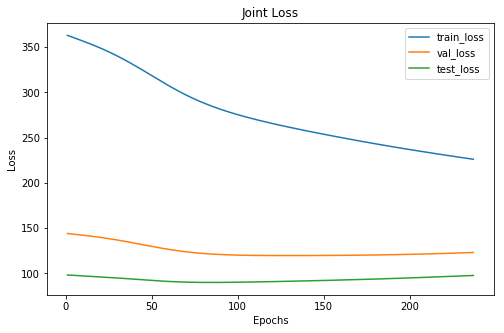

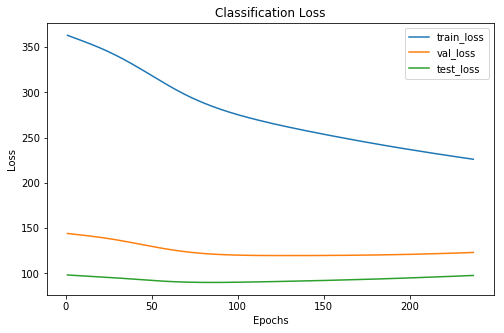

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     44      27
 1      127     52      40
 2       88     34      21
xxxxxxxxxxxxxx epoch: 237 xxxxxxxxxxxxxx


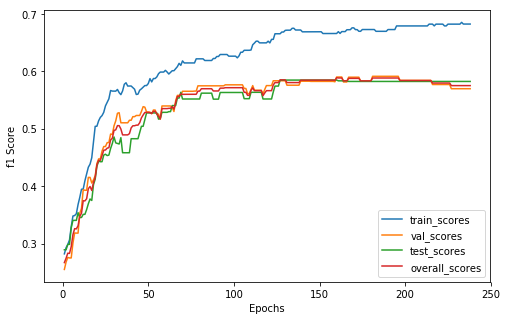

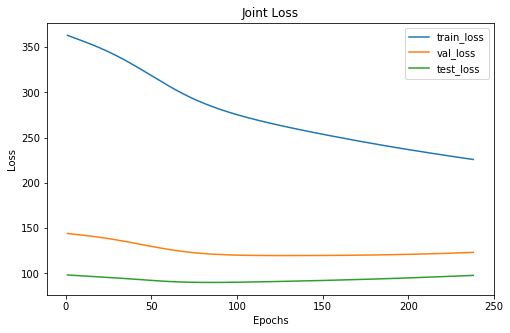

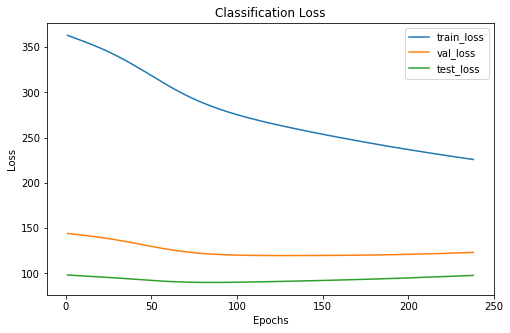

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     44      27
 1      127     52      40
 2       88     34      21
xxxxxxxxxxxxxx epoch: 238 xxxxxxxxxxxxxx


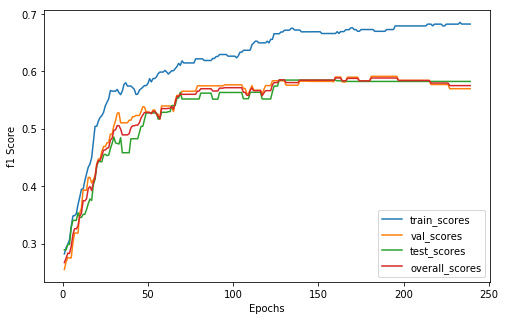

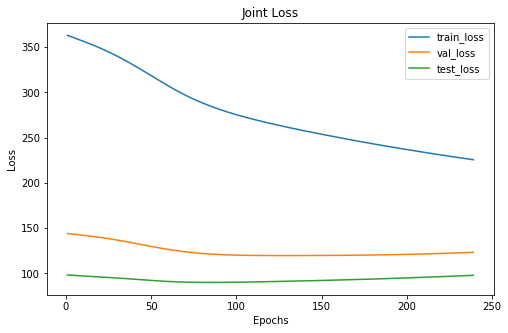

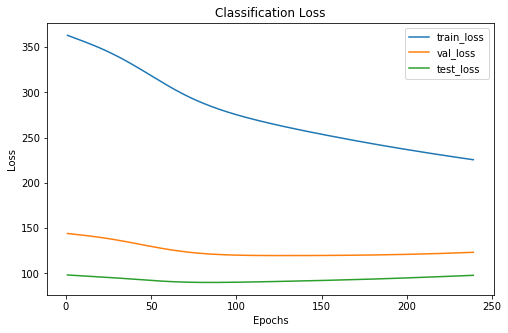

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     44      27
 1      127     52      40
 2       88     34      21
xxxxxxxxxxxxxx epoch: 239 xxxxxxxxxxxxxx


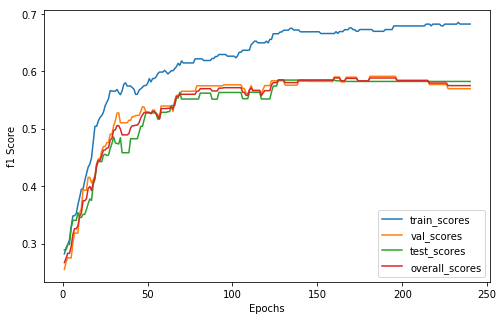

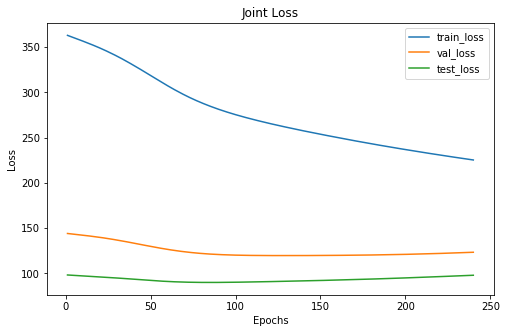

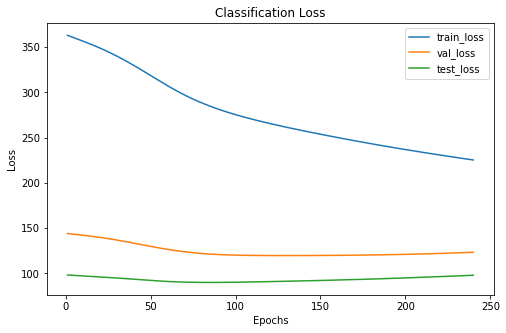

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     44      27
 1      127     52      40
 2       88     34      21
xxxxxxxxxxxxxx epoch: 240 xxxxxxxxxxxxxx


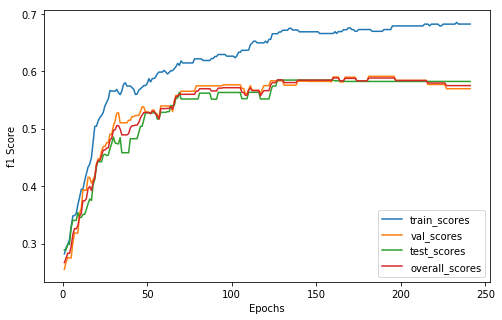

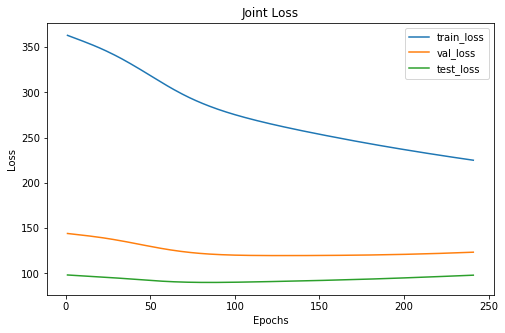

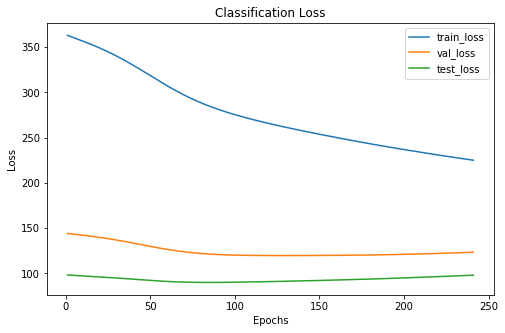

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     44      27
 1      127     52      40
 2       88     34      21
xxxxxxxxxxxxxx epoch: 241 xxxxxxxxxxxxxx


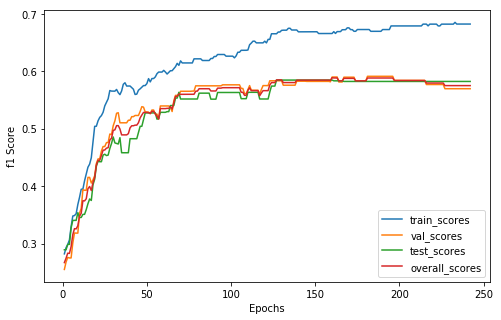

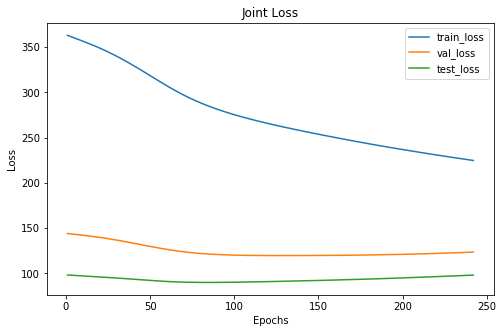

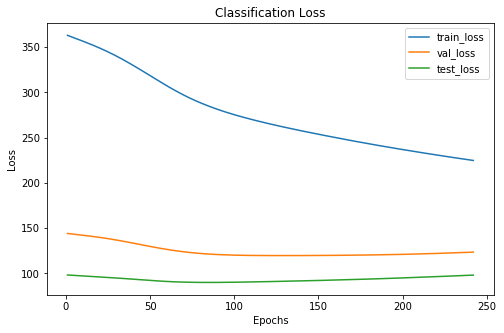

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     44      27
 1      127     52      40
 2       88     34      21
xxxxxxxxxxxxxx epoch: 242 xxxxxxxxxxxxxx


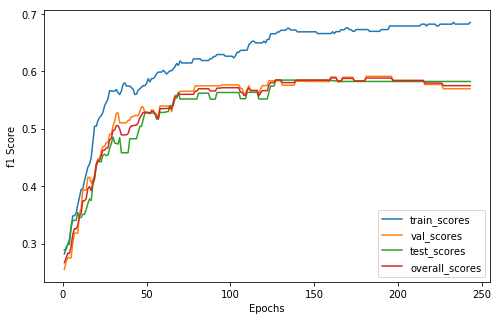

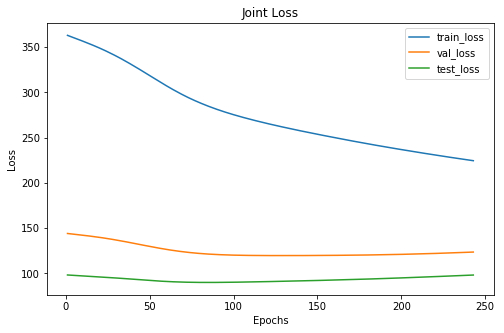

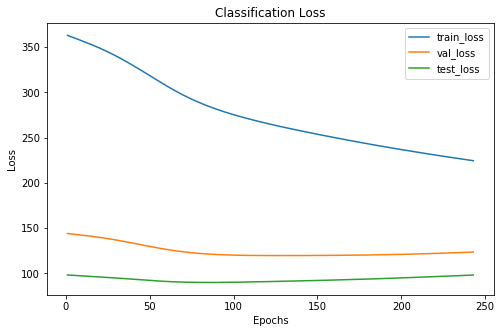

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  31   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      27
 1      126     52      40
 2       88     34      21
xxxxxxxxxxxxxx epoch: 243 xxxxxxxxxxxxxx


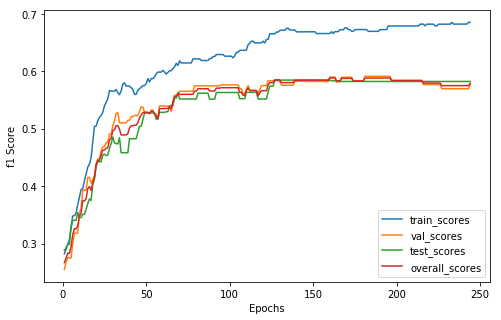

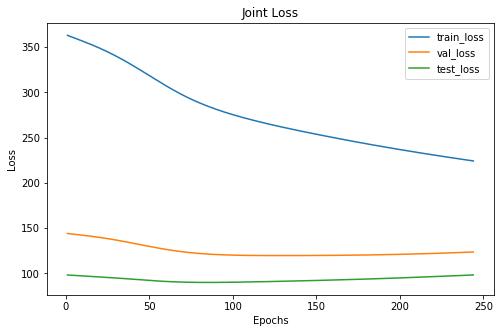

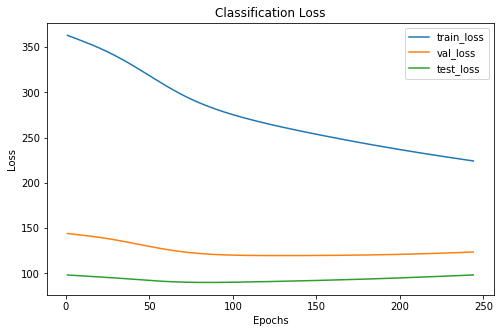

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      27
 1      126     53      40
 2       88     33      21
xxxxxxxxxxxxxx epoch: 244 xxxxxxxxxxxxxx


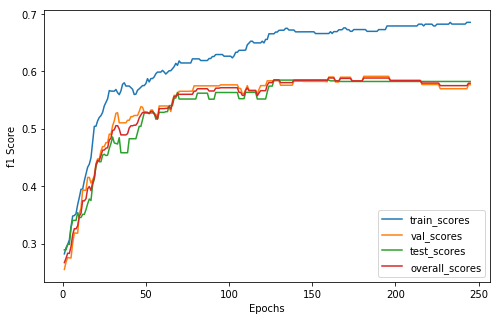

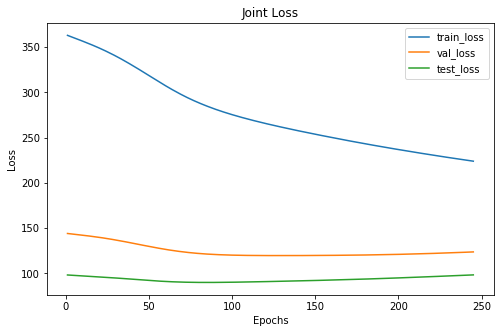

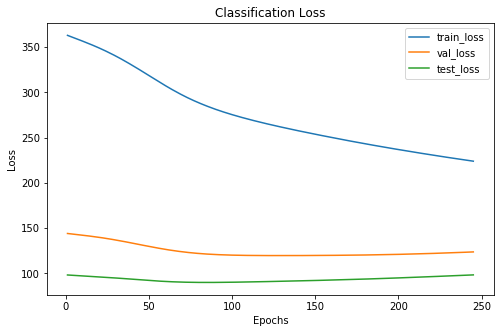

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      27
 1      126     53      40
 2       88     33      21
xxxxxxxxxxxxxx epoch: 245 xxxxxxxxxxxxxx


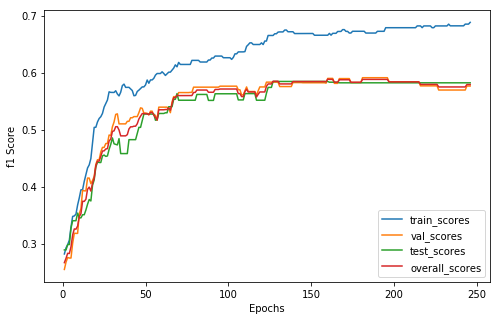

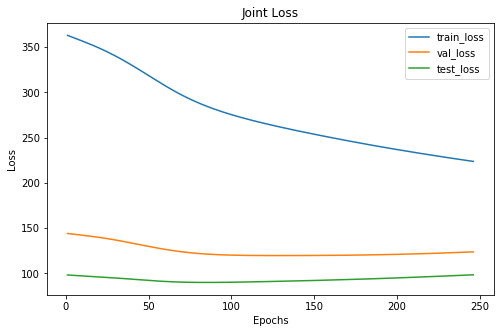

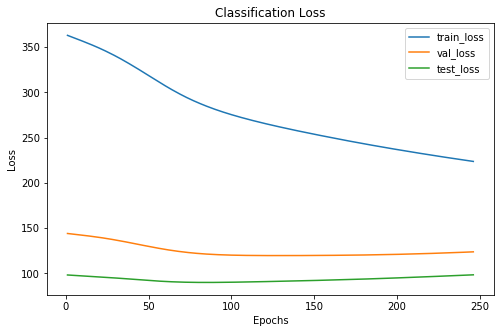

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      27
 1      127     53      40
 2       87     33      21
xxxxxxxxxxxxxx epoch: 246 xxxxxxxxxxxxxx


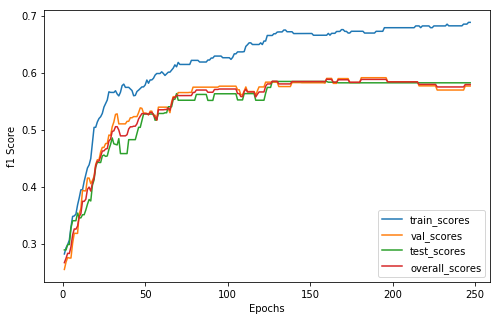

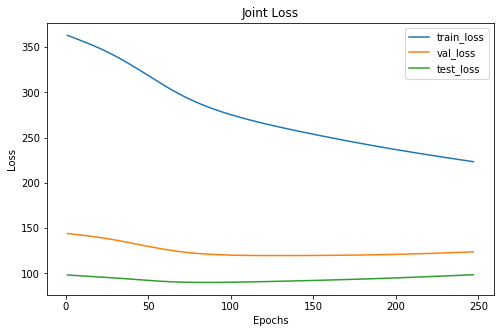

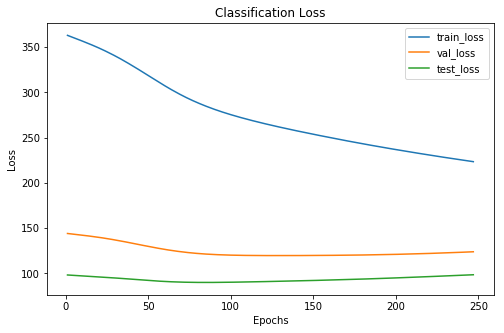

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      27
 1      127     53      40
 2       87     33      21
xxxxxxxxxxxxxx epoch: 247 xxxxxxxxxxxxxx


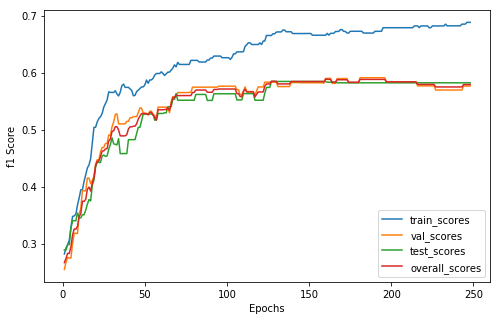

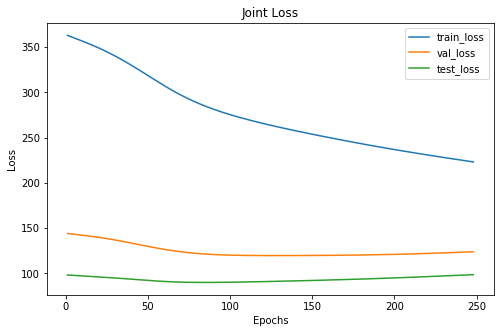

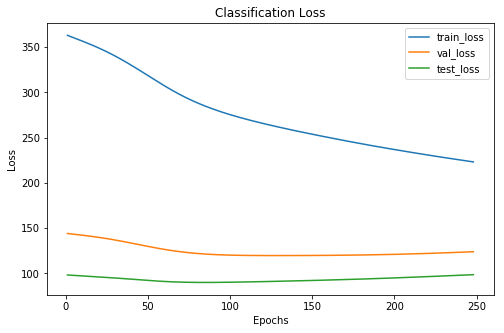

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      27
 1      127     53      40
 2       87     33      21
xxxxxxxxxxxxxx epoch: 248 xxxxxxxxxxxxxx


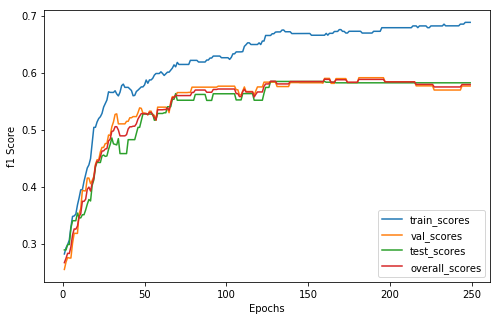

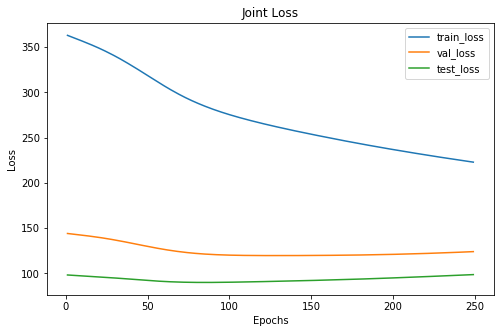

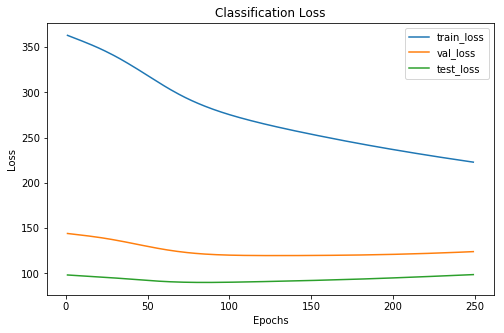

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      27
 1      127     53      40
 2       87     33      21
xxxxxxxxxxxxxx epoch: 249 xxxxxxxxxxxxxx


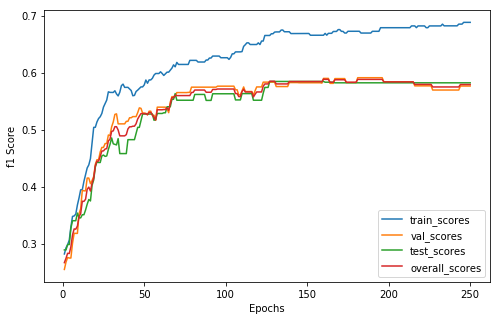

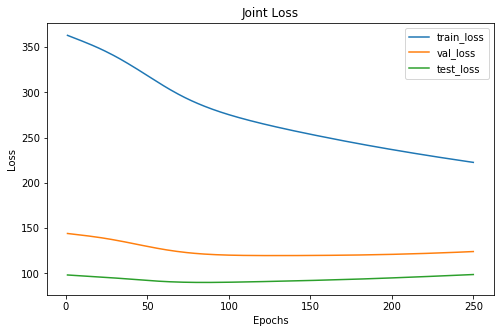

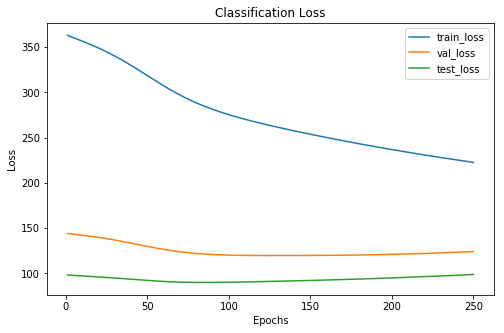

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      27
 1      127     53      40
 2       87     33      21
xxxxxxxxxxxxxx epoch: 250 xxxxxxxxxxxxxx


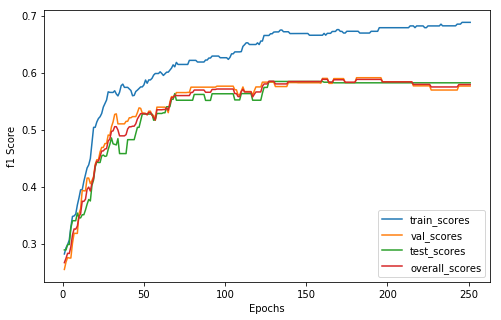

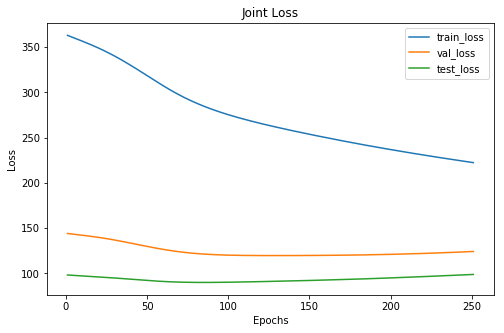

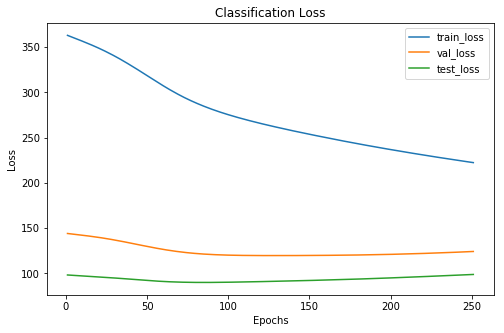

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      27
 1      127     53      40
 2       87     33      21
xxxxxxxxxxxxxx epoch: 251 xxxxxxxxxxxxxx


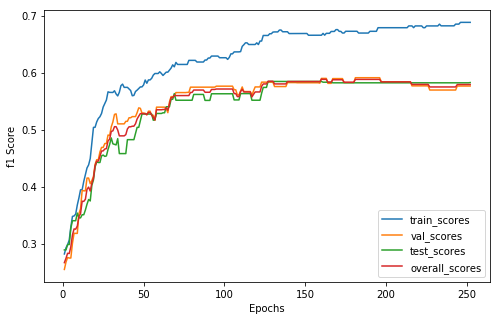

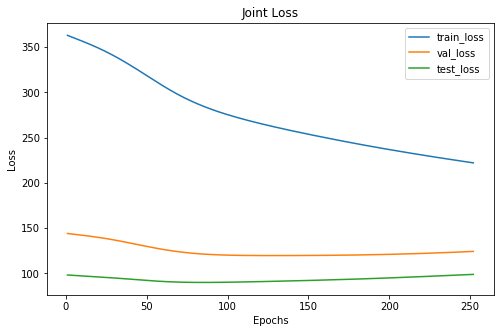

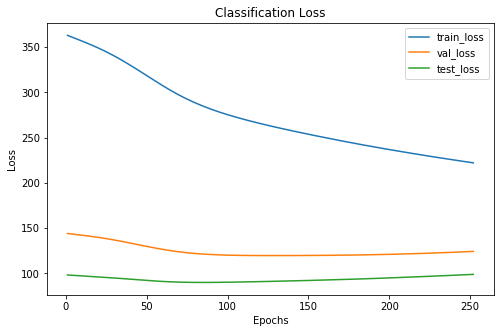

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      28
 1      127     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 252 xxxxxxxxxxxxxx


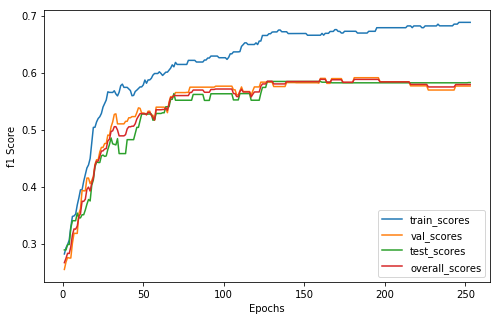

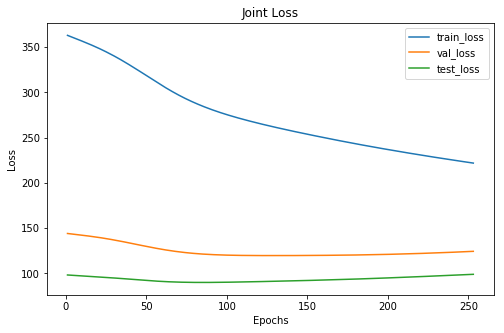

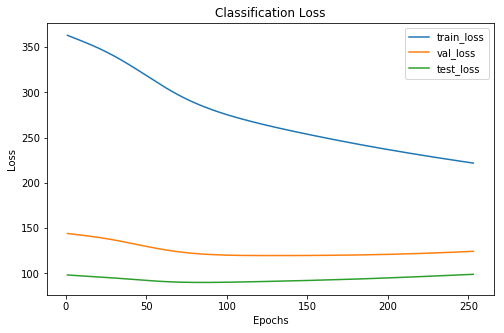

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      28
 1      127     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 253 xxxxxxxxxxxxxx


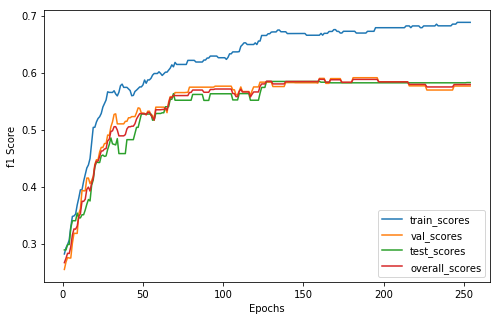

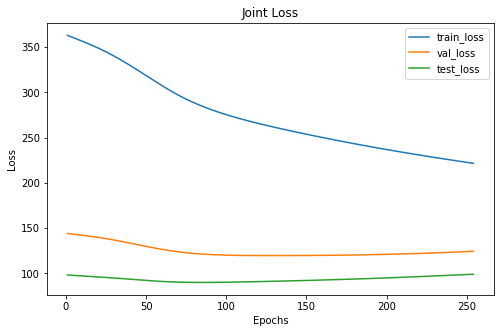

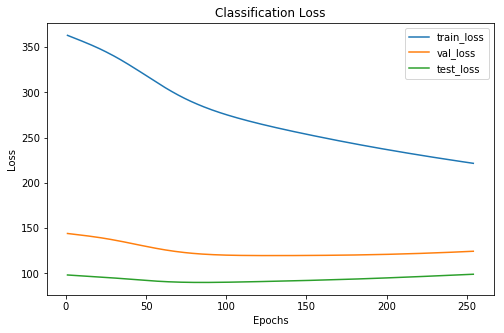

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      28
 1      127     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 254 xxxxxxxxxxxxxx


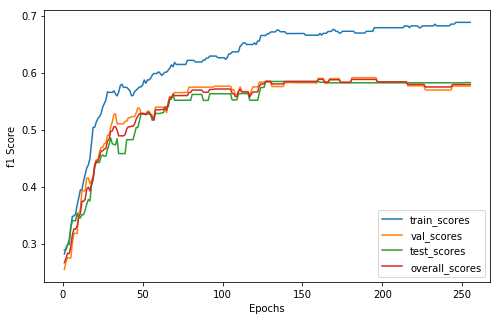

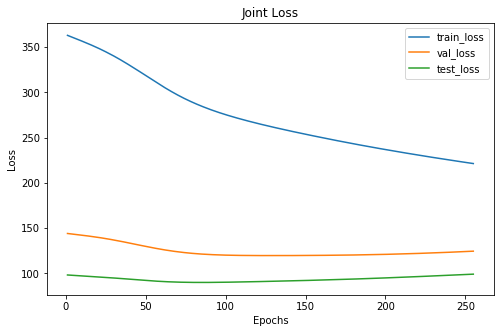

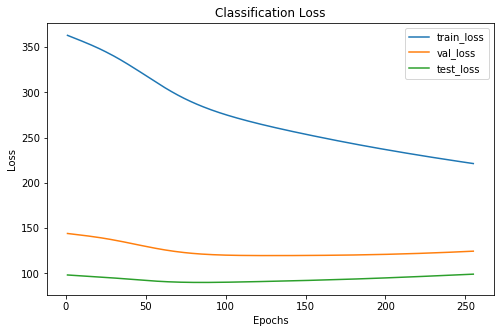

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      28
 1      127     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 255 xxxxxxxxxxxxxx


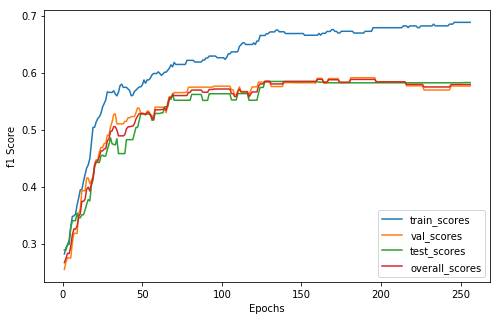

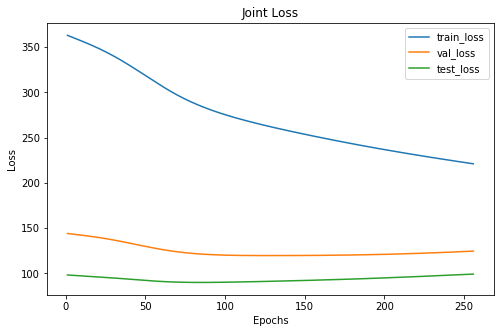

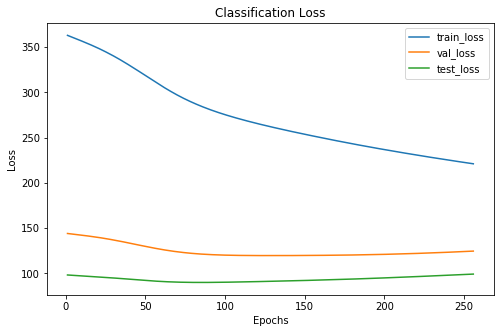

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      28
 1      127     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 256 xxxxxxxxxxxxxx


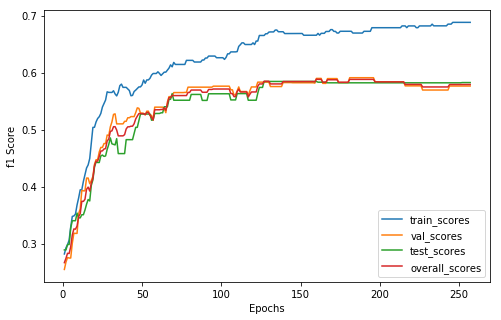

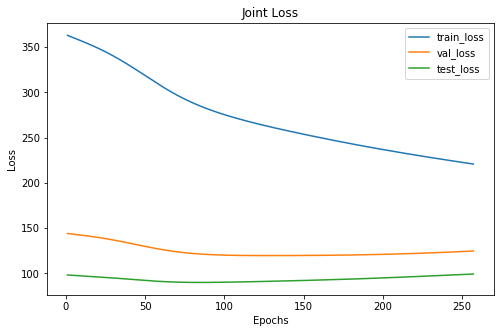

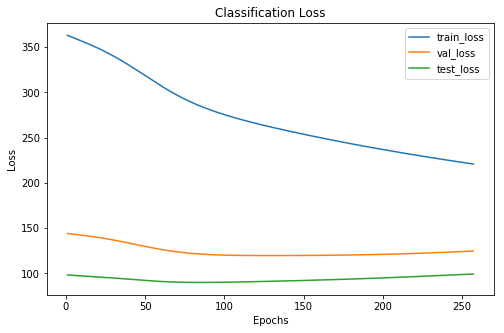

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      28
 1      127     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 257 xxxxxxxxxxxxxx


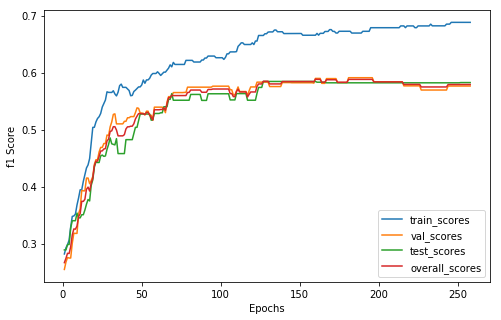

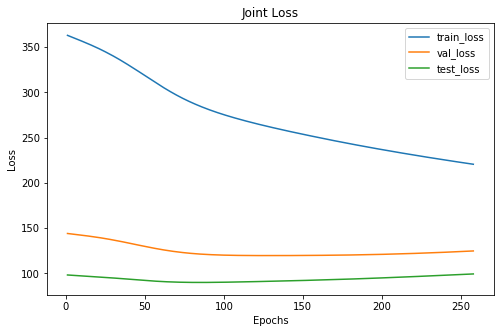

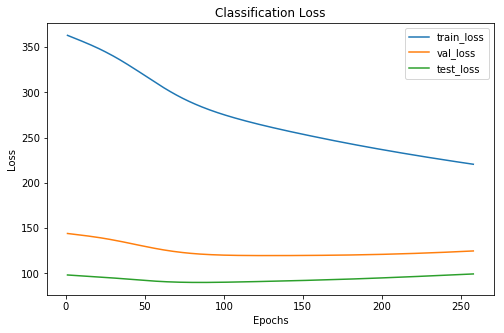

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      28
 1      127     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 258 xxxxxxxxxxxxxx


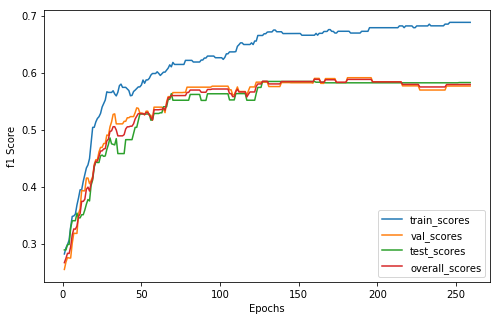

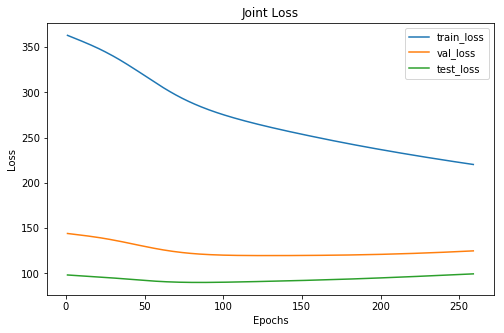

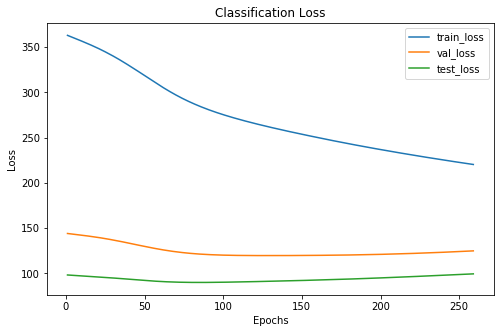

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      28
 1      127     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 259 xxxxxxxxxxxxxx


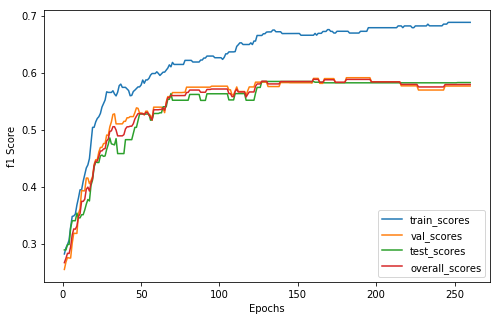

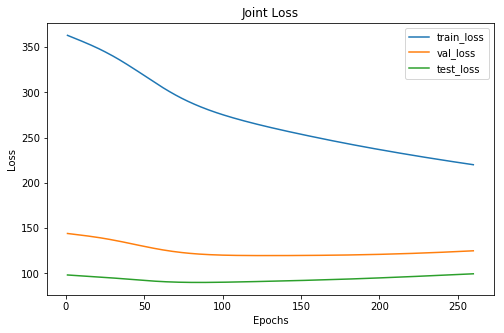

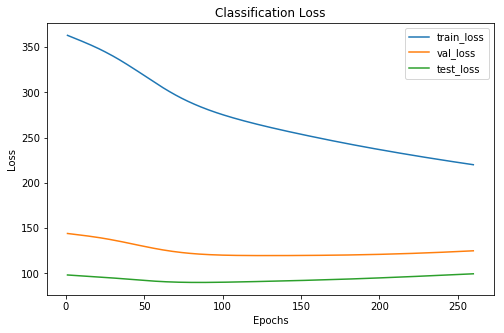

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      28
 1      127     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 260 xxxxxxxxxxxxxx


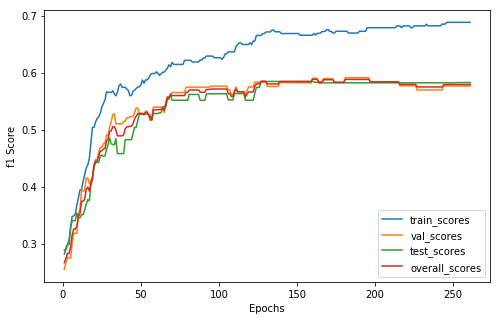

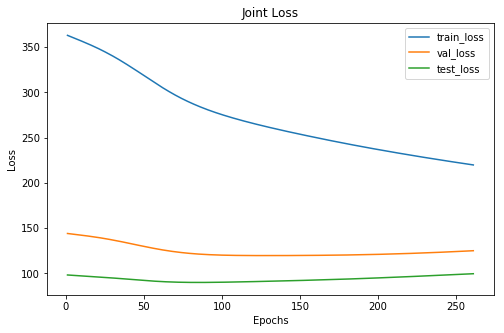

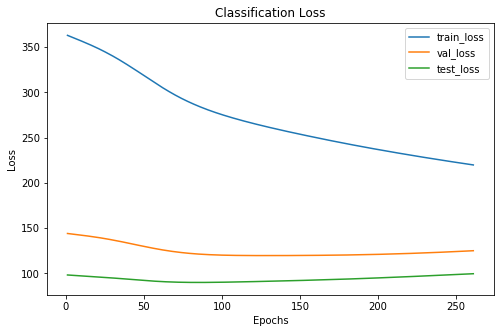

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      28
 1      127     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 261 xxxxxxxxxxxxxx


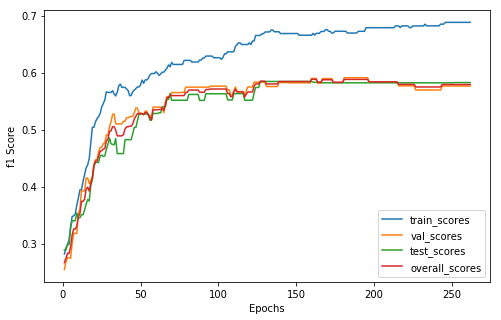

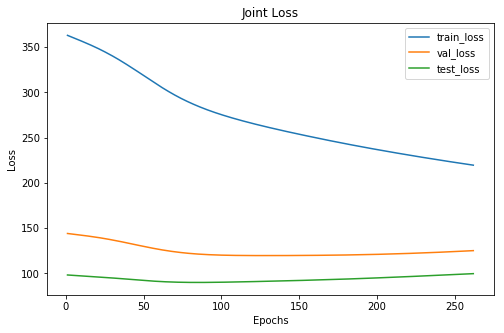

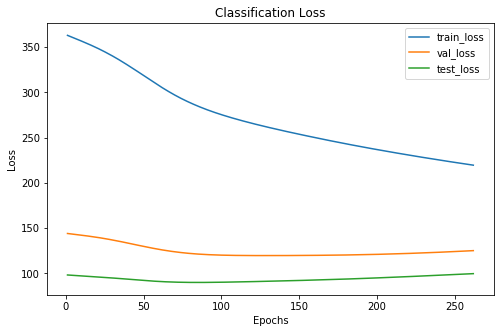

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      28
 1      127     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 262 xxxxxxxxxxxxxx


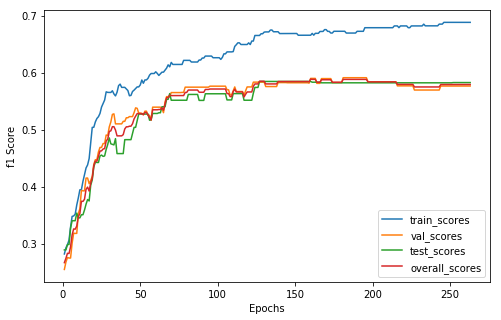

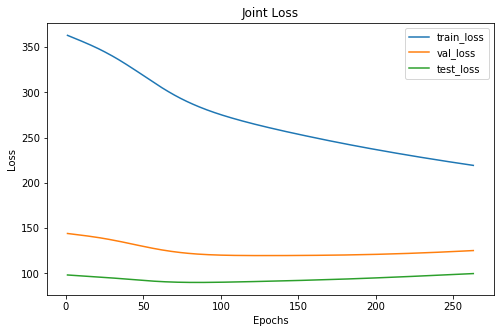

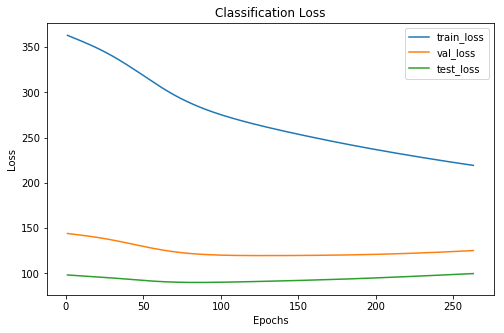

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      28
 1      127     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 263 xxxxxxxxxxxxxx


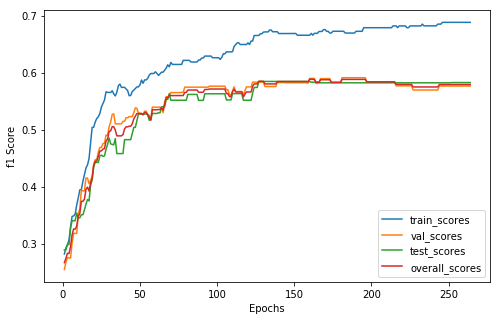

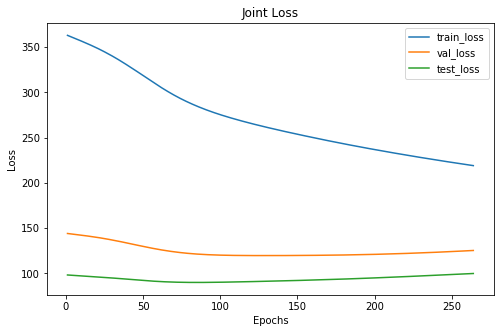

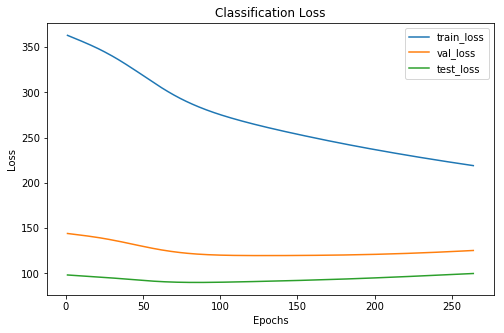

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     44      28
 1      127     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 264 xxxxxxxxxxxxxx


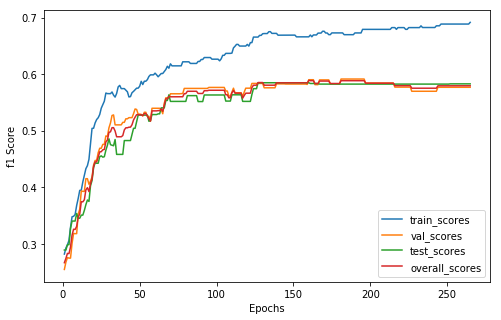

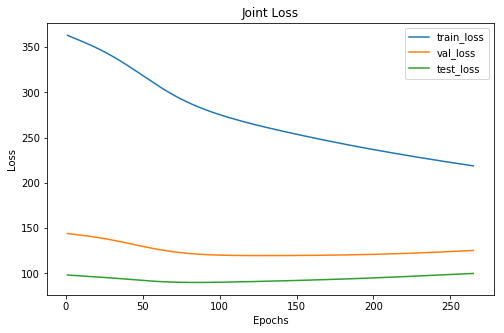

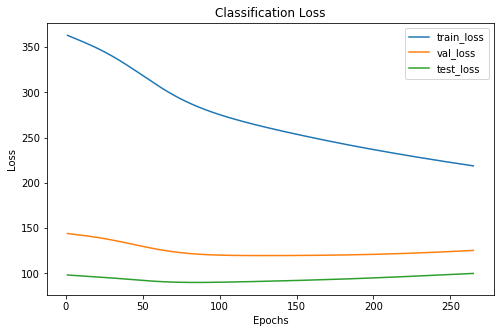

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     44      28
 1      126     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 265 xxxxxxxxxxxxxx


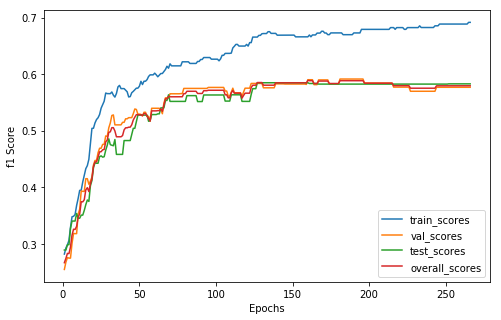

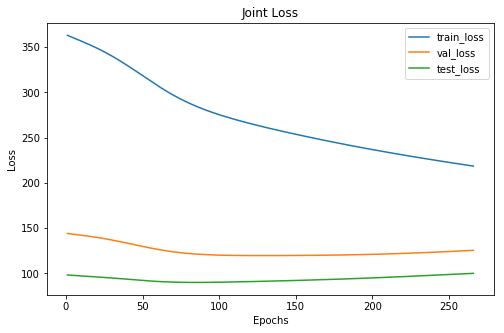

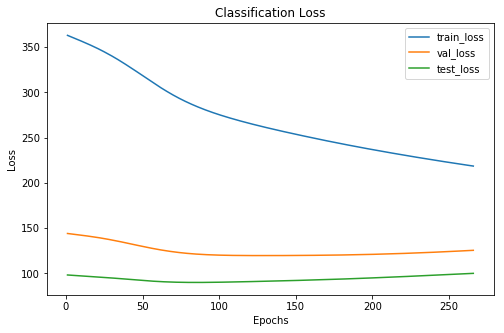

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     44      28
 1      126     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 266 xxxxxxxxxxxxxx


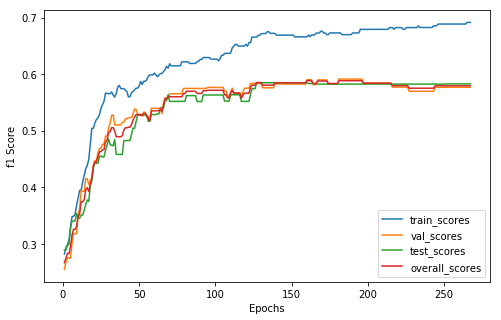

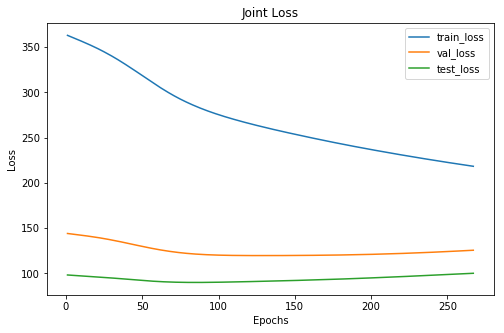

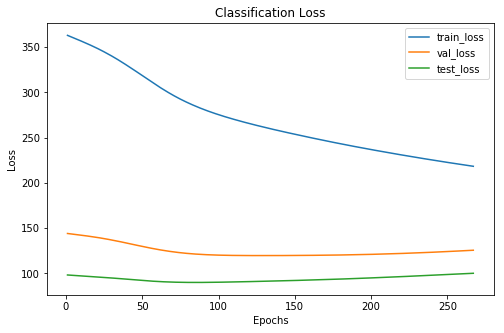

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
10  32   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     44      28
 1      126     53      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 267 xxxxxxxxxxxxxx


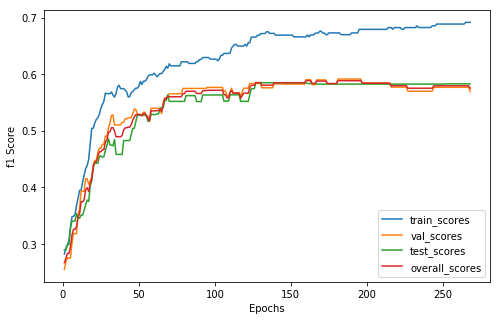

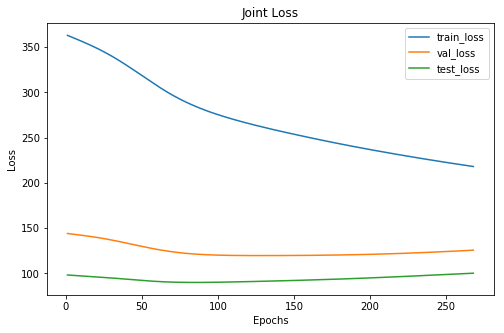

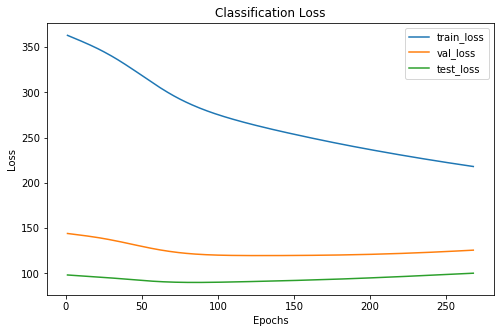

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  31   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     52      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 268 xxxxxxxxxxxxxx


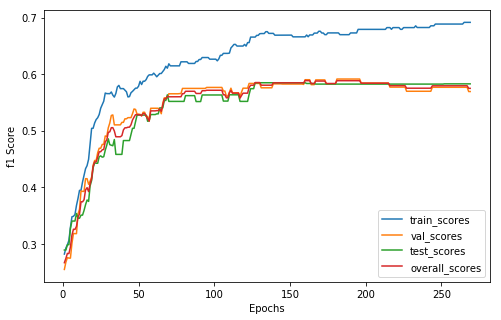

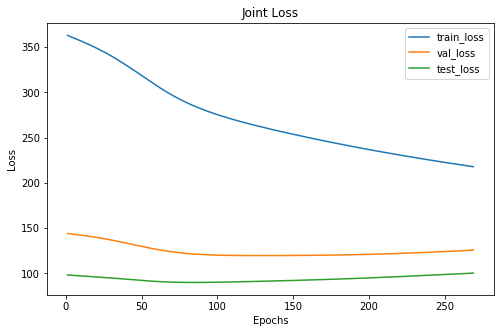

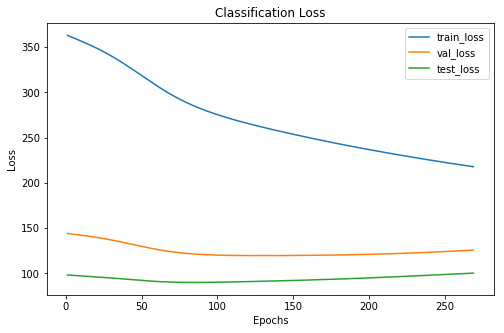

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  31   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     52      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 269 xxxxxxxxxxxxxx


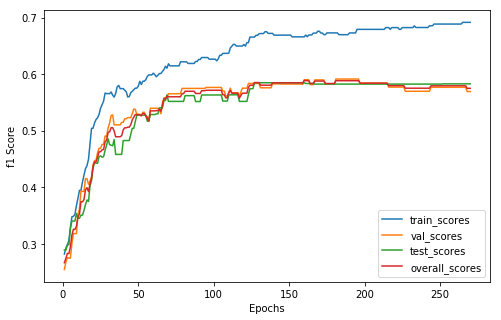

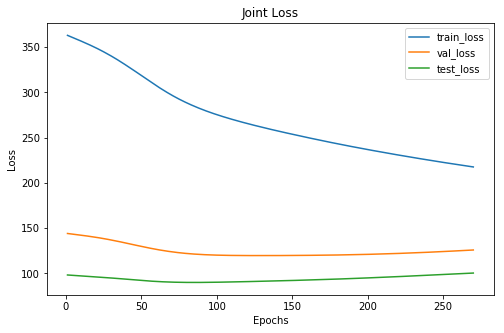

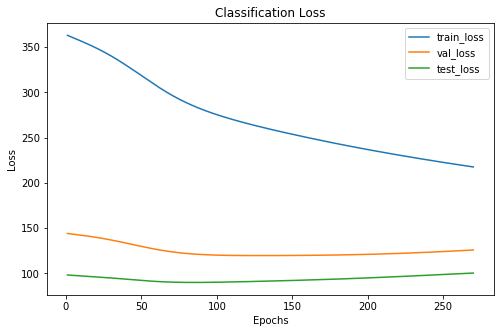

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  31   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     52      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 270 xxxxxxxxxxxxxx


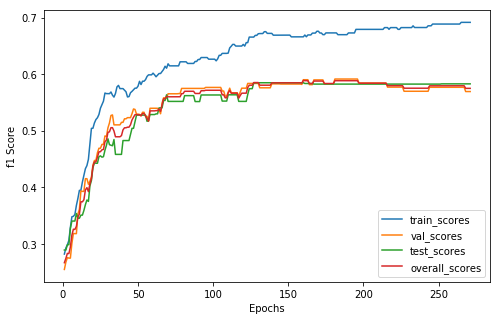

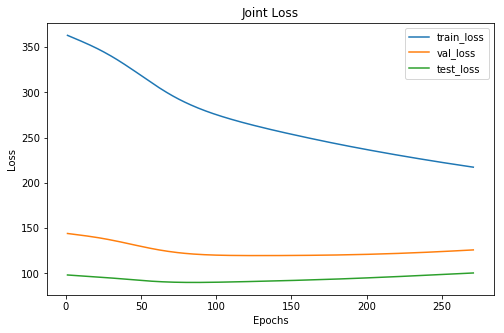

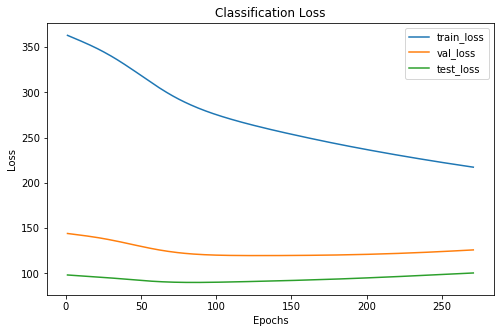

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  31   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     52      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 271 xxxxxxxxxxxxxx


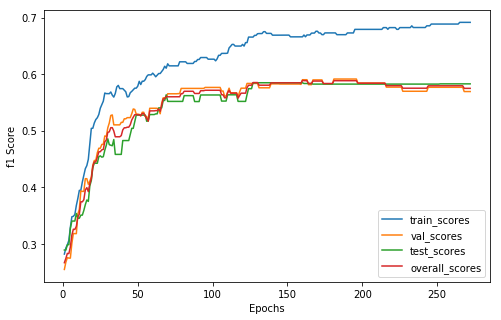

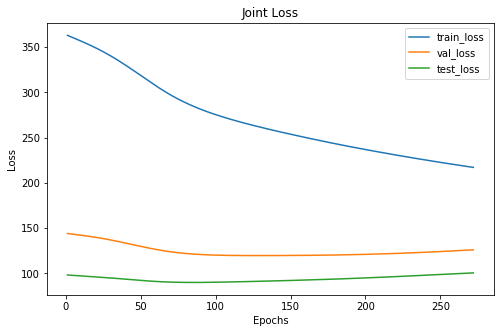

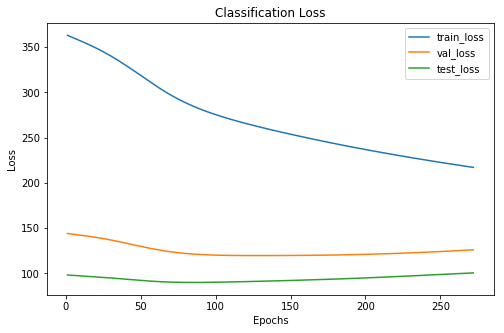

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  31   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     52      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 272 xxxxxxxxxxxxxx


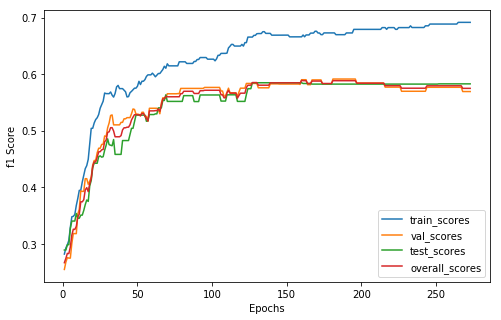

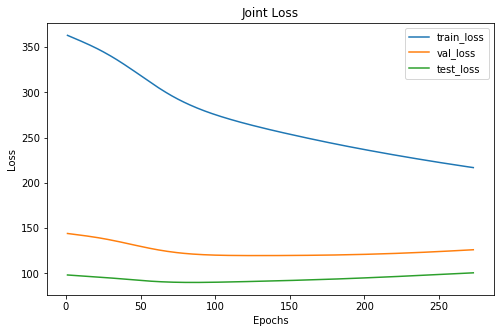

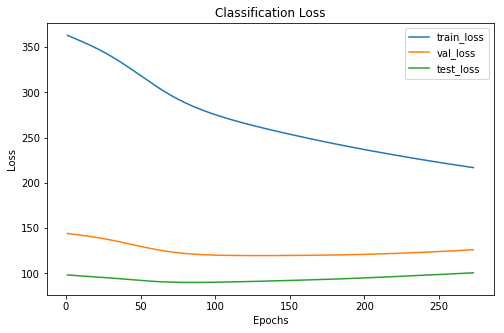

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  31   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     52      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 273 xxxxxxxxxxxxxx


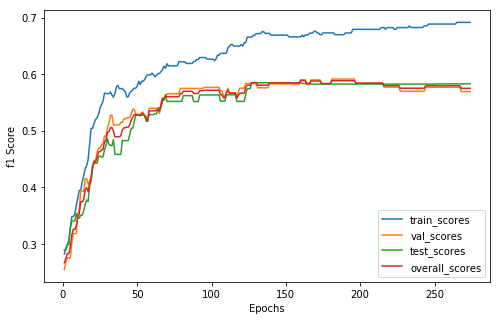

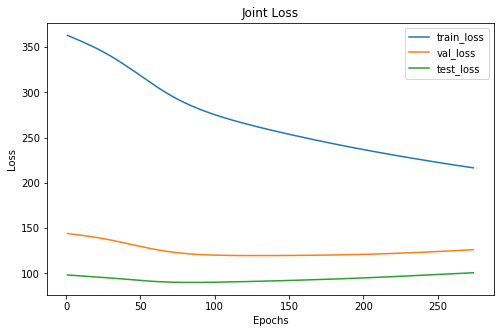

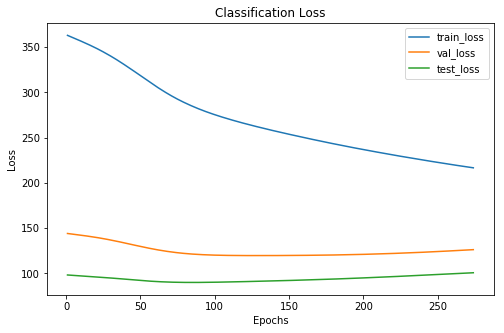

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  31   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     52      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 274 xxxxxxxxxxxxxx


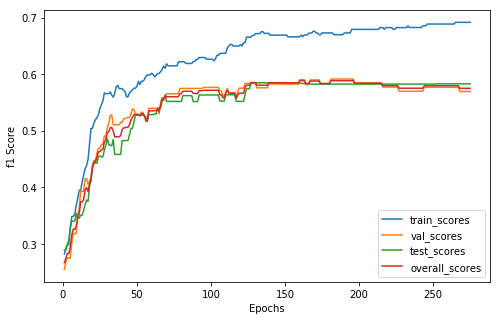

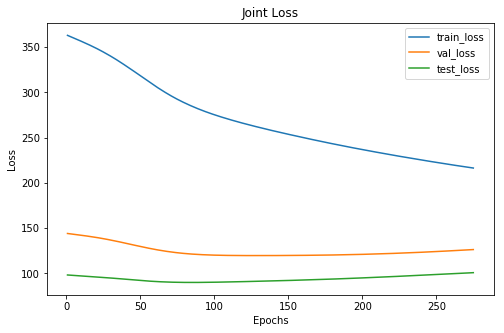

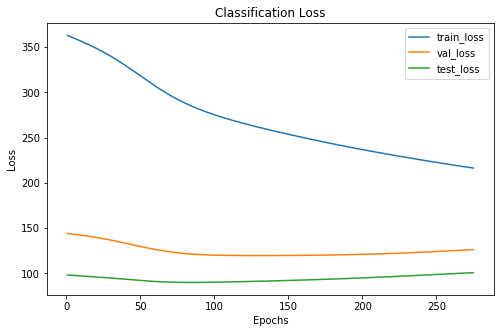

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  31   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     52      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 275 xxxxxxxxxxxxxx


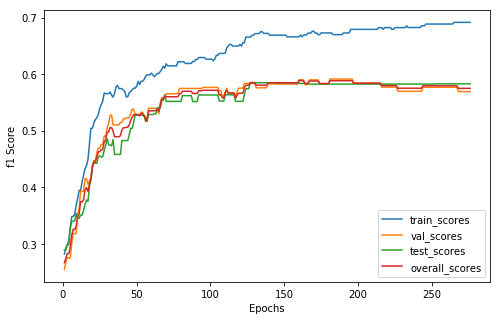

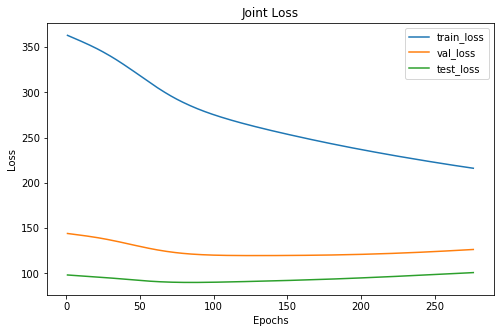

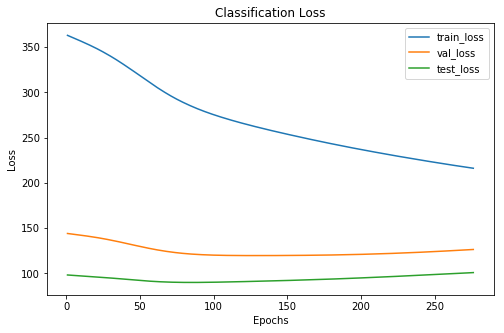

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  31   8
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     52      39
 2       87     33      21
xxxxxxxxxxxxxx epoch: 276 xxxxxxxxxxxxxx


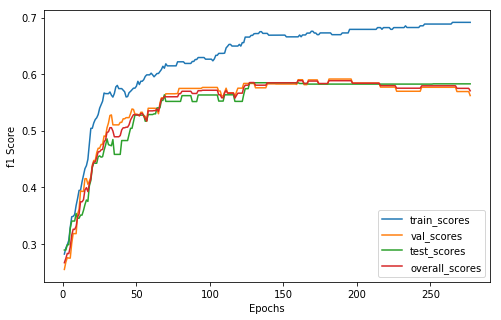

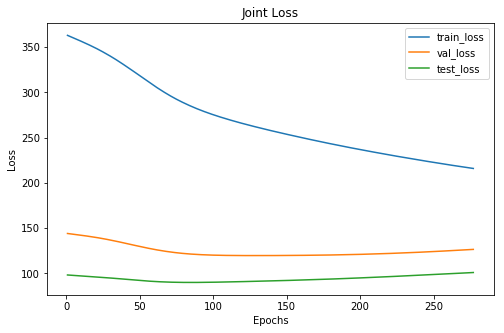

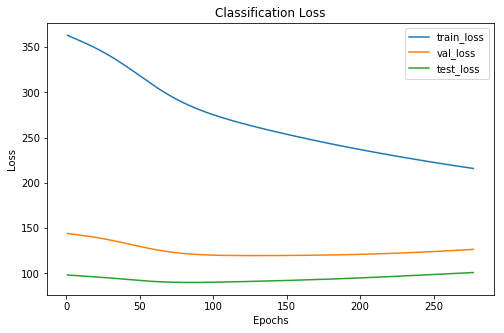

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  30   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     51      39
 2       87     34      21
xxxxxxxxxxxxxx epoch: 277 xxxxxxxxxxxxxx


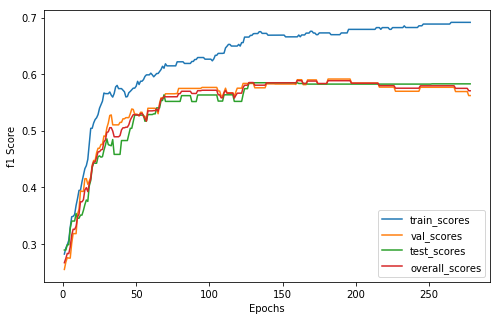

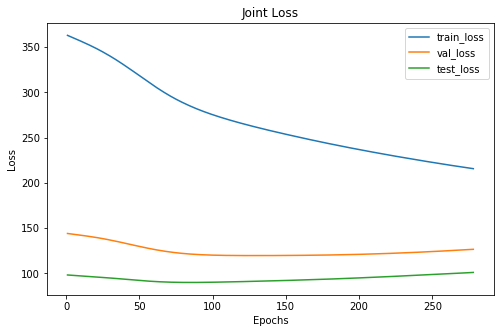

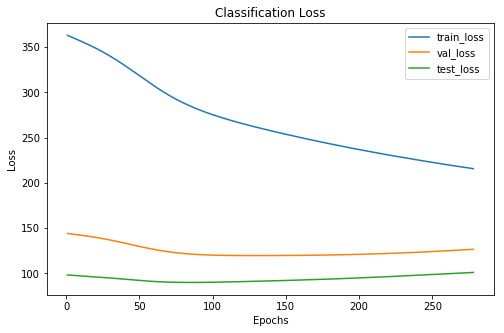

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  30   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     51      39
 2       87     34      21
xxxxxxxxxxxxxx epoch: 278 xxxxxxxxxxxxxx


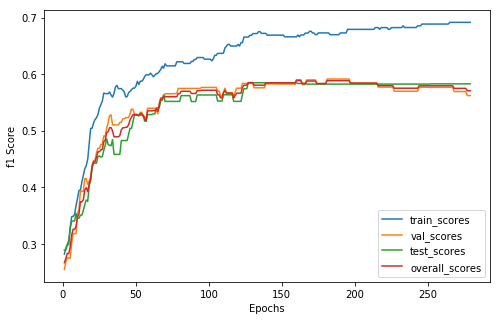

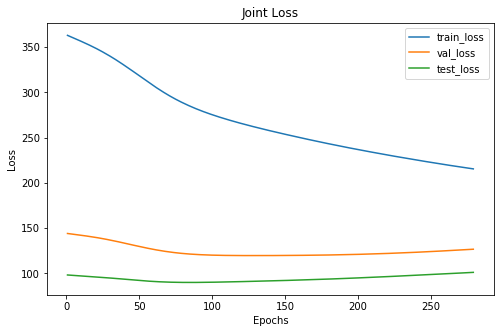

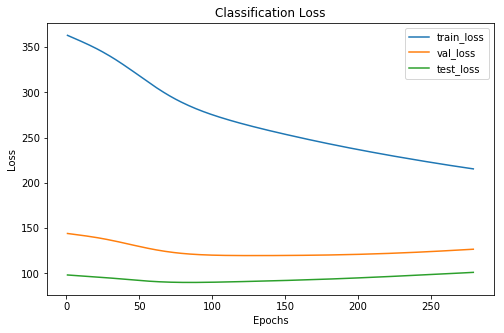

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  30   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     51      39
 2       87     34      21
xxxxxxxxxxxxxx epoch: 279 xxxxxxxxxxxxxx


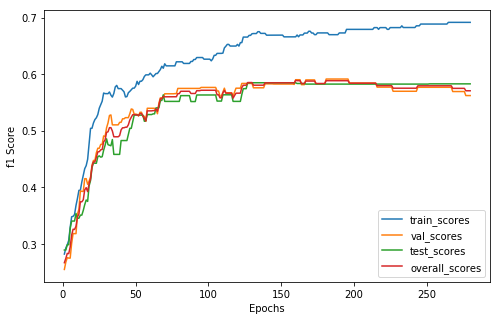

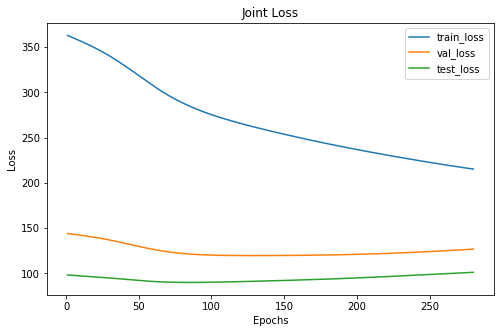

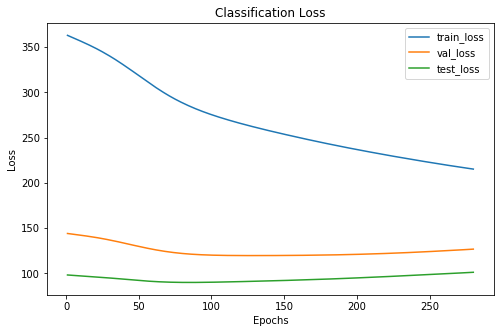

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  30   9
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     51      39
 2       87     34      21
xxxxxxxxxxxxxx epoch: 280 xxxxxxxxxxxxxx


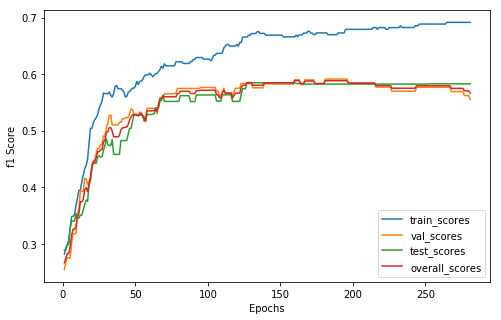

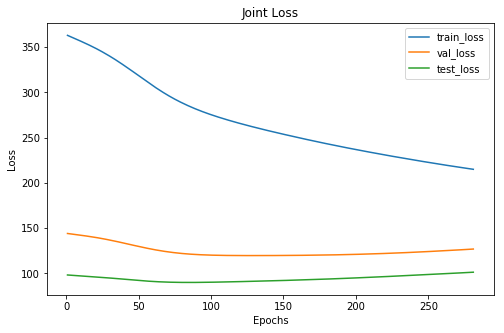

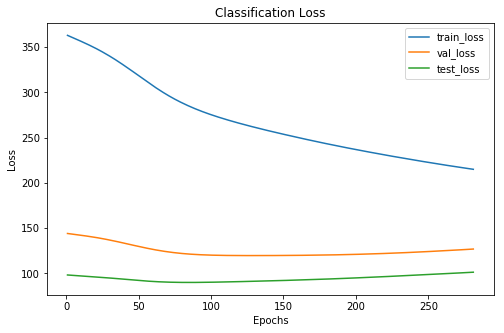

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     50      39
 2       87     35      21
xxxxxxxxxxxxxx epoch: 281 xxxxxxxxxxxxxx


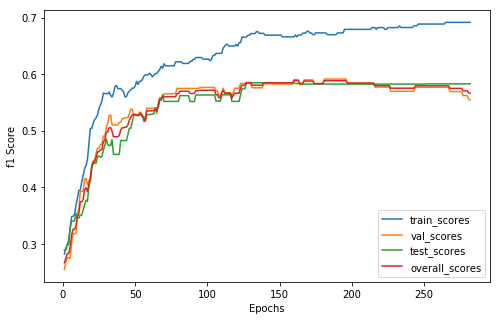

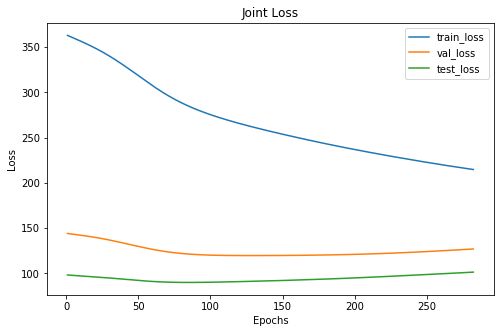

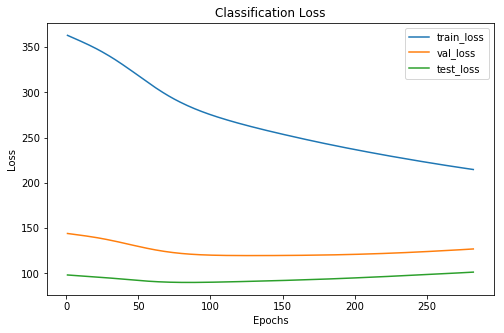

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     50      39
 2       87     35      21
xxxxxxxxxxxxxx epoch: 282 xxxxxxxxxxxxxx


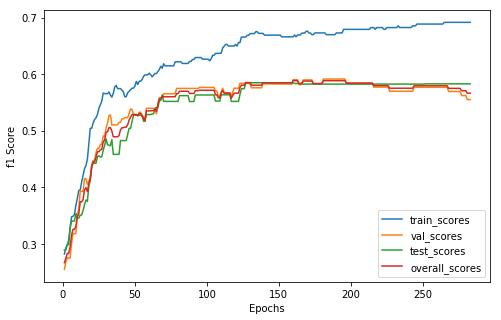

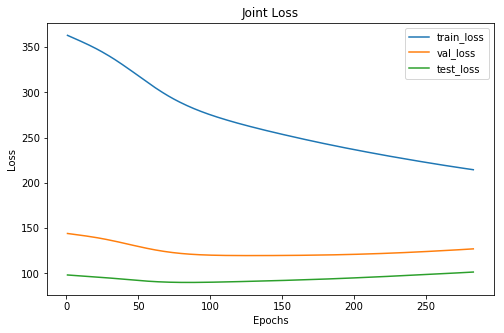

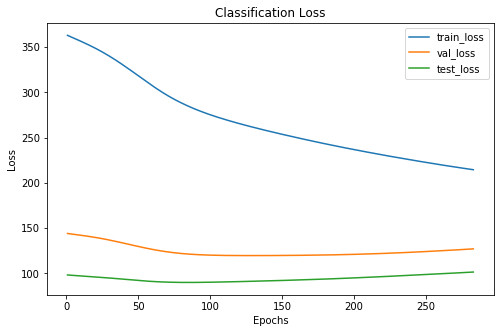

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      28
 1      126     50      39
 2       87     35      21
xxxxxxxxxxxxxx epoch: 283 xxxxxxxxxxxxxx


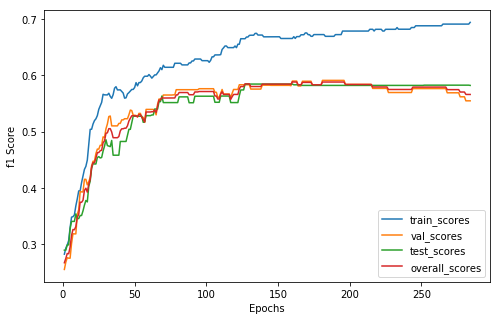

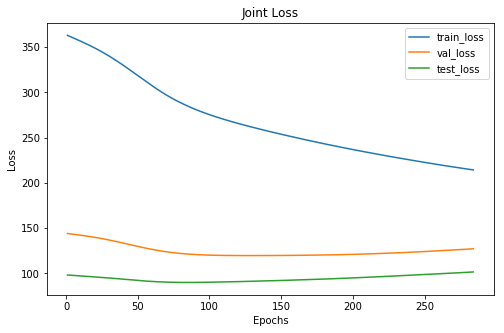

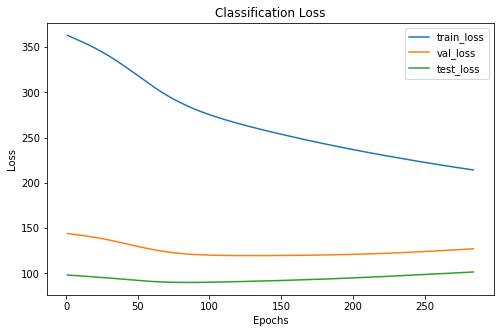

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      27
 1      127     50      40
 2       86     35      21
xxxxxxxxxxxxxx epoch: 284 xxxxxxxxxxxxxx


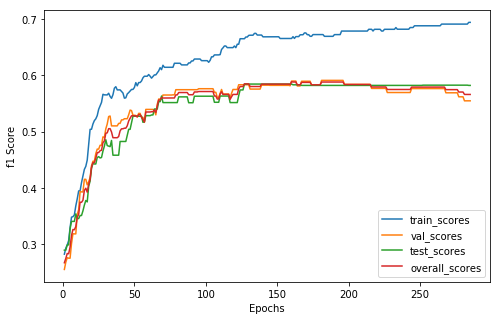

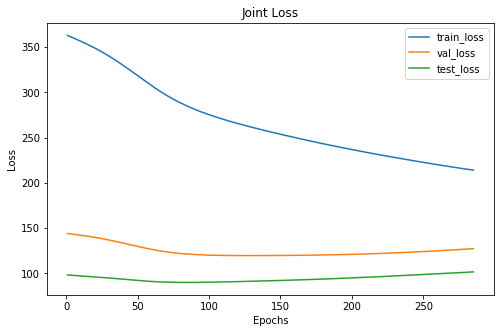

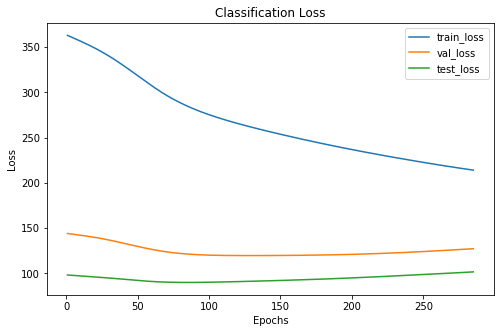

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      27
 1      127     50      40
 2       86     35      21
xxxxxxxxxxxxxx epoch: 285 xxxxxxxxxxxxxx


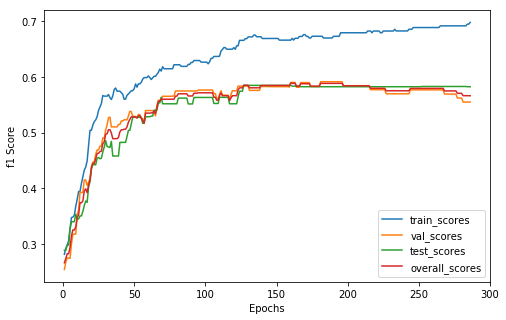

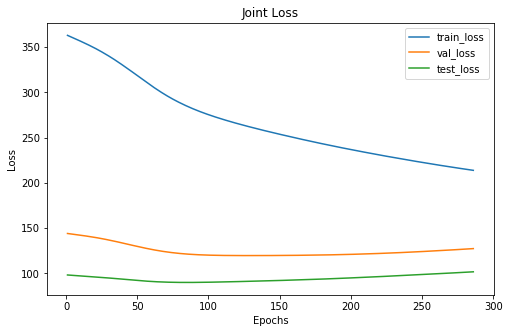

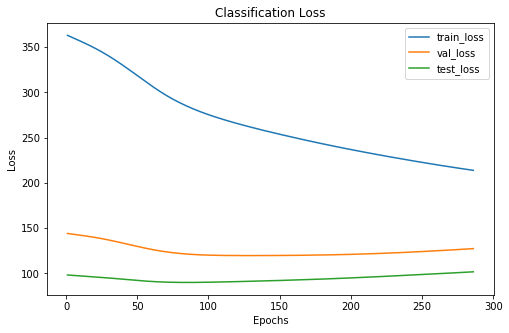

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      27
 1      126     50      40
 2       87     35      21
xxxxxxxxxxxxxx epoch: 286 xxxxxxxxxxxxxx


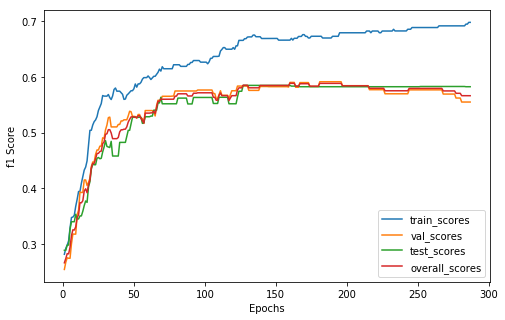

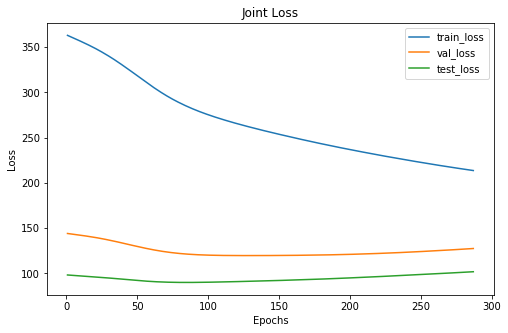

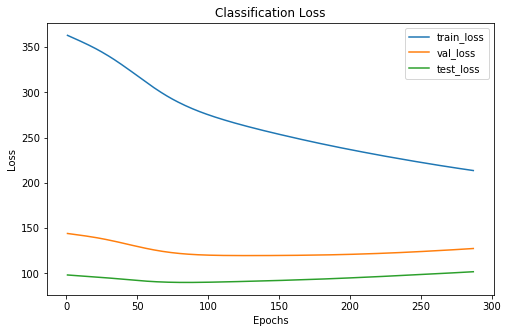

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      27
 1      126     50      40
 2       87     35      21
xxxxxxxxxxxxxx epoch: 287 xxxxxxxxxxxxxx


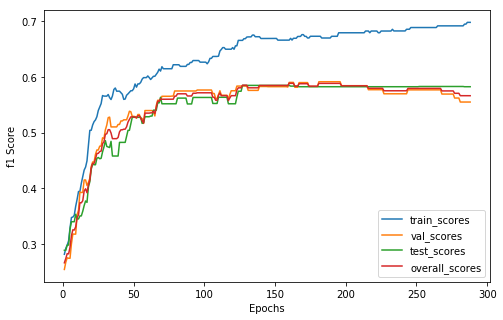

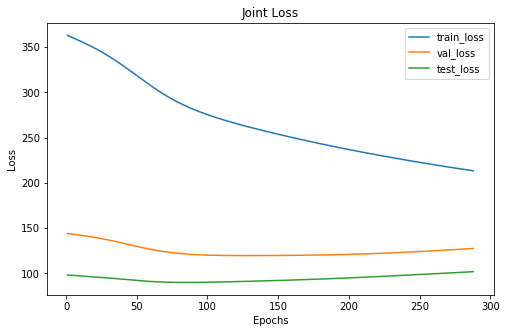

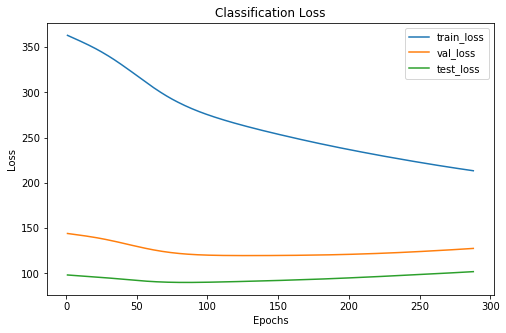

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      27
 1      126     50      40
 2       87     35      21
xxxxxxxxxxxxxx epoch: 288 xxxxxxxxxxxxxx


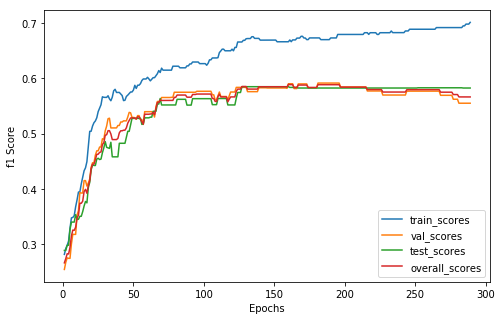

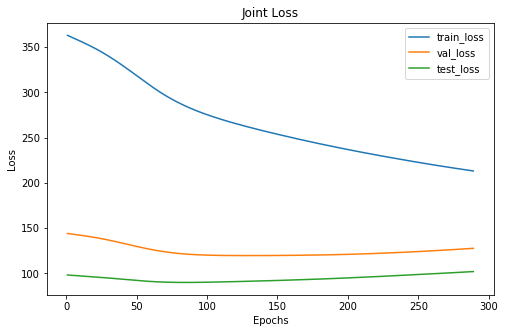

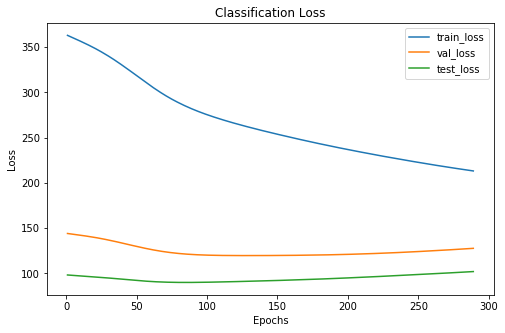

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      27
 1      125     50      40
 2       88     35      21
xxxxxxxxxxxxxx epoch: 289 xxxxxxxxxxxxxx


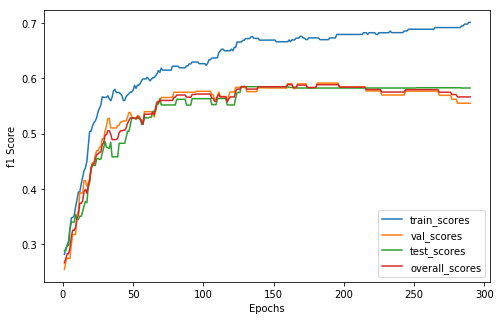

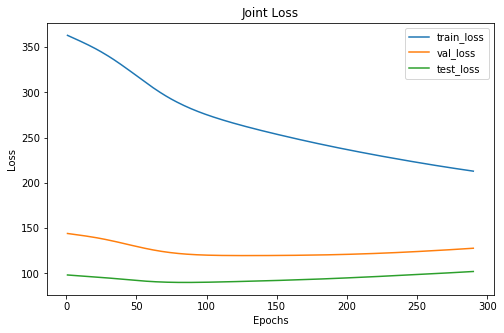

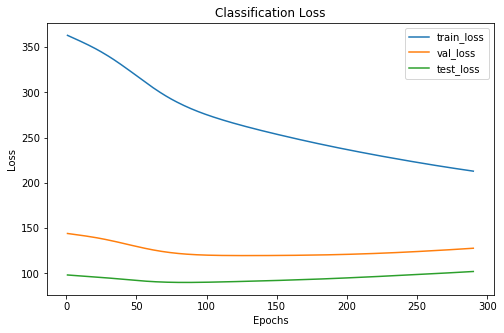

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      27
 1      125     50      40
 2       88     35      21
xxxxxxxxxxxxxx epoch: 290 xxxxxxxxxxxxxx


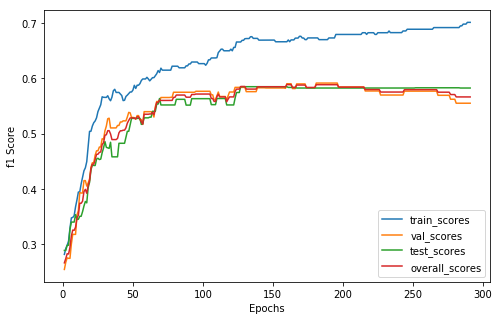

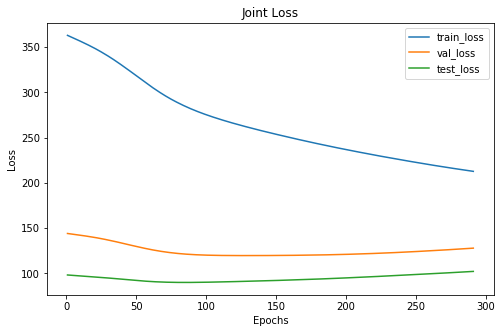

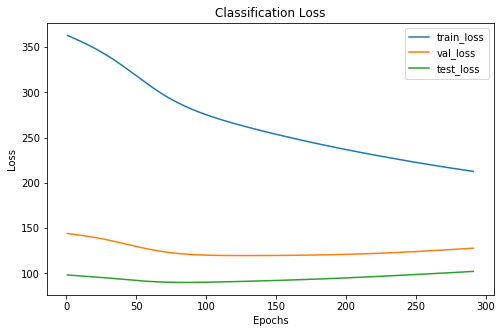

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     45      27
 1      125     50      40
 2       88     35      21
xxxxxxxxxxxxxx epoch: 291 xxxxxxxxxxxxxx


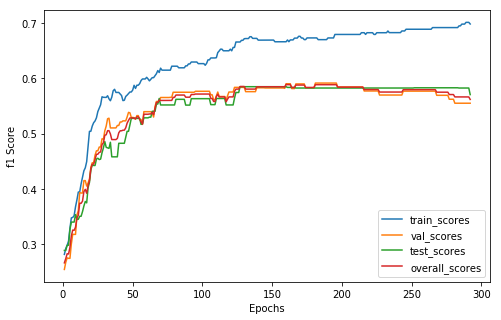

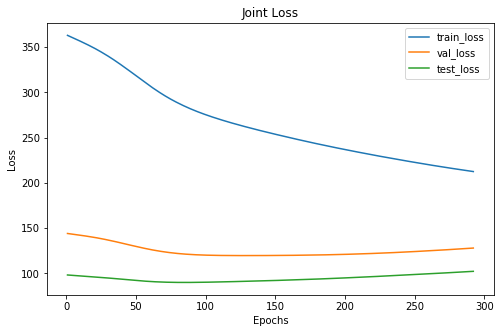

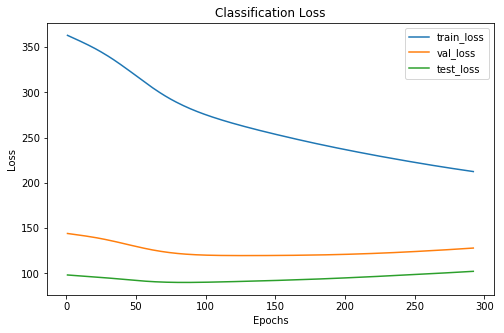

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      115     45      27
 1      124     50      41
 2       88     35      20
xxxxxxxxxxxxxx epoch: 292 xxxxxxxxxxxxxx


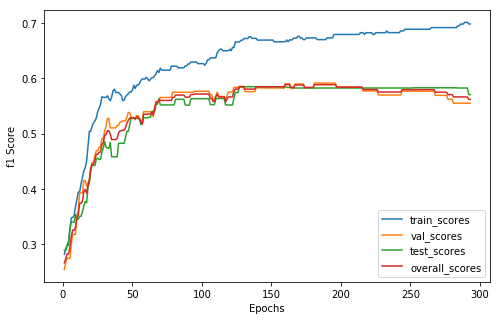

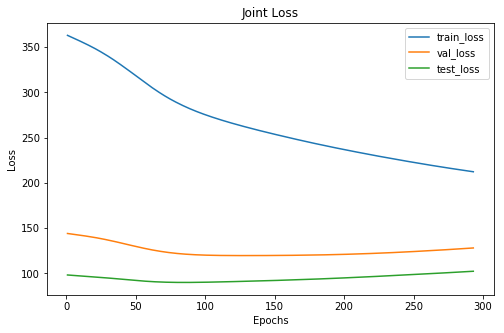

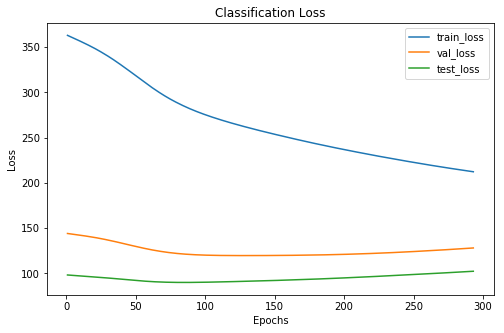

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      115     45      27
 1      124     50      41
 2       88     35      20
xxxxxxxxxxxxxx epoch: 293 xxxxxxxxxxxxxx


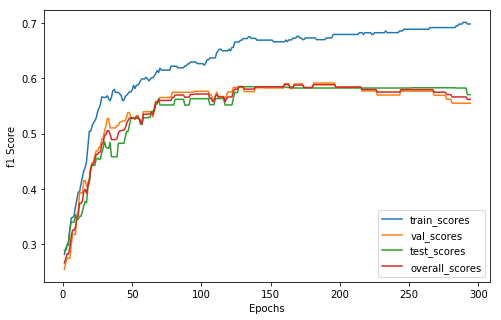

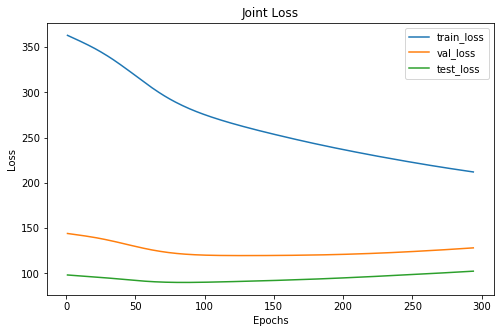

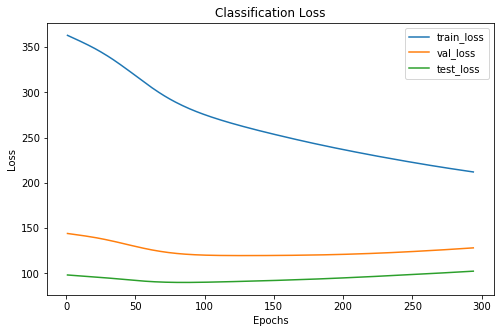

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      115     45      27
 1      124     50      41
 2       88     35      20
xxxxxxxxxxxxxx epoch: 294 xxxxxxxxxxxxxx


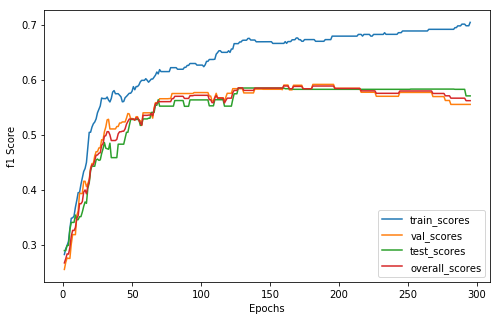

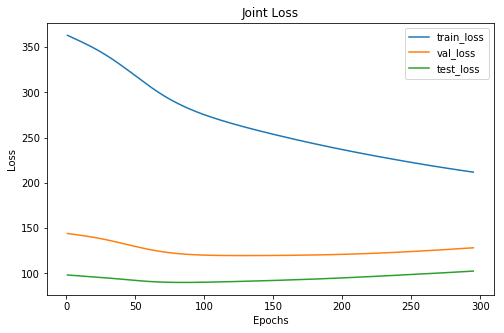

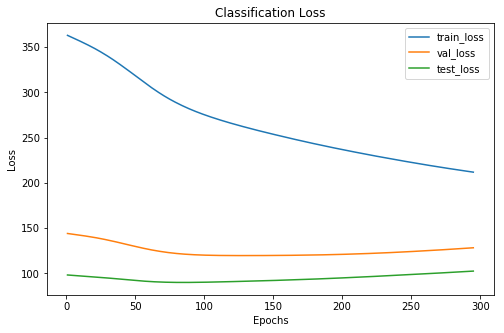

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     45      27
 1      124     50      41
 2       86     35      20
xxxxxxxxxxxxxx epoch: 295 xxxxxxxxxxxxxx


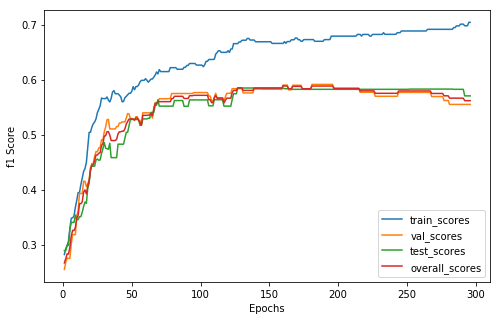

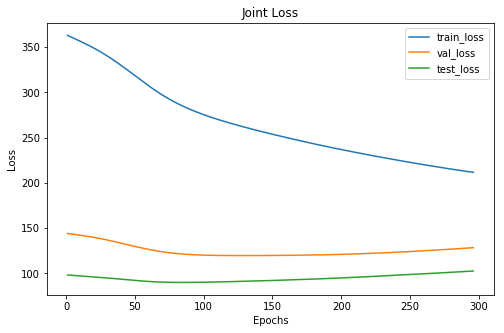

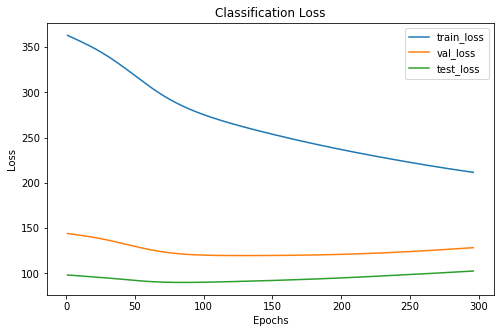

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     45      27
 1      124     50      41
 2       86     35      20
xxxxxxxxxxxxxx epoch: 296 xxxxxxxxxxxxxx


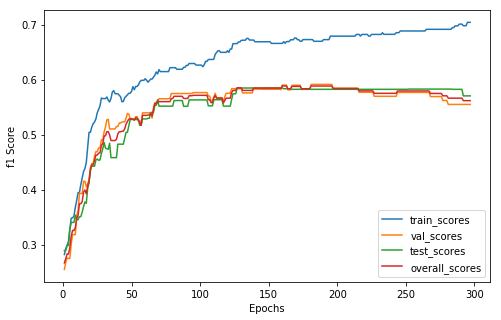

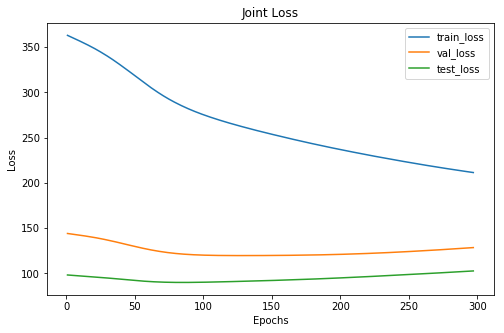

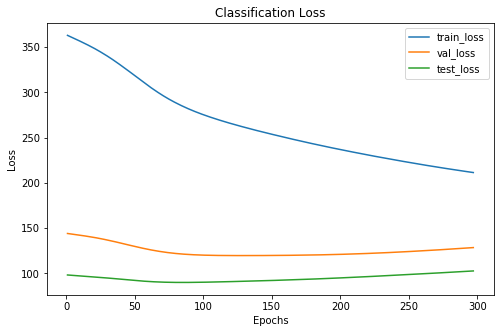

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     45      27
 1      124     50      41
 2       86     35      20
xxxxxxxxxxxxxx epoch: 297 xxxxxxxxxxxxxx


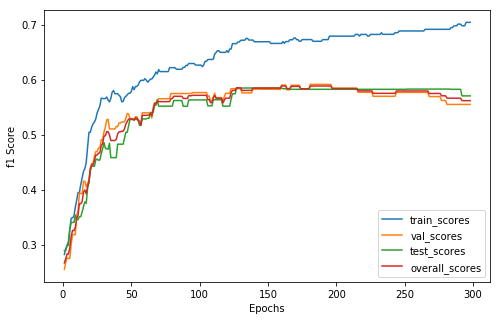

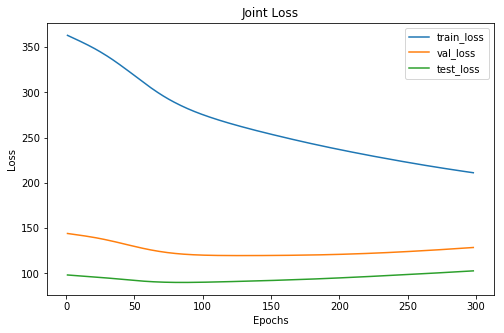

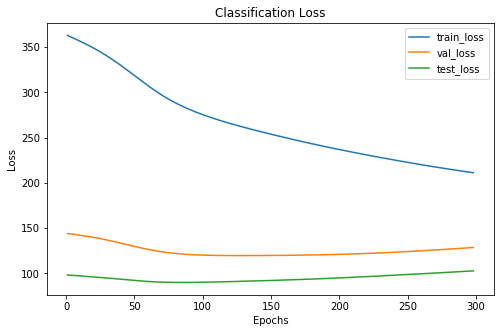

Cofusion Matrix For Val Set: 
--  --  --
27  17   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     45      27
 1      124     50      41
 2       86     35      20
xxxxxxxxxxxxxx epoch: 298 xxxxxxxxxxxxxx


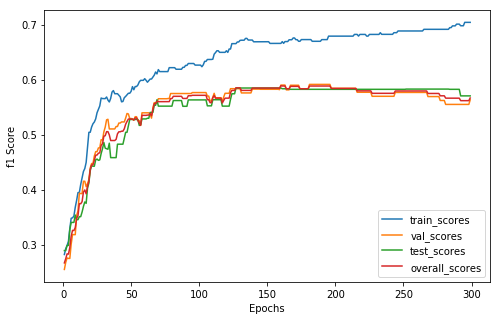

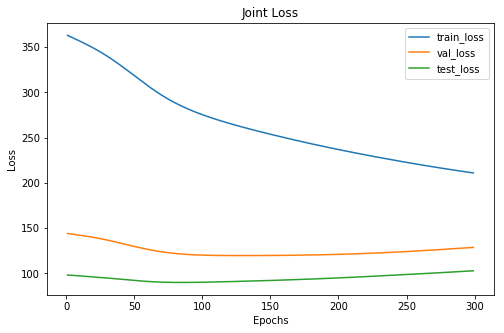

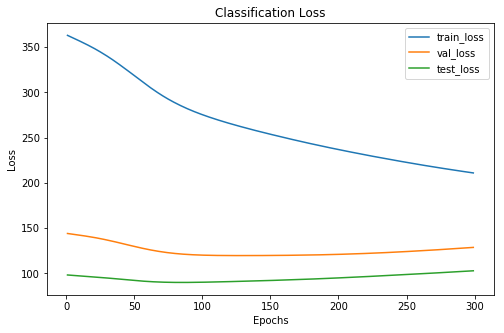

Cofusion Matrix For Val Set: 
--  --  --
28  16   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     46      27
 1      124     49      41
 2       86     35      20
xxxxxxxxxxxxxx epoch: 299 xxxxxxxxxxxxxx


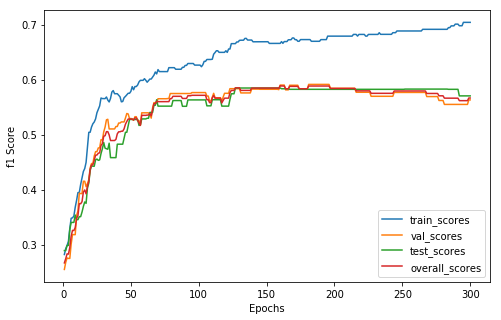

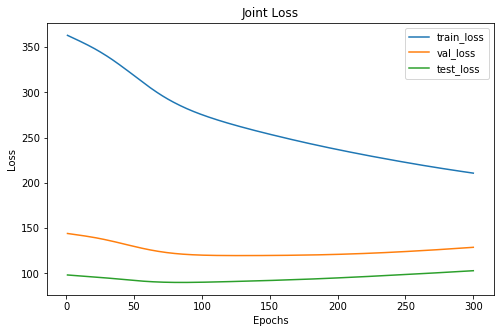

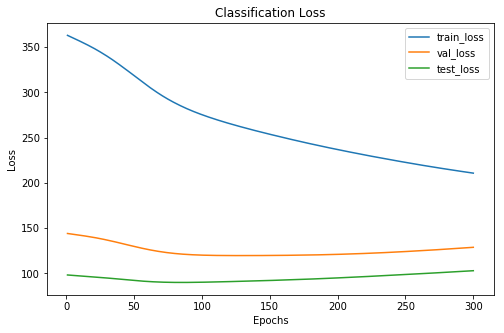

Cofusion Matrix For Val Set: 
--  --  --
28  16   9
11  29  10
 7   4  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     46      27
 1      124     49      41
 2       86     35      20
xxxxxxxxxxxxxx epoch: 300 xxxxxxxxxxxxxx


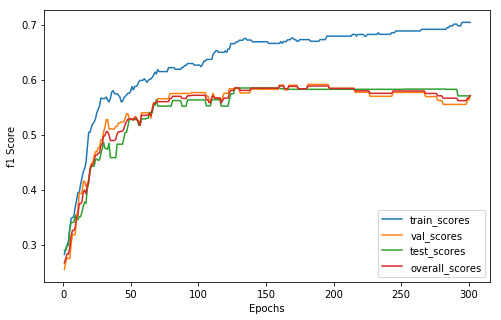

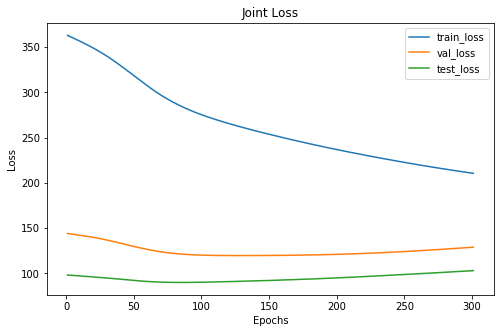

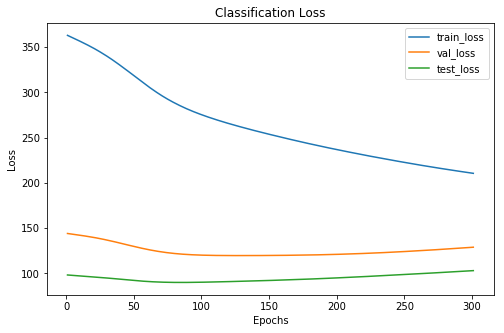

Cofusion Matrix For Val Set: 
--  --  --
28  16   9
11  29  10
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     45      27
 1      124     49      41
 2       86     36      20
xxxxxxxxxxxxxx epoch: 301 xxxxxxxxxxxxxx


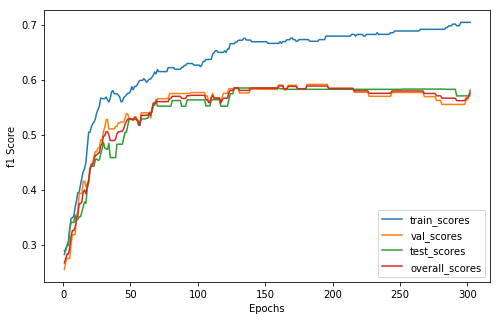

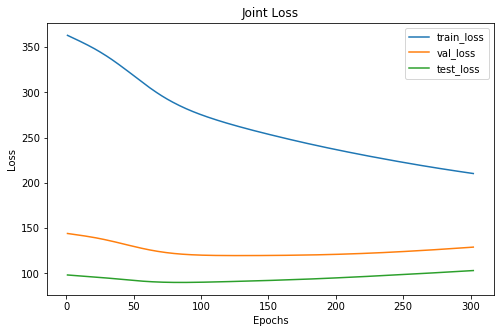

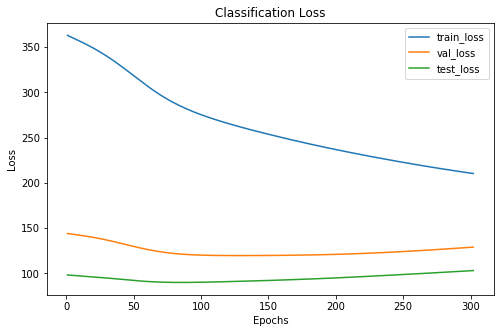

Cofusion Matrix For Val Set: 
--  --  --
28  16   9
11  29  10
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     45      27
 1      124     49      42
 2       86     36      19
xxxxxxxxxxxxxx epoch: 302 xxxxxxxxxxxxxx


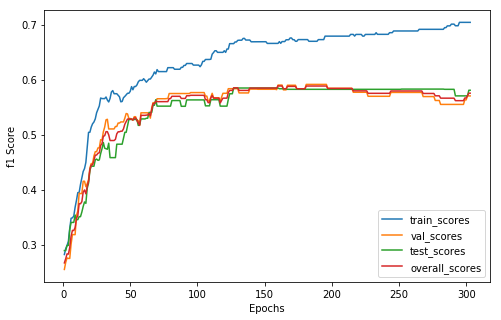

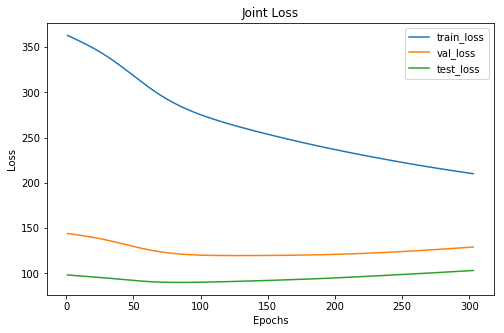

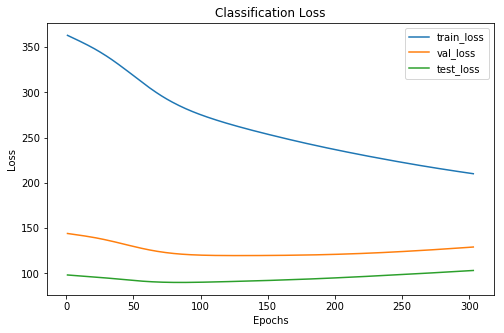

Cofusion Matrix For Val Set: 
--  --  --
28  16   9
11  29  10
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     45      27
 1      124     49      42
 2       86     36      19
xxxxxxxxxxxxxx epoch: 303 xxxxxxxxxxxxxx


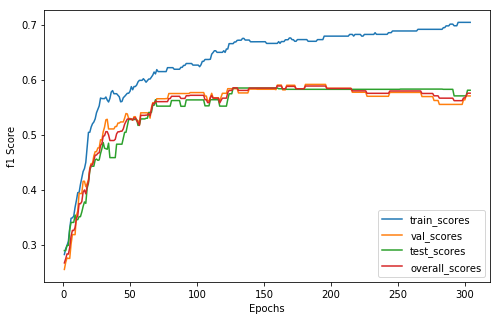

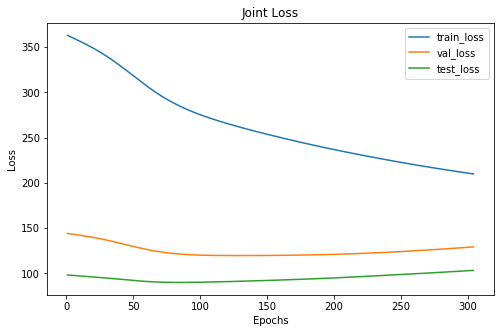

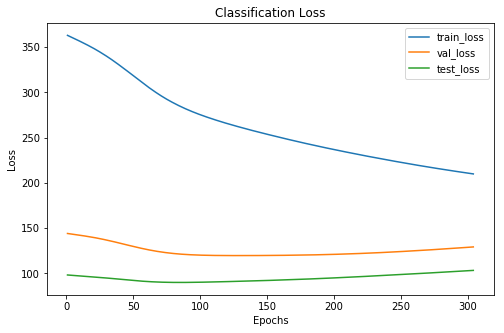

Cofusion Matrix For Val Set: 
--  --  --
28  16   9
11  29  10
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     45      27
 1      124     49      42
 2       86     36      19
xxxxxxxxxxxxxx epoch: 304 xxxxxxxxxxxxxx


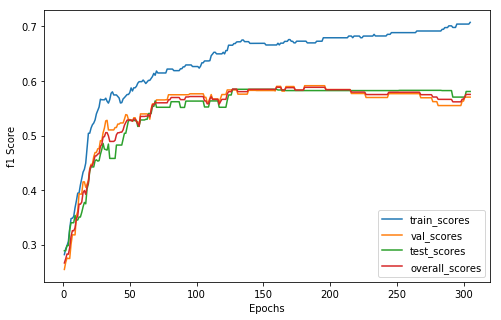

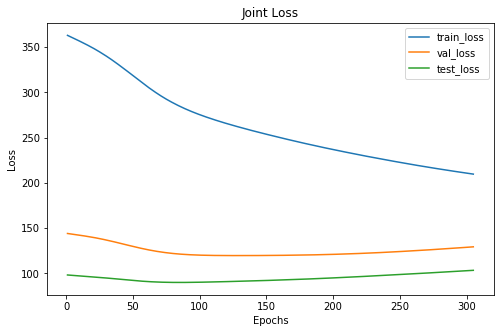

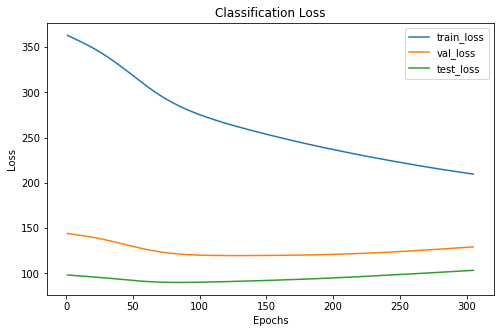

Cofusion Matrix For Val Set: 
--  --  --
28  16   9
11  29  10
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     45      27
 1      123     49      42
 2       87     36      19
xxxxxxxxxxxxxx epoch: 305 xxxxxxxxxxxxxx


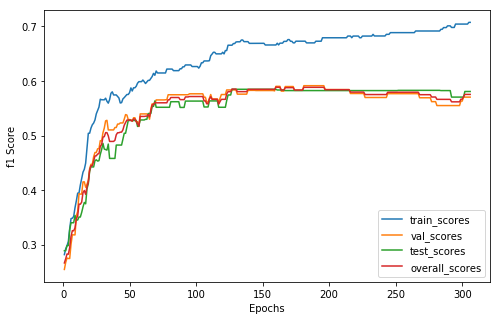

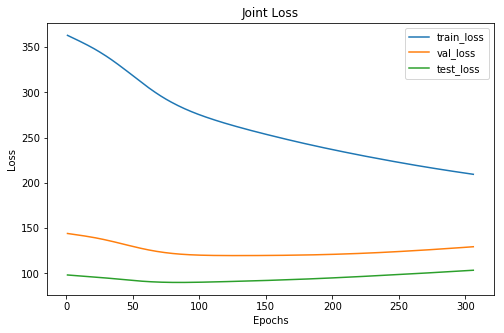

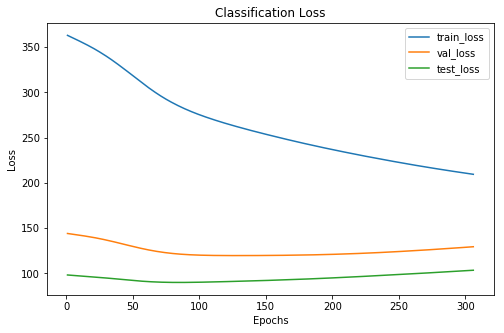

Cofusion Matrix For Val Set: 
--  --  --
28  16   9
11  29  10
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     45      27
 1      123     49      42
 2       87     36      19
xxxxxxxxxxxxxx epoch: 306 xxxxxxxxxxxxxx


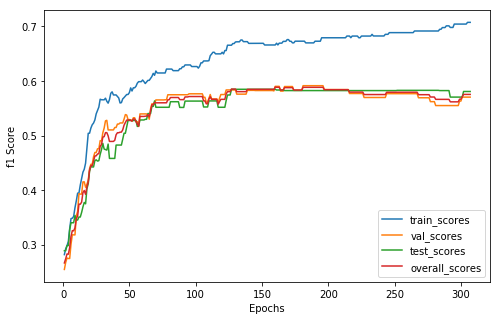

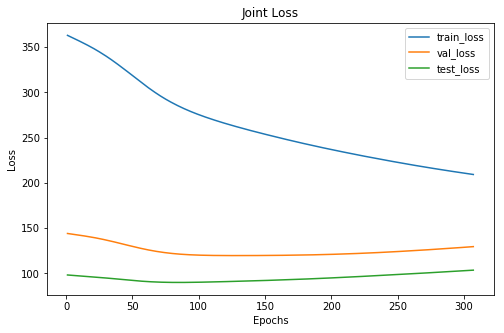

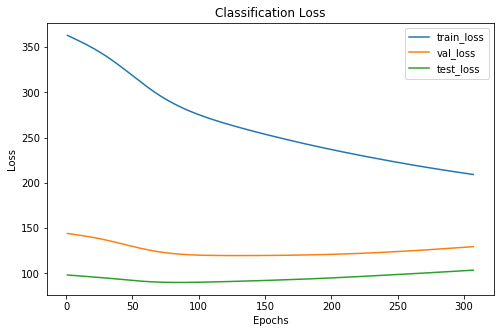

Cofusion Matrix For Val Set: 
--  --  --
28  16   9
11  29  10
 6   4  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     45      27
 1      123     49      42
 2       87     36      19
xxxxxxxxxxxxxx epoch: 307 xxxxxxxxxxxxxx


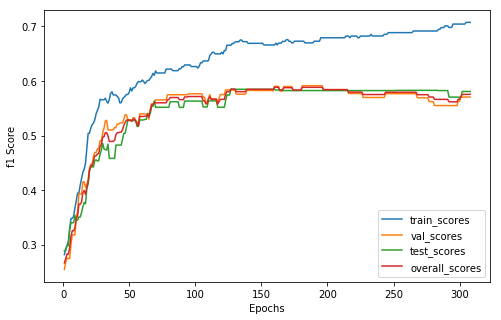

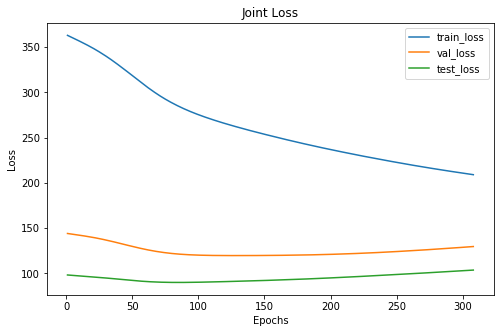

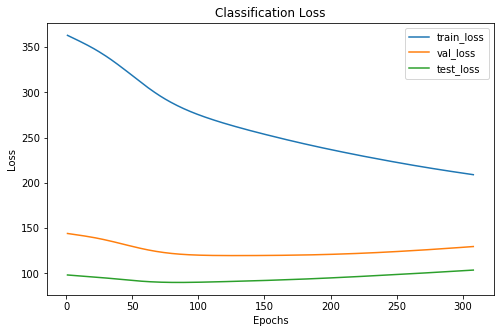

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      123     44      42
 2       87     36      19
xxxxxxxxxxxxxx epoch: 308 xxxxxxxxxxxxxx


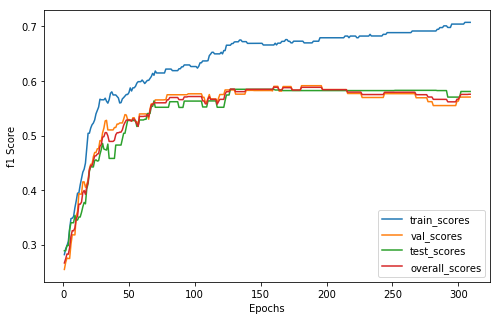

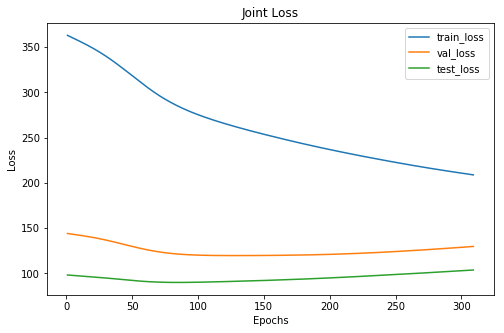

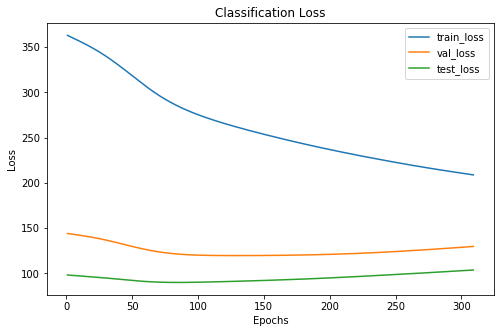

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      123     44      42
 2       87     36      19
xxxxxxxxxxxxxx epoch: 309 xxxxxxxxxxxxxx


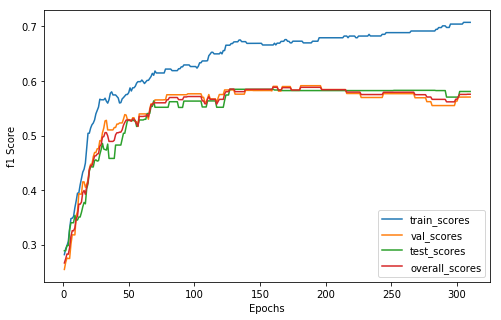

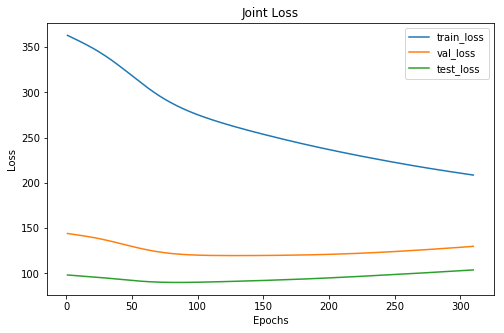

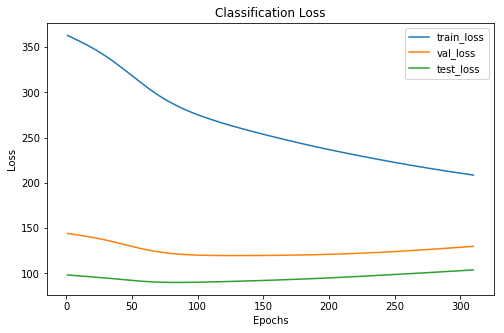

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      123     44      42
 2       87     36      19
xxxxxxxxxxxxxx epoch: 310 xxxxxxxxxxxxxx


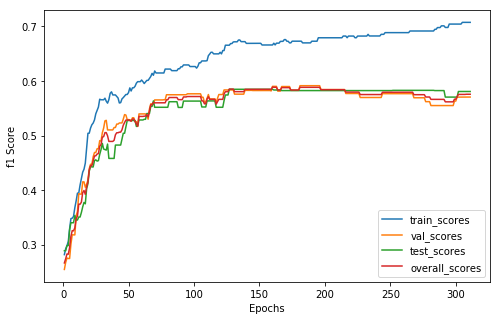

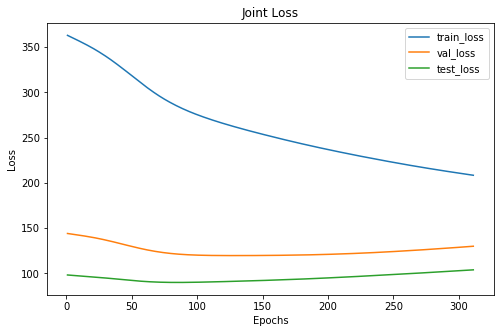

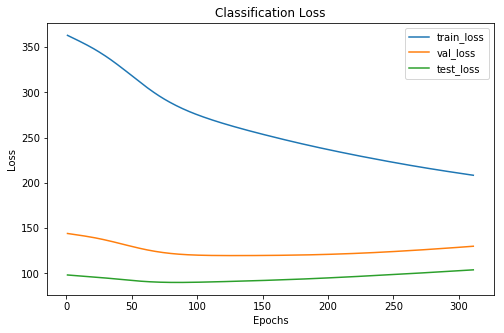

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      123     44      42
 2       87     36      19
xxxxxxxxxxxxxx epoch: 311 xxxxxxxxxxxxxx


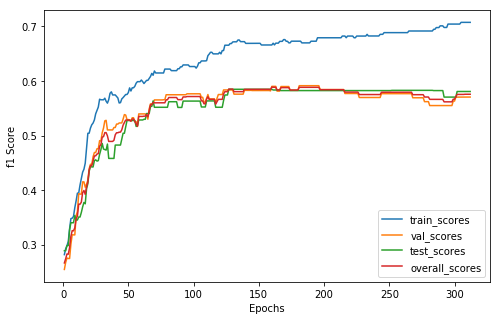

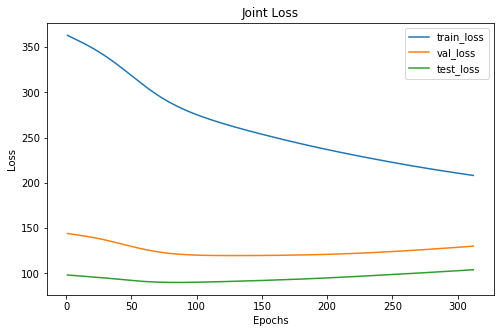

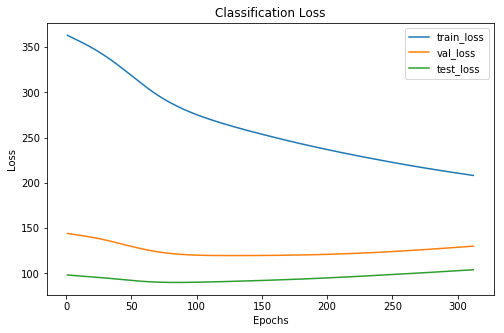

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      123     44      42
 2       87     36      19
xxxxxxxxxxxxxx epoch: 312 xxxxxxxxxxxxxx


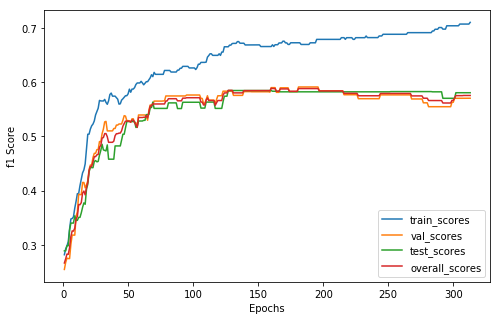

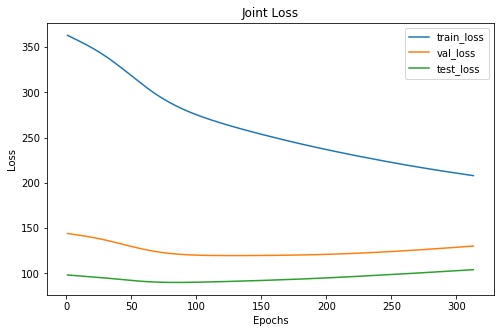

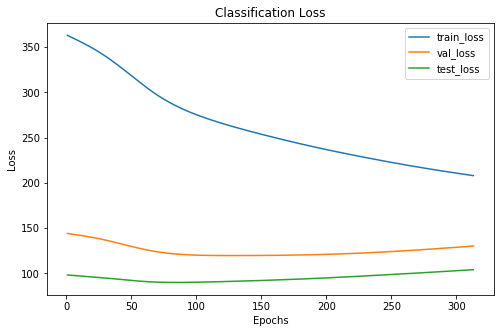

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      124     44      42
 2       86     36      19
xxxxxxxxxxxxxx epoch: 313 xxxxxxxxxxxxxx


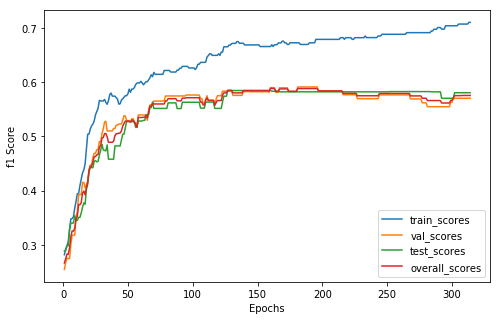

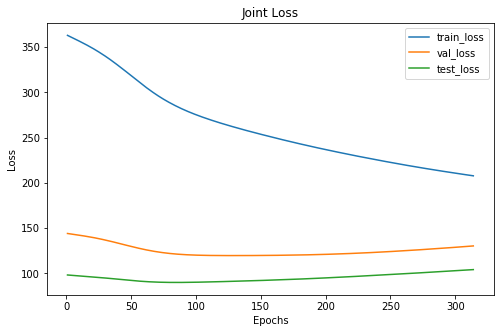

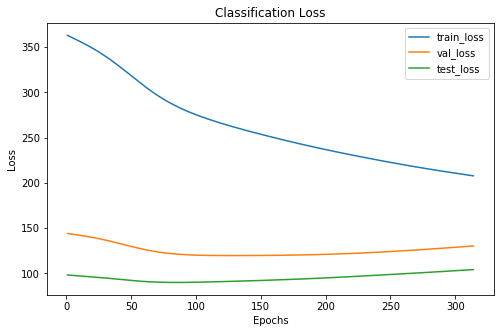

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      124     44      42
 2       86     36      19
xxxxxxxxxxxxxx epoch: 314 xxxxxxxxxxxxxx


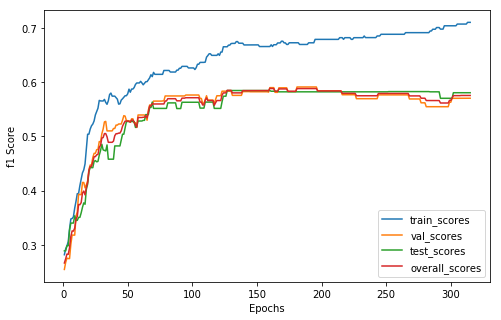

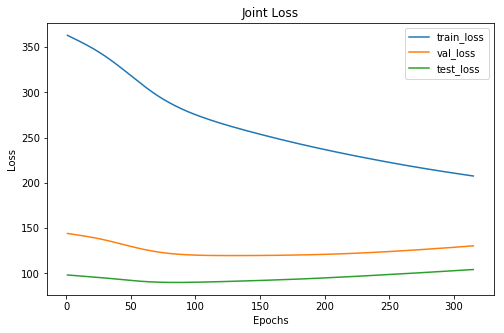

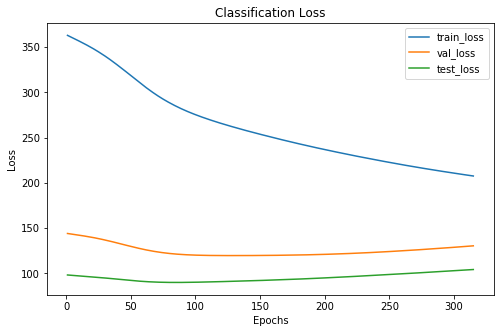

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      124     44      42
 2       86     36      19
xxxxxxxxxxxxxx epoch: 315 xxxxxxxxxxxxxx


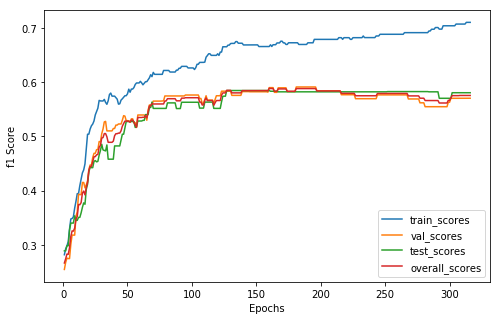

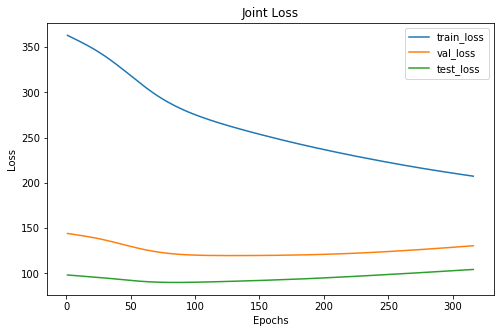

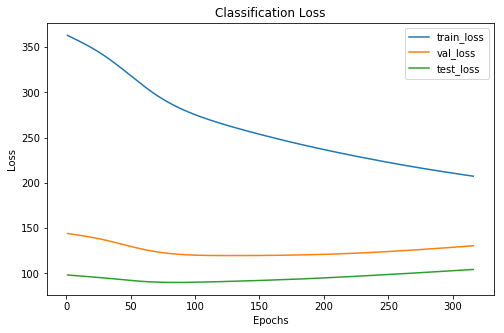

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      124     44      42
 2       86     36      19
xxxxxxxxxxxxxx epoch: 316 xxxxxxxxxxxxxx


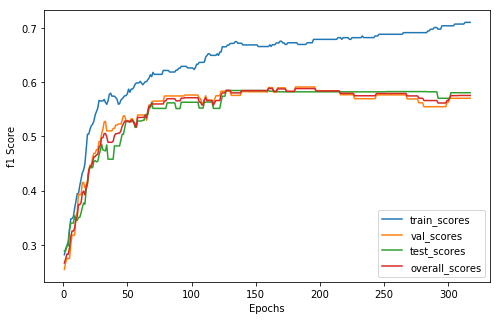

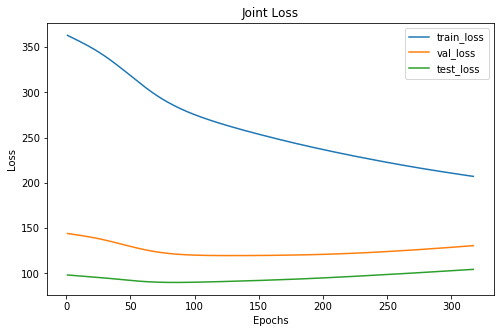

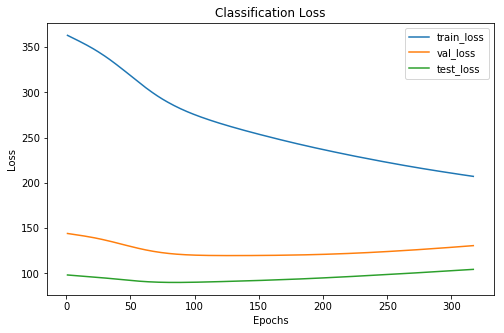

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      124     44      42
 2       86     36      19
xxxxxxxxxxxxxx epoch: 317 xxxxxxxxxxxxxx


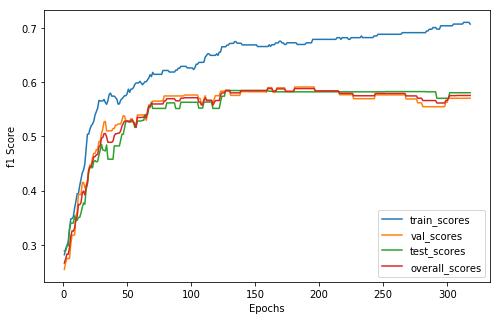

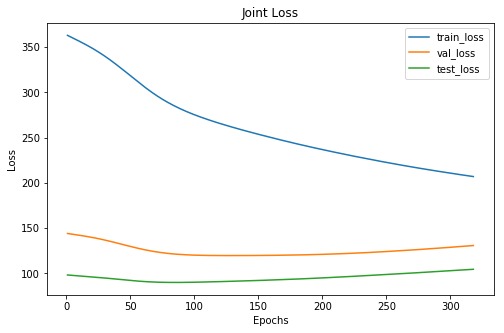

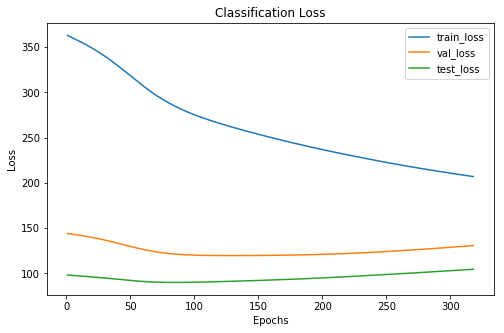

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      125     44      42
 2       85     36      19
xxxxxxxxxxxxxx epoch: 318 xxxxxxxxxxxxxx


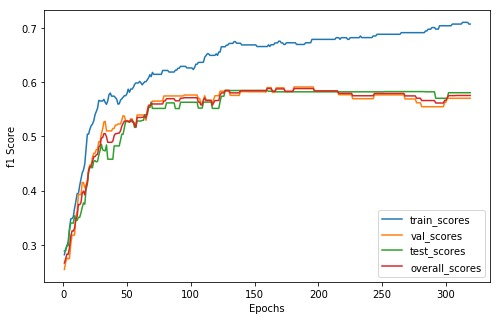

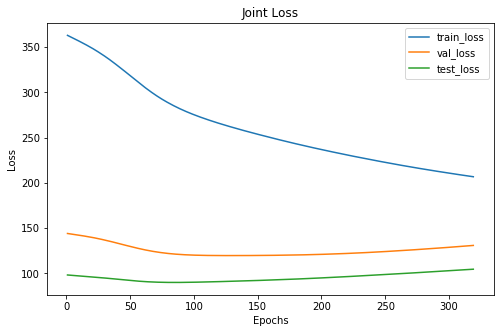

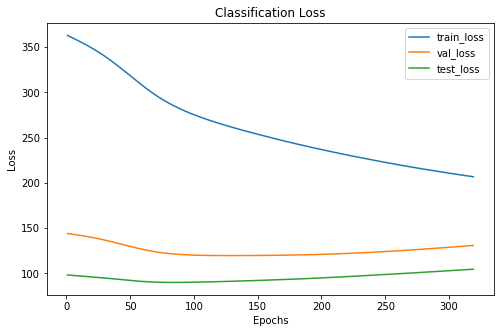

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      125     44      42
 2       85     36      19
xxxxxxxxxxxxxx epoch: 319 xxxxxxxxxxxxxx


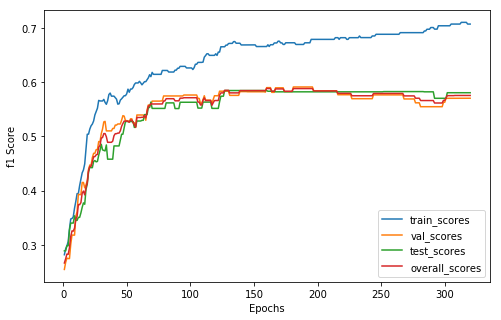

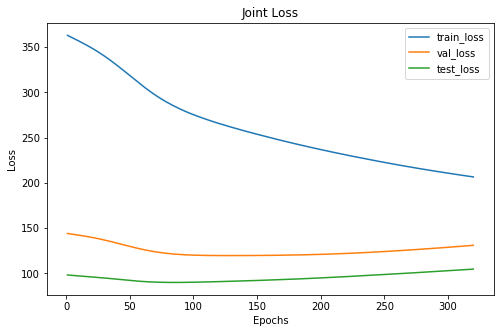

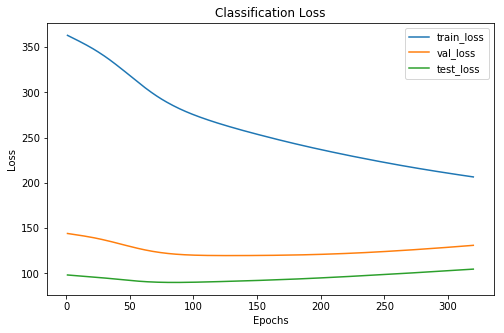

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      125     44      42
 2       85     36      19
xxxxxxxxxxxxxx epoch: 320 xxxxxxxxxxxxxx


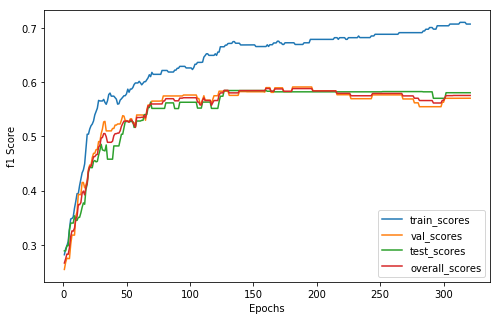

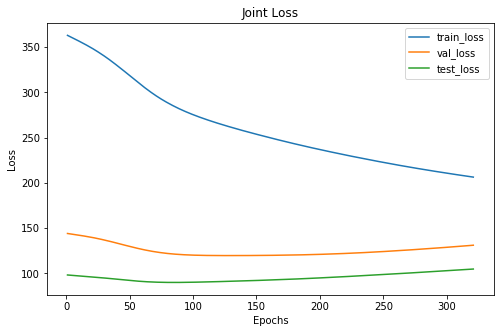

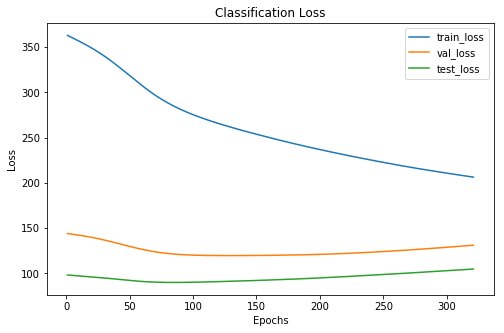

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      125     44      42
 2       85     36      19
xxxxxxxxxxxxxx epoch: 321 xxxxxxxxxxxxxx


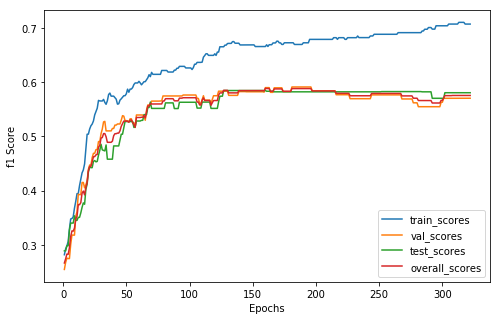

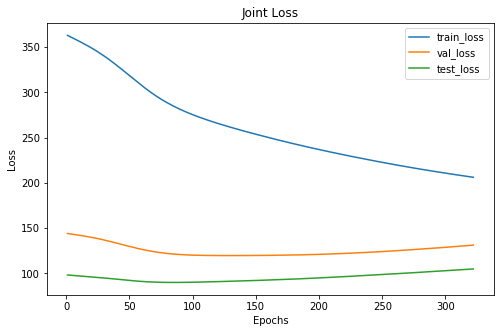

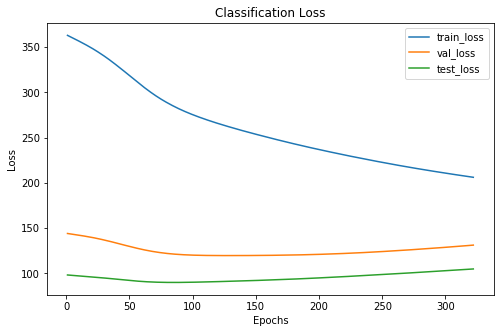

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      125     44      42
 2       85     36      19
xxxxxxxxxxxxxx epoch: 322 xxxxxxxxxxxxxx


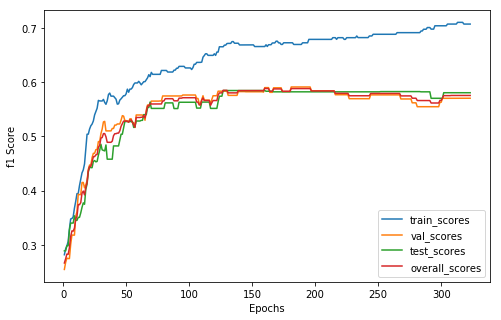

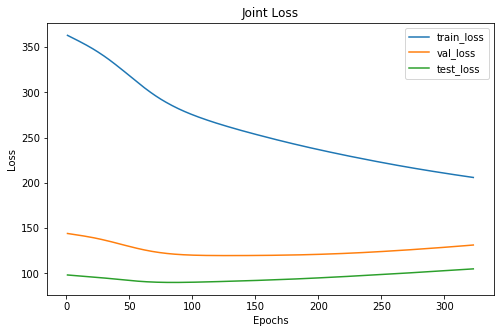

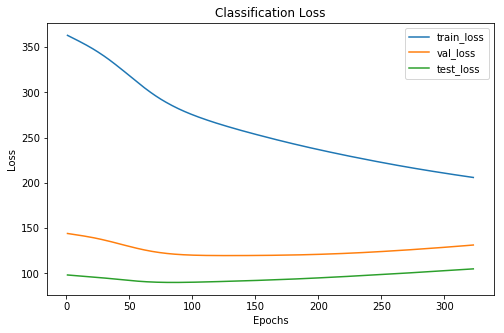

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      125     44      42
 2       85     36      19
xxxxxxxxxxxxxx epoch: 323 xxxxxxxxxxxxxx


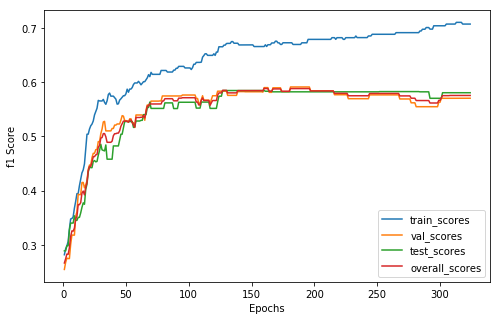

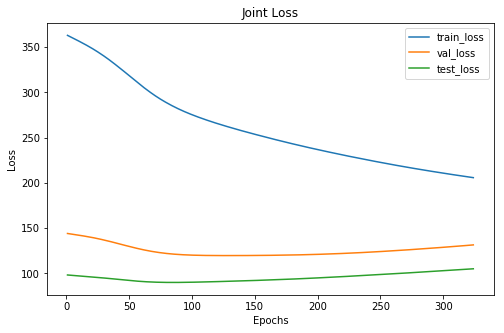

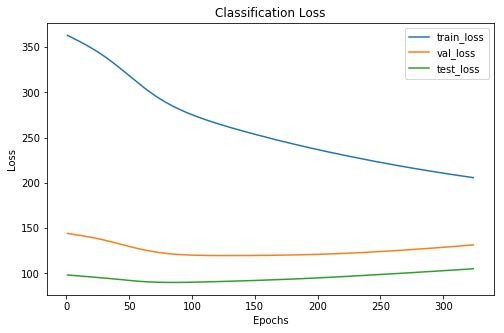

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      117     50      27
 1      125     44      42
 2       85     36      19
xxxxxxxxxxxxxx epoch: 324 xxxxxxxxxxxxxx


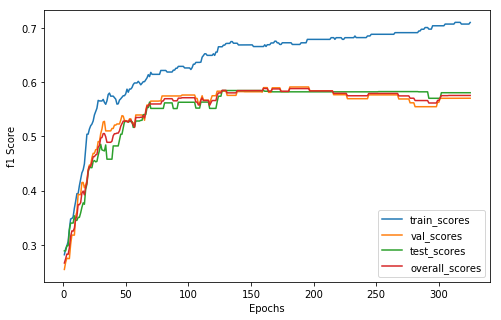

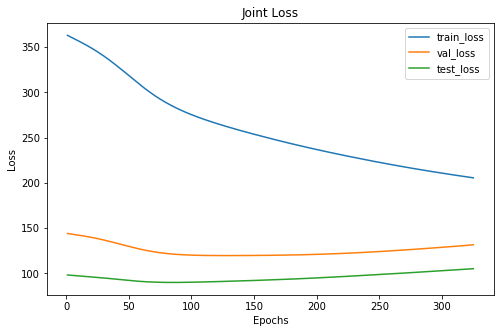

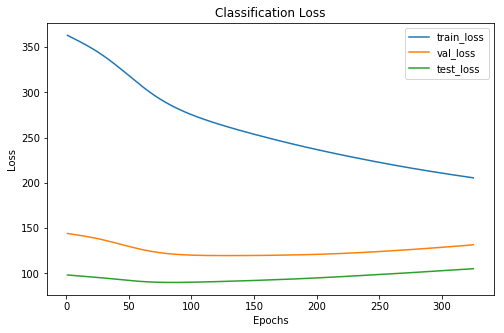

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      126     44      42
 2       85     36      19
xxxxxxxxxxxxxx epoch: 325 xxxxxxxxxxxxxx


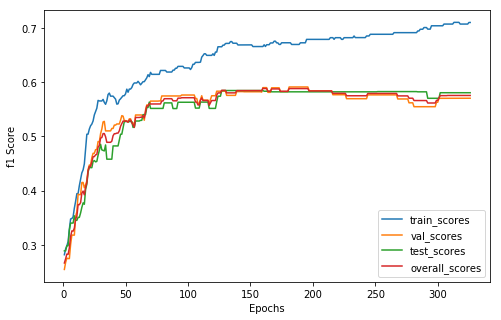

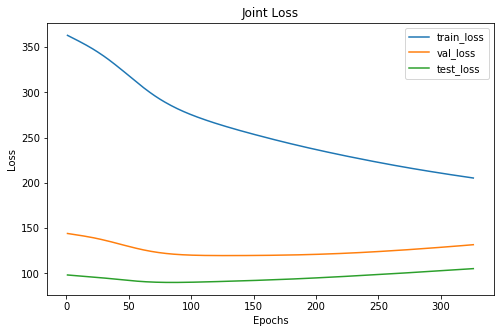

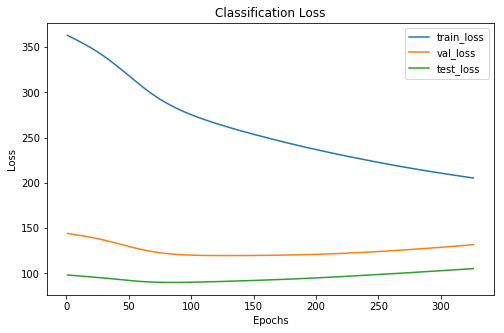

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      126     44      42
 2       85     36      19
xxxxxxxxxxxxxx epoch: 326 xxxxxxxxxxxxxx


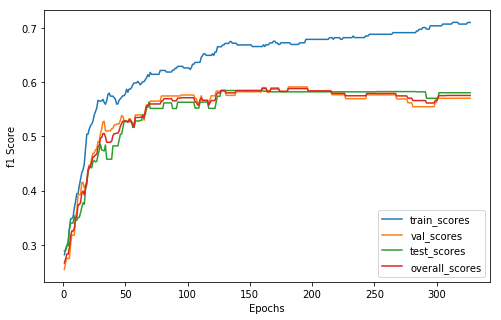

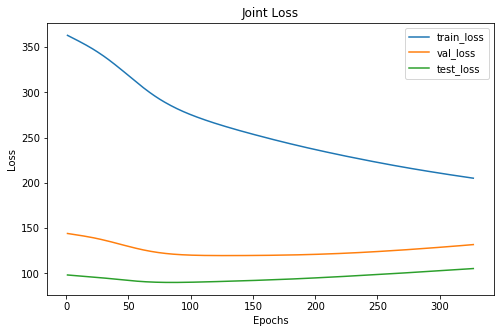

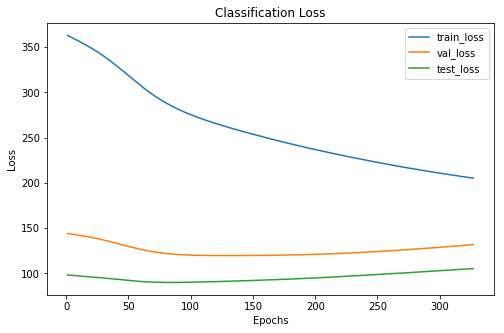

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      126     44      42
 2       85     36      19
xxxxxxxxxxxxxx epoch: 327 xxxxxxxxxxxxxx


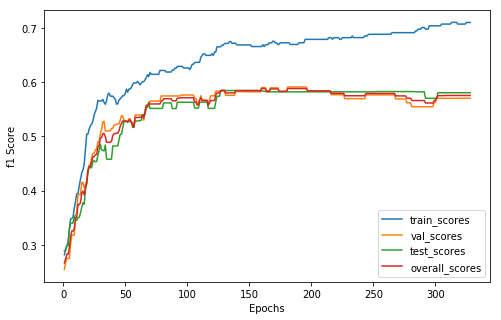

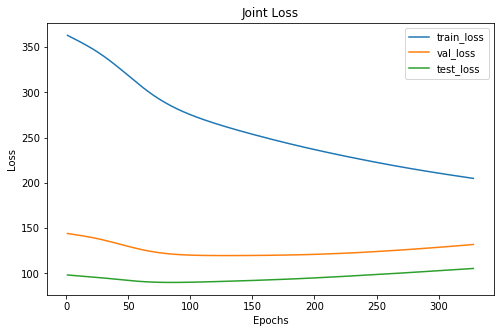

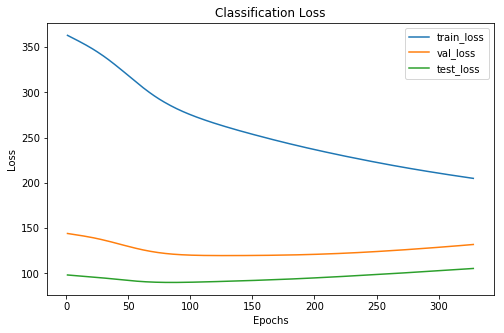

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      126     44      42
 2       85     36      19
xxxxxxxxxxxxxx epoch: 328 xxxxxxxxxxxxxx


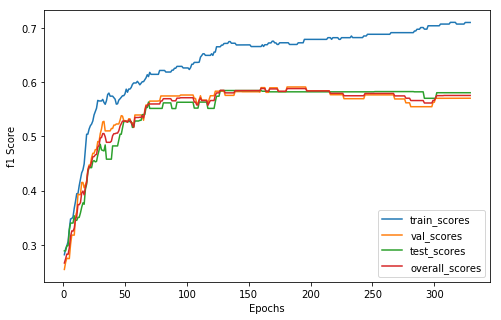

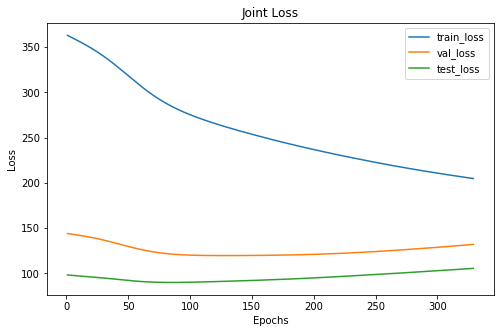

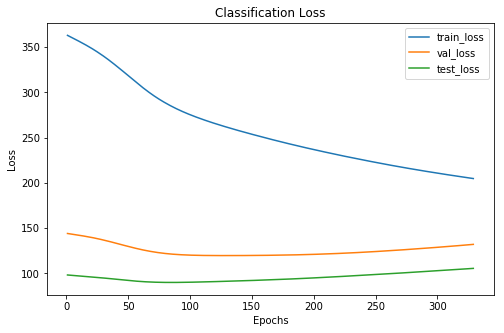

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      126     44      42
 2       85     36      19
xxxxxxxxxxxxxx epoch: 329 xxxxxxxxxxxxxx


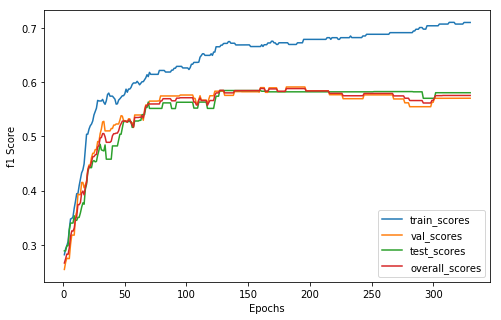

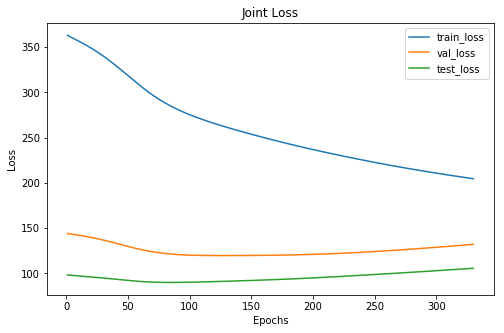

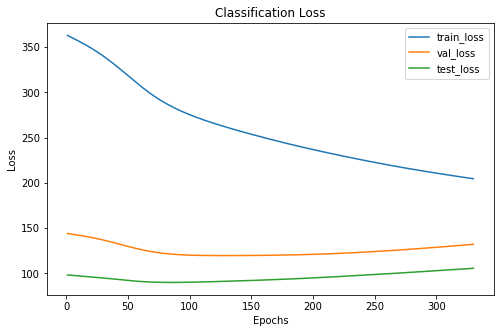

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      126     44      42
 2       85     36      19
xxxxxxxxxxxxxx epoch: 330 xxxxxxxxxxxxxx


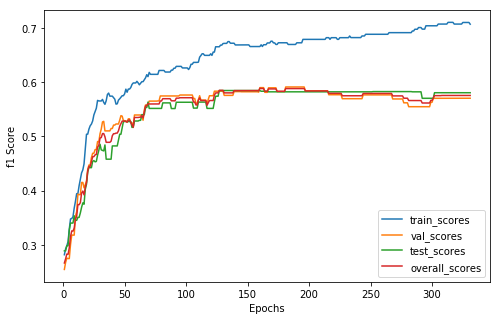

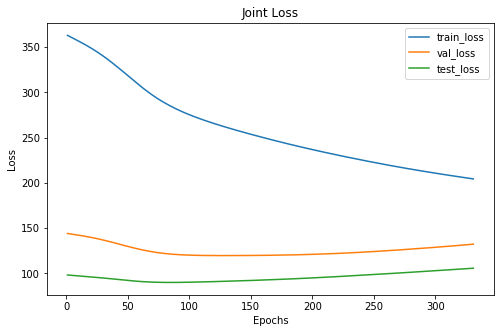

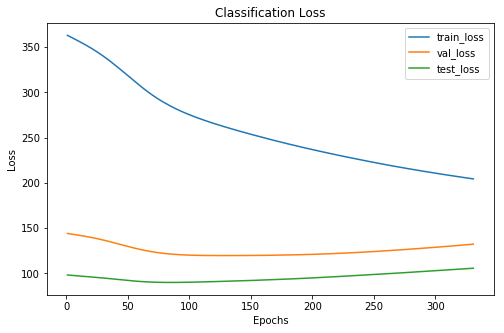

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     44      42
 2       84     36      19
xxxxxxxxxxxxxx epoch: 331 xxxxxxxxxxxxxx


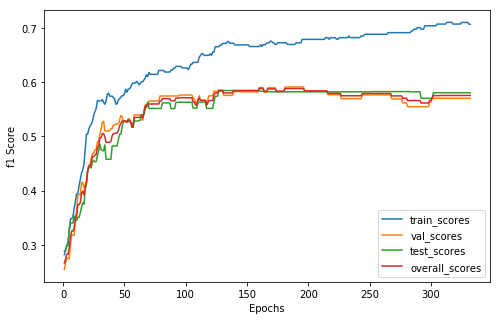

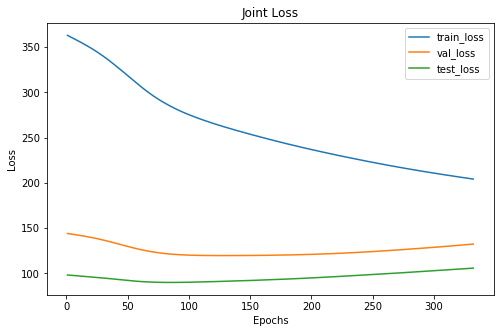

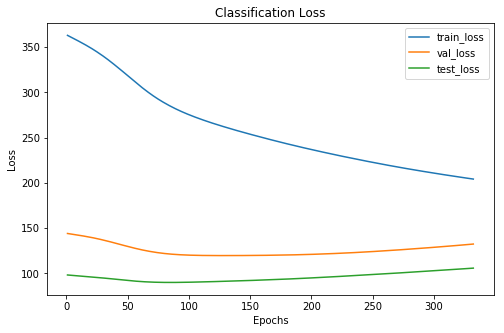

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     44      42
 2       84     36      19
xxxxxxxxxxxxxx epoch: 332 xxxxxxxxxxxxxx


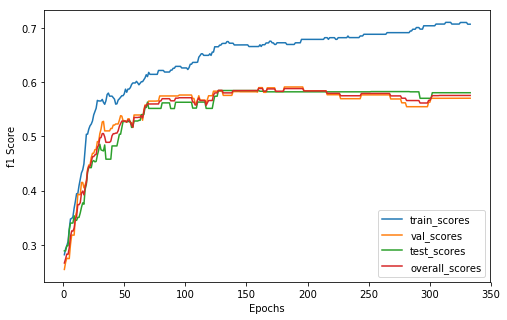

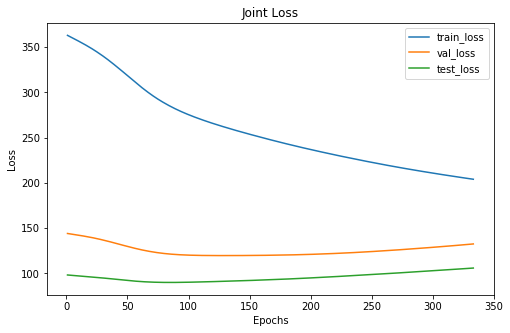

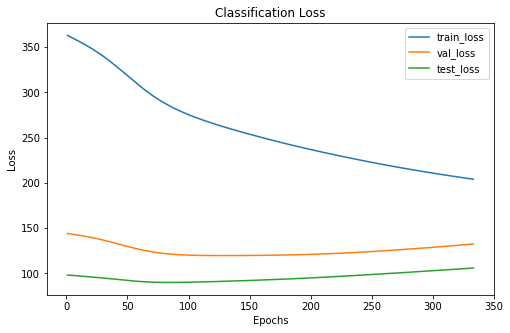

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     44      42
 2       84     36      19
xxxxxxxxxxxxxx epoch: 333 xxxxxxxxxxxxxx


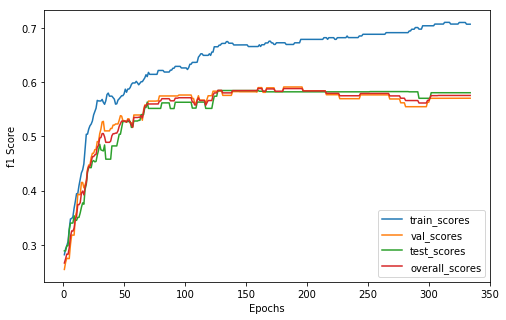

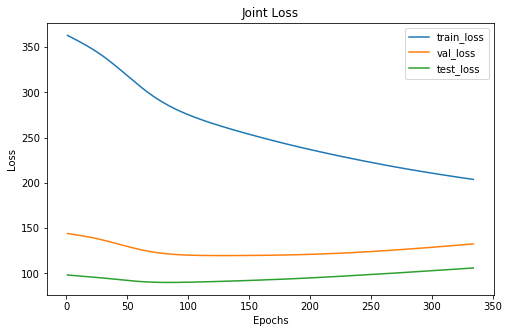

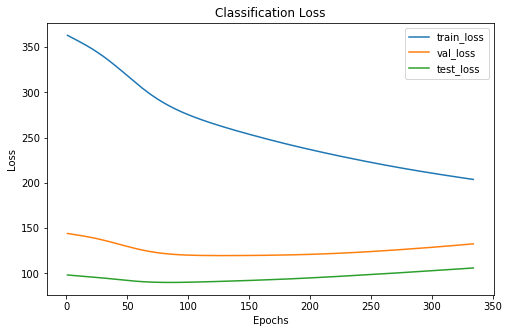

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     44      42
 2       84     36      19
xxxxxxxxxxxxxx epoch: 334 xxxxxxxxxxxxxx


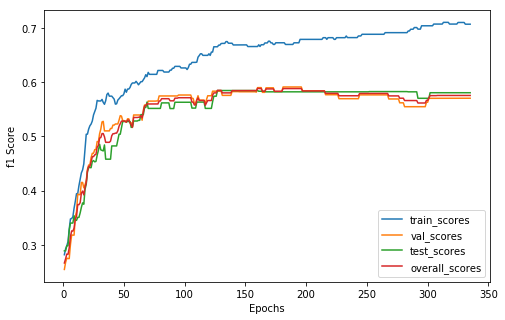

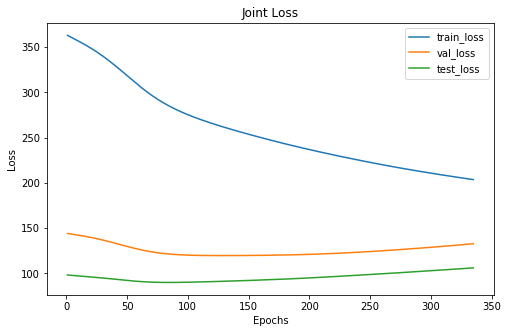

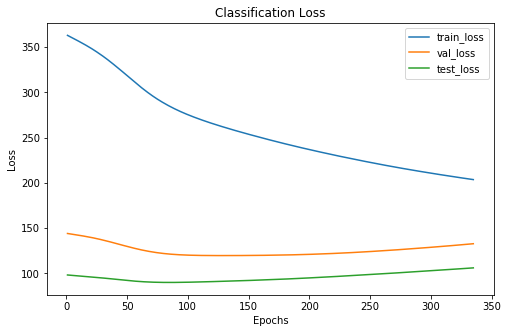

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     44      42
 2       84     36      19
xxxxxxxxxxxxxx epoch: 335 xxxxxxxxxxxxxx


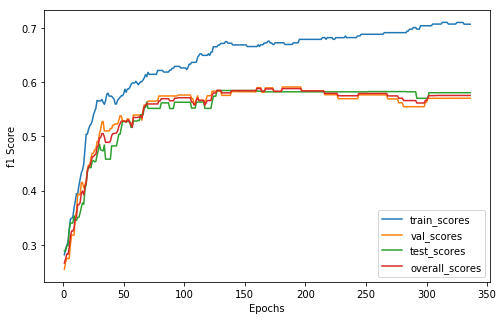

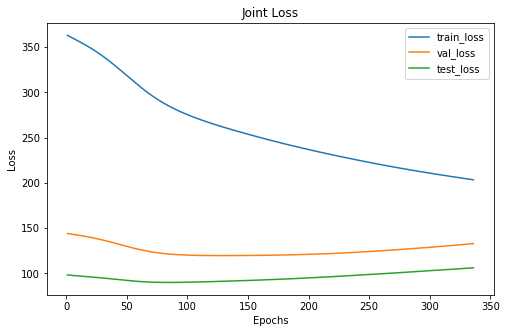

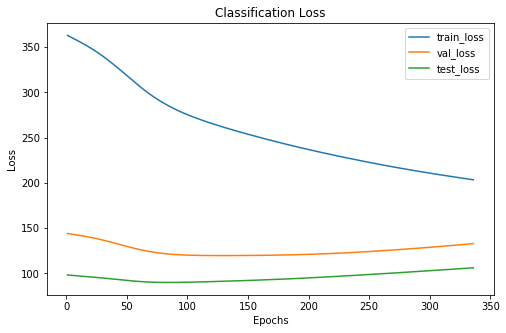

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     44      42
 2       84     36      19
xxxxxxxxxxxxxx epoch: 336 xxxxxxxxxxxxxx


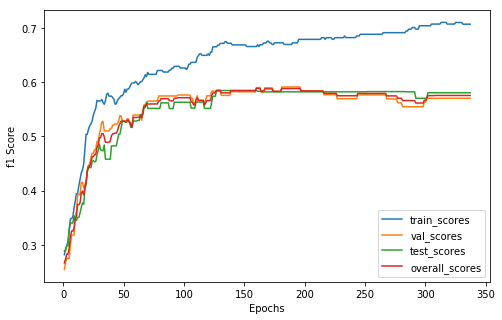

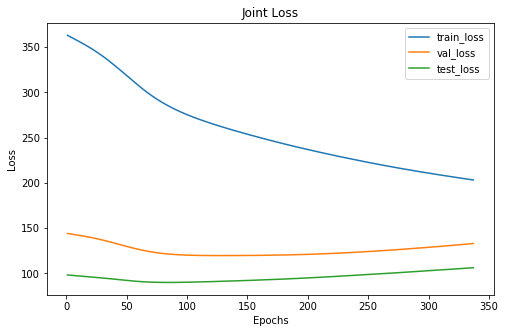

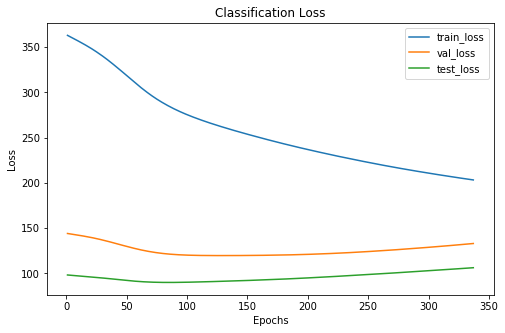

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     44      42
 2       84     36      19
xxxxxxxxxxxxxx epoch: 337 xxxxxxxxxxxxxx


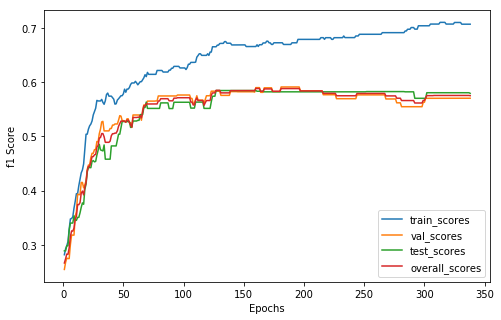

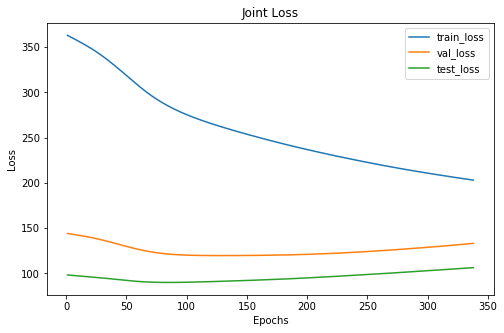

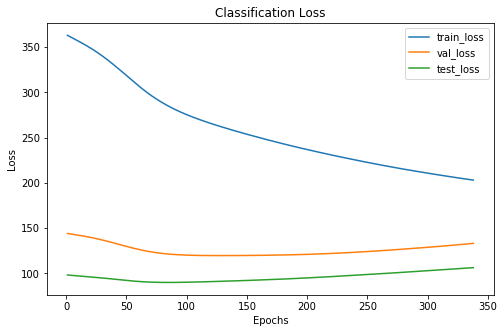

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     44      43
 2       84     36      18
xxxxxxxxxxxxxx epoch: 338 xxxxxxxxxxxxxx


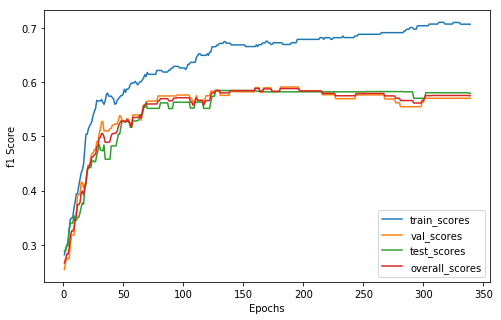

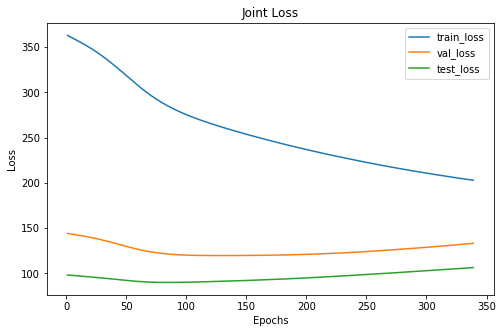

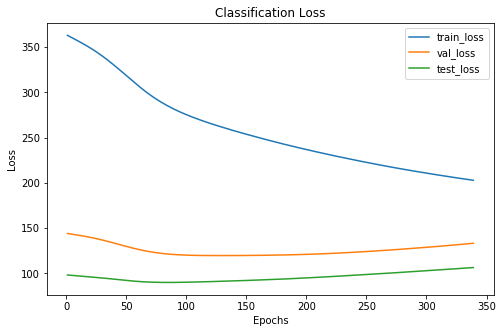

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     44      43
 2       84     36      18
xxxxxxxxxxxxxx epoch: 339 xxxxxxxxxxxxxx


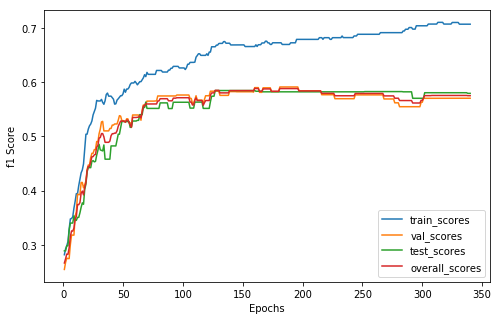

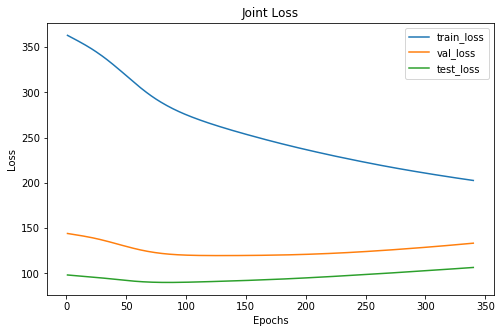

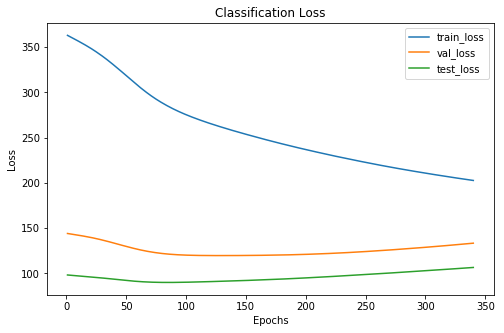

Cofusion Matrix For Val Set: 
--  --  --
30  14   9
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     44      43
 2       84     36      18
xxxxxxxxxxxxxx epoch: 340 xxxxxxxxxxxxxx


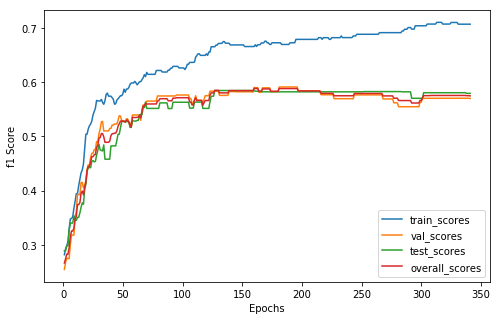

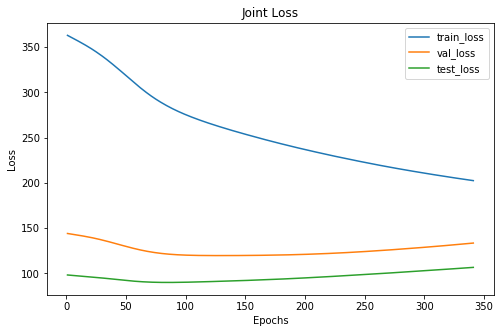

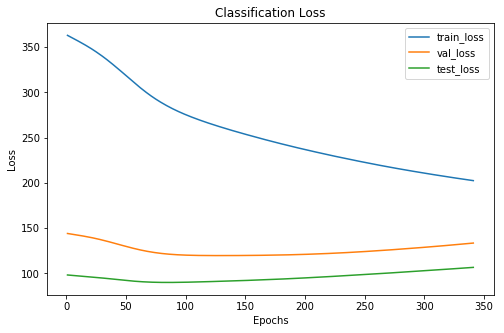

Cofusion Matrix For Val Set: 
--  --  --
30  15   8
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     45      43
 2       84     35      18
xxxxxxxxxxxxxx epoch: 341 xxxxxxxxxxxxxx


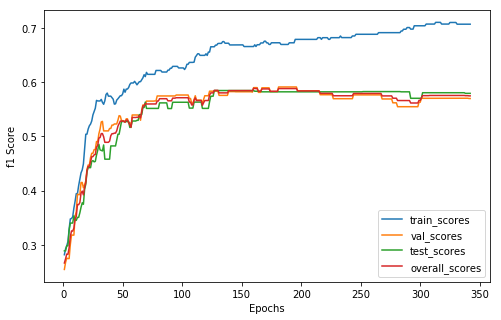

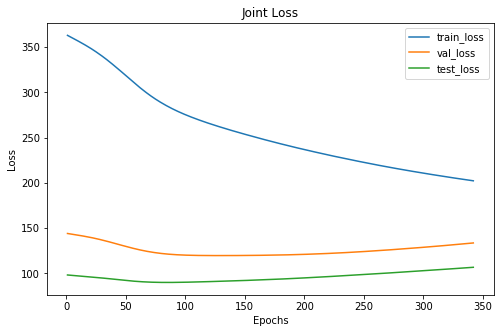

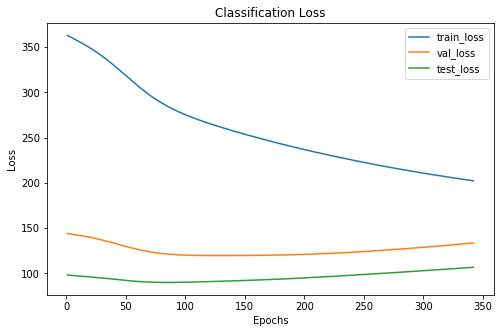

Cofusion Matrix For Val Set: 
--  --  --
30  15   8
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     45      43
 2       84     35      18
xxxxxxxxxxxxxx epoch: 342 xxxxxxxxxxxxxx


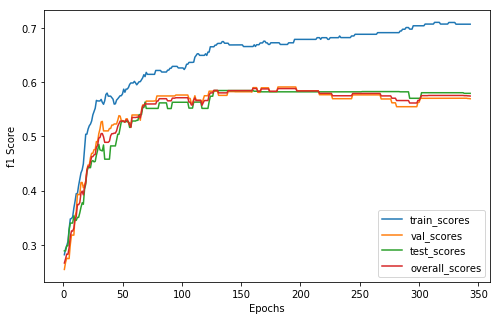

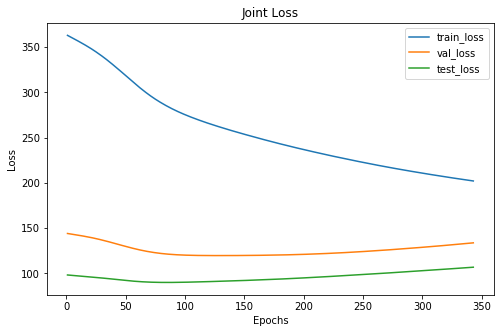

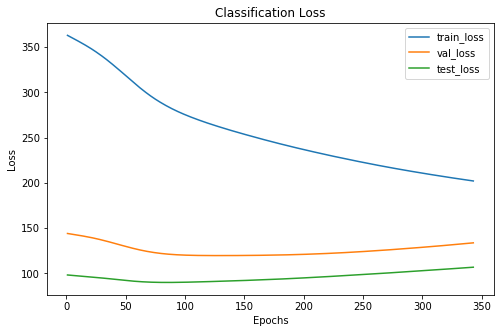

Cofusion Matrix For Val Set: 
--  --  --
30  16   7
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     46      43
 2       84     34      18
xxxxxxxxxxxxxx epoch: 343 xxxxxxxxxxxxxx


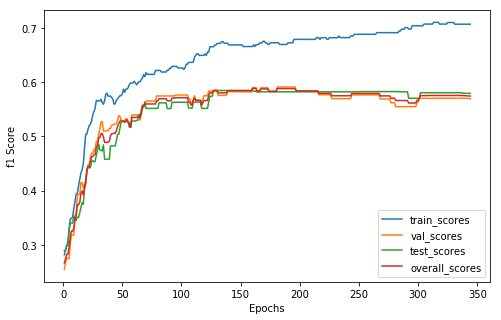

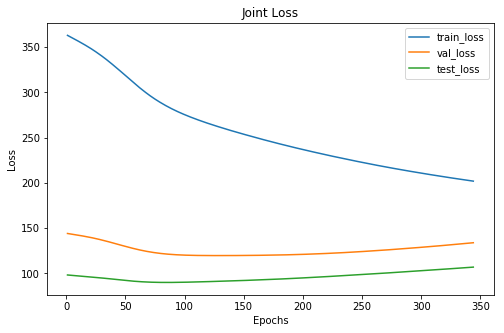

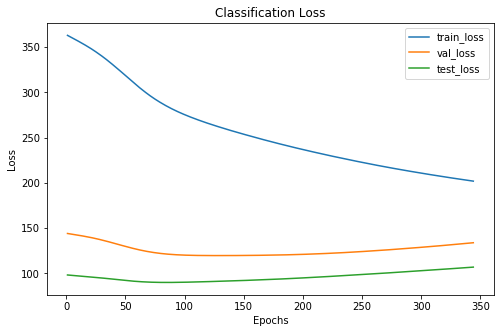

Cofusion Matrix For Val Set: 
--  --  --
30  16   7
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      127     46      43
 2       84     34      18
xxxxxxxxxxxxxx epoch: 344 xxxxxxxxxxxxxx


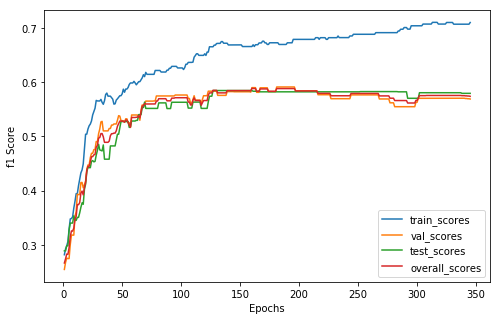

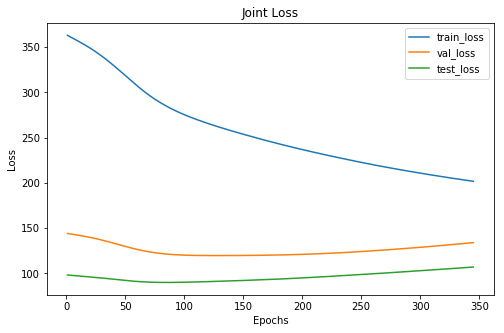

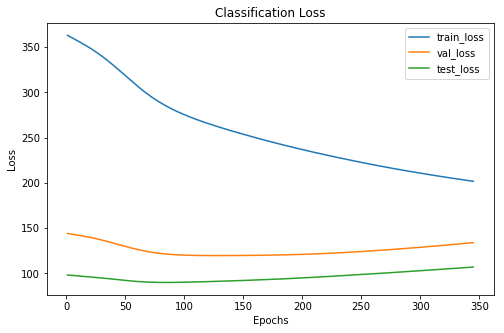

Cofusion Matrix For Val Set: 
--  --  --
30  18   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      128     48      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 345 xxxxxxxxxxxxxx


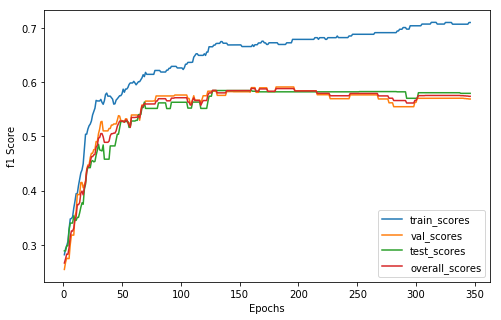

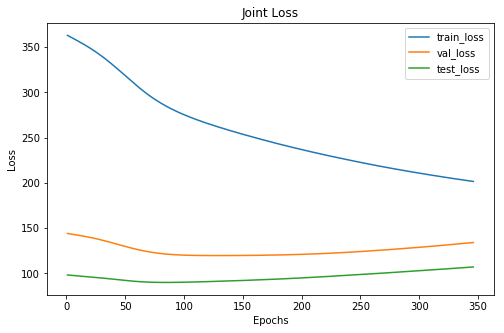

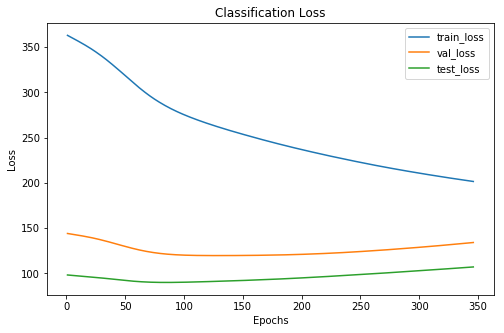

Cofusion Matrix For Val Set: 
--  --  --
30  18   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      128     48      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 346 xxxxxxxxxxxxxx


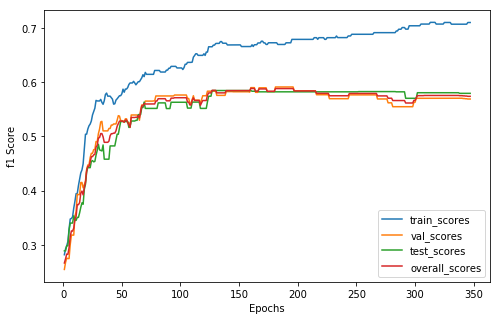

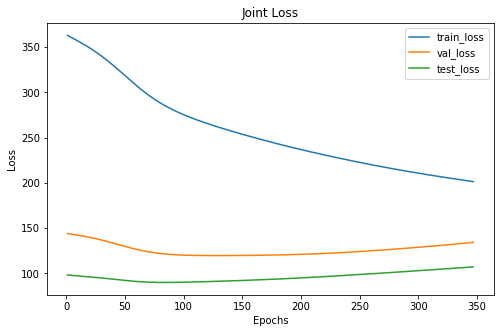

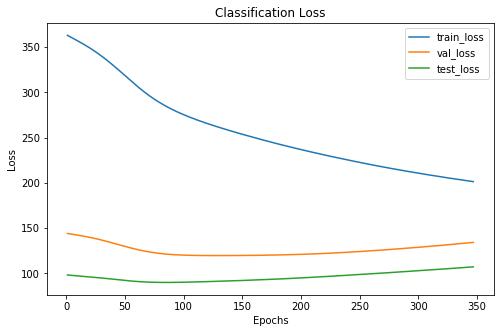

Cofusion Matrix For Val Set: 
--  --  --
30  18   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      128     48      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 347 xxxxxxxxxxxxxx


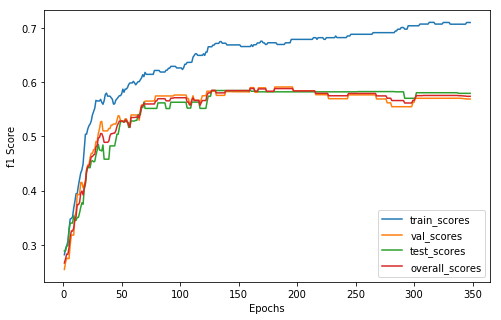

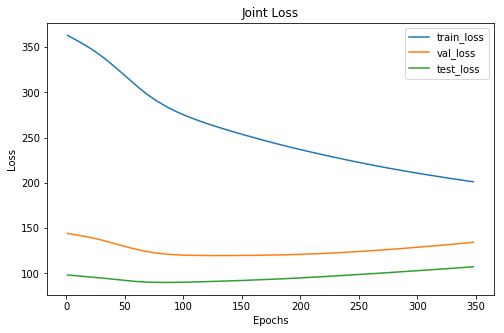

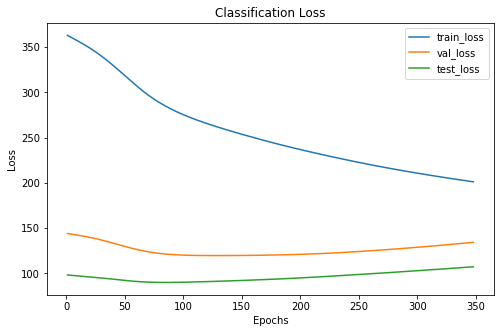

Cofusion Matrix For Val Set: 
--  --  --
30  18   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      128     48      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 348 xxxxxxxxxxxxxx


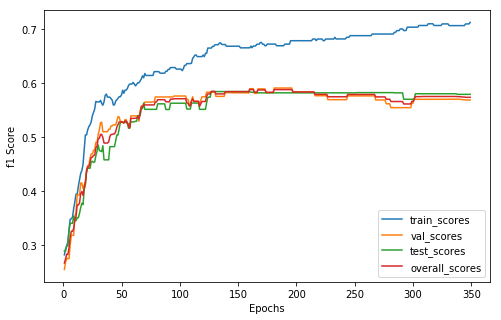

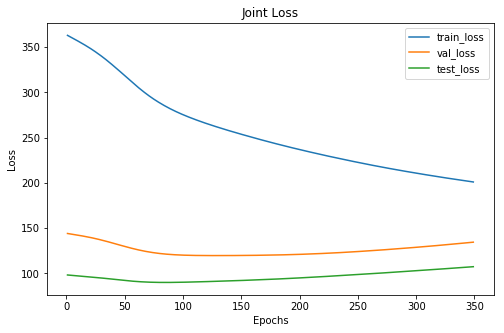

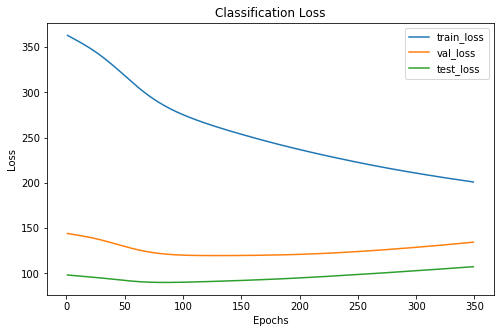

Cofusion Matrix For Val Set: 
--  --  --
30  18   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      115     50      27
 1      129     48      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 349 xxxxxxxxxxxxxx


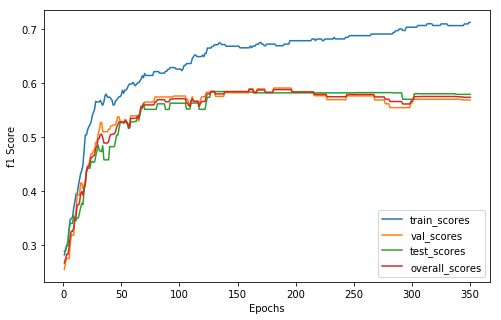

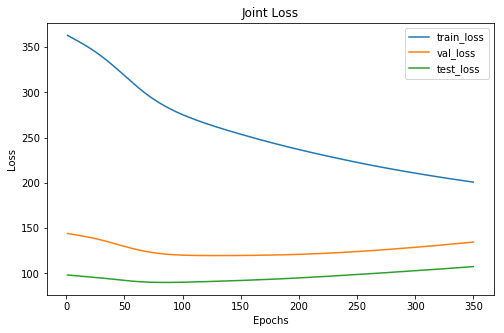

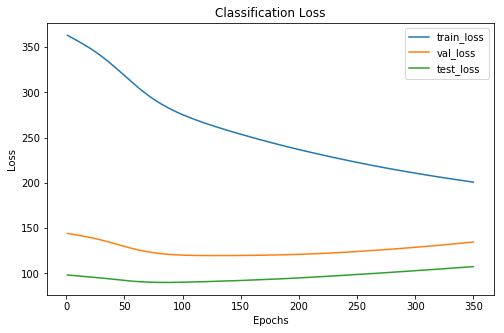

Cofusion Matrix For Val Set: 
--  --  --
30  18   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      115     50      27
 1      129     48      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 350 xxxxxxxxxxxxxx


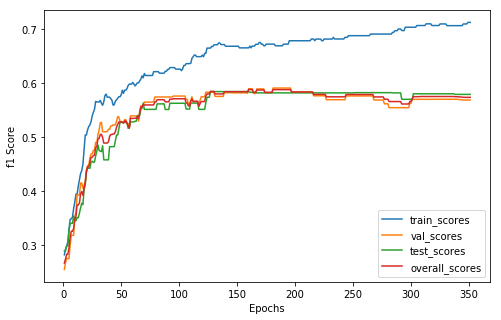

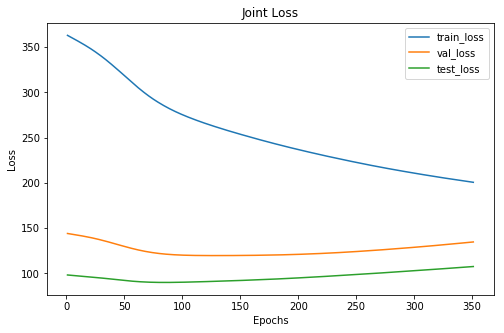

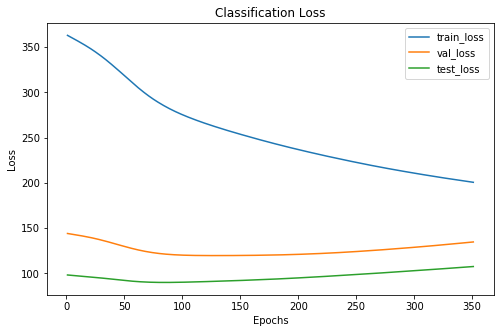

Cofusion Matrix For Val Set: 
--  --  --
30  18   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      128     48      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 351 xxxxxxxxxxxxxx


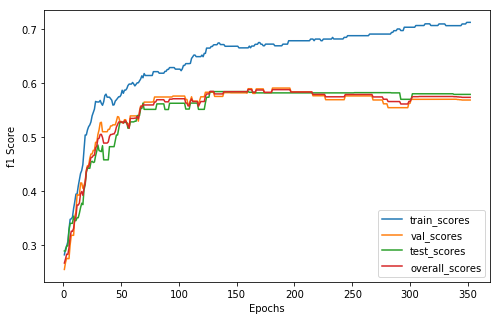

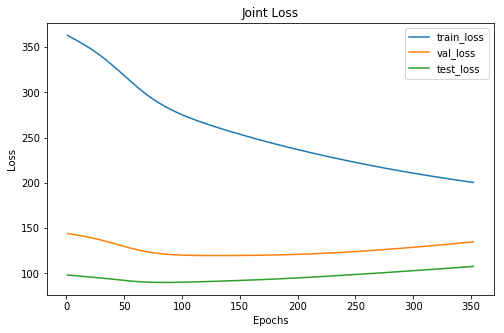

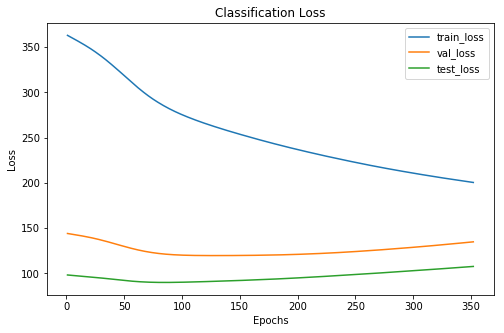

Cofusion Matrix For Val Set: 
--  --  --
30  18   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     50      27
 1      128     48      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 352 xxxxxxxxxxxxxx


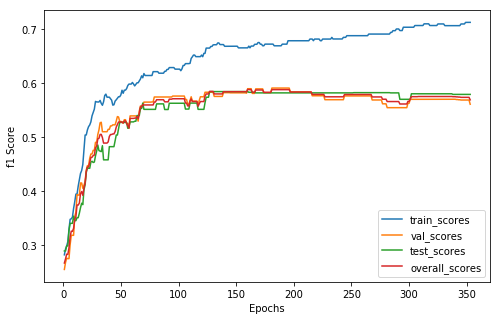

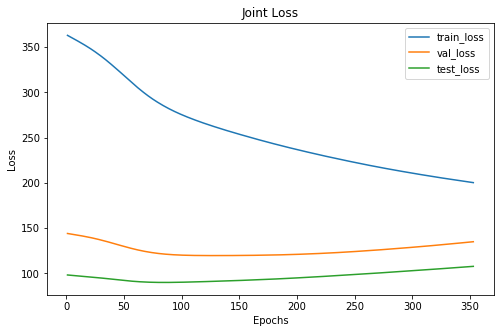

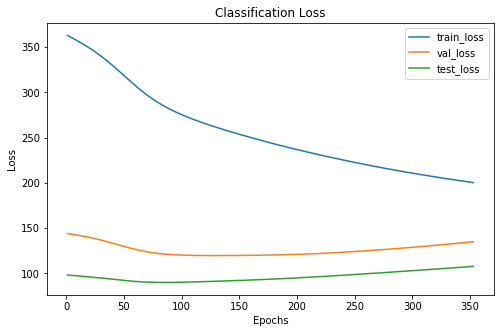

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     49      27
 1      128     49      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 353 xxxxxxxxxxxxxx


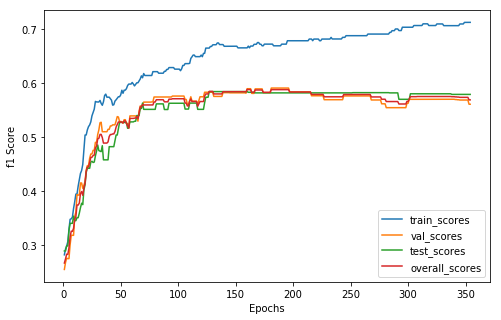

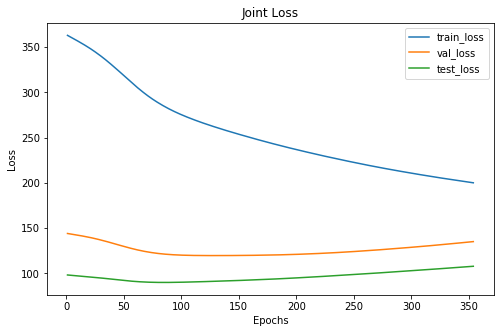

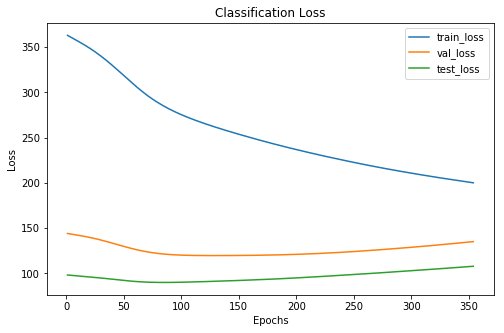

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     49      27
 1      128     49      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 354 xxxxxxxxxxxxxx


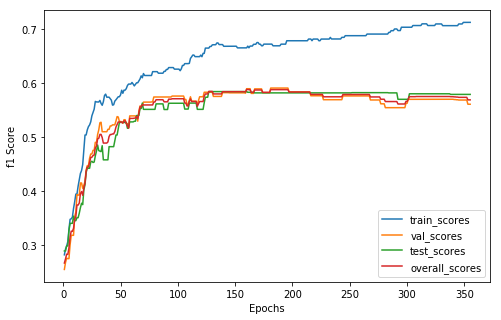

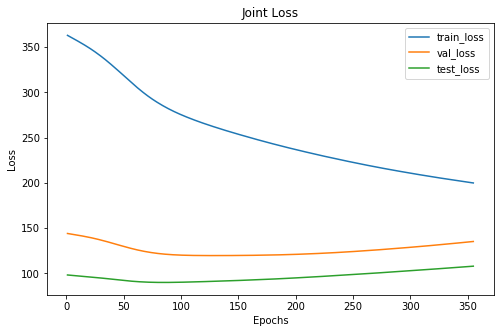

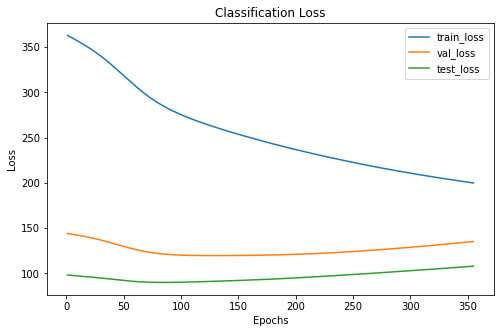

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     49      27
 1      128     49      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 355 xxxxxxxxxxxxxx


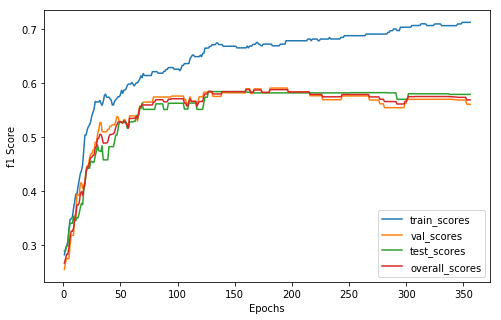

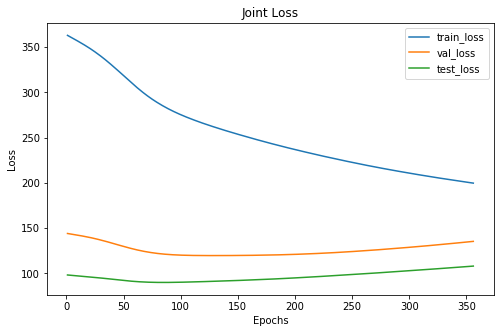

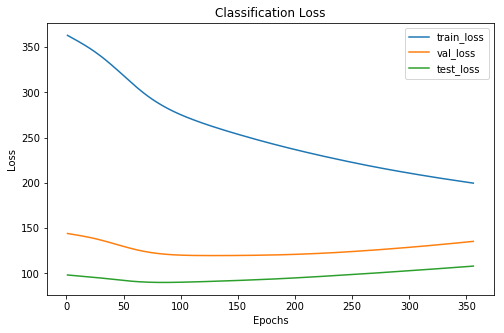

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     49      27
 1      128     49      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 356 xxxxxxxxxxxxxx


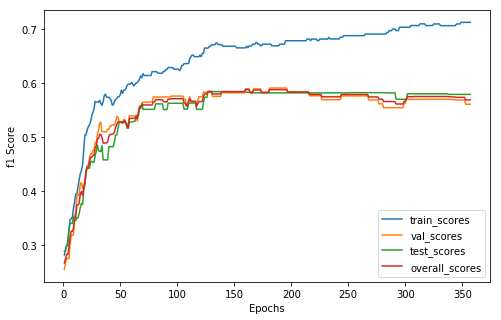

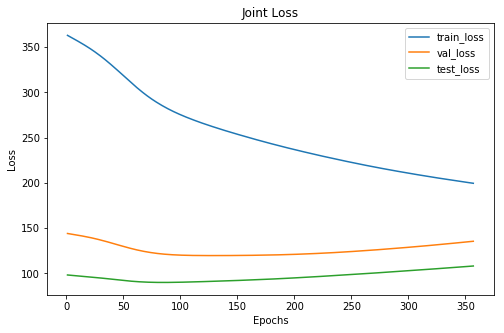

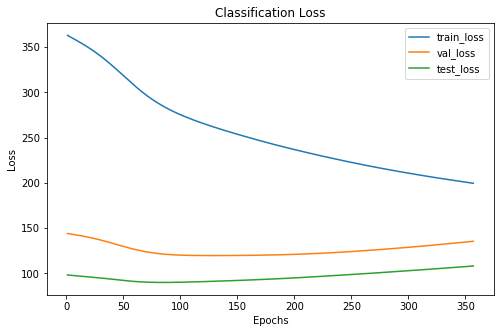

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     49      27
 1      128     49      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 357 xxxxxxxxxxxxxx


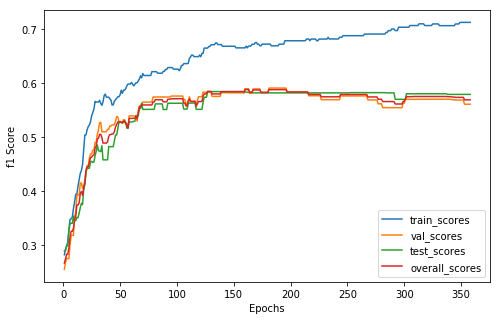

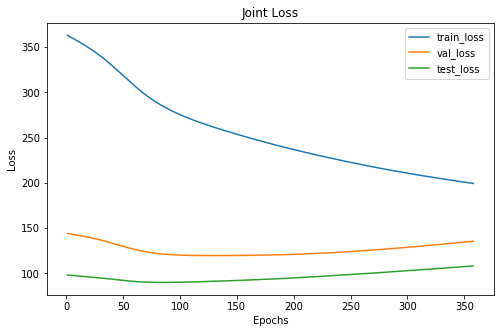

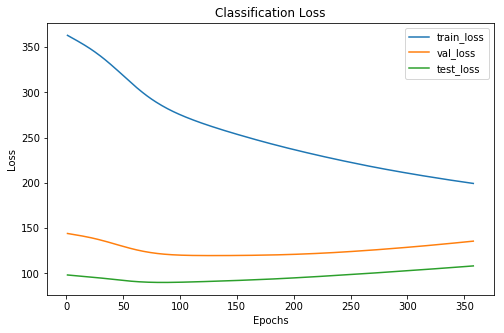

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     49      27
 1      128     49      43
 2       83     32      18
xxxxxxxxxxxxxx epoch: 358 xxxxxxxxxxxxxx


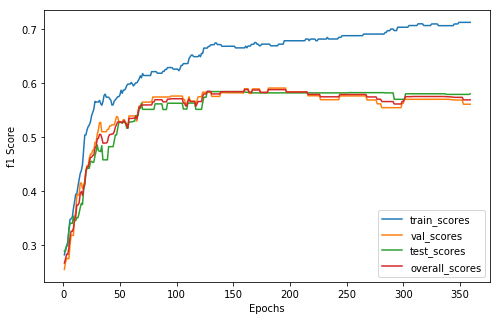

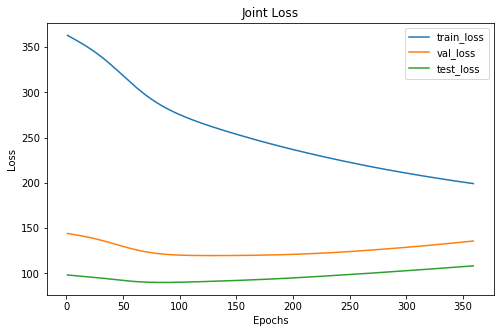

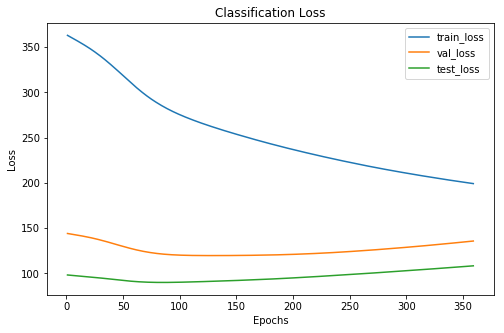

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     49      26
 1      128     49      43
 2       83     32      19
xxxxxxxxxxxxxx epoch: 359 xxxxxxxxxxxxxx


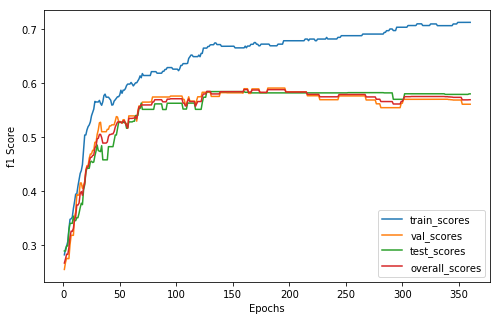

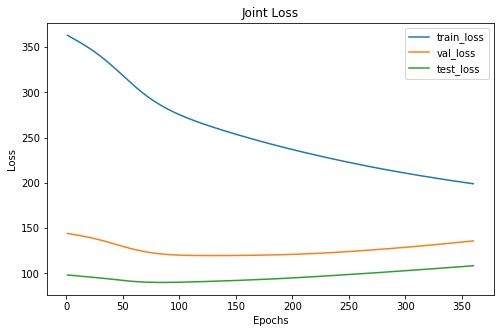

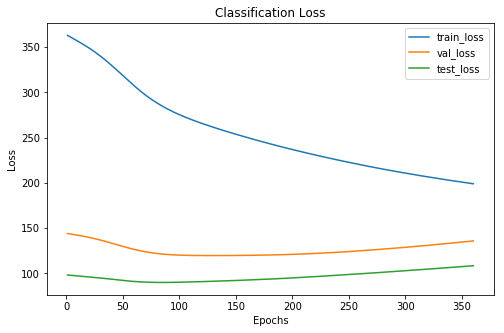

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     49      26
 1      128     49      43
 2       83     32      19
xxxxxxxxxxxxxx epoch: 360 xxxxxxxxxxxxxx


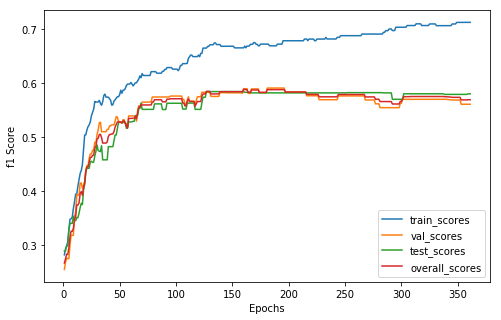

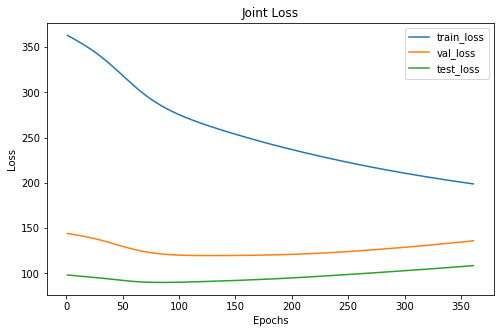

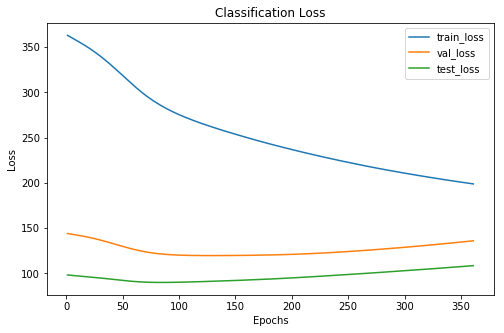

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     49      26
 1      128     49      43
 2       83     32      19
xxxxxxxxxxxxxx epoch: 361 xxxxxxxxxxxxxx


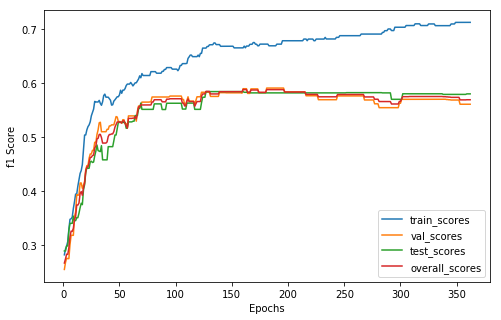

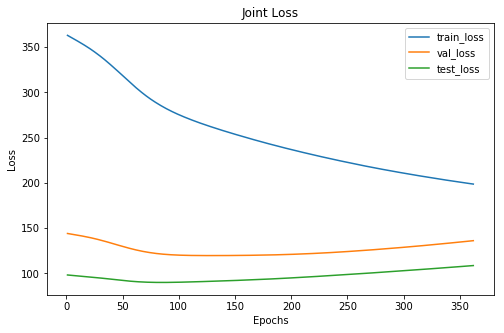

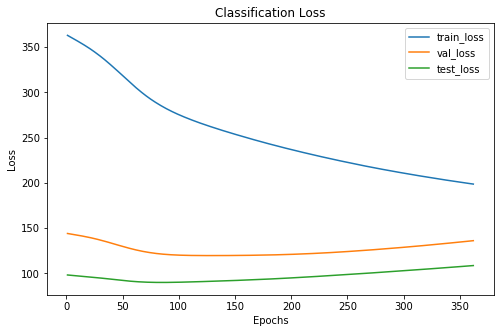

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      116     49      26
 1      128     49      43
 2       83     32      19
xxxxxxxxxxxxxx epoch: 362 xxxxxxxxxxxxxx


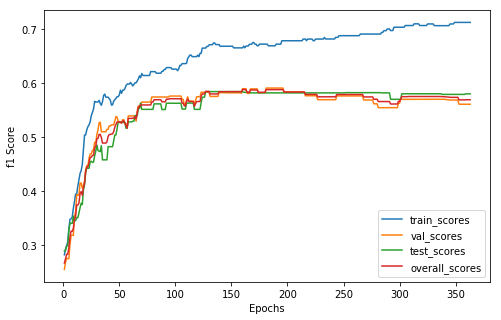

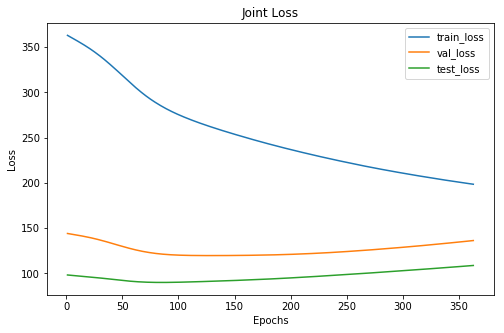

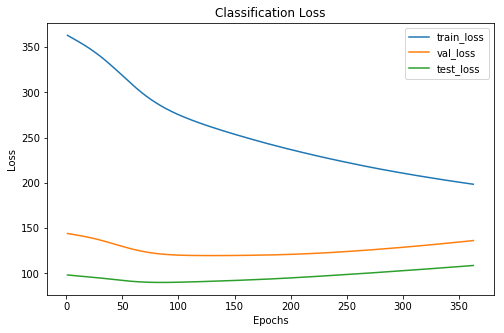

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      115     49      26
 1      129     49      43
 2       83     32      19
xxxxxxxxxxxxxx epoch: 363 xxxxxxxxxxxxxx


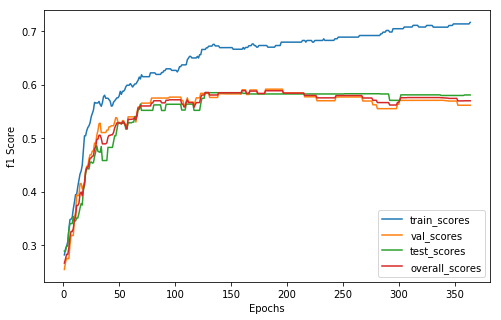

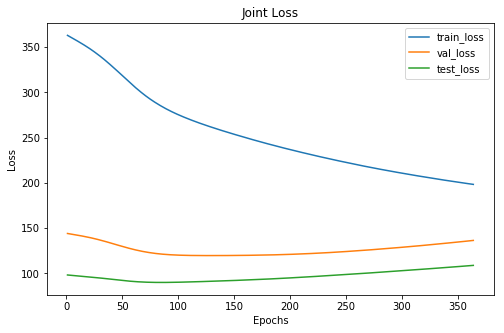

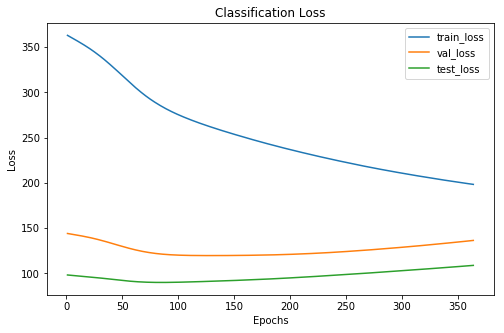

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     49      26
 1      130     49      43
 2       83     32      19
xxxxxxxxxxxxxx epoch: 364 xxxxxxxxxxxxxx


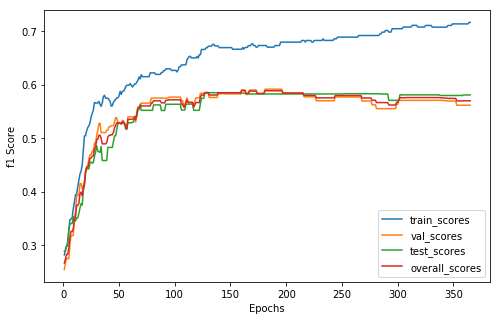

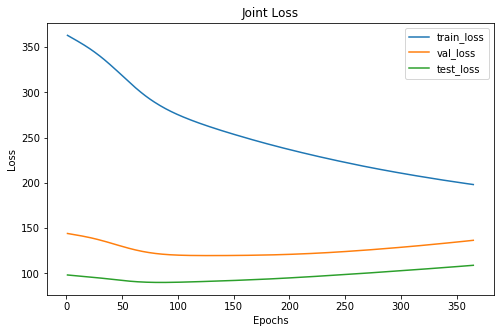

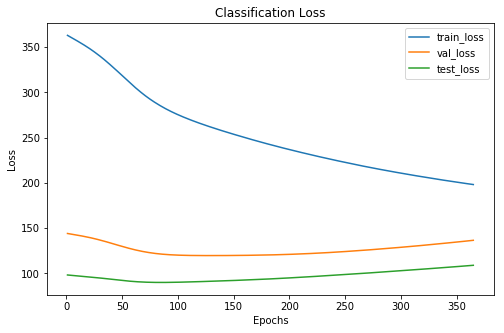

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     49      26
 1      130     49      43
 2       83     32      19
xxxxxxxxxxxxxx epoch: 365 xxxxxxxxxxxxxx


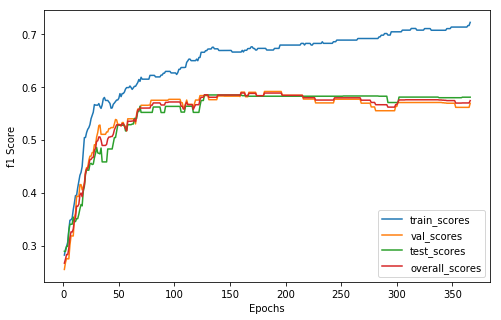

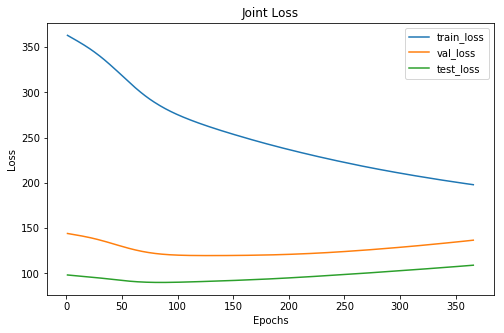

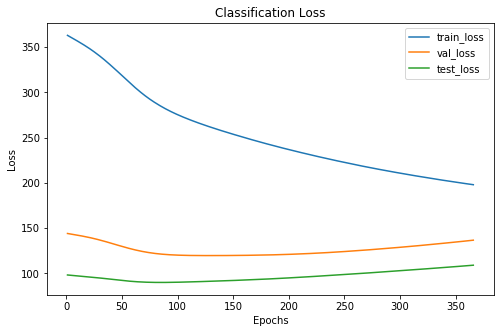

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     49      26
 1      132     50      43
 2       82     31      19
xxxxxxxxxxxxxx epoch: 366 xxxxxxxxxxxxxx


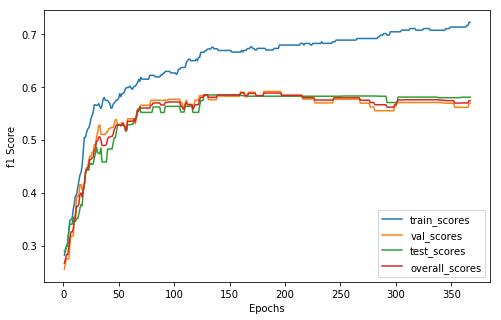

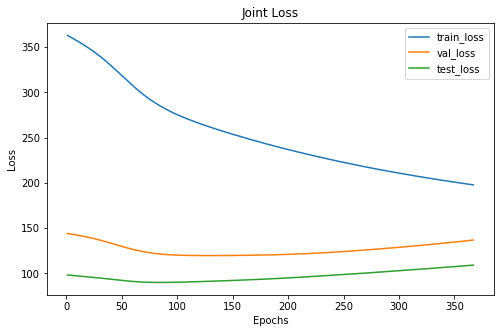

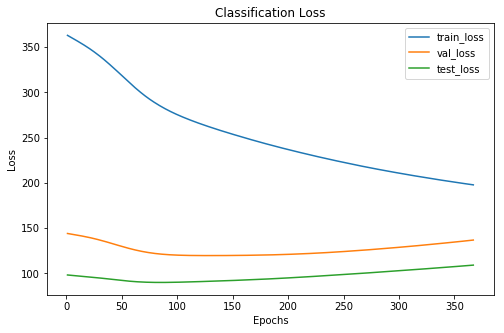

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     49      26
 1      132     50      43
 2       82     31      19
xxxxxxxxxxxxxx epoch: 367 xxxxxxxxxxxxxx


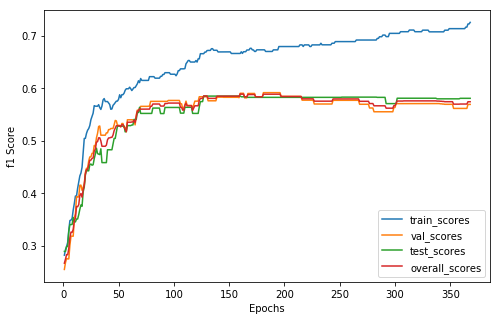

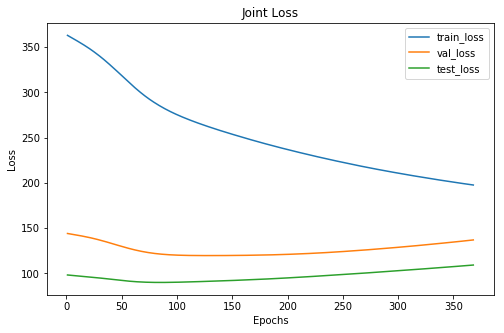

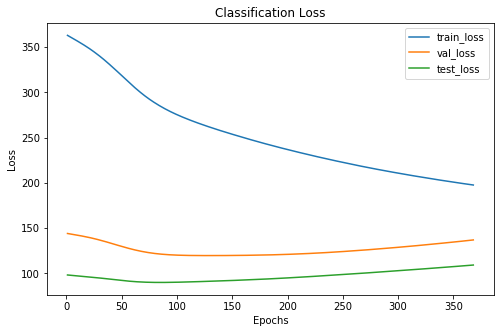

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     49      26
 1      133     50      43
 2       81     31      19
xxxxxxxxxxxxxx epoch: 368 xxxxxxxxxxxxxx


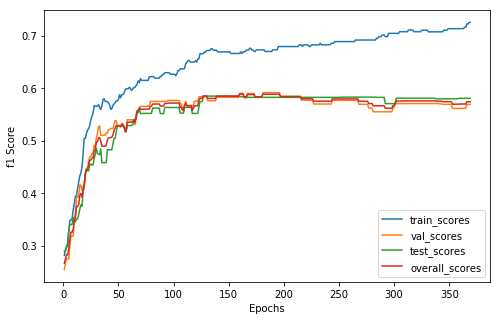

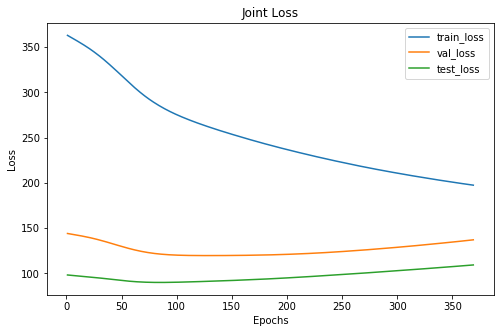

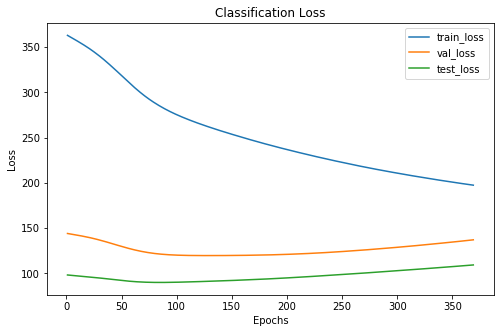

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     49      26
 1      133     50      43
 2       81     31      19
xxxxxxxxxxxxxx epoch: 369 xxxxxxxxxxxxxx


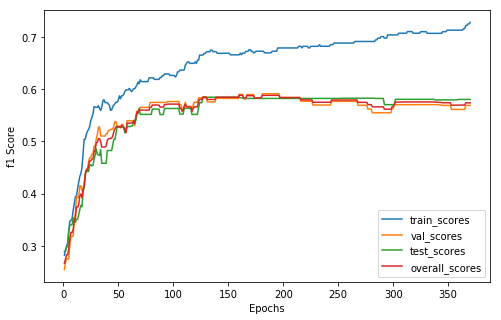

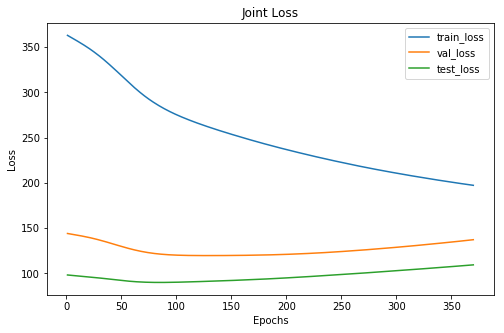

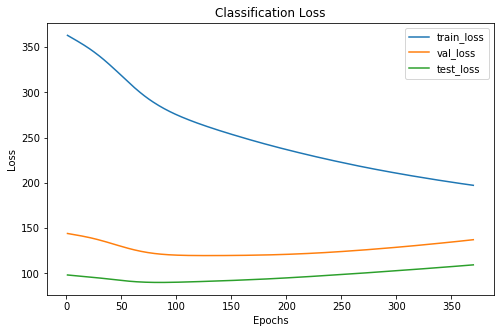

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     49      26
 1      132     50      43
 2       81     31      19
xxxxxxxxxxxxxx epoch: 370 xxxxxxxxxxxxxx


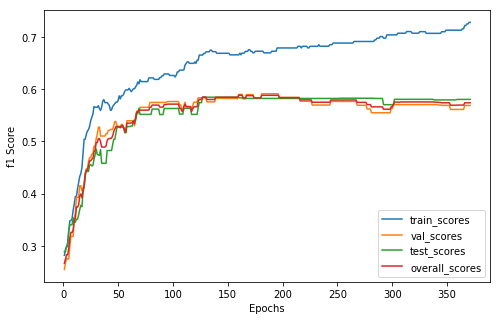

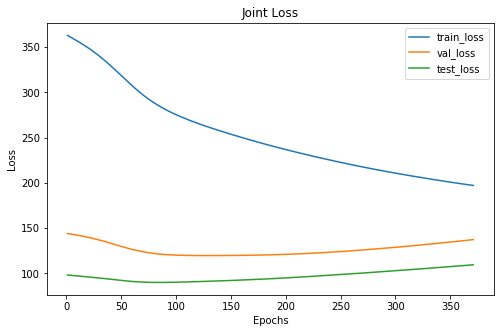

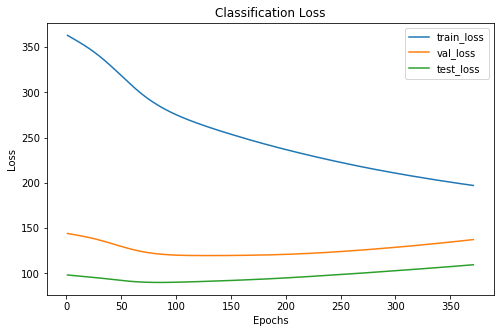

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     49      26
 1      132     50      43
 2       81     31      19
xxxxxxxxxxxxxx epoch: 371 xxxxxxxxxxxxxx


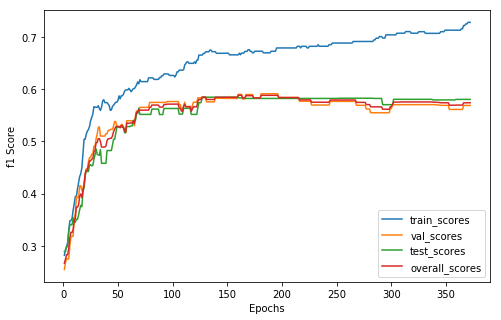

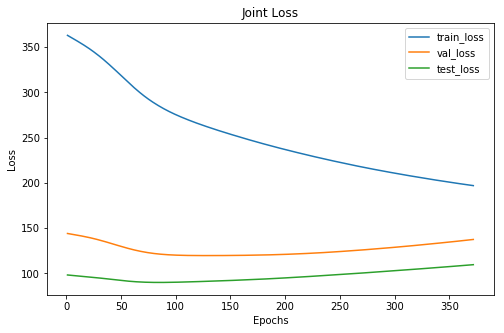

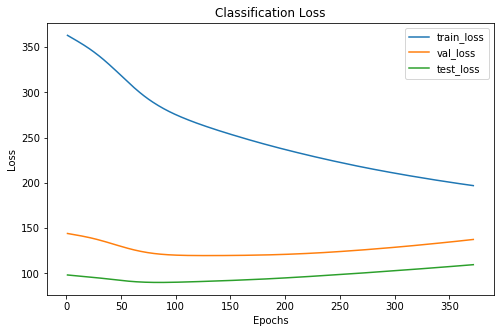

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     49      26
 1      132     50      43
 2       81     31      19
xxxxxxxxxxxxxx epoch: 372 xxxxxxxxxxxxxx


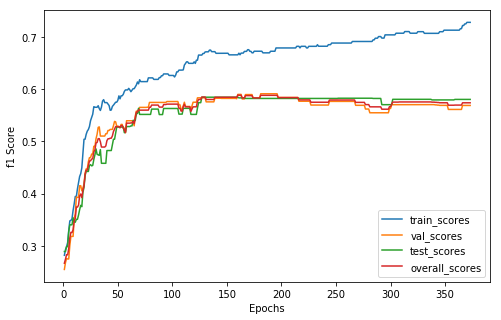

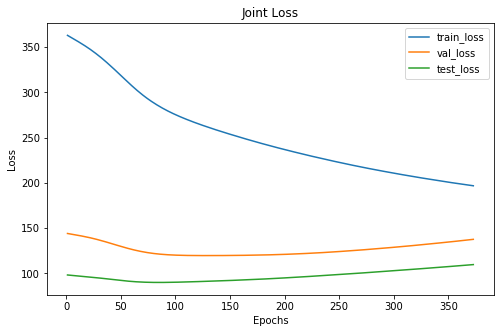

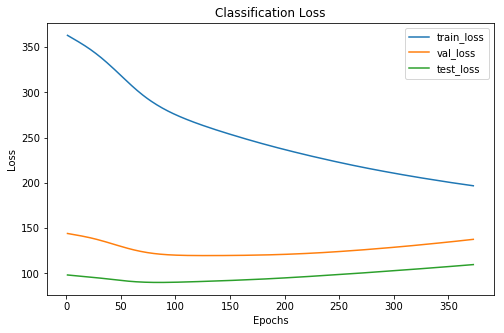

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     49      26
 1      132     50      43
 2       81     31      19
xxxxxxxxxxxxxx epoch: 373 xxxxxxxxxxxxxx


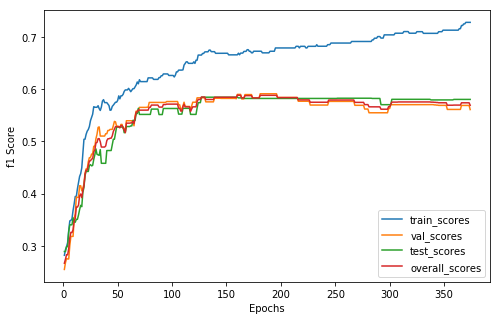

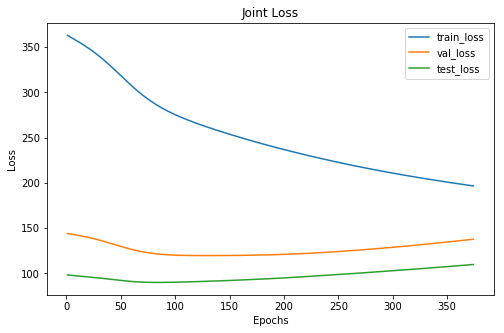

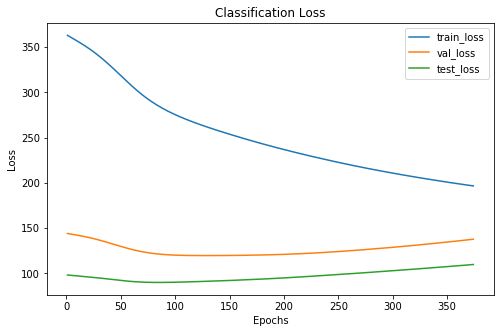

Cofusion Matrix For Val Set: 
--  --  --
28  20   5
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     48      26
 1      132     51      43
 2       81     31      19
xxxxxxxxxxxxxx epoch: 374 xxxxxxxxxxxxxx


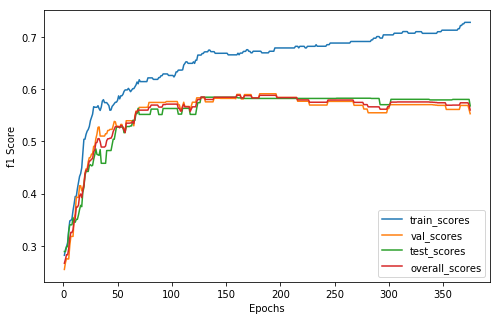

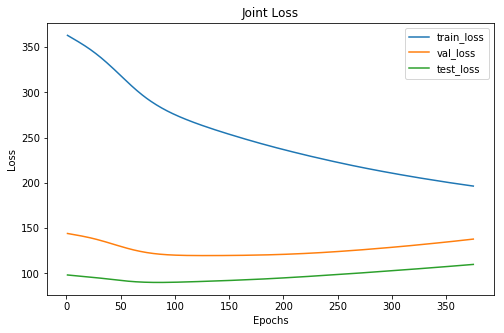

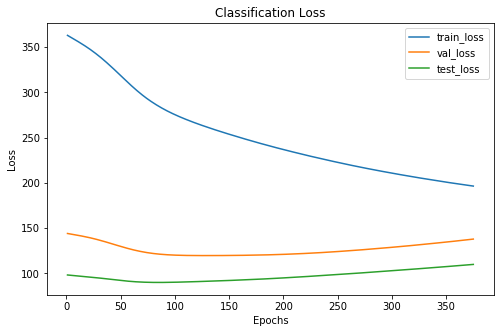

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     47      26
 1      132     51      44
 2       81     32      18
xxxxxxxxxxxxxx epoch: 375 xxxxxxxxxxxxxx


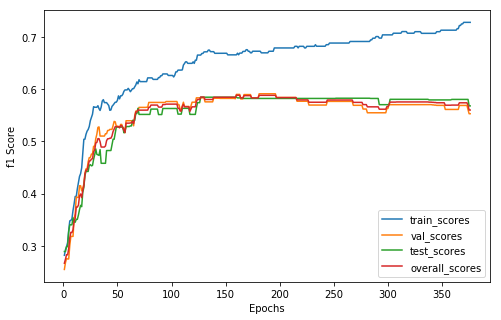

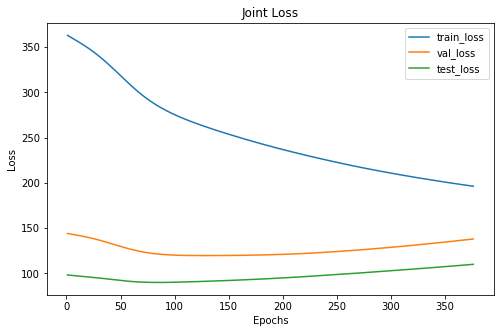

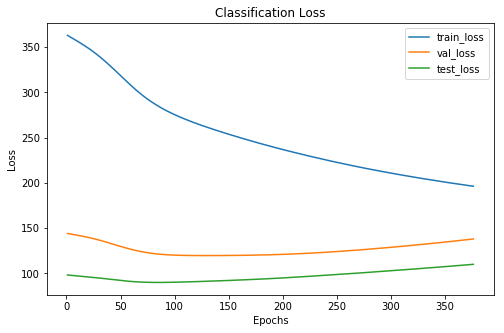

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     47      26
 1      132     51      44
 2       81     32      18
xxxxxxxxxxxxxx epoch: 376 xxxxxxxxxxxxxx


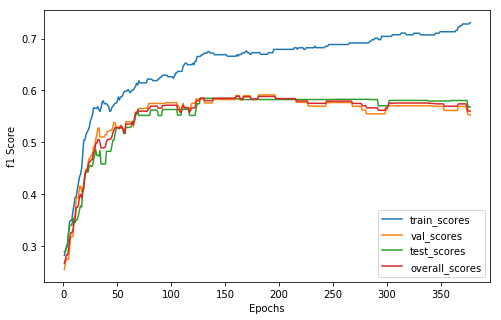

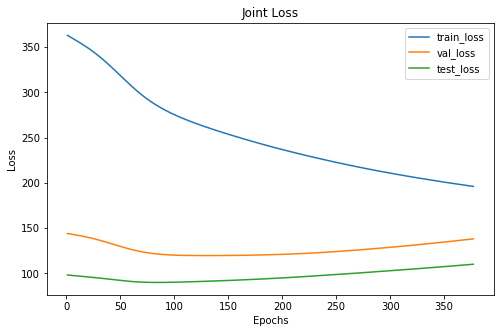

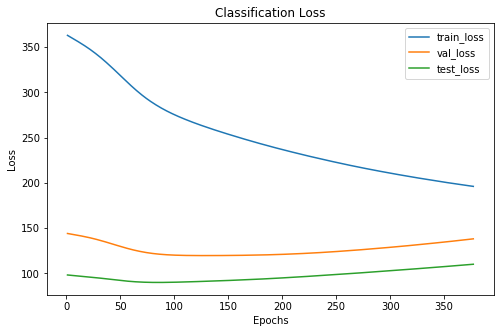

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      114     47      26
 1      133     51      44
 2       80     32      18
xxxxxxxxxxxxxx epoch: 377 xxxxxxxxxxxxxx


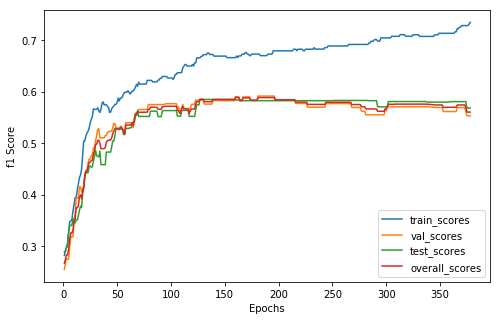

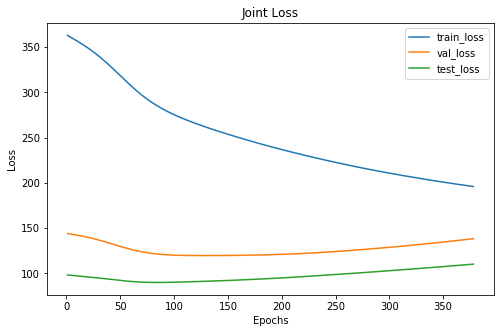

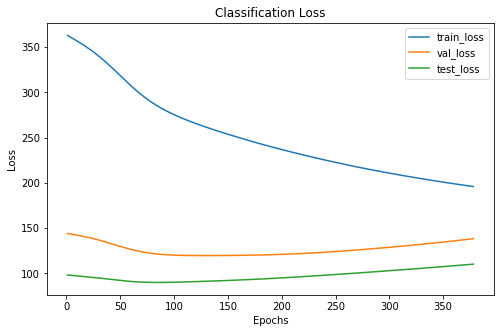

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      113     47      26
 1      133     51      44
 2       81     32      18
xxxxxxxxxxxxxx epoch: 378 xxxxxxxxxxxxxx


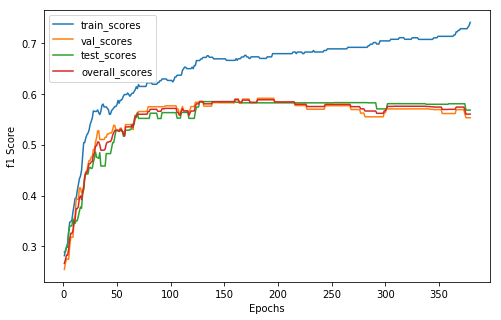

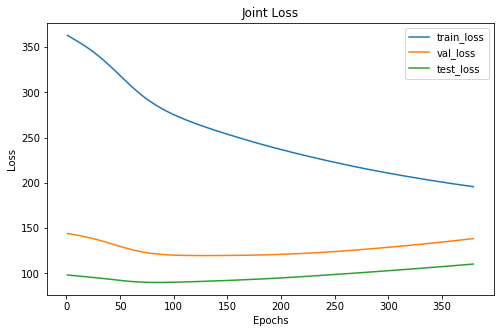

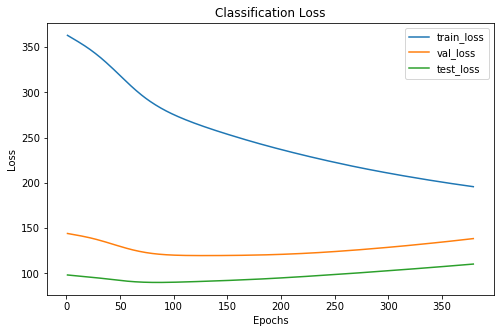

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     51      44
 2       81     32      18
xxxxxxxxxxxxxx epoch: 379 xxxxxxxxxxxxxx


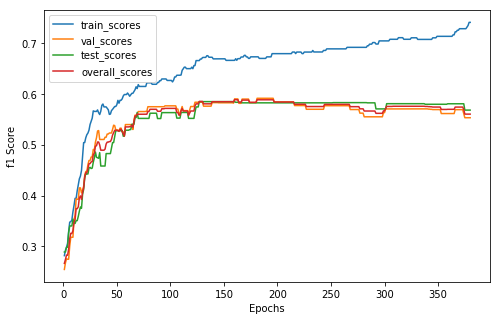

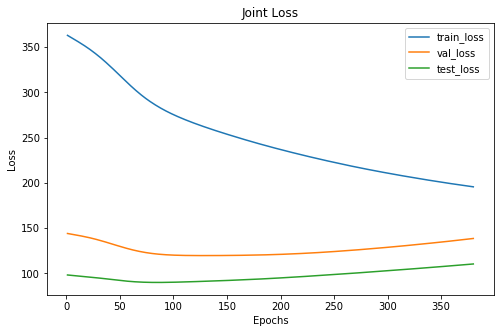

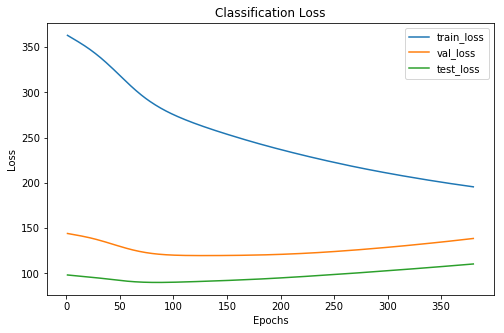

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  28   9
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     51      44
 2       81     32      18
xxxxxxxxxxxxxx epoch: 380 xxxxxxxxxxxxxx


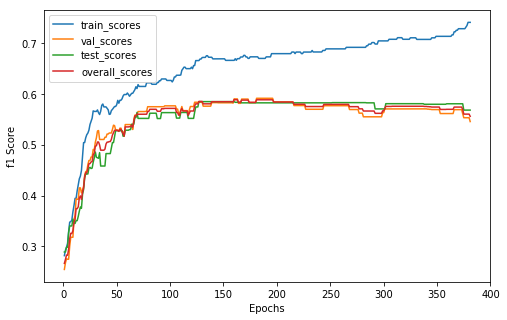

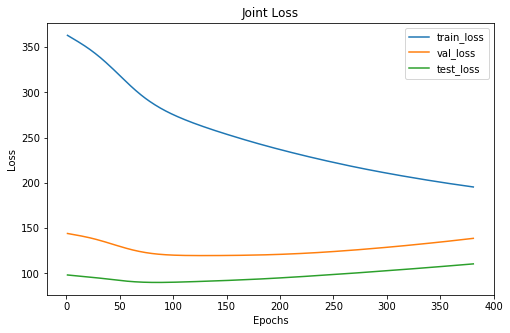

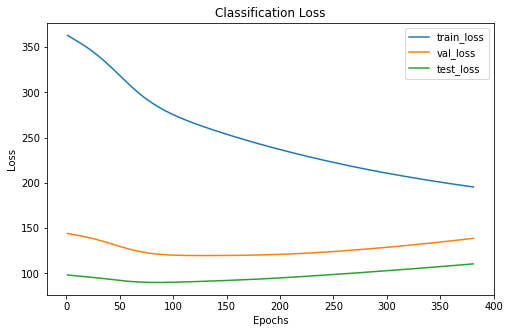

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     50      44
 2       81     33      18
xxxxxxxxxxxxxx epoch: 381 xxxxxxxxxxxxxx


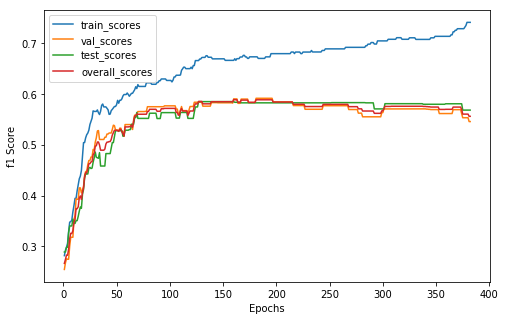

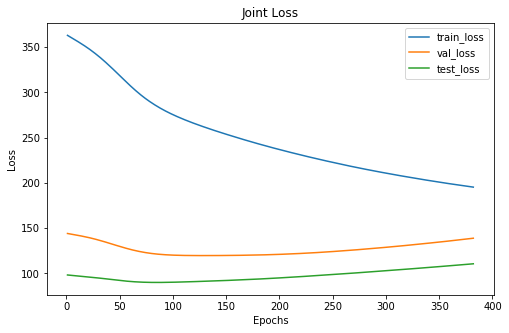

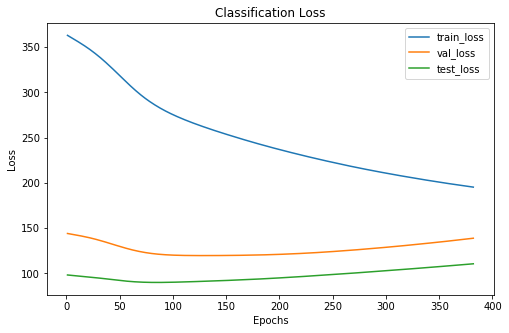

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     50      44
 2       81     33      18
xxxxxxxxxxxxxx epoch: 382 xxxxxxxxxxxxxx


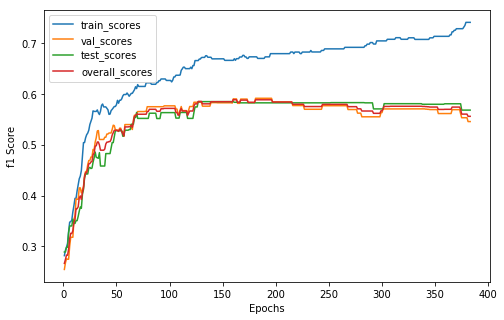

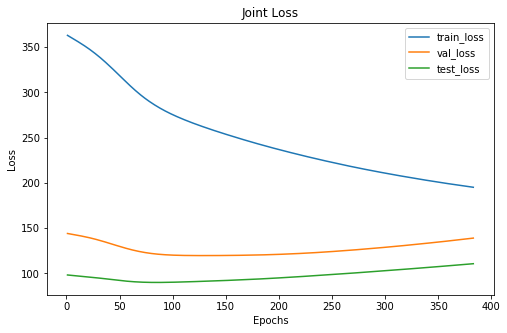

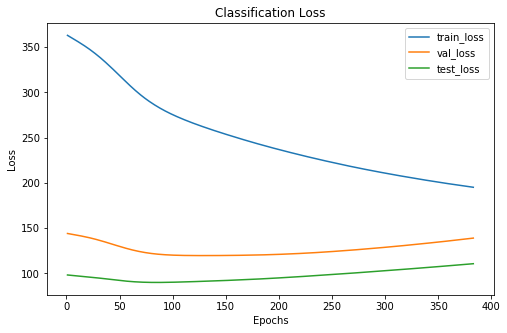

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     50      44
 2       81     33      18
xxxxxxxxxxxxxx epoch: 383 xxxxxxxxxxxxxx


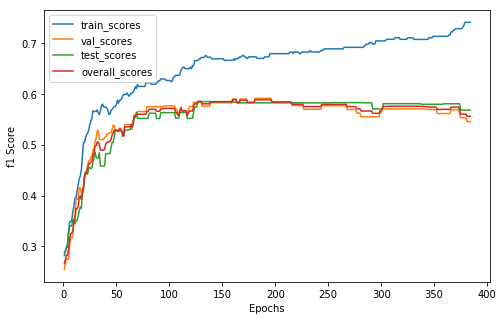

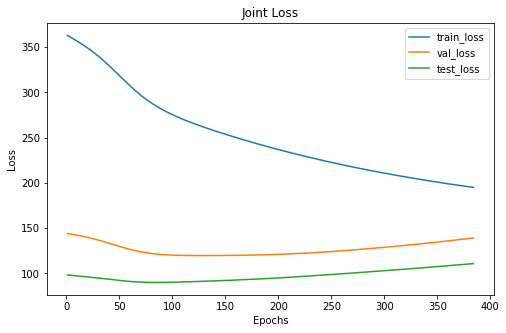

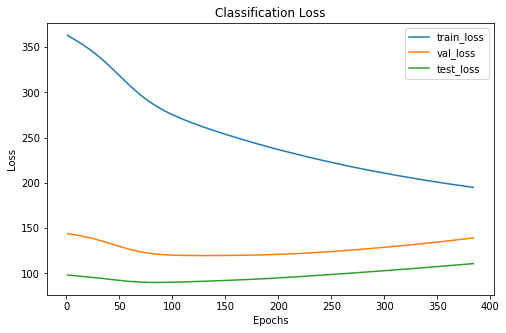

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     50      44
 2       81     33      18
xxxxxxxxxxxxxx epoch: 384 xxxxxxxxxxxxxx


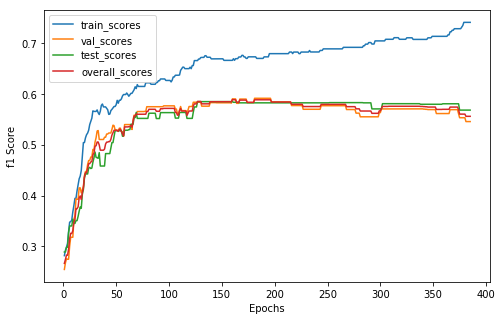

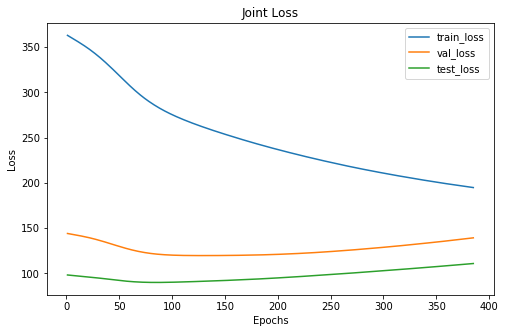

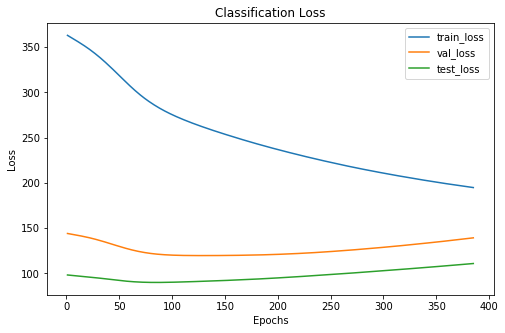

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     50      44
 2       81     33      18
xxxxxxxxxxxxxx epoch: 385 xxxxxxxxxxxxxx


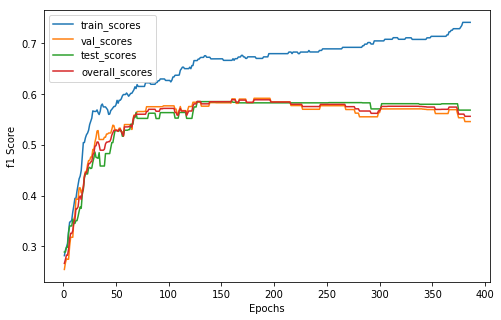

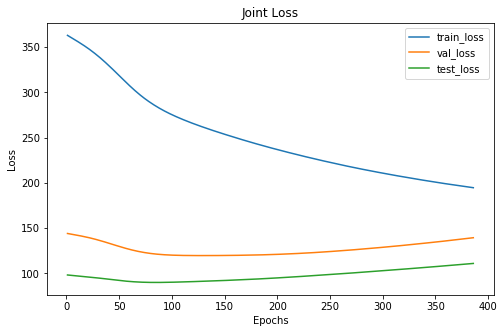

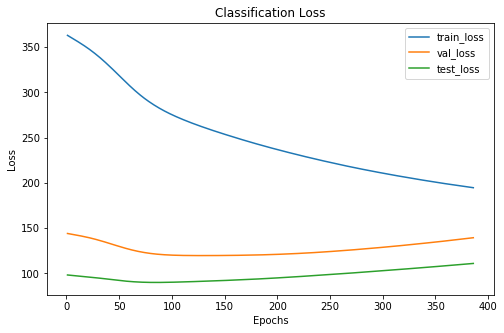

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     50      44
 2       81     33      18
xxxxxxxxxxxxxx epoch: 386 xxxxxxxxxxxxxx


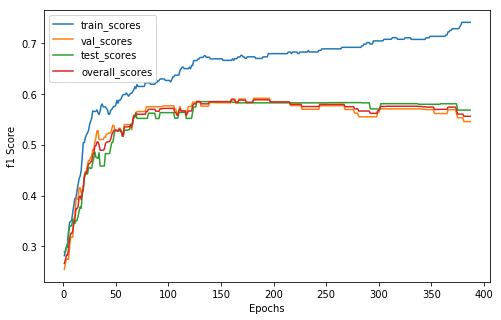

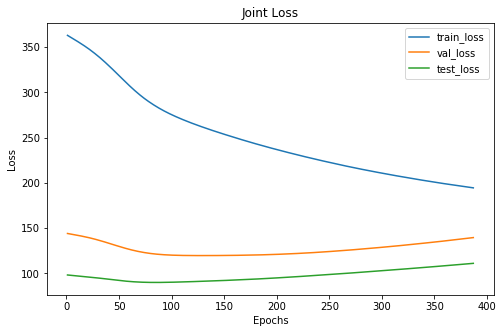

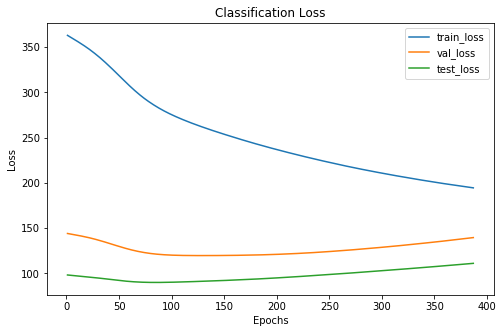

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     50      44
 2       81     33      18
xxxxxxxxxxxxxx epoch: 387 xxxxxxxxxxxxxx


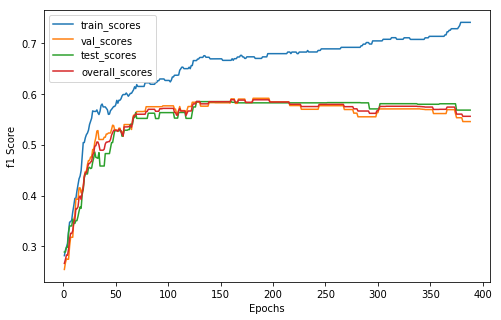

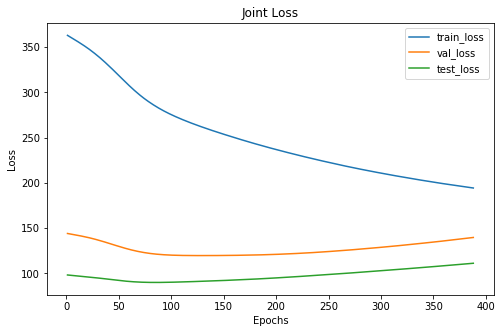

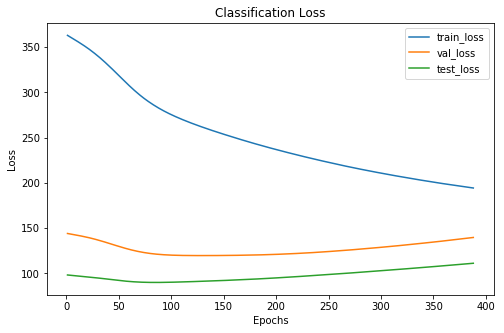

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     50      44
 2       81     33      18
xxxxxxxxxxxxxx epoch: 388 xxxxxxxxxxxxxx


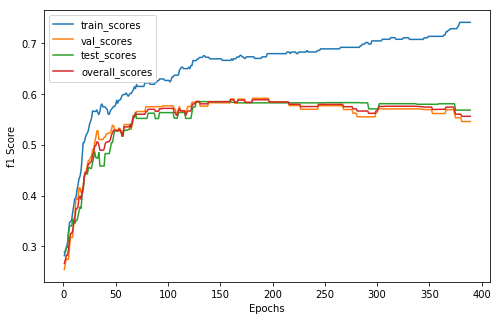

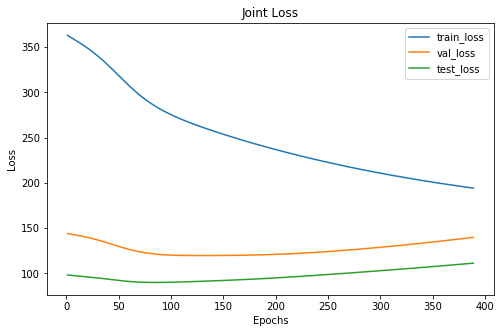

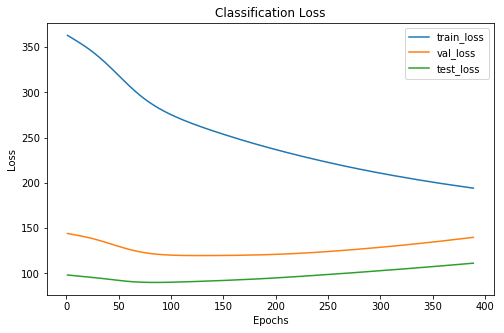

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     50      44
 2       81     33      18
xxxxxxxxxxxxxx epoch: 389 xxxxxxxxxxxxxx


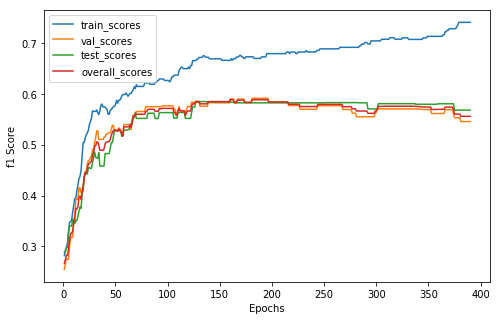

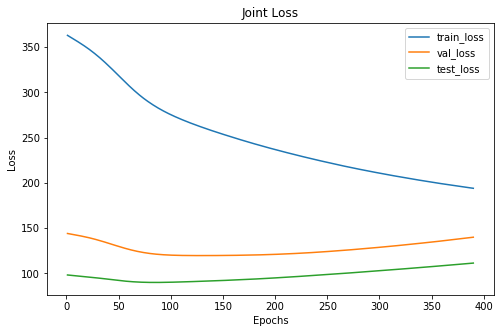

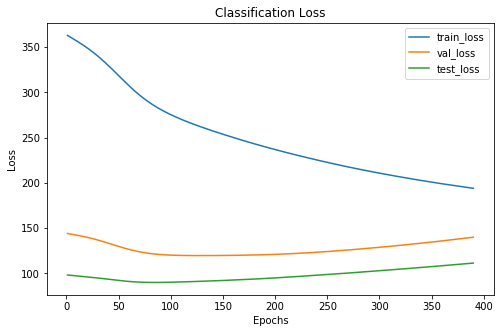

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     50      44
 2       81     33      18
xxxxxxxxxxxxxx epoch: 390 xxxxxxxxxxxxxx


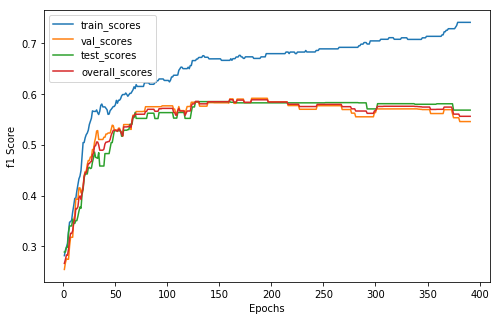

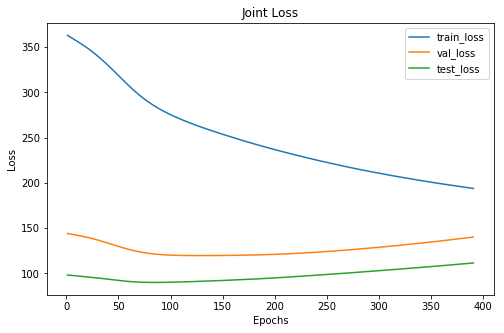

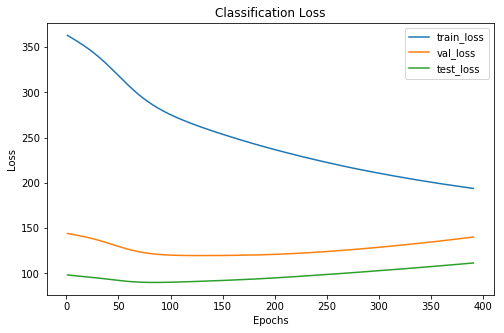

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     50      44
 2       81     33      18
xxxxxxxxxxxxxx epoch: 391 xxxxxxxxxxxxxx


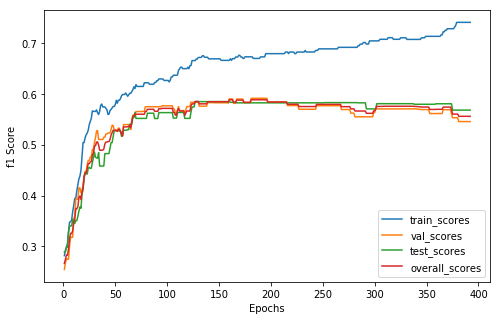

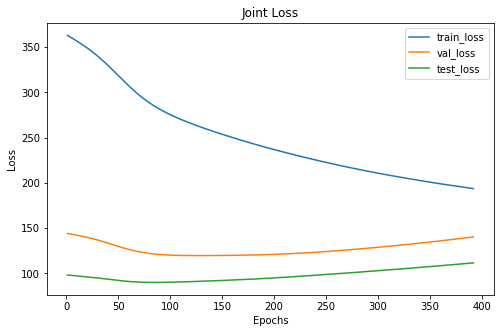

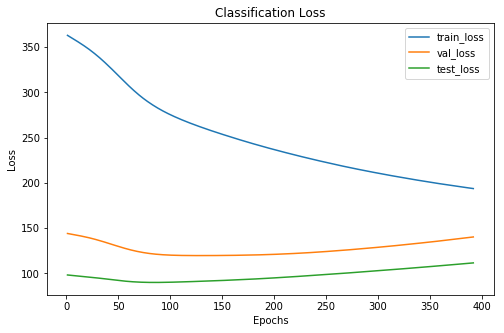

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      112     47      26
 1      134     50      44
 2       81     33      18
xxxxxxxxxxxxxx epoch: 392 xxxxxxxxxxxxxx


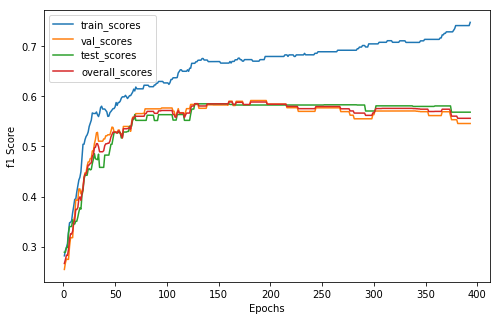

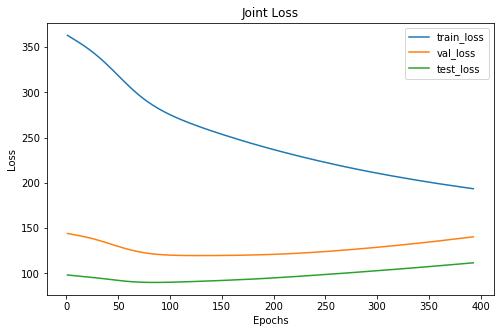

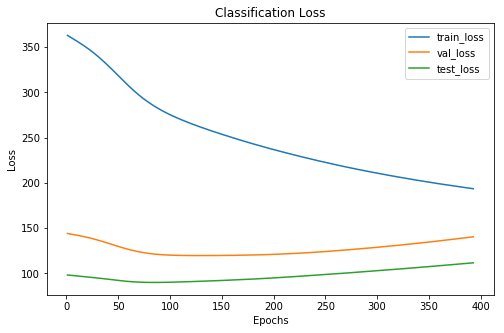

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      26
 1      136     50      44
 2       80     33      18
xxxxxxxxxxxxxx epoch: 393 xxxxxxxxxxxxxx


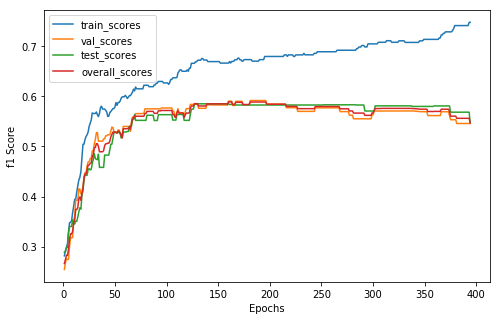

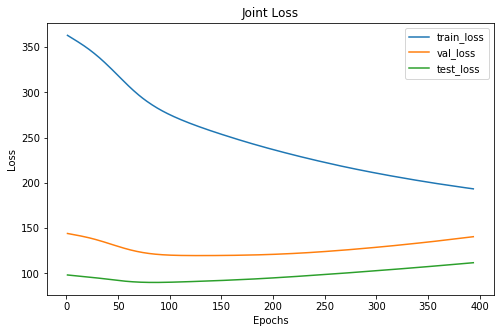

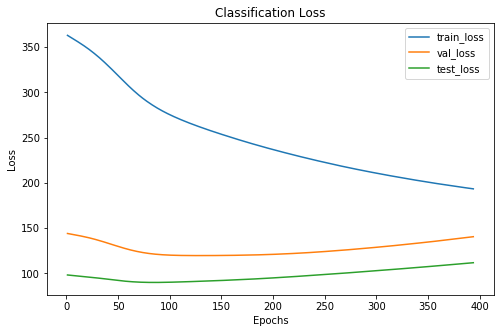

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     50      44
 2       80     33      20
xxxxxxxxxxxxxx epoch: 394 xxxxxxxxxxxxxx


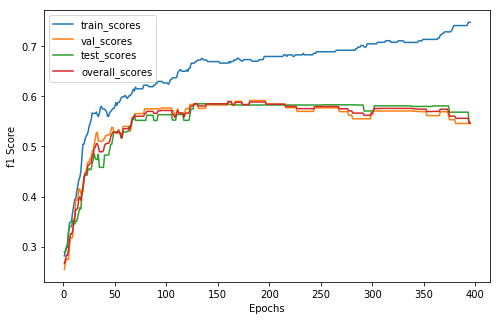

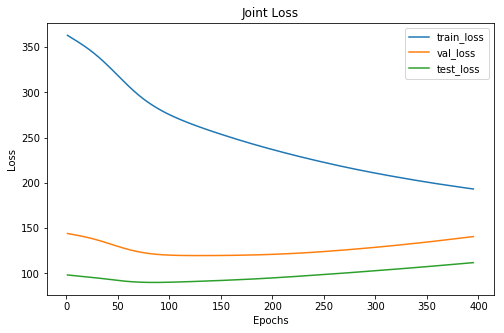

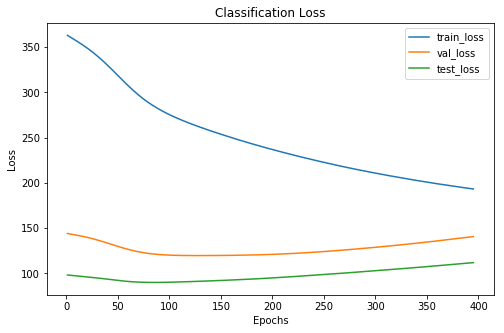

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     50      44
 2       80     33      20
xxxxxxxxxxxxxx epoch: 395 xxxxxxxxxxxxxx


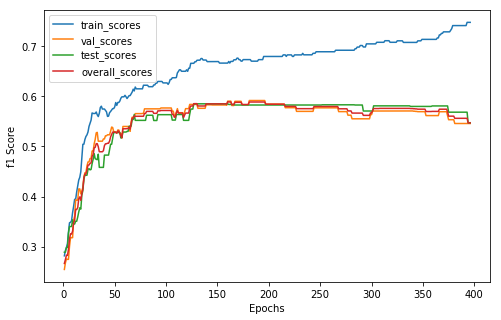

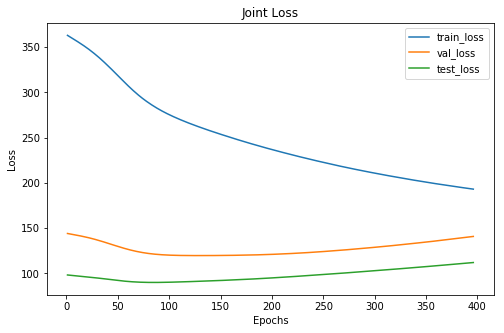

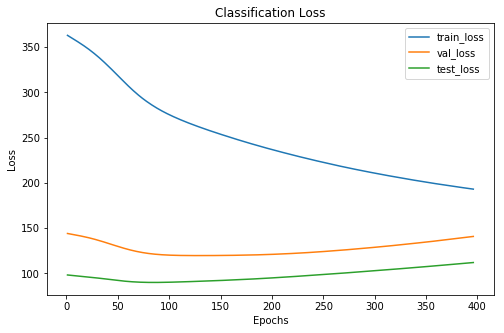

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     50      44
 2       80     33      20
xxxxxxxxxxxxxx epoch: 396 xxxxxxxxxxxxxx


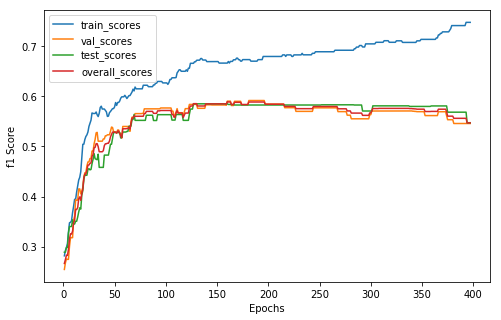

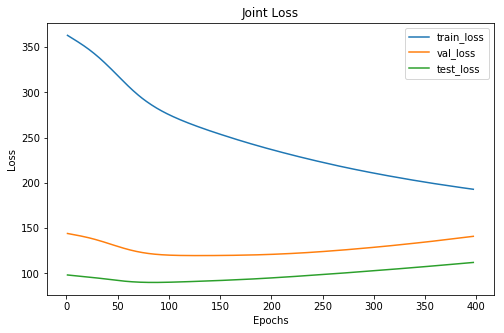

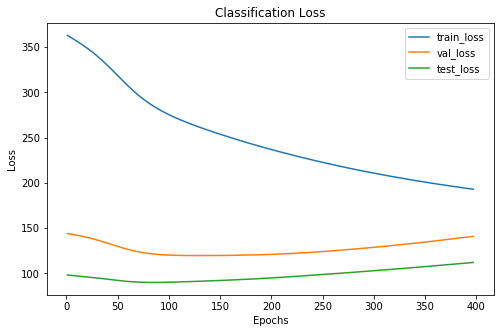

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     50      44
 2       80     33      20
xxxxxxxxxxxxxx epoch: 397 xxxxxxxxxxxxxx


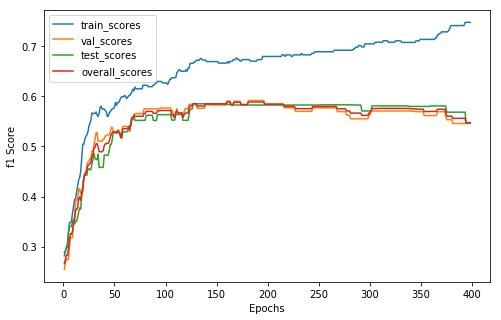

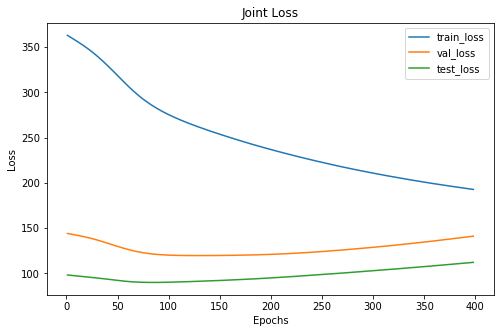

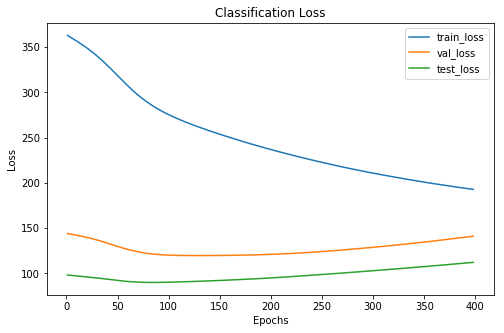

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     50      44
 2       80     33      20
xxxxxxxxxxxxxx epoch: 398 xxxxxxxxxxxxxx


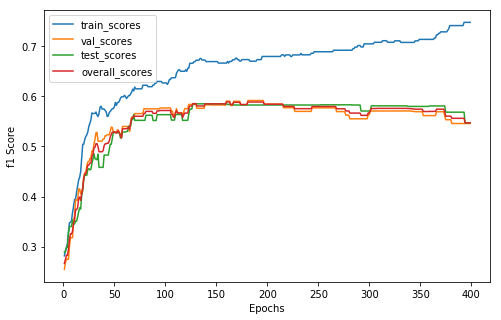

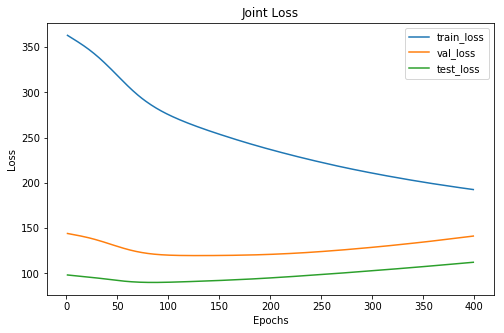

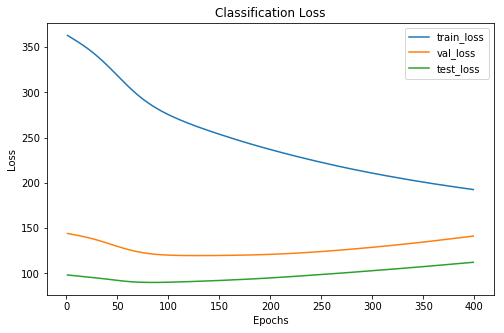

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     50      44
 2       80     33      20
xxxxxxxxxxxxxx epoch: 399 xxxxxxxxxxxxxx


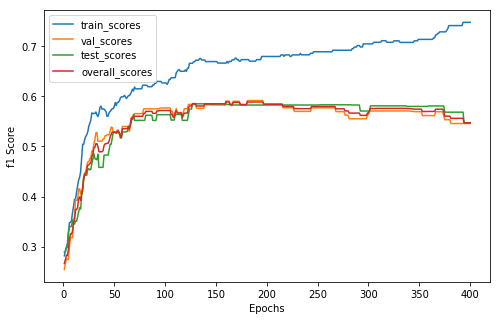

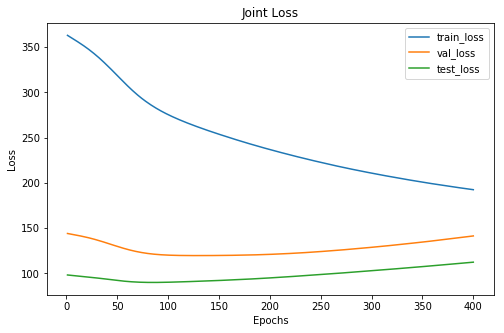

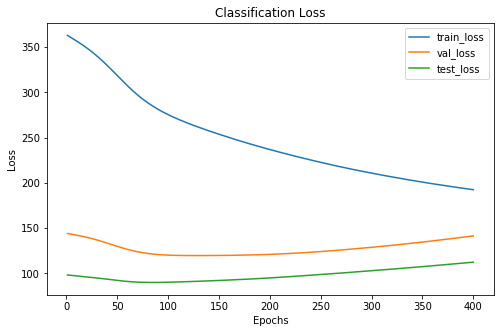

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     50      44
 2       80     33      20
xxxxxxxxxxxxxx epoch: 400 xxxxxxxxxxxxxx


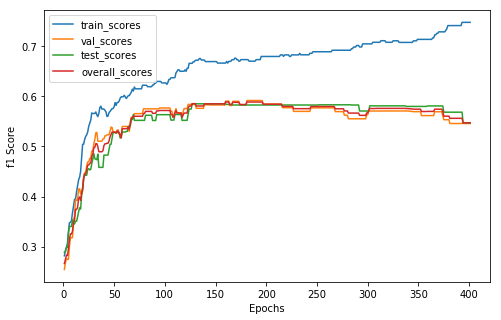

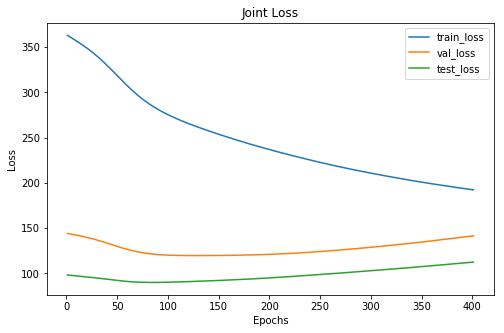

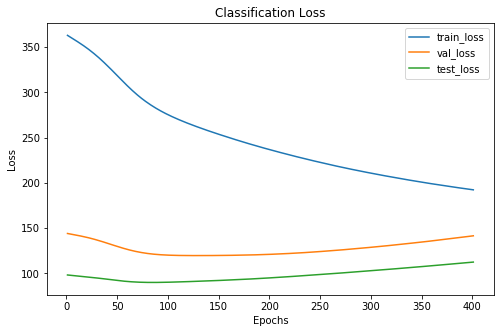

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     50      44
 2       80     33      20
xxxxxxxxxxxxxx epoch: 401 xxxxxxxxxxxxxx


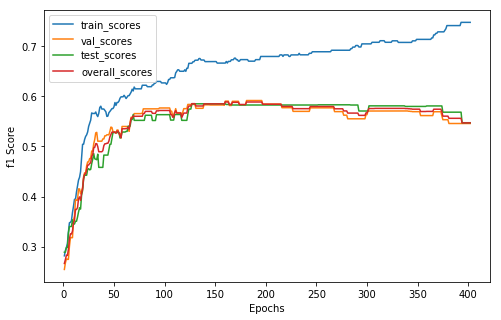

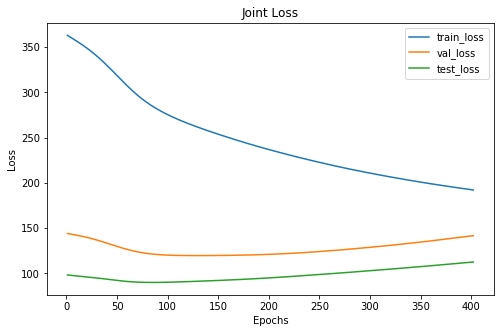

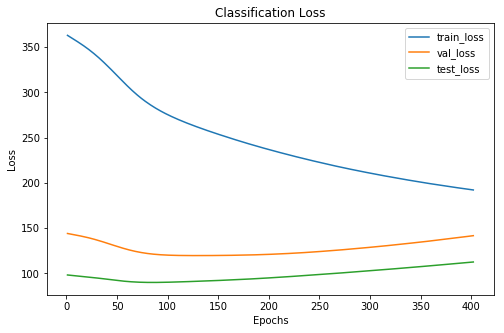

Cofusion Matrix For Val Set: 
--  --  --
27  20   6
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     50      44
 2       80     33      20
xxxxxxxxxxxxxx epoch: 402 xxxxxxxxxxxxxx


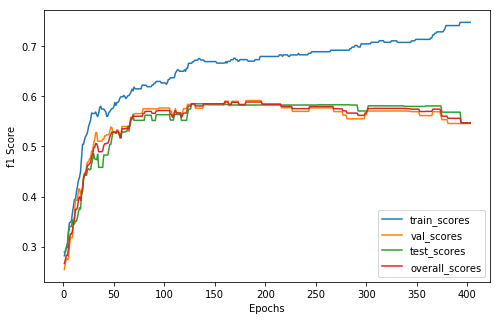

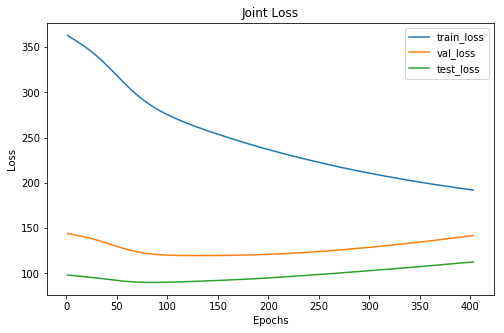

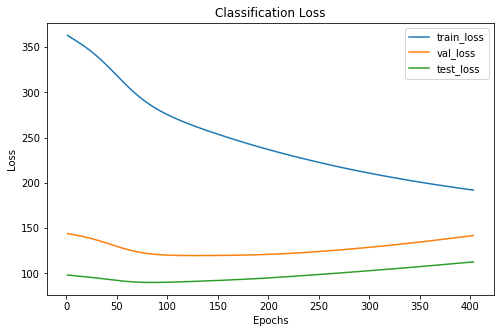

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 403 xxxxxxxxxxxxxx


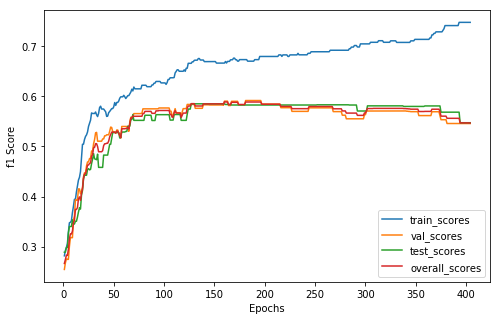

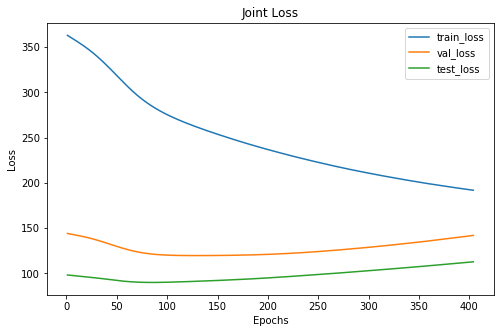

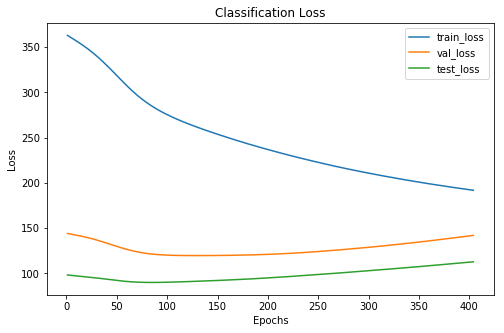

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 404 xxxxxxxxxxxxxx


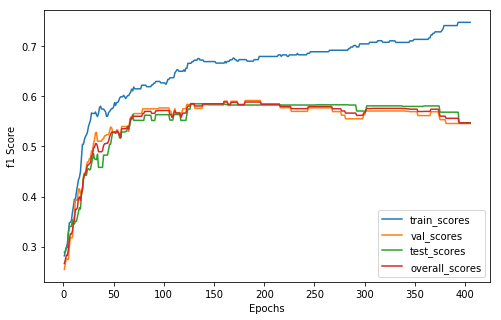

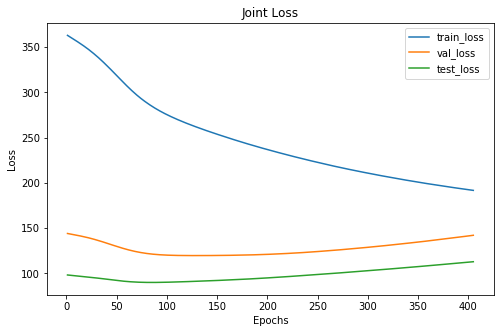

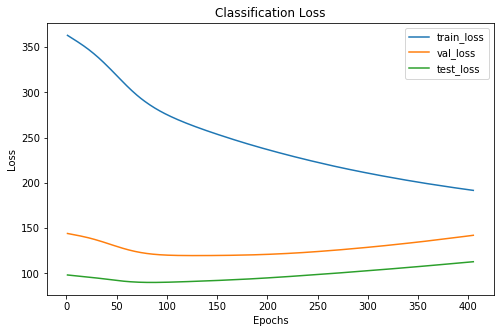

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 405 xxxxxxxxxxxxxx


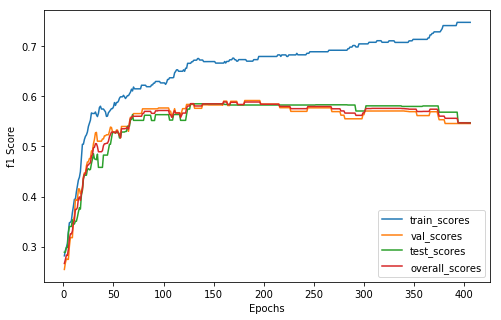

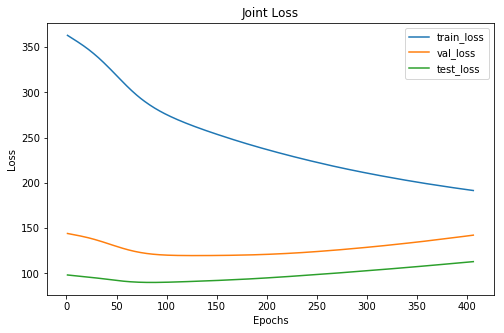

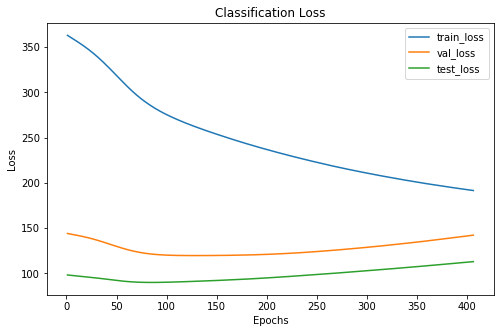

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 406 xxxxxxxxxxxxxx


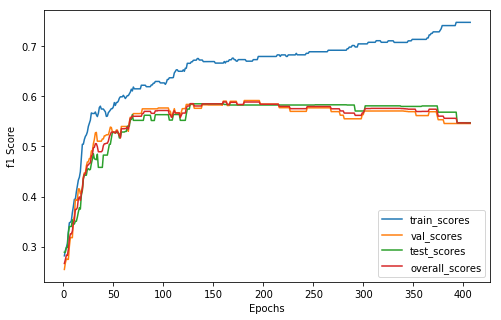

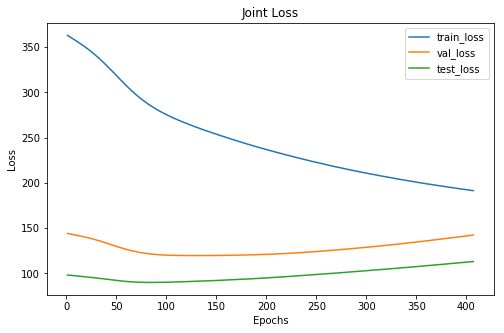

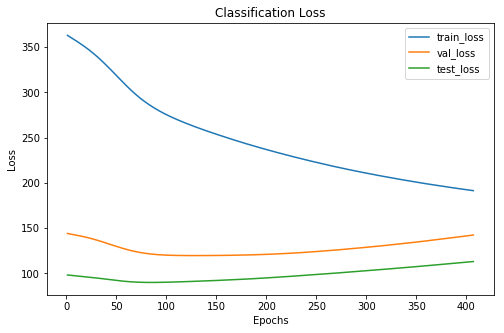

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      111     47      24
 1      136     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 407 xxxxxxxxxxxxxx


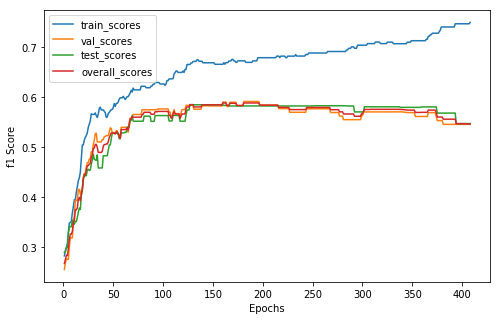

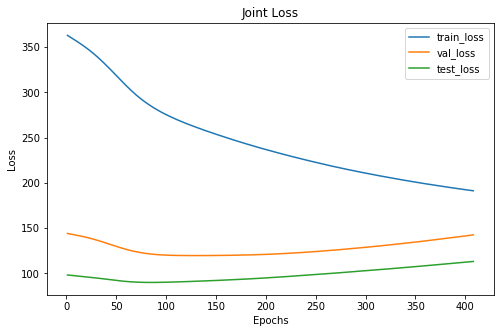

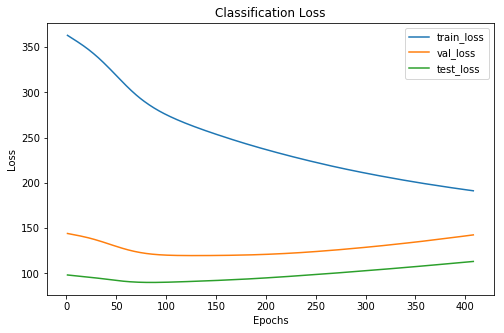

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     47      24
 1      137     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 408 xxxxxxxxxxxxxx


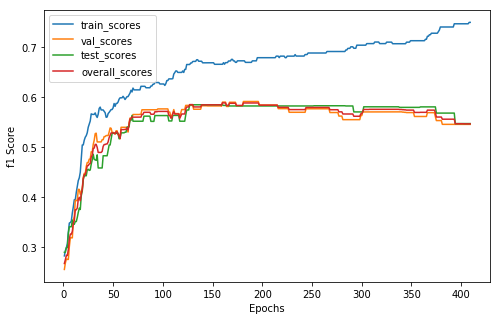

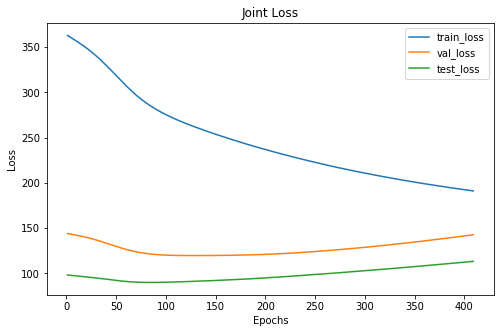

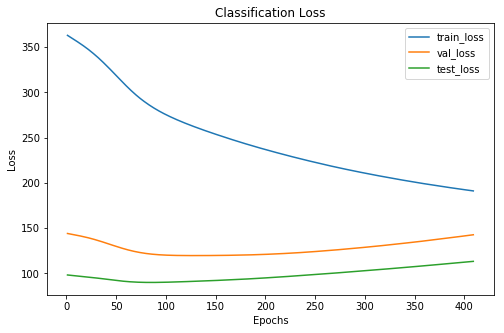

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     47      24
 1      137     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 409 xxxxxxxxxxxxxx


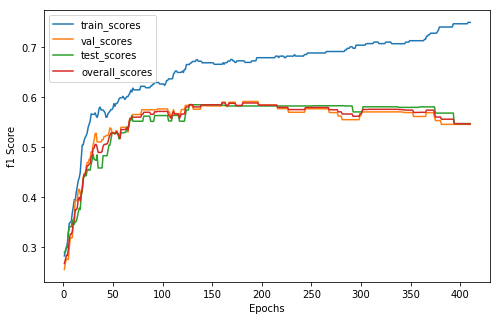

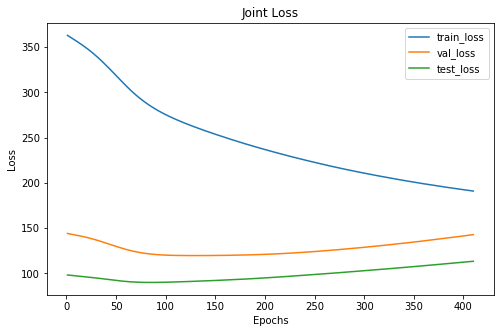

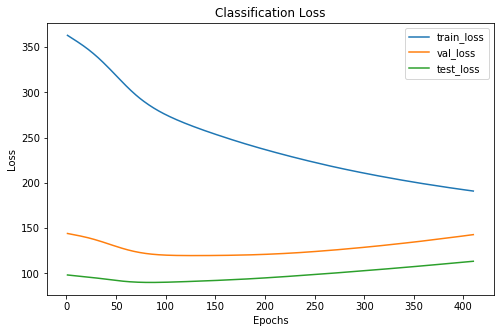

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     47      24
 1      137     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 410 xxxxxxxxxxxxxx


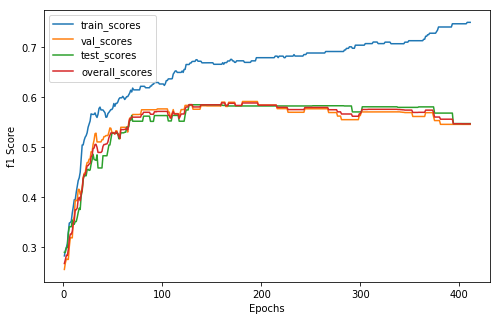

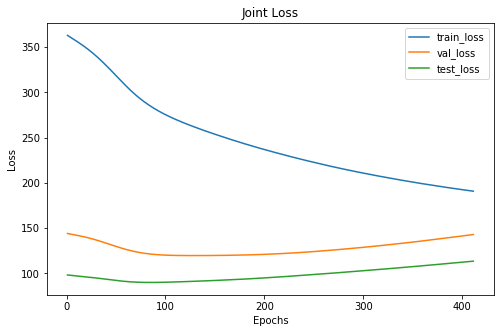

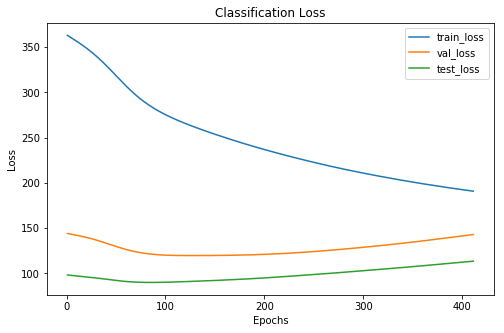

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     47      24
 1      137     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 411 xxxxxxxxxxxxxx


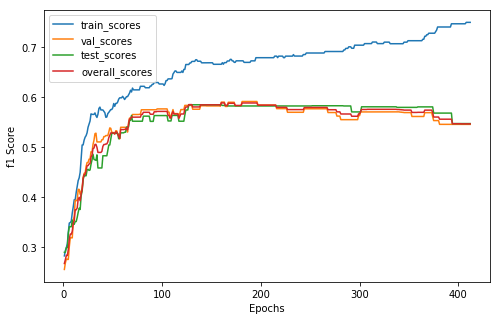

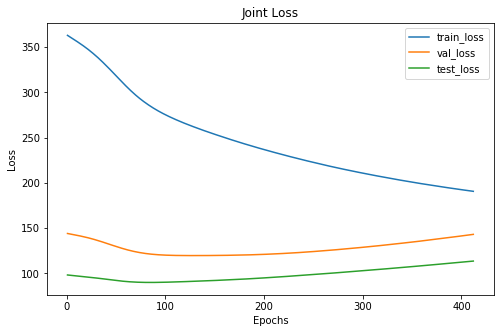

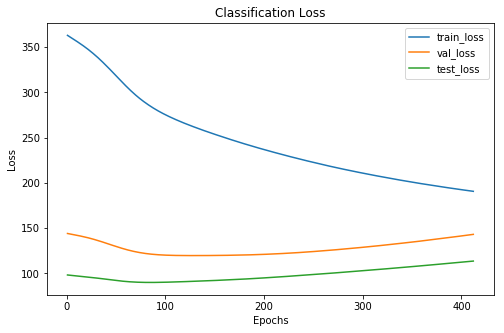

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     47      24
 1      137     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 412 xxxxxxxxxxxxxx


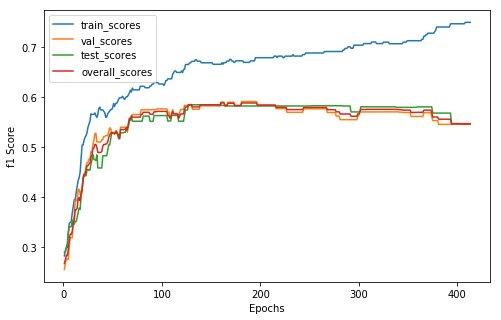

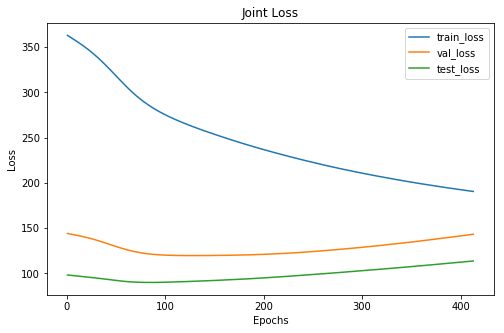

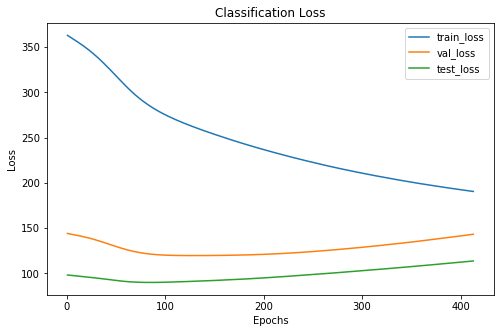

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     47      24
 1      137     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 413 xxxxxxxxxxxxxx


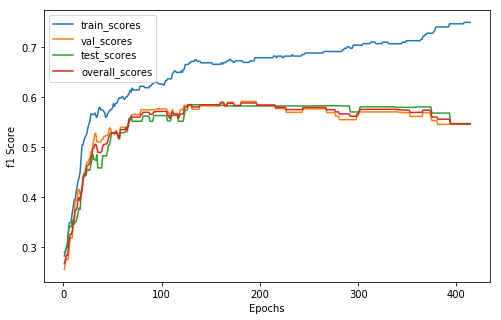

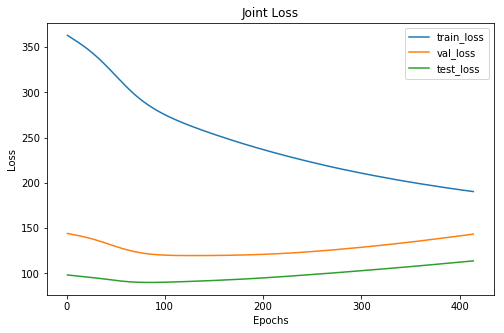

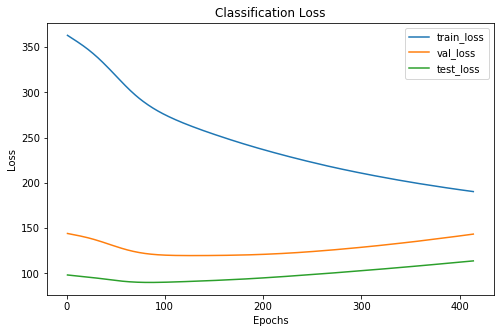

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     47      24
 1      137     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 414 xxxxxxxxxxxxxx


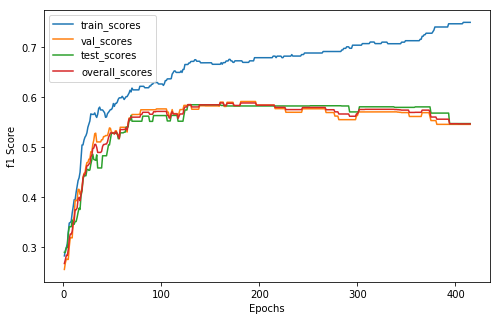

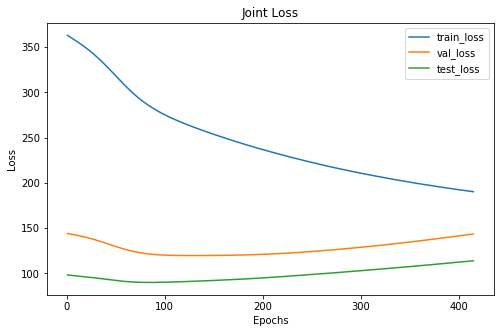

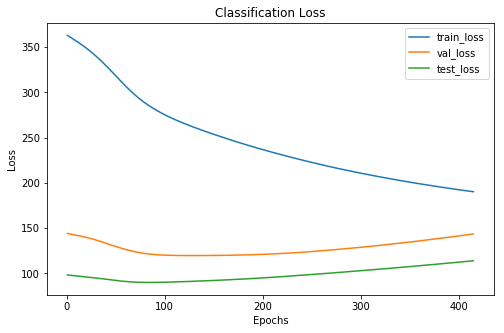

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     47      24
 1      137     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 415 xxxxxxxxxxxxxx


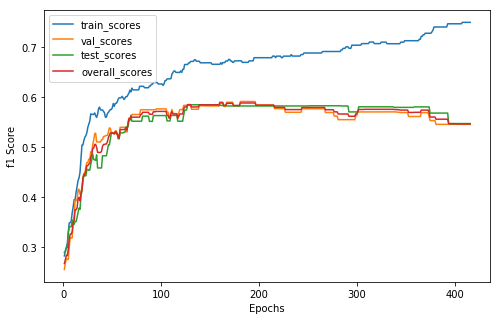

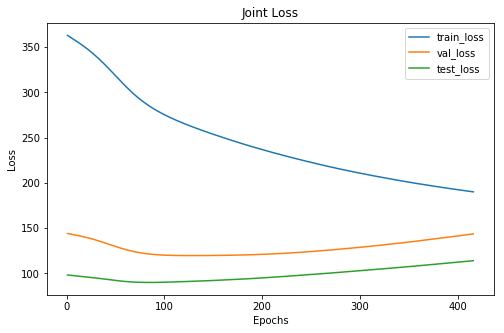

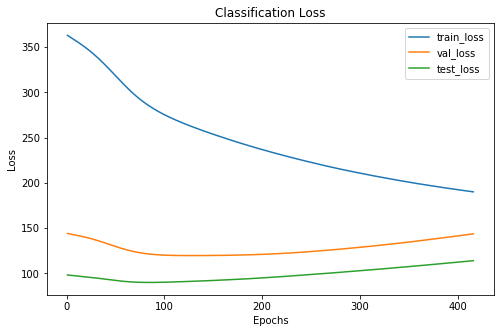

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      110     47      24
 1      137     51      44
 2       80     32      20
xxxxxxxxxxxxxx epoch: 416 xxxxxxxxxxxxxx


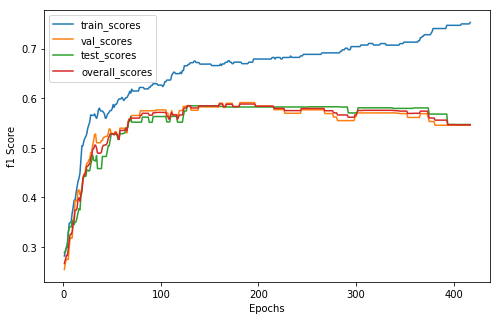

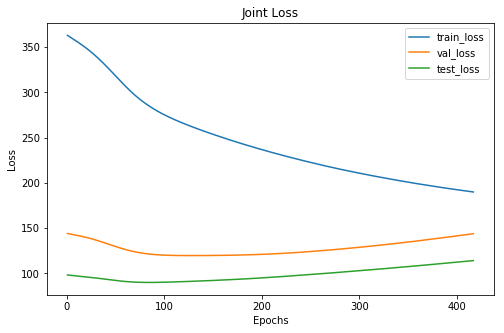

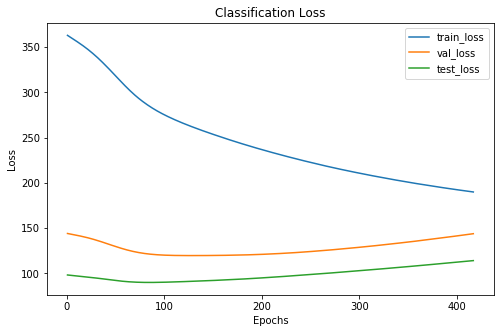

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      24
 1      137     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 417 xxxxxxxxxxxxxx


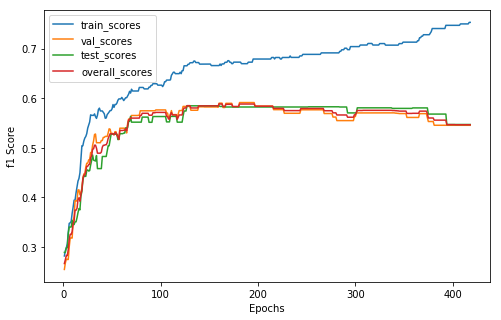

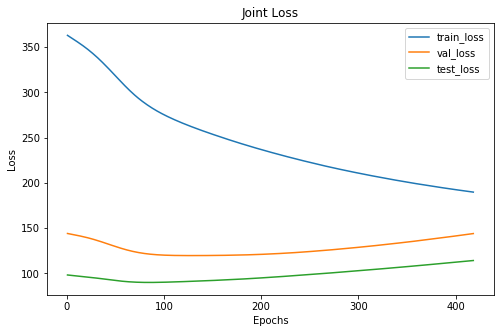

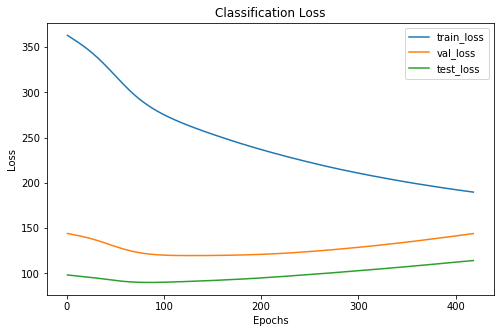

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      24
 1      137     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 418 xxxxxxxxxxxxxx


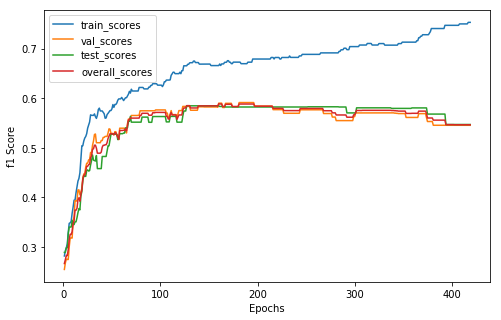

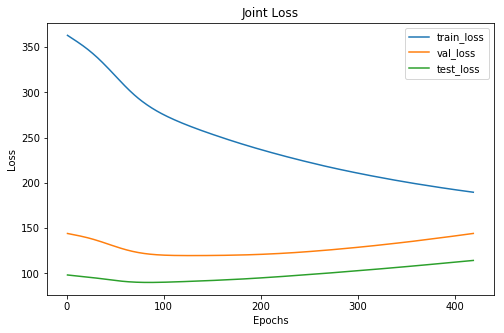

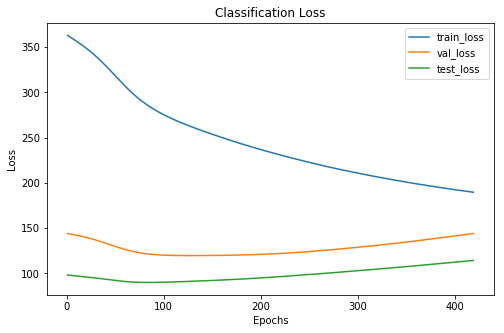

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      24
 1      137     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 419 xxxxxxxxxxxxxx


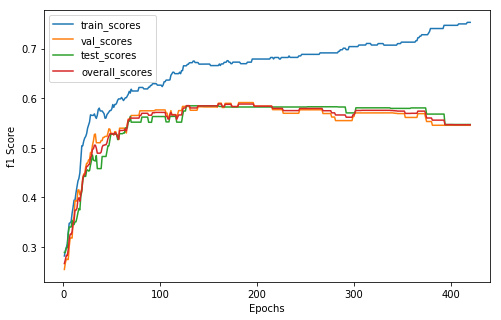

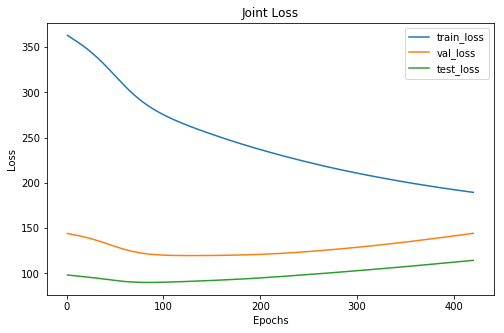

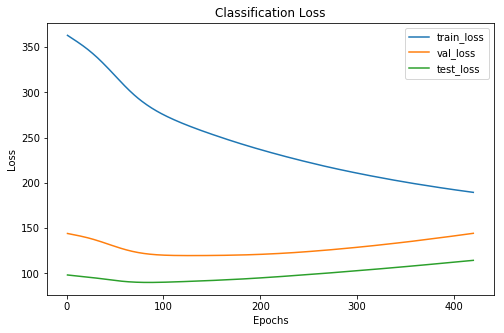

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      24
 1      137     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 420 xxxxxxxxxxxxxx


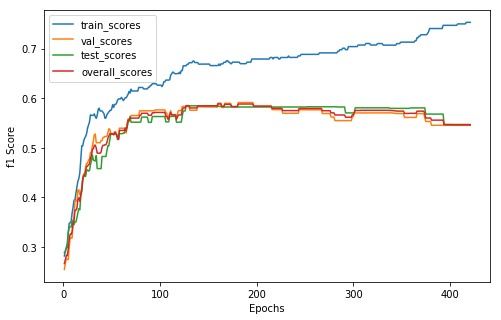

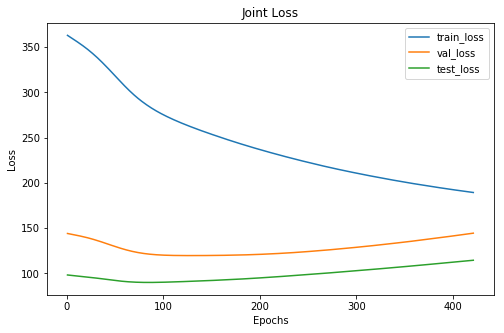

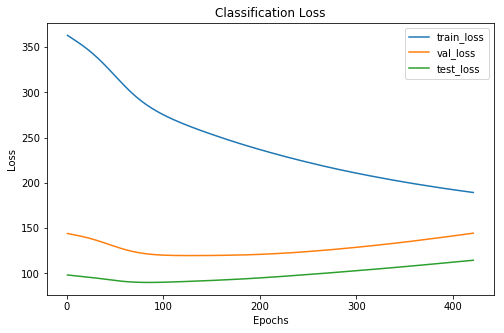

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      24
 1      137     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 421 xxxxxxxxxxxxxx


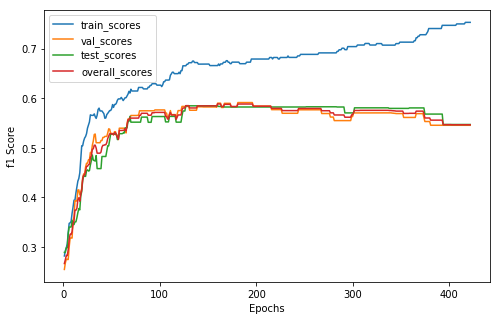

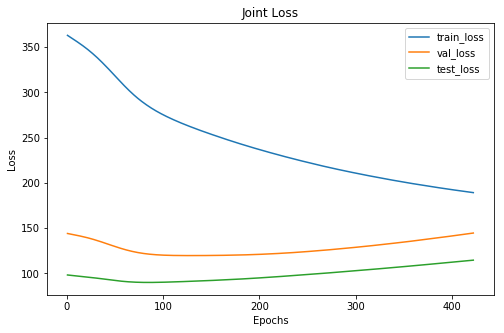

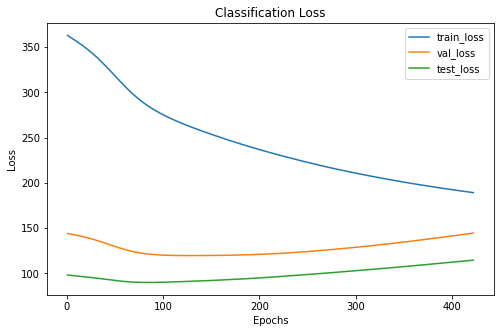

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      24
 1      137     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 422 xxxxxxxxxxxxxx


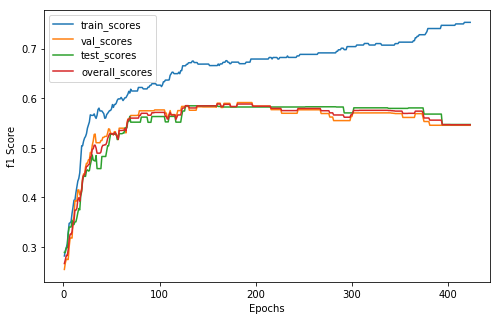

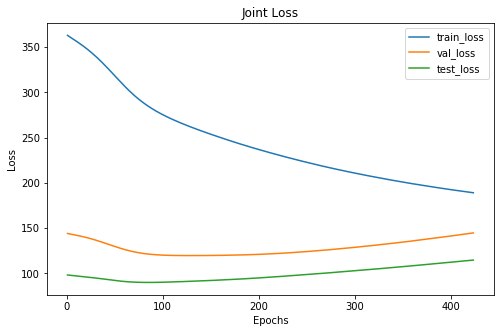

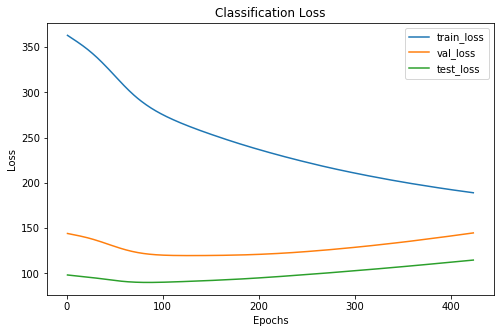

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      24
 1      137     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 423 xxxxxxxxxxxxxx


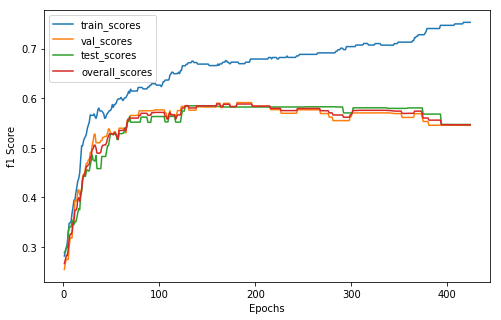

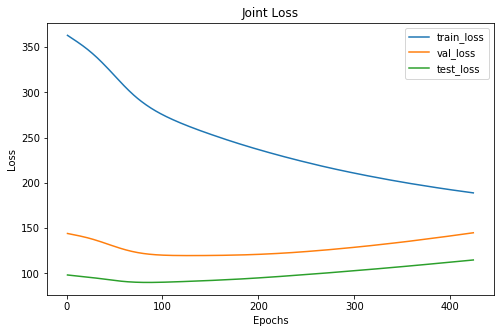

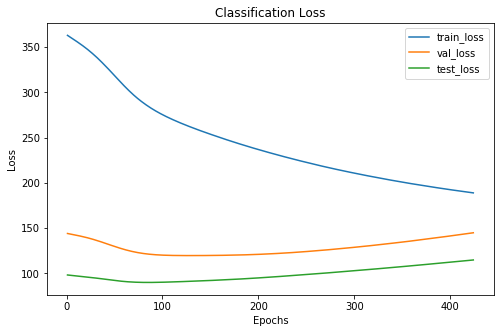

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      24
 1      137     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 424 xxxxxxxxxxxxxx


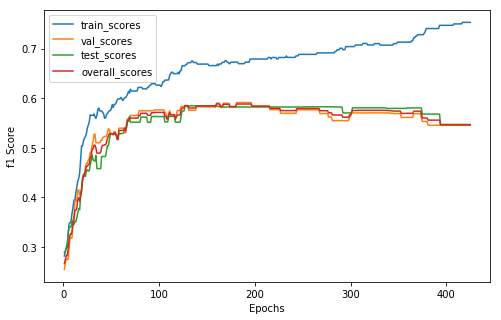

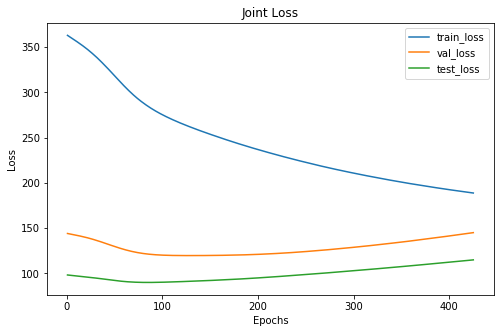

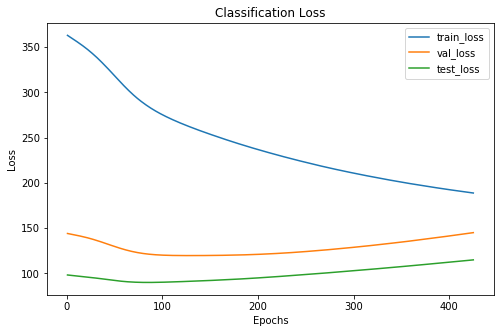

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      24
 1      137     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 425 xxxxxxxxxxxxxx


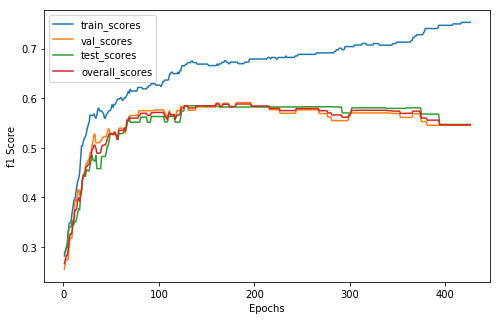

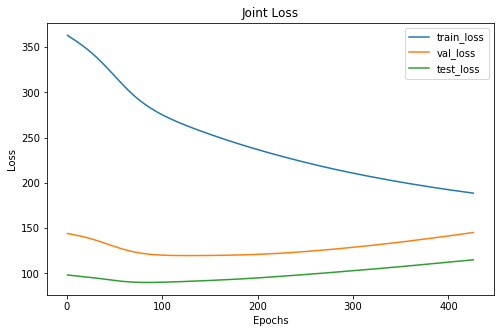

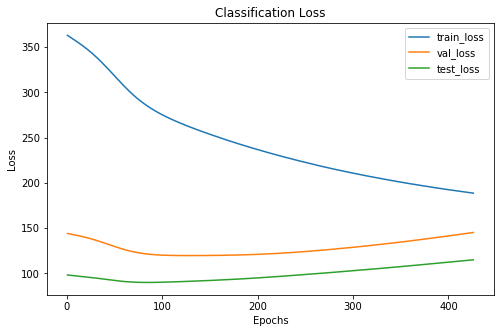

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      24
 1      137     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 426 xxxxxxxxxxxxxx


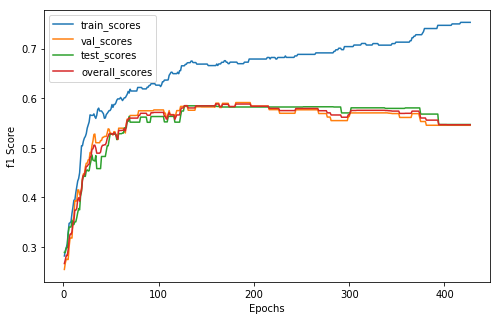

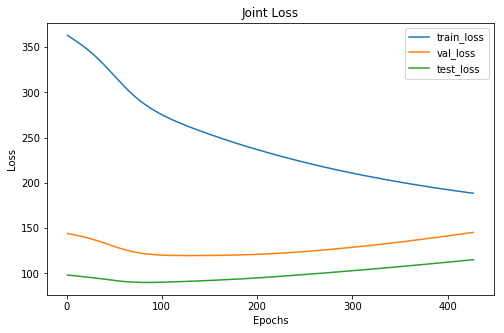

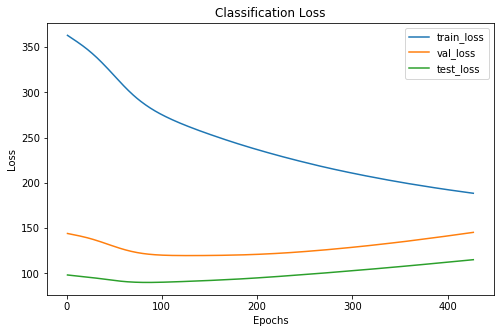

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      24
 1      137     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 427 xxxxxxxxxxxxxx


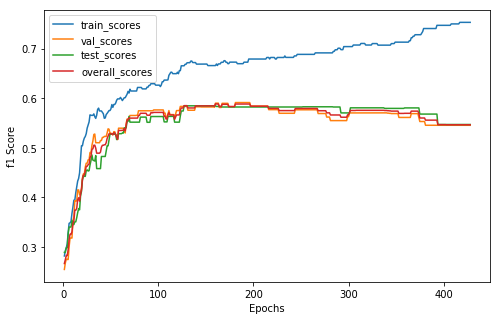

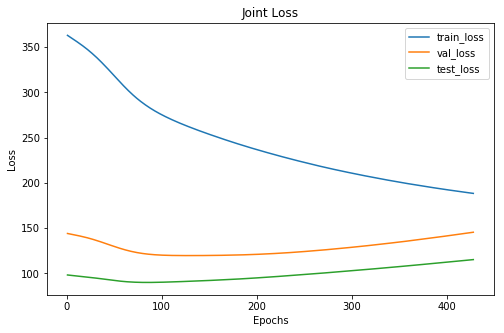

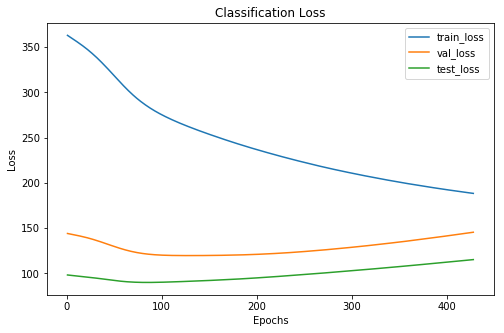

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      24
 1      137     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 428 xxxxxxxxxxxxxx


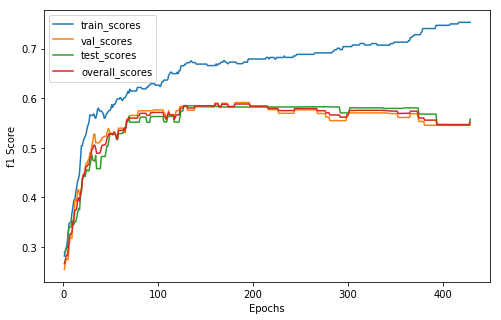

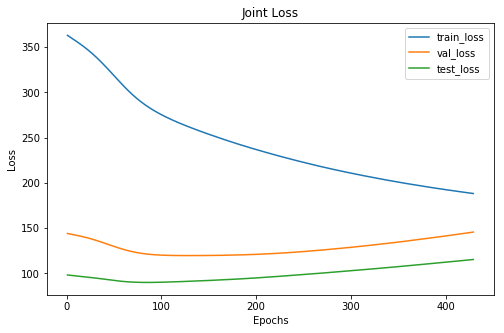

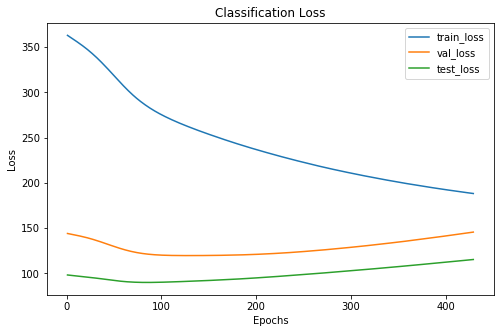

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 429 xxxxxxxxxxxxxx


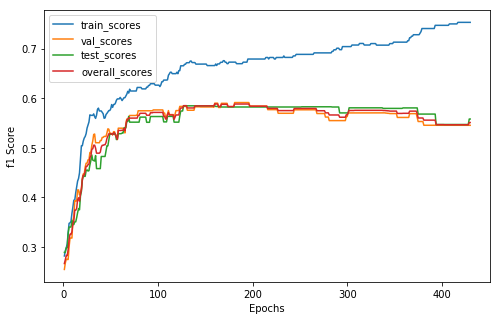

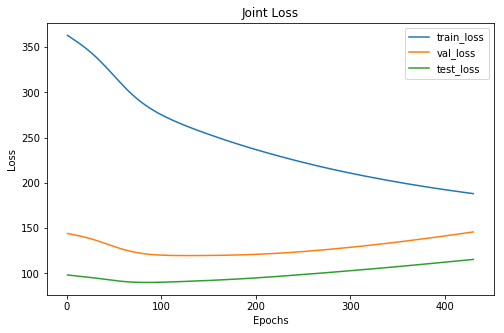

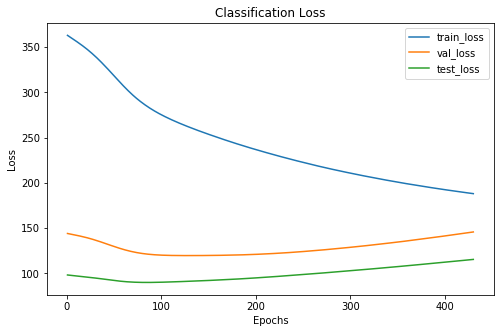

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 430 xxxxxxxxxxxxxx


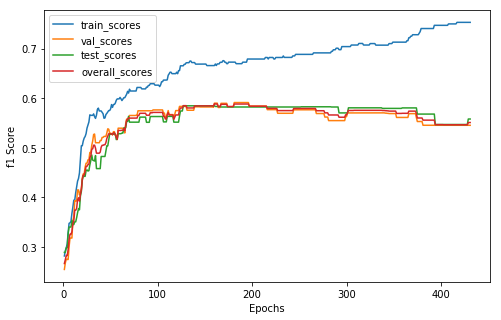

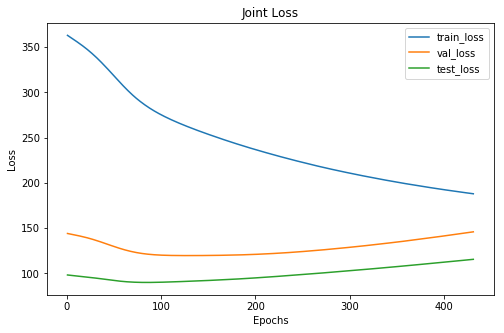

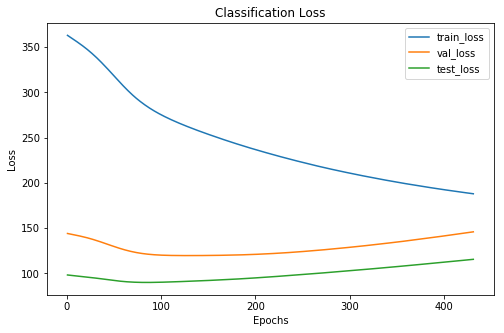

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 431 xxxxxxxxxxxxxx


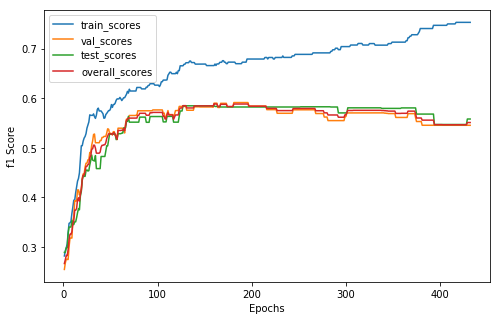

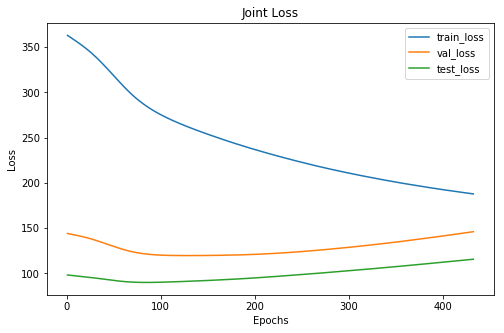

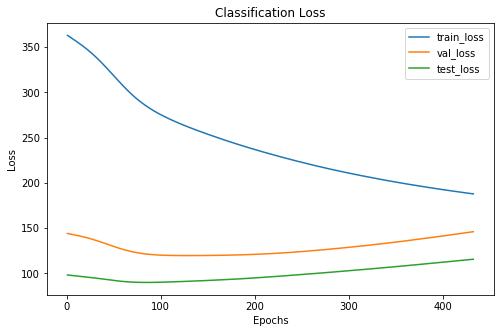

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 432 xxxxxxxxxxxxxx


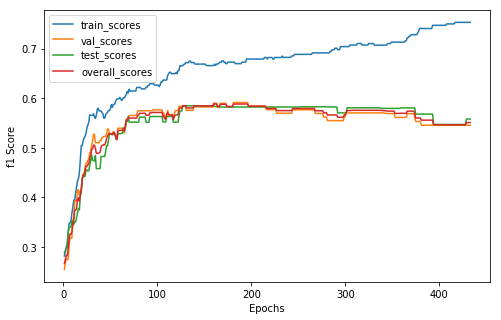

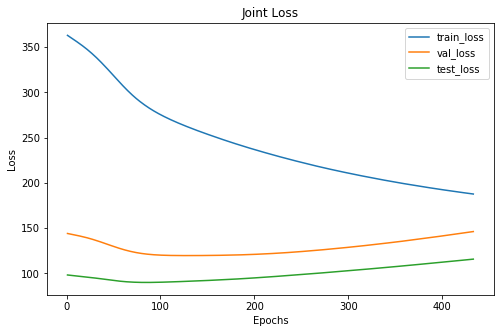

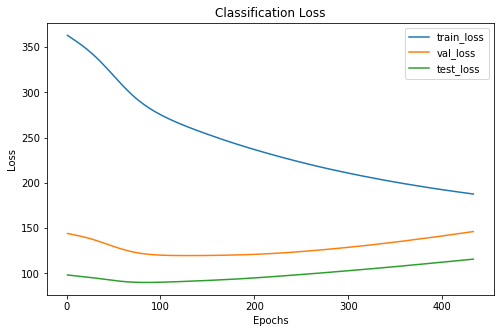

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 433 xxxxxxxxxxxxxx


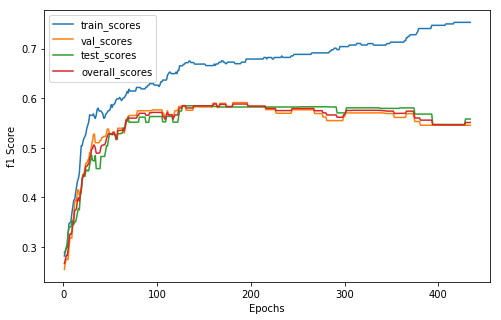

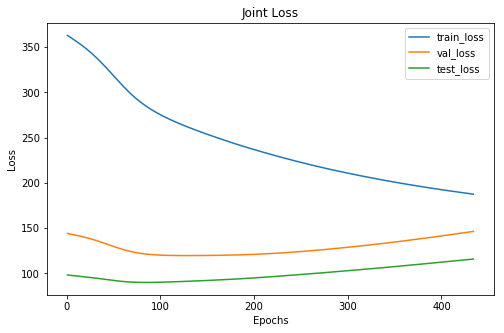

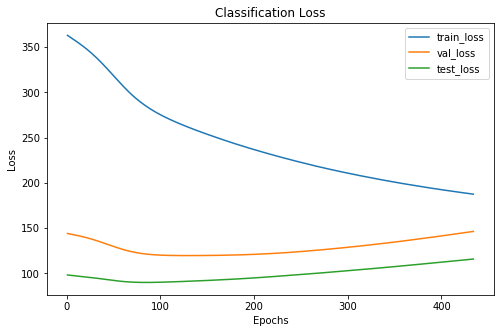

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 434 xxxxxxxxxxxxxx


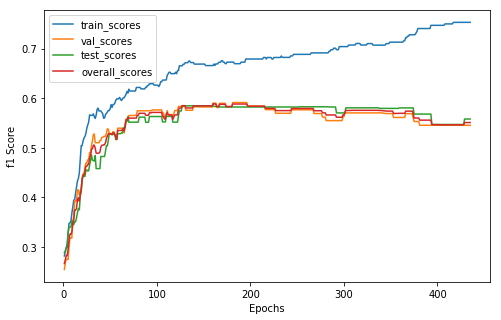

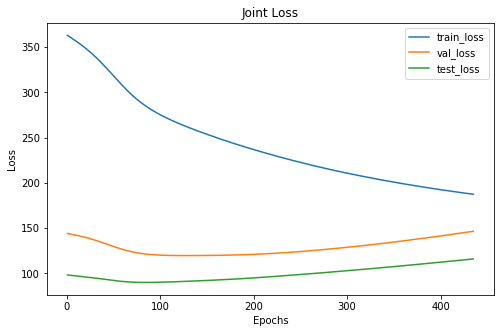

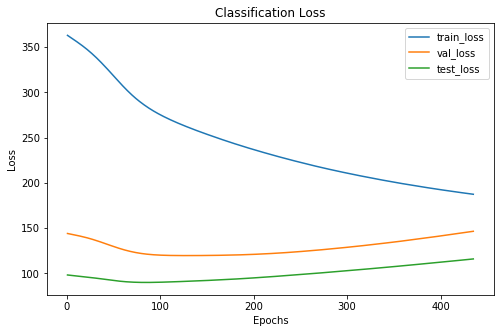

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 435 xxxxxxxxxxxxxx


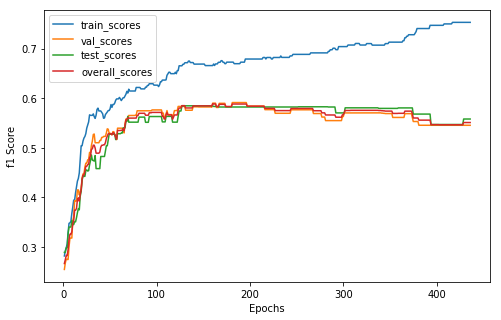

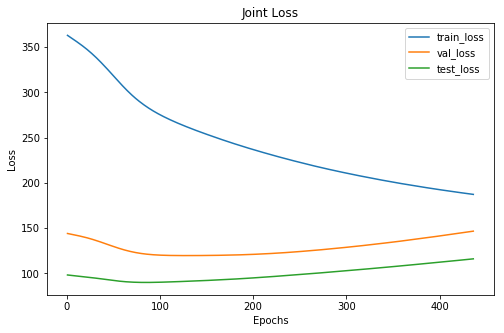

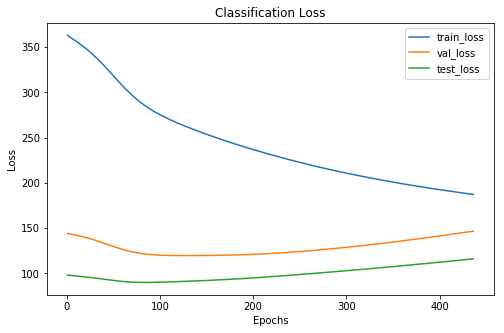

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 436 xxxxxxxxxxxxxx


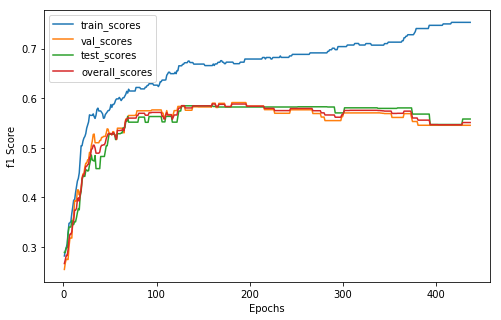

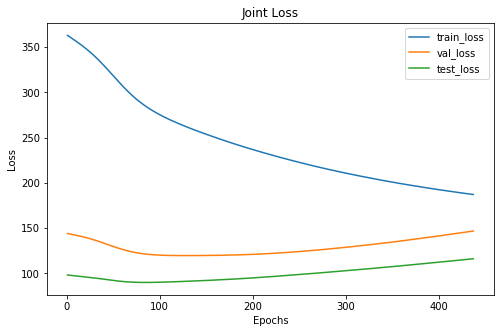

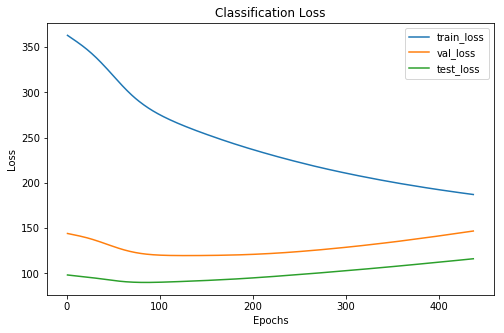

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 437 xxxxxxxxxxxxxx


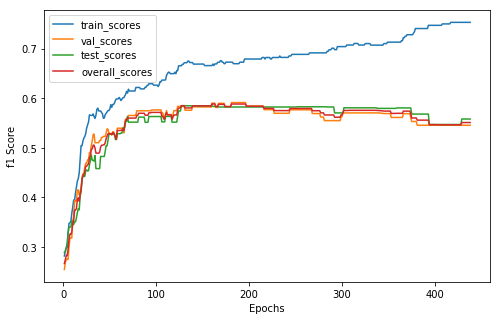

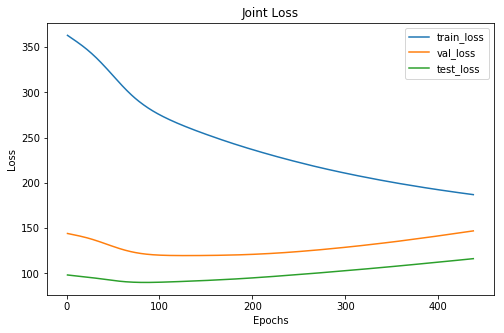

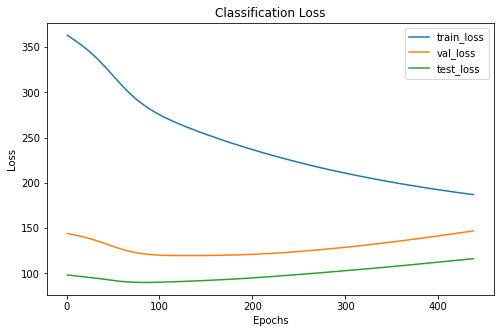

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 438 xxxxxxxxxxxxxx


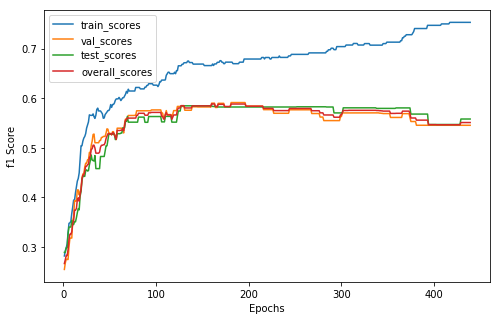

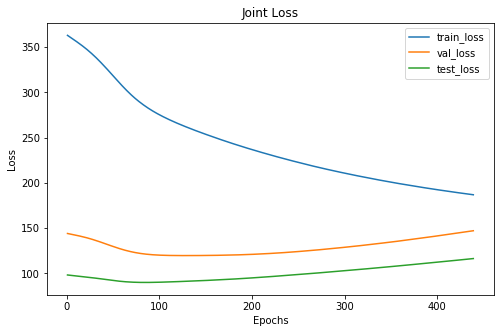

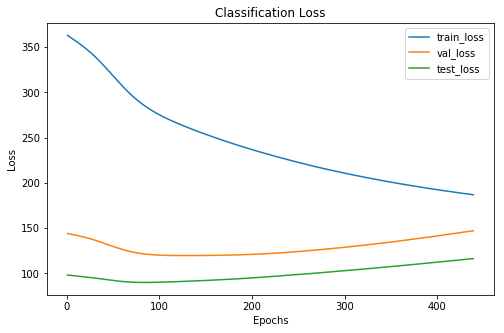

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 439 xxxxxxxxxxxxxx


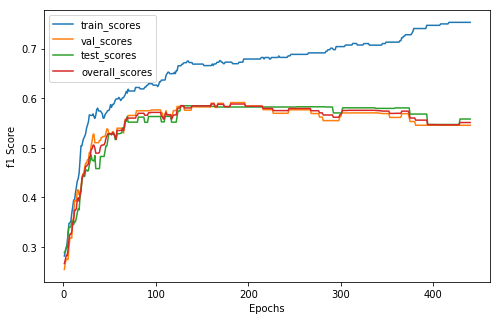

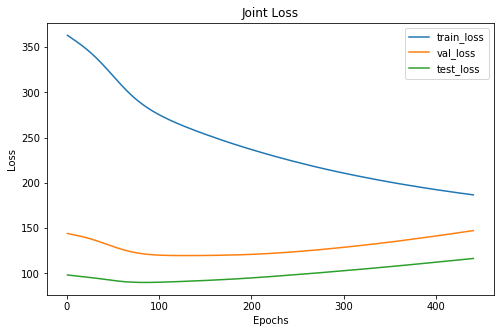

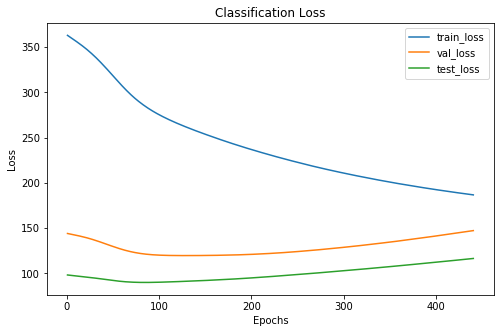

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 440 xxxxxxxxxxxxxx


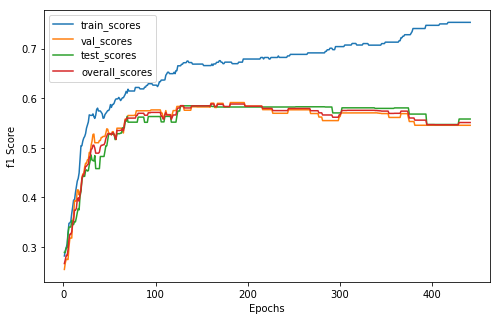

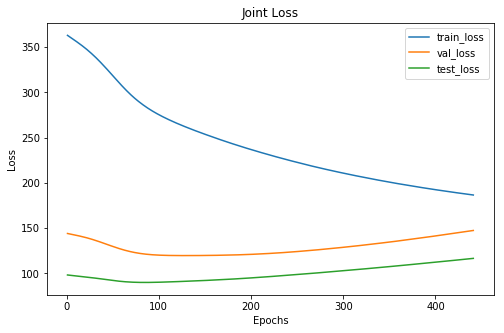

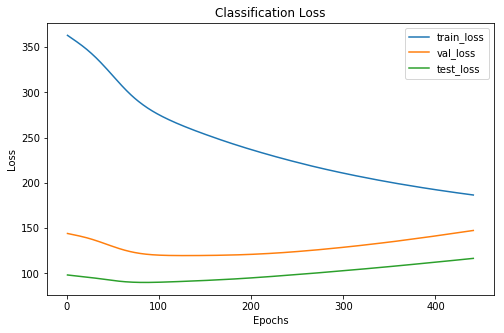

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 441 xxxxxxxxxxxxxx


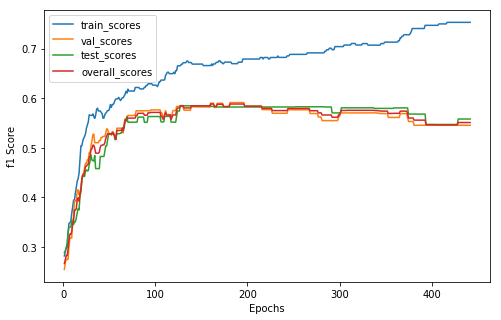

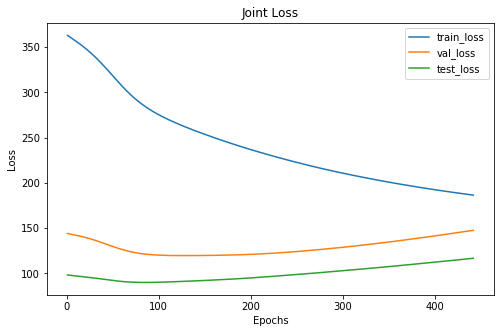

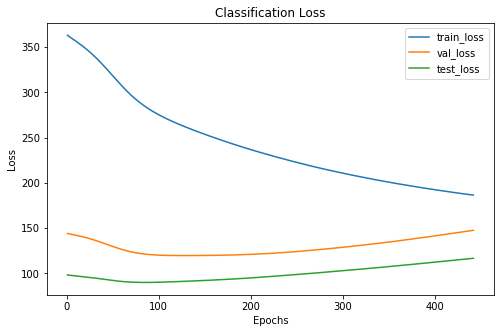

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 442 xxxxxxxxxxxxxx


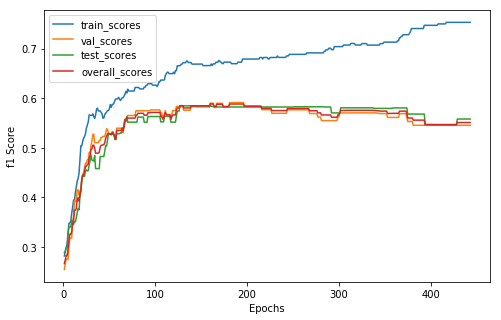

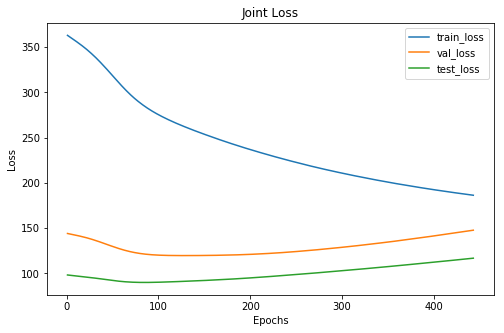

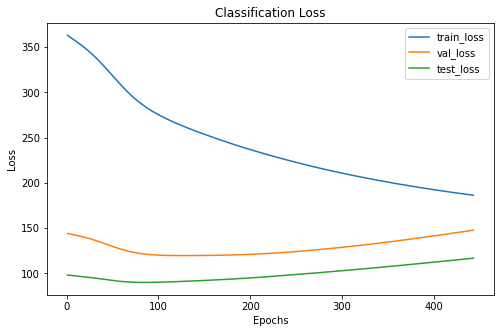

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 443 xxxxxxxxxxxxxx


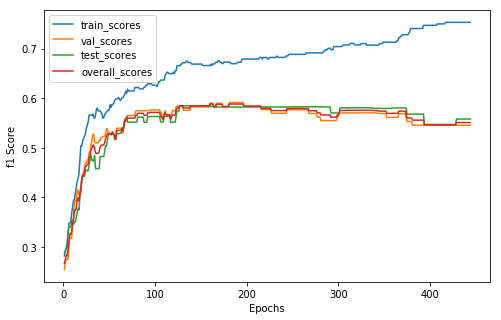

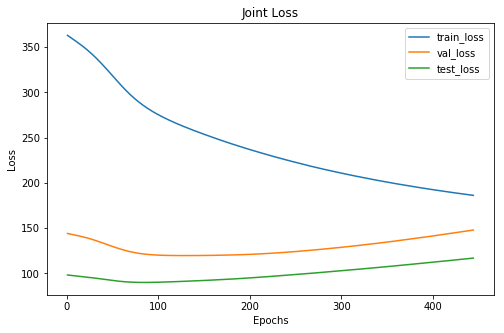

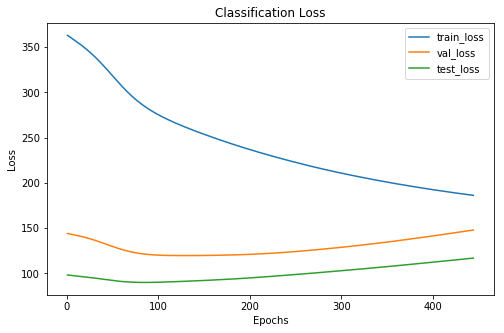

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 444 xxxxxxxxxxxxxx


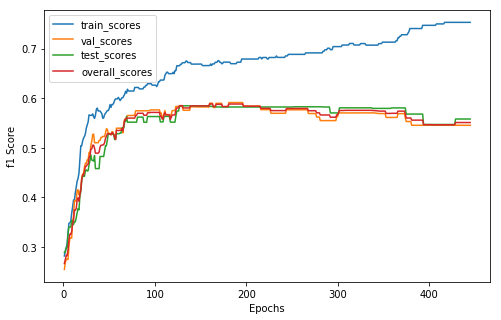

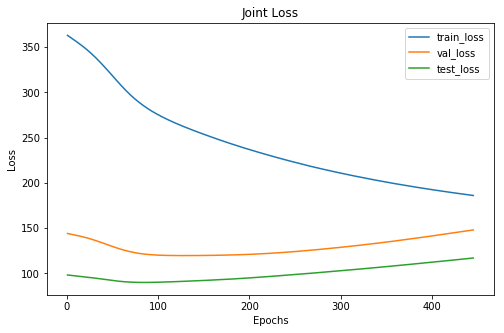

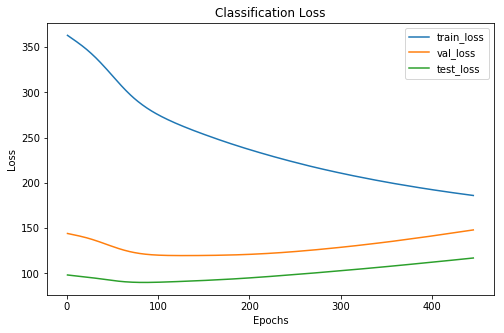

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 445 xxxxxxxxxxxxxx


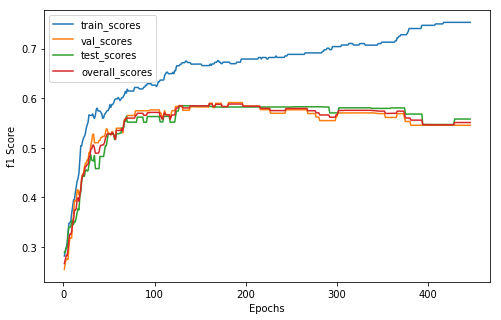

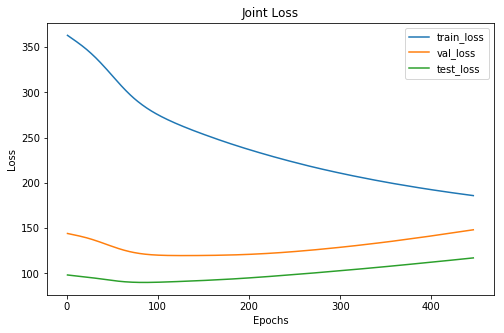

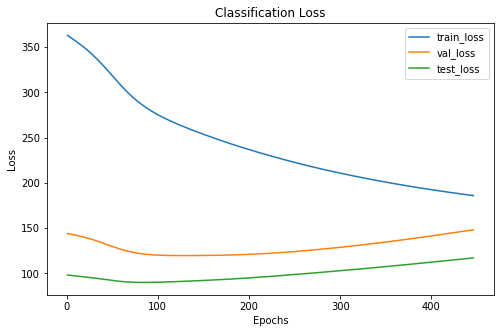

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 446 xxxxxxxxxxxxxx


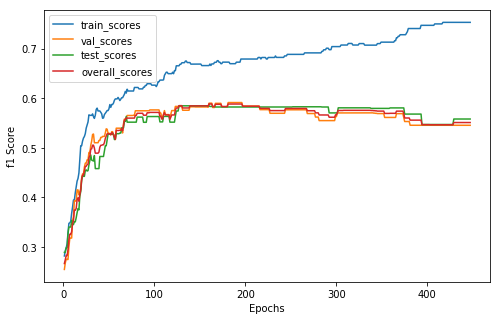

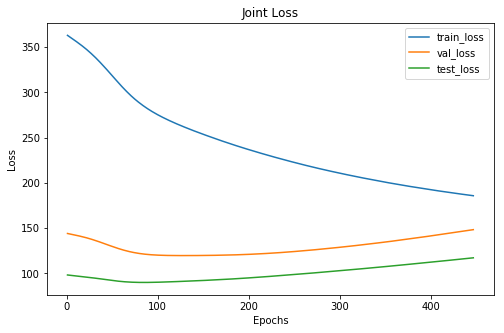

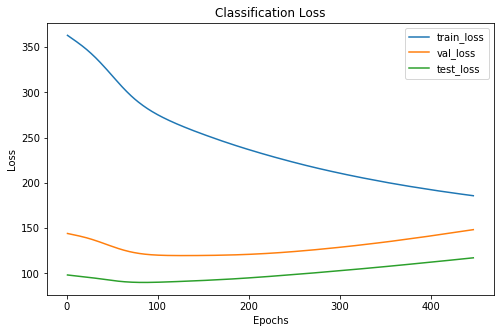

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      109     47      23
 1      137     51      45
 2       81     32      20
xxxxxxxxxxxxxx epoch: 447 xxxxxxxxxxxxxx


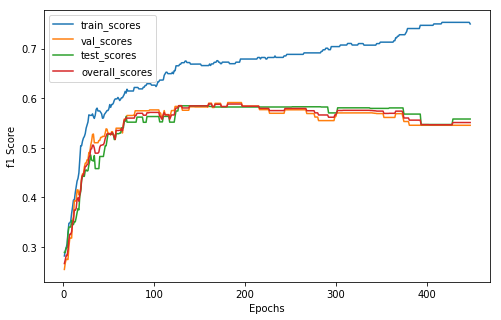

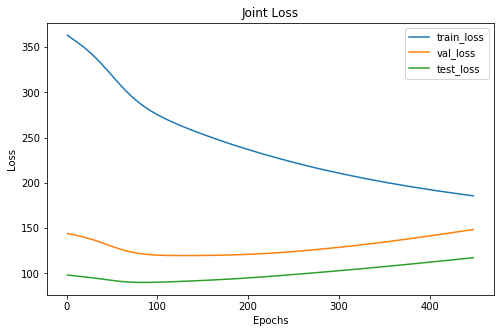

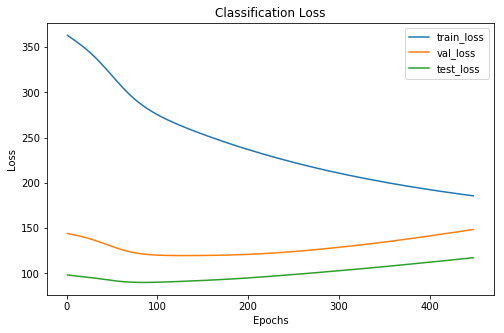

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     47      23
 1      137     51      45
 2       82     32      20
xxxxxxxxxxxxxx epoch: 448 xxxxxxxxxxxxxx


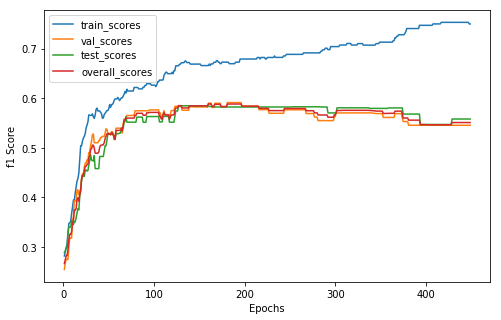

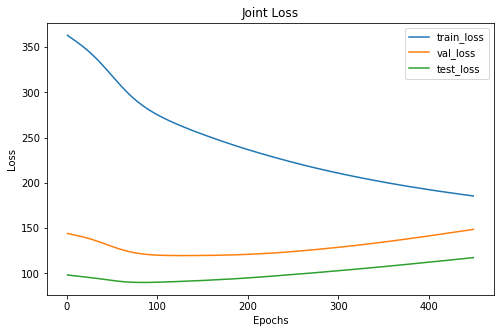

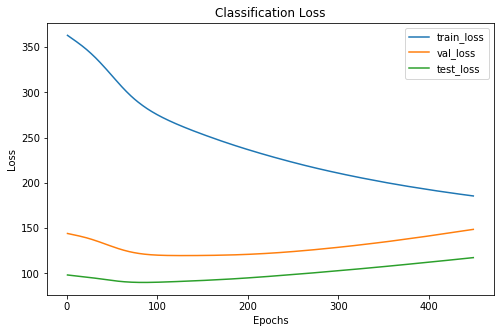

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     47      23
 1      137     51      45
 2       82     32      20
xxxxxxxxxxxxxx epoch: 449 xxxxxxxxxxxxxx


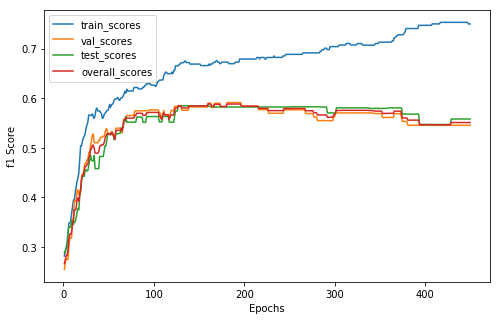

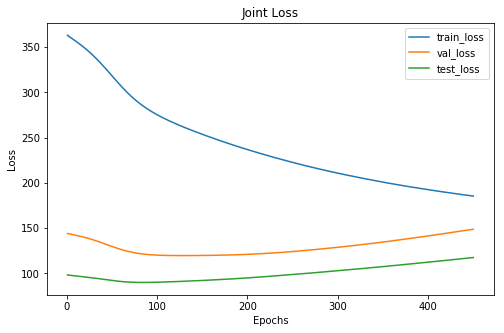

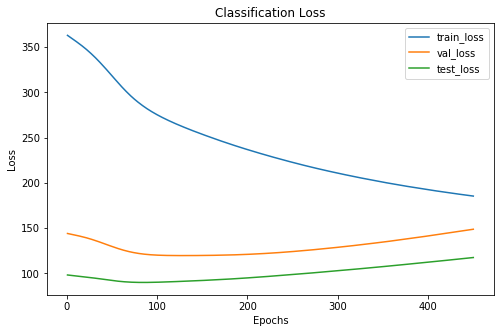

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     47      23
 1      137     51      45
 2       82     32      20
xxxxxxxxxxxxxx epoch: 450 xxxxxxxxxxxxxx


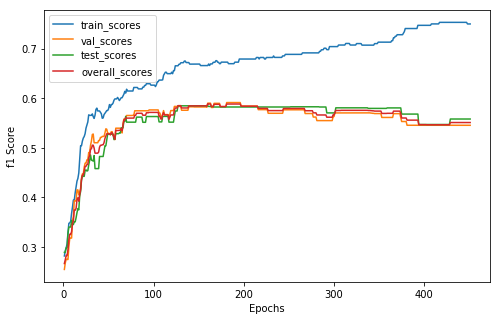

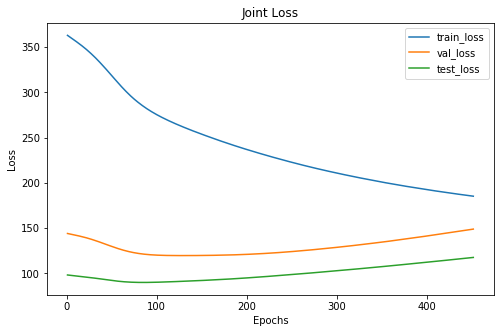

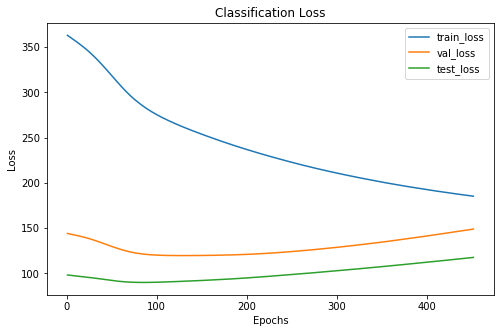

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      108     47      23
 1      137     51      45
 2       82     32      20
xxxxxxxxxxxxxx epoch: 451 xxxxxxxxxxxxxx


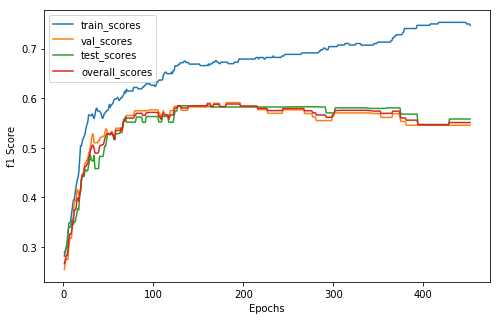

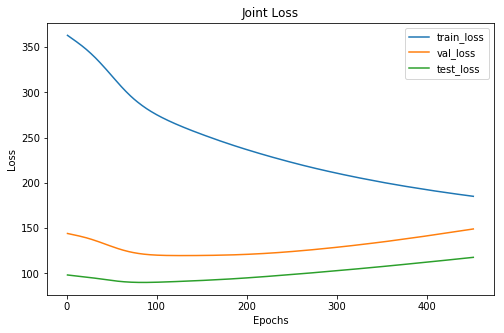

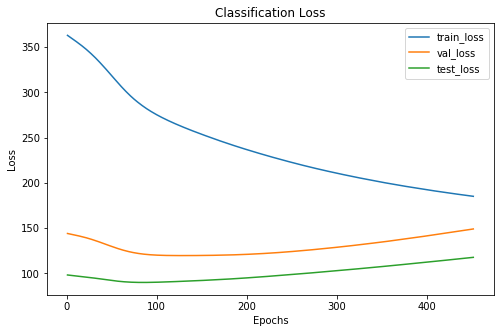

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     47      23
 1      138     51      45
 2       82     32      20
xxxxxxxxxxxxxx epoch: 452 xxxxxxxxxxxxxx


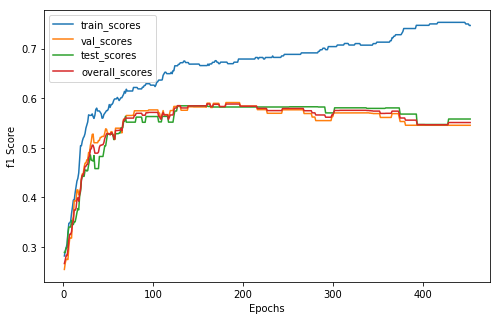

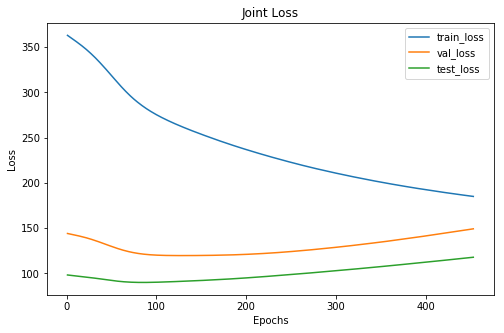

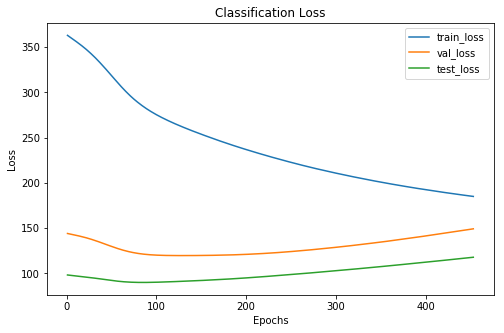

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     47      23
 1      138     51      45
 2       82     32      20
xxxxxxxxxxxxxx epoch: 453 xxxxxxxxxxxxxx


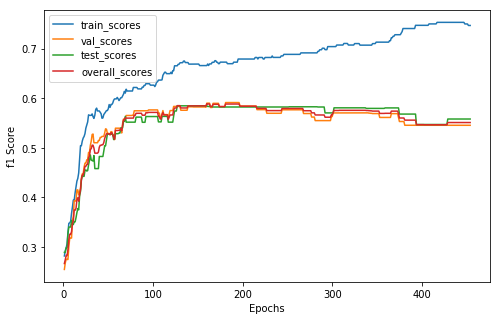

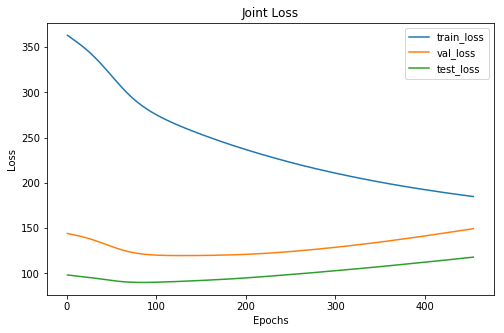

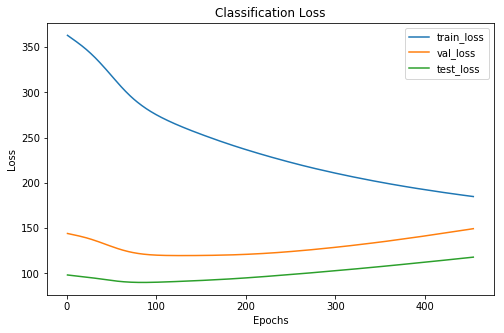

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     47      23
 1      138     51      45
 2       82     32      20
xxxxxxxxxxxxxx epoch: 454 xxxxxxxxxxxxxx


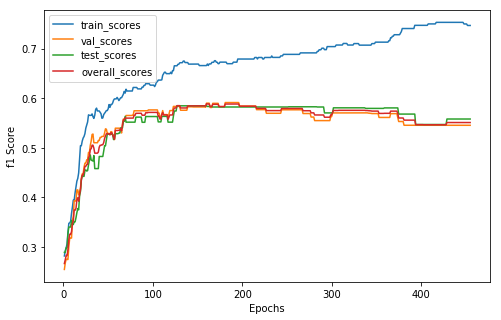

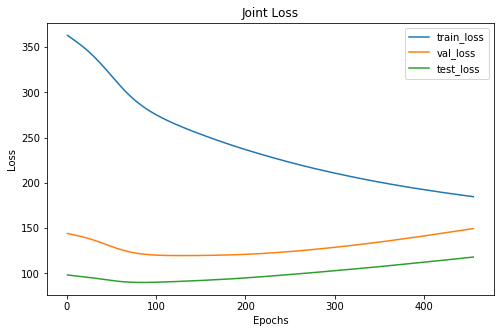

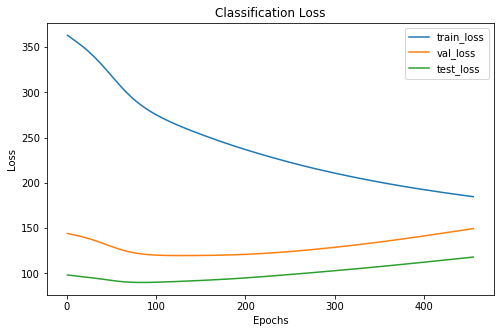

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     47      23
 1      138     51      45
 2       82     32      20
xxxxxxxxxxxxxx epoch: 455 xxxxxxxxxxxxxx


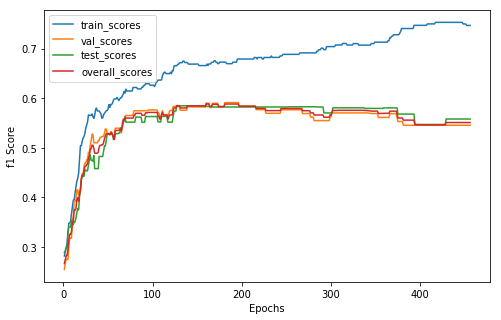

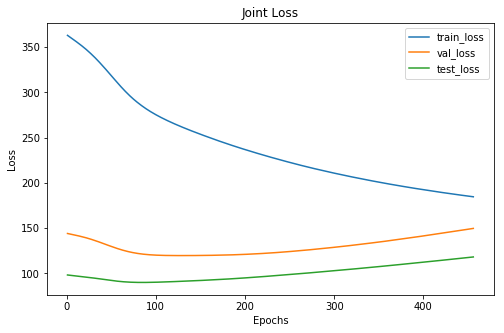

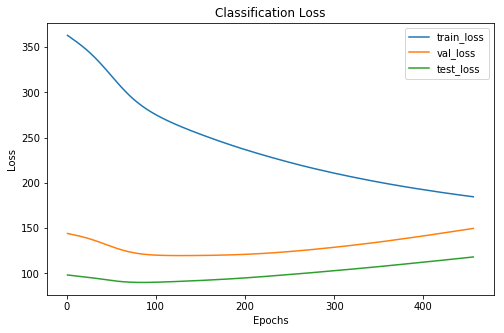

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     47      23
 1      138     51      45
 2       82     32      20
xxxxxxxxxxxxxx epoch: 456 xxxxxxxxxxxxxx


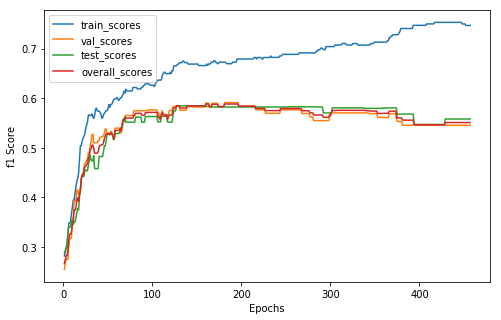

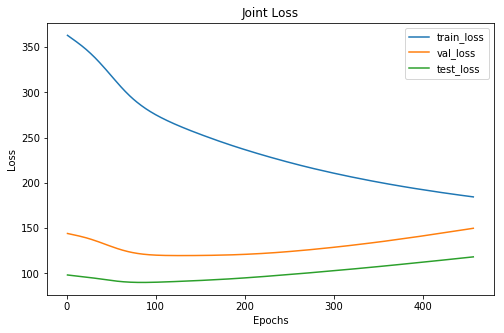

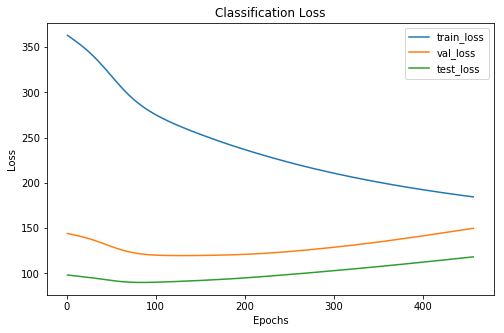

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     47      23
 1      138     51      45
 2       82     32      20
xxxxxxxxxxxxxx epoch: 457 xxxxxxxxxxxxxx


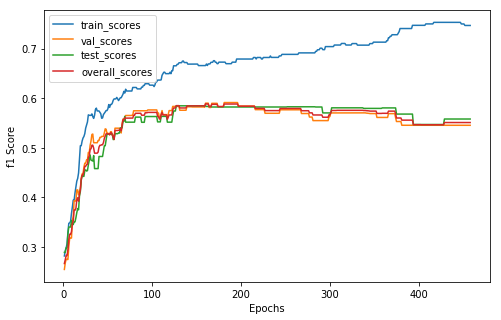

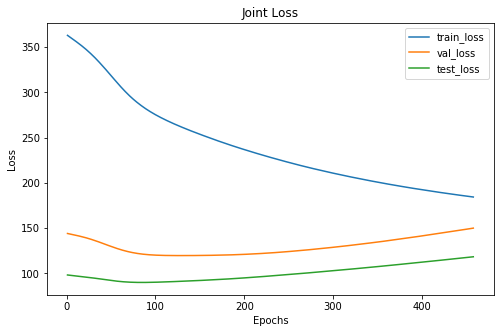

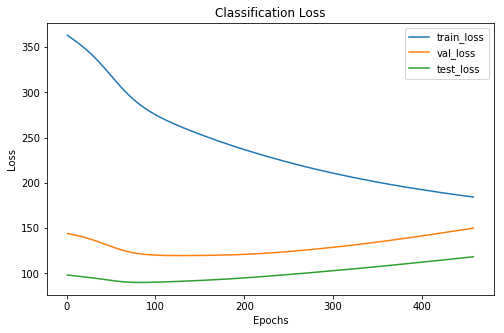

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     47      23
 1      138     51      45
 2       82     32      20
xxxxxxxxxxxxxx epoch: 458 xxxxxxxxxxxxxx


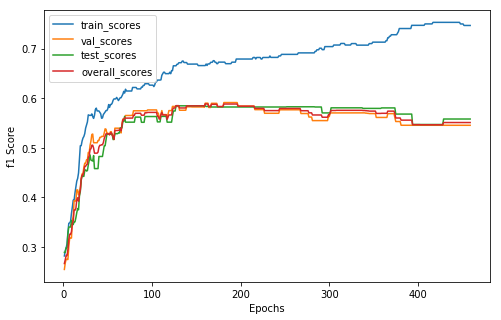

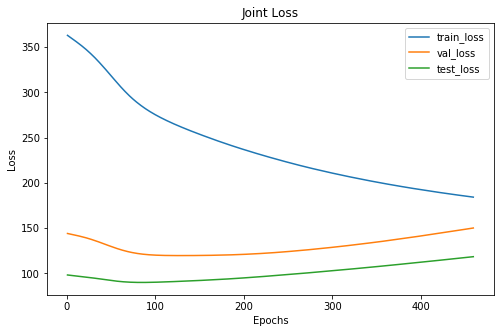

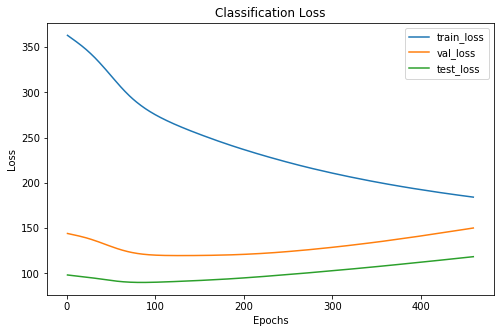

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     47      23
 1      138     51      45
 2       82     32      20
xxxxxxxxxxxxxx epoch: 459 xxxxxxxxxxxxxx


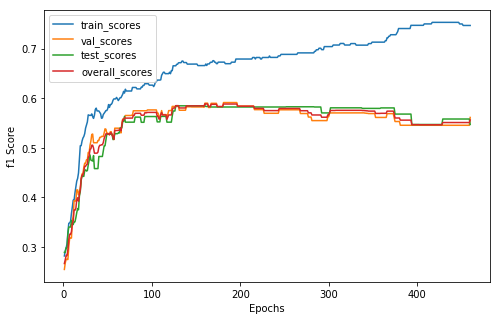

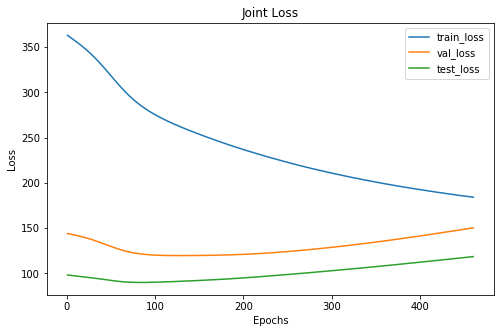

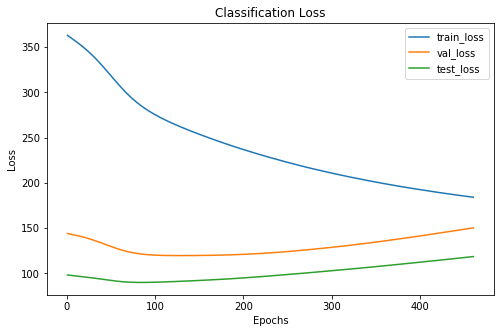

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     49      24
 1      138     49      44
 2       82     32      20
xxxxxxxxxxxxxx epoch: 460 xxxxxxxxxxxxxx


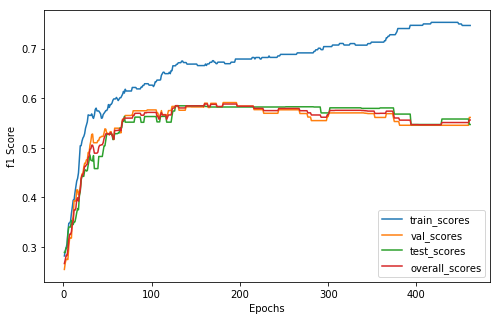

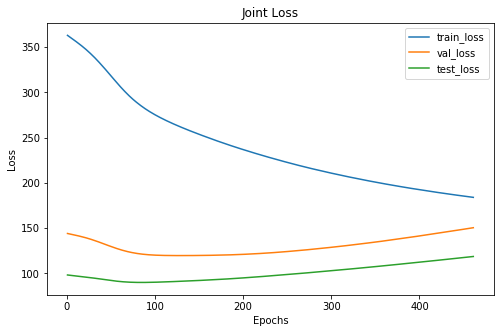

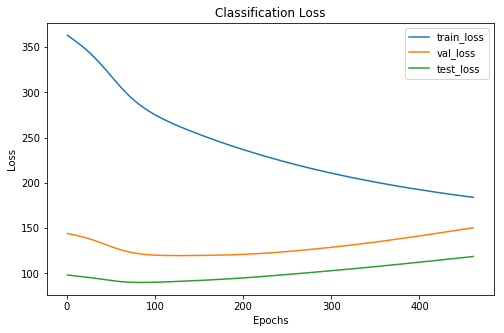

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     49      24
 1      138     49      44
 2       82     32      20
xxxxxxxxxxxxxx epoch: 461 xxxxxxxxxxxxxx


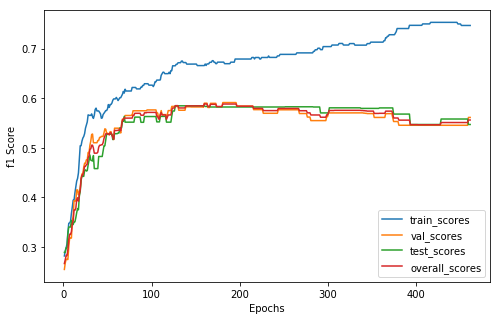

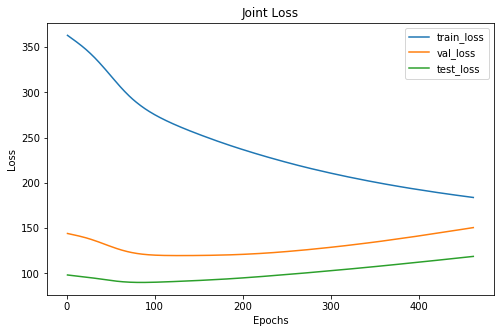

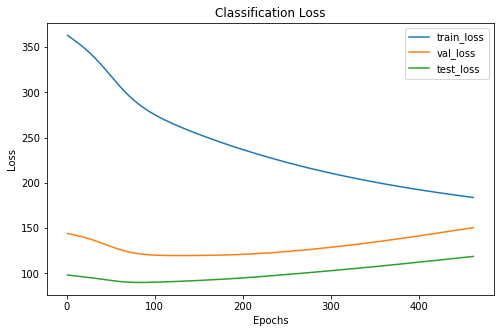

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     49      24
 1      138     49      44
 2       82     32      20
xxxxxxxxxxxxxx epoch: 462 xxxxxxxxxxxxxx


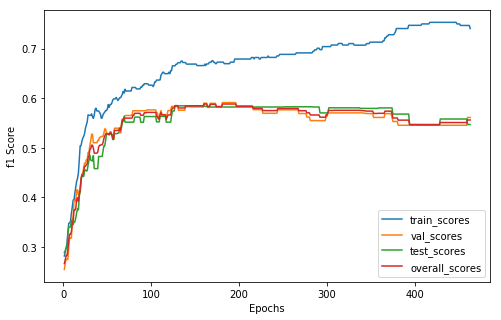

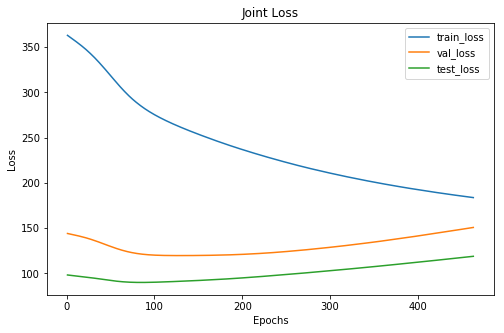

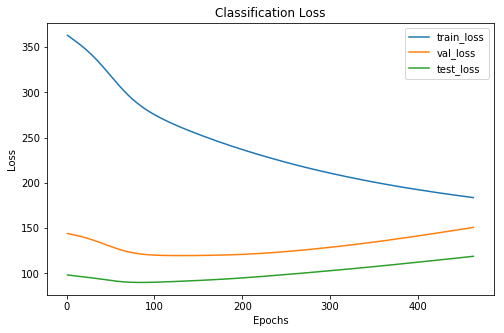

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     49      24
 1      138     49      44
 2       82     32      20
xxxxxxxxxxxxxx epoch: 463 xxxxxxxxxxxxxx


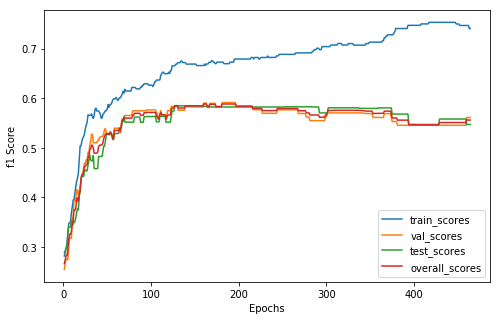

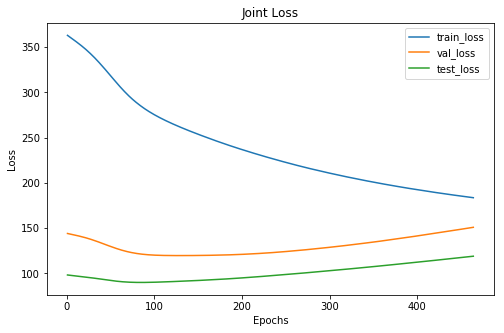

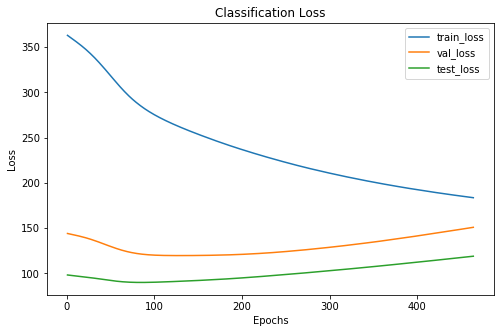

Cofusion Matrix For Val Set: 
--  --  --
29  19   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     49      24
 1      138     49      44
 2       82     32      20
xxxxxxxxxxxxxx epoch: 464 xxxxxxxxxxxxxx


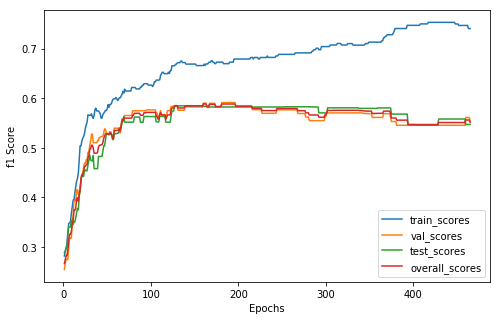

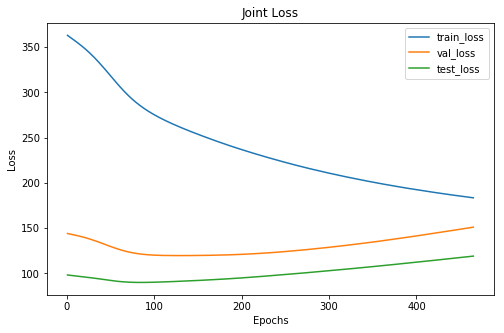

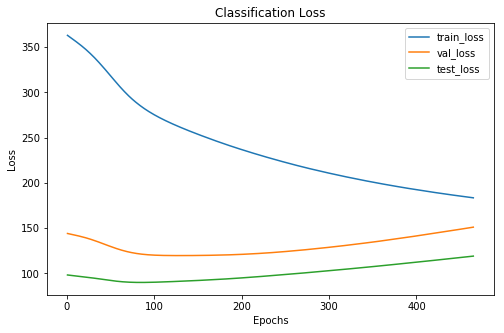

Cofusion Matrix For Val Set: 
--  --  --
28  20   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     48      24
 1      138     50      44
 2       82     32      20
xxxxxxxxxxxxxx epoch: 465 xxxxxxxxxxxxxx


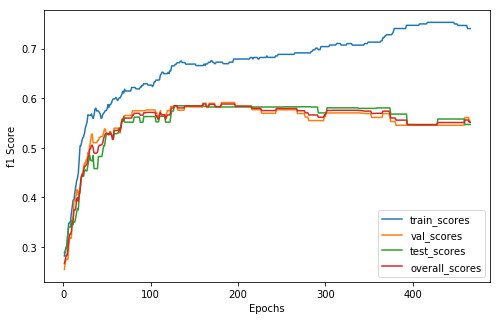

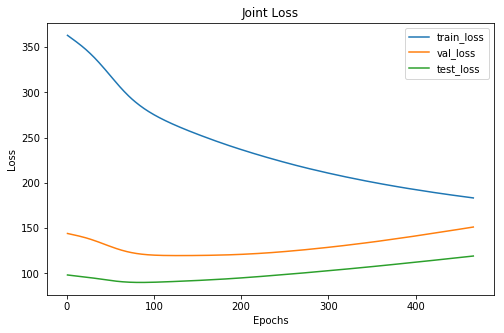

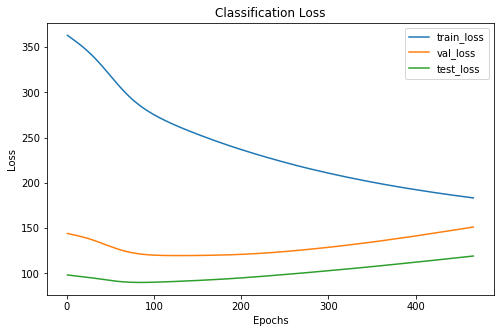

Cofusion Matrix For Val Set: 
--  --  --
28  20   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      107     48      24
 1      138     50      44
 2       82     32      20
xxxxxxxxxxxxxx epoch: 466 xxxxxxxxxxxxxx


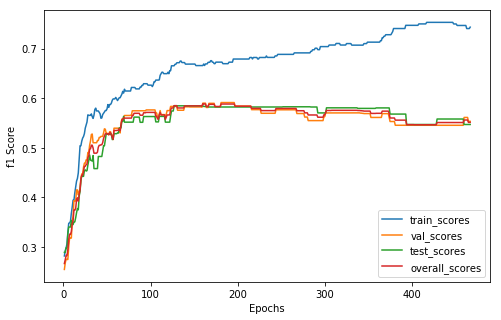

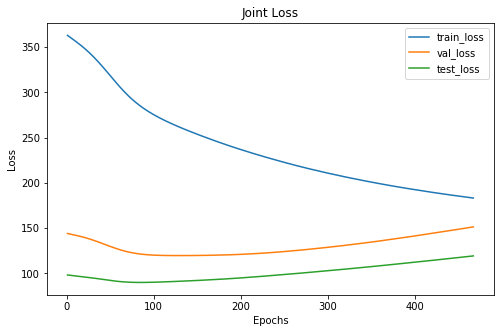

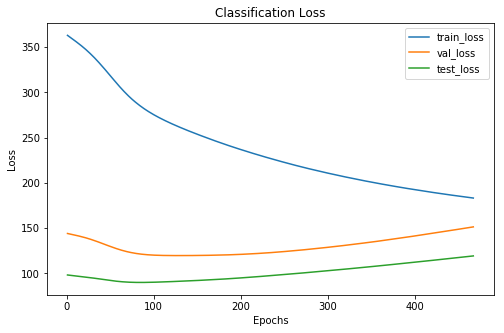

Cofusion Matrix For Val Set: 
--  --  --
28  20   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      106     48      24
 1      139     50      44
 2       82     32      20
xxxxxxxxxxxxxx epoch: 467 xxxxxxxxxxxxxx


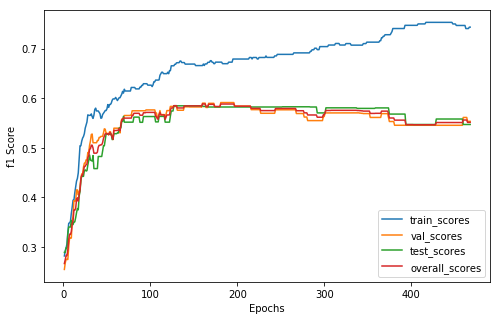

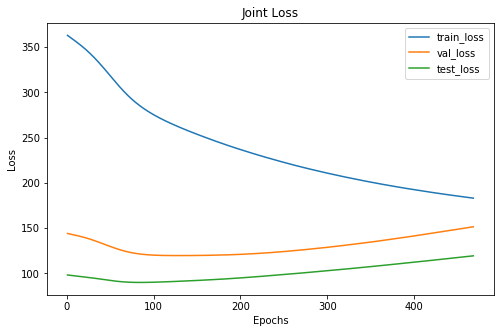

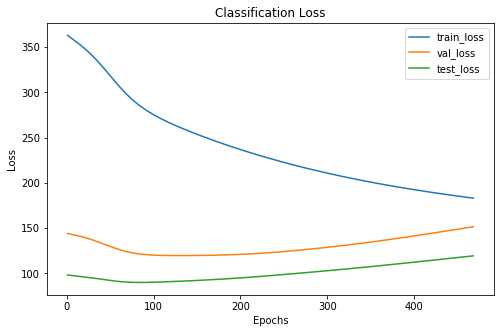

Cofusion Matrix For Val Set: 
--  --  --
28  20   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      106     48      24
 1      139     50      44
 2       82     32      20
xxxxxxxxxxxxxx epoch: 468 xxxxxxxxxxxxxx


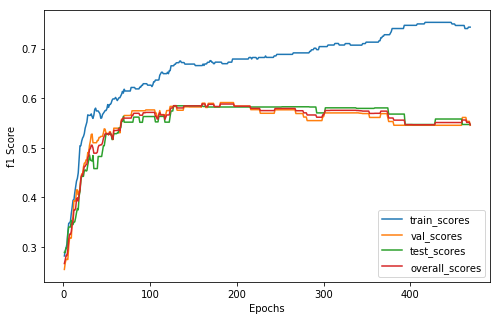

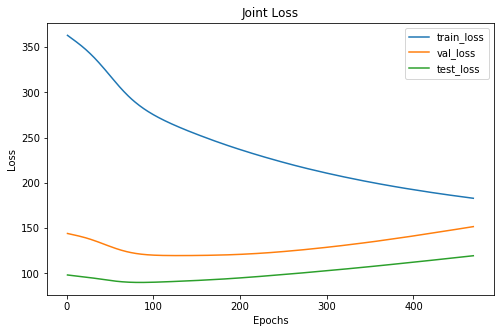

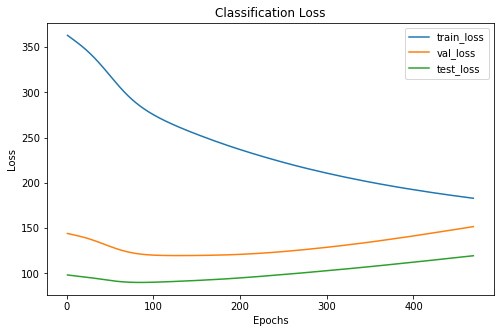

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      106     47      24
 1      139     51      44
 2       82     32      20
xxxxxxxxxxxxxx epoch: 469 xxxxxxxxxxxxxx


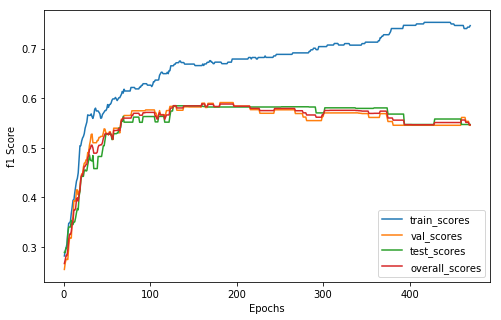

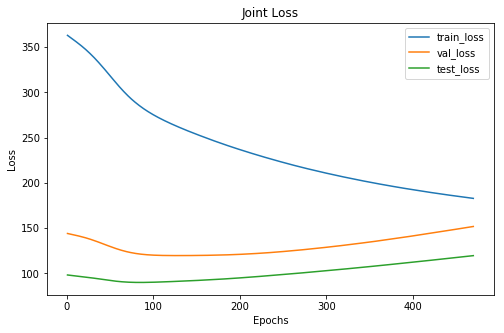

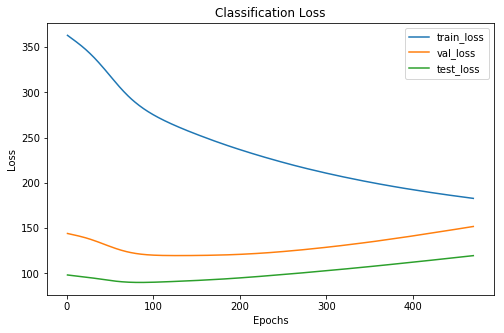

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      106     47      24
 1      140     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 470 xxxxxxxxxxxxxx


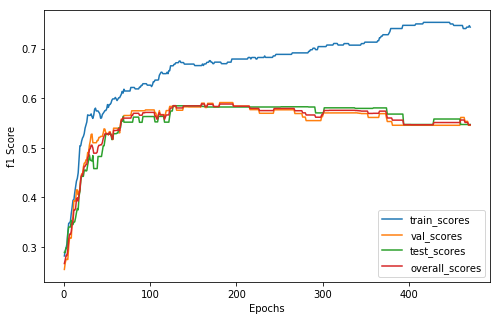

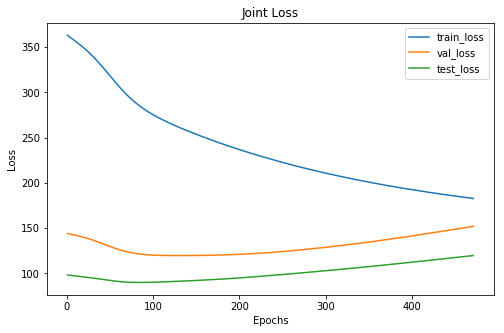

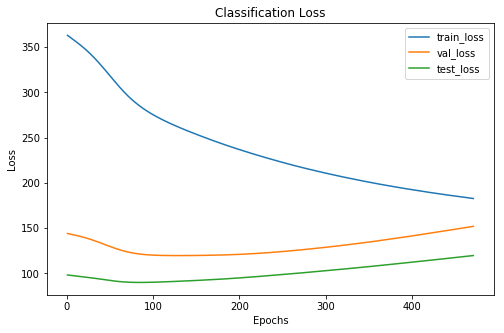

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     47      24
 1      141     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 471 xxxxxxxxxxxxxx


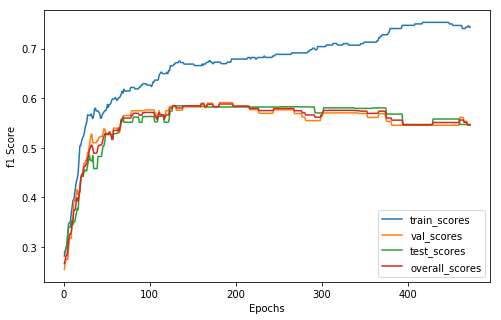

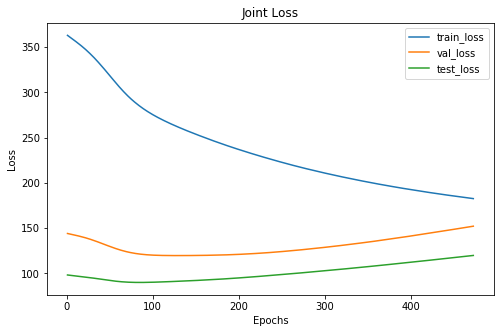

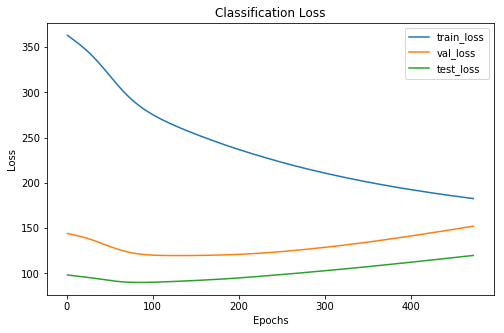

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     47      24
 1      141     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 472 xxxxxxxxxxxxxx


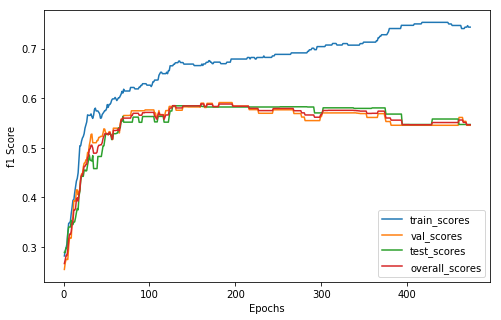

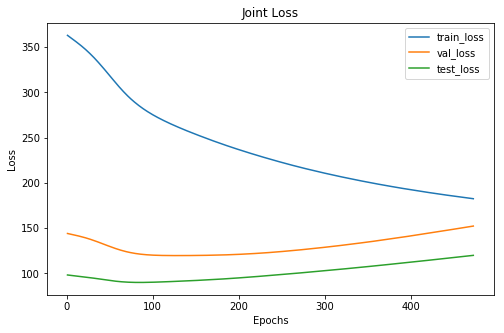

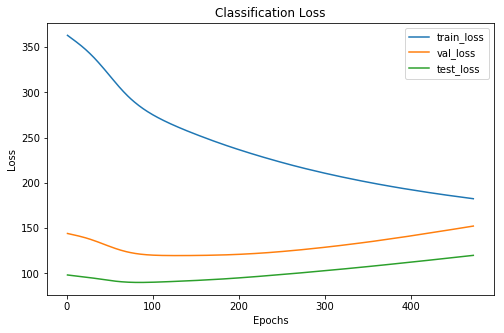

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     47      24
 1      141     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 473 xxxxxxxxxxxxxx


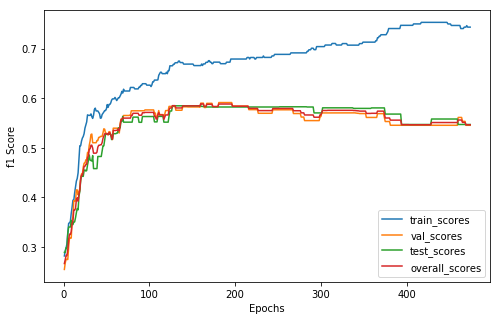

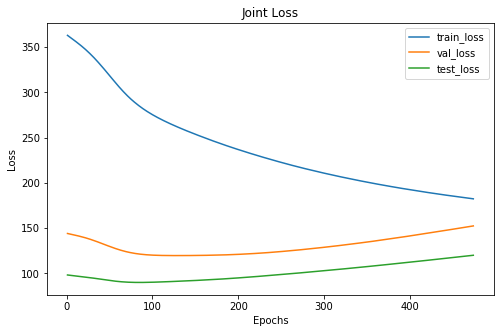

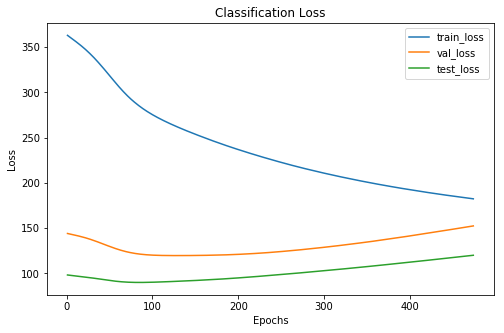

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     47      24
 1      141     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 474 xxxxxxxxxxxxxx


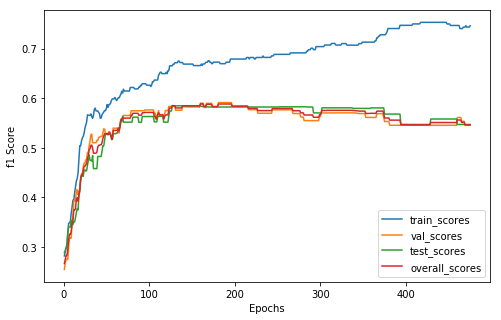

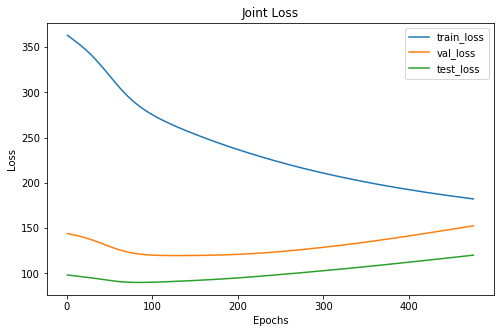

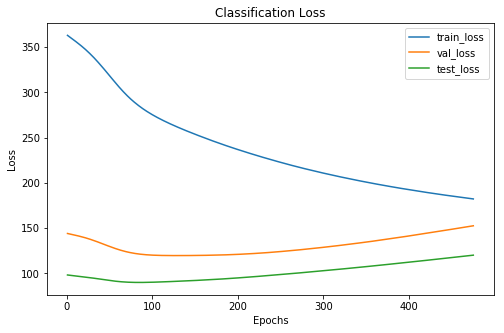

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      104     47      24
 1      142     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 475 xxxxxxxxxxxxxx


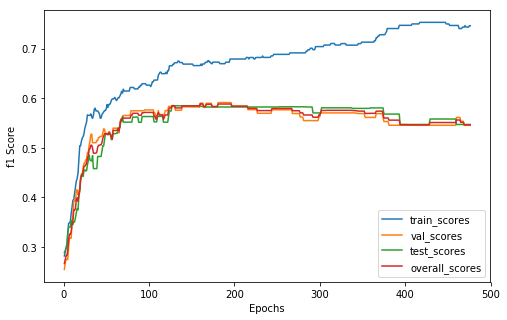

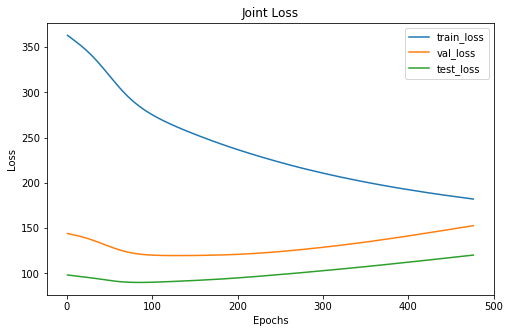

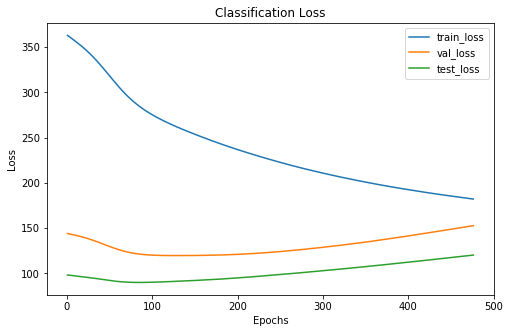

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      104     47      24
 1      142     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 476 xxxxxxxxxxxxxx


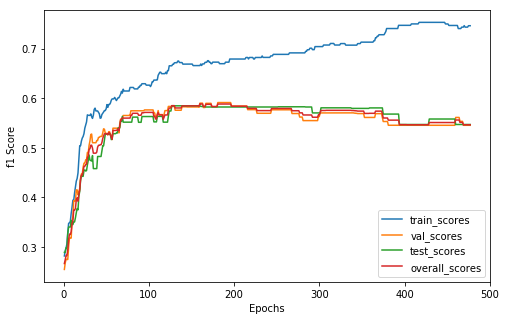

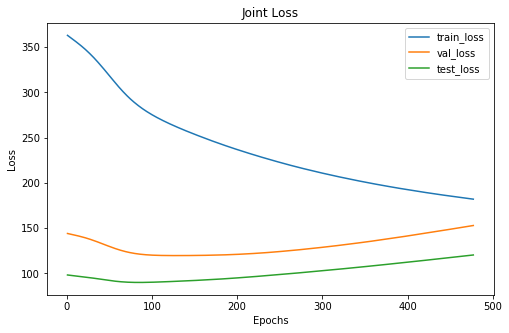

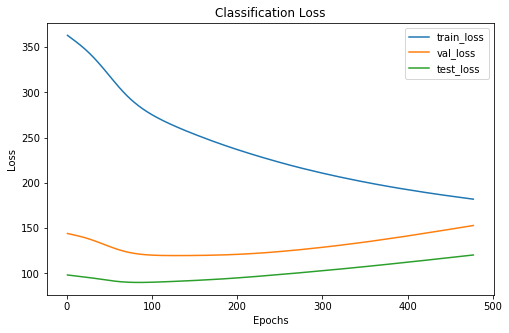

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      104     47      24
 1      142     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 477 xxxxxxxxxxxxxx


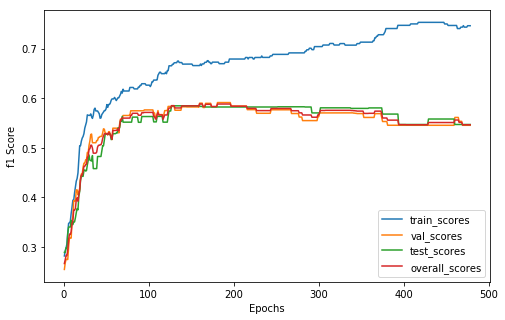

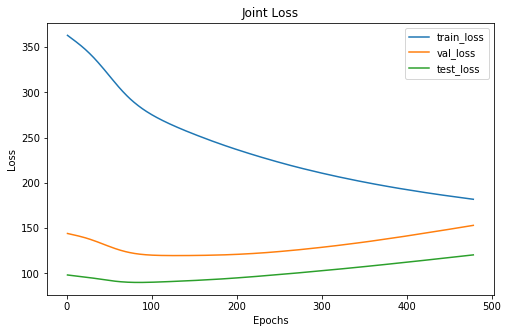

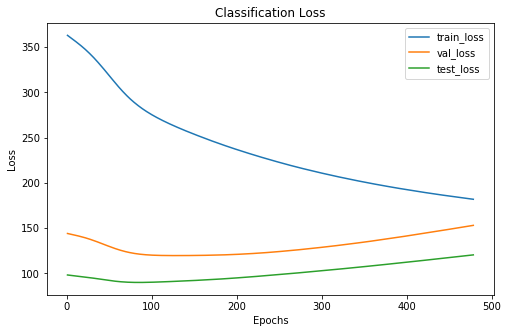

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      104     47      24
 1      142     51      44
 2       81     32      20
xxxxxxxxxxxxxx epoch: 478 xxxxxxxxxxxxxx


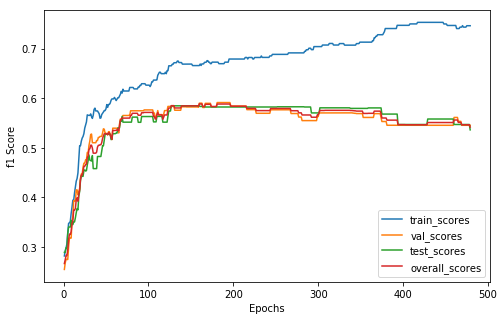

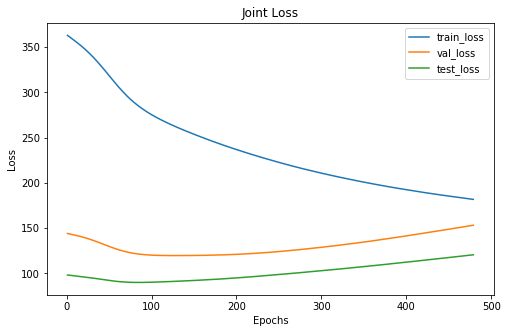

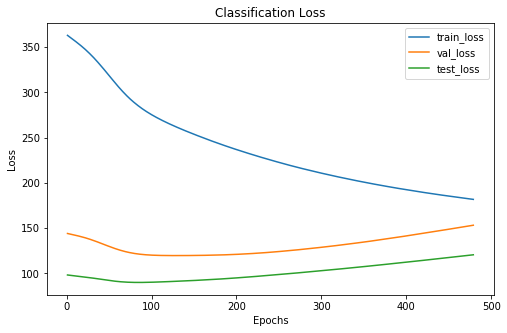

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 7   3  17
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      104     47      23
 1      142     51      44
 2       81     32      21
xxxxxxxxxxxxxx epoch: 479 xxxxxxxxxxxxxx


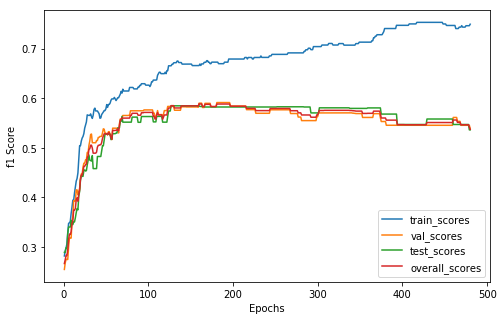

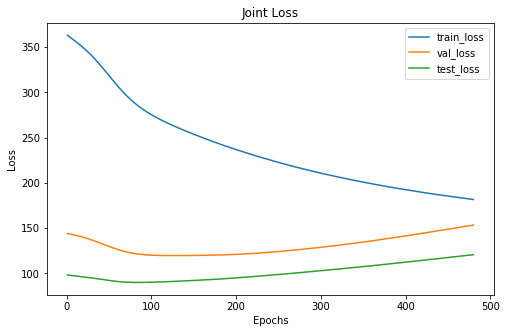

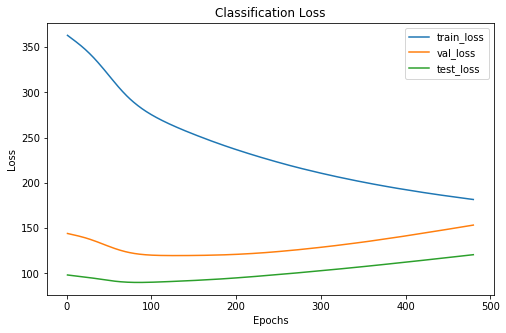

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 480 xxxxxxxxxxxxxx


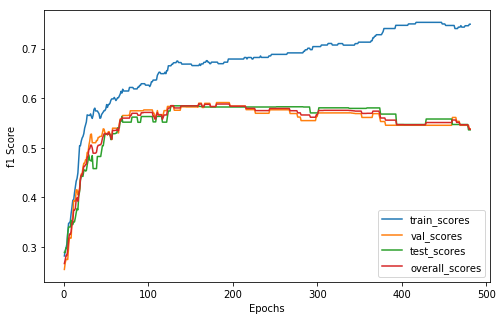

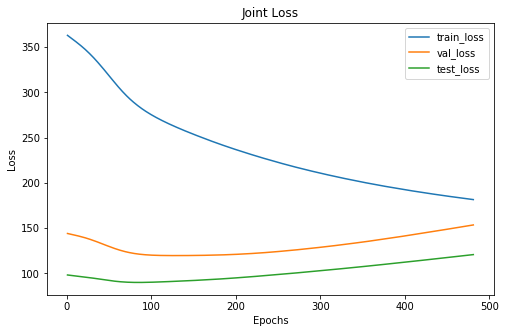

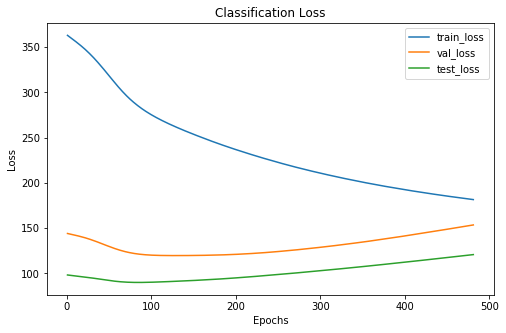

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 481 xxxxxxxxxxxxxx


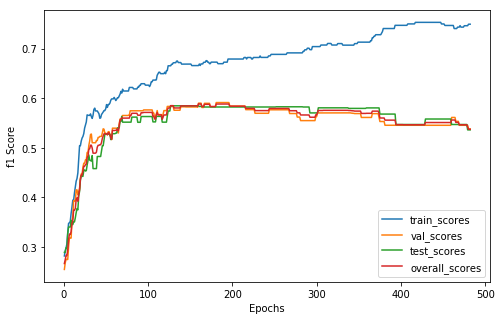

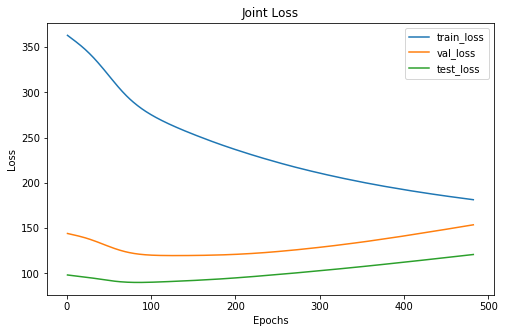

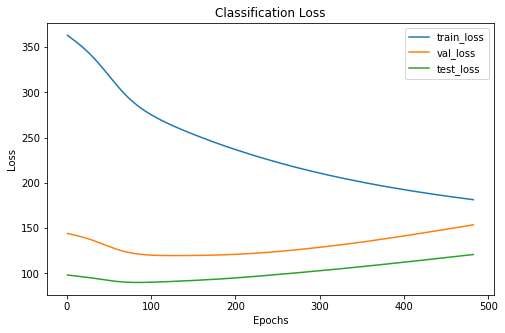

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 482 xxxxxxxxxxxxxx


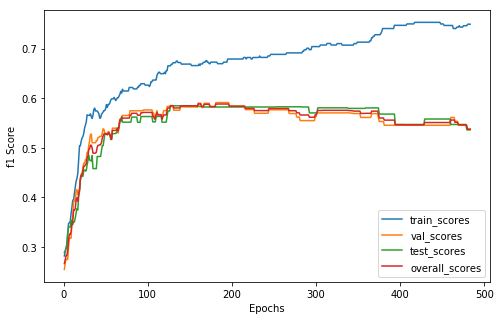

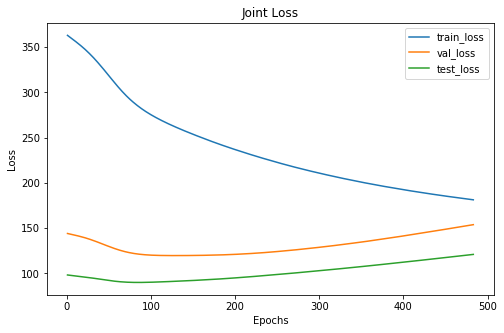

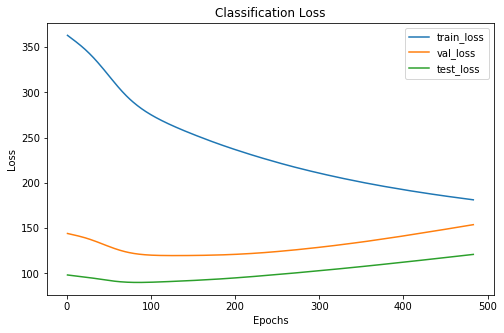

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 483 xxxxxxxxxxxxxx


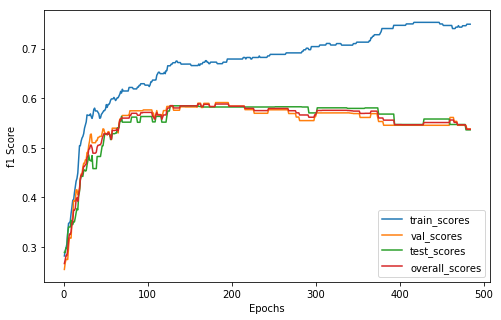

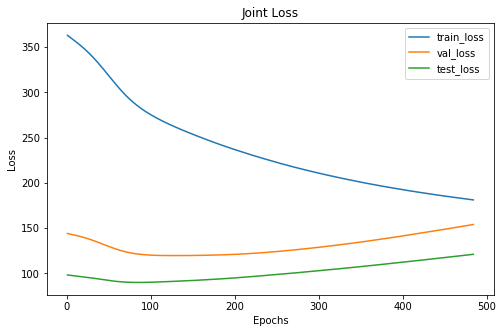

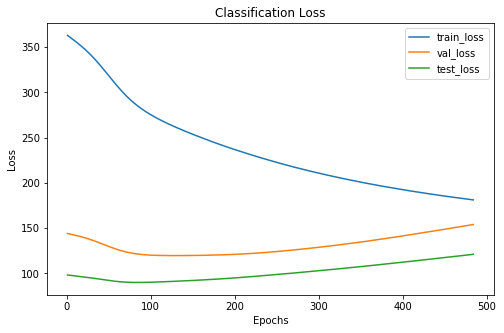

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 484 xxxxxxxxxxxxxx


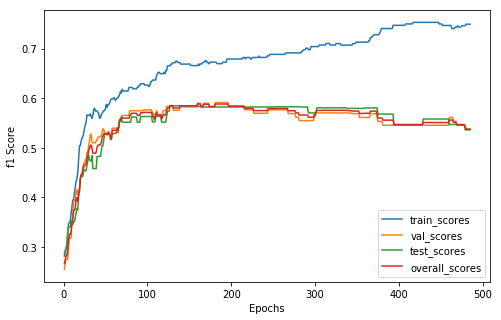

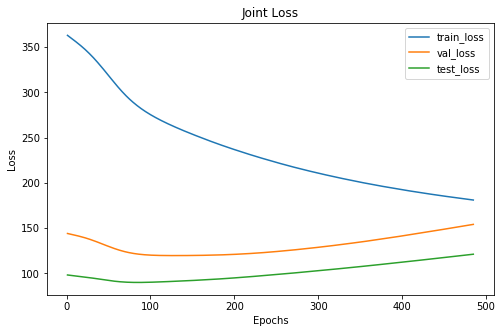

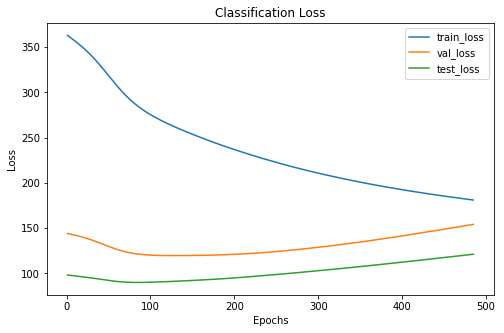

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 485 xxxxxxxxxxxxxx


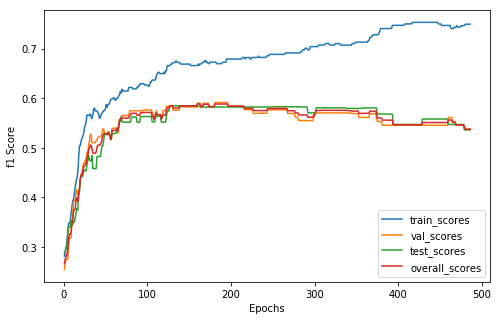

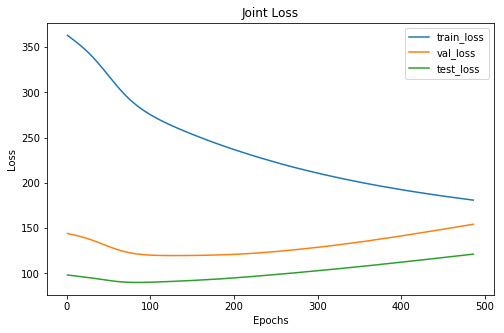

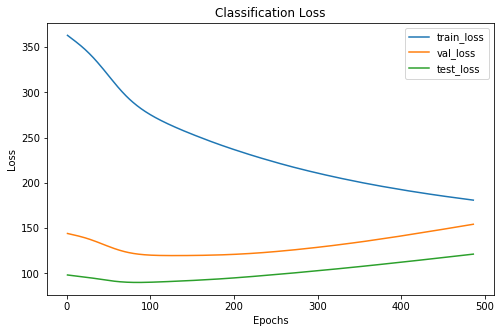

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 486 xxxxxxxxxxxxxx


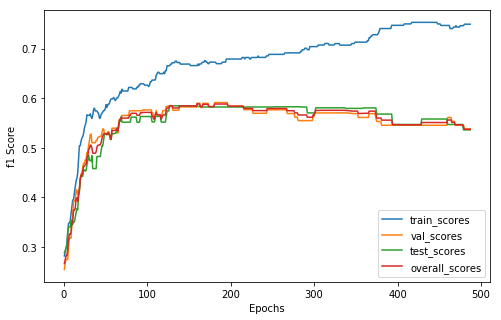

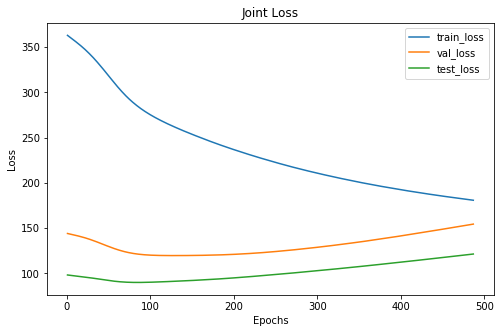

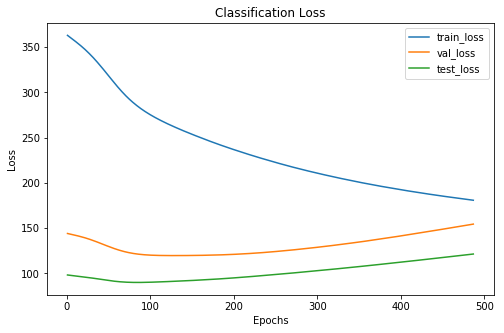

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 487 xxxxxxxxxxxxxx


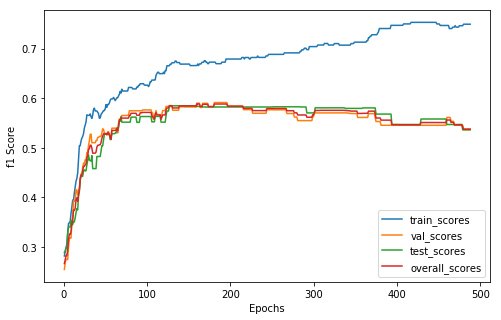

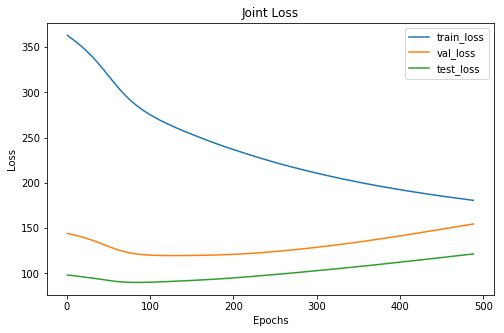

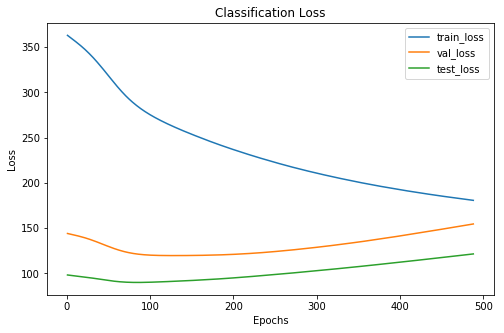

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 488 xxxxxxxxxxxxxx


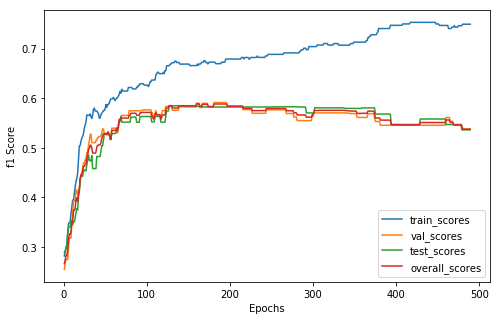

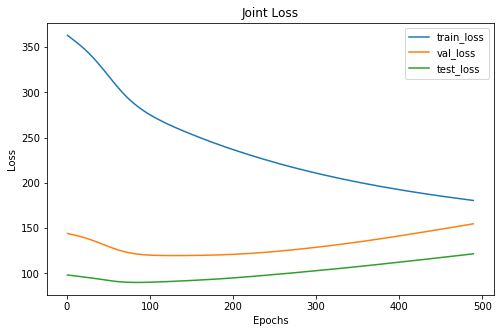

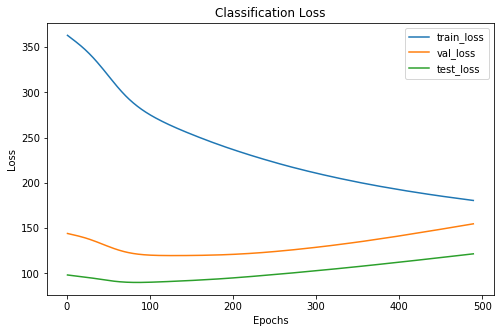

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 489 xxxxxxxxxxxxxx


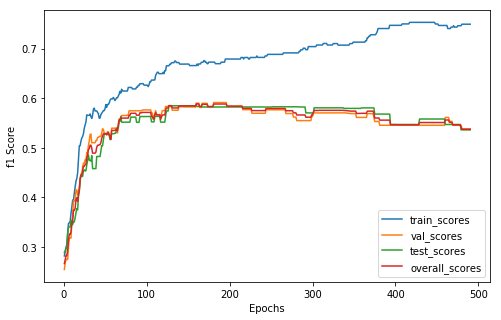

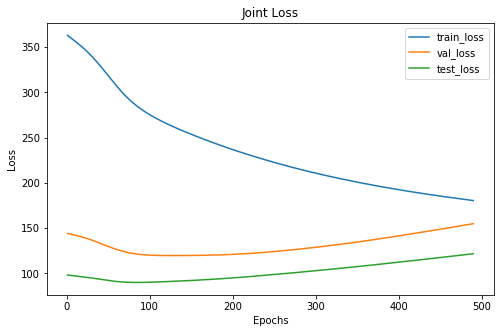

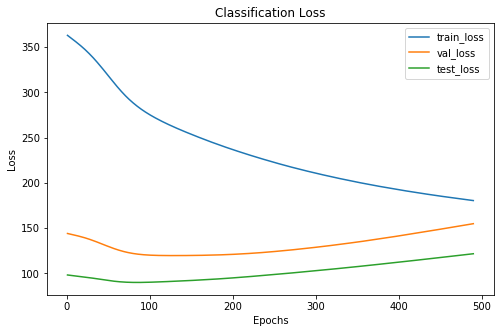

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 490 xxxxxxxxxxxxxx


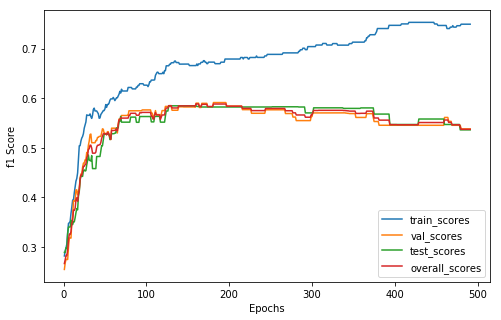

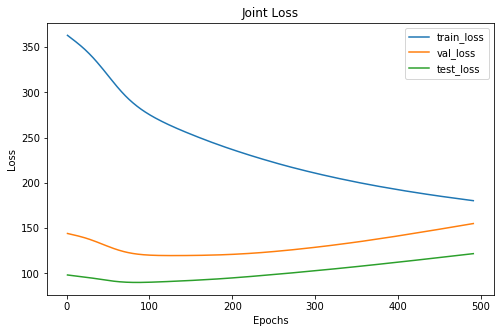

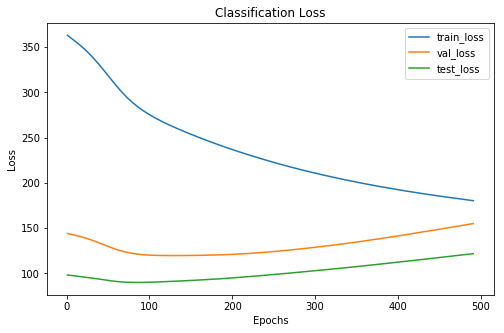

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 491 xxxxxxxxxxxxxx


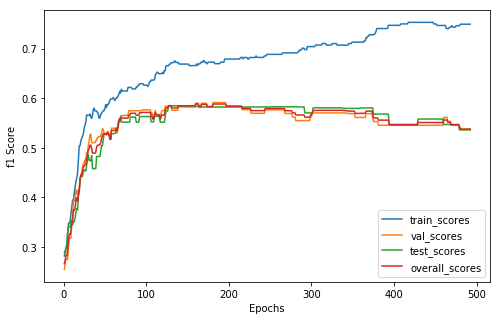

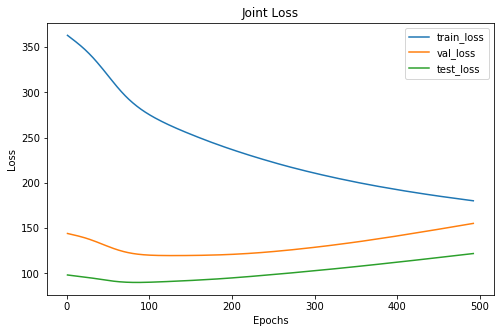

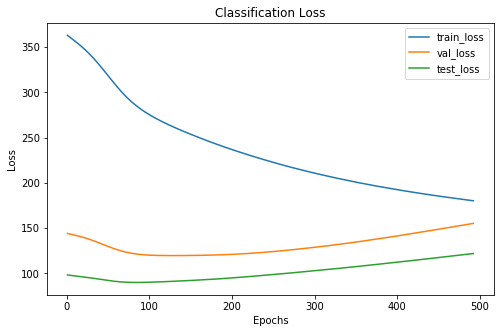

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 492 xxxxxxxxxxxxxx


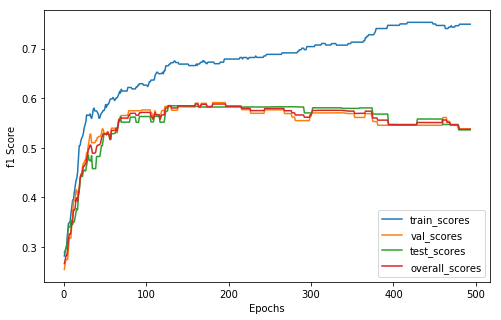

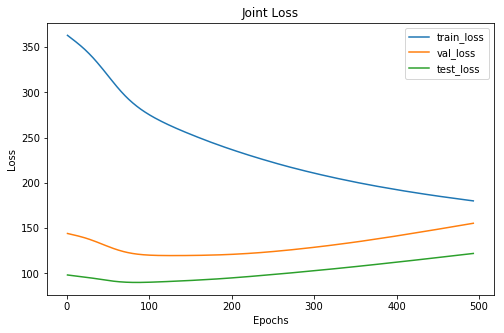

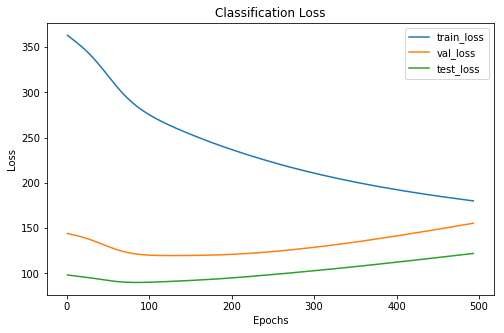

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 493 xxxxxxxxxxxxxx


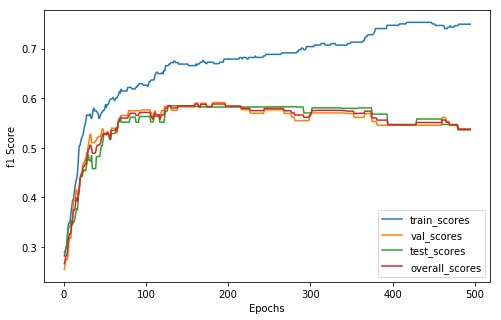

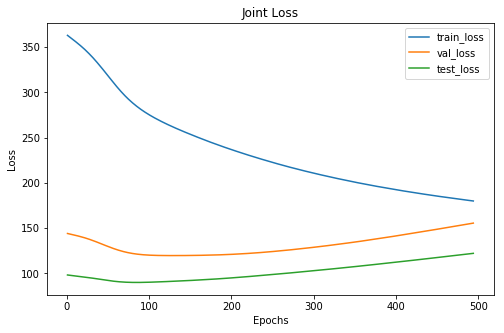

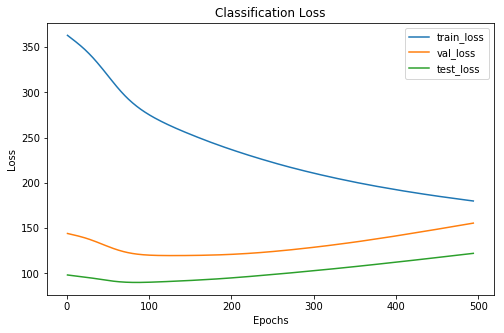

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 494 xxxxxxxxxxxxxx


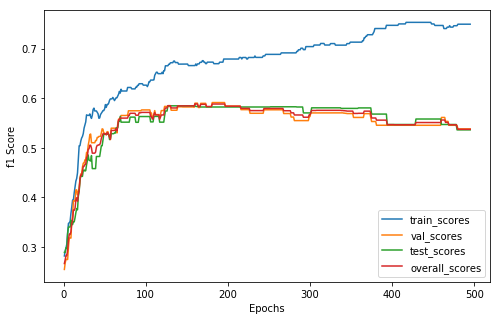

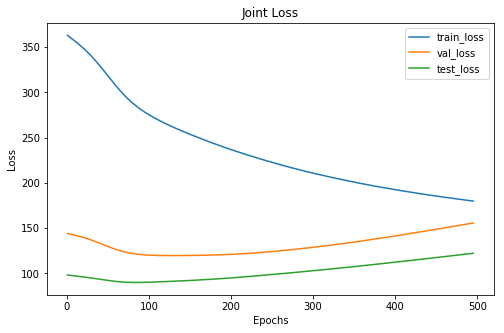

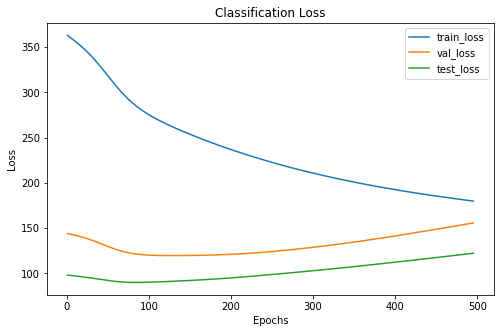

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 495 xxxxxxxxxxxxxx


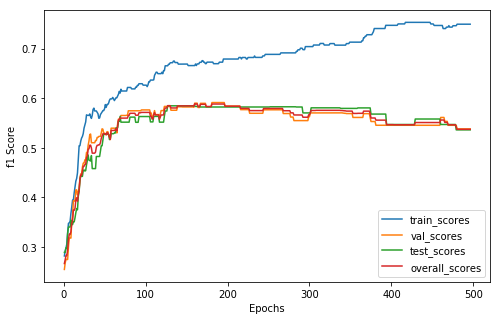

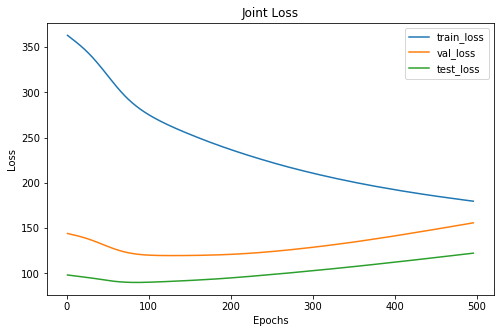

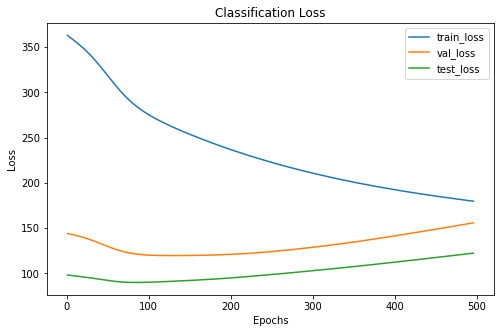

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 496 xxxxxxxxxxxxxx


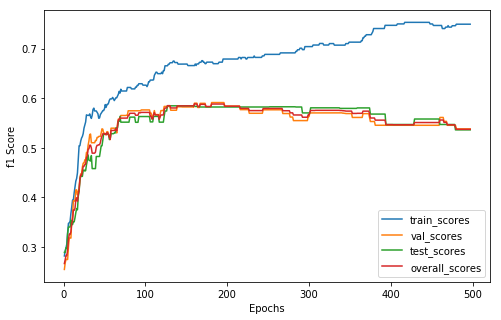

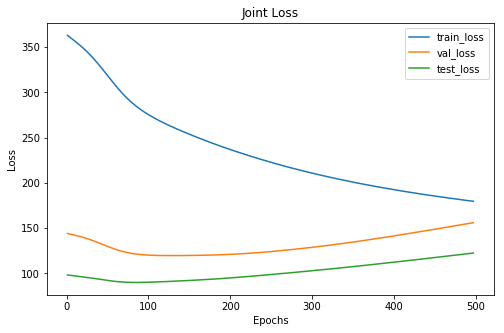

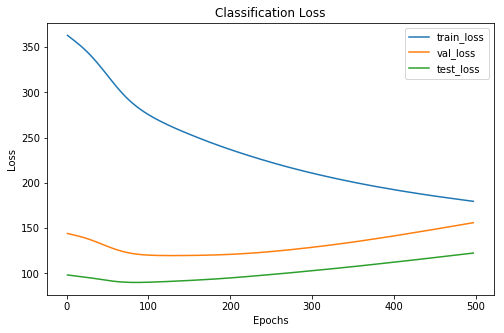

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 497 xxxxxxxxxxxxxx


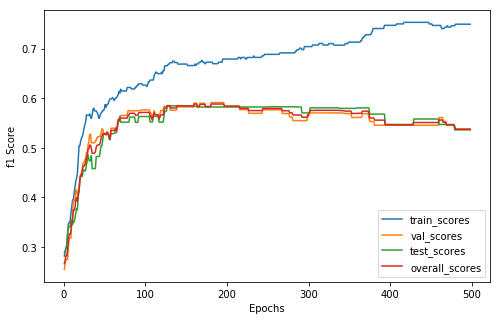

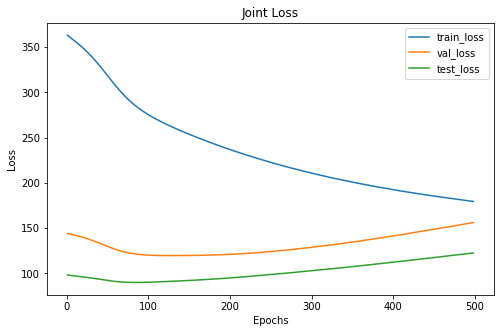

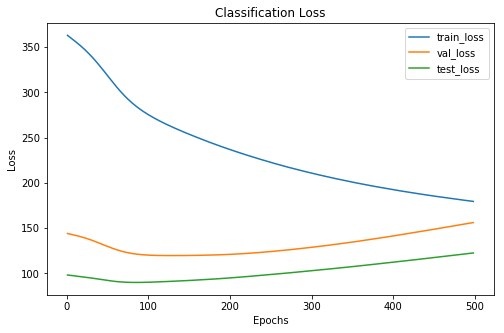

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      105     48      23
 1      141     51      44
 2       81     31      21
xxxxxxxxxxxxxx epoch: 498 xxxxxxxxxxxxxx


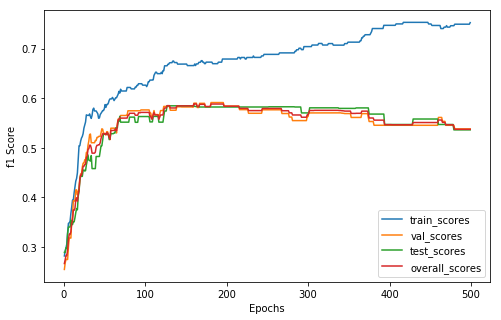

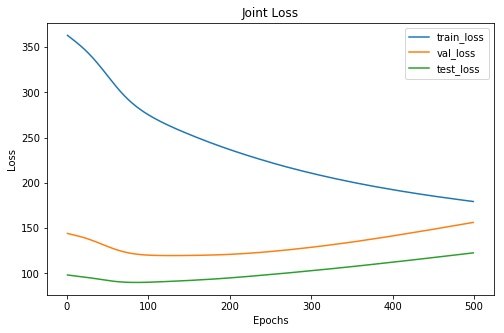

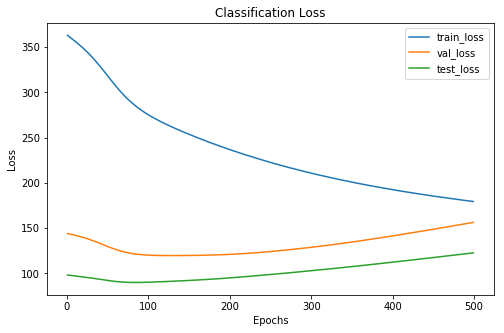

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      104     48      23
 1      141     51      44
 2       82     31      21
xxxxxxxxxxxxxx epoch: 499 xxxxxxxxxxxxxx


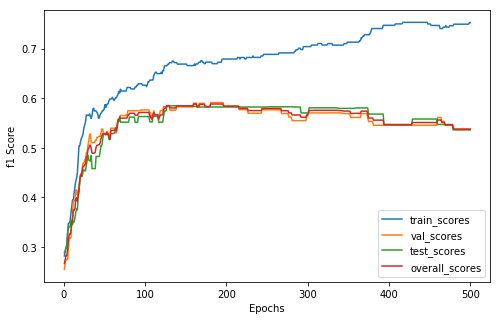

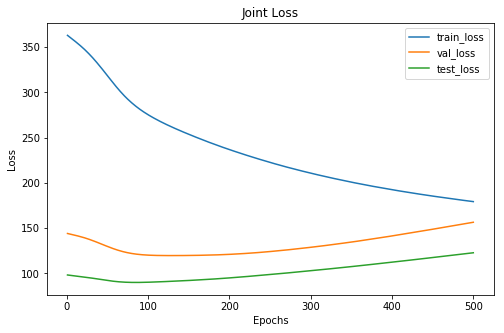

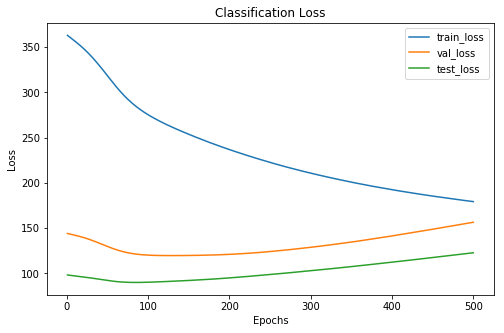

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      104     48      23
 1      141     51      44
 2       82     31      21
xxxxxxxxxxxxxx epoch: 500 xxxxxxxxxxxxxx


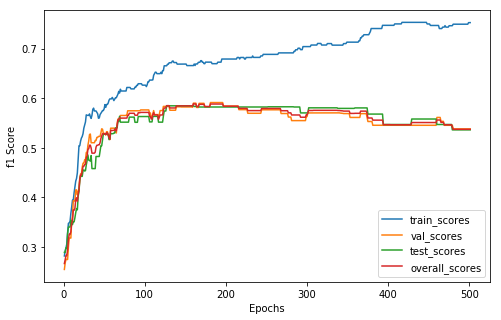

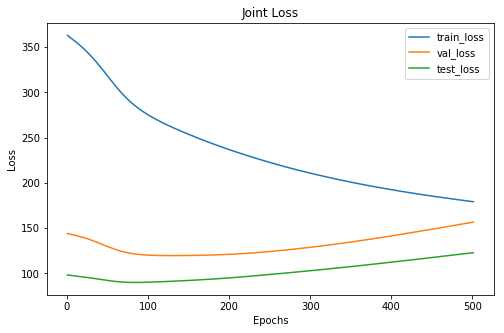

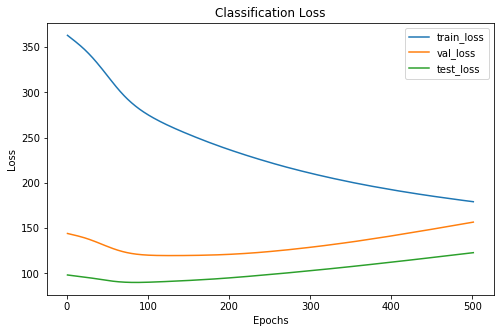

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      103     48      23
 1      142     51      44
 2       82     31      21
xxxxxxxxxxxxxx epoch: 501 xxxxxxxxxxxxxx


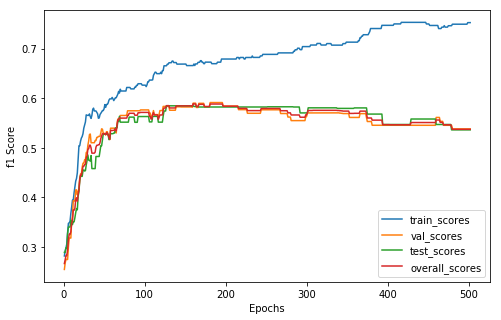

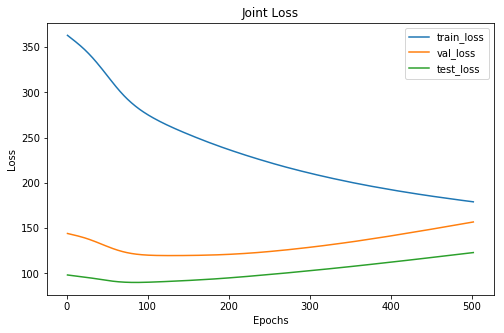

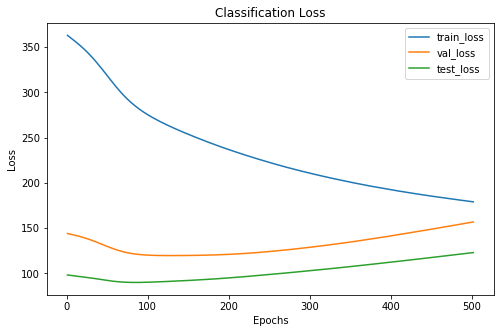

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      103     48      23
 1      142     51      44
 2       82     31      21
xxxxxxxxxxxxxx epoch: 502 xxxxxxxxxxxxxx


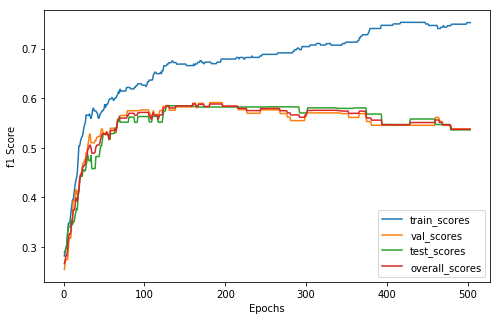

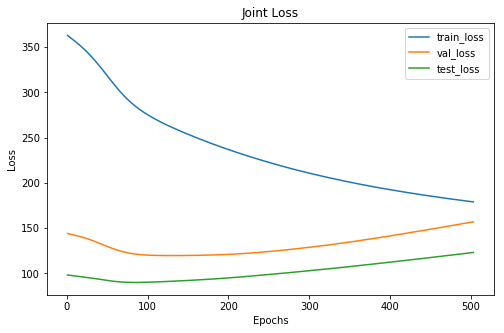

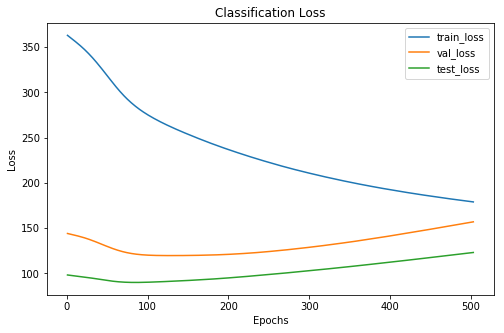

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      103     48      23
 1      142     51      44
 2       82     31      21
xxxxxxxxxxxxxx epoch: 503 xxxxxxxxxxxxxx


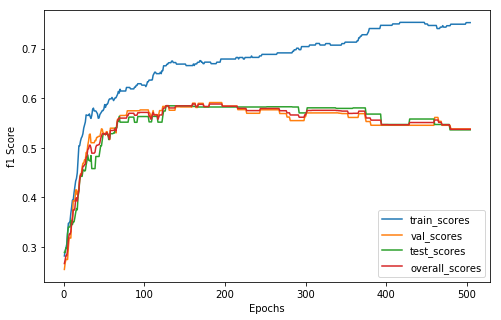

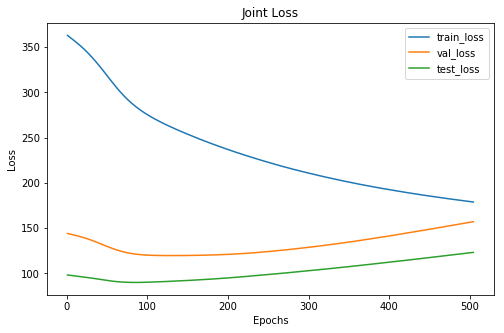

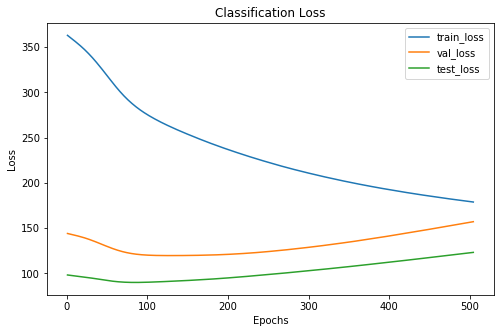

Cofusion Matrix For Val Set: 
--  --  --
27  21   5
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      103     48      23
 1      142     51      44
 2       82     31      21
xxxxxxxxxxxxxx epoch: 504 xxxxxxxxxxxxxx


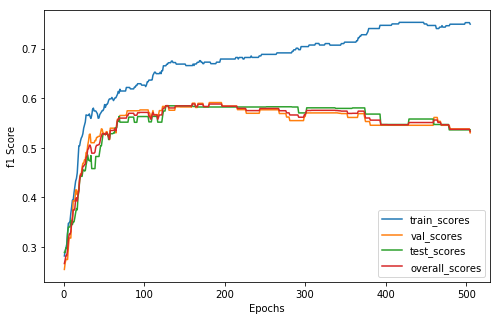

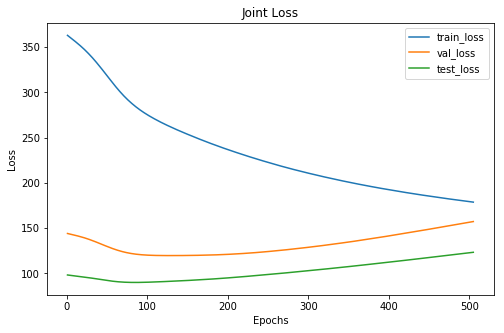

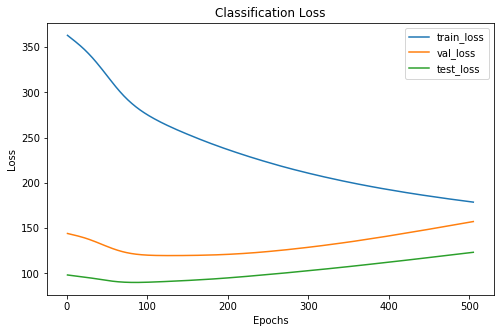

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      102     47      23
 1      143     51      44
 2       82     32      21
xxxxxxxxxxxxxx epoch: 505 xxxxxxxxxxxxxx


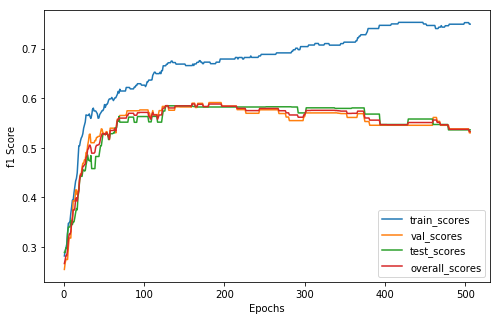

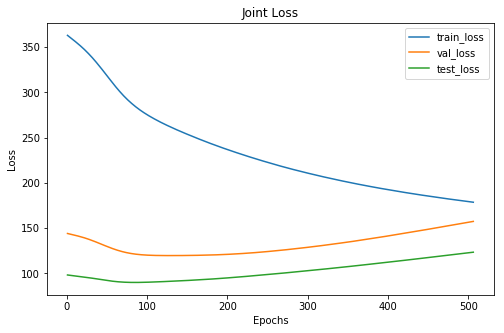

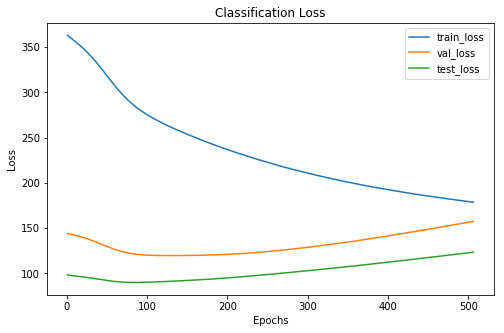

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      102     47      23
 1      143     51      44
 2       82     32      21
xxxxxxxxxxxxxx epoch: 506 xxxxxxxxxxxxxx


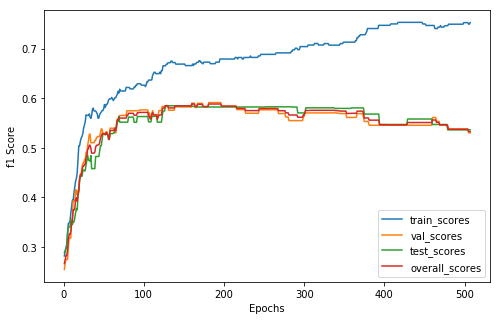

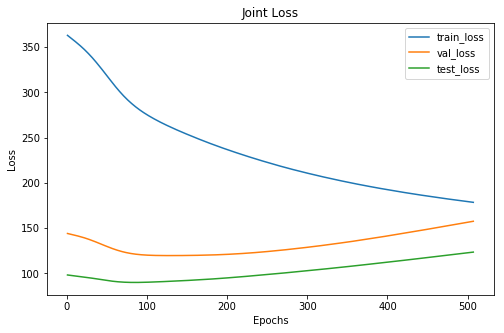

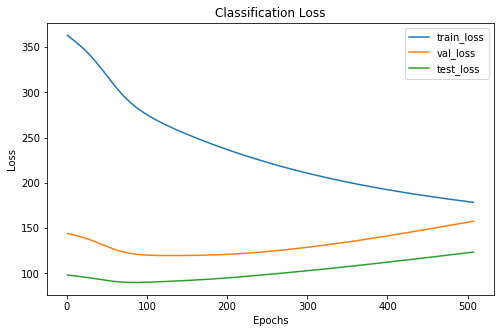

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      23
 1      143     51      44
 2       83     32      21
xxxxxxxxxxxxxx epoch: 507 xxxxxxxxxxxxxx


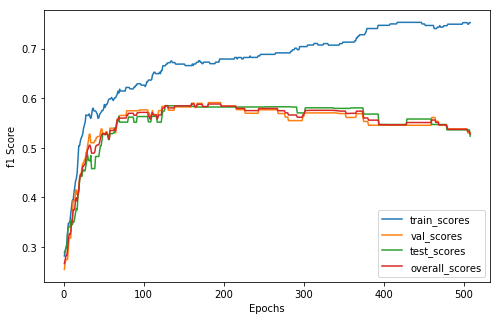

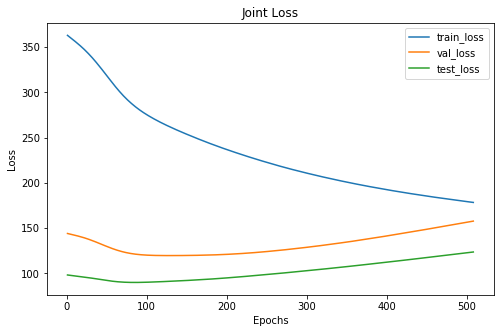

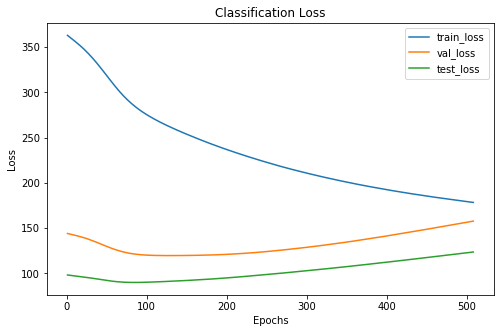

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 508 xxxxxxxxxxxxxx


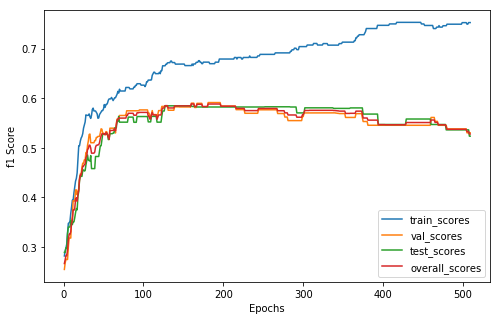

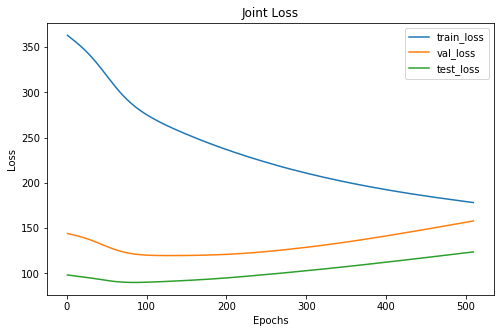

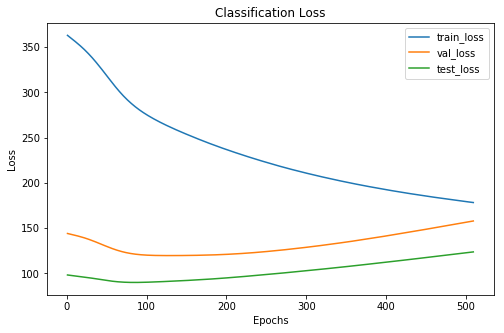

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 509 xxxxxxxxxxxxxx


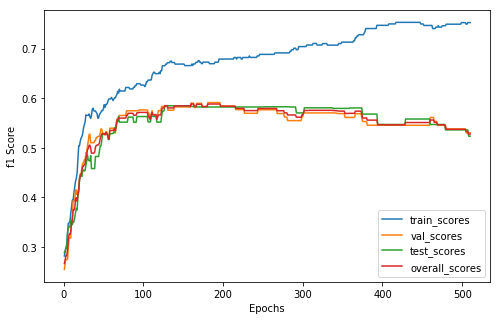

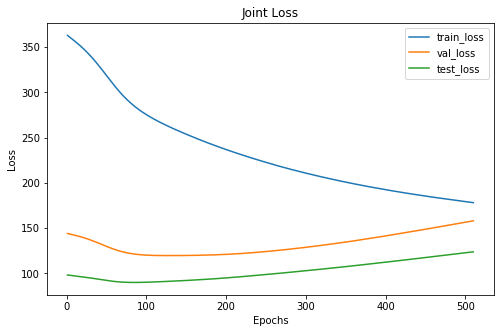

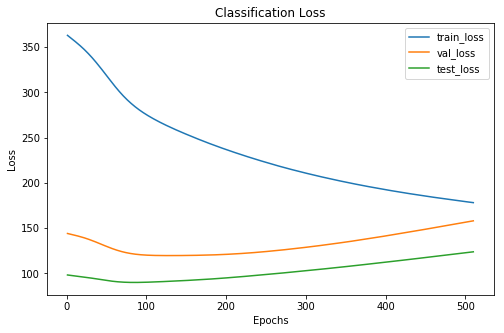

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 510 xxxxxxxxxxxxxx


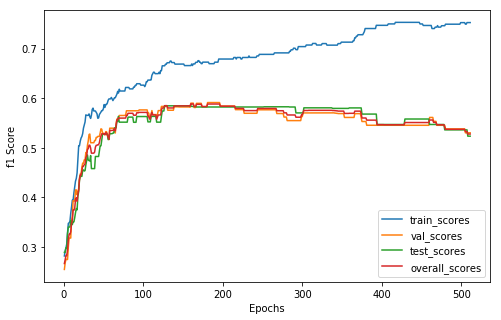

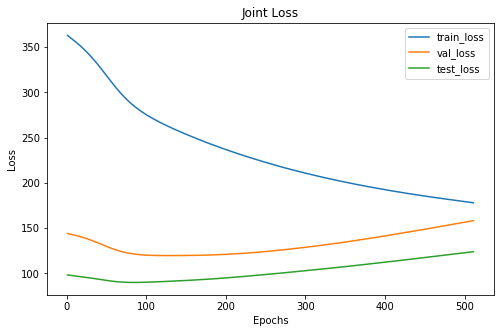

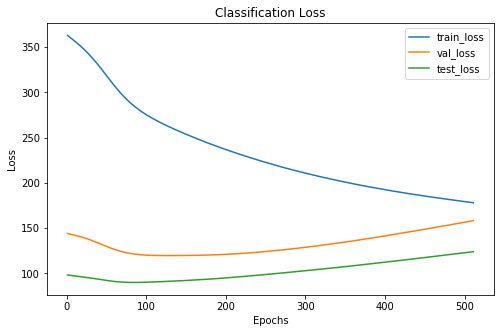

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 511 xxxxxxxxxxxxxx


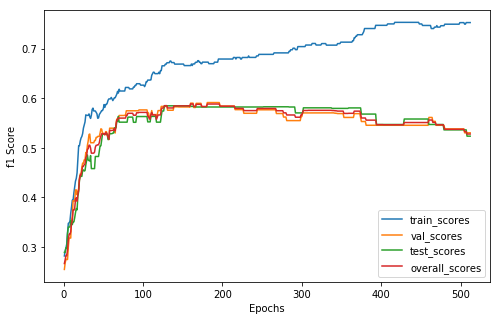

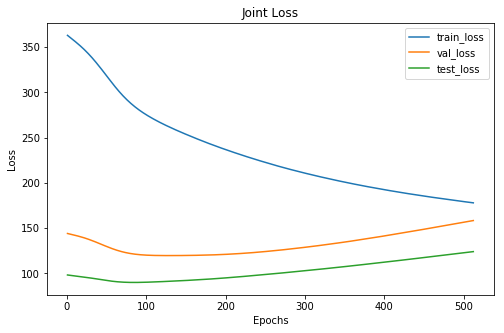

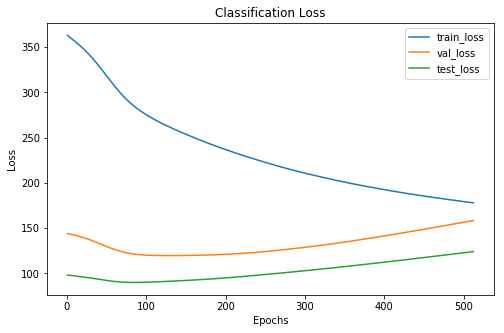

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 512 xxxxxxxxxxxxxx


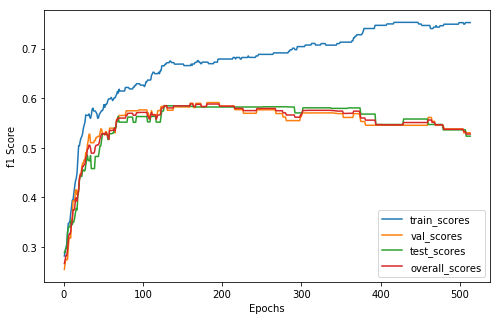

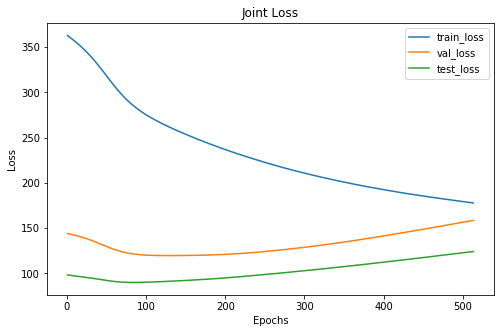

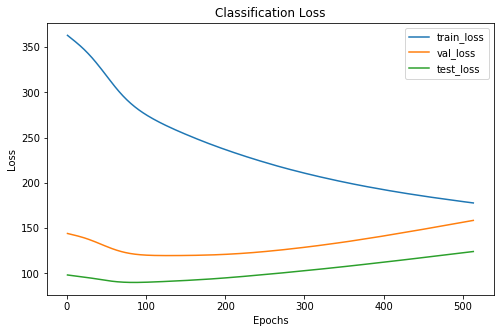

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 513 xxxxxxxxxxxxxx


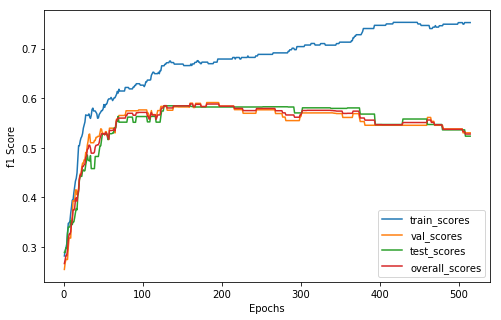

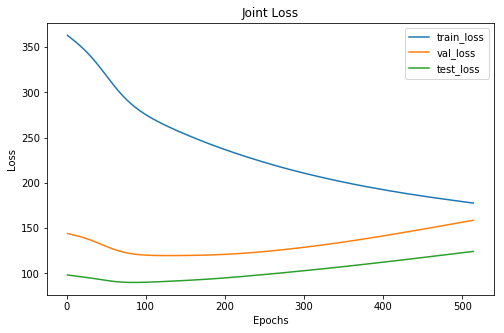

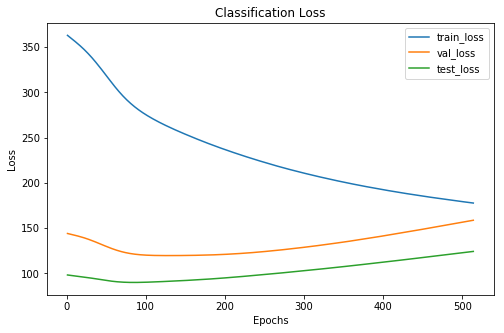

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 514 xxxxxxxxxxxxxx


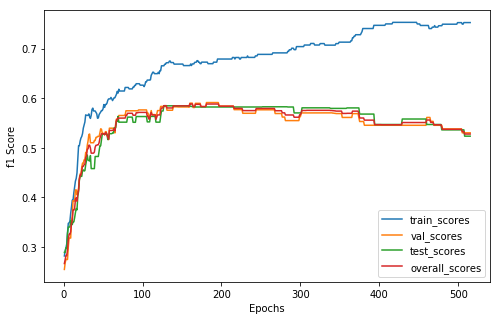

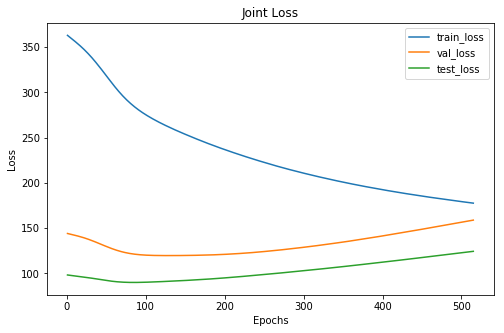

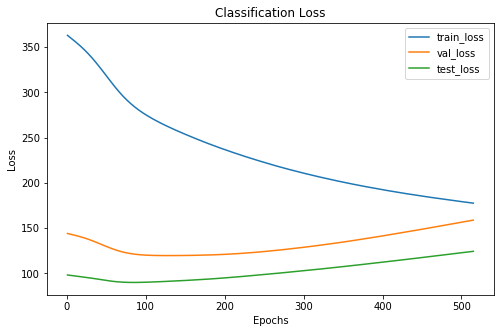

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 515 xxxxxxxxxxxxxx


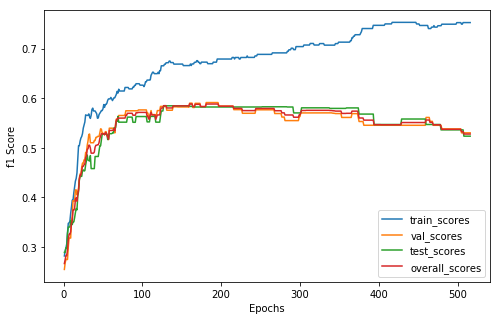

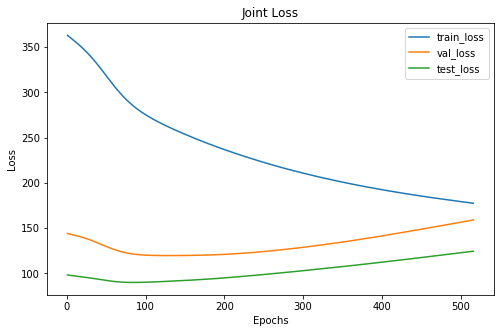

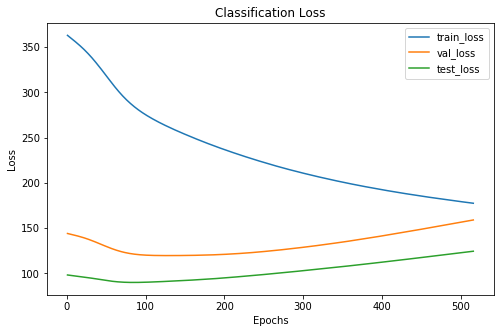

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 516 xxxxxxxxxxxxxx


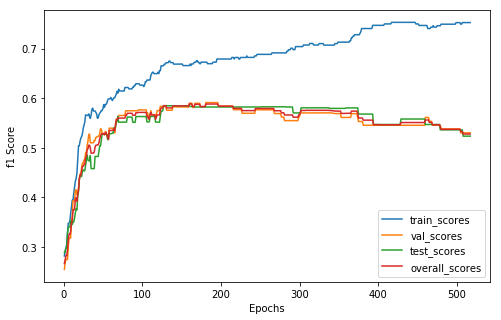

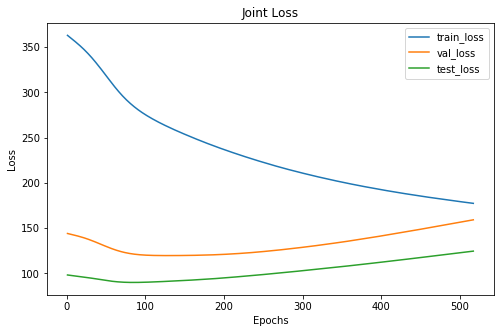

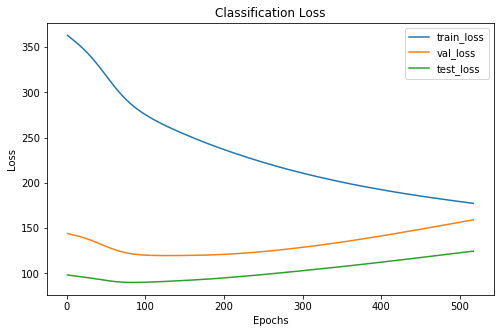

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 517 xxxxxxxxxxxxxx


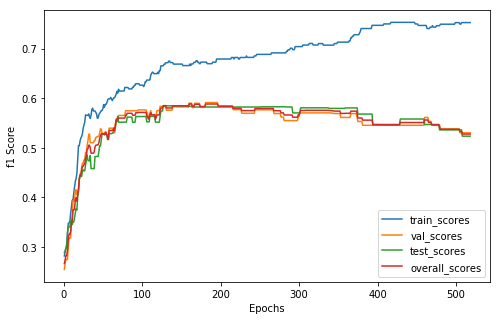

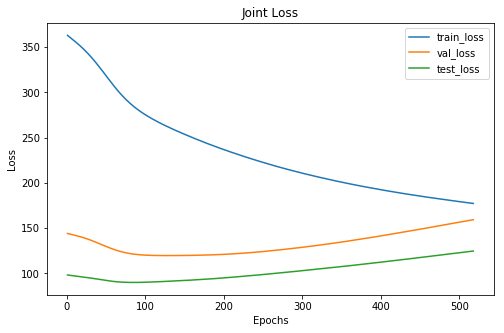

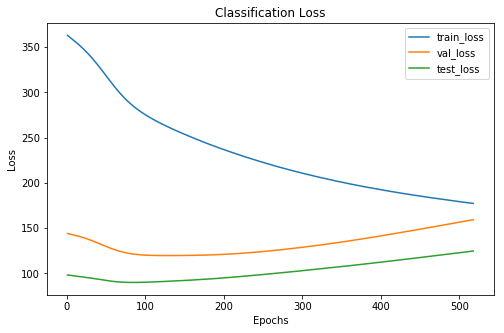

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 518 xxxxxxxxxxxxxx


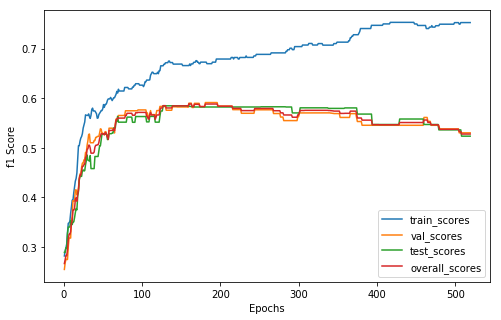

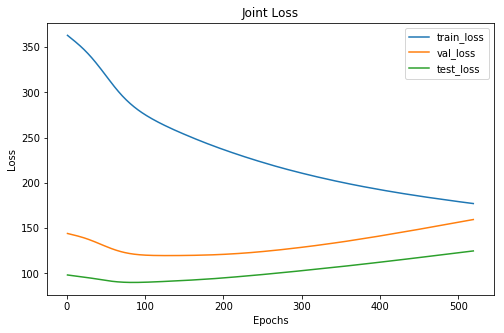

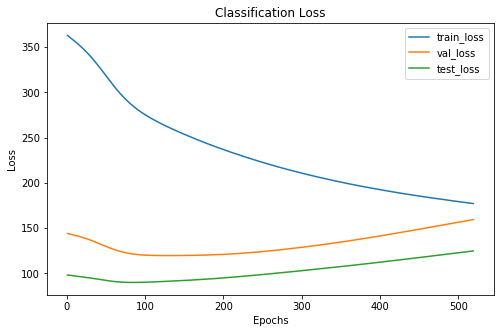

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 519 xxxxxxxxxxxxxx


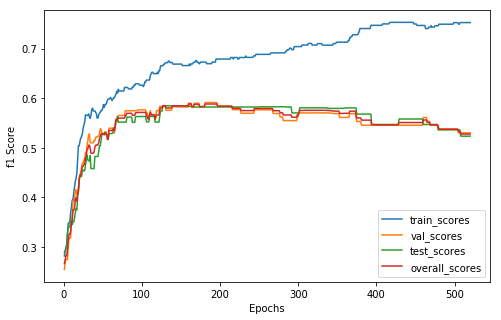

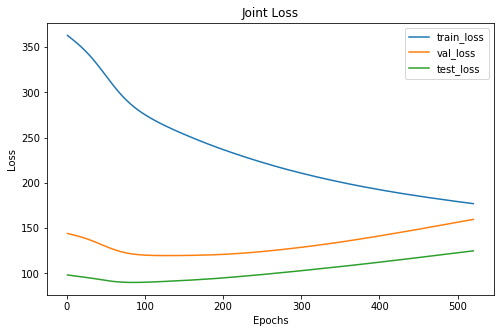

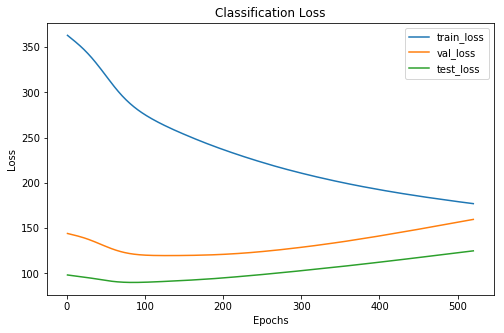

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 520 xxxxxxxxxxxxxx


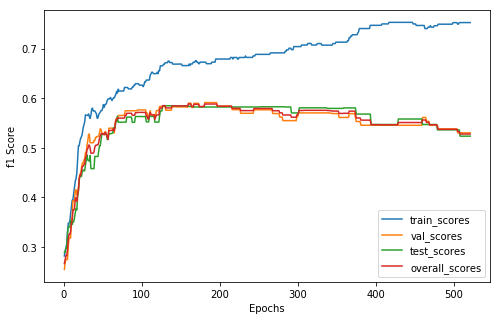

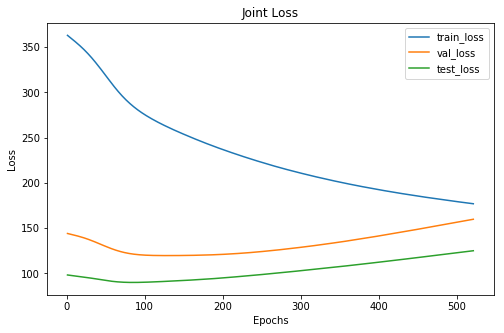

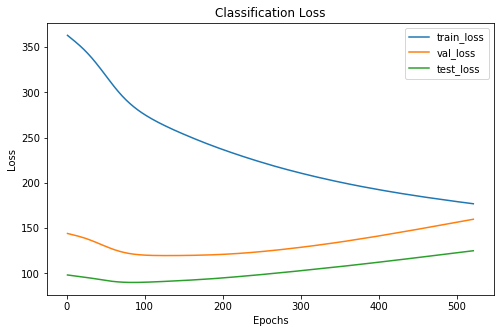

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 521 xxxxxxxxxxxxxx


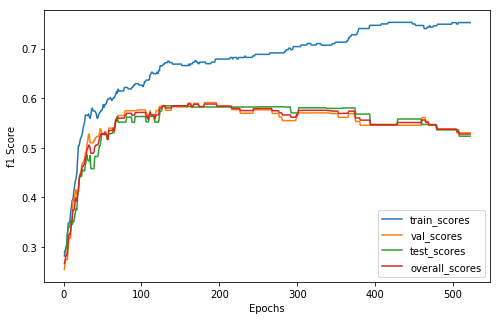

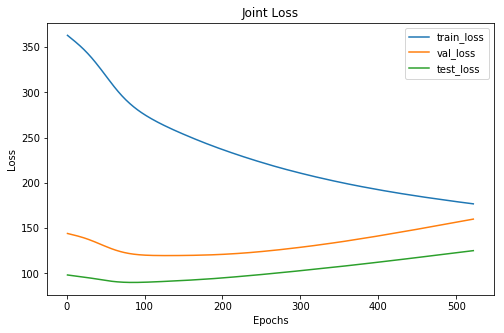

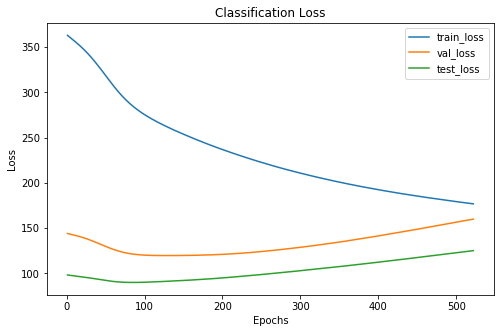

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 522 xxxxxxxxxxxxxx


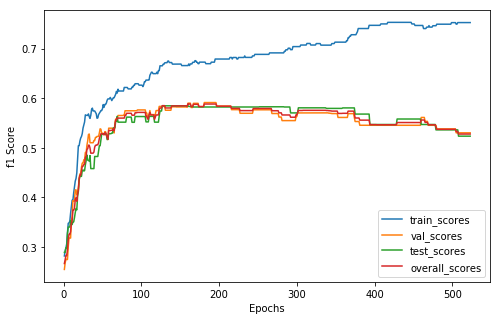

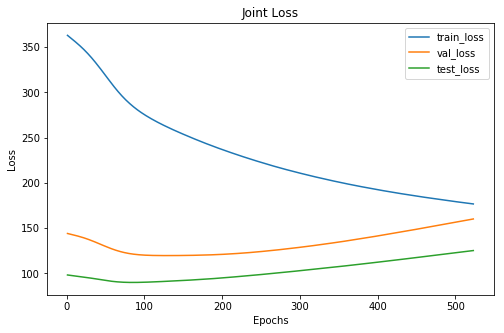

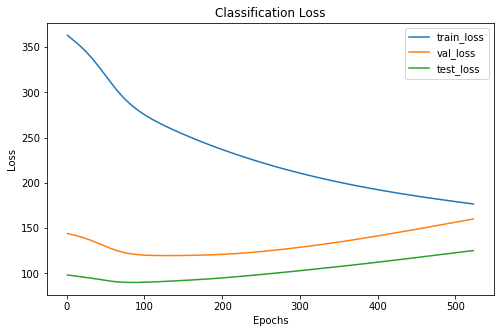

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 523 xxxxxxxxxxxxxx


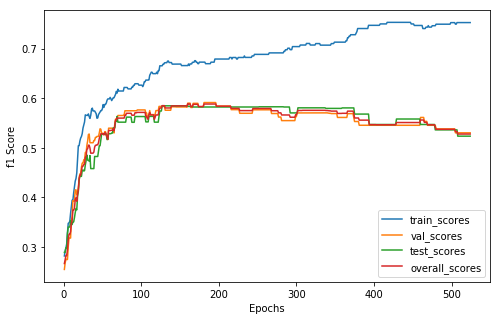

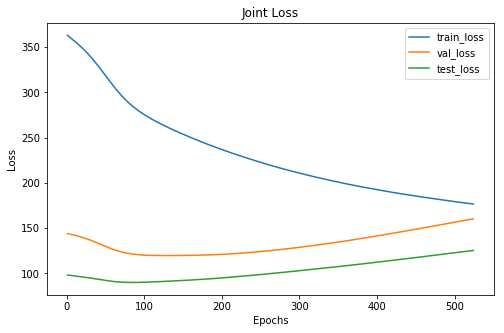

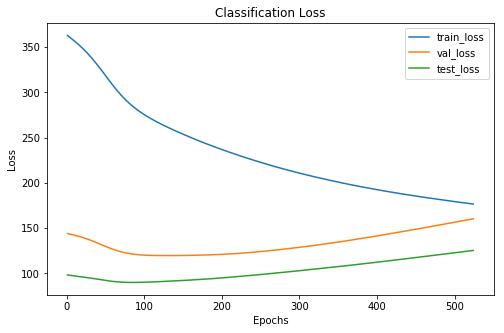

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 524 xxxxxxxxxxxxxx


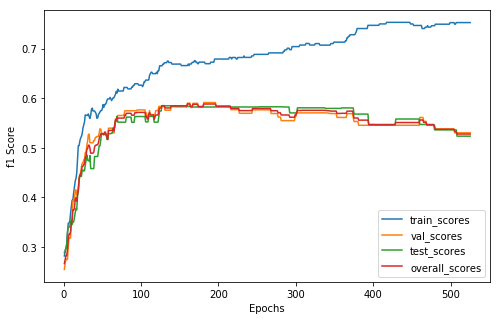

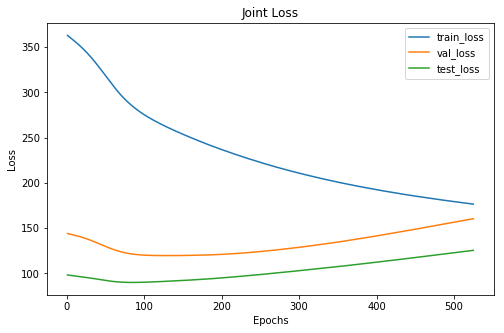

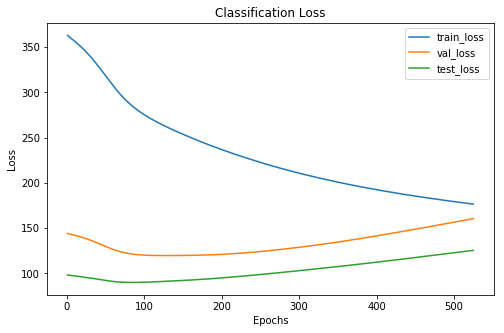

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 525 xxxxxxxxxxxxxx


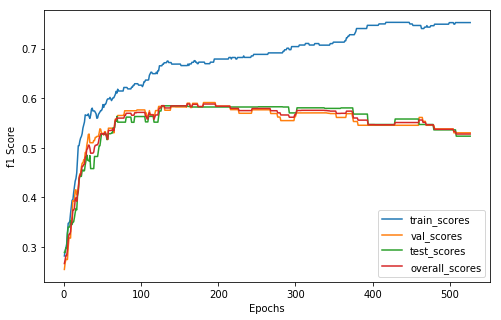

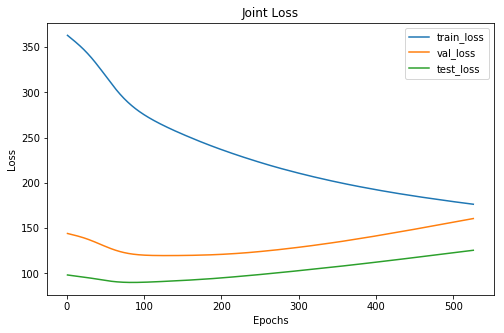

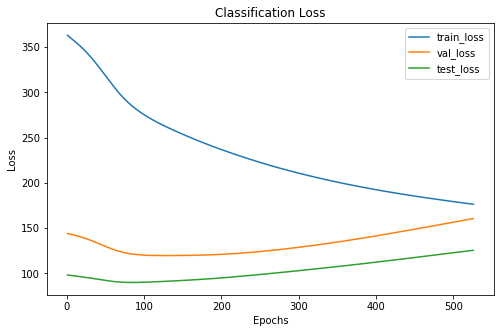

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 526 xxxxxxxxxxxxxx


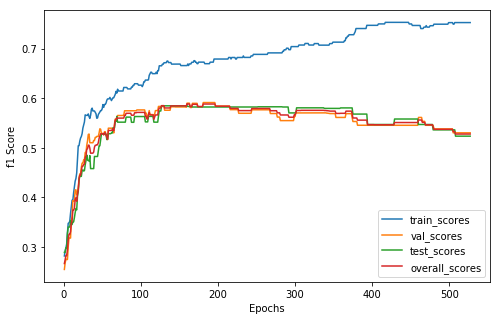

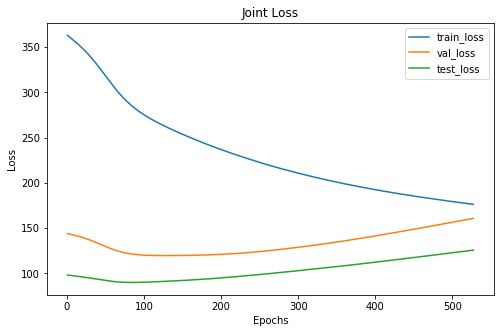

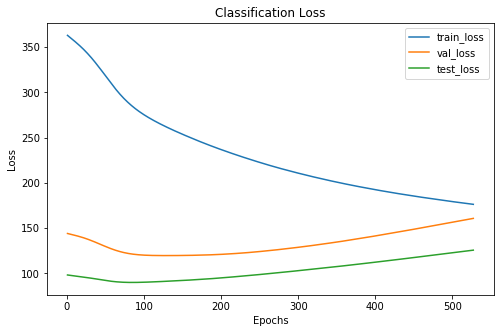

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 527 xxxxxxxxxxxxxx


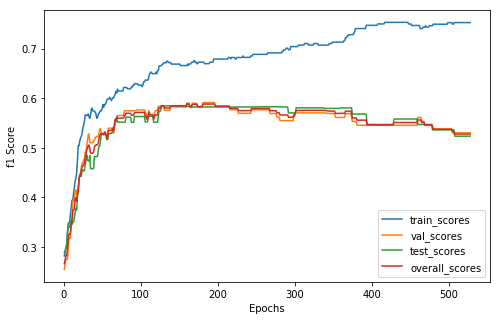

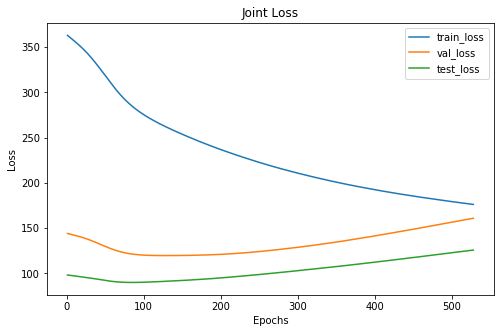

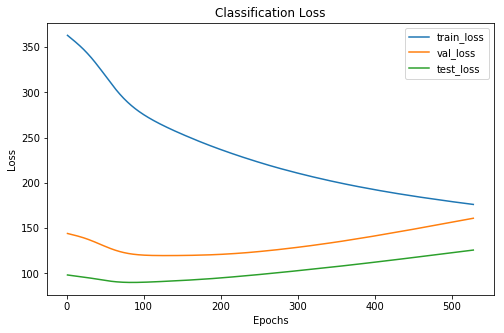

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 528 xxxxxxxxxxxxxx


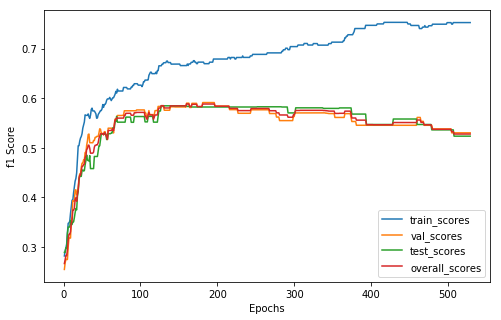

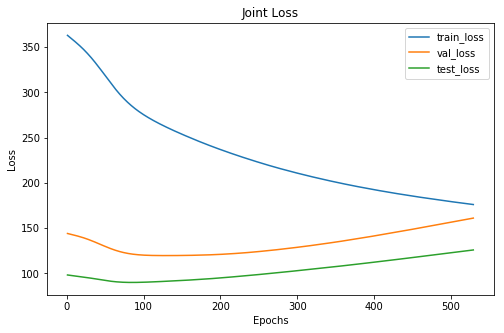

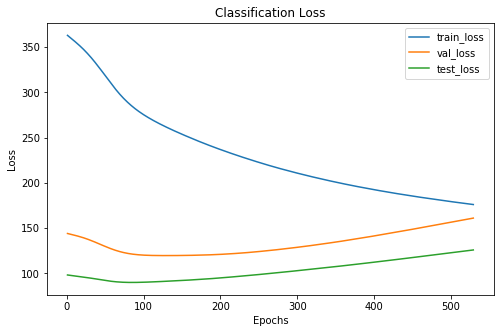

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 529 xxxxxxxxxxxxxx


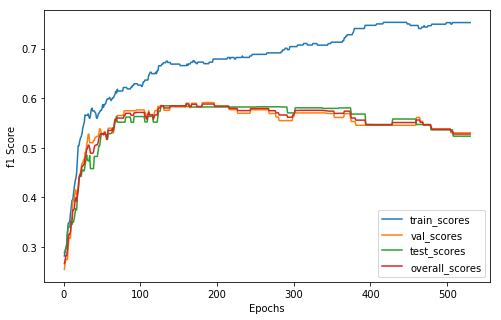

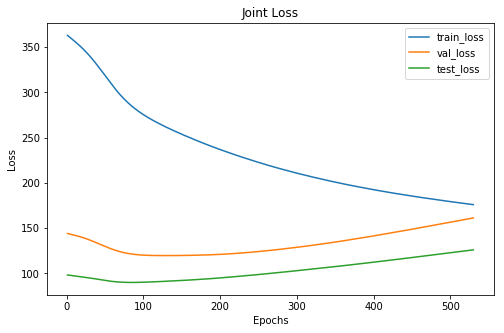

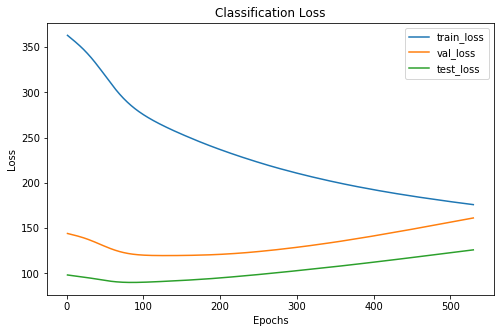

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 530 xxxxxxxxxxxxxx


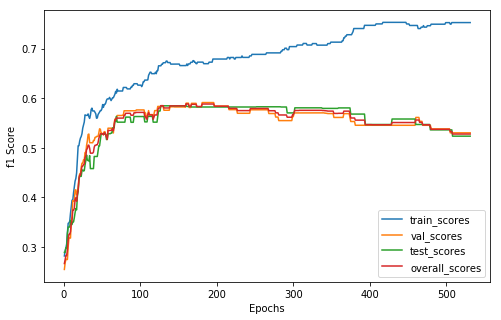

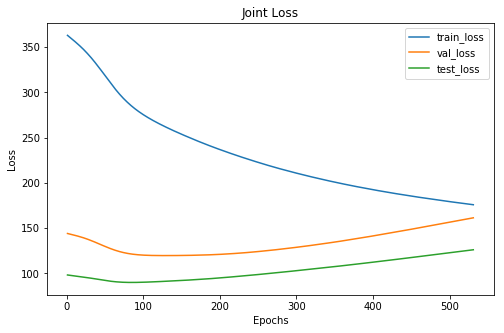

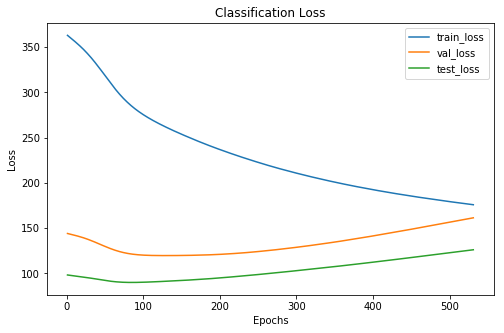

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 531 xxxxxxxxxxxxxx


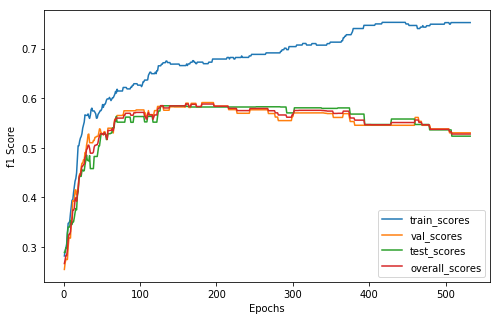

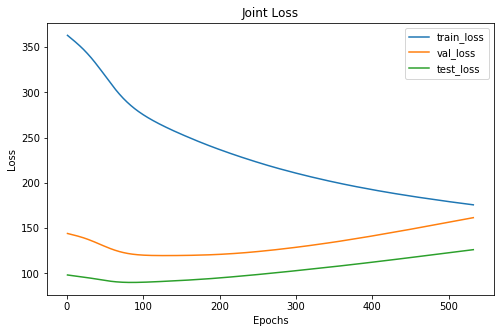

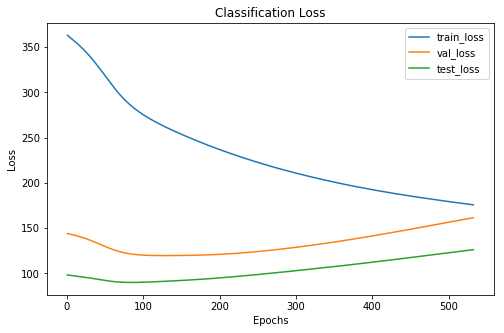

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 532 xxxxxxxxxxxxxx


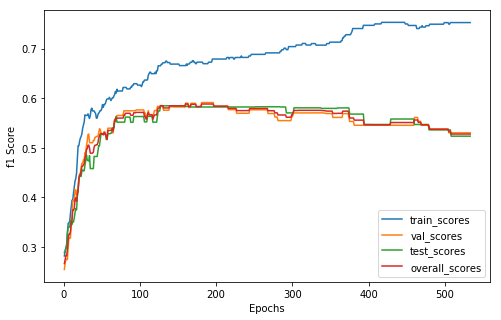

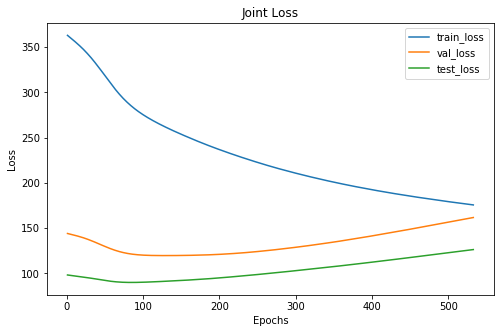

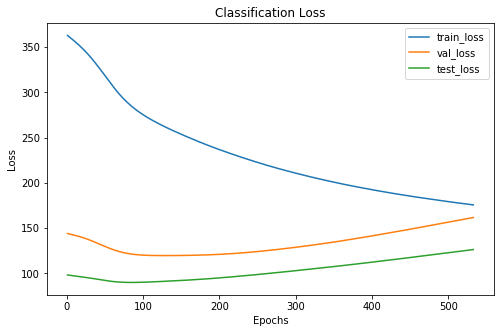

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 533 xxxxxxxxxxxxxx


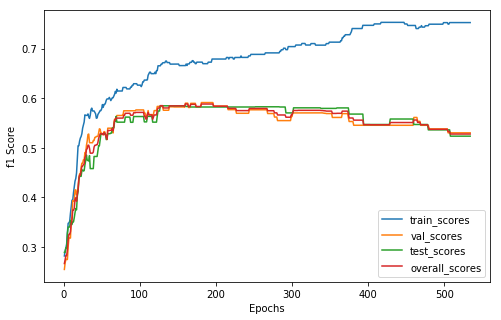

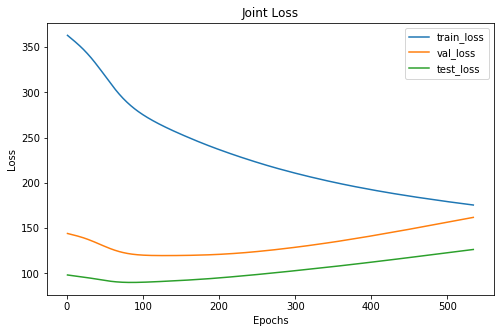

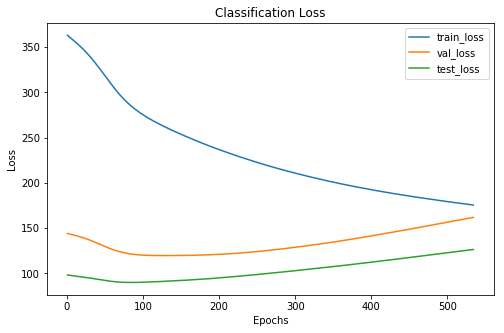

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 534 xxxxxxxxxxxxxx


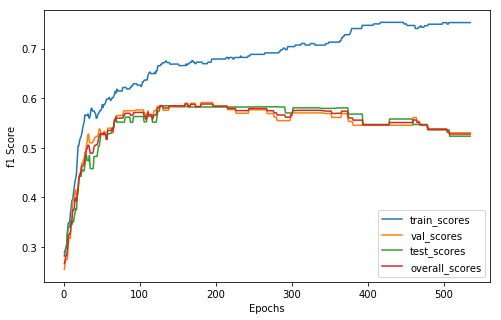

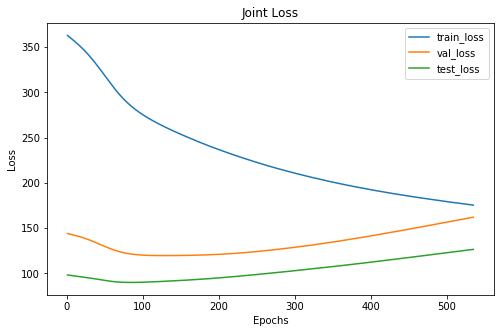

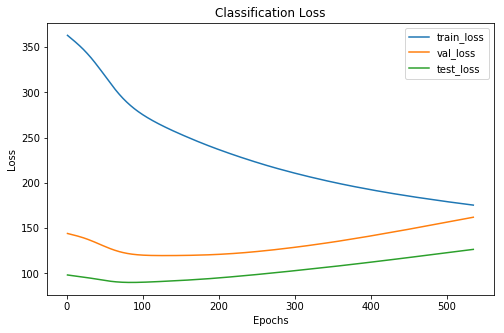

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 535 xxxxxxxxxxxxxx


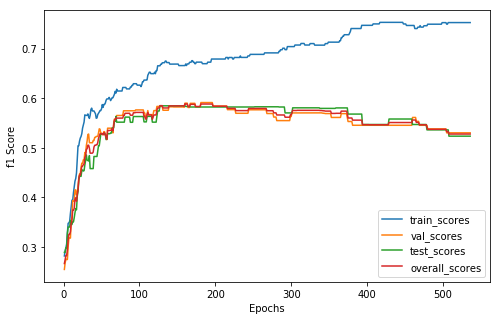

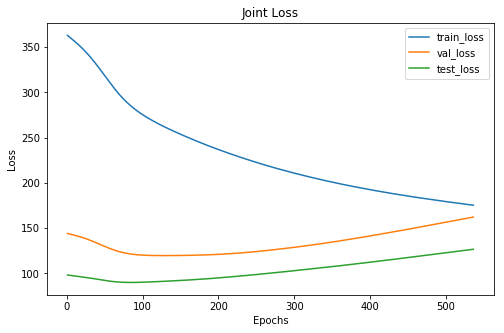

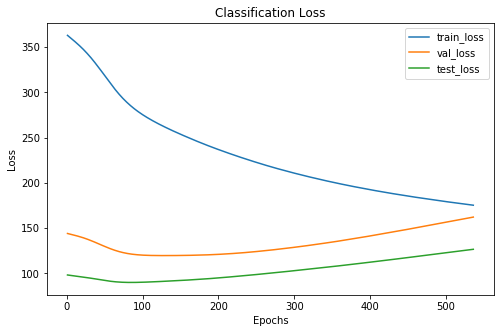

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 536 xxxxxxxxxxxxxx


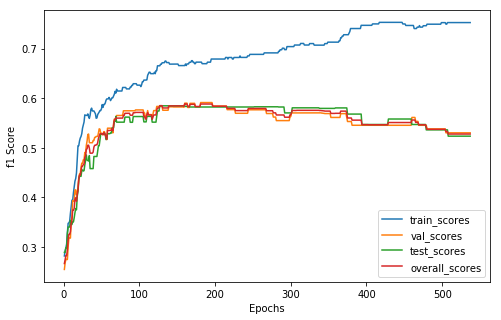

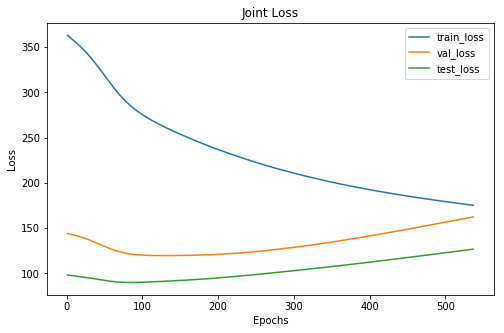

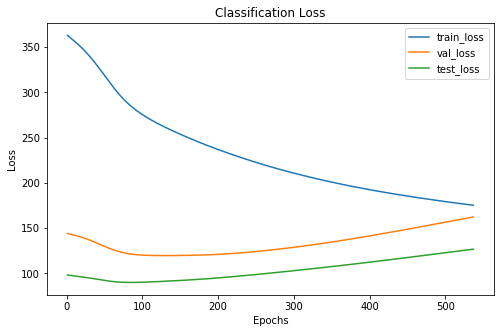

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      22
 1      143     51      45
 2       83     32      21
xxxxxxxxxxxxxx epoch: 537 xxxxxxxxxxxxxx


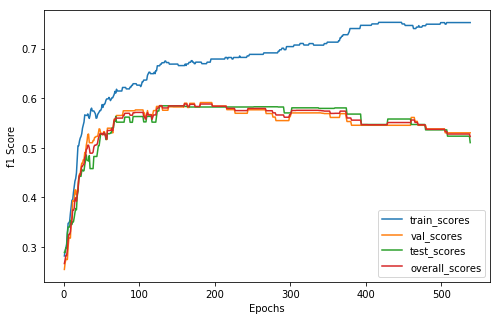

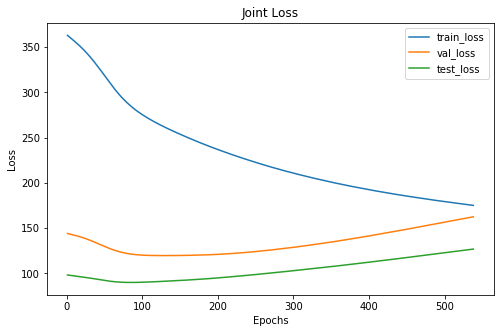

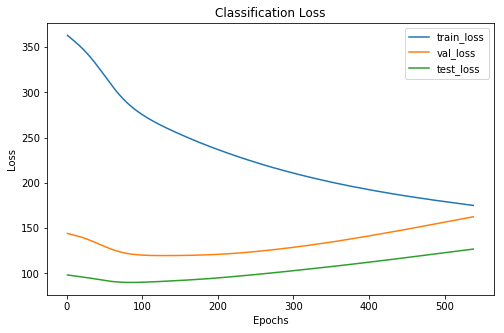

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      21
 1      143     51      46
 2       83     32      21
xxxxxxxxxxxxxx epoch: 538 xxxxxxxxxxxxxx


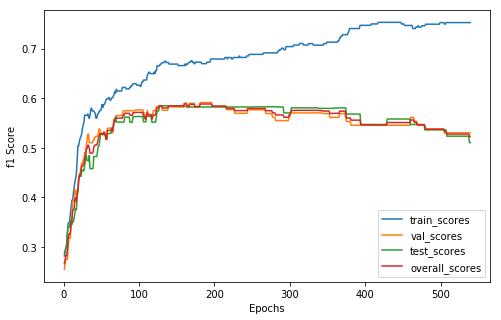

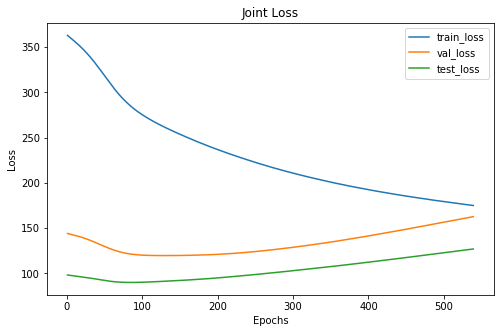

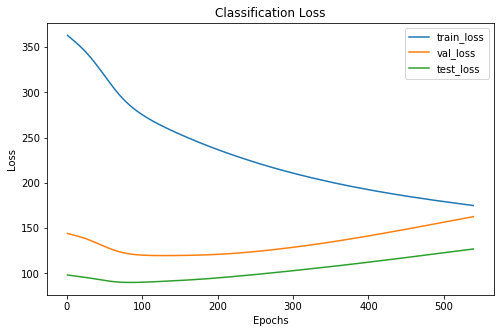

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      21
 1      143     51      46
 2       83     32      21
xxxxxxxxxxxxxx epoch: 539 xxxxxxxxxxxxxx


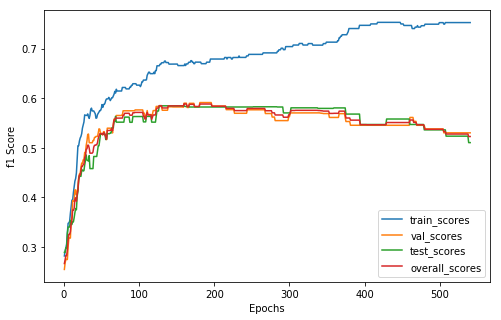

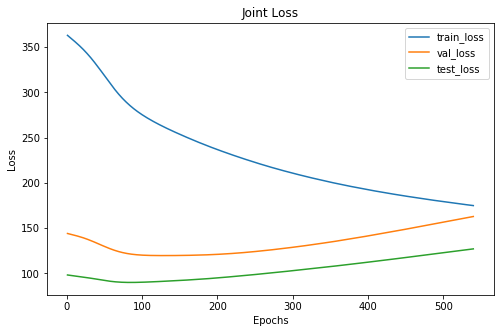

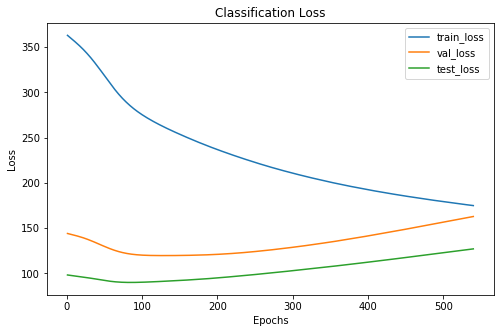

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      21
 1      143     51      46
 2       83     32      21
xxxxxxxxxxxxxx epoch: 540 xxxxxxxxxxxxxx


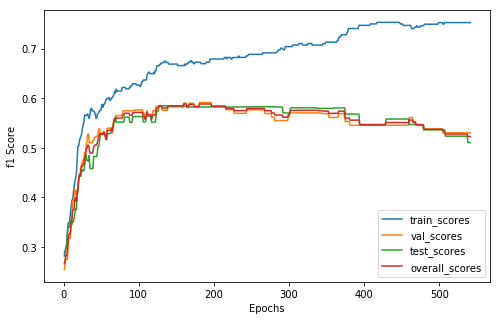

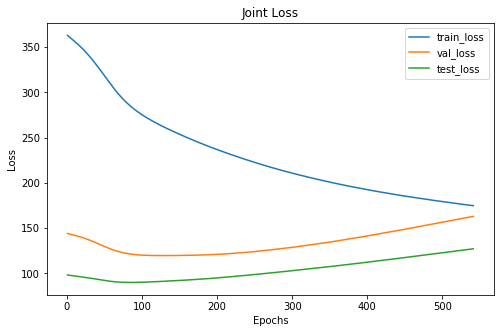

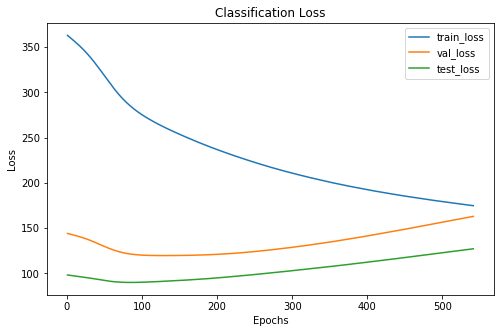

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      21
 1      143     51      46
 2       83     32      21
xxxxxxxxxxxxxx epoch: 541 xxxxxxxxxxxxxx


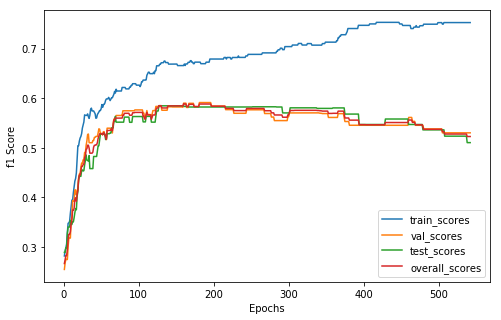

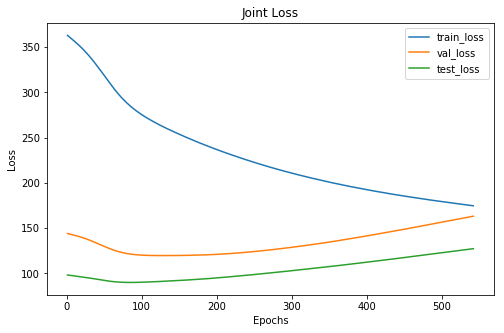

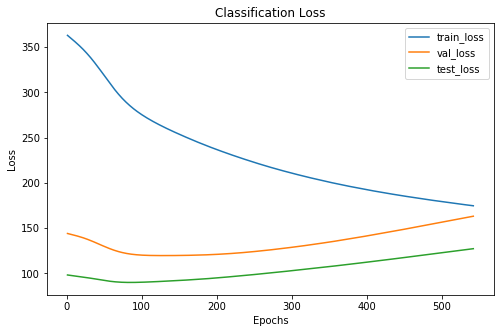

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      21
 1      143     51      46
 2       83     32      21
xxxxxxxxxxxxxx epoch: 542 xxxxxxxxxxxxxx


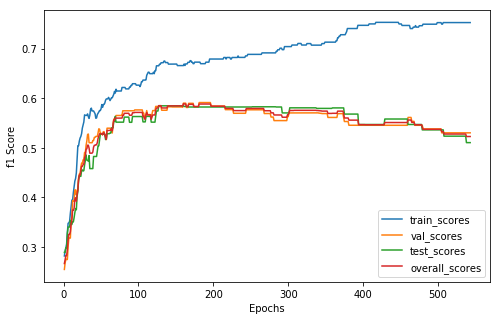

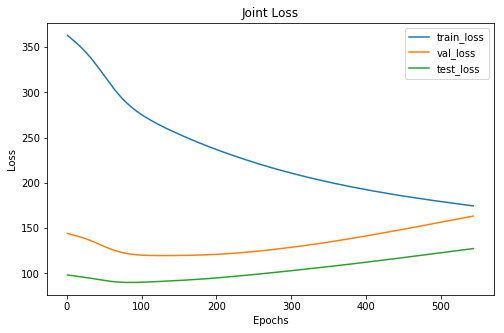

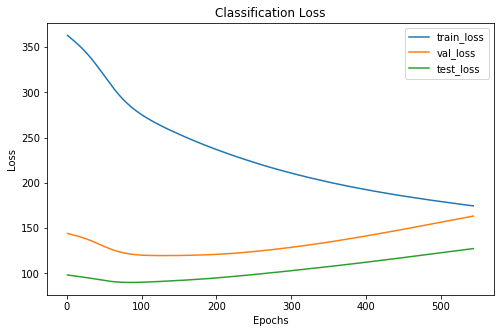

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      101     47      21
 1      143     51      46
 2       83     32      21
xxxxxxxxxxxxxx epoch: 543 xxxxxxxxxxxxxx


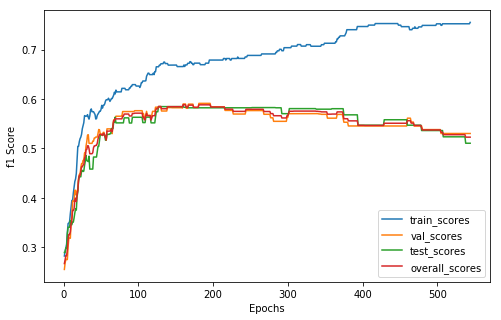

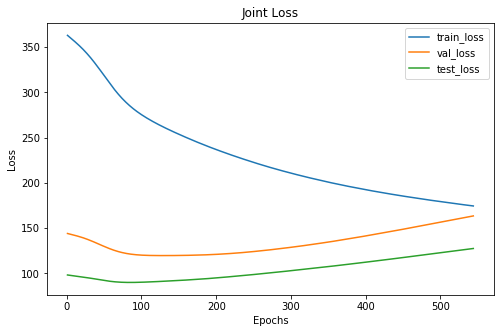

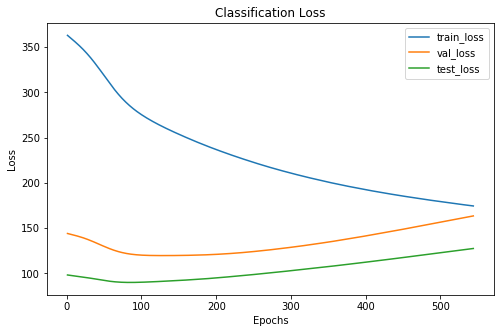

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     47      21
 1      144     51      46
 2       83     32      21
xxxxxxxxxxxxxx epoch: 544 xxxxxxxxxxxxxx


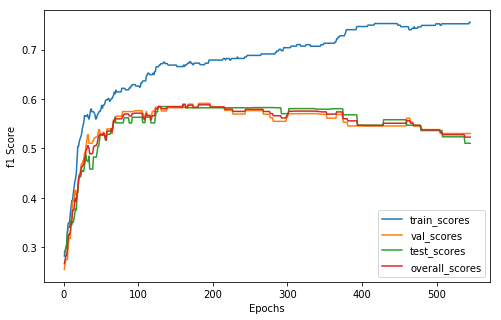

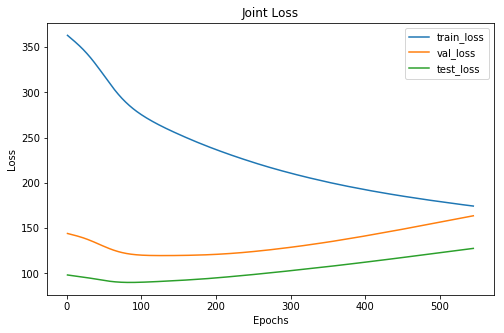

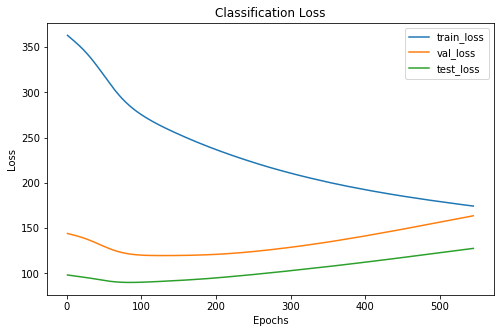

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     47      21
 1      144     51      46
 2       83     32      21
xxxxxxxxxxxxxx epoch: 545 xxxxxxxxxxxxxx


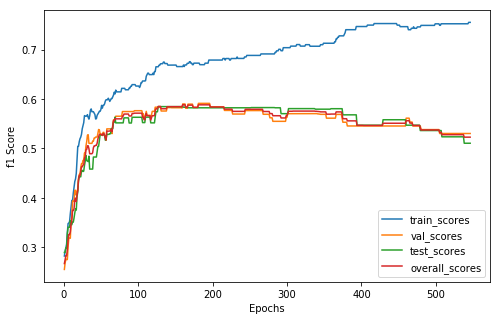

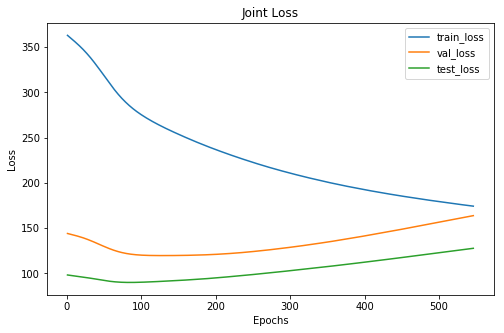

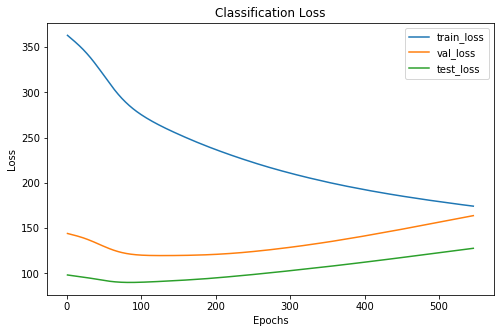

Cofusion Matrix For Val Set: 
--  --  --
26  21   6
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     47      21
 1      144     51      46
 2       83     32      21
xxxxxxxxxxxxxx epoch: 546 xxxxxxxxxxxxxx


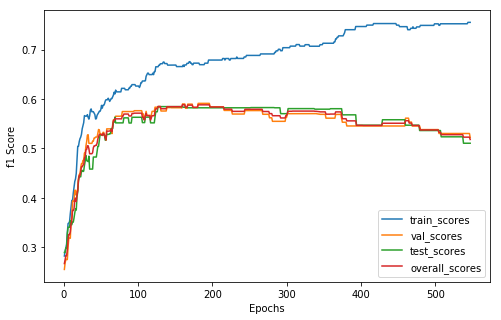

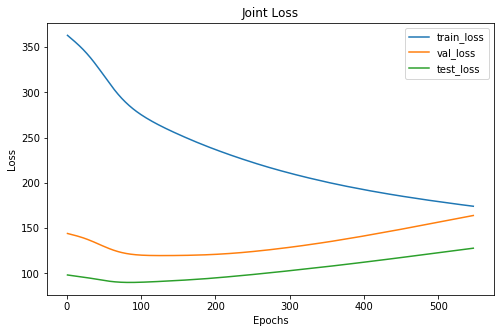

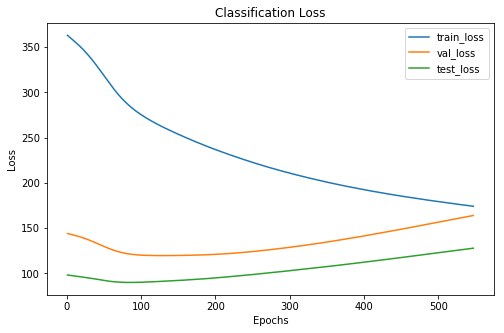

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      144     51      46
 2       83     33      21
xxxxxxxxxxxxxx epoch: 547 xxxxxxxxxxxxxx


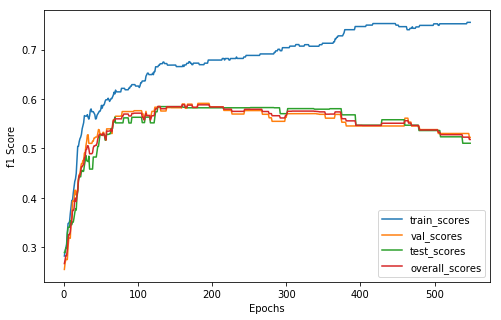

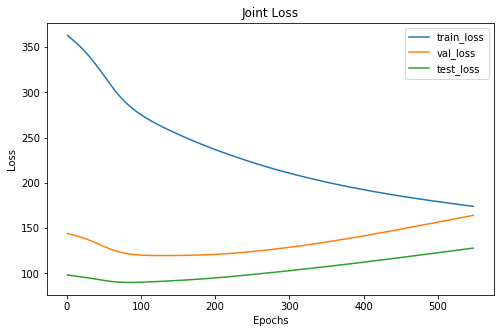

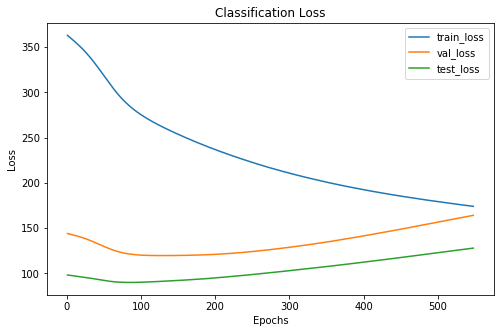

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      144     51      46
 2       83     33      21
xxxxxxxxxxxxxx epoch: 548 xxxxxxxxxxxxxx


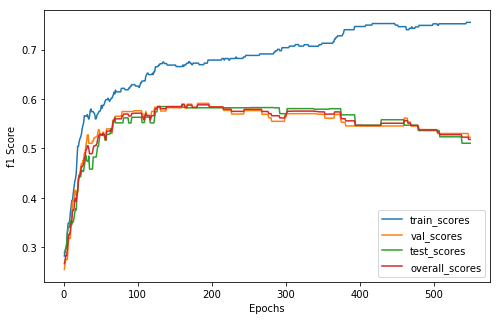

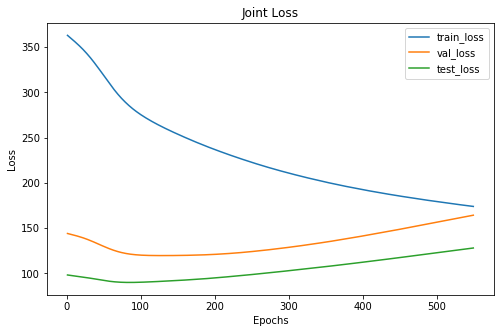

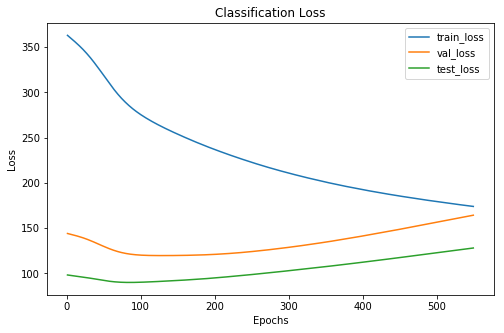

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      144     51      46
 2       83     33      21
xxxxxxxxxxxxxx epoch: 549 xxxxxxxxxxxxxx


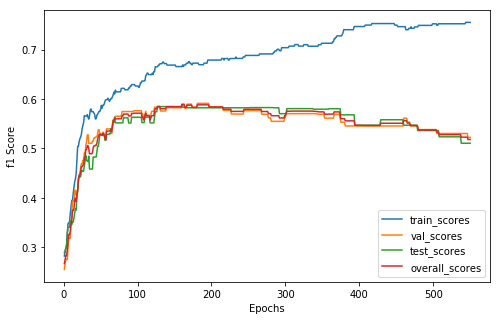

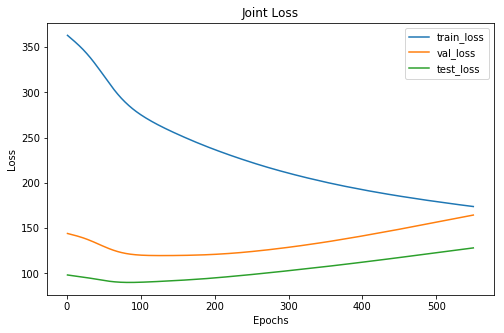

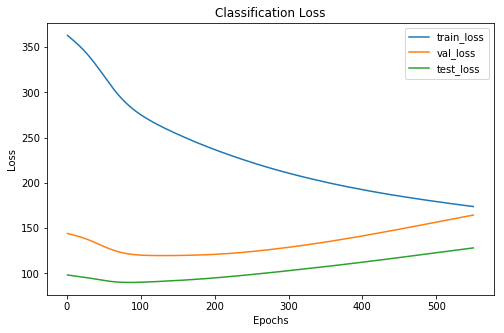

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      144     51      46
 2       83     33      21
xxxxxxxxxxxxxx epoch: 550 xxxxxxxxxxxxxx


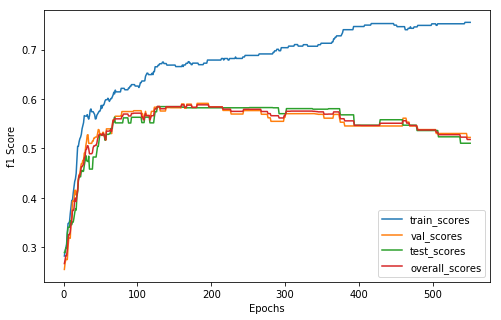

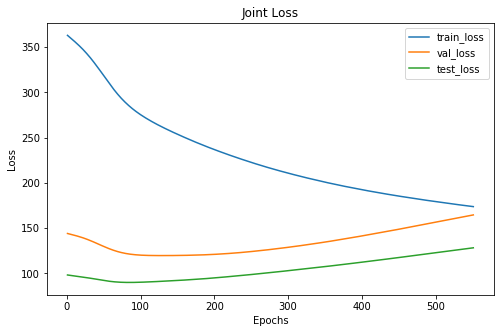

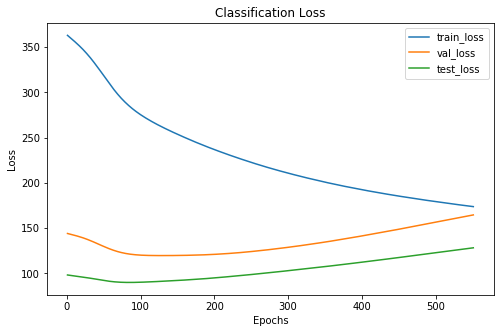

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      144     51      46
 2       83     33      21
xxxxxxxxxxxxxx epoch: 551 xxxxxxxxxxxxxx


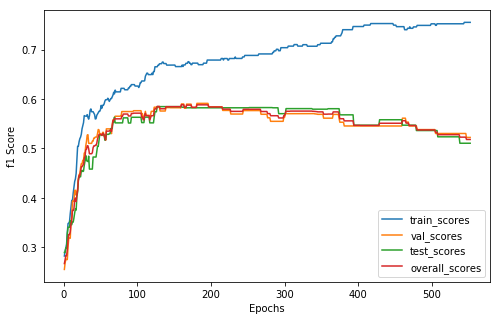

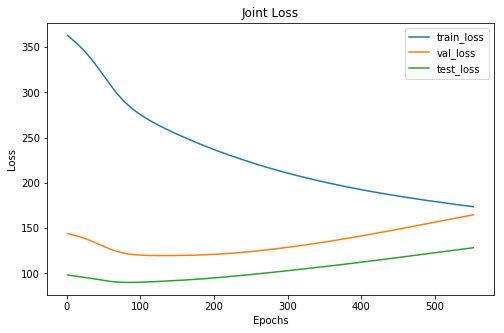

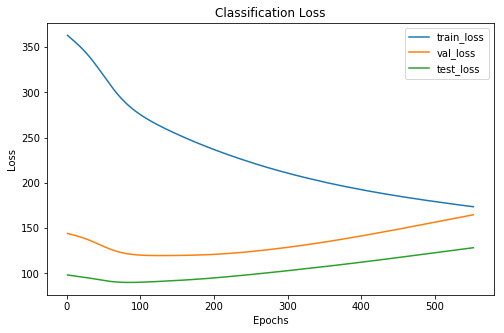

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      144     51      46
 2       83     33      21
xxxxxxxxxxxxxx epoch: 552 xxxxxxxxxxxxxx


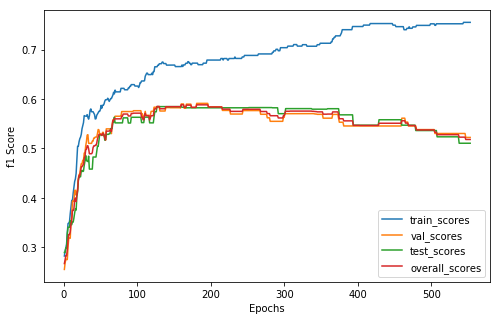

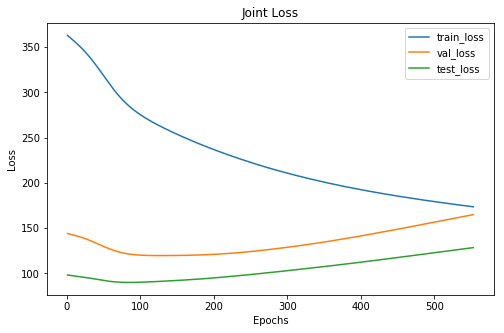

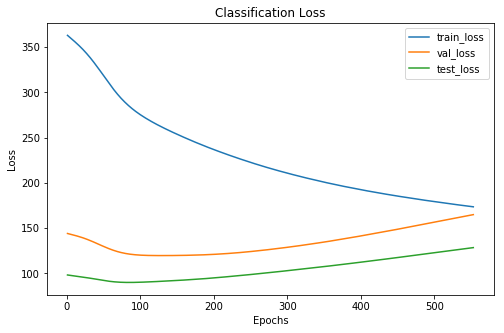

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      144     51      46
 2       83     33      21
xxxxxxxxxxxxxx epoch: 553 xxxxxxxxxxxxxx


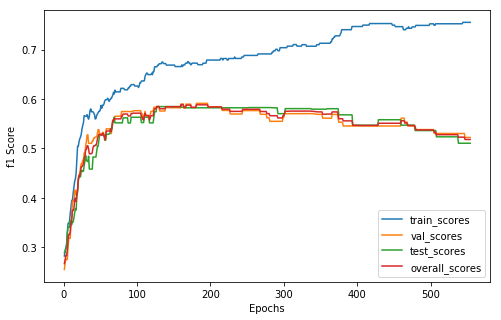

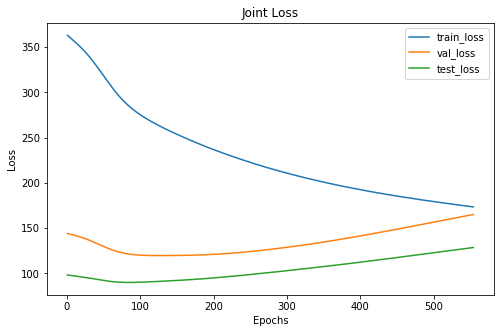

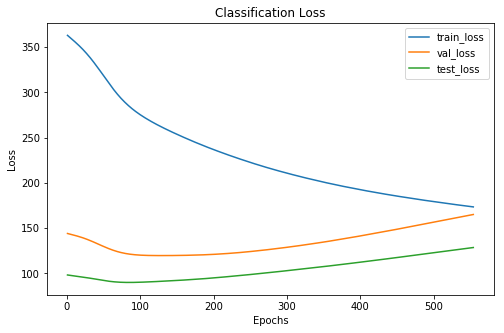

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      144     51      46
 2       83     33      21
xxxxxxxxxxxxxx epoch: 554 xxxxxxxxxxxxxx


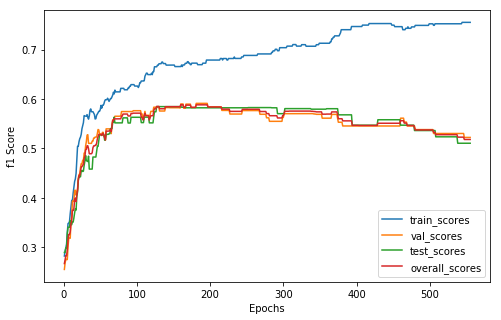

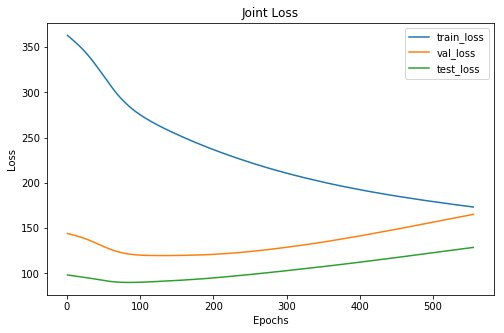

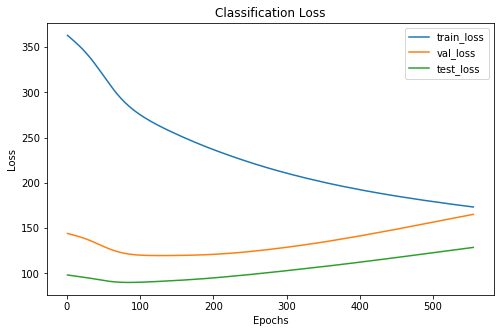

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      144     51      46
 2       83     33      21
xxxxxxxxxxxxxx epoch: 555 xxxxxxxxxxxxxx


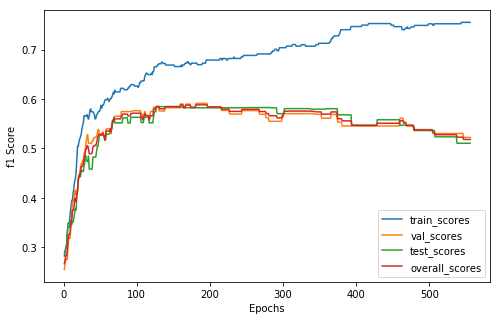

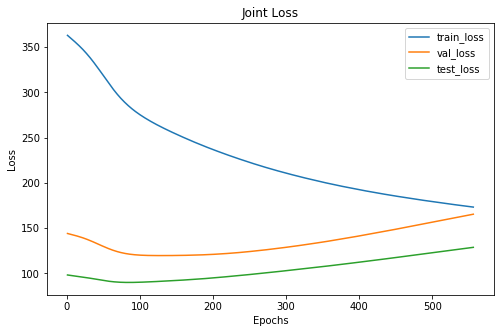

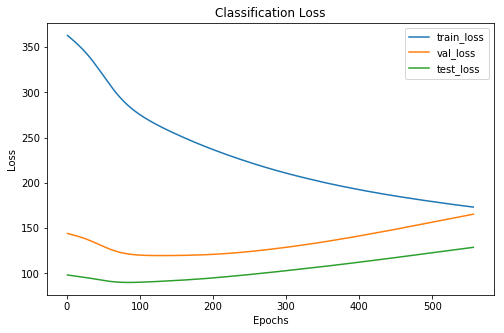

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      144     51      46
 2       83     33      21
xxxxxxxxxxxxxx epoch: 556 xxxxxxxxxxxxxx


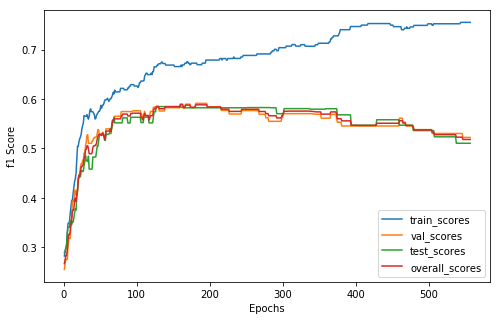

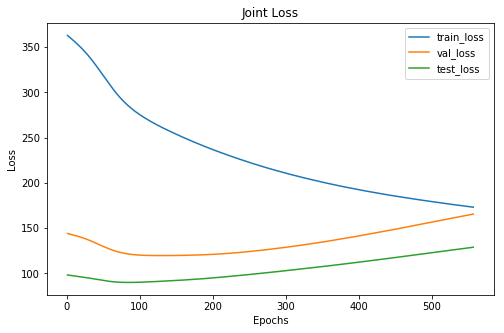

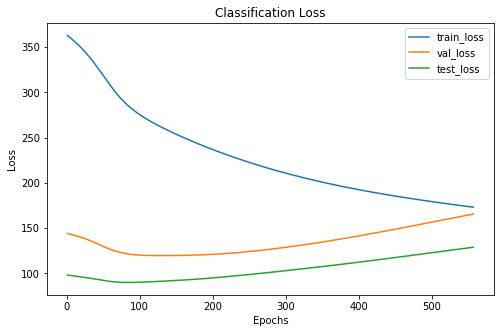

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      144     51      46
 2       83     33      21
xxxxxxxxxxxxxx epoch: 557 xxxxxxxxxxxxxx


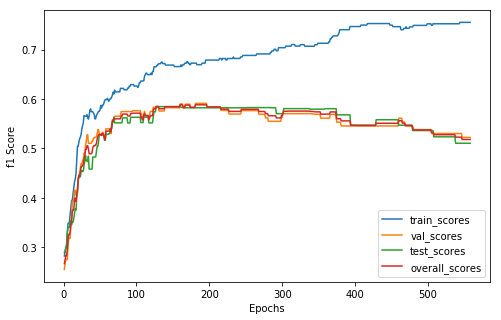

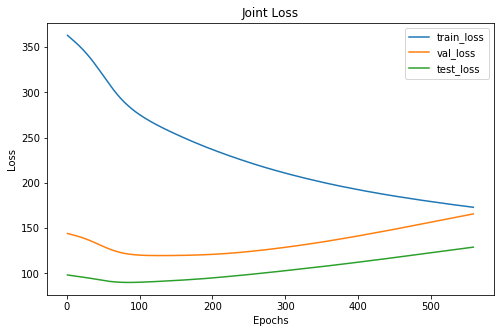

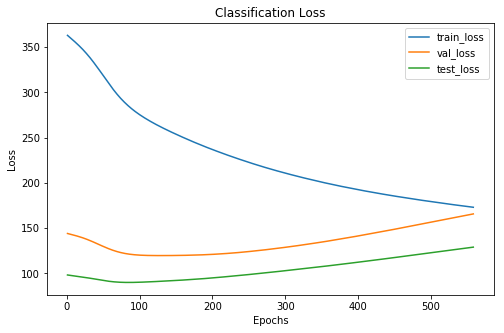

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      144     51      46
 2       83     33      21
xxxxxxxxxxxxxx epoch: 558 xxxxxxxxxxxxxx


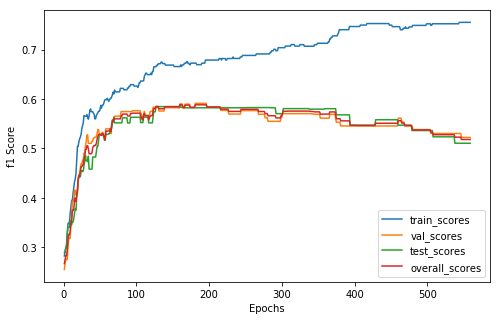

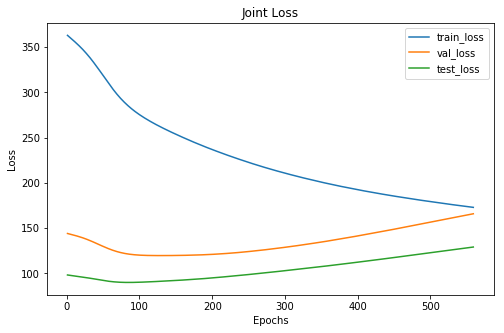

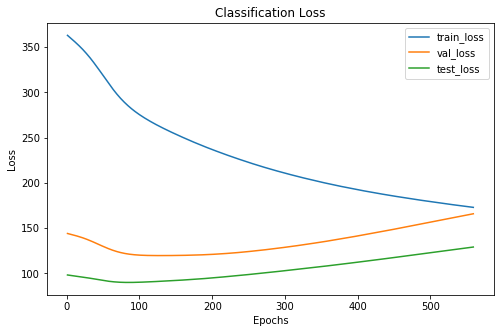

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      144     51      46
 2       83     33      21
xxxxxxxxxxxxxx epoch: 559 xxxxxxxxxxxxxx


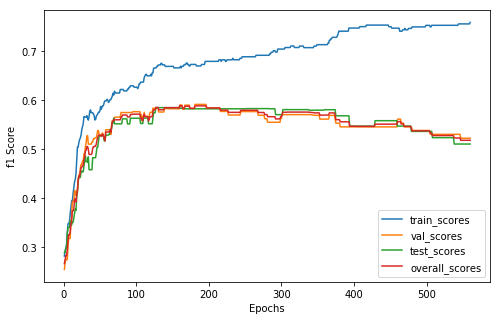

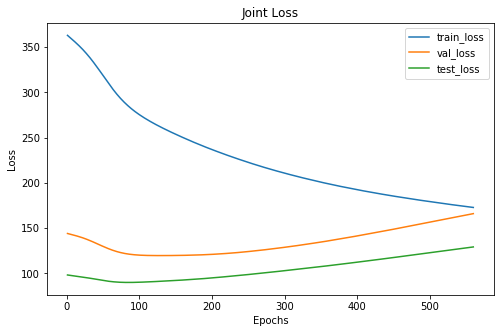

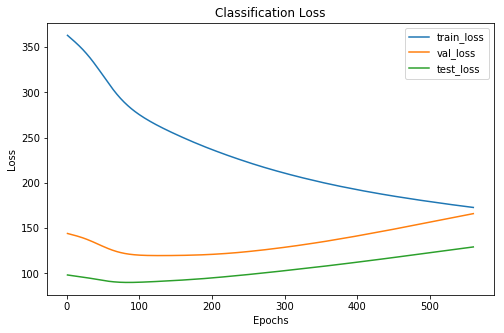

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 560 xxxxxxxxxxxxxx


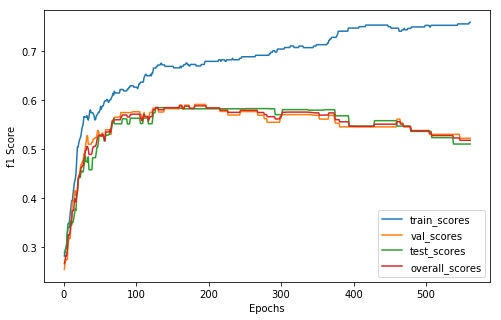

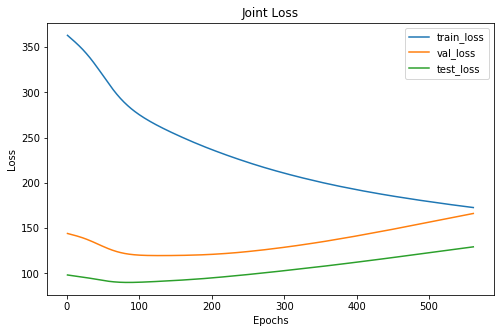

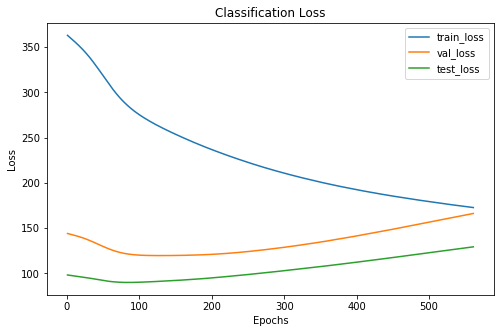

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 561 xxxxxxxxxxxxxx


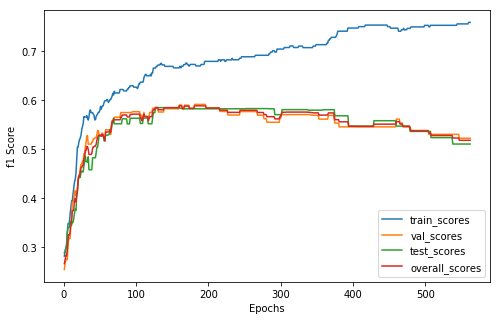

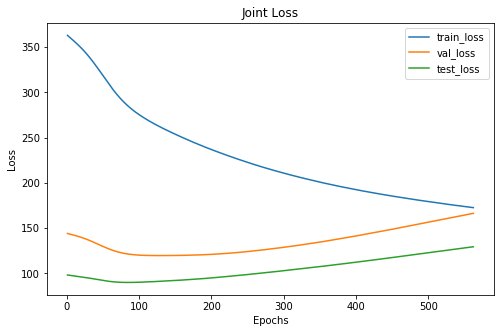

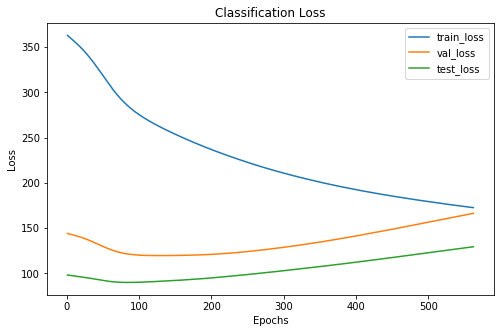

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 562 xxxxxxxxxxxxxx


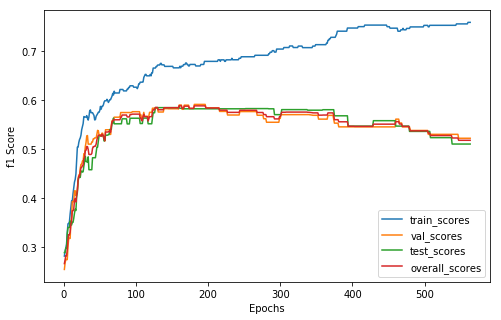

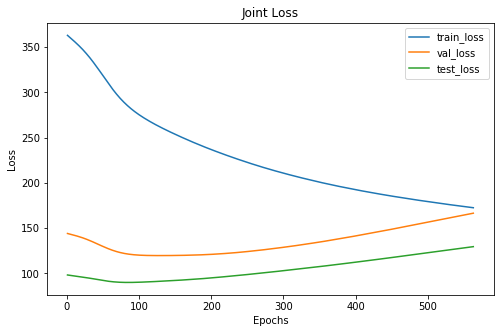

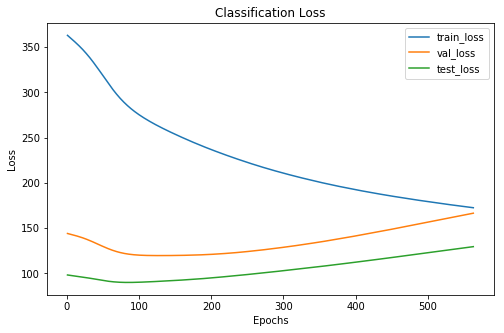

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 563 xxxxxxxxxxxxxx


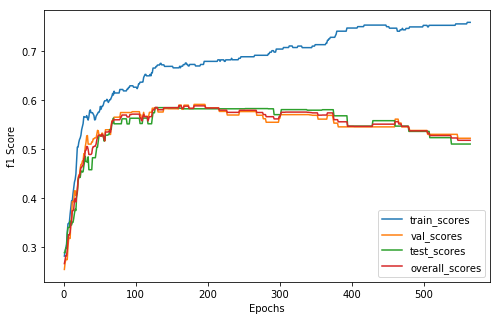

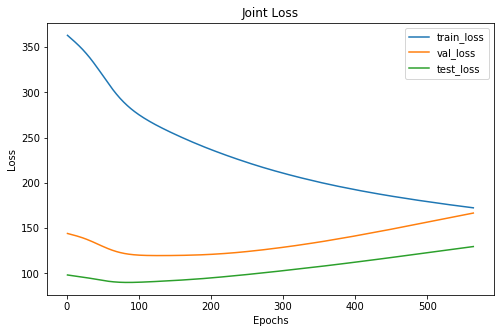

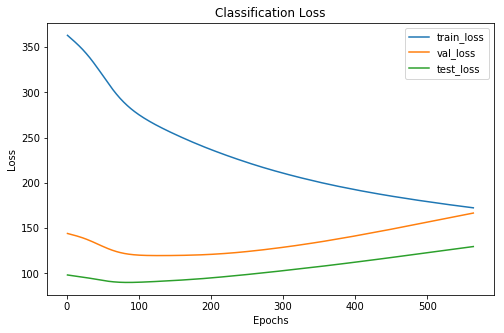

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 564 xxxxxxxxxxxxxx


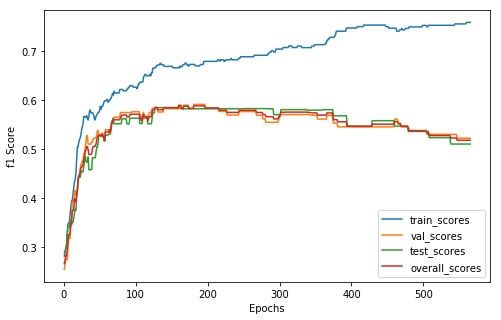

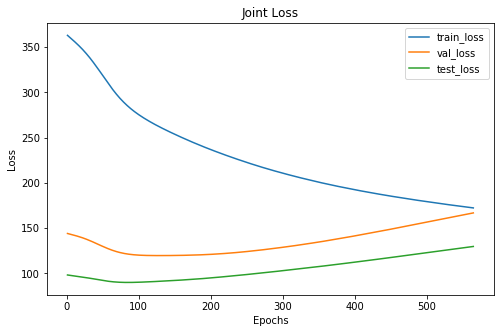

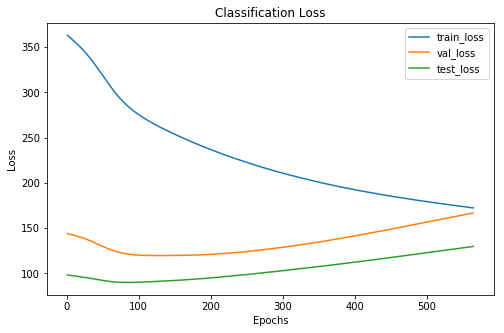

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 565 xxxxxxxxxxxxxx


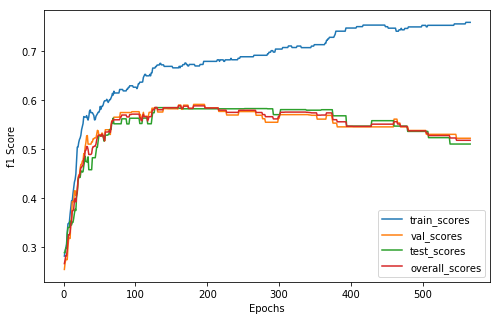

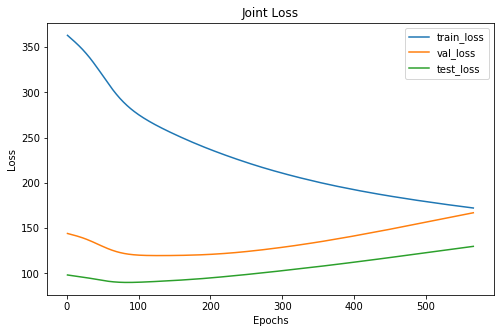

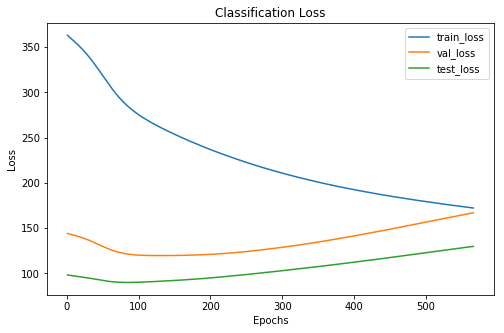

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 566 xxxxxxxxxxxxxx


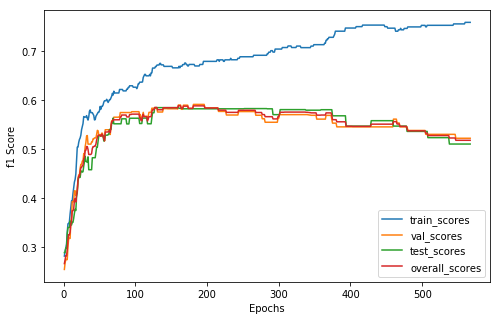

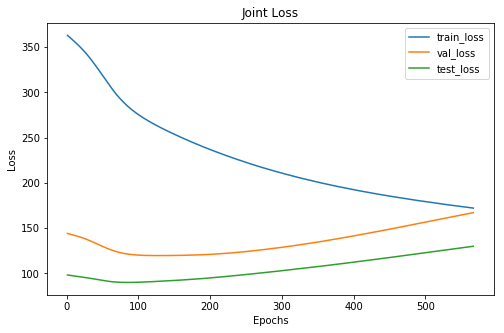

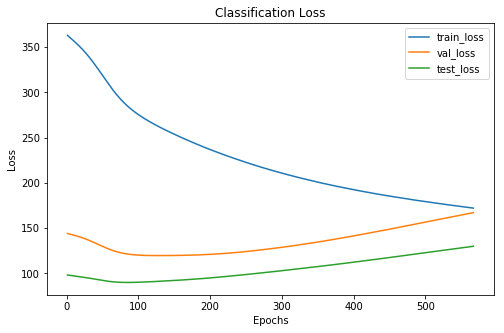

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 567 xxxxxxxxxxxxxx


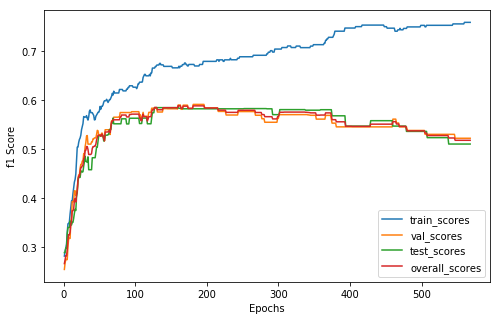

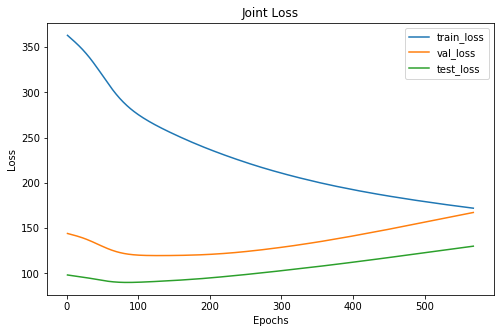

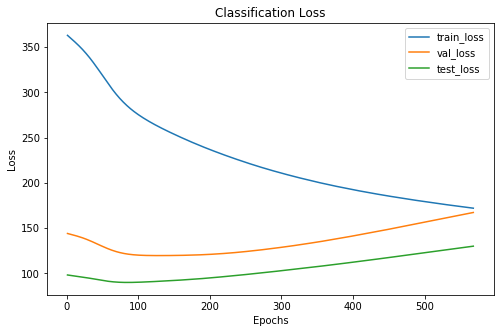

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 568 xxxxxxxxxxxxxx


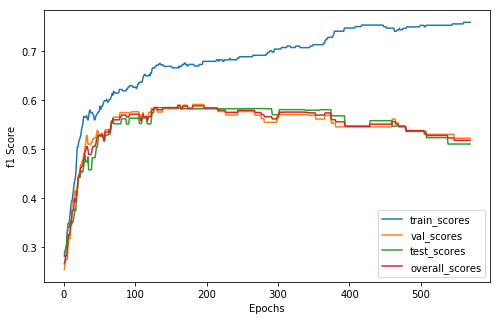

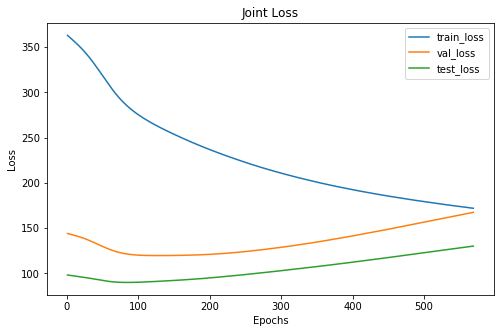

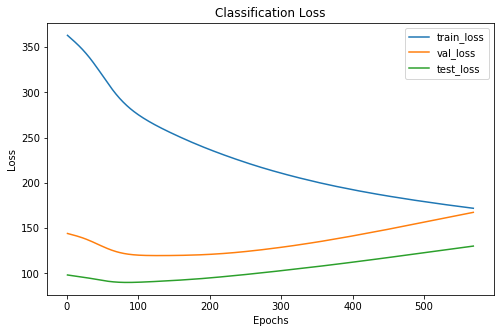

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 569 xxxxxxxxxxxxxx


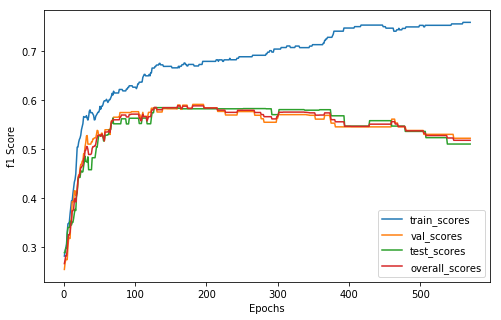

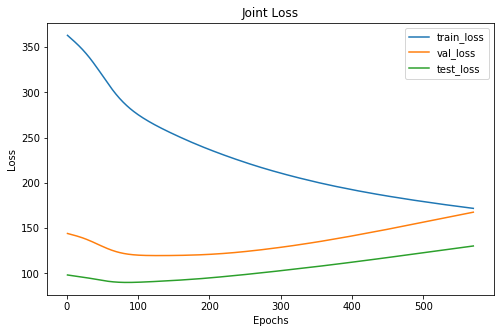

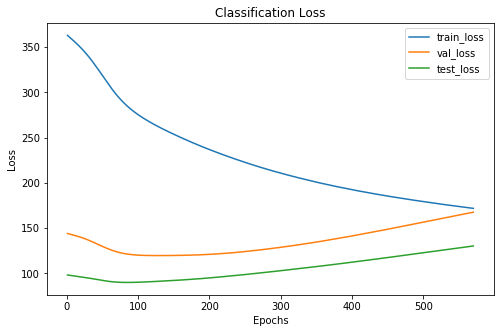

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 570 xxxxxxxxxxxxxx


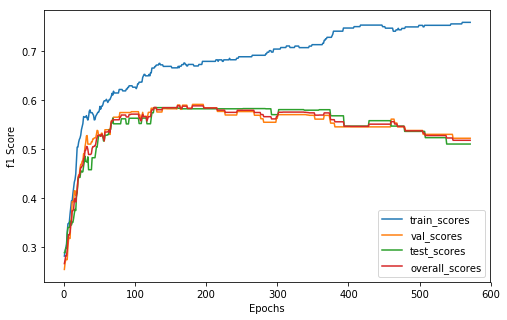

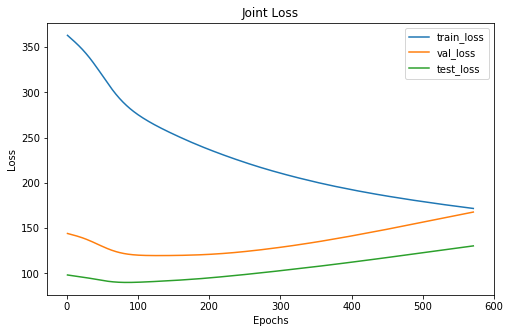

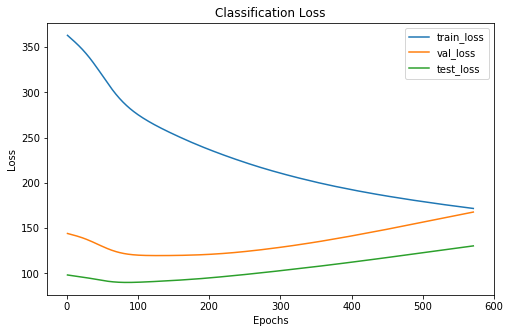

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 571 xxxxxxxxxxxxxx


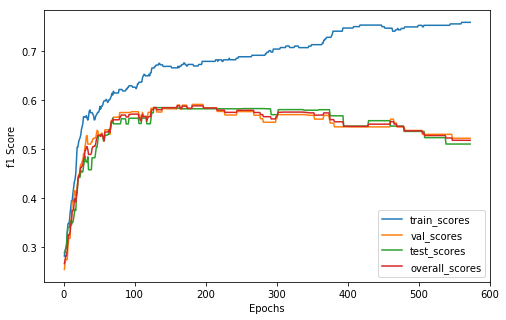

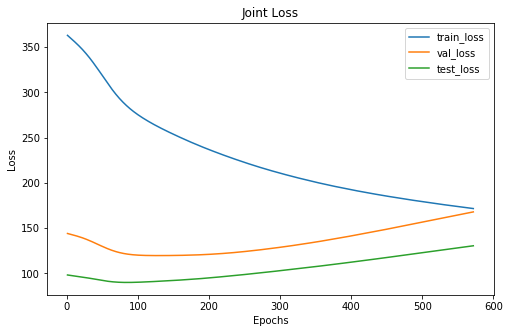

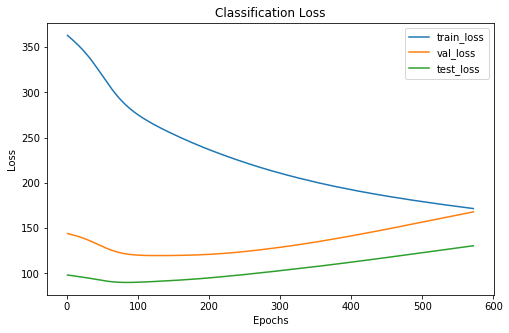

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 572 xxxxxxxxxxxxxx


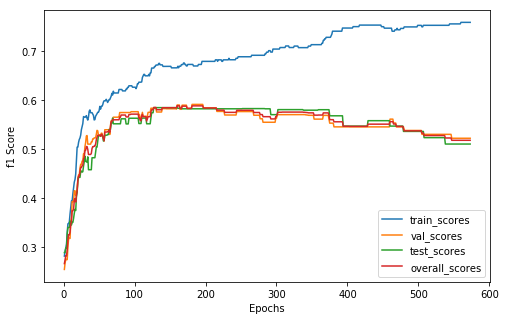

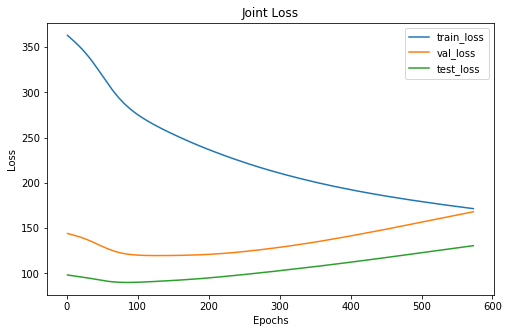

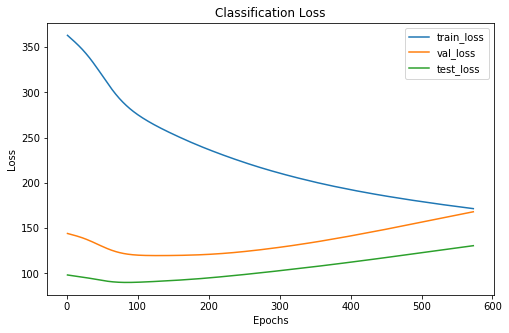

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 573 xxxxxxxxxxxxxx


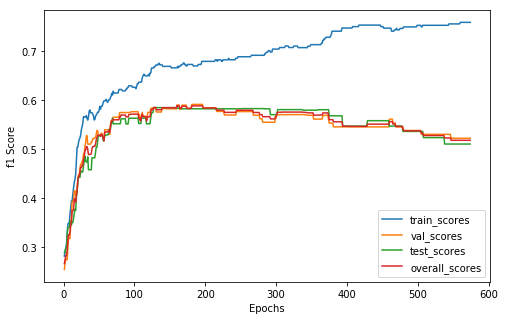

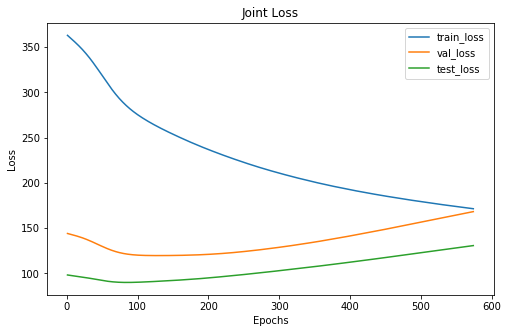

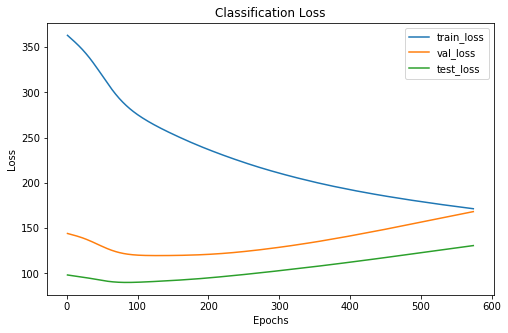

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 574 xxxxxxxxxxxxxx


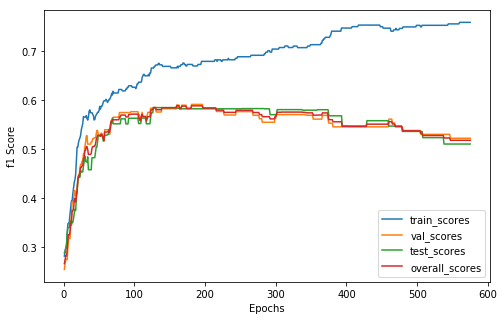

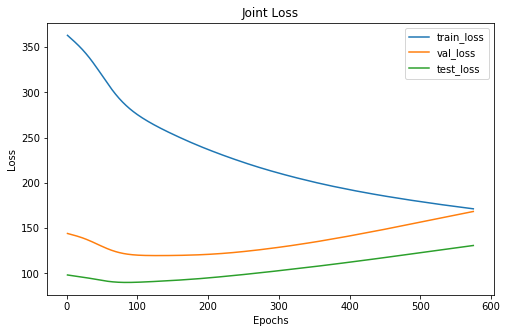

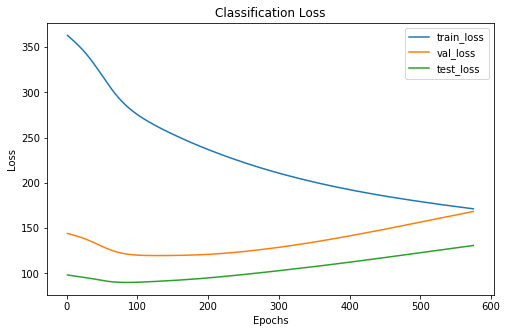

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 575 xxxxxxxxxxxxxx


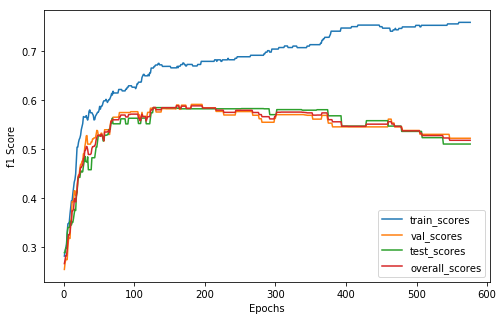

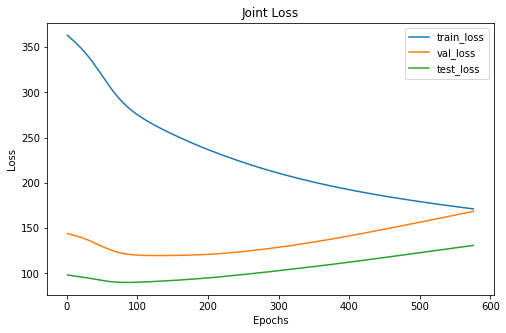

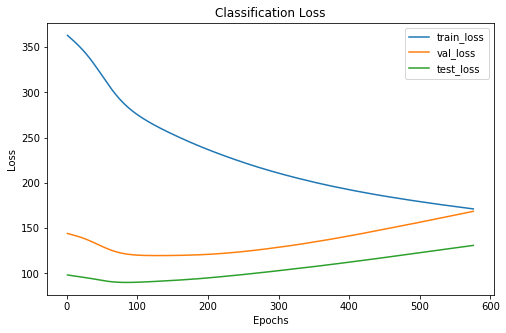

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 576 xxxxxxxxxxxxxx


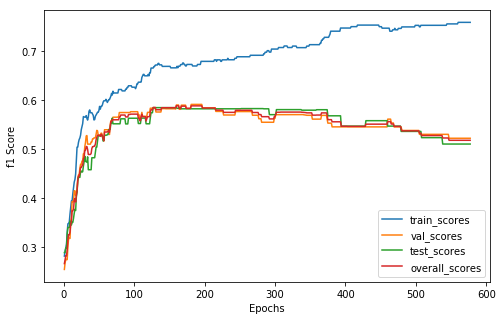

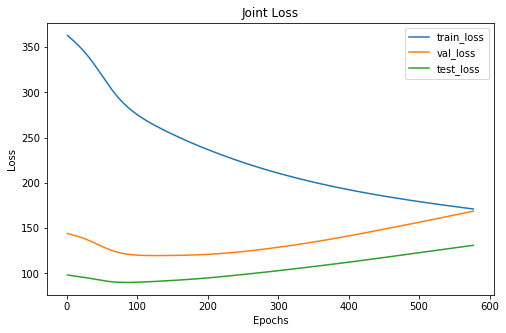

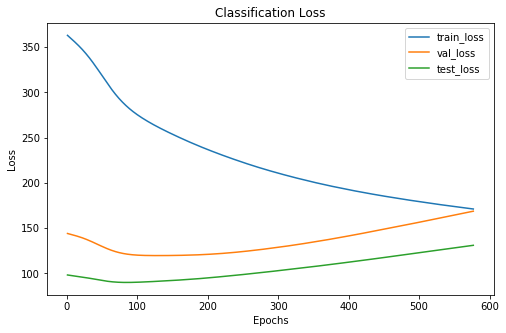

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      144     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 577 xxxxxxxxxxxxxx


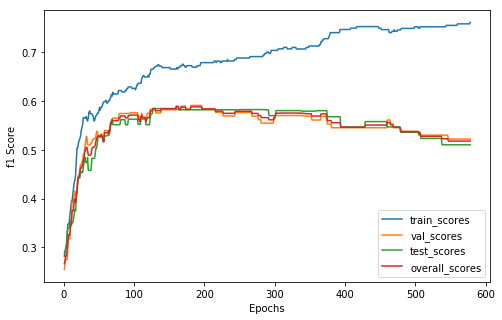

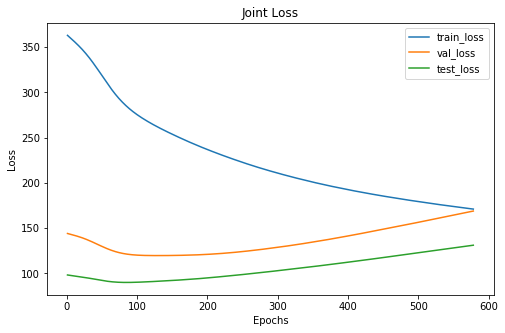

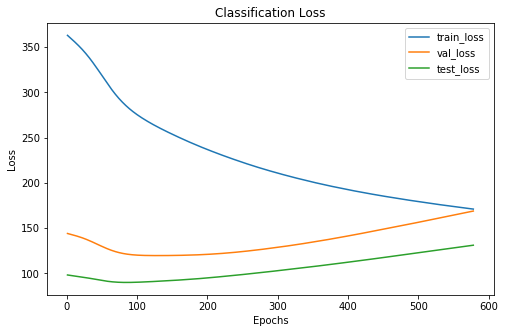

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 578 xxxxxxxxxxxxxx


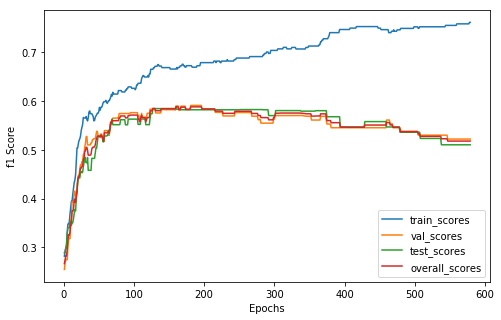

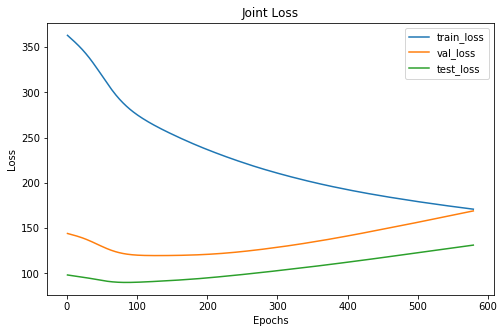

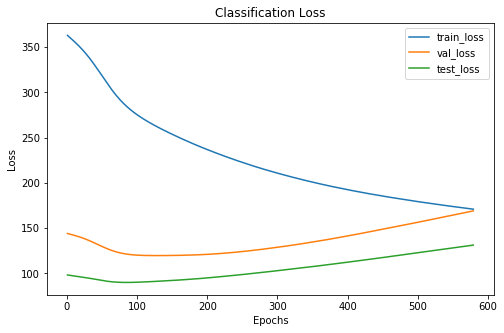

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 579 xxxxxxxxxxxxxx


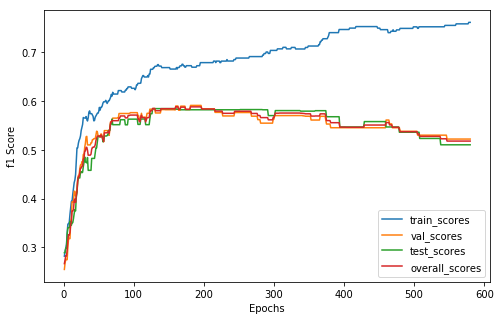

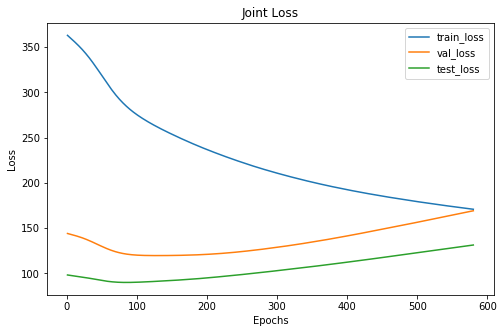

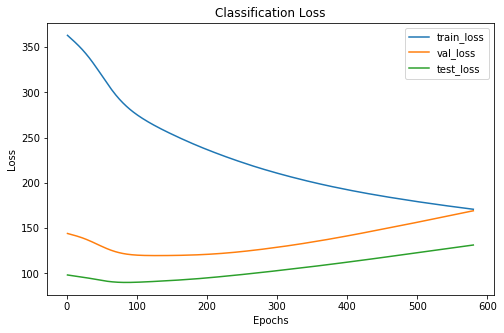

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 580 xxxxxxxxxxxxxx


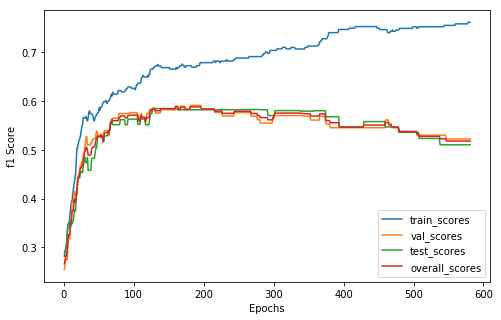

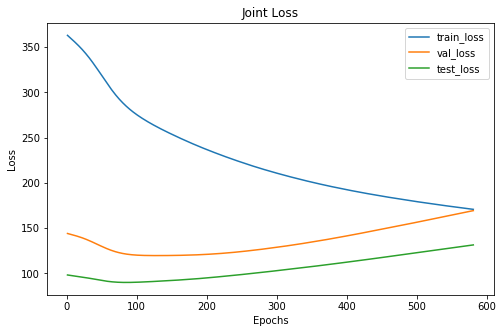

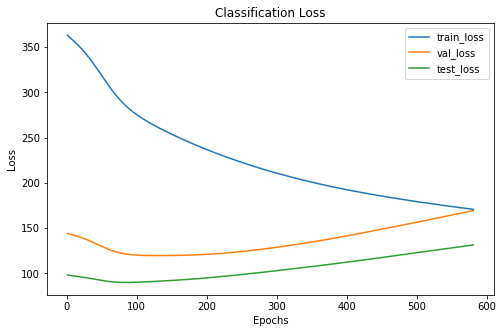

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 581 xxxxxxxxxxxxxx


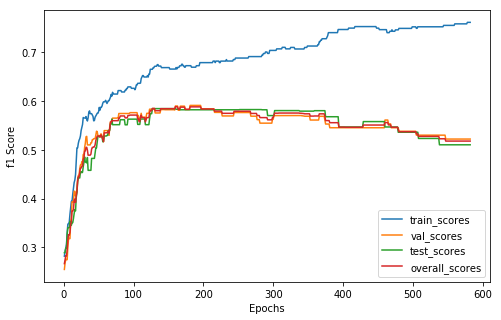

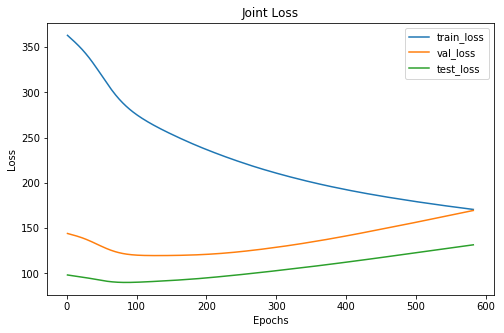

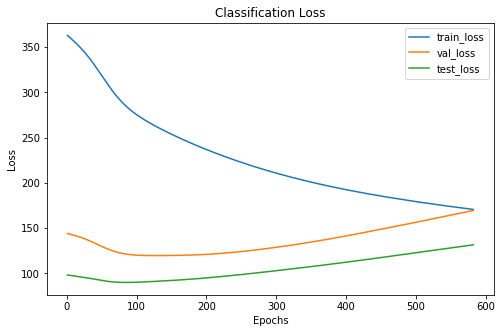

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 582 xxxxxxxxxxxxxx


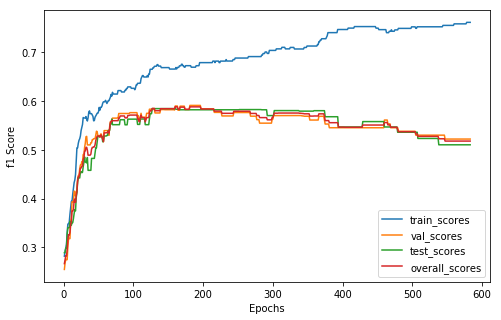

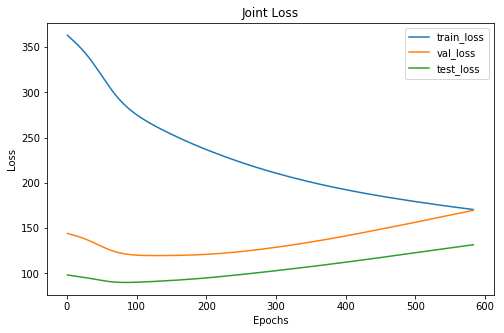

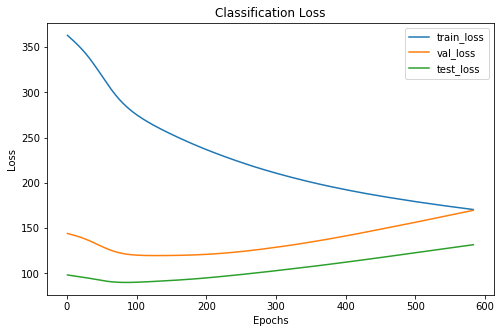

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 583 xxxxxxxxxxxxxx


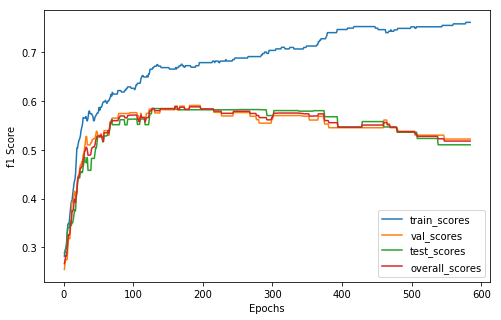

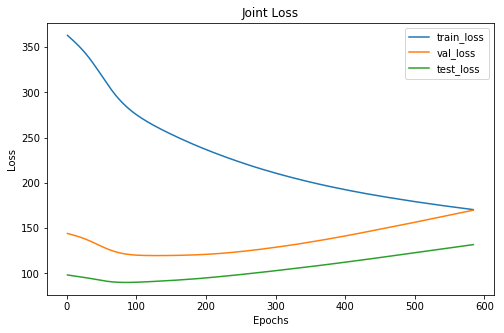

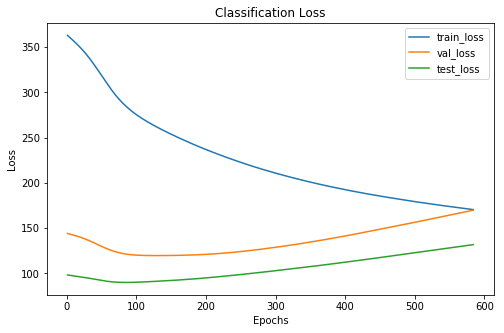

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 584 xxxxxxxxxxxxxx


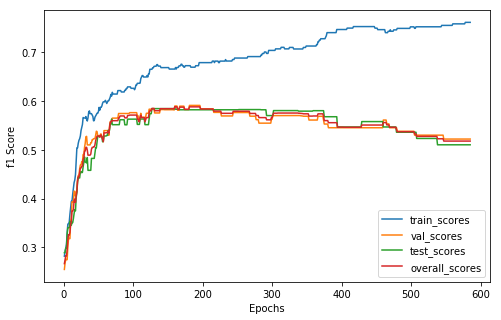

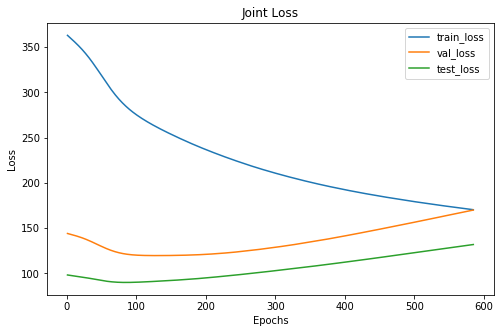

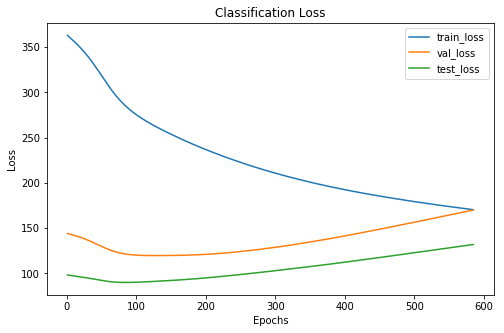

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 585 xxxxxxxxxxxxxx


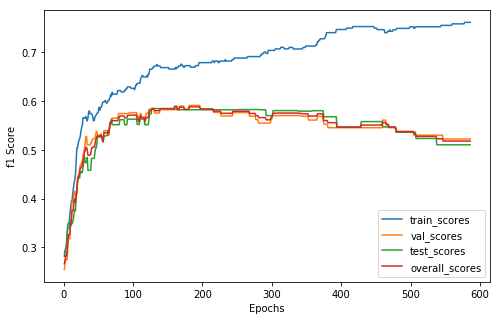

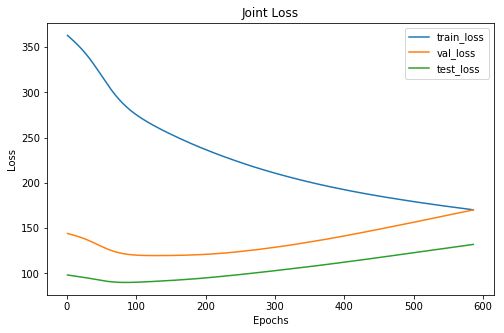

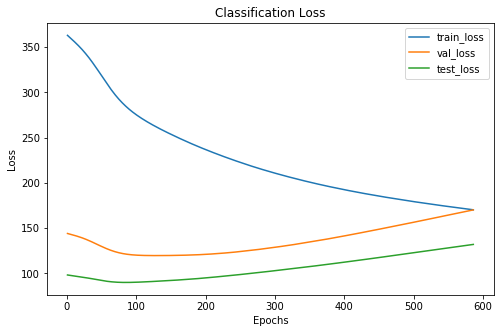

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 586 xxxxxxxxxxxxxx


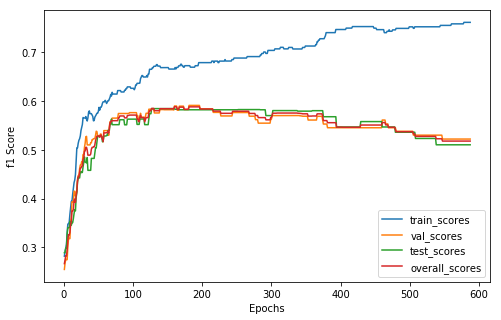

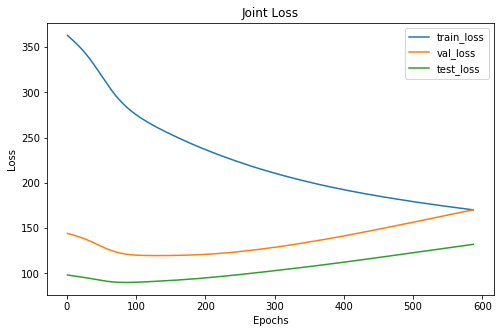

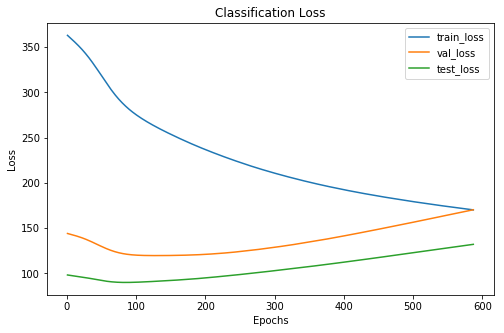

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 587 xxxxxxxxxxxxxx


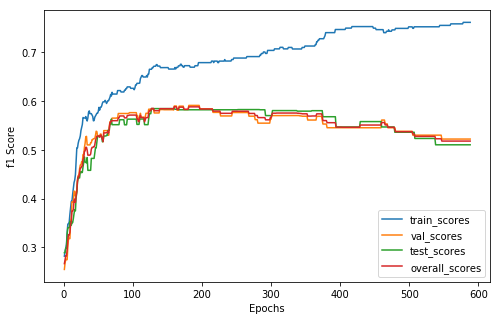

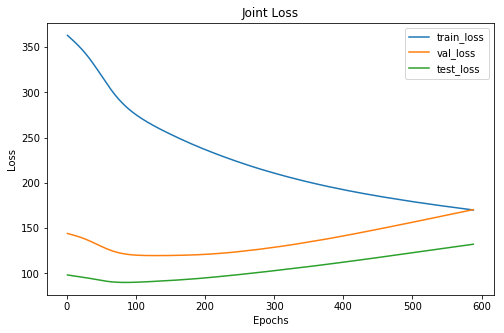

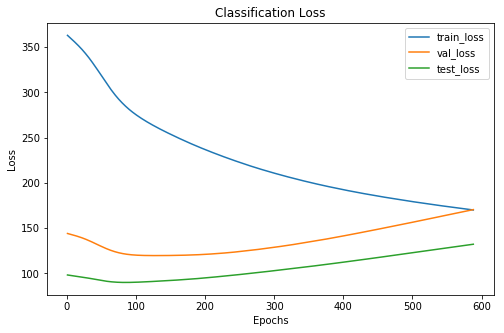

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 588 xxxxxxxxxxxxxx


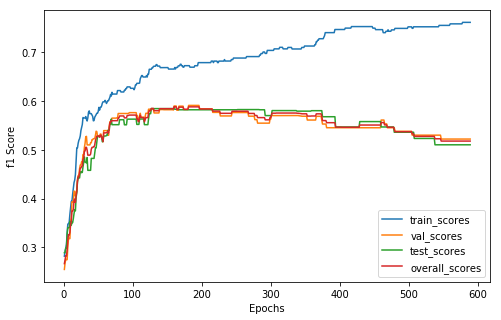

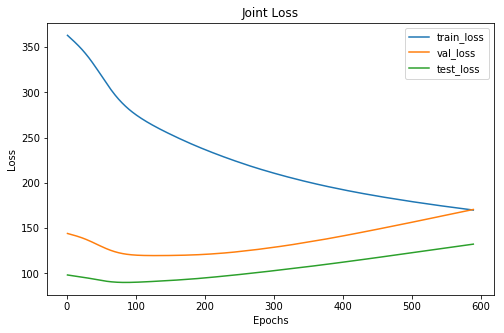

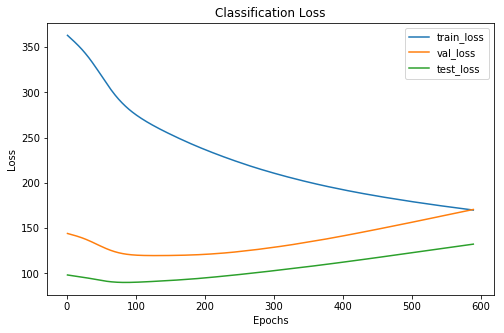

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 589 xxxxxxxxxxxxxx


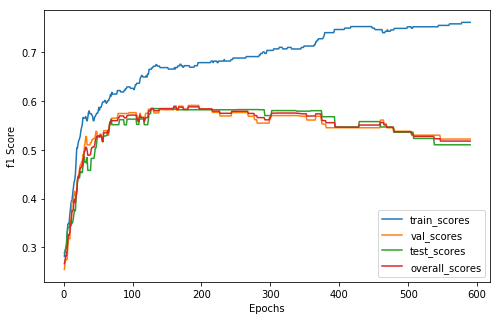

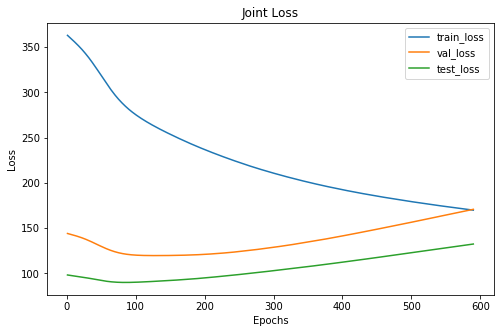

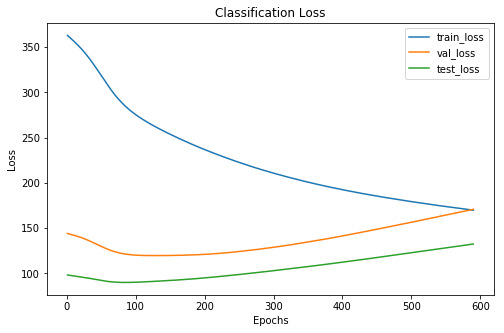

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 590 xxxxxxxxxxxxxx


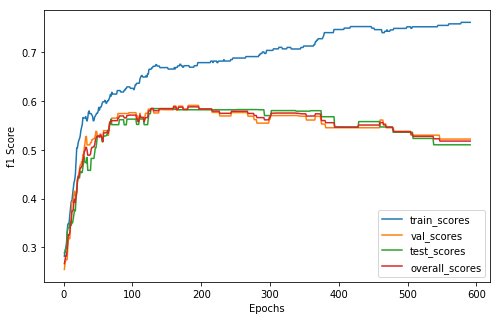

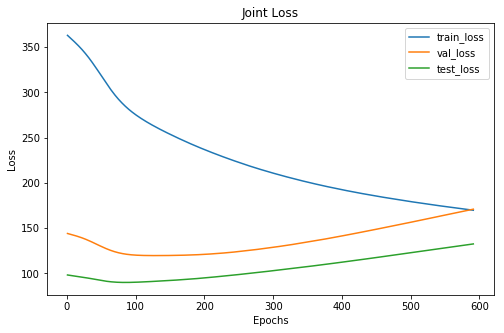

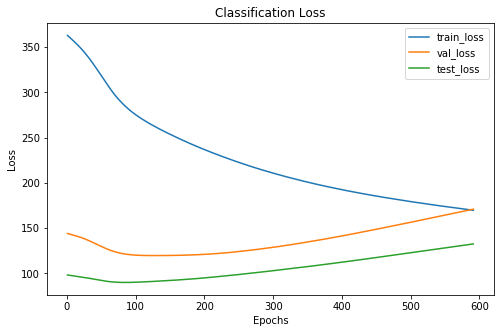

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 591 xxxxxxxxxxxxxx


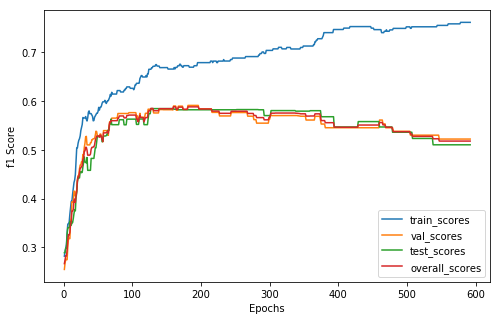

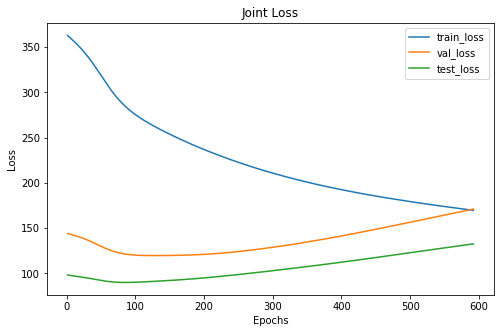

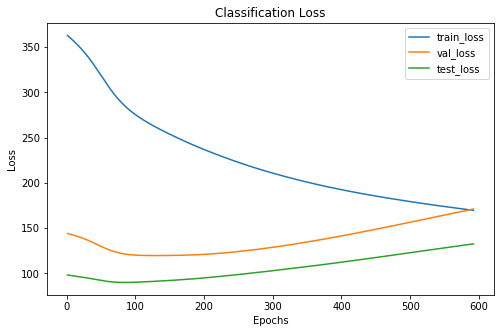

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 592 xxxxxxxxxxxxxx


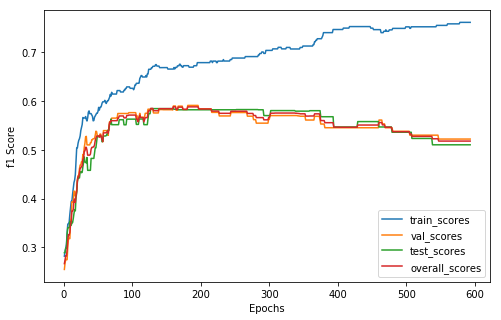

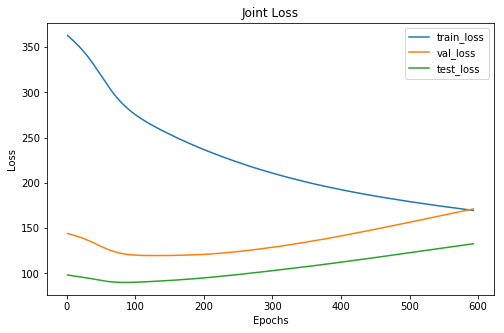

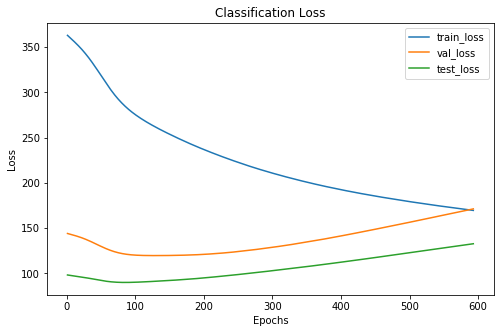

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 593 xxxxxxxxxxxxxx


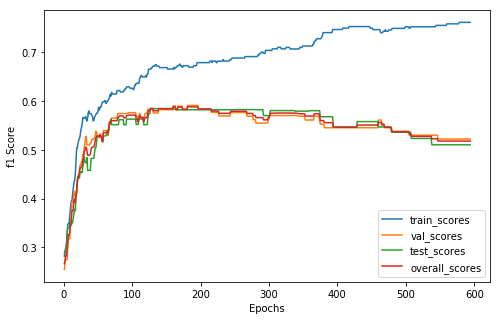

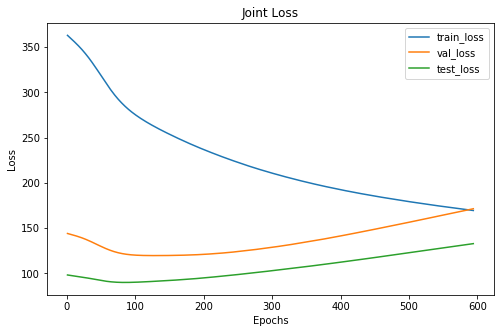

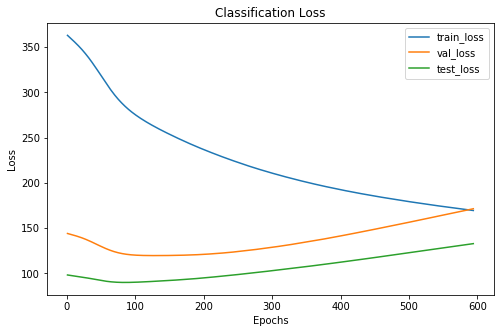

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 594 xxxxxxxxxxxxxx


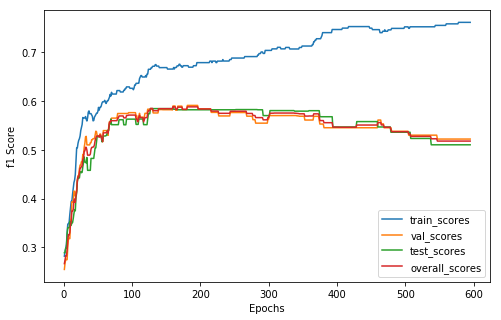

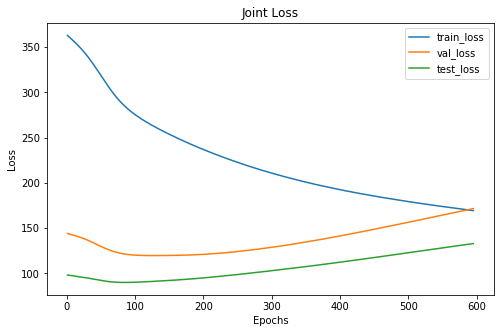

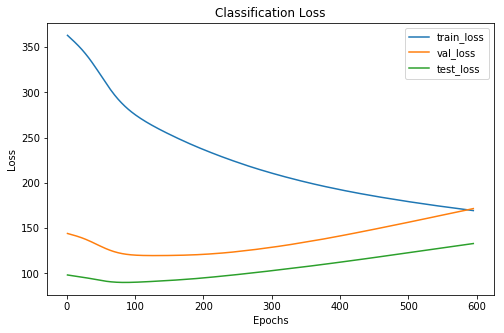

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 595 xxxxxxxxxxxxxx


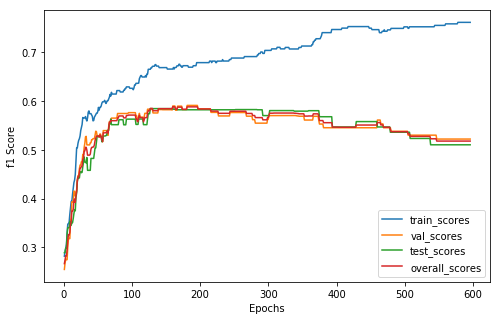

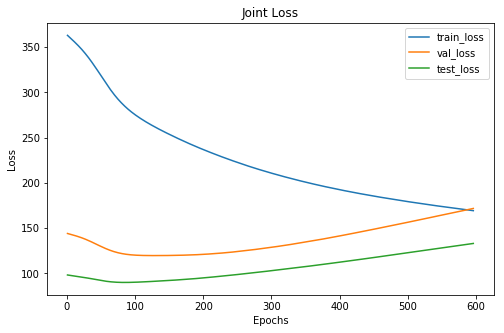

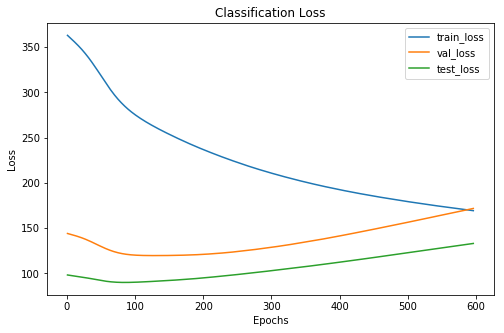

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0      100     46      21
 1      143     51      46
 2       84     33      21
xxxxxxxxxxxxxx epoch: 596 xxxxxxxxxxxxxx


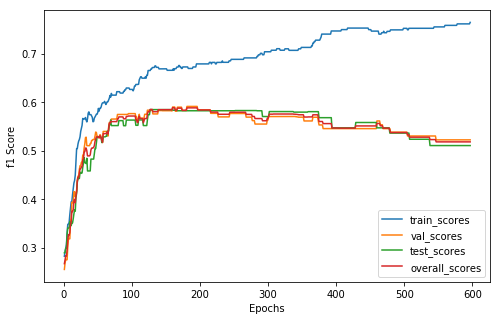

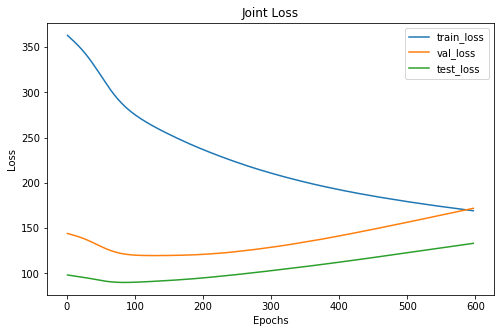

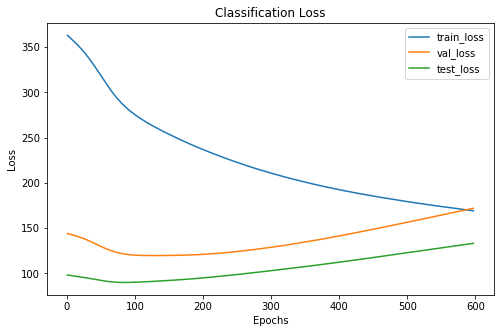

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      143     51      46
 2       85     33      21
xxxxxxxxxxxxxx epoch: 597 xxxxxxxxxxxxxx


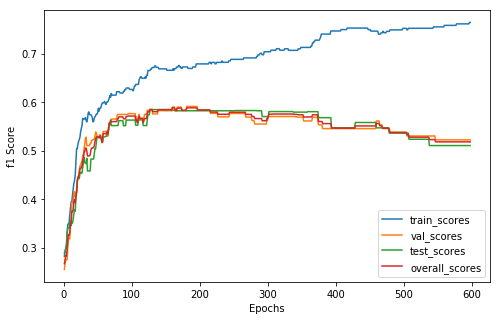

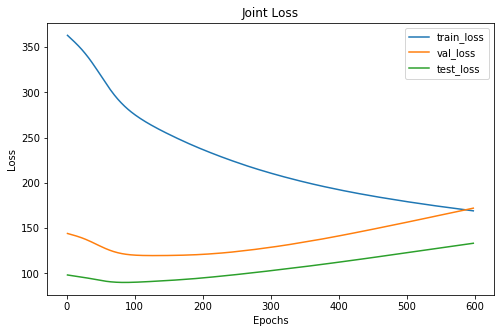

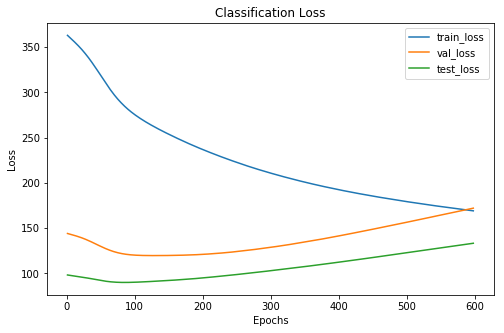

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      143     51      46
 2       85     33      21
xxxxxxxxxxxxxx epoch: 598 xxxxxxxxxxxxxx


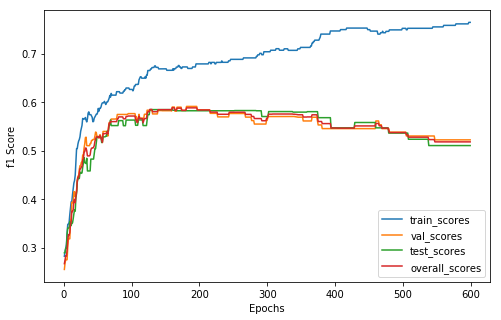

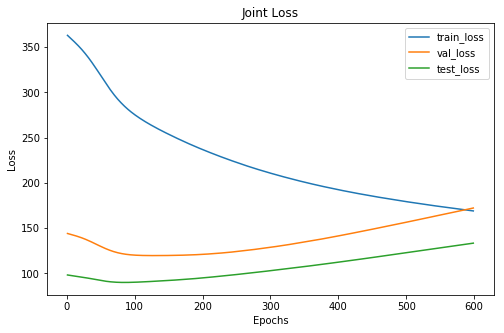

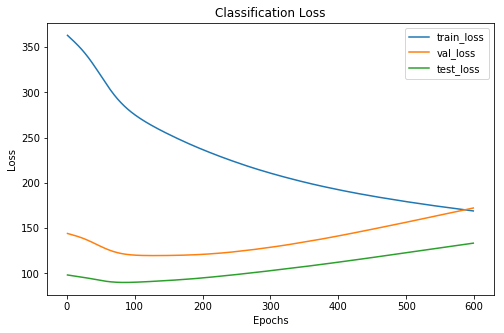

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      143     51      46
 2       85     33      21
xxxxxxxxxxxxxx epoch: 599 xxxxxxxxxxxxxx


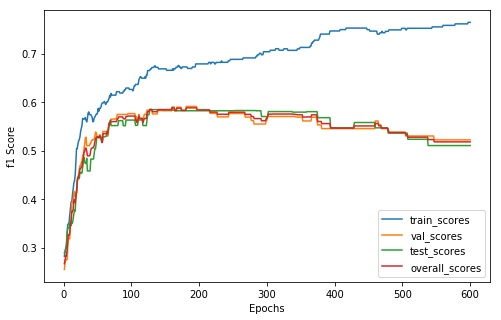

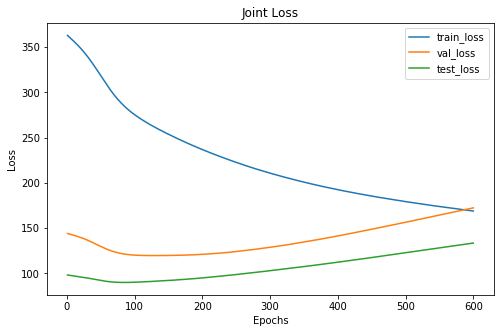

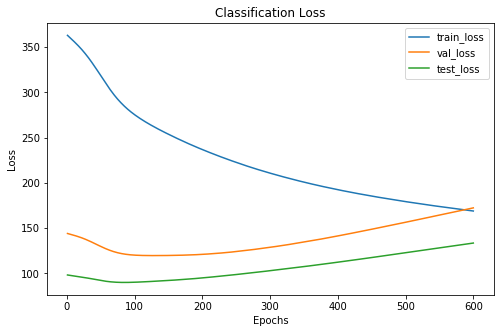

Cofusion Matrix For Val Set: 
--  --  --
25  21   7
13  27  10
 8   3  16
--  --  --
Predicted Label Distribution:
      Train    Val    Test
--  -------  -----  ------
 0       99     46      21
 1      143     51      46
 2       85     33      21


In [6]:
total_loss_over_epochs, scores_over_epochs = plotting.get_empty_stat_over_n_epoch_dictionaries()
reconstruction_loss_over_epochs = deepcopy(total_loss_over_epochs)
classification_loss_over_epochs = deepcopy(total_loss_over_epochs)
validation_user_statistics_over_epochs = []


for epoch in range(n_epochs):
    
    (train_total_loss, train_total_reconstruction_loss , train_total_classification_loss, 
     train_labels, train_preds, train_users) = trainer.evaluate_multitask_learner(data, 
                                                                      'train_ids',
                                                                      num_classes,
                                                                      model,
                                                                      reconstruction_criterion ,
                                                                      classification_criterion,
                                                                      device,
                                                                      optimizer=optimizer,
                                                                      alpha=alpha,
                                                                      beta=beta,
                                                                      use_histogram=use_historgram,
                                                                      use_covariates=use_covariates)
    
    (val_total_loss, val_total_reconstruction_loss , val_total_classification_loss, 
     val_labels, val_preds, val_users) =  trainer.evaluate_multitask_learner(data,
                                                                  'val_ids',
                                                                  num_classes,
                                                                  model,
                                                                  reconstruction_criterion,
                                                                  classification_criterion,
                                                                  device,
                                                                  alpha=alpha,
                                                                  beta=beta,
                                                                  use_histogram=use_historgram,
                                                                  use_covariates=use_covariates)
    
    (test_total_loss, test_total_reconstruction_loss , test_total_classification_loss, 
     test_labels, test_preds, test_users) =  trainer.evaluate_multitask_learner(data, 
                                                                    'test_ids',
                                                                    num_classes,
                                                                    model,
                                                                    reconstruction_criterion,
                                                                    classification_criterion,
                                                                    device,
                                                                    alpha=alpha,
                                                                    beta=beta,
                                                                    use_histogram=use_historgram,
                                                                    use_covariates=use_covariates)
    
    ######## Appending losses ######## 
    total_loss_over_epochs['train_loss'].append(train_total_loss)
    total_loss_over_epochs['val_loss'].append(val_total_loss)
    total_loss_over_epochs['test_loss'].append(test_total_loss)
    
    reconstruction_loss_over_epochs['train_loss'].append(train_total_reconstruction_loss)
    reconstruction_loss_over_epochs['val_loss'].append(val_total_reconstruction_loss)
    reconstruction_loss_over_epochs['test_loss'].append(test_total_reconstruction_loss)
    
    classification_loss_over_epochs['train_loss'].append(train_total_classification_loss)
    classification_loss_over_epochs['val_loss'].append(val_total_classification_loss)
    classification_loss_over_epochs['test_loss'].append(test_total_classification_loss)

    
    ######## Appending Metrics ######## 
    val_label_list = conversions.tensor_list_to_int_list(val_labels)
    test_label_list = conversions.tensor_list_to_int_list(test_labels)
    val_pred_list = conversions.tensor_list_to_int_list(val_preds)
    test_pred_list = conversions.tensor_list_to_int_list(test_preds)
    over_all_label_list = val_label_list + test_label_list
    over_all_pred_list = val_pred_list + test_pred_list
    
    train_scores = metrics.precision_recall_fscore_support(conversions.tensor_list_to_int_list(train_labels),
                                                           conversions.tensor_list_to_int_list(train_preds), average='weighted')
    val_scores = metrics.precision_recall_fscore_support(val_label_list, val_pred_list, average='weighted')
    test_scores = metrics.precision_recall_fscore_support(test_label_list, test_pred_list, average='weighted')
    overall_scores = metrics.precision_recall_fscore_support(over_all_label_list, over_all_pred_list, average='weighted')

    scores_over_epochs['train_scores'].append(train_scores)
    scores_over_epochs['val_scores'].append(val_scores)
    scores_over_epochs['test_scores'].append(test_scores)
    scores_over_epochs['overall_scores'].append(overall_scores)
    
    validation_user_statistics_over_epochs.append(statistics.generate_training_statistics_for_user(val_labels, 
                                                                                                val_preds, 
                                                                                                val_users))

    if epoch%1 == 0:
        print("xxxxxxxxxxxxxx epoch: {} xxxxxxxxxxxxxx".format(epoch))
        plotting.plot_score_over_n_epochs(scores_over_epochs, score_type='f1', fig_size=(8,5))
        plotting.plot_loss_over_n_epochs(total_loss_over_epochs, fig_size=(8, 5), title="Joint Loss")
#         plotting.plot_loss_over_n_epochs(reconstruction_loss_over_epochs, fig_size=(8, 5), title="Reconstruction Loss")
        plotting.plot_loss_over_n_epochs(classification_loss_over_epochs, fig_size=(8, 5), title="Classification Loss")
        
        print("Cofusion Matrix For Val Set: ")
        print(tabulate( metrics.confusion_matrix(conversions.tensor_list_to_int_list(val_labels), 
                                                 conversions.tensor_list_to_int_list(val_preds))))
        print("Predicted Label Distribution:")
        print(statistics.get_train_test_val_label_counts_from_predictions(train_preds, val_preds, test_preds))
